In [18]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        os.path.join(dirname, filename)

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

In [19]:
import numpy as np
import tensorflow as tf
import keras
import cv2
from keras.layers import MaxPool2D,Conv2D,UpSampling2D,Input,Dropout
from keras.models import Sequential
from keras.preprocessing.image import img_to_array
import os
from tqdm import tqdm
import re
import matplotlib.pyplot as plt
import torch

In [20]:
if torch.cuda.is_available():
    device=torch.device(type="cuda", index=0)
else:
    device=torch.device(type="cpu", index=0)

In [21]:
for x in range(4589):
    directory_path='/kaggle/input/frames-3/color_frames/color_frames'
    file_name=str(x)+'.jpg'
    
    file_path = os.path.join(directory_path, file_name)

    if os.path.exists(file_path):
        pass
    else:
        print(f"The file {file_name} does not exist in the directory {directory_path}.")

In [22]:
for x in range(4589):
    directory_path='/kaggle/input/frames-3/grayscale_frames/grayscale_frames'
    file_name=str(x)+'.jpg'
    
    file_path = os.path.join(directory_path, file_name)

    if os.path.exists(file_path):
        pass
    else:
        print(f"The file {file_name} does not exist in the directory {directory_path}.")

In [23]:
def sorted_alphanumeric(data):
    convert = lambda text: int(text) if text.isdigit() else text.lower()
    alphanum_key = lambda key: [convert(c) for c in re.split('([0-9]+)',key)]
    return sorted(data,key = alphanum_key)
# defining the size of the image
SIZE = 160
color_img = []
path = '/kaggle/input/frames-3/color_frames/color_frames'
files = os.listdir(path)
files = sorted_alphanumeric(files)
for i in tqdm(files):
    print(path + '/' + i)
    img = cv2.imread(path + '/' + i ,1)
    print(img)
    # open cv reads images in BGR format so we have to convert it to RGB
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    #resizing image
    img = cv2.resize(img, (SIZE, SIZE))
    img = img.astype('float32') / 255.0
    color_img.append(img_to_array(img))
    if(i=='4589.jpg'):
        break


gray_img = []
path = '/kaggle/input/frames-3/grayscale_frames/grayscale_frames'
files = os.listdir(path)
files = sorted_alphanumeric(files)
for i in tqdm(files):
    print(path + '/' + i)
    img = cv2.imread(path + '/'+i,1)

    #resizing image
    img = cv2.resize(img, (SIZE, SIZE))
    img = img.astype('float32') / 255.0
    gray_img.append(img_to_array(img))
    if(i=='4589.jpg'):
        break

  0%|          | 4/4590 [00:00<02:05, 36.65it/s]

/kaggle/input/frames-3/color_frames/color_frames/0.jpg
[[[255 244 240]
  [255 244 240]
  [255 244 240]
  ...
  [254 249 240]
  [254 249 240]
  [254 249 240]]

 [[255 244 240]
  [255 244 240]
  [255 244 240]
  ...
  [254 249 240]
  [254 249 240]
  [254 249 240]]

 [[255 244 240]
  [255 244 240]
  [255 244 240]
  ...
  [254 249 240]
  [254 249 240]
  [254 249 240]]

 ...

 [[ 36  93  84]
  [ 35  92  83]
  [ 32  89  80]
  ...
  [ 16  92  60]
  [ 15  91  59]
  [ 15  91  59]]

 [[ 31  88  79]
  [ 29  86  77]
  [ 25  82  73]
  ...
  [ 17  93  61]
  [ 16  92  60]
  [ 15  91  59]]

 [[ 26  83  74]
  [ 24  81  72]
  [ 20  77  68]
  ...
  [ 17  93  61]
  [ 17  93  61]
  [ 16  92  60]]]
/kaggle/input/frames-3/color_frames/color_frames/1.jpg
[[[254 243 239]
  [254 243 239]
  [254 243 239]
  ...
  [252 247 238]
  [252 247 238]
  [252 247 238]]

 [[254 243 239]
  [254 243 239]
  [254 243 239]
  ...
  [252 247 238]
  [252 247 238]
  [252 247 238]]

 [[254 243 239]
  [254 243 239]
  [254 243 239]
  ..

  0%|          | 12/4590 [00:00<02:01, 37.70it/s]

[[[252 241 237]
  [252 241 237]
  [252 241 237]
  ...
  [251 246 237]
  [251 246 237]
  [251 246 237]]

 [[252 241 237]
  [252 241 237]
  [252 241 237]
  ...
  [251 246 237]
  [251 246 237]
  [251 246 237]]

 [[252 241 237]
  [252 241 237]
  [252 241 237]
  ...
  [251 246 237]
  [251 246 237]
  [251 246 237]]

 ...

 [[  7  59  52]
  [ 10  62  55]
  [ 12  64  57]
  ...
  [ 25 100  68]
  [ 25 100  68]
  [ 25 100  68]]

 [[  1  53  46]
  [  4  56  49]
  [  7  59  52]
  ...
  [ 25 100  68]
  [ 25 100  68]
  [ 25 100  68]]

 [[  2  54  47]
  [  5  57  50]
  [  8  60  53]
  ...
  [ 24  99  67]
  [ 24  99  67]
  [ 24  99  67]]]
/kaggle/input/frames-3/color_frames/color_frames/8.jpg
[[[252 241 237]
  [252 241 237]
  [252 241 237]
  ...
  [251 246 237]
  [251 246 237]
  [251 246 237]]

 [[252 241 237]
  [252 241 237]
  [252 241 237]
  ...
  [251 246 237]
  [251 246 237]
  [251 246 237]]

 [[252 241 237]
  [252 241 237]
  [252 241 237]
  ...
  [251 246 237]
  [251 246 237]
  [251 246 237]]

 ..

  0%|          | 20/4590 [00:00<02:00, 37.84it/s]

[[[252 237 234]
  [252 237 234]
  [252 237 234]
  ...
  [249 248 238]
  [249 248 238]
  [249 248 238]]

 [[252 237 234]
  [252 237 234]
  [252 237 234]
  ...
  [249 248 238]
  [249 248 238]
  [249 248 238]]

 [[252 237 234]
  [252 237 234]
  [252 237 234]
  ...
  [249 248 238]
  [249 248 238]
  [249 248 238]]

 ...

 [[ 25  82  79]
  [ 25  82  79]
  [ 26  80  80]
  ...
  [ 23  97  63]
  [ 23  97  63]
  [ 23  97  63]]

 [[ 26  83  80]
  [ 25  82  79]
  [ 26  80  80]
  ...
  [ 23  97  63]
  [ 23  97  63]
  [ 23  97  63]]

 [[ 26  83  80]
  [ 25  82  79]
  [ 26  80  80]
  ...
  [ 24  98  64]
  [ 24  98  64]
  [ 24  98  64]]]
/kaggle/input/frames-3/color_frames/color_frames/16.jpg
[[[252 237 234]
  [252 237 234]
  [252 237 234]
  ...
  [251 249 239]
  [251 249 239]
  [251 249 239]]

 [[252 237 234]
  [252 237 234]
  [252 237 234]
  ...
  [251 249 239]
  [251 249 239]
  [251 249 239]]

 [[252 237 234]
  [252 237 234]
  [252 237 234]
  ...
  [251 249 239]
  [251 249 239]
  [251 249 239]]

 .

  1%|          | 28/4590 [00:00<02:02, 37.30it/s]

[[[254 233 231]
  [254 233 231]
  [254 233 231]
  ...
  [253 252 242]
  [253 252 242]
  [253 252 242]]

 [[254 233 231]
  [254 233 231]
  [254 233 231]
  ...
  [253 252 242]
  [253 252 242]
  [253 252 242]]

 [[254 233 231]
  [254 233 231]
  [254 233 231]
  ...
  [253 252 242]
  [253 252 242]
  [253 252 242]]

 ...

 [[  9  62  59]
  [  8  61  58]
  [  8  58  56]
  ...
  [ 16  84  53]
  [ 17  85  54]
  [ 17  85  54]]

 [[  9  59  57]
  [ 10  60  58]
  [ 12  61  59]
  ...
  [ 21  90  57]
  [ 21  90  57]
  [ 21  90  57]]

 [[ 10  60  58]
  [ 11  61  59]
  [ 14  63  61]
  ...
  [ 22  91  58]
  [ 23  92  59]
  [ 24  93  60]]]
/kaggle/input/frames-3/color_frames/color_frames/24.jpg
[[[253 232 230]
  [252 231 229]
  [253 232 230]
  ...
  [253 252 242]
  [253 252 242]
  [253 252 242]]

 [[254 233 231]
  [253 232 230]
  [253 232 230]
  ...
  [253 252 242]
  [253 252 242]
  [253 252 242]]

 [[253 232 230]
  [253 232 230]
  [253 232 230]
  ...
  [253 252 242]
  [253 252 242]
  [253 252 242]]

 .

  1%|          | 36/4590 [00:00<02:02, 37.24it/s]

[[[254 229 227]
  [254 229 227]
  [254 229 227]
  ...
  [255 250 241]
  [255 250 241]
  [255 250 241]]

 [[254 229 227]
  [254 229 227]
  [254 229 227]
  ...
  [255 250 241]
  [255 250 241]
  [255 250 241]]

 [[254 229 227]
  [254 229 227]
  [254 229 227]
  ...
  [255 250 241]
  [255 250 241]
  [255 250 241]]

 ...

 [[ 58  91  87]
  [ 68  99  96]
  [ 80 109 106]
  ...
  [ 22  97  65]
  [ 25 100  68]
  [ 26 101  69]]

 [[ 82 113 110]
  [102 131 128]
  [119 143 141]
  ...
  [ 21  94  62]
  [ 24  97  65]
  [ 26  99  67]]

 [[ 94 123 120]
  [114 141 138]
  [127 149 147]
  ...
  [ 18  91  59]
  [ 22  95  63]
  [ 24  97  65]]]
/kaggle/input/frames-3/color_frames/color_frames/32.jpg
[[[254 229 227]
  [254 229 227]
  [254 229 227]
  ...
  [255 250 241]
  [255 250 241]
  [255 250 241]]

 [[254 229 227]
  [254 229 227]
  [254 229 227]
  ...
  [255 250 241]
  [255 250 241]
  [255 250 241]]

 [[254 229 227]
  [254 229 227]
  [254 229 227]
  ...
  [255 250 241]
  [255 250 241]
  [255 250 241]]

 .

  1%|          | 44/4590 [00:01<02:00, 37.60it/s]

[[[254 229 227]
  [254 229 227]
  [254 229 227]
  ...
  [255 250 241]
  [255 250 241]
  [255 250 241]]

 [[254 229 227]
  [254 229 227]
  [254 229 227]
  ...
  [255 250 241]
  [255 250 241]
  [255 250 241]]

 [[254 229 227]
  [254 229 227]
  [254 229 227]
  ...
  [255 250 241]
  [255 250 241]
  [255 250 241]]

 ...

 [[154 140 152]
  [154 140 152]
  [154 140 152]
  ...
  [ 19 100  67]
  [ 19 100  67]
  [ 19 100  67]]

 [[155 138 151]
  [155 138 151]
  [155 138 151]
  ...
  [ 20 101  68]
  [ 20 101  68]
  [ 21 102  69]]

 [[155 138 151]
  [154 137 150]
  [154 137 150]
  ...
  [ 19 100  67]
  [ 19 100  67]
  [ 20 101  68]]]
/kaggle/input/frames-3/color_frames/color_frames/40.jpg
[[[254 229 227]
  [254 229 227]
  [254 229 227]
  ...
  [255 253 243]
  [255 253 243]
  [255 253 243]]

 [[254 229 227]
  [254 229 227]
  [254 229 227]
  ...
  [255 253 243]
  [255 253 243]
  [255 253 243]]

 [[254 229 227]
  [254 229 227]
  [254 229 227]
  ...
  [255 253 243]
  [255 253 243]
  [255 253 243]]

 .

  1%|          | 52/4590 [00:01<02:02, 36.96it/s]

[[[255 233 231]
  [255 233 231]
  [255 233 231]
  ...
  [255 252 247]
  [255 252 247]
  [255 252 247]]

 [[255 233 231]
  [255 233 231]
  [255 233 231]
  ...
  [255 252 247]
  [255 252 247]
  [255 252 247]]

 [[255 233 231]
  [255 233 231]
  [255 233 231]
  ...
  [255 252 247]
  [255 252 247]
  [255 252 247]]

 ...

 [[157 140 151]
  [157 140 151]
  [157 140 151]
  ...
  [  8  87  54]
  [  8  87  54]
  [  7  86  53]]

 [[157 140 151]
  [157 140 151]
  [157 140 151]
  ...
  [ 12  91  58]
  [ 13  92  59]
  [ 13  92  59]]

 [[157 140 151]
  [157 140 151]
  [157 140 151]
  ...
  [ 17  96  63]
  [ 18  97  64]
  [ 18  97  64]]]
/kaggle/input/frames-3/color_frames/color_frames/48.jpg
[[[253 232 230]
  [253 232 230]
  [253 232 230]
  ...
  [255 252 247]
  [255 252 247]
  [255 252 247]]

 [[253 232 230]
  [253 232 230]
  [253 232 230]
  ...
  [255 252 247]
  [255 252 247]
  [255 252 247]]

 [[253 232 230]
  [253 232 230]
  [253 232 230]
  ...
  [255 252 247]
  [255 252 247]
  [255 252 247]]

 .

  1%|▏         | 60/4590 [00:01<02:07, 35.50it/s]

[[[253 232 230]
  [253 232 230]
  [253 232 230]
  ...
  [255 252 251]
  [255 252 251]
  [255 252 251]]

 [[253 232 230]
  [253 232 230]
  [253 232 230]
  ...
  [255 252 251]
  [255 252 251]
  [255 252 251]]

 [[253 232 230]
  [253 232 230]
  [253 232 230]
  ...
  [255 252 251]
  [255 252 251]
  [255 252 251]]

 ...

 [[153 139 150]
  [152 138 149]
  [153 137 148]
  ...
  [ 21  96  68]
  [ 21  96  68]
  [ 21  96  68]]

 [[153 139 150]
  [151 137 148]
  [153 137 148]
  ...
  [ 19  94  66]
  [ 19  94  66]
  [ 19  94  66]]

 [[153 139 150]
  [151 137 148]
  [153 137 148]
  ...
  [ 12  87  59]
  [ 12  87  59]
  [ 12  87  59]]]
/kaggle/input/frames-3/color_frames/color_frames/56.jpg
[[[253 232 230]
  [253 232 230]
  [253 232 230]
  ...
  [255 252 251]
  [255 252 251]
  [255 252 251]]

 [[253 232 230]
  [253 232 230]
  [253 232 230]
  ...
  [255 252 251]
  [255 252 251]
  [255 252 251]]

 [[253 232 230]
  [253 232 230]
  [253 232 230]
  ...
  [255 252 251]
  [255 252 251]
  [255 252 251]]

 .

  1%|▏         | 68/4590 [00:01<02:05, 36.17it/s]

[[[250 235 232]
  [250 235 232]
  [250 235 232]
  ...
  [254 252 252]
  [254 252 252]
  [254 252 252]]

 [[250 235 232]
  [250 235 232]
  [250 235 232]
  ...
  [254 252 252]
  [254 252 252]
  [254 252 252]]

 [[250 235 232]
  [250 235 232]
  [250 235 232]
  ...
  [254 252 252]
  [254 252 252]
  [254 252 252]]

 ...

 [[118 101 115]
  [117 100 113]
  [116  99 112]
  ...
  [ 25 101  70]
  [ 27 103  72]
  [ 28 104  73]]

 [[126 109 123]
  [125 108 121]
  [124 107 120]
  ...
  [ 24 100  69]
  [ 26 102  71]
  [ 28 104  73]]

 [[128 111 125]
  [128 111 124]
  [128 111 124]
  ...
  [ 21  97  66]
  [ 23  99  68]
  [ 25 101  70]]]
/kaggle/input/frames-3/color_frames/color_frames/63.jpg
[[[250 235 232]
  [250 235 232]
  [250 235 232]
  ...
  [253 253 253]
  [253 253 253]
  [253 253 253]]

 [[250 235 232]
  [250 235 232]
  [250 235 232]
  ...
  [253 253 253]
  [253 253 253]
  [253 253 253]]

 [[250 235 232]
  [250 235 232]
  [250 235 232]
  ...
  [253 253 253]
  [253 253 253]
  [253 253 253]]

 .

  2%|▏         | 76/4590 [00:02<02:07, 35.41it/s]

[[[255 241 238]
  [255 241 238]
  [255 241 238]
  ...
  [255 253 249]
  [255 253 249]
  [255 253 249]]

 [[255 241 238]
  [255 241 238]
  [255 241 238]
  ...
  [255 253 249]
  [255 253 249]
  [255 253 249]]

 [[255 240 237]
  [255 240 237]
  [255 240 237]
  ...
  [255 253 249]
  [255 253 249]
  [255 253 249]]

 ...

 [[138 125 133]
  [138 125 133]
  [137 126 134]
  ...
  [ 16  92  61]
  [ 16  92  61]
  [ 15  91  60]]

 [[138 125 133]
  [138 125 133]
  [139 126 134]
  ...
  [ 16  92  61]
  [ 16  92  61]
  [ 15  91  60]]

 [[139 126 134]
  [139 126 134]
  [139 126 134]
  ...
  [ 16  92  61]
  [ 16  92  61]
  [ 16  92  61]]]
/kaggle/input/frames-3/color_frames/color_frames/71.jpg
[[[255 241 238]
  [255 241 238]
  [255 241 238]
  ...
  [255 253 249]
  [255 253 249]
  [255 253 249]]

 [[255 241 238]
  [255 241 238]
  [255 241 238]
  ...
  [255 253 249]
  [255 253 249]
  [255 253 249]]

 [[255 240 237]
  [255 240 237]
  [255 240 237]
  ...
  [255 253 249]
  [255 253 249]
  [255 253 249]]

 .

  2%|▏         | 84/4590 [00:02<02:04, 36.30it/s]

[[[255 241 238]
  [255 241 238]
  [255 241 238]
  ...
  [255 252 247]
  [255 252 247]
  [255 252 247]]

 [[255 241 238]
  [255 241 238]
  [255 241 238]
  ...
  [255 252 247]
  [255 252 247]
  [255 252 247]]

 [[255 240 237]
  [255 240 237]
  [255 240 237]
  ...
  [255 252 247]
  [255 252 247]
  [255 252 247]]

 ...

 [[131 122 132]
  [130 121 131]
  [123 115 122]
  ...
  [ 20  93  61]
  [ 22  92  61]
  [ 22  92  61]]

 [[127 119 126]
  [129 121 128]
  [128 120 127]
  ...
  [ 21  94  62]
  [ 22  95  63]
  [ 22  95  63]]

 [[100  92  99]
  [ 98  90  97]
  [ 93  85  92]
  ...
  [ 22  95  63]
  [ 22  95  63]
  [ 23  96  64]]]
/kaggle/input/frames-3/color_frames/color_frames/78.jpg
[[[255 241 238]
  [255 241 238]
  [255 241 238]
  ...
  [255 252 247]
  [255 252 247]
  [255 252 247]]

 [[255 241 238]
  [255 241 238]
  [255 241 238]
  ...
  [255 252 247]
  [255 252 247]
  [255 252 247]]

 [[253 241 237]
  [253 241 237]
  [253 241 237]
  ...
  [255 252 247]
  [255 252 247]
  [255 252 247]]

 .

  2%|▏         | 92/4590 [00:02<02:02, 36.71it/s]

[[[255 244 240]
  [255 244 240]
  [255 244 240]
  ...
  [255 252 247]
  [255 252 247]
  [255 252 247]]

 [[255 244 240]
  [255 244 240]
  [255 244 240]
  ...
  [255 252 247]
  [255 252 247]
  [255 252 247]]

 [[253 244 240]
  [253 244 240]
  [253 244 240]
  ...
  [255 252 247]
  [255 252 247]
  [255 252 247]]

 ...

 [[ 58  57  61]
  [ 73  72  76]
  [ 79  75  80]
  ...
  [ 30  90  59]
  [ 30  90  59]
  [ 30  90  59]]

 [[ 65  66  70]
  [ 87  86  90]
  [ 94  90  95]
  ...
  [ 29  88  57]
  [ 29  88  57]
  [ 30  89  58]]

 [[ 56  57  61]
  [ 84  85  89]
  [ 97  93  98]
  ...
  [ 30  89  58]
  [ 32  89  58]
  [ 32  89  58]]]
/kaggle/input/frames-3/color_frames/color_frames/86.jpg
[[[255 244 240]
  [255 244 240]
  [255 244 240]
  ...
  [255 252 247]
  [255 252 247]
  [255 252 247]]

 [[255 244 240]
  [255 244 240]
  [255 244 240]
  ...
  [255 252 247]
  [255 252 247]
  [255 252 247]]

 [[253 244 240]
  [253 244 240]
  [253 244 240]
  ...
  [255 252 247]
  [255 252 247]
  [255 252 247]]

 .

  2%|▏         | 100/4590 [00:02<02:02, 36.71it/s]

[[[253 244 240]
  [253 244 240]
  [253 244 240]
  ...
  [255 252 247]
  [255 252 247]
  [255 252 247]]

 [[253 244 240]
  [253 244 240]
  [253 244 240]
  ...
  [255 252 247]
  [255 252 247]
  [255 252 247]]

 [[253 244 240]
  [253 244 240]
  [253 244 240]
  ...
  [255 252 247]
  [255 252 247]
  [255 252 247]]

 ...

 [[ 41  34  39]
  [ 47  40  45]
  [ 74  67  70]
  ...
  [ 19  99  62]
  [ 20 100  63]
  [ 20 100  63]]

 [[ 37  31  36]
  [ 25  19  24]
  [ 28  21  24]
  ...
  [ 21  99  62]
  [ 21  99  62]
  [ 22 100  63]]

 [[ 21  15  20]
  [ 37  31  36]
  [ 59  52  55]
  ...
  [ 21  99  62]
  [ 21  99  62]
  [ 21  99  62]]]
/kaggle/input/frames-3/color_frames/color_frames/94.jpg
[[[254 245 241]
  [254 245 241]
  [254 245 241]
  ...
  [255 253 248]
  [255 253 248]
  [255 253 248]]

 [[254 245 241]
  [254 245 241]
  [254 245 241]
  ...
  [255 253 248]
  [255 253 248]
  [255 253 248]]

 [[254 245 241]
  [254 245 241]
  [254 245 241]
  ...
  [255 253 248]
  [255 253 248]
  [255 253 248]]

 .

  2%|▏         | 108/4590 [00:02<02:02, 36.61it/s]

[[[252 246 241]
  [252 246 241]
  [252 246 241]
  ...
  [255 253 248]
  [255 253 248]
  [255 253 248]]

 [[252 246 241]
  [252 246 241]
  [252 246 241]
  ...
  [255 253 248]
  [255 253 248]
  [255 253 248]]

 [[252 246 241]
  [252 246 241]
  [252 246 241]
  ...
  [255 253 248]
  [255 253 248]
  [255 253 248]]

 ...

 [[115  96  99]
  [115  96  99]
  [118  97 100]
  ...
  [ 22 102  67]
  [ 22 102  67]
  [ 23 103  68]]

 [[115  96  99]
  [115  96  99]
  [117  96  99]
  ...
  [ 21 101  66]
  [ 21 101  66]
  [ 21 101  66]]

 [[115  96  99]
  [115  96  99]
  [117  96  99]
  ...
  [ 21 101  66]
  [ 21 101  66]
  [ 21 101  66]]]
/kaggle/input/frames-3/color_frames/color_frames/102.jpg
[[[252 246 241]
  [252 246 241]
  [252 246 241]
  ...
  [255 253 248]
  [255 253 248]
  [255 253 248]]

 [[252 246 241]
  [252 246 241]
  [252 246 241]
  ...
  [255 253 248]
  [255 253 248]
  [255 253 248]]

 [[252 246 241]
  [252 246 241]
  [252 246 241]
  ...
  [255 253 248]
  [255 253 248]
  [255 253 248]]

 

  3%|▎         | 116/4590 [00:03<02:01, 36.91it/s]

[[[251 245 240]
  [251 245 240]
  [251 245 240]
  ...
  [252 253 249]
  [252 253 249]
  [252 253 249]]

 [[251 245 240]
  [251 245 240]
  [251 245 240]
  ...
  [252 253 249]
  [252 253 249]
  [252 253 249]]

 [[251 245 240]
  [251 245 240]
  [251 245 240]
  ...
  [252 253 249]
  [252 253 249]
  [252 253 249]]

 ...

 [[120  99 102]
  [120  99 102]
  [120  99 102]
  ...
  [ 26 106  69]
  [ 26 106  69]
  [ 26 106  69]]

 [[120  99 102]
  [120  99 102]
  [120  99 102]
  ...
  [ 26 106  69]
  [ 26 106  69]
  [ 26 106  69]]

 [[120  99 102]
  [120  99 102]
  [120  99 102]
  ...
  [ 26 106  69]
  [ 26 106  69]
  [ 26 106  69]]]
/kaggle/input/frames-3/color_frames/color_frames/110.jpg
[[[251 245 240]
  [251 245 240]
  [251 245 240]
  ...
  [252 253 249]
  [252 253 249]
  [252 253 249]]

 [[251 245 240]
  [251 245 240]
  [251 245 240]
  ...
  [252 253 249]
  [252 253 249]
  [252 253 249]]

 [[251 245 240]
  [251 245 240]
  [251 245 240]
  ...
  [252 253 249]
  [252 253 249]
  [252 253 249]]

 

  3%|▎         | 124/4590 [00:03<02:02, 36.44it/s]

[[[254 250 245]
  [254 250 245]
  [254 250 245]
  ...
  [252 253 249]
  [252 253 249]
  [252 253 249]]

 [[254 250 245]
  [254 250 245]
  [254 250 245]
  ...
  [252 253 249]
  [252 253 249]
  [252 253 249]]

 [[254 250 245]
  [254 250 245]
  [254 250 245]
  ...
  [252 253 249]
  [252 253 249]
  [252 253 249]]

 ...

 [[118  96  98]
  [118  96  98]
  [118  96  98]
  ...
  [ 19  98  57]
  [ 15  94  53]
  [ 13  92  51]]

 [[118  96  98]
  [118  96  98]
  [118  96  98]
  ...
  [ 30 112  70]
  [ 28 110  68]
  [ 26 108  66]]

 [[118  96  98]
  [118  96  98]
  [118  96  98]
  ...
  [ 24 106  64]
  [ 21 103  61]
  [ 20 102  60]]]
/kaggle/input/frames-3/color_frames/color_frames/118.jpg
[[[254 250 245]
  [254 250 245]
  [254 250 245]
  ...
  [252 253 249]
  [252 253 249]
  [252 253 249]]

 [[254 250 245]
  [254 250 245]
  [254 250 245]
  ...
  [252 253 249]
  [252 253 249]
  [252 253 249]]

 [[255 251 246]
  [255 251 246]
  [255 251 246]
  ...
  [252 253 249]
  [252 253 249]
  [252 253 249]]

 

  3%|▎         | 132/4590 [00:03<02:02, 36.33it/s]

[[[251 252 248]
  [251 252 248]
  [251 252 248]
  ...
  [252 253 249]
  [252 253 249]
  [252 253 249]]

 [[251 252 248]
  [251 252 248]
  [251 252 248]
  ...
  [252 253 249]
  [252 253 249]
  [252 253 249]]

 [[251 252 248]
  [251 252 248]
  [251 252 248]
  ...
  [252 253 249]
  [252 253 249]
  [252 253 249]]

 ...

 [[116  95  98]
  [116  95  98]
  [116  95  98]
  ...
  [ 31 105  69]
  [ 31 105  69]
  [ 31 105  69]]

 [[116  95  98]
  [116  95  98]
  [116  95  98]
  ...
  [ 27 101  65]
  [ 26 100  64]
  [ 26 100  64]]

 [[116  95  98]
  [116  95  98]
  [116  95  98]
  ...
  [ 27 101  65]
  [ 27 101  65]
  [ 26 100  64]]]
/kaggle/input/frames-3/color_frames/color_frames/126.jpg
[[[251 252 248]
  [251 252 248]
  [251 252 248]
  ...
  [252 253 249]
  [252 253 249]
  [252 253 249]]

 [[251 252 248]
  [251 252 248]
  [251 252 248]
  ...
  [252 253 249]
  [252 253 249]
  [252 253 249]]

 [[251 252 248]
  [251 252 248]
  [251 252 248]
  ...
  [252 253 249]
  [252 253 249]
  [252 253 249]]

 

  3%|▎         | 140/4590 [00:03<02:02, 36.38it/s]

[[[251 252 250]
  [251 252 250]
  [251 252 250]
  ...
  [252 253 249]
  [252 253 249]
  [252 253 249]]

 [[251 252 250]
  [251 252 250]
  [251 252 250]
  ...
  [252 253 249]
  [252 253 249]
  [252 253 249]]

 [[251 252 250]
  [251 252 250]
  [251 252 250]
  ...
  [252 253 249]
  [252 253 249]
  [252 253 249]]

 ...

 [[120  99 102]
  [120  99 102]
  [120  99 102]
  ...
  [ 20  95  63]
  [ 20  95  63]
  [ 21  96  64]]

 [[120  99 102]
  [120  99 102]
  [120  99 102]
  ...
  [ 21  97  63]
  [ 22  98  64]
  [ 23  99  65]]

 [[120  99 102]
  [120  99 102]
  [120  99 102]
  ...
  [ 22  98  64]
  [ 22  98  64]
  [ 22  98  64]]]
/kaggle/input/frames-3/color_frames/color_frames/134.jpg
[[[251 252 250]
  [251 252 250]
  [251 252 250]
  ...
  [252 253 249]
  [252 253 249]
  [252 253 249]]

 [[251 252 250]
  [251 252 250]
  [251 252 250]
  ...
  [252 253 249]
  [252 253 249]
  [252 253 249]]

 [[251 252 250]
  [251 252 250]
  [251 252 250]
  ...
  [252 253 249]
  [252 253 249]
  [252 253 249]]

 

  3%|▎         | 148/4590 [00:04<02:00, 36.83it/s]

[[[252 253 251]
  [252 253 251]
  [252 253 251]
  ...
  [252 253 249]
  [252 253 249]
  [252 253 249]]

 [[252 253 251]
  [252 253 251]
  [252 253 251]
  ...
  [252 253 249]
  [252 253 249]
  [252 253 249]]

 [[252 253 251]
  [252 253 251]
  [252 253 251]
  ...
  [252 253 249]
  [252 253 249]
  [252 253 249]]

 ...

 [[120  98 100]
  [120  98 100]
  [119  97  99]
  ...
  [ 28 104  73]
  [ 28 104  73]
  [ 28 104  73]]

 [[120  98 100]
  [120  98 100]
  [120  98 100]
  ...
  [ 20  99  66]
  [ 20  99  66]
  [ 21 100  67]]

 [[120  98 100]
  [120  98 100]
  [120  98 100]
  ...
  [ 13  92  59]
  [ 13  92  59]
  [ 13  92  59]]]
/kaggle/input/frames-3/color_frames/color_frames/142.jpg
[[[252 253 251]
  [252 253 251]
  [252 253 251]
  ...
  [252 253 249]
  [252 253 249]
  [252 253 249]]

 [[252 253 251]
  [252 253 251]
  [252 253 251]
  ...
  [252 253 249]
  [252 253 249]
  [252 253 249]]

 [[252 253 251]
  [252 253 251]
  [252 253 251]
  ...
  [252 253 249]
  [252 253 249]
  [252 253 249]]

 

  3%|▎         | 156/4590 [00:04<01:59, 37.22it/s]

[[[252 253 251]
  [252 253 251]
  [252 253 251]
  ...
  [252 253 249]
  [252 253 249]
  [252 253 249]]

 [[252 253 251]
  [252 253 251]
  [252 253 251]
  ...
  [252 253 249]
  [252 253 249]
  [252 253 249]]

 [[252 253 251]
  [252 253 251]
  [252 253 251]
  ...
  [252 253 249]
  [252 253 249]
  [252 253 249]]

 ...

 [[118  96  98]
  [118  96  98]
  [118  96  98]
  ...
  [ 25  96  69]
  [ 25  96  69]
  [ 25  96  69]]

 [[118  96  98]
  [118  96  98]
  [118  96  98]
  ...
  [ 25  96  69]
  [ 26  97  70]
  [ 25  96  69]]

 [[118  96  98]
  [118  96  98]
  [118  96  98]
  ...
  [ 25  96  69]
  [ 26  97  70]
  [ 25  96  69]]]
/kaggle/input/frames-3/color_frames/color_frames/150.jpg
[[[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [251 252 248]
  [251 252 248]
  [251 252 248]]

 [[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [251 252 248]
  [251 252 248]
  [251 252 248]]

 [[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [251 252 248]
  [251 252 248]
  [251 252 248]]

 

  4%|▎         | 164/4590 [00:04<01:59, 37.01it/s]

[[[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [251 252 248]
  [251 252 248]
  [251 252 248]]

 [[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [251 252 248]
  [251 252 248]
  [251 252 248]]

 [[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [251 252 248]
  [251 252 248]
  [251 252 248]]

 ...

 [[118  94  96]
  [118  94  96]
  [118  94  96]
  ...
  [ 11  89  58]
  [ 11  89  58]
  [ 12  90  59]]

 [[118  94  96]
  [118  94  96]
  [118  94  96]
  ...
  [  8  86  55]
  [ 10  88  57]
  [ 11  89  58]]

 [[118  94  96]
  [118  94  96]
  [118  94  96]
  ...
  [  6  84  53]
  [  8  86  55]
  [ 10  88  57]]]
/kaggle/input/frames-3/color_frames/color_frames/158.jpg
[[[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [251 252 248]
  [251 252 248]
  [251 252 248]]

 [[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [251 252 248]
  [251 252 248]
  [251 252 248]]

 [[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [251 252 248]
  [251 252 248]
  [251 252 248]]

 

  4%|▎         | 172/4590 [00:04<02:06, 35.03it/s]

[[[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [251 252 248]
  [251 252 248]
  [251 252 248]]

 [[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [251 252 248]
  [251 252 248]
  [251 252 248]]

 [[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [251 252 248]
  [251 252 248]
  [251 252 248]]

 ...

 [[121  97  97]
  [122  98  98]
  [123  99  99]
  ...
  [ 15  89  59]
  [ 16  90  60]
  [ 18  92  62]]

 [[121  97  97]
  [122  98  98]
  [123  99  99]
  ...
  [  8  84  53]
  [  9  85  54]
  [ 10  86  55]]

 [[121  97  97]
  [122  98  98]
  [123  99  99]
  ...
  [  6  82  51]
  [  8  84  53]
  [  9  85  54]]]
/kaggle/input/frames-3/color_frames/color_frames/166.jpg
[[[253 253 253]
  [253 253 253]
  [253 253 253]
  ...
  [251 252 248]
  [251 252 248]
  [251 252 248]]

 [[253 253 253]
  [253 253 253]
  [253 253 253]
  ...
  [251 252 248]
  [251 252 248]
  [251 252 248]]

 [[253 253 253]
  [253 253 253]
  [253 253 253]
  ...
  [251 252 248]
  [251 252 248]
  [251 252 248]]

 

  4%|▍         | 180/4590 [00:04<02:03, 35.64it/s]

[[[253 253 253]
  [253 253 253]
  [253 253 253]
  ...
  [251 252 248]
  [251 252 248]
  [251 252 248]]

 [[253 253 253]
  [253 253 253]
  [253 253 253]
  ...
  [251 252 248]
  [251 252 248]
  [251 252 248]]

 [[253 253 253]
  [253 253 253]
  [253 253 253]
  ...
  [251 252 248]
  [251 252 248]
  [251 252 248]]

 ...

 [[110  84  84]
  [110  84  84]
  [110  84  84]
  ...
  [ 21  88  59]
  [ 21  88  59]
  [ 21  88  59]]

 [[110  84  84]
  [110  84  84]
  [110  84  84]
  ...
  [ 17  87  57]
  [ 17  87  57]
  [ 17  87  57]]

 [[110  84  84]
  [110  84  84]
  [110  84  84]
  ...
  [ 19  89  59]
  [ 19  89  59]
  [ 19  89  59]]]
/kaggle/input/frames-3/color_frames/color_frames/173.jpg
[[[253 253 253]
  [253 253 253]
  [253 253 253]
  ...
  [251 252 248]
  [251 252 248]
  [251 252 248]]

 [[253 253 253]
  [253 253 253]
  [253 253 253]
  ...
  [251 252 248]
  [251 252 248]
  [251 252 248]]

 [[253 253 253]
  [253 253 253]
  [253 253 253]
  ...
  [251 252 248]
  [251 252 248]
  [251 252 248]]

 

  4%|▍         | 184/4590 [00:05<02:01, 36.29it/s]

[[[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [251 252 248]
  [251 252 248]
  [251 252 248]]

 [[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [251 252 248]
  [251 252 248]
  [251 252 248]]

 [[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [251 252 248]
  [251 252 248]
  [251 252 248]]

 ...

 [[112  84  83]
  [112  84  83]
  [110  85  83]
  ...
  [ 22  89  58]
  [ 21  88  57]
  [ 21  88  57]]

 [[112  84  83]
  [112  84  83]
  [110  85  83]
  ...
  [ 23  90  59]
  [ 22  89  58]
  [ 21  88  57]]

 [[112  84  83]
  [112  84  83]
  [110  85  83]
  ...
  [ 24  91  60]
  [ 22  89  58]
  [ 21  88  57]]]
/kaggle/input/frames-3/color_frames/color_frames/181.jpg
[[[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [251 252 248]
  [251 252 248]
  [251 252 248]]

 [[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [251 252 248]
  [251 252 248]
  [251 252 248]]

 [[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [251 252 248]
  [251 252 248]
  [251 252 248]]

 

  4%|▍         | 192/4590 [00:05<02:16, 32.20it/s]

/kaggle/input/frames-3/color_frames/color_frames/188.jpg
[[[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [251 252 248]
  [251 252 248]
  [251 252 248]]

 [[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [251 252 248]
  [251 252 248]
  [251 252 248]]

 [[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [251 252 248]
  [251 252 248]
  [251 252 248]]

 ...

 [[109  87  81]
  [109  87  81]
  [106  86  81]
  ...
  [ 25  92  61]
  [ 33 100  69]
  [ 34 101  70]]

 [[109  87  81]
  [109  87  81]
  [106  86  81]
  ...
  [ 13  80  49]
  [ 21  88  57]
  [ 21  88  57]]

 [[109  87  81]
  [109  87  81]
  [106  86  81]
  ...
  [  7  74  43]
  [ 16  83  52]
  [ 16  83  52]]]
/kaggle/input/frames-3/color_frames/color_frames/189.jpg
[[[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [251 252 248]
  [251 252 248]
  [251 252 248]]

 [[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [251 252 248]
  [251 252 248]
  [251 252 248]]

 [[252 252 252]
  [252 252 252]
  [252 252 252]


  4%|▍         | 200/4590 [00:05<02:18, 31.63it/s]

[[[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [251 252 248]
  [251 252 248]
  [251 252 248]]

 [[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [251 252 248]
  [251 252 248]
  [251 252 248]]

 [[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [251 252 248]
  [251 252 248]
  [251 252 248]]

 ...

 [[110  85  81]
  [109  84  80]
  [109  84  82]
  ...
  [ 22  84  54]
  [ 22  84  54]
  [ 21  83  53]]

 [[109  84  80]
  [109  84  80]
  [109  84  82]
  ...
  [ 21  85  55]
  [ 21  85  55]
  [ 20  84  54]]

 [[104  79  75]
  [105  80  76]
  [106  81  79]
  ...
  [ 24  88  58]
  [ 23  87  57]
  [ 23  87  57]]]
/kaggle/input/frames-3/color_frames/color_frames/194.jpg
[[[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [251 252 248]
  [251 252 248]
  [251 252 248]]

 [[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [251 252 248]
  [251 252 248]
  [251 252 248]]

 [[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [251 252 248]
  [251 252 248]
  [251 252 248]]

 

  4%|▍         | 204/4590 [00:05<02:23, 30.60it/s]

[[[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [252 253 249]
  [252 253 249]
  [252 253 249]]

 [[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [252 253 249]
  [252 253 249]
  [252 253 249]]

 [[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [252 253 249]
  [252 253 249]
  [252 253 249]]

 ...

 [[ 71  56  54]
  [ 75  60  58]
  [ 84  66  65]
  ...
  [ 22  82  52]
  [ 21  80  52]
  [ 21  80  52]]

 [[ 61  48  46]
  [ 64  51  49]
  [ 71  56  54]
  ...
  [ 24  84  54]
  [ 23  83  53]
  [ 23  83  53]]

 [[ 48  35  33]
  [ 49  36  34]
  [ 52  37  35]
  ...
  [ 26  86  56]
  [ 26  86  56]
  [ 25  85  55]]]
/kaggle/input/frames-3/color_frames/color_frames/201.jpg
[[[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [252 253 249]
  [252 253 249]
  [252 253 249]]

 [[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [252 253 249]
  [252 253 249]
  [252 253 249]]

 [[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [252 253 249]
  [252 253 249]
  [252 253 249]]

 

  5%|▍         | 212/4590 [00:05<02:18, 31.64it/s]

[[[253 253 253]
  [253 253 253]
  [253 253 253]
  ...
  [255 252 248]
  [255 252 248]
  [255 252 248]]

 [[253 253 253]
  [253 253 253]
  [253 253 253]
  ...
  [255 252 248]
  [255 252 248]
  [255 252 248]]

 [[253 253 253]
  [253 253 253]
  [253 253 253]
  ...
  [255 252 248]
  [255 252 248]
  [255 252 248]]

 ...

 [[ 54  37  40]
  [ 60  43  46]
  [ 58  41  44]
  ...
  [ 20  83  57]
  [ 21  84  58]
  [ 23  86  60]]

 [[ 50  36  38]
  [ 54  40  42]
  [ 54  40  42]
  ...
  [ 22  83  57]
  [ 23  84  58]
  [ 24  85  59]]

 [[ 54  40  42]
  [ 53  39  41]
  [ 50  36  38]
  ...
  [ 22  83  57]
  [ 23  84  58]
  [ 25  86  60]]]
/kaggle/input/frames-3/color_frames/color_frames/208.jpg
[[[253 253 253]
  [253 253 253]
  [253 253 253]
  ...
  [255 252 248]
  [255 252 248]
  [255 252 248]]

 [[253 253 253]
  [253 253 253]
  [253 253 253]
  ...
  [255 252 248]
  [255 252 248]
  [255 252 248]]

 [[253 253 253]
  [253 253 253]
  [253 253 253]
  ...
  [255 252 248]
  [255 252 248]
  [255 252 248]]

 

  5%|▍         | 220/4590 [00:06<02:11, 33.19it/s]

[[[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [251 252 248]
  [251 252 248]
  [251 252 248]]

 [[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [251 252 248]
  [251 252 248]
  [251 252 248]]

 [[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [251 252 248]
  [251 252 248]
  [251 252 248]]

 ...

 [[ 51  38  40]
  [ 52  39  41]
  [ 52  39  41]
  ...
  [ 18  88  57]
  [ 20  88  57]
  [ 20  88  57]]

 [[ 47  34  36]
  [ 48  35  37]
  [ 50  37  39]
  ...
  [ 18  88  57]
  [ 18  88  57]
  [ 18  88  57]]

 [[ 43  30  32]
  [ 45  32  34]
  [ 48  35  37]
  ...
  [ 18  88  57]
  [ 18  88  57]
  [ 18  88  57]]]
/kaggle/input/frames-3/color_frames/color_frames/215.jpg
[[[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [251 252 248]
  [251 252 248]
  [251 252 248]]

 [[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [251 252 248]
  [251 252 248]
  [251 252 248]]

 [[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [251 252 248]
  [251 252 248]
  [251 252 248]]

 

  5%|▍         | 228/4590 [00:06<02:06, 34.44it/s]

/kaggle/input/frames-3/color_frames/color_frames/222.jpg
[[[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [251 252 250]
  [251 252 250]
  [251 252 250]]

 [[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [251 252 250]
  [251 252 250]
  [251 252 250]]

 [[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [251 252 250]
  [251 252 250]
  [251 252 250]]

 ...

 [[ 52  38  42]
  [ 54  40  44]
  [ 61  47  53]
  ...
  [ 15  79  49]
  [ 17  81  51]
  [ 19  83  53]]

 [[ 46  32  36]
  [ 50  36  40]
  [ 59  45  51]
  ...
  [ 14  78  48]
  [ 18  82  52]
  [ 20  84  54]]

 [[ 56  42  46]
  [ 60  46  50]
  [ 66  52  58]
  ...
  [ 15  79  49]
  [ 19  83  53]
  [ 22  86  56]]]
/kaggle/input/frames-3/color_frames/color_frames/223.jpg
[[[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [251 252 250]
  [251 252 250]
  [251 252 250]]

 [[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [251 252 250]
  [251 252 250]
  [251 252 250]]

 [[252 252 252]
  [252 252 252]
  [252 252 252]


  5%|▌         | 236/4590 [00:06<02:04, 35.07it/s]

[[[253 253 253]
  [253 253 253]
  [253 253 253]
  ...
  [252 253 251]
  [252 253 251]
  [252 253 251]]

 [[253 253 253]
  [253 253 253]
  [253 253 253]
  ...
  [252 253 251]
  [252 253 251]
  [252 253 251]]

 [[253 253 253]
  [253 253 253]
  [253 253 253]
  ...
  [252 253 251]
  [252 253 251]
  [252 253 251]]

 ...

 [[ 62  49  47]
  [ 63  50  48]
  [ 68  55  53]
  ...
  [ 15  76  42]
  [ 15  75  41]
  [ 15  75  41]]

 [[ 63  50  48]
  [ 63  50  48]
  [ 67  54  52]
  ...
  [ 25  87  51]
  [ 25  87  51]
  [ 26  88  52]]

 [[ 63  50  48]
  [ 63  50  48]
  [ 68  55  53]
  ...
  [ 35  97  61]
  [ 36  98  62]
  [ 35  97  61]]]
/kaggle/input/frames-3/color_frames/color_frames/230.jpg
[[[253 253 253]
  [253 253 253]
  [253 253 253]
  ...
  [252 253 251]
  [252 253 251]
  [252 253 251]]

 [[253 253 253]
  [253 253 253]
  [253 253 253]
  ...
  [252 253 251]
  [252 253 251]
  [252 253 251]]

 [[253 253 253]
  [253 253 253]
  [253 253 253]
  ...
  [252 253 251]
  [252 253 251]
  [252 253 251]]

 

  5%|▌         | 244/4590 [00:06<02:04, 34.99it/s]

[[[253 253 253]
  [253 253 253]
  [253 253 253]
  ...
  [252 253 251]
  [252 253 251]
  [252 253 251]]

 [[253 253 253]
  [253 253 253]
  [253 253 253]
  ...
  [252 253 251]
  [252 253 251]
  [252 253 251]]

 [[253 253 253]
  [253 253 253]
  [253 253 253]
  ...
  [252 253 251]
  [252 253 251]
  [252 253 251]]

 ...

 [[ 43  30  32]
  [ 41  28  30]
  [ 35  24  27]
  ...
  [ 28  89  61]
  [ 29  90  62]
  [ 29  90  62]]

 [[ 35  22  24]
  [ 39  26  28]
  [ 39  28  31]
  ...
  [ 16  77  49]
  [ 16  77  49]
  [ 17  78  50]]

 [[ 36  23  25]
  [ 36  23  25]
  [ 33  22  25]
  ...
  [ 21  82  54]
  [ 22  83  55]
  [ 23  84  56]]]
/kaggle/input/frames-3/color_frames/color_frames/238.jpg
[[[253 253 253]
  [253 253 253]
  [253 253 253]
  ...
  [252 253 251]
  [252 253 251]
  [252 253 251]]

 [[253 253 253]
  [253 253 253]
  [253 253 253]
  ...
  [252 253 251]
  [252 253 251]
  [252 253 251]]

 [[253 253 253]
  [253 253 253]
  [253 253 253]
  ...
  [252 253 251]
  [252 253 251]
  [252 253 251]]

 

  5%|▌         | 252/4590 [00:07<02:03, 35.21it/s]

[[[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [255 253 253]
  [255 253 253]
  [255 253 253]]

 [[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [255 253 253]
  [255 253 253]
  [255 253 253]]

 [[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [255 253 253]
  [255 253 253]
  [255 253 253]]

 ...

 [[ 33  22  32]
  [ 32  21  31]
  [ 33  22  32]
  ...
  [ 14  78  48]
  [ 13  77  47]
  [ 12  76  46]]

 [[ 31  20  30]
  [ 31  20  30]
  [ 33  22  32]
  ...
  [ 11  75  45]
  [  9  73  43]
  [  8  72  42]]

 [[ 37  26  36]
  [ 35  24  34]
  [ 35  24  34]
  ...
  [  9  73  43]
  [  7  71  41]
  [  6  70  40]]]
/kaggle/input/frames-3/color_frames/color_frames/246.jpg
[[[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [255 253 253]
  [255 253 253]
  [255 253 253]]

 [[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [255 253 253]
  [255 253 253]
  [255 253 253]]

 [[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [255 253 253]
  [255 253 253]
  [255 253 253]]

 

  6%|▌         | 260/4590 [00:07<02:00, 35.88it/s]

[[[251 252 248]
  [251 252 248]
  [251 252 248]
  ...
  [255 253 253]
  [255 253 253]
  [255 253 253]]

 [[251 252 248]
  [251 252 248]
  [251 252 248]
  ...
  [255 253 253]
  [255 253 253]
  [255 253 253]]

 [[251 252 248]
  [251 252 248]
  [251 252 248]
  ...
  [255 253 253]
  [255 253 253]
  [255 253 253]]

 ...

 [[ 43  32  35]
  [ 45  34  37]
  [ 47  36  39]
  ...
  [  8  69  41]
  [  8  69  41]
  [  8  69  41]]

 [[ 42  31  34]
  [ 44  33  36]
  [ 46  35  38]
  ...
  [  6  65  37]
  [  6  65  37]
  [  6  65  37]]

 [[ 42  31  34]
  [ 44  33  36]
  [ 46  35  38]
  ...
  [  5  64  36]
  [  6  65  37]
  [  7  66  38]]]
/kaggle/input/frames-3/color_frames/color_frames/254.jpg
[[[251 252 248]
  [251 252 248]
  [251 252 248]
  ...
  [255 253 253]
  [255 253 253]
  [255 253 253]]

 [[251 252 248]
  [251 252 248]
  [251 252 248]
  ...
  [255 253 253]
  [255 253 253]
  [255 253 253]]

 [[251 252 248]
  [251 252 248]
  [251 252 248]
  ...
  [255 253 253]
  [255 253 253]
  [255 253 253]]

 

  6%|▌         | 268/4590 [00:07<02:01, 35.46it/s]

[[[253 250 245]
  [253 250 245]
  [253 250 245]
  ...
  [255 253 253]
  [255 253 253]
  [255 253 253]]

 [[253 250 245]
  [253 250 245]
  [253 250 245]
  ...
  [255 253 253]
  [255 253 253]
  [255 253 253]]

 [[253 250 245]
  [253 250 245]
  [253 250 245]
  ...
  [255 253 253]
  [255 253 253]
  [255 253 253]]

 ...

 [[ 54  41  43]
  [ 52  39  41]
  [ 54  40  42]
  ...
  [ 24  91  64]
  [ 22  89  62]
  [ 21  88  61]]

 [[ 54  41  43]
  [ 52  39  41]
  [ 54  40  42]
  ...
  [ 21  90  63]
  [ 18  87  60]
  [ 17  86  59]]

 [[ 54  41  43]
  [ 52  39  41]
  [ 55  41  43]
  ...
  [ 23  92  65]
  [ 18  87  60]
  [ 15  84  57]]]
/kaggle/input/frames-3/color_frames/color_frames/262.jpg
[[[255 251 246]
  [255 251 246]
  [255 251 246]
  ...
  [255 253 253]
  [255 253 253]
  [255 253 253]]

 [[255 251 246]
  [255 251 246]
  [255 251 246]
  ...
  [255 253 253]
  [255 253 253]
  [255 253 253]]

 [[255 251 246]
  [255 251 246]
  [255 251 246]
  ...
  [255 253 253]
  [255 253 253]
  [255 253 253]]

 

  6%|▌         | 276/4590 [00:07<02:00, 35.67it/s]

[[[254 252 242]
  [254 252 242]
  [254 252 242]
  ...
  [255 253 253]
  [255 253 253]
  [255 253 253]]

 [[255 253 243]
  [255 253 243]
  [255 253 243]
  ...
  [255 253 253]
  [255 253 253]
  [255 253 253]]

 [[254 252 242]
  [254 252 242]
  [254 252 242]
  ...
  [255 253 253]
  [255 253 253]
  [255 253 253]]

 ...

 [[ 54  40  42]
  [ 55  41  43]
  [ 56  42  44]
  ...
  [ 14  93  54]
  [ 11  89  48]
  [  9  87  46]]

 [[ 53  39  41]
  [ 54  40  42]
  [ 55  41  43]
  ...
  [  7  85  44]
  [  2  78  37]
  [  3  79  38]]

 [[ 53  39  41]
  [ 53  39  41]
  [ 54  40  42]
  ...
  [ 12  88  47]
  [  5  78  38]
  [  7  80  40]]]
/kaggle/input/frames-3/color_frames/color_frames/270.jpg
[[[251 249 239]
  [251 249 239]
  [251 249 239]
  ...
  [253 253 253]
  [253 253 253]
  [253 253 253]]

 [[251 249 239]
  [251 249 239]
  [251 249 239]
  ...
  [253 253 253]
  [253 253 253]
  [253 253 253]]

 [[251 249 239]
  [251 249 239]
  [251 249 239]
  ...
  [253 253 253]
  [253 253 253]
  [253 253 253]]

 

  6%|▌         | 284/4590 [00:07<02:00, 35.82it/s]

[[[248 238 228]
  [248 238 228]
  [248 239 226]
  ...
  [253 253 253]
  [253 253 253]
  [253 253 253]]

 [[249 237 227]
  [247 237 227]
  [249 237 225]
  ...
  [253 253 253]
  [253 253 253]
  [253 253 253]]

 [[250 235 226]
  [248 236 226]
  [250 235 226]
  ...
  [253 253 253]
  [253 253 253]
  [253 253 253]]

 ...

 [[ 60  42  43]
  [ 60  42  43]
  [ 60  42  43]
  ...
  [ 27  97  61]
  [ 28  98  62]
  [ 29  99  63]]

 [[ 61  42  45]
  [ 60  41  44]
  [ 60  41  44]
  ...
  [ 15  85  49]
  [ 14  84  48]
  [ 13  83  47]]

 [[ 61  42  45]
  [ 61  42  45]
  [ 61  42  45]
  ...
  [ 13  83  47]
  [ 10  80  44]
  [  9  79  43]]]
/kaggle/input/frames-3/color_frames/color_frames/278.jpg
[[[248 238 228]
  [248 238 228]
  [248 239 226]
  ...
  [253 253 253]
  [253 253 253]
  [253 253 253]]

 [[249 237 227]
  [247 237 227]
  [249 237 225]
  ...
  [253 253 253]
  [253 253 253]
  [253 253 253]]

 [[250 235 226]
  [248 236 226]
  [250 235 226]
  ...
  [253 253 253]
  [253 253 253]
  [253 253 253]]

 

  6%|▋         | 292/4590 [00:08<02:00, 35.81it/s]

[[[247 230 217]
  [247 230 217]
  [247 230 217]
  ...
  [253 253 253]
  [253 253 253]
  [253 253 253]]

 [[246 229 216]
  [246 229 216]
  [246 229 216]
  ...
  [253 253 253]
  [253 253 253]
  [253 253 253]]

 [[247 228 215]
  [247 228 215]
  [247 228 215]
  ...
  [253 253 253]
  [253 253 253]
  [253 253 253]]

 ...

 [[ 63  44  47]
  [ 63  44  47]
  [ 61  44  47]
  ...
  [ 19  89  59]
  [ 31 101  71]
  [ 39 109  79]]

 [[ 63  44  47]
  [ 63  44  47]
  [ 61  44  47]
  ...
  [ 18  88  58]
  [ 29  99  69]
  [ 37 107  77]]

 [[ 63  44  47]
  [ 63  44  47]
  [ 61  44  47]
  ...
  [ 18  88  58]
  [ 30 100  70]
  [ 37 107  77]]]
/kaggle/input/frames-3/color_frames/color_frames/286.jpg
[[[249 230 217]
  [249 230 217]
  [249 230 217]
  ...
  [253 253 253]
  [253 253 253]
  [253 253 253]]

 [[248 229 216]
  [248 229 216]
  [248 229 216]
  ...
  [253 253 253]
  [253 253 253]
  [253 253 253]]

 [[249 227 215]
  [249 227 215]
  [249 227 215]
  ...
  [253 253 253]
  [253 253 253]
  [253 253 253]]

 

  7%|▋         | 300/4590 [00:08<02:02, 35.06it/s]

[[[249 230 217]
  [249 230 217]
  [249 230 217]
  ...
  [253 253 253]
  [253 253 253]
  [253 253 253]]

 [[249 230 217]
  [249 230 217]
  [249 230 217]
  ...
  [253 253 253]
  [253 253 253]
  [253 253 253]]

 [[250 228 216]
  [250 228 216]
  [250 228 216]
  ...
  [253 253 253]
  [253 253 253]
  [253 253 253]]

 ...

 [[ 83  63  68]
  [ 84  64  69]
  [ 84  64  69]
  ...
  [ 14  78  49]
  [ 17  81  52]
  [ 20  84  55]]

 [[ 87  67  72]
  [ 89  69  74]
  [ 88  68  73]
  ...
  [ 13  77  48]
  [ 17  81  52]
  [ 21  85  56]]

 [[ 93  73  78]
  [ 94  74  79]
  [ 92  72  77]
  ...
  [ 14  78  49]
  [ 18  82  53]
  [ 21  85  56]]]
/kaggle/input/frames-3/color_frames/color_frames/294.jpg
[[[251 229 217]
  [251 229 217]
  [251 229 217]
  ...
  [253 253 253]
  [253 253 253]
  [253 253 253]]

 [[251 229 217]
  [251 229 217]
  [251 229 217]
  ...
  [253 253 253]
  [253 253 253]
  [253 253 253]]

 [[250 228 216]
  [250 228 216]
  [250 228 216]
  ...
  [253 253 253]
  [253 253 253]
  [253 253 253]]

 

  7%|▋         | 308/4590 [00:08<01:59, 35.70it/s]

[[[252 230 218]
  [252 230 218]
  [252 230 218]
  ...
  [255 251 250]
  [255 251 250]
  [255 251 250]]

 [[252 230 218]
  [252 230 218]
  [252 230 218]
  ...
  [255 251 250]
  [255 251 250]
  [255 251 250]]

 [[252 230 218]
  [252 230 218]
  [252 230 218]
  ...
  [255 251 250]
  [255 251 250]
  [255 251 250]]

 ...

 [[124 114 127]
  [122 112 125]
  [120 110 123]
  ...
  [ 25  97  67]
  [ 21  95  65]
  [ 19  93  63]]

 [[120 110 123]
  [118 108 121]
  [117 107 120]
  ...
  [ 16  88  58]
  [ 13  85  55]
  [ 11  83  53]]

 [[120 110 123]
  [119 109 122]
  [119 109 122]
  ...
  [  7  79  49]
  [  5  77  47]
  [  5  77  47]]]
/kaggle/input/frames-3/color_frames/color_frames/302.jpg
[[[252 230 218]
  [252 230 218]
  [252 230 218]
  ...
  [255 251 250]
  [255 251 250]
  [255 251 250]]

 [[252 230 218]
  [252 230 218]
  [252 230 218]
  ...
  [255 251 250]
  [255 251 250]
  [255 251 250]]

 [[252 230 218]
  [252 230 218]
  [252 230 218]
  ...
  [255 251 250]
  [255 251 250]
  [255 251 250]]

 

  7%|▋         | 316/4590 [00:08<01:59, 35.72it/s]

[[[252 230 218]
  [252 230 218]
  [252 230 218]
  ...
  [255 252 251]
  [255 252 251]
  [255 252 251]]

 [[252 230 218]
  [252 230 218]
  [252 230 218]
  ...
  [255 252 251]
  [255 252 251]
  [255 252 251]]

 [[252 230 218]
  [252 230 218]
  [252 230 218]
  ...
  [255 252 251]
  [255 252 251]
  [255 252 251]]

 ...

 [[122 117 132]
  [122 118 130]
  [126 117 130]
  ...
  [ 22  98  66]
  [ 22  98  66]
  [ 22  98  66]]

 [[123 119 131]
  [123 119 131]
  [126 117 130]
  ...
  [ 22  98  66]
  [ 21  97  65]
  [ 22  98  66]]

 [[124 120 132]
  [124 120 132]
  [127 119 130]
  ...
  [ 22  98  66]
  [ 21  97  65]
  [ 21  97  65]]]
/kaggle/input/frames-3/color_frames/color_frames/310.jpg
[[[252 230 218]
  [252 230 218]
  [252 230 218]
  ...
  [255 252 251]
  [255 252 251]
  [255 252 251]]

 [[252 230 218]
  [252 230 218]
  [252 230 218]
  ...
  [255 252 251]
  [255 252 251]
  [255 252 251]]

 [[252 230 218]
  [252 230 218]
  [252 230 218]
  ...
  [255 252 251]
  [255 252 251]
  [255 252 251]]

 

  7%|▋         | 324/4590 [00:09<02:01, 35.08it/s]

[[[253 230 222]
  [253 230 222]
  [253 230 222]
  ...
  [255 253 253]
  [255 253 253]
  [255 253 253]]

 [[253 230 222]
  [253 230 222]
  [253 230 222]
  ...
  [255 253 253]
  [255 253 253]
  [255 253 253]]

 [[253 230 222]
  [253 230 222]
  [253 230 222]
  ...
  [255 253 253]
  [255 253 253]
  [255 253 253]]

 ...

 [[131 119 131]
  [131 119 131]
  [132 120 132]
  ...
  [ 21  87  58]
  [ 21  87  58]
  [ 21  87  58]]

 [[133 121 133]
  [127 115 127]
  [125 113 125]
  ...
  [ 19  86  59]
  [ 20  87  58]
  [ 20  87  58]]

 [[135 123 135]
  [127 115 127]
  [123 111 123]
  ...
  [ 19  86  59]
  [ 19  86  57]
  [ 19  86  57]]]
/kaggle/input/frames-3/color_frames/color_frames/318.jpg
[[[251 231 220]
  [251 231 220]
  [251 231 220]
  ...
  [253 253 253]
  [253 253 253]
  [253 253 253]]

 [[251 231 220]
  [251 231 220]
  [251 231 220]
  ...
  [253 253 253]
  [253 253 253]
  [253 253 253]]

 [[251 231 220]
  [251 231 220]
  [251 231 220]
  ...
  [253 253 253]
  [253 253 253]
  [253 253 253]]

 

  7%|▋         | 332/4590 [00:09<02:00, 35.40it/s]

[[[253 236 227]
  [253 236 227]
  [253 236 227]
  ...
  [253 253 253]
  [253 253 253]
  [253 253 253]]

 [[254 237 228]
  [254 237 228]
  [254 237 228]
  ...
  [253 253 253]
  [253 253 253]
  [253 253 253]]

 [[254 237 228]
  [254 237 228]
  [255 236 228]
  ...
  [253 253 253]
  [253 253 253]
  [253 253 253]]

 ...

 [[163 153 165]
  [160 150 162]
  [159 149 161]
  ...
  [ 25  87  65]
  [ 26  88  66]
  [ 26  88  66]]

 [[178 168 180]
  [176 166 178]
  [175 165 177]
  ...
  [ 26  88  66]
  [ 26  88  66]
  [ 26  88  66]]

 [[181 171 183]
  [178 168 180]
  [176 166 178]
  ...
  [ 26  88  66]
  [ 27  89  67]
  [ 26  88  66]]]
/kaggle/input/frames-3/color_frames/color_frames/325.jpg
[[[255 237 230]
  [255 237 230]
  [255 237 230]
  ...
  [253 253 253]
  [253 253 253]
  [253 253 253]]

 [[255 238 231]
  [255 238 231]
  [255 238 231]
  ...
  [253 253 253]
  [253 253 253]
  [253 253 253]]

 [[255 238 231]
  [255 238 231]
  [255 238 231]
  ...
  [253 253 253]
  [253 253 253]
  [253 253 253]]

 

  7%|▋         | 336/4590 [00:09<02:00, 35.19it/s]

[[[255 245 241]
  [255 245 241]
  [255 245 241]
  ...
  [253 251 241]
  [253 251 241]
  [253 251 241]]

 [[255 245 241]
  [255 245 241]
  [255 245 241]
  ...
  [253 251 241]
  [253 251 241]
  [253 251 241]]

 [[253 244 240]
  [253 244 240]
  [255 244 240]
  ...
  [253 251 241]
  [253 251 241]
  [253 251 241]]

 ...

 [[ 89  78  88]
  [ 99  88  98]
  [122 111 121]
  ...
  [ 27  86  65]
  [ 27  86  65]
  [ 27  86  65]]

 [[ 88  77  87]
  [ 88  77  87]
  [100  89  99]
  ...
  [ 26  85  64]
  [ 27  86  65]
  [ 27  86  65]]

 [[ 79  68  78]
  [ 84  73  83]
  [103  92 102]
  ...
  [ 25  84  63]
  [ 26  85  64]
  [ 26  85  64]]]
/kaggle/input/frames-3/color_frames/color_frames/333.jpg
[[[254 245 241]
  [254 245 241]
  [254 245 241]
  ...
  [253 253 241]
  [253 253 241]
  [253 253 241]]

 [[254 245 241]
  [254 245 241]
  [254 245 241]
  ...
  [253 253 241]
  [253 253 241]
  [253 253 241]]

 [[254 245 241]
  [254 245 241]
  [253 244 240]
  ...
  [253 253 241]
  [253 253 241]
  [253 253 241]]

 

  7%|▋         | 344/4590 [00:09<02:01, 34.94it/s]

/kaggle/input/frames-3/color_frames/color_frames/340.jpg
[[[255 251 250]
  [255 251 250]
  [255 251 250]
  ...
  [255 244 236]
  [255 244 236]
  [255 244 236]]

 [[255 251 250]
  [255 251 250]
  [255 251 250]
  ...
  [255 244 236]
  [255 244 236]
  [255 244 236]]

 [[255 251 250]
  [255 251 250]
  [255 251 250]
  ...
  [255 244 236]
  [255 244 236]
  [255 244 236]]

 ...

 [[ 95  87  94]
  [ 92  84  91]
  [ 93  85  92]
  ...
  [ 16  82  57]
  [ 18  85  58]
  [ 19  86  59]]

 [[120 112 119]
  [118 110 117]
  [109 101 108]
  ...
  [ 15  81  56]
  [ 16  82  57]
  [ 16  82  57]]

 [[128 120 127]
  [128 120 127]
  [119 111 118]
  ...
  [ 15  81  56]
  [ 15  81  56]
  [ 15  81  56]]]
/kaggle/input/frames-3/color_frames/color_frames/341.jpg
[[[255 251 250]
  [255 251 250]
  [255 251 250]
  ...
  [255 244 236]
  [255 244 236]
  [255 244 236]]

 [[255 251 250]
  [255 251 250]
  [255 251 250]
  ...
  [255 244 236]
  [255 244 236]
  [255 244 236]]

 [[255 251 250]
  [255 251 250]
  [255 251 250]


  8%|▊         | 352/4590 [00:09<02:03, 34.28it/s]

/kaggle/input/frames-3/color_frames/color_frames/347.jpg
[[[254 252 252]
  [254 252 252]
  [254 252 252]
  ...
  [255 243 233]
  [255 243 233]
  [255 243 233]]

 [[254 252 252]
  [254 252 252]
  [254 252 252]
  ...
  [255 243 233]
  [255 243 233]
  [255 243 233]]

 [[254 252 252]
  [254 252 252]
  [254 252 252]
  ...
  [255 243 233]
  [255 243 233]
  [255 243 233]]

 ...

 [[190 177 185]
  [198 185 193]
  [215 202 210]
  ...
  [ 11  91  62]
  [ 11  91  62]
  [ 11  91  62]]

 [[182 169 177]
  [195 182 190]
  [208 195 203]
  ...
  [ 11  91  62]
  [ 11  91  62]
  [ 11  91  62]]

 [[203 190 198]
  [206 193 201]
  [215 202 210]
  ...
  [ 11  91  62]
  [ 11  91  62]
  [ 11  91  62]]]
/kaggle/input/frames-3/color_frames/color_frames/348.jpg
[[[254 252 252]
  [254 252 252]
  [254 252 252]
  ...
  [255 243 233]
  [255 243 233]
  [255 243 233]]

 [[254 252 252]
  [254 252 252]
  [254 252 252]
  ...
  [255 243 233]
  [255 243 233]
  [255 243 233]]

 [[254 252 252]
  [254 252 252]
  [254 252 252]


  8%|▊         | 360/4590 [00:10<02:05, 33.83it/s]

[[[254 252 252]
  [254 252 252]
  [254 252 252]
  ...
  [255 243 231]
  [255 243 231]
  [255 243 231]]

 [[254 252 252]
  [254 252 252]
  [254 252 252]
  ...
  [255 243 231]
  [255 243 233]
  [255 243 231]]

 [[254 252 252]
  [254 252 252]
  [254 252 252]
  ...
  [255 243 233]
  [255 242 234]
  [255 243 233]]

 ...

 [[126 118 125]
  [143 135 142]
  [162 154 161]
  ...
  [  5  87  58]
  [  4  86  57]
  [  4  86  57]]

 [[117 109 116]
  [129 121 128]
  [150 144 149]
  ...
  [  4  86  57]
  [  4  86  57]
  [  4  86  57]]

 [[116 108 115]
  [113 105 112]
  [119 113 118]
  ...
  [  4  86  57]
  [  4  86  57]
  [  4  86  57]]]
/kaggle/input/frames-3/color_frames/color_frames/354.jpg
[[[254 252 252]
  [254 252 252]
  [254 252 252]
  ...
  [253 241 231]
  [253 241 231]
  [253 241 231]]

 [[254 252 252]
  [254 252 252]
  [254 252 252]
  ...
  [253 241 231]
  [253 241 231]
  [253 241 231]]

 [[254 252 252]
  [254 252 252]
  [254 252 252]
  ...
  [253 241 231]
  [253 241 231]
  [253 241 231]]

 

  8%|▊         | 368/4590 [00:10<02:01, 34.83it/s]

[[[251 251 251]
  [251 251 251]
  [251 251 251]
  ...
  [252 242 232]
  [252 242 232]
  [252 242 232]]

 [[251 251 251]
  [251 251 251]
  [251 251 251]
  ...
  [252 242 232]
  [252 242 232]
  [252 242 232]]

 [[251 251 251]
  [251 251 251]
  [251 251 251]
  ...
  [252 242 232]
  [252 242 232]
  [252 242 232]]

 ...

 [[115 114 124]
  [111 110 120]
  [110 109 119]
  ...
  [  6  86  57]
  [  6  86  57]
  [  6  86  57]]

 [[104 103 113]
  [102 101 111]
  [102 101 111]
  ...
  [  5  85  56]
  [  5  85  56]
  [  5  85  56]]

 [[ 91  90 100]
  [ 90  89  99]
  [ 93  92 102]
  ...
  [  5  85  56]
  [  5  85  56]
  [  4  84  55]]]
/kaggle/input/frames-3/color_frames/color_frames/361.jpg
[[[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [252 242 232]
  [252 242 232]
  [252 242 232]]

 [[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [252 242 232]
  [252 242 232]
  [252 242 232]]

 [[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [252 242 232]
  [252 242 232]
  [252 242 232]]

 

  8%|▊         | 376/4590 [00:10<01:59, 35.29it/s]

[[[253 253 253]
  [253 253 253]
  [253 253 253]
  ...
  [250 240 230]
  [250 240 230]
  [250 240 230]]

 [[253 253 253]
  [253 253 253]
  [253 253 253]
  ...
  [250 240 230]
  [250 240 230]
  [250 240 230]]

 [[253 253 253]
  [253 253 253]
  [253 253 253]
  ...
  [250 240 230]
  [250 240 230]
  [250 240 230]]

 ...

 [[ 52  81  85]
  [ 52  83  86]
  [ 51  85  85]
  ...
  [ 10  87  59]
  [ 12  89  61]
  [ 11  88  60]]

 [[ 59  90  93]
  [ 54  87  90]
  [ 49  85  85]
  ...
  [ 10  87  59]
  [ 12  89  61]
  [ 12  89  61]]

 [[ 60  91  94]
  [ 56  89  92]
  [ 52  88  88]
  ...
  [ 10  87  59]
  [ 12  89  61]
  [ 12  89  61]]]
/kaggle/input/frames-3/color_frames/color_frames/369.jpg
[[[253 253 253]
  [253 253 253]
  [253 253 253]
  ...
  [249 239 229]
  [249 239 229]
  [249 239 229]]

 [[253 253 253]
  [253 253 253]
  [253 253 253]
  ...
  [249 239 229]
  [249 239 229]
  [249 239 229]]

 [[253 253 253]
  [253 253 253]
  [253 253 253]
  ...
  [249 239 229]
  [249 239 229]
  [249 239 229]]

 

  8%|▊         | 384/4590 [00:10<01:59, 35.07it/s]

[[[253 253 253]
  [253 253 253]
  [253 253 253]
  ...
  [252 240 230]
  [252 240 230]
  [252 240 230]]

 [[253 253 253]
  [253 253 253]
  [253 253 253]
  ...
  [252 240 230]
  [252 240 230]
  [252 240 230]]

 [[253 253 253]
  [253 253 253]
  [253 253 253]
  ...
  [252 240 230]
  [252 240 230]
  [252 240 230]]

 ...

 [[ 33  85  85]
  [ 34  86  86]
  [ 35  86  88]
  ...
  [ 11  88  60]
  [ 11  88  60]
  [ 11  88  60]]

 [[ 32  86  87]
  [ 33  87  88]
  [ 33  86  89]
  ...
  [ 10  87  59]
  [ 10  87  59]
  [ 10  87  59]]

 [[ 32  86  87]
  [ 33  87  88]
  [ 33  86  89]
  ...
  [ 10  87  59]
  [ 10  87  59]
  [ 10  87  59]]]
/kaggle/input/frames-3/color_frames/color_frames/377.jpg
[[[253 253 253]
  [253 253 253]
  [253 253 253]
  ...
  [252 240 230]
  [252 240 230]
  [252 240 230]]

 [[253 253 253]
  [253 253 253]
  [253 253 253]
  ...
  [252 240 230]
  [252 240 230]
  [252 240 230]]

 [[253 253 253]
  [253 253 253]
  [253 253 253]
  ...
  [252 240 230]
  [252 240 230]
  [252 240 230]]

 

  8%|▊         | 388/4590 [00:10<02:01, 34.55it/s]

/kaggle/input/frames-3/color_frames/color_frames/384.jpg
[[[253 253 253]
  [253 253 253]
  [253 253 253]
  ...
  [252 240 230]
  [252 240 230]
  [252 240 230]]

 [[253 253 253]
  [253 253 253]
  [253 253 253]
  ...
  [252 240 230]
  [252 240 230]
  [252 240 230]]

 [[253 253 253]
  [253 253 253]
  [253 253 253]
  ...
  [252 240 230]
  [252 240 230]
  [252 240 230]]

 ...

 [[ 29  85  86]
  [ 26  82  83]
  [ 26  80  81]
  ...
  [ 11  88  61]
  [ 11  88  61]
  [ 11  88  61]]

 [[ 29  85  86]
  [ 26  82  83]
  [ 26  80  81]
  ...
  [ 10  87  59]
  [ 10  87  59]
  [ 10  87  59]]

 [[ 29  85  86]
  [ 26  82  83]
  [ 25  79  80]
  ...
  [ 10  87  59]
  [ 10  87  59]
  [ 10  87  59]]]
/kaggle/input/frames-3/color_frames/color_frames/385.jpg
[[[253 253 253]
  [253 253 253]
  [253 253 253]
  ...
  [253 241 229]
  [253 241 229]
  [253 241 229]]

 [[253 253 253]
  [253 253 253]
  [253 253 253]
  ...
  [253 241 229]
  [253 241 229]
  [253 241 229]]

 [[253 253 253]
  [253 253 253]
  [253 253 253]


  9%|▊         | 396/4590 [00:11<01:59, 35.05it/s]

[[[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [254 242 236]
  [254 242 236]
  [254 242 236]]

 [[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [254 242 236]
  [254 242 236]
  [254 242 236]]

 [[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [254 242 236]
  [254 242 236]
  [254 242 236]]

 ...

 [[ 32  87  84]
  [ 32  87  84]
  [ 30  85  82]
  ...
  [  7  89  60]
  [  7  89  60]
  [  7  89  60]]

 [[ 33  88  85]
  [ 33  88  85]
  [ 32  87  84]
  ...
  [  7  90  58]
  [  7  90  58]
  [  7  90  58]]

 [[ 33  88  85]
  [ 33  88  85]
  [ 32  87  84]
  ...
  [  7  90  58]
  [  7  90  58]
  [  7  90  58]]]
/kaggle/input/frames-3/color_frames/color_frames/392.jpg
[[[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [254 242 236]
  [254 242 236]
  [254 242 236]]

 [[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [254 242 236]
  [254 242 236]
  [254 242 236]]

 [[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [254 242 236]
  [254 242 236]
  [254 242 236]]

 

  9%|▉         | 404/4590 [00:11<02:01, 34.54it/s]

[[[253 253 253]
  [253 253 253]
  [253 253 253]
  ...
  [251 244 235]
  [251 244 235]
  [251 244 235]]

 [[253 253 253]
  [253 253 253]
  [253 253 253]
  ...
  [251 244 235]
  [251 244 235]
  [251 244 235]]

 [[253 253 253]
  [253 253 253]
  [253 253 253]
  ...
  [251 244 235]
  [251 244 235]
  [251 244 235]]

 ...

 [[ 23  82  74]
  [ 30  89  81]
  [ 35  94  86]
  ...
  [  5  92  66]
  [  5  92  66]
  [  5  92  66]]

 [[ 29  88  80]
  [ 33  92  84]
  [ 35  95  87]
  ...
  [  5  92  66]
  [  5  92  66]
  [  5  92  66]]

 [[ 28  87  79]
  [ 32  91  83]
  [ 35  95  87]
  ...
  [  4  91  65]
  [  4  91  65]
  [  4  91  65]]]
/kaggle/input/frames-3/color_frames/color_frames/399.jpg
[[[253 253 253]
  [253 253 253]
  [253 253 253]
  ...
  [251 244 235]
  [251 244 235]
  [251 244 235]]

 [[253 253 253]
  [253 253 253]
  [253 253 253]
  ...
  [251 244 235]
  [251 244 235]
  [251 244 235]]

 [[253 253 253]
  [253 253 253]
  [253 253 253]
  ...
  [251 244 235]
  [251 244 235]
  [251 244 235]]

 

  9%|▉         | 412/4590 [00:11<01:57, 35.62it/s]

[[[253 253 253]
  [253 253 253]
  [253 253 253]
  ...
  [253 241 235]
  [253 241 235]
  [253 241 235]]

 [[253 253 253]
  [253 253 253]
  [253 253 253]
  ...
  [253 241 235]
  [253 241 235]
  [253 241 235]]

 [[253 253 253]
  [253 253 253]
  [253 253 253]
  ...
  [253 241 235]
  [253 241 235]
  [253 241 235]]

 ...

 [[ 26  78  71]
  [ 26  78  71]
  [ 27  81  74]
  ...
  [ 33  90  69]
  [ 33  90  69]
  [ 33  90  69]]

 [[ 24  76  69]
  [ 24  76  69]
  [ 25  79  72]
  ...
  [ 32  89  68]
  [ 32  89  68]
  [ 33  90  69]]

 [[ 23  75  68]
  [ 22  74  67]
  [ 22  76  69]
  ...
  [ 33  90  69]
  [ 33  90  69]
  [ 34  91  70]]]
/kaggle/input/frames-3/color_frames/color_frames/406.jpg
[[[253 253 253]
  [253 253 253]
  [253 253 253]
  ...
  [253 242 234]
  [253 242 234]
  [253 242 234]]

 [[253 253 253]
  [253 253 253]
  [253 253 253]
  ...
  [253 242 234]
  [253 242 234]
  [253 242 234]]

 [[253 253 253]
  [253 253 253]
  [253 253 253]
  ...
  [253 242 234]
  [253 242 234]
  [253 242 234]]

 

  9%|▉         | 420/4590 [00:11<01:56, 35.68it/s]

[[[251 252 250]
  [251 252 250]
  [251 252 250]
  ...
  [250 240 230]
  [250 240 230]
  [250 240 230]]

 [[251 252 250]
  [251 252 250]
  [251 252 250]
  ...
  [250 240 230]
  [250 240 230]
  [250 240 230]]

 [[251 252 250]
  [251 252 250]
  [251 252 250]
  ...
  [250 240 230]
  [250 240 230]
  [250 240 230]]

 ...

 [[ 25  69  63]
  [ 25  69  63]
  [ 26  70  64]
  ...
  [ 65  92  66]
  [ 65  92  66]
  [ 65  92  66]]

 [[ 30  71  66]
  [ 31  72  67]
  [ 32  73  68]
  ...
  [ 65  92  66]
  [ 65  92  66]
  [ 65  92  66]]

 [[ 32  73  68]
  [ 33  74  69]
  [ 35  76  71]
  ...
  [ 65  92  66]
  [ 65  92  66]
  [ 65  92  66]]]
/kaggle/input/frames-3/color_frames/color_frames/414.jpg
[[[249 250 246]
  [249 250 246]
  [249 250 246]
  ...
  [250 240 230]
  [250 240 230]
  [250 240 230]]

 [[249 250 246]
  [249 250 246]
  [249 250 246]
  ...
  [250 240 230]
  [250 240 230]
  [250 240 230]]

 [[249 250 246]
  [249 250 246]
  [249 250 246]
  ...
  [250 240 230]
  [250 240 230]
  [250 240 230]]

 

  9%|▉         | 429/4590 [00:12<01:50, 37.78it/s]

[[[254 254 238]
  [254 254 238]
  [254 254 238]
  ...
  [250 241 227]
  [250 241 227]
  [250 241 227]]

 [[254 254 238]
  [254 254 238]
  [254 254 238]
  ...
  [250 241 227]
  [250 241 227]
  [250 241 227]]

 [[254 254 238]
  [254 254 238]
  [254 254 238]
  ...
  [250 241 227]
  [250 241 227]
  [250 241 227]]

 ...

 [[ 13  65  58]
  [ 17  69  62]
  [ 23  75  68]
  ...
  [ 92  99  66]
  [ 92  99  66]
  [ 92  99  66]]

 [[ 15  67  60]
  [ 23  75  68]
  [ 34  86  79]
  ...
  [ 92  99  66]
  [ 92  99  66]
  [ 92  99  66]]

 [[ 22  74  67]
  [ 32  84  77]
  [ 46  98  91]
  ...
  [ 92  99  66]
  [ 92  99  66]
  [ 92  99  66]]]
/kaggle/input/frames-3/color_frames/color_frames/422.jpg
[[[254 254 238]
  [254 254 238]
  [254 254 238]
  ...
  [250 241 227]
  [250 241 227]
  [250 241 227]]

 [[254 254 238]
  [254 254 238]
  [254 254 238]
  ...
  [250 241 227]
  [250 241 227]
  [250 241 227]]

 [[254 254 238]
  [254 254 238]
  [254 254 238]
  ...
  [250 241 227]
  [250 241 227]
  [250 241 227]]

 

  9%|▉         | 434/4590 [00:12<01:47, 38.69it/s]

/kaggle/input/frames-3/color_frames/color_frames/430.jpg
[[[255 249 230]
  [255 249 230]
  [255 249 230]
  ...
  [251 241 224]
  [251 241 224]
  [251 241 224]]

 [[255 249 230]
  [255 249 230]
  [255 249 230]
  ...
  [251 241 224]
  [251 241 224]
  [251 241 224]]

 [[255 249 230]
  [255 249 230]
  [255 249 230]
  ...
  [251 241 224]
  [251 241 224]
  [251 241 224]]

 ...

 [[ 23  83  82]
  [ 33  93  92]
  [ 48 108 107]
  ...
  [109 111  65]
  [110 112  66]
  [110 112  66]]

 [[ 39  99  98]
  [ 47 107 106]
  [ 53 113 112]
  ...
  [109 110  66]
  [110 111  67]
  [110 111  67]]

 [[ 34  94  93]
  [ 43 103 102]
  [ 47 107 106]
  ...
  [110 111  67]
  [111 112  68]
  [111 112  68]]]
/kaggle/input/frames-3/color_frames/color_frames/431.jpg
[[[255 249 230]
  [255 249 230]
  [255 249 230]
  ...
  [251 241 224]
  [251 241 224]
  [251 241 224]]

 [[255 249 230]
  [255 249 230]
  [255 249 230]
  ...
  [251 241 224]
  [251 241 224]
  [251 241 224]]

 [[255 249 230]
  [255 249 230]
  [255 249 230]


 10%|▉         | 444/4590 [00:12<01:44, 39.74it/s]

[[[248 241 214]
  [247 240 213]
  [247 240 213]
  ...
  [248 241 221]
  [248 241 221]
  [248 241 221]]

 [[248 241 214]
  [247 240 213]
  [247 240 213]
  ...
  [248 241 221]
  [248 241 221]
  [248 241 221]]

 [[248 241 214]
  [247 240 213]
  [247 240 213]
  ...
  [248 241 221]
  [248 241 221]
  [248 241 221]]

 ...

 [[ 30 100 100]
  [ 37 107 107]
  [ 42 112 112]
  ...
  [121 117  69]
  [121 117  69]
  [121 117  69]]

 [[ 54 124 124]
  [ 60 130 130]
  [ 61 131 131]
  ...
  [122 116  69]
  [123 117  70]
  [124 118  71]]

 [[ 58 128 128]
  [ 61 131 131]
  [ 61 131 131]
  ...
  [121 115  68]
  [122 116  69]
  [122 116  69]]]
/kaggle/input/frames-3/color_frames/color_frames/439.jpg
[[[251 239 215]
  [249 237 213]
  [249 237 213]
  ...
  [248 241 221]
  [248 241 221]
  [248 241 221]]

 [[251 239 215]
  [249 237 213]
  [249 237 213]
  ...
  [248 241 221]
  [248 241 221]
  [248 241 221]]

 [[251 239 215]
  [249 237 213]
  [249 237 213]
  ...
  [248 241 221]
  [248 241 221]
  [248 241 221]]

 

 10%|▉         | 453/4590 [00:12<01:42, 40.21it/s]

[[[249 239 209]
  [248 238 208]
  [248 238 208]
  ...
  [245 241 217]
  [245 241 217]
  [245 241 217]]

 [[249 239 209]
  [248 238 208]
  [248 238 208]
  ...
  [245 241 217]
  [245 241 217]
  [245 241 217]]

 [[249 239 209]
  [248 238 208]
  [248 238 208]
  ...
  [245 241 217]
  [245 241 217]
  [245 241 217]]

 ...

 [[ 57 117 123]
  [ 49 109 115]
  [ 44 104 110]
  ...
  [126 115  65]
  [129 115  66]
  [130 116  67]]

 [[ 62 122 128]
  [ 55 115 121]
  [ 55 115 121]
  ...
  [126 115  65]
  [127 116  66]
  [128 117  67]]

 [[ 58 118 124]
  [ 62 122 128]
  [ 64 124 130]
  ...
  [127 116  66]
  [128 117  67]
  [128 117  67]]]
/kaggle/input/frames-3/color_frames/color_frames/448.jpg
[[[249 239 209]
  [248 238 208]
  [248 238 208]
  ...
  [245 241 217]
  [245 241 217]
  [245 241 217]]

 [[249 239 209]
  [248 238 208]
  [248 238 208]
  ...
  [245 241 217]
  [245 241 217]
  [245 241 217]]

 [[249 239 209]
  [248 238 208]
  [248 238 208]
  ...
  [245 241 217]
  [245 241 217]
  [245 241 217]]

 

 10%|█         | 462/4590 [00:12<01:48, 38.02it/s]

[[[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [245 241 217]
  [245 241 217]
  [245 241 217]]

 [[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [245 241 217]
  [245 241 217]
  [245 241 217]]

 [[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [245 241 217]
  [245 241 217]
  [245 241 217]]

 ...

 [[ 21  81  81]
  [ 34  94  94]
  [ 42 104 104]
  ...
  [133 119  67]
  [132 118  66]
  [130 116  64]]

 [[ 31  90  92]
  [ 46 105 107]
  [ 52 113 115]
  ...
  [132 118  66]
  [130 116  64]
  [130 116  64]]

 [[ 38  97  99]
  [ 50 109 111]
  [ 46 107 109]
  ...
  [130 116  64]
  [132 118  66]
  [134 120  68]]]
/kaggle/input/frames-3/color_frames/color_frames/457.jpg
[[[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [245 241 217]
  [245 241 217]
  [245 241 217]]

 [[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [245 241 217]
  [245 241 217]
  [245 241 217]]

 [[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [245 241 217]
  [245 241 217]
  [245 241 217]]

 

 10%|█         | 470/4590 [00:13<01:49, 37.68it/s]

[[[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [245 241 217]
  [245 241 217]
  [245 241 217]]

 [[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [245 241 217]
  [245 241 217]
  [245 241 217]]

 [[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [245 241 217]
  [245 241 217]
  [245 241 217]]

 ...

 [[ 27  93  92]
  [ 30  96  95]
  [ 33  97  97]
  ...
  [133 120  68]
  [134 121  69]
  [134 121  69]]

 [[ 32  98  97]
  [ 34 100  99]
  [ 33  97  97]
  ...
  [132 120  66]
  [133 121  67]
  [134 122  68]]

 [[ 22  88  87]
  [ 27  93  92]
  [ 35  99  99]
  ...
  [130 118  64]
  [129 117  63]
  [129 117  63]]]
/kaggle/input/frames-3/color_frames/color_frames/464.jpg
[[[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [245 241 217]
  [245 241 217]
  [245 241 217]]

 [[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [245 241 217]
  [245 241 217]
  [245 241 217]]

 [[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [245 241 217]
  [245 241 217]
  [245 241 217]]

 

 10%|█         | 478/4590 [00:13<01:47, 38.12it/s]

[[[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 ...

 [[ 17  64  62]
  [ 19  66  64]
  [ 25  72  70]
  ...
  [123 115  56]
  [127 119  59]
  [130 122  62]]

 [[ 42  86  85]
  [ 39  83  82]
  [ 33  77  76]
  ...
  [126 118  59]
  [130 122  62]
  [133 125  65]]

 [[ 39  83  82]
  [ 39  83  82]
  [ 36  78  77]
  ...
  [134 126  67]
  [135 127  67]
  [135 127  67]]]
/kaggle/input/frames-3/color_frames/color_frames/472.jpg
[[[248 237 210]
  [248 237 210]
  [248 237 210]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[248 237 210]
  [248 237 210]
  [248 237 210]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[248 237 210]
  [248 237 210]
  [248 237 210]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 

 11%|█         | 486/4590 [00:13<01:46, 38.70it/s]

[[[248 237 210]
  [248 237 210]
  [248 237 210]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[248 237 210]
  [248 237 210]
  [248 237 210]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[248 237 210]
  [248 237 210]
  [248 237 210]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 ...

 [[ 31  82  74]
  [ 20  71  63]
  [ 28  75  66]
  ...
  [128 115  63]
  [129 116  64]
  [131 118  66]]

 [[ 33  82  74]
  [ 39  88  80]
  [ 36  81  72]
  ...
  [130 117  65]
  [135 122  70]
  [140 127  75]]

 [[ 22  71  63]
  [ 42  89  81]
  [ 29  74  65]
  ...
  [137 124  72]
  [139 126  74]
  [140 127  75]]]
/kaggle/input/frames-3/color_frames/color_frames/480.jpg
[[[248 236 212]
  [248 236 212]
  [248 236 212]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[248 236 212]
  [248 236 212]
  [248 236 212]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[248 236 212]
  [248 236 212]
  [248 236 212]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 

 11%|█         | 494/4590 [00:13<01:44, 39.04it/s]

[[[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 ...

 [[ 24  58  52]
  [ 25  59  53]
  [ 20  53  49]
  ...
  [141 127  78]
  [142 128  79]
  [141 127  78]]

 [[ 22  53  46]
  [ 10  41  34]
  [  5  37  32]
  ...
  [120 106  57]
  [124 110  61]
  [128 114  65]]

 [[ 14  42  36]
  [  8  36  30]
  [  4  34  29]
  ...
  [122 108  59]
  [124 110  61]
  [129 115  66]]]
/kaggle/input/frames-3/color_frames/color_frames/488.jpg
[[[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 

 11%|█         | 502/4590 [00:13<01:44, 39.16it/s]

[[[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 ...

 [[ 41  81  79]
  [ 47  87  85]
  [ 65 108 105]
  ...
  [128 116  62]
  [126 114  60]
  [124 112  58]]

 [[ 47  90  87]
  [ 48  93  90]
  [ 69 116 113]
  ...
  [127 115  61]
  [126 114  60]
  [125 113  59]]

 [[ 51  96  93]
  [ 53 100  97]
  [ 58 105 102]
  ...
  [127 115  61]
  [126 114  60]
  [126 114  60]]]
/kaggle/input/frames-3/color_frames/color_frames/496.jpg
[[[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 

 11%|█         | 512/4590 [00:14<01:42, 39.82it/s]

[[[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 ...

 [[ 19  73  73]
  [ 23  77  77]
  [ 18  70  70]
  ...
  [128 116  62]
  [126 114  60]
  [126 114  60]]

 [[  8  60  60]
  [ 16  68  68]
  [ 30  82  82]
  ...
  [129 117  63]
  [129 117  63]
  [129 117  63]]

 [[ 54 106 106]
  [ 56 108 108]
  [ 82 134 134]
  ...
  [130 118  64]
  [130 118  64]
  [130 118  64]]]
/kaggle/input/frames-3/color_frames/color_frames/504.jpg
[[[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 

 11%|█▏        | 520/4590 [00:14<01:42, 39.60it/s]

[[[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 ...

 [[189 219 230]
  [191 221 232]
  [185 217 230]
  ...
  [137 126  74]
  [137 126  74]
  [135 124  72]]

 [[106 137 146]
  [ 82 113 122]
  [ 60  90 101]
  ...
  [130 119  67]
  [131 120  68]
  [131 120  68]]

 [[ 60  91 100]
  [ 40  71  80]
  [ 35  65  76]
  ...
  [131 120  68]
  [129 118  66]
  [129 118  66]]]
/kaggle/input/frames-3/color_frames/color_frames/513.jpg
[[[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 

 12%|█▏        | 528/4590 [00:14<01:42, 39.60it/s]

[[[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 ...

 [[ 30  95 123]
  [ 35 102 129]
  [ 27  98 125]
  ...
  [129 118  61]
  [130 119  62]
  [128 117  60]]

 [[ 44 104 133]
  [ 47 110 138]
  [ 36 103 130]
  ...
  [123 112  55]
  [127 116  59]
  [127 116  59]]

 [[ 21  79 108]
  [ 21  81 110]
  [ 17  82 110]
  ...
  [135 124  67]
  [133 122  65]
  [130 119  62]]]
/kaggle/input/frames-3/color_frames/color_frames/521.jpg
[[[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 

 12%|█▏        | 536/4590 [00:14<01:42, 39.42it/s]

[[[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 ...

 [[ 36  88 118]
  [ 41  93 123]
  [ 41  96 123]
  ...
  [136 125  68]
  [133 122  65]
  [129 118  61]]

 [[  7  53  84]
  [  4  51  82]
  [  0  50  78]
  ...
  [142 131  74]
  [137 126  69]
  [134 123  66]]

 [[ 19  63  94]
  [ 20  66  97]
  [ 20  68  96]
  ...
  [137 126  69]
  [140 129  72]
  [140 129  72]]]
/kaggle/input/frames-3/color_frames/color_frames/529.jpg
[[[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 

 12%|█▏        | 540/4590 [00:14<01:43, 39.22it/s]

[[[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [246 241 216]
  [246 241 216]
  [246 241 216]]

 [[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [246 241 216]
  [246 241 216]
  [246 241 216]]

 [[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [246 241 216]
  [246 241 216]
  [246 241 216]]

 ...

 [[ 21  39  50]
  [ 19  39  50]
  [ 17  39  51]
  ...
  [133 122  65]
  [133 122  65]
  [134 123  66]]

 [[ 21  42  50]
  [ 22  43  51]
  [ 20  42  53]
  ...
  [123 111  57]
  [122 110  56]
  [122 110  56]]

 [[ 27  48  56]
  [ 22  45  53]
  [ 18  40  51]
  ...
  [128 116  62]
  [129 117  63]
  [129 117  63]]]
/kaggle/input/frames-3/color_frames/color_frames/537.jpg
[[[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [246 241 216]
  [246 241 216]
  [246 241 216]]

 [[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [246 241 216]
  [246 241 216]
  [246 241 216]]

 [[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [246 241 216]
  [246 241 216]
  [246 241 216]]

 

 12%|█▏        | 549/4590 [00:15<01:42, 39.40it/s]

/kaggle/input/frames-3/color_frames/color_frames/545.jpg
[[[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [246 241 216]
  [246 241 216]
  [246 241 216]]

 [[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [246 241 216]
  [246 241 216]
  [246 241 216]]

 [[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [246 241 216]
  [246 241 216]
  [246 241 216]]

 ...

 [[ 42  69  83]
  [ 46  73  87]
  [ 48  75  89]
  ...
  [128 116  62]
  [133 121  67]
  [136 124  70]]

 [[ 25  56  71]
  [ 32  63  78]
  [ 40  71  86]
  ...
  [140 128  74]
  [141 129  75]
  [140 128  74]]

 [[ 15  48  64]
  [ 21  54  70]
  [ 27  60  76]
  ...
  [137 125  71]
  [135 123  69]
  [133 121  67]]]
/kaggle/input/frames-3/color_frames/color_frames/546.jpg
[[[247 237 207]
  [247 237 207]
  [247 237 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[247 237 207]
  [247 237 207]
  [247 237 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[247 237 207]
  [247 237 207]
  [247 237 207]


 12%|█▏        | 557/4590 [00:15<01:42, 39.19it/s]

[[[247 237 207]
  [247 237 207]
  [247 237 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[247 237 207]
  [247 237 207]
  [247 237 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[247 237 207]
  [247 237 207]
  [247 237 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 ...

 [[ 20  18  24]
  [ 16  16  22]
  [ 14  14  20]
  ...
  [153 141  87]
  [147 135  81]
  [138 126  72]]

 [[ 13  12  21]
  [ 14  13  22]
  [ 15  15  21]
  ...
  [122 110  56]
  [130 118  64]
  [137 125  71]]

 [[ 15  14  23]
  [ 16  15  24]
  [ 14  17  22]
  ...
  [115 103  49]
  [117 105  51]
  [123 111  57]]]
/kaggle/input/frames-3/color_frames/color_frames/553.jpg
[[[247 237 207]
  [247 237 207]
  [247 237 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[247 237 207]
  [247 237 207]
  [247 237 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[247 237 207]
  [247 237 207]
  [247 237 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 

 12%|█▏        | 565/4590 [00:15<01:43, 39.02it/s]

[[[247 237 207]
  [247 237 207]
  [247 237 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[247 237 207]
  [247 237 207]
  [247 237 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[247 237 207]
  [247 237 207]
  [247 237 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 ...

 [[ 19  15  14]
  [ 22  18  17]
  [ 28  23  22]
  ...
  [128 118  64]
  [129 119  65]
  [130 120  66]]

 [[ 15  11  10]
  [ 19  15  14]
  [ 21  16  15]
  ...
  [130 120  66]
  [131 121  67]
  [133 123  69]]

 [[ 22  18  17]
  [ 20  16  15]
  [ 20  15  14]
  ...
  [134 124  70]
  [135 125  71]
  [136 126  72]]]
/kaggle/input/frames-3/color_frames/color_frames/561.jpg
[[[247 237 207]
  [247 237 207]
  [247 237 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[247 237 207]
  [247 237 207]
  [247 237 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[247 237 207]
  [247 237 207]
  [247 237 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 

 12%|█▏        | 573/4590 [00:15<01:43, 38.77it/s]

[[[247 237 207]
  [247 237 207]
  [247 237 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[247 237 207]
  [247 237 207]
  [247 237 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[247 237 207]
  [247 237 207]
  [247 237 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 ...

 [[ 23  33  27]
  [ 36  50  44]
  [ 57  75  68]
  ...
  [122 110  56]
  [124 112  58]
  [125 113  59]]

 [[ 40  52  46]
  [ 52  68  61]
  [ 53  74  66]
  ...
  [140 128  74]
  [138 126  72]
  [137 125  71]]

 [[ 52  66  60]
  [ 56  72  65]
  [ 44  67  59]
  ...
  [139 127  73]
  [138 126  72]
  [138 126  72]]]
/kaggle/input/frames-3/color_frames/color_frames/569.jpg
[[[247 237 207]
  [247 237 207]
  [247 237 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[247 237 207]
  [247 237 207]
  [247 237 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[247 237 207]
  [247 237 207]
  [247 237 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 

 13%|█▎        | 581/4590 [00:15<01:42, 38.97it/s]

[[[247 237 207]
  [247 237 207]
  [247 237 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[247 237 207]
  [247 237 207]
  [247 237 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[247 237 207]
  [247 237 207]
  [247 237 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 ...

 [[ 42  71  68]
  [ 11  44  40]
  [ 18  57  55]
  ...
  [130 117  65]
  [129 116  64]
  [129 116  64]]

 [[ 40  66  66]
  [  4  35  34]
  [  5  41  41]
  ...
  [124 111  59]
  [123 110  58]
  [123 110  58]]

 [[ 25  51  51]
  [  5  36  35]
  [ 26  60  60]
  ...
  [123 110  58]
  [119 106  54]
  [116 103  51]]]
/kaggle/input/frames-3/color_frames/color_frames/577.jpg
[[[247 237 207]
  [247 237 207]
  [247 237 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[247 237 207]
  [247 237 207]
  [247 237 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[247 237 207]
  [247 237 207]
  [247 237 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 

 13%|█▎        | 589/4590 [00:16<01:41, 39.24it/s]

[[[247 237 207]
  [247 237 207]
  [247 237 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[247 237 207]
  [247 237 207]
  [247 237 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[247 237 207]
  [247 237 207]
  [247 237 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 ...

 [[  8  35  31]
  [  9  36  32]
  [  9  34  30]
  ...
  [123 111  57]
  [121 109  55]
  [120 108  54]]

 [[ 15  45  40]
  [ 11  41  36]
  [ 13  40  36]
  ...
  [125 113  59]
  [124 112  58]
  [124 112  58]]

 [[ 29  59  54]
  [ 22  52  47]
  [ 19  46  42]
  ...
  [135 123  69]
  [134 122  68]
  [135 123  69]]]
/kaggle/input/frames-3/color_frames/color_frames/585.jpg
[[[247 237 207]
  [247 237 207]
  [247 237 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[247 237 207]
  [247 237 207]
  [247 237 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[247 237 207]
  [247 237 207]
  [247 237 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 

 13%|█▎        | 597/4590 [00:16<01:45, 37.96it/s]

[[[247 237 207]
  [247 237 207]
  [247 237 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[247 237 207]
  [247 237 207]
  [247 237 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[247 237 207]
  [247 237 207]
  [247 237 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 ...

 [[ 29  82  73]
  [ 29  82  73]
  [ 20  76  65]
  ...
  [134 121  69]
  [132 119  67]
  [129 116  64]]

 [[ 14  67  57]
  [ 15  68  58]
  [ 14  70  59]
  ...
  [129 116  64]
  [128 115  63]
  [129 116  64]]

 [[ 16  69  59]
  [ 30  83  73]
  [ 30  86  75]
  ...
  [129 116  64]
  [127 114  62]
  [130 117  65]]]
/kaggle/input/frames-3/color_frames/color_frames/593.jpg
[[[247 237 207]
  [247 237 207]
  [247 237 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[247 237 207]
  [247 237 207]
  [247 237 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[247 237 207]
  [247 237 207]
  [247 237 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 

 13%|█▎        | 605/4590 [00:16<01:45, 37.91it/s]

[[[246 236 206]
  [246 236 206]
  [246 236 206]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[246 236 206]
  [246 236 206]
  [246 236 206]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[246 236 206]
  [246 236 206]
  [246 236 206]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 ...

 [[ 33 100  95]
  [ 31  98  93]
  [ 27  97  91]
  ...
  [134 123  66]
  [136 125  68]
  [137 126  69]]

 [[ 28  95  90]
  [ 28  95  90]
  [ 24  94  88]
  ...
  [136 125  68]
  [136 125  68]
  [136 125  68]]

 [[ 16  83  78]
  [ 21  88  83]
  [ 20  90  84]
  ...
  [136 125  68]
  [134 123  66]
  [133 122  65]]]
/kaggle/input/frames-3/color_frames/color_frames/601.jpg
[[[247 237 207]
  [247 237 207]
  [247 237 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[247 237 207]
  [247 237 207]
  [247 237 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[247 237 207]
  [247 237 207]
  [247 237 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 

 13%|█▎        | 613/4590 [00:16<01:42, 38.68it/s]

[[[247 237 207]
  [247 237 207]
  [247 237 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[247 237 207]
  [247 237 207]
  [247 237 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[247 237 207]
  [247 237 207]
  [247 237 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 ...

 [[  6  70  70]
  [ 14  78  78]
  [ 24  88  88]
  ...
  [140 128  74]
  [139 127  73]
  [134 122  68]]

 [[  2  66  66]
  [  9  73  73]
  [ 20  84  84]
  ...
  [134 122  68]
  [133 121  67]
  [130 118  64]]

 [[ 16  80  80]
  [ 22  86  86]
  [ 27  91  91]
  ...
  [131 119  65]
  [129 117  63]
  [129 117  63]]]
/kaggle/input/frames-3/color_frames/color_frames/609.jpg
[[[247 237 207]
  [247 237 207]
  [247 237 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[247 237 207]
  [247 237 207]
  [247 237 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[247 237 207]
  [247 237 207]
  [247 237 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 

 14%|█▎        | 622/4590 [00:17<01:40, 39.34it/s]

/kaggle/input/frames-3/color_frames/color_frames/617.jpg
[[[247 237 207]
  [247 237 207]
  [247 237 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[247 237 207]
  [247 237 207]
  [247 237 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[247 237 207]
  [247 237 207]
  [247 237 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 ...

 [[  6  34  34]
  [  0  29  28]
  [  0  26  27]
  ...
  [137 126  69]
  [132 121  64]
  [128 117  60]]

 [[ 39  77  77]
  [ 32  70  70]
  [ 21  61  60]
  ...
  [124 112  58]
  [123 111  57]
  [124 112  58]]

 [[ 45  87  86]
  [ 46  88  87]
  [ 38  82  81]
  ...
  [127 115  61]
  [127 115  61]
  [127 115  61]]]
/kaggle/input/frames-3/color_frames/color_frames/618.jpg
[[[247 237 207]
  [247 237 207]
  [247 237 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[247 237 207]
  [247 237 207]
  [247 237 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[247 237 207]
  [247 237 207]
  [247 237 207]


 14%|█▎        | 630/4590 [00:17<01:44, 37.85it/s]

[[[246 236 206]
  [246 236 206]
  [246 236 206]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[246 236 206]
  [246 236 206]
  [246 236 206]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[246 236 206]
  [246 236 206]
  [246 236 206]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 ...

 [[ 18  82  82]
  [ 22  88  87]
  [ 25  93  92]
  ...
  [129 119  65]
  [131 121  67]
  [132 122  68]]

 [[ 44 110 109]
  [ 36 104 103]
  [ 27 100  98]
  ...
  [138 128  74]
  [136 126  72]
  [135 125  71]]

 [[ 35 103 102]
  [ 31 101 100]
  [ 38 111 109]
  ...
  [137 127  73]
  [135 125  71]
  [134 124  70]]]
/kaggle/input/frames-3/color_frames/color_frames/625.jpg
[[[246 236 206]
  [246 236 206]
  [246 236 206]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[246 236 206]
  [246 236 206]
  [246 236 206]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[246 236 206]
  [246 236 206]
  [246 236 206]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 

 14%|█▍        | 638/4590 [00:17<01:44, 37.94it/s]

[[[247 237 207]
  [247 237 207]
  [247 237 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[247 237 207]
  [247 237 207]
  [247 237 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[247 237 207]
  [247 237 207]
  [247 237 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 ...

 [[ 22 112 113]
  [ 18 105 107]
  [ 12  97  99]
  ...
  [120 108  54]
  [118 108  54]
  [118 108  54]]

 [[ 37 125 125]
  [ 32 118 118]
  [ 22 104 105]
  ...
  [131 119  65]
  [129 117  63]
  [128 116  62]]

 [[ 20 108 108]
  [ 19 105 105]
  [ 16  96  97]
  ...
  [134 122  68]
  [134 122  68]
  [136 124  70]]]
/kaggle/input/frames-3/color_frames/color_frames/633.jpg
[[[247 237 207]
  [247 237 207]
  [247 237 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[247 237 207]
  [247 237 207]
  [247 237 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[247 237 207]
  [247 237 207]
  [247 237 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 

 14%|█▍        | 646/4590 [00:17<01:42, 38.51it/s]

[[[247 237 207]
  [247 237 207]
  [247 237 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[247 237 207]
  [247 237 207]
  [247 237 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[247 237 207]
  [247 237 207]
  [247 237 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 ...

 [[ 41 124 132]
  [ 34 117 125]
  [ 48 129 137]
  ...
  [136 123  71]
  [133 121  67]
  [131 119  65]]

 [[ 24 109 117]
  [ 43 128 136]
  [ 63 146 154]
  ...
  [130 117  65]
  [130 117  65]
  [131 118  66]]

 [[ 46 131 139]
  [ 58 143 151]
  [ 54 137 145]
  ...
  [137 124  72]
  [137 124  72]
  [136 123  71]]]
/kaggle/input/frames-3/color_frames/color_frames/641.jpg
[[[247 237 207]
  [247 237 207]
  [247 237 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[247 237 207]
  [247 237 207]
  [247 237 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[247 237 207]
  [247 237 207]
  [247 237 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 

 14%|█▍        | 654/4590 [00:17<01:42, 38.32it/s]

[[[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 ...

 [[ 34 121 125]
  [ 49 136 140]
  [ 71 158 160]
  ...
  [139 129  75]
  [137 127  73]
  [135 125  71]]

 [[  0  82  87]
  [  0  82  87]
  [ 15 100 102]
  ...
  [138 128  74]
  [133 123  69]
  [129 119  65]]

 [[ 20 104 109]
  [ 31 115 120]
  [ 53 138 140]
  ...
  [134 124  70]
  [135 125  71]
  [136 126  72]]]
/kaggle/input/frames-3/color_frames/color_frames/649.jpg
[[[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 

 14%|█▍        | 663/4590 [00:18<01:39, 39.41it/s]

[[[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 ...

 [[ 23  99  98]
  [ 23  99  98]
  [ 16  94  93]
  ...
  [131 124  69]
  [136 126  72]
  [139 129  75]]

 [[ 30 107 109]
  [ 26 106 107]
  [ 18 100 101]
  ...
  [134 127  72]
  [139 129  75]
  [141 131  77]]

 [[ 34 114 115]
  [ 28 110 111]
  [ 28 110 111]
  ...
  [128 121  66]
  [135 125  71]
  [139 129  75]]]
/kaggle/input/frames-3/color_frames/color_frames/657.jpg
[[[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 

 15%|█▍        | 671/4590 [00:18<01:41, 38.66it/s]

[[[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 ...

 [[ 28  45  41]
  [ 25  42  38]
  [ 23  40  36]
  ...
  [146 137  80]
  [147 138  81]
  [148 139  82]]

 [[ 32  52  47]
  [ 25  45  40]
  [ 19  39  34]
  ...
  [139 131  72]
  [136 128  69]
  [134 126  67]]

 [[ 32  54  49]
  [ 29  51  46]
  [ 26  46  41]
  ...
  [129 121  62]
  [125 117  58]
  [124 116  57]]]
/kaggle/input/frames-3/color_frames/color_frames/666.jpg
[[[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 

 15%|█▍        | 679/4590 [00:18<01:40, 38.96it/s]

[[[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 ...

 [[ 10  66  55]
  [  8  64  53]
  [ 11  67  56]
  ...
  [147 140  83]
  [147 140  83]
  [143 136  79]]

 [[ 27  83  72]
  [ 18  74  63]
  [ 15  68  58]
  ...
  [118 111  54]
  [119 112  55]
  [120 113  56]]

 [[ 20  76  65]
  [ 21  77  66]
  [ 24  77  67]
  ...
  [121 114  57]
  [122 115  58]
  [126 119  62]]]
/kaggle/input/frames-3/color_frames/color_frames/674.jpg
[[[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 

 15%|█▍        | 687/4590 [00:18<01:39, 39.08it/s]

/kaggle/input/frames-3/color_frames/color_frames/682.jpg
[[[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 ...

 [[ 47 121 125]
  [ 68 142 146]
  [ 66 143 146]
  ...
  [137 129  70]
  [137 129  70]
  [138 130  71]]

 [[ 81 158 161]
  [ 63 142 145]
  [ 43 124 127]
  ...
  [131 123  64]
  [133 125  66]
  [134 126  67]]

 [[ 49 128 131]
  [ 52 133 136]
  [ 38 121 123]
  ...
  [128 120  61]
  [130 122  63]
  [131 123  64]]]
/kaggle/input/frames-3/color_frames/color_frames/683.jpg
[[[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[248 238 208]
  [248 238 208]
  [248 238 208]


 15%|█▌        | 695/4590 [00:18<01:39, 39.02it/s]

[[[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 ...

 [[ 34 118 116]
  [ 34 117 115]
  [ 45 121 120]
  ...
  [125 118  63]
  [127 120  65]
  [129 122  67]]

 [[ 26 110 108]
  [ 31 114 112]
  [ 45 125 124]
  ...
  [123 116  61]
  [124 117  62]
  [125 118  63]]

 [[ 24 108 106]
  [ 29 113 111]
  [ 38 118 117]
  ...
  [134 127  72]
  [128 121  66]
  [123 116  61]]]
/kaggle/input/frames-3/color_frames/color_frames/690.jpg
[[[247 237 207]
  [247 237 207]
  [247 237 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[247 237 207]
  [247 237 207]
  [247 237 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[247 237 207]
  [247 237 207]
  [247 237 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 

 15%|█▌        | 703/4590 [00:19<01:39, 39.03it/s]

[[[247 237 207]
  [247 237 207]
  [247 237 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[247 237 207]
  [247 237 207]
  [247 237 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[247 237 207]
  [247 237 207]
  [247 237 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 ...

 [[ 52 104 104]
  [ 35  87  87]
  [ 16  66  66]
  ...
  [134 127  70]
  [138 131  74]
  [138 131  74]]

 [[ 70 128 127]
  [ 29  87  86]
  [  0  54  55]
  ...
  [132 126  67]
  [130 123  66]
  [126 119  62]]

 [[ 30  93  91]
  [  8  68  67]
  [ 13  69  70]
  ...
  [128 122  63]
  [128 121  64]
  [128 121  64]]]
/kaggle/input/frames-3/color_frames/color_frames/698.jpg
[[[247 237 207]
  [247 237 207]
  [247 237 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[247 237 207]
  [247 237 207]
  [247 237 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[247 237 207]
  [247 237 207]
  [247 237 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 

 15%|█▌        | 711/4590 [00:19<01:39, 38.93it/s]

[[[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 ...

 [[  6  47  42]
  [  0  40  35]
  [  0  37  30]
  ...
  [135 124  72]
  [134 123  71]
  [134 123  71]]

 [[  7  47  42]
  [  0  36  32]
  [  0  34  28]
  ...
  [140 129  77]
  [140 129  77]
  [132 121  69]]

 [[ 27  64  60]
  [ 23  58  54]
  [ 26  60  54]
  ...
  [129 118  66]
  [132 121  69]
  [134 123  71]]]
/kaggle/input/frames-3/color_frames/color_frames/706.jpg
[[[249 238 208]
  [249 238 208]
  [249 238 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[249 238 208]
  [249 238 208]
  [249 238 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[249 238 208]
  [249 238 208]
  [249 238 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 

 16%|█▌        | 719/4590 [00:19<01:40, 38.62it/s]

[[[249 238 208]
  [249 238 208]
  [249 238 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[249 238 208]
  [249 238 208]
  [249 238 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[249 238 208]
  [249 238 208]
  [249 238 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 ...

 [[  9  70  66]
  [ 26  90  85]
  [ 39 105 100]
  ...
  [145 138  83]
  [142 135  80]
  [141 134  79]]

 [[  5  69  64]
  [ 13  77  72]
  [ 19  85  80]
  ...
  [127 120  65]
  [123 116  61]
  [122 115  60]]

 [[ 15  79  74]
  [ 20  84  79]
  [ 27  93  88]
  ...
  [130 123  68]
  [129 122  67]
  [130 123  68]]]
/kaggle/input/frames-3/color_frames/color_frames/714.jpg
[[[249 238 208]
  [249 238 208]
  [249 238 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[249 238 208]
  [249 238 208]
  [249 238 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[249 238 208]
  [249 238 208]
  [249 238 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 

 16%|█▌        | 727/4590 [00:19<01:44, 37.00it/s]

[[[248 237 207]
  [248 237 207]
  [248 237 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[248 237 207]
  [248 237 207]
  [248 237 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[249 238 208]
  [249 238 208]
  [249 238 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 ...

 [[ 11  91  90]
  [ 14  94  93]
  [ 19 100  97]
  ...
  [135 128  73]
  [140 133  76]
  [139 132  75]]

 [[ 18  97  94]
  [ 19  98  95]
  [ 20  99  96]
  ...
  [140 133  78]
  [141 134  77]
  [142 135  78]]

 [[ 19  98  95]
  [ 17  96  93]
  [ 18  97  94]
  ...
  [133 126  71]
  [136 129  72]
  [140 133  76]]]
/kaggle/input/frames-3/color_frames/color_frames/722.jpg
[[[248 237 207]
  [248 237 207]
  [248 237 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[248 237 207]
  [248 237 207]
  [248 237 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[249 238 208]
  [249 238 208]
  [249 238 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 

 16%|█▌        | 735/4590 [00:19<01:46, 36.11it/s]

[[[247 237 207]
  [247 237 207]
  [247 237 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[247 237 207]
  [247 237 207]
  [247 237 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 ...

 [[ 28  95  92]
  [ 32  99  96]
  [ 51 114 112]
  ...
  [141 134  77]
  [139 132  75]
  [133 126  69]]

 [[ 32  99  96]
  [ 32  99  96]
  [ 30  93  91]
  ...
  [142 135  78]
  [141 135  76]
  [133 127  68]]

 [[ 38 105 102]
  [ 20  87  84]
  [  8  71  69]
  ...
  [138 131  74]
  [137 131  72]
  [131 125  66]]]
/kaggle/input/frames-3/color_frames/color_frames/730.jpg
[[[247 237 207]
  [247 237 207]
  [247 237 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[247 237 207]
  [247 237 207]
  [247 237 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 

 16%|█▌        | 743/4590 [00:20<01:44, 36.88it/s]

[[[247 237 207]
  [247 237 207]
  [247 237 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[247 237 207]
  [247 237 207]
  [247 237 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 ...

 [[ 84 127 124]
  [ 95 138 135]
  [102 142 140]
  ...
  [141 133  80]
  [139 131  78]
  [135 127  74]]

 [[ 71 116 113]
  [ 83 128 125]
  [ 91 133 132]
  ...
  [134 126  73]
  [133 125  72]
  [129 121  68]]

 [[ 53  98  95]
  [ 70 115 112]
  [ 82 124 123]
  ...
  [126 118  65]
  [133 125  72]
  [138 130  77]]]
/kaggle/input/frames-3/color_frames/color_frames/737.jpg
[[[247 237 207]
  [247 237 207]
  [247 237 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[247 237 207]
  [247 237 207]
  [247 237 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 

 16%|█▋        | 751/4590 [00:20<01:40, 38.27it/s]

[[[247 237 207]
  [247 237 207]
  [247 237 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[247 237 207]
  [247 237 207]
  [247 237 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 ...

 [[ 42  48  47]
  [ 49  55  54]
  [ 49  55  54]
  ...
  [132 125  70]
  [129 122  67]
  [132 125  70]]

 [[ 65  71  70]
  [ 65  71  70]
  [ 49  55  54]
  ...
  [138 131  76]
  [130 123  68]
  [128 121  66]]

 [[ 68  74  73]
  [ 56  62  61]
  [ 45  51  50]
  ...
  [131 124  69]
  [126 119  64]
  [126 119  64]]]
/kaggle/input/frames-3/color_frames/color_frames/745.jpg
[[[247 237 207]
  [247 237 207]
  [247 237 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[247 237 207]
  [247 237 207]
  [247 237 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 

 17%|█▋        | 760/4590 [00:20<01:38, 38.99it/s]

[[[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [245 239 216]
  [245 239 216]
  [245 239 216]]

 [[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [245 239 216]
  [245 239 216]
  [245 239 216]]

 [[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [245 239 216]
  [245 239 216]
  [245 239 216]]

 ...

 [[ 62  81  86]
  [ 50  69  74]
  [ 67  86  91]
  ...
  [126 119  64]
  [131 124  69]
  [136 129  74]]

 [[ 64  81  84]
  [ 76  93  96]
  [ 57  74  77]
  ...
  [124 117  62]
  [129 122  67]
  [134 127  72]]

 [[ 61  78  81]
  [ 51  68  71]
  [ 64  81  84]
  ...
  [136 129  74]
  [134 127  72]
  [126 119  64]]]
/kaggle/input/frames-3/color_frames/color_frames/753.jpg
[[[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 

 17%|█▋        | 768/4590 [00:20<01:38, 38.93it/s]

[[[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 ...

 [[ 62  79  92]
  [ 47  64  77]
  [ 37  54  67]
  ...
  [154 144  90]
  [152 142  88]
  [149 139  85]]

 [[ 73  89 101]
  [ 63  81  92]
  [ 58  76  87]
  ...
  [143 133  79]
  [147 137  83]
  [147 137  83]]

 [[ 59  75  87]
  [ 58  74  86]
  [ 63  81  92]
  ...
  [132 122  68]
  [139 129  75]
  [144 134  80]]]
/kaggle/input/frames-3/color_frames/color_frames/761.jpg
[[[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 

 17%|█▋        | 776/4590 [00:21<01:37, 39.29it/s]

[[[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 ...

 [[ 22  48  60]
  [ 23  49  61]
  [ 22  47  57]
  ...
  [121 114  59]
  [129 122  67]
  [135 128  73]]

 [[ 24  50  62]
  [ 23  49  61]
  [ 19  44  54]
  ...
  [128 121  66]
  [126 119  64]
  [125 118  63]]

 [[ 27  53  65]
  [ 20  46  58]
  [ 13  38  48]
  ...
  [131 124  69]
  [131 124  69]
  [131 124  69]]]
/kaggle/input/frames-3/color_frames/color_frames/769.jpg
[[[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[248 238 208]
  [248 238 208]
  [248 238 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 

 17%|█▋        | 784/4590 [00:21<01:37, 39.01it/s]

[[[243 238 207]
  [243 238 207]
  [243 238 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[243 238 207]
  [243 238 207]
  [243 238 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[243 238 207]
  [243 238 207]
  [243 238 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 ...

 [[ 27  44  47]
  [ 27  44  47]
  [ 25  42  45]
  ...
  [127 119  66]
  [126 119  69]
  [136 130  77]]

 [[ 17  32  35]
  [ 13  28  31]
  [ 11  28  31]
  ...
  [ 99  92  42]
  [ 98  91  42]
  [121 114  64]]

 [[ 11  26  29]
  [  1  16  19]
  [  0  16  19]
  ...
  [107 100  51]
  [102  95  46]
  [106  99  50]]]
/kaggle/input/frames-3/color_frames/color_frames/777.jpg
[[[243 238 207]
  [243 238 207]
  [243 238 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[243 238 207]
  [243 238 207]
  [243 238 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[243 238 207]
  [243 238 207]
  [243 238 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 

 17%|█▋        | 792/4590 [00:21<01:39, 38.22it/s]

[[[243 238 207]
  [243 238 207]
  [243 238 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[243 238 207]
  [243 238 207]
  [243 238 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[243 238 207]
  [243 238 207]
  [243 238 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 ...

 [[ 29  47  48]
  [ 26  44  45]
  [ 22  39  42]
  ...
  [150 139  87]
  [145 134  82]
  [140 129  77]]

 [[ 25  43  44]
  [ 24  42  43]
  [ 22  39  42]
  ...
  [145 134  82]
  [144 133  81]
  [138 127  75]]

 [[ 16  34  35]
  [ 20  38  39]
  [ 23  40  43]
  ...
  [132 121  69]
  [133 122  70]
  [131 120  68]]]
/kaggle/input/frames-3/color_frames/color_frames/785.jpg
[[[243 238 207]
  [243 238 207]
  [243 238 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[243 238 207]
  [243 238 207]
  [243 238 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[243 238 207]
  [243 238 207]
  [243 238 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 

 17%|█▋        | 800/4590 [00:21<01:37, 38.86it/s]

[[[243 238 207]
  [243 238 207]
  [243 238 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[243 238 207]
  [243 238 207]
  [243 238 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[243 238 207]
  [243 238 207]
  [243 238 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 ...

 [[ 21  35  41]
  [ 17  31  37]
  [  7  19  25]
  ...
  [138 127  75]
  [138 128  74]
  [133 123  69]]

 [[ 22  36  42]
  [ 19  33  39]
  [ 16  28  34]
  ...
  [129 118  66]
  [130 120  66]
  [129 119  65]]

 [[ 14  28  34]
  [ 16  30  36]
  [ 18  30  36]
  ...
  [135 124  72]
  [135 125  71]
  [132 122  68]]]
/kaggle/input/frames-3/color_frames/color_frames/793.jpg
[[[243 238 207]
  [243 238 207]
  [243 238 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[243 238 207]
  [243 238 207]
  [243 238 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[243 238 207]
  [243 238 207]
  [243 238 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 

 18%|█▊        | 808/4590 [00:21<01:37, 38.73it/s]

/kaggle/input/frames-3/color_frames/color_frames/801.jpg
[[[243 238 207]
  [243 238 207]
  [243 238 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[243 238 207]
  [243 238 207]
  [243 238 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[243 238 207]
  [243 238 207]
  [243 238 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 ...

 [[ 34  42  49]
  [ 34  42  49]
  [ 30  40  47]
  ...
  [132 121  69]
  [143 133  79]
  [147 137  83]]

 [[ 29  37  44]
  [ 29  37  44]
  [ 25  35  42]
  ...
  [124 113  61]
  [136 126  72]
  [151 141  87]]

 [[ 25  33  40]
  [ 24  32  39]
  [ 21  31  38]
  ...
  [128 117  65]
  [133 123  69]
  [142 132  78]]]
/kaggle/input/frames-3/color_frames/color_frames/802.jpg
[[[243 238 207]
  [243 238 207]
  [243 238 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[243 238 207]
  [243 238 207]
  [243 238 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[243 238 207]
  [243 238 207]
  [243 238 207]


 18%|█▊        | 816/4590 [00:22<01:38, 38.50it/s]

[[[243 238 207]
  [243 238 207]
  [243 238 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[243 238 207]
  [243 238 207]
  [243 238 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[243 238 207]
  [243 238 207]
  [243 238 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 ...

 [[ 34  46  40]
  [ 35  47  41]
  [ 37  47  41]
  ...
  [130 119  67]
  [131 120  68]
  [132 121  69]]

 [[ 38  52  48]
  [ 38  52  48]
  [ 37  48  45]
  ...
  [132 121  69]
  [133 122  70]
  [133 122  70]]

 [[ 41  56  52]
  [ 40  55  51]
  [ 34  48  44]
  ...
  [132 121  69]
  [135 124  72]
  [135 124  72]]]
/kaggle/input/frames-3/color_frames/color_frames/809.jpg
[[[243 238 207]
  [243 238 207]
  [243 238 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[243 238 207]
  [243 238 207]
  [243 238 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[243 238 207]
  [243 238 207]
  [243 238 207]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 

 18%|█▊        | 824/4590 [00:22<01:37, 38.48it/s]

[[[244 239 208]
  [244 239 208]
  [244 239 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[244 239 208]
  [244 239 208]
  [244 239 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[244 239 208]
  [244 239 208]
  [244 239 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 ...

 [[ 67  54  40]
  [ 67  54  40]
  [ 63  51  39]
  ...
  [132 121  69]
  [125 114  62]
  [128 117  65]]

 [[ 65  51  39]
  [ 65  51  39]
  [ 62  50  40]
  ...
  [143 132  80]
  [129 118  66]
  [125 114  62]]

 [[ 67  53  41]
  [ 66  52  40]
  [ 64  52  42]
  ...
  [144 133  81]
  [134 123  71]
  [128 117  65]]]
/kaggle/input/frames-3/color_frames/color_frames/817.jpg
[[[244 239 208]
  [244 239 208]
  [244 239 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[244 239 208]
  [244 239 208]
  [244 239 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[244 239 208]
  [244 239 208]
  [244 239 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 

 18%|█▊        | 828/4590 [00:22<01:38, 38.19it/s]

[[[244 239 208]
  [244 239 208]
  [244 239 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[244 239 208]
  [244 239 208]
  [244 239 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[244 239 208]
  [244 239 208]
  [244 239 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 ...

 [[ 68  52  36]
  [ 66  51  35]
  [ 66  49  36]
  ...
  [145 134  84]
  [148 137  87]
  [143 132  82]]

 [[ 64  48  35]
  [ 62  49  35]
  [ 64  48  36]
  ...
  [134 123  73]
  [137 126  76]
  [134 123  73]]

 [[ 62  49  35]
  [ 62  49  35]
  [ 62  48  36]
  ...
  [132 121  71]
  [141 130  80]
  [147 136  86]]]
/kaggle/input/frames-3/color_frames/color_frames/825.jpg
[[[244 239 208]
  [244 239 208]
  [244 239 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[244 239 208]
  [244 239 208]
  [244 239 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[244 239 208]
  [244 239 208]
  [244 239 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 

 18%|█▊        | 836/4590 [00:22<01:40, 37.29it/s]

/kaggle/input/frames-3/color_frames/color_frames/832.jpg
[[[244 239 208]
  [244 239 208]
  [244 239 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[244 239 208]
  [244 239 208]
  [244 239 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[244 239 208]
  [244 239 208]
  [244 239 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 ...

 [[ 66  53  39]
  [ 64  53  39]
  [ 64  52  40]
  ...
  [141 132  75]
  [137 128  71]
  [135 126  69]]

 [[ 64  52  40]
  [ 62  53  40]
  [ 61  51  41]
  ...
  [145 137  78]
  [136 128  69]
  [131 123  64]]

 [[ 63  54  41]
  [ 63  54  41]
  [ 62  53  43]
  ...
  [151 143  84]
  [139 131  72]
  [125 117  58]]]
/kaggle/input/frames-3/color_frames/color_frames/833.jpg
[[[244 239 208]
  [244 239 208]
  [244 239 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[244 239 208]
  [244 239 208]
  [244 239 208]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[244 239 208]
  [244 239 208]
  [244 239 208]


 18%|█▊        | 844/4590 [00:22<01:38, 37.87it/s]

/kaggle/input/frames-3/color_frames/color_frames/840.jpg
[[[245 240 209]
  [245 240 209]
  [245 240 209]
  ...
  [245 239 216]
  [245 239 216]
  [245 239 216]]

 [[245 240 209]
  [245 240 209]
  [245 240 209]
  ...
  [245 239 216]
  [245 239 216]
  [245 239 216]]

 [[245 240 209]
  [245 240 209]
  [245 240 209]
  ...
  [245 239 216]
  [245 239 216]
  [245 239 216]]

 ...

 [[ 80  56  28]
  [ 80  56  28]
  [ 79  55  27]
  ...
  [126 117  67]
  [133 124  74]
  [138 129  79]]

 [[ 78  56  28]
  [ 78  56  28]
  [ 77  55  27]
  ...
  [124 115  65]
  [131 122  72]
  [138 129  79]]

 [[ 78  56  28]
  [ 78  56  28]
  [ 77  55  27]
  ...
  [125 116  66]
  [130 121  71]
  [136 127  77]]]
/kaggle/input/frames-3/color_frames/color_frames/841.jpg
[[[245 239 210]
  [245 239 210]
  [245 239 210]
  ...
  [246 240 217]
  [246 240 217]
  [246 240 217]]

 [[245 239 210]
  [245 239 210]
  [245 239 210]
  ...
  [245 239 216]
  [245 239 216]
  [245 239 216]]

 [[245 239 210]
  [245 239 210]
  [245 239 210]


 19%|█▊        | 852/4590 [00:23<01:37, 38.44it/s]

[[[241 236 211]
  [241 236 211]
  [241 236 211]
  ...
  [242 235 216]
  [242 235 216]
  [242 235 216]]

 [[241 236 211]
  [241 236 211]
  [241 236 211]
  ...
  [242 235 216]
  [242 235 216]
  [242 235 216]]

 [[241 236 211]
  [241 236 211]
  [241 236 211]
  ...
  [242 235 216]
  [242 235 216]
  [242 235 216]]

 ...

 [[ 87  70  49]
  [ 88  71  50]
  [ 86  72  50]
  ...
  [135 126  76]
  [134 125  75]
  [135 126  76]]

 [[ 86  69  48]
  [ 86  69  48]
  [ 85  71  49]
  ...
  [132 123  73]
  [129 120  70]
  [129 120  70]]

 [[ 86  69  48]
  [ 86  69  48]
  [ 84  70  48]
  ...
  [137 128  78]
  [132 123  73]
  [130 121  71]]]
/kaggle/input/frames-3/color_frames/color_frames/848.jpg
[[[241 235 212]
  [241 235 212]
  [241 235 212]
  ...
  [242 236 217]
  [242 236 217]
  [242 236 217]]

 [[241 235 212]
  [241 235 212]
  [241 235 212]
  ...
  [242 236 217]
  [242 236 217]
  [242 236 217]]

 [[241 235 212]
  [241 235 212]
  [241 235 212]
  ...
  [242 236 217]
  [242 236 217]
  [242 236 217]]

 

 19%|█▊        | 860/4590 [00:23<01:37, 38.29it/s]

[[[240 230 212]
  [240 230 212]
  [240 230 212]
  ...
  [238 231 216]
  [238 231 216]
  [238 231 216]]

 [[240 230 212]
  [240 230 212]
  [240 230 212]
  ...
  [238 231 216]
  [238 231 216]
  [238 231 216]]

 [[240 230 212]
  [240 230 212]
  [240 230 212]
  ...
  [238 231 216]
  [238 231 216]
  [238 231 216]]

 ...

 [[ 87  82  67]
  [ 88  83  68]
  [ 90  83  68]
  ...
  [123 119  84]
  [127 123  88]
  [133 129  94]]

 [[ 88  83  68]
  [ 88  83  68]
  [ 90  83  68]
  ...
  [123 119  84]
  [122 118  83]
  [123 119  84]]

 [[ 88  83  68]
  [ 89  84  69]
  [ 91  84  69]
  ...
  [131 127  92]
  [124 120  85]
  [118 114  79]]]
/kaggle/input/frames-3/color_frames/color_frames/856.jpg
[[[240 230 212]
  [240 230 212]
  [240 230 212]
  ...
  [235 230 215]
  [235 230 215]
  [235 230 215]]

 [[241 231 213]
  [241 231 213]
  [241 231 213]
  ...
  [235 230 215]
  [235 230 215]
  [235 230 215]]

 [[240 230 212]
  [240 230 212]
  [240 230 212]
  ...
  [235 230 215]
  [235 230 215]
  [235 230 215]]

 

 19%|█▉        | 868/4590 [00:23<01:36, 38.62it/s]

[[[239 228 220]
  [239 228 220]
  [239 228 220]
  ...
  [233 226 217]
  [233 226 217]
  [233 226 217]]

 [[237 226 218]
  [237 226 218]
  [237 226 218]
  ...
  [233 226 217]
  [233 226 217]
  [233 226 217]]

 [[239 228 220]
  [239 228 220]
  [239 228 220]
  ...
  [233 226 217]
  [233 226 217]
  [233 226 217]]

 ...

 [[ 94  98  86]
  [ 94  98  86]
  [ 94  98  86]
  ...
  [119 118  90]
  [124 123  95]
  [129 128 100]]

 [[ 93  97  85]
  [ 93  97  85]
  [ 93  97  85]
  ...
  [116 115  87]
  [122 121  93]
  [129 128 100]]

 [[ 91  95  83]
  [ 91  95  83]
  [ 91  95  83]
  ...
  [120 119  91]
  [119 118  90]
  [121 120  92]]]
/kaggle/input/frames-3/color_frames/color_frames/864.jpg
[[[236 227 217]
  [236 227 217]
  [236 227 217]
  ...
  [233 226 217]
  [233 226 217]
  [233 226 217]]

 [[235 226 216]
  [235 226 216]
  [235 226 216]
  ...
  [233 226 217]
  [233 226 217]
  [233 226 217]]

 [[236 227 217]
  [236 227 217]
  [236 227 217]
  ...
  [233 226 217]
  [233 226 217]
  [233 226 217]]

 

 19%|█▉        | 876/4590 [00:23<01:35, 38.79it/s]

[[[225 220 217]
  [225 220 217]
  [225 220 217]
  ...
  [223 220 216]
  [223 220 216]
  [223 220 216]]

 [[225 220 217]
  [225 220 217]
  [225 220 217]
  ...
  [223 220 216]
  [223 220 216]
  [223 220 216]]

 [[225 220 217]
  [225 220 217]
  [225 220 217]
  ...
  [223 220 216]
  [223 220 216]
  [223 220 216]]

 ...

 [[102 107  92]
  [102 107  92]
  [101 106  91]
  ...
  [112 118  99]
  [112 118  99]
  [112 118  99]]

 [[100 105  90]
  [100 105  90]
  [100 105  90]
  ...
  [113 119 100]
  [113 119 100]
  [113 119 100]]

 [[ 95 100  85]
  [ 96 101  86]
  [ 97 102  87]
  ...
  [114 120 101]
  [114 120 101]
  [115 121 102]]]
/kaggle/input/frames-3/color_frames/color_frames/872.jpg
[[[225 220 217]
  [225 220 217]
  [225 220 217]
  ...
  [223 220 216]
  [223 220 216]
  [223 220 216]]

 [[225 220 217]
  [225 220 217]
  [225 220 217]
  ...
  [223 220 216]
  [223 220 216]
  [223 220 216]]

 [[225 220 217]
  [225 220 217]
  [225 220 217]
  ...
  [223 220 216]
  [223 220 216]
  [223 220 216]]

 

 19%|█▉        | 884/4590 [00:23<01:37, 38.00it/s]

[[[224 219 221]
  [224 219 221]
  [224 219 221]
  ...
  [216 216 216]
  [216 216 216]
  [216 216 216]]

 [[224 219 221]
  [224 219 221]
  [224 219 221]
  ...
  [216 216 216]
  [216 216 216]
  [216 216 216]]

 [[224 219 221]
  [224 219 221]
  [224 219 221]
  ...
  [216 216 216]
  [216 216 216]
  [216 216 216]]

 ...

 [[ 92  93  77]
  [ 95  96  80]
  [ 99 100  84]
  ...
  [111 119 108]
  [111 119 108]
  [112 120 109]]

 [[113 114  98]
  [113 114  98]
  [114 115  99]
  ...
  [104 112 101]
  [104 112 101]
  [105 113 102]]

 [[126 127 111]
  [124 125 109]
  [123 124 108]
  ...
  [ 96 104  93]
  [ 95 103  92]
  [ 96 104  93]]]
/kaggle/input/frames-3/color_frames/color_frames/880.jpg
[[[221 218 220]
  [221 218 220]
  [221 218 220]
  ...
  [216 216 216]
  [216 216 216]
  [216 216 216]]

 [[221 218 220]
  [221 218 220]
  [221 218 220]
  ...
  [216 216 216]
  [216 216 216]
  [216 216 216]]

 [[221 218 220]
  [221 218 220]
  [221 218 220]
  ...
  [216 216 216]
  [216 216 216]
  [216 216 216]]

 

 19%|█▉        | 892/4590 [00:24<01:37, 38.07it/s]

[[[220 219 221]
  [220 219 221]
  [220 219 221]
  ...
  [216 216 216]
  [216 216 216]
  [216 216 216]]

 [[220 219 221]
  [220 219 221]
  [220 219 221]
  ...
  [216 216 216]
  [216 216 216]
  [216 216 216]]

 [[220 219 221]
  [220 219 221]
  [220 219 221]
  ...
  [216 216 216]
  [216 216 216]
  [216 216 216]]

 ...

 [[106 113 100]
  [105 112  99]
  [105 112  99]
  ...
  [109 117 106]
  [109 117 106]
  [109 117 106]]

 [[105 112  99]
  [105 112  99]
  [105 112  99]
  ...
  [109 117 106]
  [109 117 106]
  [109 117 106]]

 [[110 117 104]
  [111 118 105]
  [111 118 105]
  ...
  [109 117 106]
  [109 117 106]
  [109 117 106]]]
/kaggle/input/frames-3/color_frames/color_frames/888.jpg
[[[220 219 221]
  [220 219 221]
  [220 219 221]
  ...
  [216 216 216]
  [216 216 216]
  [216 216 216]]

 [[220 219 221]
  [220 219 221]
  [220 219 221]
  ...
  [216 216 216]
  [216 216 216]
  [216 216 216]]

 [[220 219 221]
  [220 219 221]
  [220 219 221]
  ...
  [216 216 216]
  [216 216 216]
  [216 216 216]]

 

 20%|█▉        | 900/4590 [00:24<01:37, 37.96it/s]

[[[220 219 221]
  [220 219 221]
  [220 219 221]
  ...
  [216 216 216]
  [216 216 216]
  [216 216 216]]

 [[220 219 221]
  [220 219 221]
  [220 219 221]
  ...
  [216 216 216]
  [216 216 216]
  [216 216 216]]

 [[220 219 221]
  [220 219 221]
  [220 219 221]
  ...
  [216 216 216]
  [216 216 216]
  [216 216 216]]

 ...

 [[105 108  93]
  [105 108  93]
  [103 108  93]
  ...
  [103 111 100]
  [102 110  99]
  [104 112 101]]

 [[112 115 100]
  [112 115 100]
  [110 115 100]
  ...
  [104 112 101]
  [103 111 100]
  [103 111 100]]

 [[114 117 102]
  [114 117 102]
  [112 117 102]
  ...
  [107 115 104]
  [105 113 102]
  [102 110  99]]]
/kaggle/input/frames-3/color_frames/color_frames/896.jpg
[[[220 219 221]
  [220 219 221]
  [220 219 221]
  ...
  [216 216 216]
  [216 216 216]
  [216 216 216]]

 [[220 219 221]
  [220 219 221]
  [220 219 221]
  ...
  [216 216 216]
  [216 216 216]
  [216 216 216]]

 [[220 219 221]
  [220 219 221]
  [220 219 221]
  ...
  [216 216 216]
  [216 216 216]
  [216 216 216]]

 

 20%|█▉        | 908/4590 [00:24<01:40, 36.52it/s]

[[[218 218 218]
  [218 218 218]
  [218 218 218]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 [[218 218 218]
  [218 218 218]
  [218 218 218]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 [[218 218 218]
  [218 218 218]
  [218 218 218]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 ...

 [[101 108  93]
  [101 108  93]
  [101 108  93]
  ...
  [109 122 108]
  [110 123 109]
  [110 123 109]]

 [[101 108  93]
  [102 109  94]
  [103 110  95]
  ...
  [109 122 108]
  [109 122 108]
  [109 122 108]]

 [[102 109  94]
  [103 110  95]
  [103 110  95]
  ...
  [109 122 108]
  [109 122 108]
  [109 122 108]]]
/kaggle/input/frames-3/color_frames/color_frames/904.jpg
[[[218 218 218]
  [218 218 218]
  [218 218 218]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 [[218 218 218]
  [218 218 218]
  [218 218 218]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 [[218 218 218]
  [218 218 218]
  [218 218 218]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 

 20%|█▉        | 916/4590 [00:24<01:39, 36.96it/s]

[[[218 218 218]
  [218 218 218]
  [218 218 218]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 [[218 218 218]
  [218 218 218]
  [218 218 218]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 [[218 218 218]
  [218 218 218]
  [218 218 218]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 ...

 [[ 97 107  90]
  [ 99 109  92]
  [102 110  93]
  ...
  [110 121 105]
  [110 121 105]
  [110 121 105]]

 [[106 116  99]
  [106 116  99]
  [108 116  99]
  ...
  [106 117 101]
  [105 116 100]
  [104 115  99]]

 [[107 117 100]
  [107 117 100]
  [108 116  99]
  ...
  [105 116 100]
  [105 116 100]
  [105 116 100]]]
/kaggle/input/frames-3/color_frames/color_frames/912.jpg
[[[218 218 218]
  [218 218 218]
  [218 218 218]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 [[218 218 218]
  [218 218 218]
  [218 218 218]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 [[218 218 218]
  [218 218 218]
  [218 218 218]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 

 20%|██        | 924/4590 [00:24<01:40, 36.50it/s]

[[[218 218 218]
  [218 218 218]
  [218 218 218]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 [[218 218 218]
  [218 218 218]
  [218 218 218]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 [[218 218 218]
  [218 218 218]
  [218 218 218]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 ...

 [[108 115 102]
  [108 115 102]
  [107 114 101]
  ...
  [109 123 111]
  [109 123 112]
  [109 123 112]]

 [[104 111  98]
  [104 111  98]
  [104 111  98]
  ...
  [106 120 108]
  [106 120 109]
  [106 120 109]]

 [[107 114 101]
  [107 114 101]
  [107 114 101]
  ...
  [100 114 102]
  [ 99 113 102]
  [ 98 112 101]]]
/kaggle/input/frames-3/color_frames/color_frames/920.jpg
[[[218 218 218]
  [218 218 218]
  [218 218 218]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 [[218 218 218]
  [218 218 218]
  [218 218 218]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 [[218 218 218]
  [218 218 218]
  [218 218 218]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 

 20%|██        | 932/4590 [00:25<01:40, 36.55it/s]

[[[218 218 218]
  [218 218 218]
  [218 218 218]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 [[218 218 218]
  [218 218 218]
  [218 218 218]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 [[218 218 218]
  [218 218 218]
  [218 218 218]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 ...

 [[110 116  99]
  [107 113  96]
  [104 110  93]
  ...
  [107 121 110]
  [108 122 111]
  [108 122 111]]

 [[101 107  90]
  [106 112  95]
  [111 117 100]
  ...
  [102 116 105]
  [104 118 107]
  [106 120 109]]

 [[104 110  93]
  [104 110  93]
  [102 108  91]
  ...
  [ 97 111 100]
  [ 97 111 100]
  [ 96 110  99]]]
/kaggle/input/frames-3/color_frames/color_frames/928.jpg
[[[218 218 218]
  [218 218 218]
  [218 218 218]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 [[218 218 218]
  [218 218 218]
  [218 218 218]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 [[218 218 218]
  [218 218 218]
  [218 218 218]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 

 20%|██        | 940/4590 [00:25<01:38, 36.99it/s]

[[[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 [[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 [[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 ...

 [[ 92 101  88]
  [ 92 101  88]
  [ 91 100  87]
  ...
  [100 114 103]
  [100 114 103]
  [100 114 103]]

 [[ 93 102  89]
  [ 92 101  88]
  [ 91 100  87]
  ...
  [100 114 103]
  [100 114 103]
  [100 114 103]]

 [[103 112  99]
  [105 114 101]
  [108 117 104]
  ...
  [ 99 113 102]
  [100 114 103]
  [100 114 103]]]
/kaggle/input/frames-3/color_frames/color_frames/936.jpg
[[[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 [[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 [[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 

 21%|██        | 948/4590 [00:25<01:39, 36.72it/s]

[[[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 [[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 [[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 ...

 [[100 104  92]
  [100 104  92]
  [100 104  92]
  ...
  [106 120 109]
  [106 120 109]
  [106 120 109]]

 [[102 106  94]
  [102 106  94]
  [103 107  95]
  ...
  [106 120 109]
  [106 120 109]
  [106 120 109]]

 [[105 109  97]
  [105 109  97]
  [105 109  97]
  ...
  [105 119 108]
  [106 120 109]
  [106 120 109]]]
/kaggle/input/frames-3/color_frames/color_frames/944.jpg
[[[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 [[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 [[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 

 21%|██        | 956/4590 [00:25<01:37, 37.20it/s]

[[[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 [[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 [[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 ...

 [[110 114 102]
  [109 113 101]
  [107 111  99]
  ...
  [ 98 112 101]
  [ 97 111 100]
  [ 97 111 100]]

 [[111 115 103]
  [110 114 102]
  [108 112 100]
  ...
  [102 116 105]
  [102 116 105]
  [101 115 104]]

 [[102 106  94]
  [102 106  94]
  [103 107  95]
  ...
  [103 117 106]
  [104 118 107]
  [104 118 107]]]
/kaggle/input/frames-3/color_frames/color_frames/952.jpg
[[[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 [[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 [[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 

 21%|██        | 964/4590 [00:26<01:36, 37.61it/s]

[[[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 [[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 [[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 ...

 [[ 94  98  86]
  [ 96 100  88]
  [ 98 102  90]
  ...
  [106 117 109]
  [106 117 109]
  [107 118 110]]

 [[ 99 103  91]
  [100 104  92]
  [101 105  93]
  ...
  [110 121 113]
  [110 121 113]
  [110 121 113]]

 [[105 109  97]
  [104 108  96]
  [103 107  95]
  ...
  [104 115 107]
  [104 115 107]
  [104 115 107]]]
/kaggle/input/frames-3/color_frames/color_frames/960.jpg
[[[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 

 21%|██        | 972/4590 [00:26<01:35, 37.92it/s]

[[[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 [[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 [[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 ...

 [[ 86  94  83]
  [ 87  95  84]
  [ 91  97  86]
  ...
  [114 121 116]
  [114 121 116]
  [115 122 117]]

 [[ 97 105  94]
  [ 96 104  93]
  [ 97 103  92]
  ...
  [115 122 117]
  [116 123 118]
  [116 123 118]]

 [[ 90  98  87]
  [ 92 100  89]
  [ 97 103  92]
  ...
  [116 123 118]
  [117 124 119]
  [117 124 119]]]
/kaggle/input/frames-3/color_frames/color_frames/968.jpg
[[[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 [[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 [[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 

 21%|██▏       | 980/4590 [00:26<01:36, 37.57it/s]

[[[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 [[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 [[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 ...

 [[105 111 100]
  [104 110  99]
  [101 107  96]
  ...
  [111 118 113]
  [111 118 113]
  [112 119 114]]

 [[105 111 100]
  [107 113 102]
  [109 115 104]
  ...
  [111 118 113]
  [111 118 113]
  [111 118 113]]

 [[103 109  98]
  [108 114 103]
  [113 119 108]
  ...
  [113 120 115]
  [113 120 115]
  [112 119 114]]]
/kaggle/input/frames-3/color_frames/color_frames/976.jpg
[[[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 [[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 [[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 

 22%|██▏       | 988/4590 [00:26<01:35, 37.83it/s]

[[[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 [[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 [[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 ...

 [[ 93 101  91]
  [ 98 106  96]
  [105 113 103]
  ...
  [108 121 113]
  [108 121 113]
  [108 121 113]]

 [[104 112 102]
  [104 112 102]
  [105 113 103]
  ...
  [108 121 113]
  [108 121 113]
  [108 121 113]]

 [[102 110 100]
  [ 97 105  95]
  [ 93 101  91]
  ...
  [108 121 113]
  [108 121 113]
  [108 121 113]]]
/kaggle/input/frames-3/color_frames/color_frames/984.jpg
[[[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 [[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 [[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 

 22%|██▏       | 996/4590 [00:26<01:34, 38.03it/s]

[[[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 [[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 [[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 ...

 [[109 115 104]
  [111 117 106]
  [112 118 107]
  ...
  [101 114 106]
  [100 113 105]
  [101 114 106]]

 [[107 113 102]
  [106 112 101]
  [102 108  97]
  ...
  [109 122 114]
  [109 122 114]
  [109 122 114]]

 [[108 114 103]
  [100 106  95]
  [ 92  98  87]
  ...
  [120 133 125]
  [121 134 126]
  [120 133 125]]]
/kaggle/input/frames-3/color_frames/color_frames/992.jpg
[[[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 [[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 [[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 

 22%|██▏       | 1004/4590 [00:27<01:35, 37.71it/s]

[[[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 [[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 [[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 ...

 [[107 117 100]
  [106 116  99]
  [105 117  99]
  ...
  [104 113 110]
  [105 114 111]
  [105 114 111]]

 [[106 116  99]
  [106 116  99]
  [105 117  99]
  ...
  [103 112 109]
  [103 112 109]
  [104 113 110]]

 [[106 116  99]
  [104 116  98]
  [104 116  98]
  ...
  [101 110 107]
  [102 111 108]
  [102 111 108]]]
/kaggle/input/frames-3/color_frames/color_frames/1000.jpg
[[[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 [[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 [[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]



 22%|██▏       | 1012/4590 [00:27<01:34, 37.72it/s]

[[[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 [[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 [[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 ...

 [[ 97 116  89]
  [ 95 114  87]
  [ 94 114  85]
  ...
  [108 118 112]
  [104 114 108]
  [103 113 107]]

 [[ 95 115  86]
  [ 94 114  85]
  [ 94 114  85]
  ...
  [102 112 106]
  [105 115 109]
  [110 120 114]]

 [[102 122  93]
  [101 121  92]
  [102 122  93]
  ...
  [103 113 107]
  [107 117 111]
  [111 121 115]]]
/kaggle/input/frames-3/color_frames/color_frames/1008.jpg
[[[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 [[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 [[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]



 22%|██▏       | 1020/4590 [00:27<01:34, 37.71it/s]

[[[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 [[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 [[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 ...

 [[102 126  92]
  [103 127  93]
  [102 125  93]
  ...
  [110 120 114]
  [110 120 114]
  [110 120 114]]

 [[103 126  94]
  [103 126  94]
  [103 126  94]
  ...
  [110 120 114]
  [110 120 114]
  [110 120 114]]

 [[103 126  94]
  [103 126  94]
  [102 125  93]
  ...
  [110 120 114]
  [110 120 114]
  [110 120 114]]]
/kaggle/input/frames-3/color_frames/color_frames/1016.jpg
[[[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 [[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 [[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]



 22%|██▏       | 1028/4590 [00:27<01:33, 37.95it/s]

[[[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [217 216 220]
  [217 216 220]
  [217 216 220]]

 [[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [217 216 220]
  [217 216 220]
  [217 216 220]]

 [[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [217 216 220]
  [217 216 220]
  [217 216 220]]

 ...

 [[104 125  92]
  [104 125  92]
  [104 126  91]
  ...
  [107 117 111]
  [107 117 111]
  [107 117 111]]

 [[110 132  97]
  [110 132  97]
  [109 131  96]
  ...
  [104 114 108]
  [104 114 108]
  [104 114 108]]

 [[109 131  96]
  [108 130  95]
  [108 130  95]
  ...
  [104 114 108]
  [104 114 108]
  [104 114 108]]]
/kaggle/input/frames-3/color_frames/color_frames/1024.jpg
[[[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [217 216 220]
  [217 216 220]
  [217 216 220]]

 [[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [217 216 220]
  [217 216 220]
  [217 216 220]]

 [[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [217 216 220]
  [217 216 220]
  [217 216 220]]



 23%|██▎       | 1036/4590 [00:27<01:36, 36.95it/s]

[[[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [217 216 220]
  [217 216 220]
  [217 216 220]]

 [[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [217 216 220]
  [217 216 220]
  [217 216 220]]

 [[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [217 216 220]
  [217 216 220]
  [217 216 220]]

 ...

 [[103 128  94]
  [102 127  93]
  [100 125  91]
  ...
  [107 120 112]
  [107 120 112]
  [107 120 112]]

 [[100 125  91]
  [101 126  92]
  [102 126  94]
  ...
  [106 119 111]
  [106 119 111]
  [106 119 111]]

 [[102 127  93]
  [103 128  94]
  [102 126  94]
  ...
  [106 119 111]
  [106 119 111]
  [106 119 111]]]
/kaggle/input/frames-3/color_frames/color_frames/1032.jpg
[[[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [217 216 220]
  [217 216 220]
  [217 216 220]]

 [[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [217 216 220]
  [217 216 220]
  [217 216 220]]

 [[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [217 216 220]
  [217 216 220]
  [217 216 220]]



 23%|██▎       | 1044/4590 [00:28<01:35, 37.20it/s]

[[[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [217 216 220]
  [217 216 220]
  [217 216 220]]

 [[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [217 216 220]
  [217 216 220]
  [217 216 220]]

 [[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [217 216 220]
  [217 216 220]
  [217 216 220]]

 ...

 [[ 81  94  78]
  [ 80  93  77]
  [ 78  92  74]
  ...
  [105 118 110]
  [105 118 110]
  [106 119 111]]

 [[ 87 100  84]
  [ 88 101  85]
  [ 88 101  85]
  ...
  [103 116 108]
  [102 115 107]
  [102 115 107]]

 [[ 93 106  90]
  [ 95 108  92]
  [ 95 108  92]
  ...
  [107 120 112]
  [107 120 112]
  [107 120 112]]]
/kaggle/input/frames-3/color_frames/color_frames/1040.jpg
[[[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [217 216 220]
  [217 216 220]
  [217 216 220]]

 [[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [217 216 220]
  [217 216 220]
  [217 216 220]]

 [[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [217 216 220]
  [217 216 220]
  [217 216 220]]



 23%|██▎       | 1052/4590 [00:28<01:34, 37.61it/s]

[[[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [217 216 220]
  [217 216 220]
  [217 216 220]]

 [[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [217 216 220]
  [217 216 220]
  [217 216 220]]

 [[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [217 216 220]
  [217 216 220]
  [217 216 220]]

 ...

 [[ 88 105  84]
  [ 87 104  83]
  [ 88 105  84]
  ...
  [105 118 110]
  [105 118 110]
  [105 118 110]]

 [[ 88 105  84]
  [ 89 106  85]
  [ 89 106  85]
  ...
  [105 118 110]
  [105 118 110]
  [104 117 109]]

 [[ 94 111  90]
  [ 94 111  90]
  [ 93 110  89]
  ...
  [109 122 114]
  [108 121 113]
  [107 120 112]]]
/kaggle/input/frames-3/color_frames/color_frames/1048.jpg
[[[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [217 216 220]
  [217 216 220]
  [217 216 220]]

 [[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [217 216 220]
  [217 216 220]
  [217 216 220]]

 [[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [217 216 220]
  [217 216 220]
  [217 216 220]]



 23%|██▎       | 1060/4590 [00:28<01:34, 37.38it/s]

[[[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [217 216 220]
  [217 216 220]
  [217 216 220]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [217 216 220]
  [217 216 220]
  [217 216 220]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [217 216 220]
  [217 216 220]
  [217 216 220]]

 ...

 [[ 91 110  89]
  [ 91 110  89]
  [ 91 110  89]
  ...
  [102 112 106]
  [111 121 115]
  [115 125 119]]

 [[ 92 111  90]
  [ 92 111  90]
  [ 92 111  90]
  ...
  [ 93 103  97]
  [ 98 108 102]
  [103 113 107]]

 [[ 93 112  91]
  [ 93 112  91]
  [ 93 112  91]
  ...
  [ 98 108 102]
  [ 89  99  93]
  [ 89  99  93]]]
/kaggle/input/frames-3/color_frames/color_frames/1056.jpg
[[[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [217 216 220]
  [217 216 220]
  [217 216 220]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [217 216 220]
  [217 216 220]
  [217 216 220]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [217 216 220]
  [217 216 220]
  [217 216 220]]



 23%|██▎       | 1068/4590 [00:28<01:34, 37.32it/s]

[[[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [217 216 220]
  [217 216 220]
  [217 216 220]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [217 216 220]
  [217 216 220]
  [217 216 220]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [217 216 220]
  [217 216 220]
  [217 216 220]]

 ...

 [[ 96 113  92]
  [ 98 115  94]
  [ 99 116  95]
  ...
  [110 120 114]
  [110 120 114]
  [110 120 114]]

 [[ 92 109  88]
  [ 93 110  89]
  [ 94 111  90]
  ...
  [109 119 113]
  [109 119 113]
  [109 119 113]]

 [[ 98 115  94]
  [ 98 115  94]
  [ 96 113  92]
  ...
  [108 118 112]
  [109 119 113]
  [109 119 113]]]
/kaggle/input/frames-3/color_frames/color_frames/1064.jpg
[[[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [217 216 220]
  [217 216 220]
  [217 216 220]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [217 216 220]
  [217 216 220]
  [217 216 220]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [217 216 220]
  [217 216 220]
  [217 216 220]]



 23%|██▎       | 1076/4590 [00:29<01:34, 37.36it/s]

[[[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [217 216 220]
  [217 216 220]
  [217 216 220]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [217 216 220]
  [217 216 220]
  [217 216 220]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [217 216 220]
  [217 216 220]
  [217 216 220]]

 ...

 [[ 85 102  81]
  [ 89 106  85]
  [ 95 112  91]
  ...
  [112 121 118]
  [120 129 126]
  [125 134 131]]

 [[ 94 111  90]
  [ 95 112  91]
  [ 96 113  92]
  ...
  [ 93 102  99]
  [ 82  91  88]
  [ 80  89  86]]

 [[ 94 111  90]
  [ 93 110  89]
  [ 92 109  88]
  ...
  [119 128 125]
  [ 87  96  93]
  [ 72  81  78]]]
/kaggle/input/frames-3/color_frames/color_frames/1072.jpg
[[[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [217 216 220]
  [217 216 220]
  [217 216 220]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [217 216 220]
  [217 216 220]
  [217 216 220]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [217 216 220]
  [217 216 220]
  [217 216 220]]



 24%|██▎       | 1084/4590 [00:29<01:33, 37.38it/s]

[[[218 218 218]
  [218 218 218]
  [218 218 218]
  ...
  [217 216 220]
  [217 216 220]
  [217 216 220]]

 [[218 218 218]
  [218 218 218]
  [218 218 218]
  ...
  [217 216 220]
  [217 216 220]
  [217 216 220]]

 [[218 218 218]
  [218 218 218]
  [218 218 218]
  ...
  [217 216 220]
  [217 216 220]
  [217 216 220]]

 ...

 [[ 94 113  92]
  [ 95 114  93]
  [ 95 114  93]
  ...
  [108 117 114]
  [107 116 113]
  [106 115 112]]

 [[ 88 107  86]
  [ 89 108  87]
  [ 90 109  88]
  ...
  [109 118 115]
  [108 117 114]
  [107 116 113]]

 [[ 93 112  91]
  [ 93 112  91]
  [ 92 111  90]
  ...
  [109 118 115]
  [109 118 115]
  [109 118 115]]]
/kaggle/input/frames-3/color_frames/color_frames/1080.jpg
[[[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]



 24%|██▍       | 1092/4590 [00:29<01:32, 37.71it/s]

[[[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 [[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 [[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 ...

 [[ 99 118  97]
  [100 119  98]
  [101 120  99]
  ...
  [117 126 123]
  [119 128 125]
  [116 125 122]]

 [[101 120  99]
  [101 120  99]
  [102 121 100]
  ...
  [103 112 109]
  [111 120 117]
  [113 122 119]]

 [[104 123 102]
  [102 121 100]
  [101 120  99]
  ...
  [ 95 104 101]
  [110 119 116]
  [117 126 123]]]
/kaggle/input/frames-3/color_frames/color_frames/1088.jpg
[[[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 [[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 [[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]



 24%|██▍       | 1100/4590 [00:29<01:32, 37.92it/s]

[[[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 [[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 [[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 ...

 [[105 128 100]
  [106 129 101]
  [104 126 101]
  ...
  [123 132 129]
  [124 133 130]
  [125 134 131]]

 [[112 135 107]
  [108 131 103]
  [ 95 120  92]
  ...
  [117 126 123]
  [120 129 126]
  [122 131 128]]

 [[ 98 121  93]
  [ 93 116  88]
  [ 85 110  82]
  ...
  [103 112 109]
  [106 115 112]
  [108 117 114]]]
/kaggle/input/frames-3/color_frames/color_frames/1096.jpg
[[[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 [[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 [[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]



 24%|██▍       | 1108/4590 [00:29<01:33, 37.20it/s]

[[[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 [[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 [[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 ...

 [[ 90 112  87]
  [ 89 111  86]
  [ 88 110  85]
  ...
  [108 121 113]
  [126 139 131]
  [134 147 139]]

 [[ 96 118  93]
  [ 98 120  95]
  [101 123  98]
  ...
  [ 92 105  97]
  [ 92 105  97]
  [ 92 105  97]]

 [[106 128 103]
  [107 129 104]
  [109 131 106]
  ...
  [104 117 109]
  [ 83  96  88]
  [ 73  86  78]]]
/kaggle/input/frames-3/color_frames/color_frames/1104.jpg
[[[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 [[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 [[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]



 24%|██▍       | 1116/4590 [00:30<01:38, 35.38it/s]

[[[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 [[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 [[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 ...

 [[106 129 107]
  [102 125 103]
  [102 123 101]
  ...
  [122 132 126]
  [122 132 126]
  [122 132 126]]

 [[ 91 114  92]
  [ 89 112  90]
  [ 95 116  94]
  ...
  [123 133 127]
  [123 133 127]
  [123 133 127]]

 [[102 125 103]
  [102 125 103]
  [105 126 104]
  ...
  [123 133 127]
  [123 133 127]
  [123 133 127]]]
/kaggle/input/frames-3/color_frames/color_frames/1112.jpg
[[[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 [[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 [[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]



 24%|██▍       | 1124/4590 [00:30<01:36, 36.01it/s]

[[[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 [[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 [[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 ...

 [[106 127 102]
  [103 124  99]
  [ 98 119  94]
  ...
  [118 131 123]
  [118 131 123]
  [118 131 123]]

 [[107 128 103]
  [104 125 100]
  [102 123  98]
  ...
  [118 131 123]
  [118 131 123]
  [118 131 123]]

 [[ 98 119  94]
  [101 122  97]
  [105 126 101]
  ...
  [118 131 123]
  [118 131 123]
  [118 131 123]]]
/kaggle/input/frames-3/color_frames/color_frames/1119.jpg
[[[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 [[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 [[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]



 25%|██▍       | 1132/4590 [00:30<01:34, 36.78it/s]

[[[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 [[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 [[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 ...

 [[106 124 101]
  [107 125 102]
  [104 125 100]
  ...
  [106 118 112]
  [105 117 111]
  [105 117 111]]

 [[106 124 101]
  [107 125 102]
  [104 125 100]
  ...
  [118 130 124]
  [119 131 125]
  [121 133 127]]

 [[108 126 103]
  [109 127 104]
  [107 128 103]
  ...
  [122 134 128]
  [124 136 130]
  [126 138 132]]]
/kaggle/input/frames-3/color_frames/color_frames/1127.jpg
[[[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 [[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 [[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]



 25%|██▍       | 1140/4590 [00:30<01:33, 36.90it/s]

[[[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 [[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 [[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 ...

 [[ 86 108  84]
  [ 91 113  89]
  [ 96 118  94]
  ...
  [116 126 120]
  [116 126 120]
  [116 126 120]]

 [[103 125 101]
  [105 127 103]
  [104 126 102]
  ...
  [111 121 115]
  [111 121 115]
  [111 121 115]]

 [[105 127 103]
  [104 126 102]
  [103 125 101]
  ...
  [109 119 113]
  [109 119 113]
  [109 119 113]]]
/kaggle/input/frames-3/color_frames/color_frames/1135.jpg
[[[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 [[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 [[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]



 25%|██▌       | 1148/4590 [00:30<01:32, 37.39it/s]

[[[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 [[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 [[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 ...

 [[ 99 114 100]
  [ 99 114 100]
  [ 98 113  99]
  ...
  [111 118 115]
  [112 119 116]
  [114 121 118]]

 [[105 120 106]
  [102 117 103]
  [ 99 114 100]
  ...
  [118 125 122]
  [120 127 124]
  [122 129 126]]

 [[ 92 107  93]
  [ 89 104  90]
  [ 88 103  89]
  ...
  [115 122 119]
  [113 120 117]
  [111 118 115]]]
/kaggle/input/frames-3/color_frames/color_frames/1143.jpg
[[[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 [[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 [[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]



 25%|██▌       | 1156/4590 [00:31<01:31, 37.58it/s]

[[[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 [[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 [[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 ...

 [[101 116 102]
  [ 99 114 100]
  [ 96 111  97]
  ...
  [112 121 118]
  [113 122 119]
  [113 122 119]]

 [[ 94 109  95]
  [ 93 108  94]
  [ 93 108  94]
  ...
  [107 116 113]
  [107 116 113]
  [108 117 114]]

 [[ 85 100  86]
  [ 89 104  90]
  [ 94 109  95]
  ...
  [102 111 108]
  [103 112 109]
  [103 112 109]]]
/kaggle/input/frames-3/color_frames/color_frames/1151.jpg
[[[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 [[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 [[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]



 25%|██▌       | 1164/4590 [00:31<01:31, 37.50it/s]

[[[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 [[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 [[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 ...

 [[105 113 103]
  [104 112 102]
  [104 112 102]
  ...
  [113 122 119]
  [113 122 119]
  [113 122 119]]

 [[ 89  97  87]
  [ 89  97  87]
  [ 91  99  89]
  ...
  [110 119 116]
  [110 119 116]
  [110 119 116]]

 [[102 110 100]
  [103 111 101]
  [103 111 101]
  ...
  [108 117 114]
  [108 117 114]
  [108 117 114]]]
/kaggle/input/frames-3/color_frames/color_frames/1159.jpg
[[[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 [[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 [[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]



 26%|██▌       | 1172/4590 [00:31<01:31, 37.39it/s]

[[[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 [[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 [[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 ...

 [[101 113 101]
  [101 113 101]
  [101 113 101]
  ...
  [108 121 119]
  [109 122 120]
  [109 122 120]]

 [[ 98 110  98]
  [ 98 110  98]
  [ 97 109  97]
  ...
  [111 124 122]
  [111 124 122]
  [111 124 122]]

 [[ 92 104  92]
  [ 91 103  91]
  [ 91 103  91]
  ...
  [113 126 124]
  [113 126 124]
  [113 126 124]]]
/kaggle/input/frames-3/color_frames/color_frames/1167.jpg
[[[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 [[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]

 [[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 215 219]
  [216 215 219]
  [216 215 219]]



 26%|██▌       | 1180/4590 [00:31<01:31, 37.35it/s]

[[[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [215 214 218]
  [215 214 218]
  [215 214 218]]

 [[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [215 214 218]
  [215 214 218]
  [215 214 218]]

 [[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [215 214 218]
  [215 214 218]
  [215 214 218]]

 ...

 [[ 95 109  98]
  [ 97 111 100]
  [ 99 113 102]
  ...
  [116 125 122]
  [116 125 122]
  [116 125 122]]

 [[ 81  95  84]
  [ 84  98  87]
  [ 88 102  91]
  ...
  [116 124 123]
  [116 124 123]
  [116 124 123]]

 [[ 80  94  83]
  [ 81  95  84]
  [ 83  97  86]
  ...
  [116 124 123]
  [115 123 122]
  [114 122 121]]]
/kaggle/input/frames-3/color_frames/color_frames/1175.jpg
[[[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [215 214 218]
  [215 214 218]
  [215 214 218]]

 [[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [215 214 218]
  [215 214 218]
  [215 214 218]]

 [[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [215 214 218]
  [215 214 218]
  [215 214 218]]



 26%|██▌       | 1188/4590 [00:32<01:32, 36.95it/s]

[[[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [215 214 218]
  [215 214 218]
  [215 214 218]]

 [[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [215 214 218]
  [215 214 218]
  [215 214 218]]

 [[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [215 214 218]
  [215 214 218]
  [215 214 218]]

 ...

 [[ 99 113 101]
  [100 114 102]
  [ 98 115 102]
  ...
  [108 121 113]
  [108 121 113]
  [108 121 113]]

 [[ 98 112 100]
  [100 114 102]
  [ 99 116 103]
  ...
  [108 121 113]
  [109 122 114]
  [109 122 114]]

 [[ 96 110  98]
  [ 98 112 100]
  [ 99 116 103]
  ...
  [108 121 113]
  [108 121 113]
  [109 122 114]]]
/kaggle/input/frames-3/color_frames/color_frames/1183.jpg
[[[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [215 214 218]
  [215 214 218]
  [215 214 218]]

 [[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [215 214 218]
  [215 214 218]
  [215 214 218]]

 [[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [215 214 218]
  [215 214 218]
  [215 214 218]]



 26%|██▌       | 1196/4590 [00:32<01:31, 36.98it/s]

[[[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 218]
  [215 214 218]
  [215 214 218]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 218]
  [215 214 218]
  [215 214 218]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 218]
  [215 214 218]
  [215 214 218]]

 ...

 [[ 76  96  77]
  [ 81 101  82]
  [ 86 106  87]
  ...
  [116 129 121]
  [116 129 121]
  [116 129 121]]

 [[ 82 102  83]
  [ 88 108  89]
  [ 96 116  97]
  ...
  [116 129 121]
  [116 129 121]
  [116 129 121]]

 [[108 128 109]
  [106 126 107]
  [105 125 106]
  ...
  [116 129 121]
  [116 129 121]
  [116 129 121]]]
/kaggle/input/frames-3/color_frames/color_frames/1191.jpg
[[[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 218]
  [215 214 218]
  [215 214 218]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 218]
  [215 214 218]
  [215 214 218]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 218]
  [215 214 218]
  [215 214 218]]



 26%|██▌       | 1204/4590 [00:32<01:30, 37.44it/s]

[[[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 218]
  [215 214 218]
  [215 214 218]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 218]
  [215 214 218]
  [215 214 218]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 218]
  [215 214 218]
  [215 214 218]]

 ...

 [[ 98 117 100]
  [ 98 117 100]
  [ 98 117 100]
  ...
  [116 129 121]
  [116 129 121]
  [115 128 120]]

 [[ 98 117 100]
  [ 99 118 101]
  [101 120 103]
  ...
  [116 129 121]
  [116 129 121]
  [115 128 120]]

 [[ 98 117 100]
  [101 120 103]
  [106 125 108]
  ...
  [116 129 121]
  [116 129 121]
  [115 128 120]]]
/kaggle/input/frames-3/color_frames/color_frames/1199.jpg
[[[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 218]
  [215 214 218]
  [215 214 218]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 218]
  [215 214 218]
  [215 214 218]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 218]
  [215 214 218]
  [215 214 218]]



 26%|██▋       | 1212/4590 [00:32<01:29, 37.94it/s]

[[[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [216 215 217]
  [216 215 217]
  [216 215 217]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [216 215 217]
  [216 215 217]
  [216 215 217]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [216 215 217]
  [216 215 217]
  [216 215 217]]

 ...

 [[ 89 110  88]
  [ 82 103  81]
  [ 77  99  75]
  ...
  [115 125 119]
  [115 125 119]
  [115 125 119]]

 [[ 88 109  87]
  [ 95 116  94]
  [103 125 101]
  ...
  [116 126 120]
  [116 126 120]
  [116 126 120]]

 [[101 122 100]
  [105 126 104]
  [109 131 107]
  ...
  [116 126 120]
  [116 126 120]
  [116 126 120]]]
/kaggle/input/frames-3/color_frames/color_frames/1207.jpg
[[[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [216 215 217]
  [216 215 217]
  [216 215 217]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [216 215 217]
  [216 215 217]
  [216 215 217]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [216 215 217]
  [216 215 217]
  [216 215 217]]



 27%|██▋       | 1220/4590 [00:32<01:30, 37.34it/s]

[[[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [216 215 217]
  [216 215 217]
  [216 215 217]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [216 215 217]
  [216 215 217]
  [216 215 217]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [216 215 217]
  [216 215 217]
  [216 215 217]]

 ...

 [[ 86 107  82]
  [ 86 107  82]
  [ 87 107  84]
  ...
  [118 132 121]
  [118 132 121]
  [116 130 119]]

 [[ 93 113  90]
  [ 94 114  91]
  [ 94 114  91]
  ...
  [118 132 121]
  [119 133 122]
  [119 133 122]]

 [[ 95 115  92]
  [ 95 115  92]
  [ 95 115  92]
  ...
  [117 131 120]
  [118 132 121]
  [118 132 121]]]
/kaggle/input/frames-3/color_frames/color_frames/1215.jpg
[[[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [216 215 217]
  [216 215 217]
  [216 215 217]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [216 215 217]
  [216 215 217]
  [216 215 217]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [216 215 217]
  [216 215 217]
  [216 215 217]]



 27%|██▋       | 1228/4590 [00:33<01:28, 37.97it/s]

[[[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [216 215 217]
  [216 215 217]
  [216 215 217]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [216 215 217]
  [216 215 217]
  [216 215 217]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [216 215 217]
  [216 215 217]
  [216 215 217]]

 ...

 [[ 92 112  89]
  [ 91 111  88]
  [ 91 111  88]
  ...
  [120 134 123]
  [120 134 123]
  [120 134 123]]

 [[ 99 118  97]
  [ 99 118  97]
  [100 119  98]
  ...
  [120 134 123]
  [120 134 123]
  [120 134 123]]

 [[103 122 101]
  [105 124 103]
  [105 124 103]
  ...
  [120 134 123]
  [120 134 123]
  [120 134 123]]]
/kaggle/input/frames-3/color_frames/color_frames/1223.jpg
[[[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [216 215 217]
  [216 215 217]
  [216 215 217]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [216 215 217]
  [216 215 217]
  [216 215 217]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [216 215 217]
  [216 215 217]
  [216 215 217]]



 27%|██▋       | 1236/4590 [00:33<01:28, 37.91it/s]

[[[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 216]
  [215 214 216]
  [215 214 216]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 216]
  [215 214 216]
  [215 214 216]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 216]
  [215 214 216]
  [215 214 216]]

 ...

 [[104 120 102]
  [103 119 101]
  [103 119 101]
  ...
  [120 133 125]
  [120 133 125]
  [120 133 125]]

 [[106 122 104]
  [105 121 103]
  [104 120 102]
  ...
  [120 133 125]
  [121 134 126]
  [122 135 127]]

 [[107 123 105]
  [106 122 104]
  [105 121 103]
  ...
  [106 119 111]
  [105 118 110]
  [105 118 110]]]
/kaggle/input/frames-3/color_frames/color_frames/1231.jpg
[[[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 216]
  [215 214 216]
  [215 214 216]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 216]
  [215 214 216]
  [215 214 216]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 216]
  [215 214 216]
  [215 214 216]]



 27%|██▋       | 1244/4590 [00:33<01:28, 37.85it/s]

[[[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 216]
  [215 214 216]
  [215 214 216]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 216]
  [215 214 216]
  [215 214 216]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 216]
  [215 214 216]
  [215 214 216]]

 ...

 [[ 96 117  95]
  [ 96 117  95]
  [ 98 119  97]
  ...
  [118 131 123]
  [118 131 123]
  [118 131 123]]

 [[ 94 115  93]
  [ 94 115  93]
  [ 94 115  93]
  ...
  [118 131 123]
  [118 131 123]
  [118 131 123]]

 [[ 93 114  92]
  [ 91 112  90]
  [ 90 111  89]
  ...
  [119 132 124]
  [119 132 124]
  [119 132 124]]]
/kaggle/input/frames-3/color_frames/color_frames/1239.jpg
[[[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 216]
  [215 214 216]
  [215 214 216]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 216]
  [215 214 216]
  [215 214 216]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 216]
  [215 214 216]
  [215 214 216]]



 27%|██▋       | 1252/4590 [00:33<01:28, 37.84it/s]

[[[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 216]
  [215 214 216]
  [215 214 216]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 216]
  [215 214 216]
  [215 214 216]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 216]
  [215 214 216]
  [215 214 216]]

 ...

 [[102 121 104]
  [105 124 107]
  [105 124 109]
  ...
  [118 131 123]
  [118 131 123]
  [118 131 123]]

 [[105 124 109]
  [105 124 109]
  [103 122 107]
  ...
  [118 131 123]
  [118 131 123]
  [118 131 123]]

 [[101 120 105]
  [101 120 105]
  [102 121 106]
  ...
  [119 132 124]
  [119 132 124]
  [119 132 124]]]
/kaggle/input/frames-3/color_frames/color_frames/1247.jpg
[[[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 216]
  [215 214 216]
  [215 214 216]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 216]
  [215 214 216]
  [215 214 216]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 216]
  [215 214 216]
  [215 214 216]]



 27%|██▋       | 1260/4590 [00:33<01:28, 37.59it/s]

[[[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 216]
  [215 214 216]
  [215 214 216]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 216]
  [215 214 216]
  [215 214 216]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 216]
  [215 214 216]
  [215 214 216]]

 ...

 [[102 123 101]
  [101 122 100]
  [ 96 119  97]
  ...
  [118 130 124]
  [118 130 124]
  [118 130 124]]

 [[105 126 104]
  [109 130 108]
  [110 133 111]
  ...
  [118 130 124]
  [118 130 124]
  [118 130 124]]

 [[106 127 105]
  [108 129 107]
  [107 130 108]
  ...
  [118 130 124]
  [118 130 124]
  [118 130 124]]]
/kaggle/input/frames-3/color_frames/color_frames/1255.jpg
[[[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 216]
  [215 214 216]
  [215 214 216]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 216]
  [215 214 216]
  [215 214 216]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 216]
  [215 214 216]
  [215 214 216]]



 28%|██▊       | 1268/4590 [00:34<01:27, 38.18it/s]

[[[218 218 218]
  [218 218 218]
  [218 218 218]
  ...
  [217 216 220]
  [217 216 220]
  [217 216 220]]

 [[218 218 218]
  [218 218 218]
  [218 218 218]
  ...
  [217 216 220]
  [217 216 220]
  [217 216 220]]

 [[218 218 218]
  [218 218 218]
  [218 218 218]
  ...
  [217 216 220]
  [217 216 220]
  [217 216 220]]

 ...

 [[ 98 121  99]
  [ 99 122 100]
  [100 124 106]
  ...
  [107 119 113]
  [108 120 114]
  [108 120 114]]

 [[104 127 105]
  [102 125 103]
  [100 124 106]
  ...
  [104 116 110]
  [104 116 110]
  [103 115 109]]

 [[108 131 109]
  [104 127 105]
  [ 98 122 104]
  ...
  [106 118 112]
  [106 118 112]
  [106 118 112]]]
/kaggle/input/frames-3/color_frames/color_frames/1263.jpg
[[[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 218]
  [215 214 218]
  [215 214 218]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 218]
  [215 214 218]
  [215 214 218]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 218]
  [215 214 218]
  [215 214 218]]



 28%|██▊       | 1276/4590 [00:34<01:26, 38.10it/s]

[[[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 218]
  [215 214 218]
  [215 214 218]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 218]
  [215 214 218]
  [215 214 218]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 218]
  [215 214 218]
  [215 214 218]]

 ...

 [[112 137 111]
  [110 135 109]
  [109 134 108]
  ...
  [114 126 120]
  [114 126 120]
  [114 126 120]]

 [[ 95 120  94]
  [ 94 119  93]
  [ 97 122  96]
  ...
  [114 126 120]
  [114 126 120]
  [114 126 120]]

 [[ 88 113  87]
  [ 94 119  93]
  [ 95 120  94]
  ...
  [114 126 120]
  [114 126 120]
  [114 126 120]]]
/kaggle/input/frames-3/color_frames/color_frames/1271.jpg
[[[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 218]
  [215 214 218]
  [215 214 218]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 218]
  [215 214 218]
  [215 214 218]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 218]
  [215 214 218]
  [215 214 218]]



 28%|██▊       | 1284/4590 [00:34<01:27, 37.71it/s]

[[[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 218]
  [215 214 218]
  [215 214 218]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 218]
  [215 214 218]
  [215 214 218]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 218]
  [215 214 218]
  [215 214 218]]

 ...

 [[115 135 116]
  [114 134 115]
  [111 131 112]
  ...
  [114 126 120]
  [114 126 120]
  [115 127 121]]

 [[ 94 114  95]
  [ 97 117  98]
  [103 123 104]
  ...
  [115 127 121]
  [115 127 121]
  [115 127 121]]

 [[ 98 118  99]
  [ 96 116  97]
  [ 94 114  95]
  ...
  [115 127 121]
  [114 126 120]
  [114 126 120]]]
/kaggle/input/frames-3/color_frames/color_frames/1279.jpg
[[[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 218]
  [215 214 218]
  [215 214 218]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 218]
  [215 214 218]
  [215 214 218]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 218]
  [215 214 218]
  [215 214 218]]



 28%|██▊       | 1292/4590 [00:34<01:26, 38.12it/s]

[[[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 218]
  [215 214 218]
  [215 214 218]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 218]
  [215 214 218]
  [215 214 218]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 218]
  [215 214 218]
  [215 214 218]]

 ...

 [[100 113 105]
  [ 98 111 103]
  [ 96 109 101]
  ...
  [115 127 121]
  [115 127 121]
  [115 127 121]]

 [[102 112 106]
  [100 110 104]
  [ 94 106 100]
  ...
  [116 128 122]
  [116 128 122]
  [116 128 122]]

 [[ 90 100  94]
  [ 90 100  94]
  [ 89 101  95]
  ...
  [116 128 122]
  [116 128 122]
  [116 128 122]]]
/kaggle/input/frames-3/color_frames/color_frames/1287.jpg
[[[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 218]
  [215 214 218]
  [215 214 218]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 218]
  [215 214 218]
  [215 214 218]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 218]
  [215 214 218]
  [215 214 218]]



 28%|██▊       | 1300/4590 [00:34<01:26, 38.11it/s]

[[[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 218]
  [215 214 218]
  [215 214 218]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 218]
  [215 214 218]
  [215 214 218]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 218]
  [215 214 218]
  [215 214 218]]

 ...

 [[104 121 108]
  [104 121 108]
  [105 122 109]
  ...
  [115 127 121]
  [115 127 121]
  [115 127 121]]

 [[106 123 110]
  [106 123 110]
  [106 123 110]
  ...
  [115 127 121]
  [115 127 121]
  [115 127 121]]

 [[106 123 110]
  [106 123 110]
  [106 123 110]
  ...
  [115 127 121]
  [115 127 121]
  [115 127 121]]]
/kaggle/input/frames-3/color_frames/color_frames/1295.jpg
[[[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 218]
  [215 214 218]
  [215 214 218]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 218]
  [215 214 218]
  [215 214 218]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 218]
  [215 214 218]
  [215 214 218]]



 28%|██▊       | 1308/4590 [00:35<01:26, 38.06it/s]

[[[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 218]
  [215 214 218]
  [215 214 218]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 218]
  [215 214 218]
  [215 214 218]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 218]
  [215 214 218]
  [215 214 218]]

 ...

 [[106 128 103]
  [102 124  99]
  [ 95 117  92]
  ...
  [116 128 122]
  [116 128 122]
  [116 128 122]]

 [[ 95 117  92]
  [ 96 118  93]
  [ 97 119  94]
  ...
  [116 128 122]
  [116 128 122]
  [116 128 122]]

 [[ 93 115  90]
  [ 96 118  93]
  [ 98 120  95]
  ...
  [116 128 122]
  [116 128 122]
  [116 128 122]]]
/kaggle/input/frames-3/color_frames/color_frames/1303.jpg
[[[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 218]
  [215 214 218]
  [215 214 218]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 218]
  [215 214 218]
  [215 214 218]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 218]
  [215 214 218]
  [215 214 218]]



 29%|██▊       | 1316/4590 [00:35<01:26, 37.98it/s]

[[[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 218]
  [215 214 218]
  [215 214 218]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 218]
  [215 214 218]
  [215 214 218]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 218]
  [215 214 218]
  [215 214 218]]

 ...

 [[ 97 122  94]
  [ 97 122  94]
  [ 99 124  96]
  ...
  [115 126 124]
  [115 126 124]
  [115 126 124]]

 [[ 94 119  91]
  [ 97 122  94]
  [101 126  98]
  ...
  [114 125 123]
  [114 125 123]
  [115 126 124]]

 [[102 127  99]
  [102 127  99]
  [103 128 100]
  ...
  [114 125 123]
  [114 125 123]
  [114 125 123]]]
/kaggle/input/frames-3/color_frames/color_frames/1311.jpg
[[[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 218]
  [215 214 218]
  [215 214 218]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 218]
  [215 214 218]
  [215 214 218]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 218]
  [215 214 218]
  [215 214 218]]



 29%|██▉       | 1324/4590 [00:35<01:25, 38.03it/s]

[[[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 218]
  [215 214 218]
  [215 214 218]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 218]
  [215 214 218]
  [215 214 218]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 218]
  [215 214 218]
  [215 214 218]]

 ...

 [[117 142 114]
  [116 141 113]
  [114 139 111]
  ...
  [115 126 124]
  [115 126 124]
  [115 126 124]]

 [[114 139 111]
  [113 138 110]
  [113 138 110]
  ...
  [114 125 123]
  [114 125 123]
  [114 125 123]]

 [[107 132 104]
  [107 132 104]
  [106 131 103]
  ...
  [112 123 121]
  [112 123 121]
  [112 123 121]]]
/kaggle/input/frames-3/color_frames/color_frames/1319.jpg
[[[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 218]
  [215 214 218]
  [215 214 218]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 218]
  [215 214 218]
  [215 214 218]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 218]
  [215 214 218]
  [215 214 218]]



 29%|██▉       | 1332/4590 [00:35<01:27, 37.42it/s]

[[[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 216]
  [215 214 216]
  [215 214 216]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 216]
  [215 214 216]
  [215 214 216]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 216]
  [215 214 216]
  [215 214 216]]

 ...

 [[107 121 103]
  [107 121 103]
  [107 121 103]
  ...
  [117 125 125]
  [117 125 125]
  [117 125 125]]

 [[107 121 103]
  [107 121 103]
  [107 121 103]
  ...
  [117 125 125]
  [117 125 125]
  [117 125 125]]

 [[107 121 103]
  [107 121 103]
  [107 121 103]
  ...
  [117 125 125]
  [117 125 125]
  [117 125 125]]]
/kaggle/input/frames-3/color_frames/color_frames/1327.jpg
[[[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 216]
  [215 214 216]
  [215 214 216]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 216]
  [215 214 216]
  [215 214 216]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 216]
  [215 214 216]
  [215 214 216]]



 29%|██▉       | 1340/4590 [00:36<01:26, 37.39it/s]

[[[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 216]
  [215 214 216]
  [215 214 216]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 216]
  [215 214 216]
  [215 214 216]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 216]
  [215 214 216]
  [215 214 216]]

 ...

 [[ 92 112  93]
  [ 93 113  94]
  [ 93 113  94]
  ...
  [118 126 126]
  [118 126 126]
  [118 126 126]]

 [[ 95 115  96]
  [100 120 101]
  [101 121 102]
  ...
  [118 126 126]
  [118 126 126]
  [118 126 126]]

 [[ 92 112  93]
  [ 97 117  98]
  [ 99 119 100]
  ...
  [118 126 126]
  [118 126 126]
  [118 126 126]]]
/kaggle/input/frames-3/color_frames/color_frames/1335.jpg
[[[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 216]
  [215 214 216]
  [215 214 216]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 216]
  [215 214 216]
  [215 214 216]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 216]
  [215 214 216]
  [215 214 216]]



 29%|██▉       | 1348/4590 [00:36<01:25, 37.75it/s]

[[[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 216]
  [215 214 216]
  [215 214 216]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 216]
  [215 214 216]
  [215 214 216]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 216]
  [215 214 216]
  [215 214 216]]

 ...

 [[110 130 111]
  [112 132 113]
  [115 135 116]
  ...
  [118 126 125]
  [118 126 125]
  [118 126 125]]

 [[118 138 119]
  [117 137 118]
  [112 132 113]
  ...
  [118 126 125]
  [118 126 125]
  [118 126 125]]

 [[116 136 117]
  [111 131 112]
  [102 122 103]
  ...
  [118 126 125]
  [118 126 125]
  [118 126 125]]]
/kaggle/input/frames-3/color_frames/color_frames/1343.jpg
[[[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 216]
  [215 214 216]
  [215 214 216]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 216]
  [215 214 216]
  [215 214 216]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 216]
  [215 214 216]
  [215 214 216]]



 30%|██▉       | 1356/4590 [00:36<01:30, 35.71it/s]

[[[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [218 217 219]
  [218 217 219]
  [218 217 219]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [218 217 219]
  [218 217 219]
  [218 217 219]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [218 217 219]
  [218 217 219]
  [218 217 219]]

 ...

 [[114 133 112]
  [114 133 112]
  [114 133 112]
  ...
  [116 127 125]
  [116 127 125]
  [116 127 125]]

 [[111 130 109]
  [111 130 109]
  [111 130 109]
  ...
  [116 127 125]
  [116 127 125]
  [116 127 125]]

 [[110 129 108]
  [110 129 108]
  [110 129 108]
  ...
  [116 127 125]
  [116 127 125]
  [116 127 125]]]
/kaggle/input/frames-3/color_frames/color_frames/1351.jpg
[[[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [217 216 218]
  [217 216 218]
  [217 216 218]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [217 216 218]
  [217 216 218]
  [217 216 218]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [217 216 218]
  [217 216 218]
  [217 216 218]]



 30%|██▉       | 1360/4590 [00:36<01:37, 33.04it/s]

[[[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 216]
  [215 214 216]
  [215 214 216]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 216]
  [215 214 216]
  [215 214 216]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 216]
  [215 214 216]
  [215 214 216]]

 ...

 [[113 134 112]
  [113 134 112]
  [113 134 112]
  ...
  [116 127 125]
  [116 127 125]
  [116 127 125]]

 [[112 133 111]
  [112 133 111]
  [112 133 111]
  ...
  [116 127 125]
  [116 127 125]
  [116 127 125]]

 [[111 132 110]
  [111 132 110]
  [111 132 110]
  ...
  [116 127 125]
  [116 127 125]
  [116 127 125]]]
/kaggle/input/frames-3/color_frames/color_frames/1358.jpg
[[[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 216]
  [215 214 216]
  [215 214 216]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 216]
  [215 214 216]
  [215 214 216]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 216]
  [215 214 216]
  [215 214 216]]



 30%|██▉       | 1368/4590 [00:36<01:37, 33.16it/s]

[[[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 216]
  [215 214 216]
  [215 214 216]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 216]
  [215 214 216]
  [215 214 216]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 216]
  [215 214 216]
  [215 214 216]]

 ...

 [[110 131 109]
  [110 131 109]
  [110 131 109]
  ...
  [116 127 125]
  [116 127 125]
  [116 127 125]]

 [[109 130 108]
  [109 130 108]
  [110 131 109]
  ...
  [116 127 125]
  [116 127 125]
  [116 127 125]]

 [[109 130 108]
  [109 130 108]
  [109 130 108]
  ...
  [116 127 125]
  [116 127 125]
  [116 127 125]]]
/kaggle/input/frames-3/color_frames/color_frames/1364.jpg
[[[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 216]
  [215 214 216]
  [215 214 216]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 216]
  [215 214 216]
  [215 214 216]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 216]
  [215 214 216]
  [215 214 216]]



 30%|██▉       | 1376/4590 [00:37<01:33, 34.40it/s]

[[[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 216]
  [215 214 216]
  [215 214 216]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 216]
  [215 214 216]
  [215 214 216]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 216]
  [215 214 216]
  [215 214 216]]

 ...

 [[109 130 108]
  [105 126 104]
  [108 130 106]
  ...
  [122 133 131]
  [122 133 131]
  [122 133 131]]

 [[109 131 107]
  [105 127 103]
  [106 128 104]
  ...
  [122 133 131]
  [122 133 131]
  [122 133 131]]

 [[109 131 107]
  [105 127 103]
  [103 125 101]
  ...
  [122 133 131]
  [122 133 131]
  [122 133 131]]]
/kaggle/input/frames-3/color_frames/color_frames/1372.jpg
[[[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 216]
  [215 214 216]
  [215 214 216]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 216]
  [215 214 216]
  [215 214 216]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 216]
  [215 214 216]
  [215 214 216]]



 30%|███       | 1384/4590 [00:37<01:31, 35.03it/s]

[[[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 216]
  [215 214 216]
  [215 214 216]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 216]
  [215 214 216]
  [215 214 216]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 216]
  [215 214 216]
  [215 214 216]]

 ...

 [[106 123 112]
  [105 122 111]
  [105 122 111]
  ...
  [120 131 128]
  [120 131 128]
  [120 131 128]]

 [[101 118 107]
  [101 118 107]
  [101 118 107]
  ...
  [120 133 131]
  [120 133 131]
  [120 133 131]]

 [[ 96 113 102]
  [ 95 112 101]
  [ 94 111 100]
  ...
  [119 132 130]
  [119 132 130]
  [118 131 129]]]
/kaggle/input/frames-3/color_frames/color_frames/1379.jpg
[[[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 216]
  [215 214 216]
  [215 214 216]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 216]
  [215 214 216]
  [215 214 216]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [215 214 216]
  [215 214 216]
  [215 214 216]]



 30%|███       | 1392/4590 [00:37<01:32, 34.69it/s]

[[[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [216 216 216]
  [216 216 216]
  [216 216 216]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [216 216 216]
  [216 216 216]
  [216 216 216]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [216 216 216]
  [216 216 216]
  [216 216 216]]

 ...

 [[114 130 119]
  [114 130 119]
  [116 132 121]
  ...
  [115 133 126]
  [115 133 126]
  [115 133 126]]

 [[107 123 112]
  [106 122 111]
  [106 122 111]
  ...
  [116 134 127]
  [116 134 127]
  [116 134 127]]

 [[ 99 115 104]
  [104 120 109]
  [103 119 108]
  ...
  [117 135 128]
  [117 135 128]
  [117 135 128]]]
/kaggle/input/frames-3/color_frames/color_frames/1387.jpg
[[[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [216 216 216]
  [216 216 216]
  [216 216 216]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [216 216 216]
  [216 216 216]
  [216 216 216]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [216 216 216]
  [216 216 216]
  [216 216 216]]



 31%|███       | 1400/4590 [00:37<01:28, 36.07it/s]

[[[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [216 216 216]
  [216 216 216]
  [216 216 216]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [216 216 216]
  [216 216 216]
  [216 216 216]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [216 216 216]
  [216 216 216]
  [216 216 216]]

 ...

 [[102 118 111]
  [102 118 111]
  [102 118 111]
  ...
  [118 132 130]
  [118 132 130]
  [118 132 130]]

 [[104 120 113]
  [104 120 113]
  [104 120 113]
  ...
  [119 133 131]
  [119 133 131]
  [119 133 131]]

 [[104 120 113]
  [104 120 113]
  [104 120 113]
  ...
  [120 134 132]
  [120 134 132]
  [120 134 132]]]
/kaggle/input/frames-3/color_frames/color_frames/1395.jpg
[[[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [216 216 216]
  [216 216 216]
  [216 216 216]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [216 216 216]
  [216 216 216]
  [216 216 216]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [216 216 216]
  [216 216 216]
  [216 216 216]]



 31%|███       | 1408/4590 [00:37<01:26, 36.84it/s]

[[[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [216 216 216]
  [216 216 216]
  [216 216 216]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [216 216 216]
  [216 216 216]
  [216 216 216]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [216 216 216]
  [216 216 216]
  [216 216 216]]

 ...

 [[106 121 113]
  [106 121 113]
  [106 121 113]
  ...
  [120 134 132]
  [120 134 132]
  [120 134 132]]

 [[106 121 113]
  [106 121 113]
  [106 121 113]
  ...
  [123 137 135]
  [123 137 135]
  [123 137 135]]

 [[106 121 113]
  [106 121 113]
  [106 121 113]
  ...
  [124 138 136]
  [124 138 136]
  [124 138 136]]]
/kaggle/input/frames-3/color_frames/color_frames/1403.jpg
[[[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [216 216 216]
  [216 216 216]
  [216 216 216]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [216 216 216]
  [216 216 216]
  [216 216 216]]

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  ...
  [216 216 216]
  [216 216 216]
  [216 216 216]]



 31%|███       | 1416/4590 [00:38<01:24, 37.36it/s]

[[[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 216 216]
  [216 216 216]
  [216 216 216]]

 [[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 216 216]
  [216 216 216]
  [216 216 216]]

 [[217 217 217]
  [217 217 217]
  [217 217 217]
  ...
  [216 216 216]
  [216 216 216]
  [216 216 216]]

 ...

 [[108 120 114]
  [108 120 114]
  [108 120 114]
  ...
  [113 126 124]
  [113 126 124]
  [113 126 124]]

 [[108 120 114]
  [108 120 114]
  [108 120 114]
  ...
  [114 127 125]
  [114 127 125]
  [114 127 125]]

 [[108 120 114]
  [108 120 114]
  [108 120 114]
  ...
  [114 127 125]
  [114 127 125]
  [114 127 125]]]
/kaggle/input/frames-3/color_frames/color_frames/1411.jpg
[[[213 213 213]
  [213 213 213]
  [213 213 213]
  ...
  [208 207 209]
  [208 207 209]
  [208 207 209]]

 [[214 214 214]
  [214 214 214]
  [214 214 214]
  ...
  [207 206 208]
  [207 206 208]
  [207 206 208]]

 [[216 216 216]
  [216 216 216]
  [216 216 216]
  ...
  [211 210 212]
  [211 210 212]
  [211 210 212]]



 31%|███       | 1424/4590 [00:38<01:24, 37.65it/s]

[[[186 186 186]
  [186 186 186]
  [186 186 186]
  ...
  [181 180 184]
  [181 180 184]
  [181 180 184]]

 [[188 188 188]
  [188 188 188]
  [188 188 188]
  ...
  [179 178 182]
  [179 178 182]
  [179 178 182]]

 [[201 201 201]
  [201 201 201]
  [201 201 201]
  ...
  [193 192 196]
  [193 192 196]
  [193 192 196]]

 ...

 [[ 94 110 103]
  [ 94 110 103]
  [ 94 110 103]
  ...
  [ 96 109 107]
  [ 96 109 107]
  [ 95 108 106]]

 [[ 92 108 101]
  [ 93 109 102]
  [ 92 108 101]
  ...
  [ 97 110 108]
  [ 97 110 108]
  [ 97 110 108]]

 [[ 95 111 104]
  [ 94 110 103]
  [ 91 107 100]
  ...
  [ 96 109 107]
  [ 96 109 107]
  [ 95 108 106]]]
/kaggle/input/frames-3/color_frames/color_frames/1419.jpg
[[[186 186 186]
  [186 186 186]
  [186 186 186]
  ...
  [180 179 183]
  [180 179 183]
  [180 179 183]]

 [[182 182 182]
  [182 182 182]
  [182 182 182]
  ...
  [174 173 177]
  [174 173 177]
  [174 173 177]]

 [[197 197 197]
  [197 197 197]
  [197 197 197]
  ...
  [193 192 196]
  [193 192 196]
  [193 192 196]]



 31%|███       | 1432/4590 [00:38<01:22, 38.14it/s]

[[[157 157 157]
  [157 157 157]
  [157 157 157]
  ...
  [144 147 152]
  [144 147 152]
  [144 147 152]]

 [[151 151 151]
  [151 151 151]
  [151 151 151]
  ...
  [138 141 146]
  [138 141 146]
  [138 141 146]]

 [[171 171 171]
  [171 171 171]
  [171 171 171]
  ...
  [162 165 170]
  [162 165 170]
  [162 165 170]]

 ...

 [[ 87 107 102]
  [ 85 105 100]
  [ 84 102  95]
  ...
  [103 119 118]
  [101 117 116]
  [104 121 118]]

 [[ 74  95  87]
  [ 71  92  84]
  [ 69  87  80]
  ...
  [ 69  85  84]
  [ 66  82  81]
  [ 72  89  86]]

 [[ 84 105  97]
  [ 83 104  96]
  [ 83 101  94]
  ...
  [ 67  83  82]
  [ 65  81  80]
  [ 72  89  86]]]
/kaggle/input/frames-3/color_frames/color_frames/1427.jpg
[[[157 157 157]
  [157 157 157]
  [157 157 157]
  ...
  [144 147 152]
  [144 147 152]
  [144 147 152]]

 [[151 151 151]
  [151 151 151]
  [151 151 151]
  ...
  [138 141 146]
  [138 141 146]
  [138 141 146]]

 [[171 171 171]
  [171 171 171]
  [171 171 171]
  ...
  [162 165 170]
  [162 165 170]
  [162 165 170]]



 31%|███▏      | 1440/4590 [00:38<01:24, 37.29it/s]

[[[123 129 128]
  [122 128 127]
  [122 128 127]
  ...
  [119 122 127]
  [119 122 127]
  [119 122 127]]

 [[118 124 123]
  [118 124 123]
  [118 124 123]
  ...
  [110 113 118]
  [110 113 118]
  [110 113 118]]

 [[148 154 153]
  [148 154 153]
  [148 154 153]
  ...
  [142 145 150]
  [142 145 150]
  [142 145 150]]

 ...

 [[ 70  84  82]
  [ 68  82  80]
  [ 66  80  78]
  ...
  [ 54  68  96]
  [ 53  67  95]
  [ 52  66  94]]

 [[ 51  66  62]
  [ 50  65  61]
  [ 51  65  63]
  ...
  [ 47  60  82]
  [ 47  60  82]
  [ 47  60  82]]

 [[ 48  63  59]
  [ 49  64  60]
  [ 51  65  63]
  ...
  [ 52  64  82]
  [ 54  66  84]
  [ 55  67  85]]]
/kaggle/input/frames-3/color_frames/color_frames/1435.jpg
[[[113 119 118]
  [113 119 118]
  [113 119 118]
  ...
  [109 112 117]
  [109 112 117]
  [109 112 117]]

 [[110 116 115]
  [110 116 115]
  [110 116 115]
  ...
  [ 99 102 107]
  [ 99 102 107]
  [ 99 102 107]]

 [[140 146 145]
  [140 146 145]
  [140 146 145]
  ...
  [136 139 144]
  [136 139 144]
  [136 139 144]]



 32%|███▏      | 1448/4590 [00:39<01:22, 38.02it/s]

[[[ 65  73  72]
  [ 65  73  72]
  [ 65  73  72]
  ...
  [ 65  73  72]
  [ 65  73  72]
  [ 65  73  72]]

 [[ 51  59  58]
  [ 50  58  57]
  [ 50  58  57]
  ...
  [ 50  58  57]
  [ 50  58  57]
  [ 50  58  57]]

 [[ 99 107 106]
  [ 99 107 106]
  [ 98 106 105]
  ...
  [ 97 105 104]
  [ 97 105 104]
  [ 97 105 104]]

 ...

 [[ 31  52  50]
  [ 33  54  52]
  [ 35  56  54]
  ...
  [ 24  37  81]
  [ 24  37  81]
  [ 23  36  80]]

 [[ 27  48  46]
  [ 26  47  45]
  [ 25  46  44]
  ...
  [ 16  26  50]
  [ 16  25  52]
  [ 16  25  52]]

 [[  8  29  27]
  [  7  28  26]
  [  6  27  25]
  ...
  [ 20  27  42]
  [ 20  27  44]
  [ 19  26  43]]]
/kaggle/input/frames-3/color_frames/color_frames/1443.jpg
[[[48 56 55]
  [48 56 55]
  [48 56 55]
  ...
  [52 60 59]
  [52 60 59]
  [52 60 59]]

 [[33 41 40]
  [33 41 40]
  [33 41 40]
  ...
  [26 34 33]
  [26 34 33]
  [26 34 33]]

 [[90 98 97]
  [90 98 97]
  [90 98 97]
  ...
  [83 91 90]
  [83 91 90]
  [83 91 90]]

 ...

 [[ 5 24 21]
  [ 7 26 23]
  [17 35 34]
  ...
  [

 32%|███▏      | 1456/4590 [00:39<01:22, 38.16it/s]

[[[ 0  4  3]
  [ 0  4  3]
  [ 0  4  3]
  ...
  [ 1  6  5]
  [ 1  6  5]
  [ 1  6  5]]

 [[ 0  3  2]
  [ 0  3  2]
  [ 0  3  2]
  ...
  [ 0  1  0]
  [ 0  1  0]
  [ 0  1  0]]

 [[56 62 61]
  [56 62 61]
  [56 62 61]
  ...
  [45 51 50]
  [45 51 50]
  [45 51 50]]

 ...

 [[15 21 32]
  [15 24 34]
  [19 25 36]
  ...
  [ 1 11 65]
  [ 4 11 66]
  [ 2 12 66]]

 [[ 0  0 10]
  [ 0  0 11]
  [ 0  0 10]
  ...
  [ 0  0 26]
  [ 0  0 26]
  [ 0  0 26]]

 [[ 3  7 18]
  [ 4  8 19]
  [ 0  3 14]
  ...
  [ 0  0 18]
  [ 0  0 18]
  [ 0  0 17]]]
/kaggle/input/frames-3/color_frames/color_frames/1451.jpg
[[[ 0  4  3]
  [ 0  4  3]
  [ 0  4  3]
  ...
  [ 1  6  5]
  [ 1  6  5]
  [ 1  6  5]]

 [[ 0  3  2]
  [ 0  3  2]
  [ 0  3  2]
  ...
  [ 0  1  0]
  [ 0  1  0]
  [ 0  1  0]]

 [[56 62 61]
  [56 62 61]
  [56 62 61]
  ...
  [45 51 50]
  [45 51 50]
  [45 51 50]]

 ...

 [[15 21 32]
  [15 24 34]
  [19 25 36]
  ...
  [ 6 17 67]
  [ 9 18 68]
  [ 8 19 69]]

 [[ 0  0 10]
  [ 0  0 11]
  [ 0  0 10]
  ...
  [ 0  0 25]
  [ 0  0 24]

 32%|███▏      | 1464/4590 [00:39<01:22, 37.92it/s]

[[[ 0  2  1]
  [ 0  2  1]
  [ 0  2  1]
  ...
  [ 0  0  0]
  [ 0  0  0]
  [ 0  0  0]]

 [[ 0  5  4]
  [ 0  5  4]
  [ 0  5  4]
  ...
  [ 0  1  1]
  [ 0  1  1]
  [ 0  1  1]]

 [[49 55 54]
  [49 55 54]
  [49 55 54]
  ...
  [51 56 55]
  [51 56 55]
  [51 56 55]]

 ...

 [[18 26 39]
  [18 26 39]
  [19 27 40]
  ...
  [ 2 12 66]
  [ 2 11 68]
  [ 2 11 68]]

 [[ 0  1 12]
  [ 0  1 12]
  [ 0  1 12]
  ...
  [ 0  0 23]
  [ 0  0 25]
  [ 0  0 25]]

 [[ 0  0 10]
  [ 0  0 11]
  [ 0  1 12]
  ...
  [ 0  1 12]
  [ 0  0 14]
  [ 0  1 15]]]
/kaggle/input/frames-3/color_frames/color_frames/1459.jpg
[[[ 0  2  1]
  [ 0  2  1]
  [ 0  2  1]
  ...
  [ 0  0  0]
  [ 0  0  0]
  [ 0  0  0]]

 [[ 0  5  4]
  [ 0  5  4]
  [ 0  5  4]
  ...
  [ 0  1  1]
  [ 0  1  1]
  [ 0  1  1]]

 [[49 55 54]
  [49 55 54]
  [49 55 54]
  ...
  [51 56 55]
  [51 56 55]
  [51 56 55]]

 ...

 [[19 26 41]
  [19 26 41]
  [19 26 41]
  ...
  [ 2 12 66]
  [ 2 11 68]
  [ 2 11 68]]

 [[ 0  1 15]
  [ 0  0 14]
  [ 0  0 14]
  ...
  [ 0  0 23]
  [ 0  0 25]

 32%|███▏      | 1472/4590 [00:39<01:22, 37.81it/s]

[[[ 0  2  1]
  [ 0  2  1]
  [ 0  2  1]
  ...
  [ 0  0  0]
  [ 0  0  0]
  [ 0  0  0]]

 [[ 0  5  4]
  [ 0  5  4]
  [ 0  5  4]
  ...
  [ 0  1  1]
  [ 0  1  1]
  [ 0  1  1]]

 [[49 55 54]
  [49 55 54]
  [49 55 54]
  ...
  [51 56 55]
  [51 56 55]
  [51 56 55]]

 ...

 [[20 28 41]
  [20 28 41]
  [20 28 41]
  ...
  [10 21 29]
  [19 30 38]
  [23 34 42]]

 [[ 0  0 11]
  [ 0  0 11]
  [ 0  0 11]
  ...
  [ 0  2  3]
  [ 4  9 10]
  [ 6 11 12]]

 [[ 0  0 12]
  [ 0  0 12]
  [ 0  0 12]
  ...
  [ 0  2  0]
  [ 1  4  2]
  [10 13 11]]]
/kaggle/input/frames-3/color_frames/color_frames/1467.jpg
[[[ 0  2  1]
  [ 0  2  1]
  [ 0  2  1]
  ...
  [ 0  0  0]
  [ 0  0  0]
  [ 0  0  0]]

 [[ 0  5  4]
  [ 0  5  4]
  [ 0  5  4]
  ...
  [ 0  1  1]
  [ 0  1  1]
  [ 0  1  1]]

 [[49 55 54]
  [49 55 54]
  [49 55 54]
  ...
  [51 56 55]
  [51 56 55]
  [51 56 55]]

 ...

 [[21 28 43]
  [21 28 43]
  [21 28 43]
  ...
  [20 31 39]
  [31 40 49]
  [26 37 45]]

 [[ 0  0 13]
  [ 0  0 13]
  [ 0  0 13]
  ...
  [ 0  6  9]
  [ 5 10 13]

 32%|███▏      | 1480/4590 [00:39<01:22, 37.48it/s]

[[[ 0  5  4]
  [ 0  5  4]
  [ 0  5  4]
  ...
  [ 0  2  3]
  [ 0  2  3]
  [ 0  2  3]]

 [[ 0  1  0]
  [ 0  1  0]
  [ 0  1  0]
  ...
  [ 0  0  1]
  [ 0  0  1]
  [ 0  0  1]]

 [[45 50 49]
  [45 50 49]
  [45 50 49]
  ...
  [44 49 50]
  [44 49 50]
  [44 49 50]]

 ...

 [[19 24 39]
  [19 24 39]
  [19 24 39]
  ...
  [33 41 40]
  [43 51 50]
  [53 61 60]]

 [[ 0  0 14]
  [ 0  0 14]
  [ 0  0 14]
  ...
  [ 0  0  1]
  [ 0  3  4]
  [ 5 10 11]]

 [[ 0  0 14]
  [ 0  0 14]
  [ 0  0 14]
  ...
  [ 0  1  2]
  [ 0  2  3]
  [ 0  2  3]]]
/kaggle/input/frames-3/color_frames/color_frames/1475.jpg
[[[ 0  5  4]
  [ 0  5  4]
  [ 0  5  4]
  ...
  [ 0  2  3]
  [ 0  2  3]
  [ 0  2  3]]

 [[ 0  1  0]
  [ 0  1  0]
  [ 0  1  0]
  ...
  [ 0  0  1]
  [ 0  0  1]
  [ 0  0  1]]

 [[45 50 49]
  [45 50 49]
  [45 50 49]
  ...
  [44 49 50]
  [44 49 50]
  [44 49 50]]

 ...

 [[19 24 39]
  [19 24 39]
  [19 24 39]
  ...
  [38 44 43]
  [46 52 51]
  [54 60 59]]

 [[ 0  0 14]
  [ 0  0 14]
  [ 0  0 14]
  ...
  [ 0  0  1]
  [ 0  0  1]

 32%|███▏      | 1488/4590 [00:40<01:26, 35.70it/s]

[[[ 0  5  4]
  [ 0  5  4]
  [ 0  5  4]
  ...
  [ 0  0  1]
  [ 0  0  1]
  [ 0  0  1]]

 [[ 0  1  0]
  [ 0  1  0]
  [ 0  1  0]
  ...
  [ 0  1  2]
  [ 0  1  2]
  [ 0  1  2]]

 [[45 50 49]
  [45 50 49]
  [45 50 49]
  ...
  [48 53 54]
  [48 53 54]
  [48 53 54]]

 ...

 [[11 17 28]
  [15 22 31]
  [12 19 28]
  ...
  [43 54 58]
  [46 57 61]
  [49 60 64]]

 [[ 0  0  8]
  [ 0  0  6]
  [ 0  0  8]
  ...
  [ 0  0  5]
  [ 0  1  6]
  [ 0  3  7]]

 [[ 4  6 14]
  [ 4  6 14]
  [ 4  3 12]
  ...
  [ 2  6 11]
  [ 2  8 13]
  [ 0  0  5]]]
/kaggle/input/frames-3/color_frames/color_frames/1483.jpg
[[[ 0  5  4]
  [ 0  5  4]
  [ 0  5  4]
  ...
  [ 0  0  1]
  [ 0  0  1]
  [ 0  0  1]]

 [[ 0  1  0]
  [ 0  1  0]
  [ 0  1  0]
  ...
  [ 0  1  2]
  [ 0  1  2]
  [ 0  1  2]]

 [[45 50 49]
  [45 50 49]
  [45 50 49]
  ...
  [48 53 54]
  [48 53 54]
  [48 53 54]]

 ...

 [[15 21 26]
  [17 23 28]
  [ 1  7 14]
  ...
  [48 55 58]
  [51 58 61]
  [47 54 57]]

 [[ 0  5  8]
  [ 0  2  5]
  [ 0  3  8]
  ...
  [ 0  5  8]
  [ 0  0  3]

 33%|███▎      | 1496/4590 [00:40<01:24, 36.66it/s]

[[[ 0  5  4]
  [ 0  5  4]
  [ 0  5  4]
  ...
  [ 0  0  1]
  [ 0  0  1]
  [ 0  0  1]]

 [[ 0  1  0]
  [ 0  1  0]
  [ 0  1  0]
  ...
  [ 0  1  2]
  [ 0  1  2]
  [ 0  1  2]]

 [[45 50 49]
  [45 50 49]
  [45 50 49]
  ...
  [48 53 54]
  [48 53 54]
  [48 53 54]]

 ...

 [[16 19 27]
  [10 13 21]
  [24 27 35]
  ...
  [26 37 41]
  [25 35 42]
  [25 36 40]]

 [[ 0  3  8]
  [ 0  2  7]
  [ 1  4  9]
  ...
  [ 0  1  5]
  [ 0  1  6]
  [ 0  1  5]]

 [[ 0  0  6]
  [ 0  0  6]
  [ 1  1  7]
  ...
  [ 1  0  4]
  [ 1  0  4]
  [ 0  0  3]]]
/kaggle/input/frames-3/color_frames/color_frames/1491.jpg
[[[ 0  5  4]
  [ 0  5  4]
  [ 0  5  4]
  ...
  [ 0  0  1]
  [ 0  0  1]
  [ 0  0  1]]

 [[ 0  1  0]
  [ 0  1  0]
  [ 0  1  0]
  ...
  [ 0  1  2]
  [ 0  1  2]
  [ 0  1  2]]

 [[45 50 49]
  [45 50 49]
  [45 50 49]
  ...
  [48 53 54]
  [48 53 54]
  [48 53 54]]

 ...

 [[18 21 29]
  [11 14 22]
  [22 25 33]
  ...
  [28 39 43]
  [27 37 44]
  [26 37 41]]

 [[ 0  2  7]
  [ 0  2  7]
  [ 3  6 11]
  ...
  [ 0  0  3]
  [ 0  0  4]

 33%|███▎      | 1504/4590 [00:40<01:22, 37.38it/s]

[[[ 0  5  4]
  [ 0  5  4]
  [ 0  5  4]
  ...
  [ 0  0  1]
  [ 0  0  1]
  [ 0  0  1]]

 [[ 0  1  0]
  [ 0  1  0]
  [ 0  1  0]
  ...
  [ 0  1  2]
  [ 0  1  2]
  [ 0  1  2]]

 [[45 50 49]
  [45 50 49]
  [45 50 49]
  ...
  [48 53 54]
  [48 53 54]
  [48 53 54]]

 ...

 [[19 24 27]
  [18 25 28]
  [19 24 27]
  ...
  [28 50 56]
  [30 50 55]
  [27 49 54]]

 [[ 0  0  3]
  [ 0  0  4]
  [ 1  0  4]
  ...
  [ 0  3  5]
  [ 0  5  7]
  [ 0  5  7]]

 [[ 4  0  5]
  [ 4  0  5]
  [ 3  0  4]
  ...
  [ 0  4  4]
  [ 0  5  5]
  [ 0  7  7]]]
/kaggle/input/frames-3/color_frames/color_frames/1499.jpg
[[[ 0  5  4]
  [ 0  5  4]
  [ 0  5  4]
  ...
  [ 0  0  1]
  [ 0  0  1]
  [ 0  0  1]]

 [[ 0  1  0]
  [ 0  1  0]
  [ 0  1  0]
  ...
  [ 0  1  2]
  [ 0  1  2]
  [ 0  1  2]]

 [[45 50 49]
  [45 50 49]
  [45 50 49]
  ...
  [48 53 54]
  [48 53 54]
  [48 53 54]]

 ...

 [[20 25 28]
  [18 25 28]
  [19 24 27]
  ...
  [28 50 56]
  [31 50 57]
  [27 49 55]]

 [[ 1  0  4]
  [ 0  0  4]
  [ 1  0  4]
  ...
  [ 0  4  6]
  [ 0  2  4]

 33%|███▎      | 1512/4590 [00:40<01:24, 36.59it/s]

[[[ 2 10  9]
  [ 1  9  8]
  [ 3  9  8]
  ...
  [ 0  1  1]
  [ 0  1  1]
  [ 0  1  1]]

 [[ 0  4  3]
  [ 0  4  3]
  [ 0  4  3]
  ...
  [ 0  2  1]
  [ 0  1  1]
  [ 0  2  1]]

 [[47 55 54]
  [47 55 54]
  [47 55 54]
  ...
  [47 53 52]
  [48 53 52]
  [47 53 52]]

 ...

 [[18 22 23]
  [18 22 23]
  [19 23 24]
  ...
  [ 4 24 25]
  [ 5 25 26]
  [ 5 25 26]]

 [[ 1  3  4]
  [ 0  2  3]
  [ 0  2  3]
  ...
  [ 0  3  6]
  [ 0  2  5]
  [ 0  1  2]]

 [[ 0  1  2]
  [ 0  1  2]
  [ 0  1  2]
  ...
  [ 2  0  3]
  [ 3  0  2]
  [ 2  0  1]]]
/kaggle/input/frames-3/color_frames/color_frames/1507.jpg
[[[ 3  9  8]
  [ 3  9  8]
  [ 2  8  7]
  ...
  [ 0  1  1]
  [ 0  1  1]
  [ 0  1  1]]

 [[ 0  5  4]
  [ 0  4  3]
  [ 0  4  3]
  ...
  [ 0  2  1]
  [ 0  1  1]
  [ 0  2  1]]

 [[49 55 54]
  [49 55 54]
  [49 55 54]
  ...
  [47 53 52]
  [48 53 52]
  [47 53 52]]

 ...

 [[18 22 23]
  [18 22 23]
  [19 23 24]
  ...
  [ 6 24 25]
  [ 8 26 27]
  [ 6 26 27]]

 [[ 1  3  4]
  [ 0  2  3]
  [ 0  2  3]
  ...
  [ 0  3  4]
  [ 0  2  3]

 33%|███▎      | 1520/4590 [00:40<01:22, 37.03it/s]

[[[ 3  9  8]
  [ 3  9  8]
  [ 3  9  8]
  ...
  [ 0  1  1]
  [ 0  1  1]
  [ 0  1  1]]

 [[ 0  4  3]
  [ 0  4  3]
  [ 0  4  3]
  ...
  [ 0  2  1]
  [ 0  1  1]
  [ 0  2  1]]

 [[49 55 54]
  [49 55 54]
  [49 55 54]
  ...
  [47 53 52]
  [48 53 52]
  [47 53 52]]

 ...

 [[11 15 16]
  [ 9 13 14]
  [14 18 19]
  ...
  [17 26 36]
  [19 25 36]
  [17 26 36]]

 [[ 0  1  2]
  [ 0  0  1]
  [ 0  0  1]
  ...
  [ 0  0 10]
  [ 0  0 10]
  [ 0  0 10]]

 [[ 0  0  1]
  [ 0  1  2]
  [ 0  0  1]
  ...
  [ 0  0  9]
  [ 0  0  9]
  [ 0  0  9]]]
/kaggle/input/frames-3/color_frames/color_frames/1515.jpg
[[[ 3  9  8]
  [ 3  9  8]
  [ 3  9  8]
  ...
  [ 0  1  1]
  [ 0  1  1]
  [ 0  1  1]]

 [[ 0  4  3]
  [ 0  4  3]
  [ 0  4  3]
  ...
  [ 0  2  1]
  [ 0  1  1]
  [ 0  2  1]]

 [[49 55 54]
  [49 55 54]
  [49 55 54]
  ...
  [47 53 52]
  [48 53 52]
  [47 53 52]]

 ...

 [[34 38 39]
  [24 28 29]
  [14 18 19]
  ...
  [17 26 35]
  [19 25 36]
  [17 26 35]]

 [[ 2  6  7]
  [ 0  4  5]
  [ 0  1  2]
  ...
  [ 0  1  9]
  [ 0  0 10]

 33%|███▎      | 1528/4590 [00:41<01:21, 37.38it/s]

[[[ 3  9  8]
  [ 3  9  8]
  [ 3  9  8]
  ...
  [ 0  1  1]
  [ 0  1  1]
  [ 0  1  1]]

 [[ 0  4  3]
  [ 0  4  3]
  [ 0  4  3]
  ...
  [ 0  2  1]
  [ 0  1  1]
  [ 0  2  1]]

 [[49 55 54]
  [49 55 54]
  [49 55 54]
  ...
  [47 53 52]
  [48 53 52]
  [47 53 52]]

 ...

 [[14 19 18]
  [12 17 16]
  [10 15 14]
  ...
  [15 30 33]
  [17 29 33]
  [15 30 33]]

 [[ 0  0  1]
  [ 0  0  1]
  [ 0  1  2]
  ...
  [ 0  4  7]
  [ 0  4  7]
  [ 0  4  7]]

 [[ 0  1  2]
  [ 0  0  1]
  [ 0  1  2]
  ...
  [ 0  1  4]
  [ 0  1  4]
  [ 0  1  4]]]
/kaggle/input/frames-3/color_frames/color_frames/1523.jpg
[[[ 3  9  8]
  [ 3  9  8]
  [ 3  9  8]
  ...
  [ 0  1  1]
  [ 0  1  1]
  [ 0  1  1]]

 [[ 0  4  3]
  [ 0  4  3]
  [ 0  4  3]
  ...
  [ 0  2  1]
  [ 0  1  1]
  [ 0  2  1]]

 [[49 55 54]
  [49 55 54]
  [49 55 54]
  ...
  [47 53 52]
  [48 53 52]
  [47 53 52]]

 ...

 [[14 19 18]
  [11 16 15]
  [13 18 17]
  ...
  [17 29 35]
  [19 28 37]
  [19 31 37]]

 [[ 0  0  1]
  [ 0  0  1]
  [ 0  2  1]
  ...
  [ 0  1  6]
  [ 0  0  8]

 33%|███▎      | 1536/4590 [00:41<01:20, 37.72it/s]

[[[ 0  5  4]
  [ 0  4  3]
  [ 0  4  3]
  ...
  [ 0  2  1]
  [ 0  2  1]
  [ 0  2  1]]

 [[ 0  1  0]
  [ 0  1  0]
  [ 0  1  0]
  ...
  [ 0  4  3]
  [ 0  4  3]
  [ 0  4  3]]

 [[52 58 57]
  [52 58 57]
  [52 58 57]
  ...
  [45 51 50]
  [45 51 50]
  [45 51 50]]

 ...

 [[10 17 10]
  [12 19 12]
  [14 21 14]
  ...
  [12 21 25]
  [13 19 24]
  [11 20 24]]

 [[ 6 13  6]
  [ 6 13  6]
  [ 7 14  7]
  ...
  [ 0  1  5]
  [ 0  0  5]
  [ 0  1  6]]

 [[ 4 11  4]
  [ 5 12  5]
  [ 7 14  7]
  ...
  [ 2  1  5]
  [ 0  0  4]
  [ 1  0  5]]]
/kaggle/input/frames-3/color_frames/color_frames/1531.jpg
[[[ 2  4  4]
  [ 2  4  4]
  [ 2  4  4]
  ...
  [ 0  2  1]
  [ 0  2  1]
  [ 0  2  1]]

 [[ 0  0  0]
  [ 0  1  0]
  [ 0  0  0]
  ...
  [ 0  4  3]
  [ 0  4  3]
  [ 0  4  3]]

 [[54 59 58]
  [53 59 58]
  [54 59 58]
  ...
  [45 51 50]
  [45 51 50]
  [45 51 50]]

 ...

 [[13 20 13]
  [14 21 14]
  [14 18 12]
  ...
  [ 7 18 22]
  [ 9 20 24]
  [ 7 18 22]]

 [[ 3 10  3]
  [ 5 12  5]
  [ 8 15  8]
  ...
  [ 0  1  4]
  [ 0  3  6]

 34%|███▎      | 1544/4590 [00:41<01:20, 37.95it/s]

[[[ 1  3  3]
  [ 1  3  3]
  [ 0  2  2]
  ...
  [ 0  2  1]
  [ 0  2  1]
  [ 0  2  1]]

 [[ 0  1  1]
  [ 0  2  1]
  [ 0  0  0]
  ...
  [ 0  4  3]
  [ 0  4  3]
  [ 0  4  3]]

 [[53 58 57]
  [52 58 57]
  [53 58 57]
  ...
  [45 51 50]
  [45 51 50]
  [45 51 50]]

 ...

 [[46 49 47]
  [51 54 52]
  [29 32 30]
  ...
  [35 43 50]
  [37 43 50]
  [35 43 50]]

 [[ 2  5  3]
  [ 8 11  9]
  [ 0  3  1]
  ...
  [ 0  3  8]
  [ 0  3  8]
  [ 0  3  8]]

 [[ 0  1  0]
  [ 0  1  0]
  [ 0  1  0]
  ...
  [ 0  0  5]
  [ 0  0  5]
  [ 0  0  4]]]
/kaggle/input/frames-3/color_frames/color_frames/1539.jpg
[[[ 1  3  3]
  [ 1  3  3]
  [ 0  2  2]
  ...
  [ 0  2  1]
  [ 0  2  1]
  [ 0  2  1]]

 [[ 0  1  1]
  [ 0  2  1]
  [ 0  0  0]
  ...
  [ 0  4  3]
  [ 0  4  3]
  [ 0  4  3]]

 [[53 58 57]
  [52 58 57]
  [53 58 57]
  ...
  [45 51 50]
  [45 51 50]
  [45 51 50]]

 ...

 [[49 52 50]
  [52 55 53]
  [20 23 21]
  ...
  [35 43 50]
  [37 43 50]
  [35 44 48]]

 [[ 1  4  2]
  [ 0  1  0]
  [ 0  2  0]
  ...
  [ 0  3  8]
  [ 0  3  8]

 34%|███▍      | 1552/4590 [00:41<01:23, 36.24it/s]

[[[ 1  3  3]
  [ 1  3  3]
  [ 0  2  2]
  ...
  [ 0  2  1]
  [ 0  2  1]
  [ 0  2  1]]

 [[ 0  1  1]
  [ 0  2  1]
  [ 0  0  0]
  ...
  [ 0  4  3]
  [ 0  4  3]
  [ 0  4  3]]

 [[53 58 57]
  [52 58 57]
  [53 58 57]
  ...
  [45 51 50]
  [45 51 50]
  [45 51 50]]

 ...

 [[ 1  7  6]
  [12 18 17]
  [ 7 13 12]
  ...
  [47 55 62]
  [49 55 62]
  [47 55 62]]

 [[ 5 11 10]
  [ 1  7  6]
  [ 0  4  3]
  ...
  [ 0  1  6]
  [ 0  1  6]
  [ 0  1  6]]

 [[ 0  6  5]
  [ 0  1  0]
  [ 1  6  5]
  ...
  [ 0  2  7]
  [ 0  2  7]
  [ 0  2  7]]]
/kaggle/input/frames-3/color_frames/color_frames/1547.jpg
[[[ 1  3  3]
  [ 1  3  3]
  [ 0  2  2]
  ...
  [ 0  2  1]
  [ 0  2  1]
  [ 0  2  1]]

 [[ 0  1  1]
  [ 0  2  1]
  [ 0  0  0]
  ...
  [ 0  4  3]
  [ 0  4  3]
  [ 0  4  3]]

 [[53 58 57]
  [52 58 57]
  [53 58 57]
  ...
  [45 51 50]
  [45 51 50]
  [45 51 50]]

 ...

 [[ 4  9  8]
  [ 4  9  8]
  [ 2  7  6]
  ...
  [47 55 62]
  [49 55 62]
  [47 55 62]]

 [[ 8 13 12]
  [ 6 11 10]
  [ 0  3  2]
  ...
  [ 0  1  6]
  [ 0  1  6]

 34%|███▍      | 1560/4590 [00:42<01:21, 37.01it/s]

[[[ 1  3  3]
  [ 1  3  3]
  [ 0  2  2]
  ...
  [ 0  2  1]
  [ 0  2  1]
  [ 0  2  1]]

 [[ 0  1  1]
  [ 0  2  1]
  [ 0  0  0]
  ...
  [ 0  4  3]
  [ 0  4  3]
  [ 0  4  3]]

 [[53 58 57]
  [52 58 57]
  [53 58 57]
  ...
  [45 51 50]
  [45 51 50]
  [45 51 50]]

 ...

 [[ 2  6  1]
  [ 2  6  1]
  [ 2  6  1]
  ...
  [49 55 60]
  [49 55 60]
  [49 55 60]]

 [[ 1  5  0]
  [ 1  5  0]
  [ 1  5  0]
  ...
  [ 0  0  5]
  [ 0  1  6]
  [ 0  1  6]]

 [[ 3  7  2]
  [ 3  7  2]
  [ 3  7  2]
  ...
  [ 0  1  6]
  [ 0  1  6]
  [ 0  2  7]]]
/kaggle/input/frames-3/color_frames/color_frames/1555.jpg
[[[ 1  3  3]
  [ 1  3  3]
  [ 0  2  2]
  ...
  [ 0  2  1]
  [ 0  2  1]
  [ 0  2  1]]

 [[ 0  1  1]
  [ 0  2  1]
  [ 0  0  0]
  ...
  [ 0  4  3]
  [ 0  4  3]
  [ 0  4  3]]

 [[53 58 57]
  [52 58 57]
  [53 58 57]
  ...
  [45 51 50]
  [45 51 50]
  [45 51 50]]

 ...

 [[10 11  7]
  [ 9 10  6]
  [ 9 13  8]
  ...
  [20 30 30]
  [36 46 46]
  [46 56 56]]

 [[ 3  4  0]
  [ 3  4  0]
  [ 5  6  2]
  ...
  [ 0  1  1]
  [ 0  3  3]

 34%|███▍      | 1568/4590 [00:42<01:20, 37.70it/s]

[[[ 1  6  5]
  [ 1  6  5]
  [ 1  6  5]
  ...
  [ 0  4  5]
  [ 0  4  5]
  [ 0  4  5]]

 [[ 0  2  1]
  [ 0  2  1]
  [ 0  2  1]
  ...
  [ 0  1  2]
  [ 0  1  2]
  [ 0  1  2]]

 [[45 51 50]
  [45 51 50]
  [46 52 51]
  ...
  [46 51 52]
  [46 51 52]
  [46 51 52]]

 ...

 [[35 41 46]
  [33 42 46]
  [35 41 48]
  ...
  [37 43 48]
  [35 41 46]
  [33 39 44]]

 [[ 1  5 10]
  [ 0  4  9]
  [ 0  3  8]
  ...
  [ 0  1  6]
  [ 0  0  4]
  [ 0  0  4]]

 [[ 0  0  4]
  [ 0  0  4]
  [ 0  0  5]
  ...
  [ 0  4  9]
  [ 2  6 11]
  [ 3  7 12]]]
/kaggle/input/frames-3/color_frames/color_frames/1563.jpg
[[[ 0  5  4]
  [ 0  5  4]
  [ 0  5  4]
  ...
  [ 0  3  4]
  [ 0  3  4]
  [ 0  3  4]]

 [[ 0  2  1]
  [ 0  1  0]
  [ 0  2  1]
  ...
  [ 0  1  2]
  [ 0  1  2]
  [ 0  1  2]]

 [[46 51 50]
  [45 50 49]
  [46 51 50]
  ...
  [47 52 53]
  [47 52 53]
  [47 52 53]]

 ...

 [[36 39 47]
  [34 40 47]
  [35 39 44]
  ...
  [32 38 45]
  [28 34 39]
  [26 32 37]]

 [[ 0  0  6]
  [ 0  0  6]
  [ 0  0  4]
  ...
  [ 0  1  6]
  [ 0  1  6]

 34%|███▍      | 1576/4590 [00:42<01:19, 38.02it/s]

[[[ 0  5  4]
  [ 0  5  4]
  [ 0  5  4]
  ...
  [ 0  3  4]
  [ 0  3  4]
  [ 0  3  4]]

 [[ 0  2  1]
  [ 0  1  0]
  [ 0  2  1]
  ...
  [ 0  1  2]
  [ 0  1  2]
  [ 0  1  2]]

 [[46 51 50]
  [45 50 49]
  [46 51 50]
  ...
  [47 52 53]
  [47 52 53]
  [47 52 53]]

 ...

 [[33 37 42]
  [33 39 44]
  [34 41 44]
  ...
  [45 46 50]
  [45 46 50]
  [45 46 50]]

 [[ 0  0  4]
  [ 0  1  6]
  [ 0  3  6]
  ...
  [ 0  0  3]
  [ 0  0  3]
  [ 0  0  3]]

 [[ 0  1  6]
  [ 0  0  5]
  [ 0  0  3]
  ...
  [ 0  0  3]
  [ 0  0  3]
  [ 0  0  4]]]
/kaggle/input/frames-3/color_frames/color_frames/1571.jpg
[[[ 0  5  4]
  [ 0  5  4]
  [ 0  5  4]
  ...
  [ 0  3  4]
  [ 0  3  4]
  [ 0  3  4]]

 [[ 0  2  1]
  [ 0  1  0]
  [ 0  2  1]
  ...
  [ 0  1  2]
  [ 0  1  2]
  [ 0  1  2]]

 [[46 51 50]
  [45 50 49]
  [46 51 50]
  ...
  [47 52 53]
  [47 52 53]
  [47 52 53]]

 ...

 [[34 38 43]
  [34 40 45]
  [34 41 44]
  ...
  [45 46 50]
  [45 46 50]
  [44 45 49]]

 [[ 0  0  5]
  [ 0  1  6]
  [ 0  3  6]
  ...
  [ 0  0  3]
  [ 0  0  4]

 35%|███▍      | 1584/4590 [00:42<01:19, 38.02it/s]

[[[ 0  5  4]
  [ 0  5  4]
  [ 0  5  4]
  ...
  [ 0  3  4]
  [ 0  3  4]
  [ 0  3  4]]

 [[ 0  2  1]
  [ 0  1  0]
  [ 0  2  1]
  ...
  [ 0  1  2]
  [ 0  1  2]
  [ 0  1  2]]

 [[46 51 50]
  [45 50 49]
  [46 51 50]
  ...
  [47 52 53]
  [47 52 53]
  [47 52 53]]

 ...

 [[33 39 44]
  [31 40 44]
  [33 39 44]
  ...
  [43 46 51]
  [43 46 51]
  [43 46 51]]

 [[ 0  0  5]
  [ 0  0  5]
  [ 0  0  5]
  ...
  [ 0  0  4]
  [ 0  0  4]
  [ 0  0  4]]

 [[ 0  3  8]
  [ 0  2  7]
  [ 0  2  7]
  ...
  [ 0  0  4]
  [ 0  0  3]
  [ 0  0  3]]]
/kaggle/input/frames-3/color_frames/color_frames/1579.jpg
[[[ 0  5  4]
  [ 0  5  4]
  [ 0  5  4]
  ...
  [ 0  3  4]
  [ 0  3  4]
  [ 0  3  4]]

 [[ 0  2  1]
  [ 0  1  0]
  [ 0  2  1]
  ...
  [ 0  1  2]
  [ 0  1  2]
  [ 0  1  2]]

 [[46 51 50]
  [45 50 49]
  [46 51 50]
  ...
  [47 52 53]
  [47 52 53]
  [47 52 53]]

 ...

 [[33 39 44]
  [33 39 44]
  [33 39 44]
  ...
  [43 46 51]
  [42 45 50]
  [42 45 50]]

 [[ 0  0  5]
  [ 0  0  5]
  [ 0  0  5]
  ...
  [ 0  0  4]
  [ 0  0  4]

 35%|███▍      | 1592/4590 [00:42<01:20, 37.44it/s]

[[[ 0  5  4]
  [ 0  5  4]
  [ 0  5  4]
  ...
  [ 0  3  4]
  [ 0  3  4]
  [ 0  3  4]]

 [[ 0  2  1]
  [ 0  1  0]
  [ 0  2  1]
  ...
  [ 0  1  2]
  [ 0  1  2]
  [ 0  1  2]]

 [[45 51 50]
  [44 50 49]
  [45 51 50]
  ...
  [47 52 53]
  [47 52 53]
  [47 52 53]]

 ...

 [[26 41 44]
  [26 41 44]
  [26 41 44]
  ...
  [42 44 52]
  [42 44 52]
  [42 44 52]]

 [[ 0  1  4]
  [ 0  2  5]
  [ 0  1  4]
  ...
  [ 0  0  5]
  [ 0  0  5]
  [ 0  0  5]]

 [[ 2  3  7]
  [ 2  3  7]
  [ 2  3  7]
  ...
  [ 0  0  6]
  [ 0  0  6]
  [ 0  0  6]]]
/kaggle/input/frames-3/color_frames/color_frames/1587.jpg
[[[ 0  5  4]
  [ 0  5  4]
  [ 0  5  4]
  ...
  [ 0  3  4]
  [ 0  3  4]
  [ 0  3  4]]

 [[ 0  2  1]
  [ 0  1  0]
  [ 0  2  1]
  ...
  [ 0  1  2]
  [ 0  1  2]
  [ 0  1  2]]

 [[45 51 50]
  [44 50 49]
  [45 51 50]
  ...
  [47 52 53]
  [47 52 53]
  [47 52 53]]

 ...

 [[28 41 43]
  [28 41 43]
  [26 41 43]
  ...
  [42 44 52]
  [42 44 52]
  [42 44 52]]

 [[ 0  1  2]
  [ 0  2  3]
  [ 0  1  4]
  ...
  [ 0  0  4]
  [ 0  0  4]

 35%|███▍      | 1600/4590 [00:43<01:22, 36.04it/s]

[[[ 0  5  4]
  [ 0  5  4]
  [ 0  5  4]
  ...
  [ 0  1  2]
  [ 0  1  2]
  [ 0  1  2]]

 [[ 0  1  0]
  [ 0  1  0]
  [ 0  1  0]
  ...
  [ 0  0  1]
  [ 0  0  1]
  [ 0  0  1]]

 [[45 50 49]
  [45 50 49]
  [45 50 49]
  ...
  [48 50 51]
  [48 50 51]
  [48 50 51]]

 ...

 [[27 39 45]
  [27 39 43]
  [27 39 45]
  ...
  [30 35 38]
  [58 61 65]
  [69 74 77]]

 [[ 0  0  5]
  [ 0  0  4]
  [ 0  0  5]
  ...
  [ 0  3  4]
  [ 0  0  1]
  [ 0  0  1]]

 [[ 0  0  3]
  [ 1  0  4]
  [ 1  0  4]
  ...
  [ 0  2  3]
  [ 0  0  1]
  [ 0  1  2]]]
/kaggle/input/frames-3/color_frames/color_frames/1595.jpg
[[[ 0  5  4]
  [ 0  5  4]
  [ 0  5  4]
  ...
  [ 0  1  2]
  [ 0  1  2]
  [ 0  1  2]]

 [[ 0  1  0]
  [ 0  1  0]
  [ 0  1  0]
  ...
  [ 0  0  1]
  [ 0  0  1]
  [ 0  0  1]]

 [[45 50 49]
  [45 50 49]
  [45 50 49]
  ...
  [48 50 51]
  [48 50 51]
  [48 50 51]]

 ...

 [[30 42 48]
  [30 42 46]
  [29 41 47]
  ...
  [21 25 30]
  [ 8 11 16]
  [25 28 33]]

 [[ 0  0  4]
  [ 0  0  3]
  [ 0  0  4]
  ...
  [ 0  0  5]
  [ 0  0  4]

 35%|███▌      | 1608/4590 [00:43<01:26, 34.52it/s]

/kaggle/input/frames-3/color_frames/color_frames/1602.jpg
[[[ 0  5  4]
  [ 0  5  4]
  [ 0  5  4]
  ...
  [ 0  1  2]
  [ 0  1  2]
  [ 0  1  2]]

 [[ 0  1  0]
  [ 0  1  0]
  [ 0  1  0]
  ...
  [ 0  0  1]
  [ 0  0  1]
  [ 0  0  1]]

 [[45 50 49]
  [45 50 49]
  [45 50 49]
  ...
  [48 50 51]
  [48 50 51]
  [48 50 51]]

 ...

 [[12 24 30]
  [10 22 28]
  [10 20 27]
  ...
  [42 47 48]
  [44 48 49]
  [44 49 50]]

 [[ 4  7 15]
  [ 4  7 15]
  [ 3  6 14]
  ...
  [ 0  0  1]
  [ 0  2  3]
  [ 0  0  1]]

 [[ 2  1 10]
  [ 1  0  9]
  [ 2  1 10]
  ...
  [ 0  0  1]
  [ 0  0  1]
  [ 0  1  2]]]
/kaggle/input/frames-3/color_frames/color_frames/1603.jpg
[[[ 0  5  4]
  [ 0  5  4]
  [ 0  5  4]
  ...
  [ 0  1  2]
  [ 0  1  2]
  [ 0  1  2]]

 [[ 0  1  0]
  [ 0  1  0]
  [ 0  1  0]
  ...
  [ 0  0  1]
  [ 0  0  1]
  [ 0  0  1]]

 [[45 50 49]
  [45 50 49]
  [45 50 49]
  ...
  [48 50 51]
  [48 50 51]
  [48 50 51]]

 ...

 [[22 28 35]
  [23 29 36]
  [16 22 29]
  ...
  [ 2  7  6]
  [ 2  7  6]
  [ 2  7  6]]

 [[ 1  1  7]

 35%|███▌      | 1612/4590 [00:43<01:27, 34.22it/s]

[[[ 0  5  4]
  [ 0  5  4]
  [ 0  5  4]
  ...
  [ 0  1  2]
  [ 0  1  2]
  [ 0  1  2]]

 [[ 0  1  0]
  [ 0  1  0]
  [ 0  1  0]
  ...
  [ 0  0  1]
  [ 0  0  1]
  [ 0  0  1]]

 [[45 50 49]
  [45 50 49]
  [45 50 49]
  ...
  [48 50 51]
  [48 50 51]
  [48 50 51]]

 ...

 [[30 44 42]
  [27 41 39]
  [22 36 34]
  ...
  [17 14 16]
  [30 27 29]
  [30 27 29]]

 [[ 0  8  7]
  [ 0  2  1]
  [ 0  3  2]
  ...
  [ 4  1  3]
  [ 3  0  2]
  [ 2  0  1]]

 [[ 0  4  3]
  [ 0  5  4]
  [ 0  5  4]
  ...
  [ 3  0  2]
  [ 7  4  6]
  [ 3  0  2]]]
/kaggle/input/frames-3/color_frames/color_frames/1609.jpg
[[[ 0  5  4]
  [ 0  5  4]
  [ 0  5  4]
  ...
  [ 0  1  2]
  [ 0  1  2]
  [ 0  1  2]]

 [[ 0  1  0]
  [ 0  1  0]
  [ 0  1  0]
  ...
  [ 0  0  1]
  [ 0  0  1]
  [ 0  0  1]]

 [[45 50 49]
  [45 50 49]
  [45 50 49]
  ...
  [48 50 51]
  [48 50 51]
  [48 50 51]]

 ...

 [[34 47 45]
  [24 37 35]
  [ 2 16 12]
  ...
  [ 1  3  3]
  [16 18 18]
  [22 24 24]]

 [[ 1 10  7]
  [ 3 12  9]
  [ 0  6  3]
  ...
  [ 1  3  3]
  [ 5  7  7]

 35%|███▌      | 1620/4590 [00:43<01:25, 34.76it/s]

/kaggle/input/frames-3/color_frames/color_frames/1616.jpg
[[[ 0  5  4]
  [ 0  5  4]
  [ 0  5  4]
  ...
  [ 0  1  2]
  [ 0  1  2]
  [ 0  1  2]]

 [[ 0  1  0]
  [ 0  1  0]
  [ 0  1  0]
  ...
  [ 0  0  1]
  [ 0  0  1]
  [ 0  0  1]]

 [[45 50 49]
  [45 50 49]
  [45 50 49]
  ...
  [48 50 51]
  [48 50 51]
  [48 50 51]]

 ...

 [[ 0 23  7]
  [ 0 23  7]
  [ 0 19  4]
  ...
  [13 18 17]
  [15 20 19]
  [13 18 17]]

 [[ 4 22  9]
  [ 0 16  3]
  [ 0 11  0]
  ...
  [ 0  4  3]
  [ 0  3  2]
  [ 0  1  0]]

 [[ 0 17  4]
  [ 0 16  3]
  [ 0 11  0]
  ...
  [ 0  2  1]
  [ 0  1  0]
  [ 0  3  2]]]
/kaggle/input/frames-3/color_frames/color_frames/1617.jpg
[[[ 0  5  4]
  [ 0  5  4]
  [ 0  5  4]
  ...
  [ 0  1  2]
  [ 0  1  2]
  [ 0  1  2]]

 [[ 0  1  0]
  [ 0  1  0]
  [ 0  1  0]
  ...
  [ 0  0  1]
  [ 0  0  1]
  [ 0  0  1]]

 [[45 50 49]
  [45 50 49]
  [45 50 49]
  ...
  [48 50 51]
  [48 50 51]
  [48 50 51]]

 ...

 [[ 0 19  3]
  [ 0 26 10]
  [ 0 20  5]
  ...
  [47 49 49]
  [46 48 48]
  [48 50 50]]

 [[ 3 23 10]

 35%|███▌      | 1628/4590 [00:43<01:23, 35.41it/s]

[[[ 0  5  4]
  [ 0  5  4]
  [ 0  5  4]
  ...
  [ 0  1  2]
  [ 0  1  2]
  [ 0  1  2]]

 [[ 0  1  0]
  [ 0  1  0]
  [ 0  1  0]
  ...
  [ 0  1  2]
  [ 0  1  2]
  [ 0  1  2]]

 [[45 50 49]
  [45 50 49]
  [45 50 49]
  ...
  [47 49 50]
  [47 49 50]
  [47 49 50]]

 ...

 [[11 35 27]
  [12 36 28]
  [11 35 27]
  ...
  [24 25 23]
  [21 24 22]
  [21 24 22]]

 [[ 0  8  2]
  [ 0  7  1]
  [ 0  5  0]
  ...
  [ 8  9  7]
  [ 2  3  1]
  [ 3  4  2]]

 [[ 0  2  0]
  [ 0  4  0]
  [ 1  5  0]
  ...
  [ 0  1  0]
  [ 0  1  0]
  [ 1  2  0]]]
/kaggle/input/frames-3/color_frames/color_frames/1624.jpg
[[[ 0  5  4]
  [ 0  5  4]
  [ 0  5  4]
  ...
  [ 0  1  2]
  [ 0  1  2]
  [ 0  1  2]]

 [[ 0  1  0]
  [ 0  1  0]
  [ 0  1  0]
  ...
  [ 0  1  2]
  [ 0  1  2]
  [ 0  1  2]]

 [[45 50 49]
  [45 50 49]
  [45 50 49]
  ...
  [47 49 50]
  [47 49 50]
  [47 49 50]]

 ...

 [[14 38 28]
  [13 37 27]
  [13 37 27]
  ...
  [22 23 21]
  [20 23 21]
  [22 25 23]]

 [[ 0  5  0]
  [ 0  4  0]
  [ 0  4  0]
  ...
  [ 5  6  4]
  [ 2  2  2]

 36%|███▌      | 1636/4590 [00:44<01:20, 36.47it/s]

[[[ 0  5  4]
  [ 0  5  4]
  [ 0  5  4]
  ...
  [ 0  1  2]
  [ 0  1  2]
  [ 0  1  2]]

 [[ 0  1  0]
  [ 0  1  0]
  [ 0  1  0]
  ...
  [ 0  1  2]
  [ 0  1  2]
  [ 0  1  2]]

 [[45 50 49]
  [45 50 49]
  [45 50 49]
  ...
  [47 49 50]
  [47 49 50]
  [47 49 50]]

 ...

 [[ 8 26 19]
  [ 9 30 22]
  [18 35 31]
  ...
  [23 24 22]
  [22 20 19]
  [26 24 23]]

 [[ 0  5  0]
  [ 0  6  0]
  [ 0  5  2]
  ...
  [ 8  9  7]
  [ 9  7  6]
  [ 4  2  1]]

 [[ 1  5  0]
  [ 1  5  0]
  [ 3  6  4]
  ...
  [ 1  2  0]
  [ 3  1  0]
  [ 2  0  0]]]
/kaggle/input/frames-3/color_frames/color_frames/1632.jpg
[[[ 0  5  4]
  [ 0  5  4]
  [ 0  5  4]
  ...
  [ 0  1  2]
  [ 0  1  2]
  [ 0  1  2]]

 [[ 0  1  0]
  [ 0  1  0]
  [ 0  1  0]
  ...
  [ 0  1  2]
  [ 0  1  2]
  [ 0  1  2]]

 [[45 50 49]
  [45 50 49]
  [45 50 49]
  ...
  [47 49 50]
  [47 49 50]
  [47 49 50]]

 ...

 [[22 42 37]
  [23 43 38]
  [12 32 27]
  ...
  [26 24 23]
  [24 22 21]
  [28 26 25]]

 [[ 0  2  0]
  [ 0  4  1]
  [ 0  6  3]
  ...
  [ 8  9  7]
  [ 7  5  4]

 36%|███▌      | 1644/4590 [00:44<01:19, 36.83it/s]

[[[ 0  5  4]
  [ 0  5  4]
  [ 0  5  4]
  ...
  [ 0  1  2]
  [ 0  1  2]
  [ 0  1  2]]

 [[ 0  1  0]
  [ 0  1  0]
  [ 0  1  0]
  ...
  [ 0  1  2]
  [ 0  1  2]
  [ 0  1  2]]

 [[45 50 49]
  [45 50 49]
  [45 50 49]
  ...
  [47 49 50]
  [47 49 50]
  [47 49 50]]

 ...

 [[ 0 20  8]
  [ 0 19  7]
  [ 0 20  8]
  ...
  [33 21 19]
  [33 21 19]
  [33 21 19]]

 [[ 0  6  0]
  [ 0  5  0]
  [ 0  5  0]
  ...
  [17  8  5]
  [18  9  6]
  [18  9  6]]

 [[ 4  6  0]
  [ 6  8  2]
  [ 7  9  3]
  ...
  [ 8  1  0]
  [10  1  0]
  [10  1  0]]]
/kaggle/input/frames-3/color_frames/color_frames/1640.jpg
[[[ 0  5  4]
  [ 0  5  4]
  [ 0  5  4]
  ...
  [ 0  1  2]
  [ 0  1  2]
  [ 0  1  2]]

 [[ 0  1  0]
  [ 0  1  0]
  [ 0  1  0]
  ...
  [ 0  1  2]
  [ 0  1  2]
  [ 0  1  2]]

 [[45 50 49]
  [45 50 49]
  [45 50 49]
  ...
  [47 49 50]
  [47 49 50]
  [47 49 50]]

 ...

 [[ 3 33 22]
  [ 0 29 18]
  [ 1 28 18]
  ...
  [28 15 17]
  [24 13 15]
  [24 16 17]]

 [[ 0 11  2]
  [ 0  8  0]
  [ 0  9  1]
  ...
  [11  3  3]
  [ 6  1  0]

 36%|███▌      | 1652/4590 [00:44<01:19, 36.84it/s]

[[[ 0  5  4]
  [ 0  5  4]
  [ 0  5  4]
  ...
  [ 0  1  2]
  [ 0  1  2]
  [ 0  1  2]]

 [[ 0  1  0]
  [ 0  1  0]
  [ 0  1  0]
  ...
  [ 0  1  2]
  [ 0  1  2]
  [ 0  1  2]]

 [[45 50 49]
  [45 50 49]
  [45 50 49]
  ...
  [47 49 50]
  [47 49 50]
  [47 49 50]]

 ...

 [[ 8 26 19]
  [ 1 19 12]
  [ 0 16  9]
  ...
  [17 26 23]
  [17 28 25]
  [26 40 36]]

 [[ 0  3  0]
  [ 0  2  0]
  [ 0  4  0]
  ...
  [ 0  6  1]
  [ 0  8  2]
  [ 0  3  0]]

 [[ 2  1  0]
  [ 3  2  0]
  [ 2  1  0]
  ...
  [ 0  5  0]
  [ 0  5  0]
  [ 0 10  2]]]
/kaggle/input/frames-3/color_frames/color_frames/1648.jpg
[[[ 0  5  4]
  [ 0  5  4]
  [ 0  5  4]
  ...
  [ 0  1  2]
  [ 0  1  2]
  [ 0  1  2]]

 [[ 0  1  0]
  [ 0  1  0]
  [ 0  1  0]
  ...
  [ 0  1  2]
  [ 0  1  2]
  [ 0  1  2]]

 [[45 50 49]
  [45 50 49]
  [45 50 49]
  ...
  [47 49 50]
  [47 49 50]
  [47 49 50]]

 ...

 [[ 0  8  2]
  [ 0  7  1]
  [ 0  9  3]
  ...
  [ 9 19 26]
  [10 22 28]
  [20 32 38]]

 [[ 0  3  1]
  [ 0  1  0]
  [ 0  1  0]
  ...
  [ 3  9 14]
  [ 0  5  9]

 36%|███▌      | 1660/4590 [00:44<01:20, 36.60it/s]

[[[ 0  5  4]
  [ 0  5  4]
  [ 0  5  4]
  ...
  [ 1  5  6]
  [ 1  5  6]
  [ 1  5  6]]

 [[ 0  1  0]
  [ 0  1  0]
  [ 0  1  0]
  ...
  [ 0  1  2]
  [ 0  1  2]
  [ 0  1  2]]

 [[45 50 49]
  [45 50 49]
  [45 50 49]
  ...
  [46 50 51]
  [46 50 51]
  [46 50 51]]

 ...

 [[14 31 28]
  [10 29 26]
  [ 9 26 22]
  ...
  [14 25 33]
  [13 24 32]
  [12 23 31]]

 [[ 0 11  9]
  [ 0 11  9]
  [ 0 10  8]
  ...
  [ 0  3 11]
  [ 0  4 11]
  [ 0  4 11]]

 [[ 0  3  2]
  [ 0  3  2]
  [ 0  4  3]
  ...
  [ 1  0  9]
  [ 0  2 10]
  [ 1  3 11]]]
/kaggle/input/frames-3/color_frames/color_frames/1656.jpg
[[[ 0  5  4]
  [ 0  5  4]
  [ 0  5  4]
  ...
  [ 1  5  6]
  [ 1  5  6]
  [ 1  5  6]]

 [[ 0  1  0]
  [ 0  1  0]
  [ 0  1  0]
  ...
  [ 0  1  2]
  [ 0  1  2]
  [ 0  1  2]]

 [[45 50 49]
  [45 50 49]
  [45 50 49]
  ...
  [46 50 51]
  [46 50 51]
  [46 50 51]]

 ...

 [[ 0 17 14]
  [ 0 17 14]
  [ 0 18 15]
  ...
  [ 3 22 25]
  [ 2 21 24]
  [ 2 21 24]]

 [[ 0  6  5]
  [ 0  1  0]
  [ 0  1  0]
  ...
  [ 5  8 12]
  [ 5  8 12]

 36%|███▋      | 1668/4590 [00:45<01:19, 36.80it/s]

[[[ 0  5  4]
  [ 0  5  4]
  [ 0  5  4]
  ...
  [ 1  3  4]
  [ 1  3  4]
  [ 1  3  4]]

 [[ 0  1  0]
  [ 0  1  0]
  [ 0  1  0]
  ...
  [ 0  1  2]
  [ 0  1  2]
  [ 0  1  2]]

 [[45 50 49]
  [45 50 49]
  [45 50 49]
  ...
  [45 49 50]
  [45 49 50]
  [45 49 50]]

 ...

 [[ 4 27 23]
  [ 9 32 28]
  [11 34 30]
  ...
  [10 21 25]
  [11 21 28]
  [11 21 28]]

 [[ 0  3  1]
  [ 0 10  8]
  [ 0 11  9]
  ...
  [ 4  0  6]
  [ 4  0  8]
  [ 5  0  9]]

 [[ 0  3  2]
  [ 0  4  3]
  [ 0  8  7]
  ...
  [12  1  9]
  [14  0 11]
  [13  0 10]]]
/kaggle/input/frames-3/color_frames/color_frames/1664.jpg
[[[ 0  5  4]
  [ 0  5  4]
  [ 0  5  4]
  ...
  [ 1  3  4]
  [ 1  3  4]
  [ 1  3  4]]

 [[ 0  1  0]
  [ 0  1  0]
  [ 0  1  0]
  ...
  [ 0  1  2]
  [ 0  1  2]
  [ 0  1  2]]

 [[45 50 49]
  [45 50 49]
  [45 50 49]
  ...
  [45 49 50]
  [45 49 50]
  [45 49 50]]

 ...

 [[ 5 26 23]
  [12 33 30]
  [10 31 28]
  ...
  [ 9 15 20]
  [10 16 21]
  [10 16 21]]

 [[ 0  3  1]
  [ 0 11  9]
  [ 0 11  9]
  ...
  [ 6  0  4]
  [ 7  0  5]

 37%|███▋      | 1676/4590 [00:45<01:18, 36.93it/s]

[[[ 0  5  4]
  [ 0  5  4]
  [ 0  5  4]
  ...
  [ 1  3  4]
  [ 1  3  4]
  [ 1  3  4]]

 [[ 0  1  0]
  [ 0  1  0]
  [ 0  1  0]
  ...
  [ 0  1  2]
  [ 0  1  2]
  [ 0  1  2]]

 [[45 50 49]
  [45 50 49]
  [45 50 49]
  ...
  [45 49 50]
  [45 49 50]
  [45 49 50]]

 ...

 [[ 5 28 24]
  [ 5 28 24]
  [ 5 28 24]
  ...
  [15 27 31]
  [14 25 29]
  [12 24 28]]

 [[ 0  2  1]
  [ 0  3  2]
  [ 0  6  5]
  ...
  [ 0  7 10]
  [ 1  6  9]
  [ 0  6  9]]

 [[ 0  2  2]
  [ 0  0  0]
  [ 0  0  0]
  ...
  [ 0  0  3]
  [ 0  0  3]
  [ 0  0  3]]]
/kaggle/input/frames-3/color_frames/color_frames/1672.jpg
[[[ 0  5  4]
  [ 0  5  4]
  [ 0  5  4]
  ...
  [ 1  3  4]
  [ 1  3  4]
  [ 1  3  4]]

 [[ 0  1  0]
  [ 0  1  0]
  [ 0  1  0]
  ...
  [ 0  1  2]
  [ 0  1  2]
  [ 0  1  2]]

 [[45 50 49]
  [45 50 49]
  [45 50 49]
  ...
  [45 49 50]
  [45 49 50]
  [45 49 50]]

 ...

 [[ 4 27 19]
  [ 6 29 21]
  [ 5 27 22]
  ...
  [17 29 33]
  [21 32 36]
  [20 32 36]]

 [[ 0  5  0]
  [ 0 10  4]
  [ 0  4  1]
  ...
  [ 0  2  5]
  [ 0  4  7]

 37%|███▋      | 1684/4590 [00:45<01:17, 37.37it/s]

[[[ 0  5  4]
  [ 0  5  4]
  [ 0  5  4]
  ...
  [ 1  3  4]
  [ 1  3  4]
  [ 1  3  4]]

 [[ 0  1  0]
  [ 0  1  0]
  [ 0  1  0]
  ...
  [ 0  1  2]
  [ 0  1  2]
  [ 0  1  2]]

 [[45 50 49]
  [45 50 49]
  [45 50 49]
  ...
  [45 49 50]
  [45 49 50]
  [45 49 50]]

 ...

 [[25 43 36]
  [21 42 34]
  [23 41 34]
  ...
  [ 5 16 20]
  [ 7 18 22]
  [ 5 17 19]]

 [[ 0 11  5]
  [ 0  7  1]
  [ 0  7  1]
  ...
  [ 0  0  3]
  [ 0  2  5]
  [ 0  1  2]]

 [[ 0  3  0]
  [ 0  7  1]
  [ 0  9  3]
  ...
  [ 0  0  3]
  [ 0  2  3]
  [ 0  0  1]]]
/kaggle/input/frames-3/color_frames/color_frames/1680.jpg
[[[ 0  4  3]
  [ 0  4  3]
  [ 0  4  3]
  ...
  [ 0  2  1]
  [ 0  2  1]
  [ 0  2  1]]

 [[ 0  1  0]
  [ 0  1  0]
  [ 0  1  0]
  ...
  [ 0  4  3]
  [ 0  4  3]
  [ 0  4  3]]

 [[52 58 57]
  [52 58 57]
  [52 58 57]
  ...
  [45 51 50]
  [45 51 50]
  [45 51 50]]

 ...

 [[ 7 25 18]
  [ 7 25 18]
  [ 9 27 20]
  ...
  [ 2  8 19]
  [ 0  5 16]
  [13 19 30]]

 [[ 1  8  3]
  [ 0  7  2]
  [ 1  8  3]
  ...
  [ 0  0  9]
  [ 0  0 10]

 37%|███▋      | 1692/4590 [00:45<01:16, 37.85it/s]

[[[ 1  3  3]
  [ 1  3  3]
  [ 1  3  3]
  ...
  [ 0  2  1]
  [ 0  2  1]
  [ 0  2  1]]

 [[ 0  0  0]
  [ 0  1  0]
  [ 0  0  0]
  ...
  [ 0  4  3]
  [ 0  4  3]
  [ 0  4  3]]

 [[54 59 58]
  [52 58 57]
  [53 58 57]
  ...
  [45 51 50]
  [45 51 50]
  [45 51 50]]

 ...

 [[ 0 11  4]
  [ 0 15  8]
  [ 9 25 18]
  ...
  [47 51 56]
  [47 51 56]
  [47 51 56]]

 [[ 0  2  0]
  [ 0  2  0]
  [ 0  6  1]
  ...
  [ 0  2  7]
  [ 0  2  7]
  [ 0  2  7]]

 [[ 4  5  1]
  [ 1  2  0]
  [ 1  2  0]
  ...
  [ 0  0  5]
  [ 0  0  5]
  [ 0  0  5]]]
/kaggle/input/frames-3/color_frames/color_frames/1688.jpg
[[[ 1  3  3]
  [ 1  3  3]
  [ 1  3  3]
  ...
  [ 0  2  1]
  [ 0  2  1]
  [ 0  2  1]]

 [[ 0  0  0]
  [ 0  1  0]
  [ 0  0  0]
  ...
  [ 0  4  3]
  [ 0  4  3]
  [ 0  4  3]]

 [[54 59 58]
  [52 58 57]
  [53 58 57]
  ...
  [45 51 50]
  [45 51 50]
  [45 51 50]]

 ...

 [[11 25 19]
  [ 2 18 11]
  [ 3 17 11]
  ...
  [44 48 53]
  [44 48 53]
  [44 48 53]]

 [[ 0  6  1]
  [ 0  9  3]
  [ 0  5  0]
  ...
  [ 0  2  7]
  [ 0  2  7]

 37%|███▋      | 1700/4590 [00:45<01:17, 37.19it/s]

[[[ 0  2  2]
  [ 0  2  2]
  [ 0  2  2]
  ...
  [ 0  2  1]
  [ 0  2  1]
  [ 0  2  1]]

 [[ 0  1  1]
  [ 0  2  1]
  [ 0  1  1]
  ...
  [ 0  4  3]
  [ 0  4  3]
  [ 0  4  3]]

 [[51 56 55]
  [50 56 55]
  [51 56 55]
  ...
  [45 51 50]
  [45 51 50]
  [45 51 50]]

 ...

 [[ 9 27 20]
  [ 7 25 18]
  [ 4 21 17]
  ...
  [58 62 67]
  [67 71 76]
  [70 74 79]]

 [[ 0  3  0]
  [ 0  5  0]
  [ 0  5  2]
  ...
  [ 0  1  5]
  [ 0  1  5]
  [ 0  0  3]]

 [[ 0  3  0]
  [ 0  2  0]
  [ 0  1  0]
  ...
  [ 0  2  6]
  [ 0  0  3]
  [ 0  0  3]]]
/kaggle/input/frames-3/color_frames/color_frames/1696.jpg
[[[ 0  2  2]
  [ 0  2  2]
  [ 0  2  2]
  ...
  [ 0  2  1]
  [ 0  2  1]
  [ 0  2  1]]

 [[ 0  1  1]
  [ 0  2  1]
  [ 0  1  1]
  ...
  [ 0  4  3]
  [ 0  4  3]
  [ 0  4  3]]

 [[51 56 55]
  [50 56 55]
  [51 56 55]
  ...
  [45 51 50]
  [45 51 50]
  [45 51 50]]

 ...

 [[ 8 26 19]
  [ 9 27 20]
  [ 9 27 20]
  ...
  [ 6 12 19]
  [51 57 64]
  [28 34 41]]

 [[ 0  8  2]
  [ 0  8  2]
  [ 0  6  0]
  ...
  [ 2  8 13]
  [10 16 21]

 37%|███▋      | 1708/4590 [00:46<01:17, 37.10it/s]

[[[ 0  2  2]
  [ 0  2  2]
  [ 0  2  2]
  ...
  [ 0  2  1]
  [ 0  2  1]
  [ 0  2  1]]

 [[ 0  1  1]
  [ 0  2  1]
  [ 0  1  1]
  ...
  [ 0  4  3]
  [ 0  4  3]
  [ 0  4  3]]

 [[51 56 55]
  [50 56 55]
  [51 56 55]
  ...
  [45 51 50]
  [45 51 50]
  [45 51 50]]

 ...

 [[ 0 14 11]
  [ 0 17 14]
  [ 0 14 11]
  ...
  [25 29 34]
  [17 21 26]
  [13 17 22]]

 [[ 0 11 11]
  [ 0  9  9]
  [ 0  9  9]
  ...
  [ 0  1  5]
  [ 4  7 11]
  [ 6  9 13]]

 [[ 0  9  9]
  [ 3 13 13]
  [ 0  8  8]
  ...
  [ 0  1  5]
  [ 0  0  3]
  [ 0  1  5]]]
/kaggle/input/frames-3/color_frames/color_frames/1704.jpg
[[[ 0  2  2]
  [ 0  2  2]
  [ 0  2  2]
  ...
  [ 0  2  1]
  [ 0  2  1]
  [ 0  2  1]]

 [[ 0  1  1]
  [ 0  2  1]
  [ 0  1  1]
  ...
  [ 0  4  3]
  [ 0  4  3]
  [ 0  4  3]]

 [[51 56 55]
  [50 56 55]
  [51 56 55]
  ...
  [45 51 50]
  [45 51 50]
  [45 51 50]]

 ...

 [[ 0 19 15]
  [ 2 25 21]
  [ 0 20 16]
  ...
  [13 18 21]
  [13 17 22]
  [11 14 22]]

 [[ 0  6  6]
  [ 1 13 13]
  [ 0  7  7]
  ...
  [ 0  0  4]
  [ 0  1  6]

 37%|███▋      | 1716/4590 [00:46<01:17, 37.14it/s]

[[[ 0  2  2]
  [ 0  2  2]
  [ 0  2  2]
  ...
  [ 0  2  1]
  [ 0  2  1]
  [ 0  2  1]]

 [[ 0  0  0]
  [ 0  1  0]
  [ 0  0  0]
  ...
  [ 0  4  3]
  [ 0  4  3]
  [ 0  4  3]]

 [[53 58 57]
  [52 58 57]
  [53 58 57]
  ...
  [45 51 50]
  [45 51 50]
  [45 51 50]]

 ...

 [[22 36 35]
  [24 38 37]
  [24 36 38]
  ...
  [17 21 26]
  [18 22 27]
  [19 23 28]]

 [[ 0  0  1]
  [ 0  3  4]
  [ 0  0  3]
  ...
  [ 0  1  5]
  [ 0  1  5]
  [ 0  1  5]]

 [[ 5  4  6]
  [ 9  8 10]
  [ 3  2  6]
  ...
  [ 0  3  7]
  [ 0  3  7]
  [ 0  3  7]]]
/kaggle/input/frames-3/color_frames/color_frames/1712.jpg
[[[ 0  2  2]
  [ 0  2  2]
  [ 0  2  2]
  ...
  [ 0  2  1]
  [ 0  2  1]
  [ 0  2  1]]

 [[ 0  0  0]
  [ 0  1  0]
  [ 0  0  0]
  ...
  [ 0  4  3]
  [ 0  4  3]
  [ 0  4  3]]

 [[53 58 57]
  [52 58 57]
  [53 58 57]
  ...
  [45 51 50]
  [45 51 50]
  [45 51 50]]

 ...

 [[26 39 41]
  [28 41 43]
  [29 41 45]
  ...
  [13 19 24]
  [13 19 24]
  [13 19 24]]

 [[ 0  4  7]
  [ 0  2  5]
  [ 0  0  4]
  ...
  [ 1  6  9]
  [ 0  5  8]

 38%|███▊      | 1724/4590 [00:46<01:17, 37.20it/s]

[[[ 2  4  4]
  [ 2  4  4]
  [ 2  4  4]
  ...
  [ 0  2  1]
  [ 0  2  1]
  [ 0  2  1]]

 [[ 0  0  0]
  [ 0  1  0]
  [ 0  0  0]
  ...
  [ 0  4  3]
  [ 0  4  3]
  [ 0  4  3]]

 [[53 58 57]
  [52 58 57]
  [53 58 57]
  ...
  [45 51 50]
  [45 51 50]
  [45 51 50]]

 ...

 [[14 29 32]
  [15 30 33]
  [17 32 35]
  ...
  [20 24 29]
  [21 25 30]
  [22 26 31]]

 [[ 0  1  6]
  [ 0  1  6]
  [ 0  1  6]
  ...
  [ 0  0  4]
  [ 0  0  3]
  [ 0  0  3]]

 [[ 5  8 13]
  [ 4  7 12]
  [ 3  6 11]
  ...
  [ 0  0  4]
  [ 0  0  4]
  [ 0  0  4]]]
/kaggle/input/frames-3/color_frames/color_frames/1720.jpg
[[[ 2  4  4]
  [ 2  4  4]
  [ 2  4  4]
  ...
  [ 0  2  1]
  [ 0  2  1]
  [ 0  2  1]]

 [[ 0  0  0]
  [ 0  1  0]
  [ 0  0  0]
  ...
  [ 0  4  3]
  [ 0  4  3]
  [ 0  4  3]]

 [[53 58 57]
  [52 58 57]
  [53 58 57]
  ...
  [45 51 50]
  [45 51 50]
  [45 51 50]]

 ...

 [[15 30 33]
  [15 30 33]
  [17 32 35]
  ...
  [19 24 27]
  [20 23 27]
  [18 23 26]]

 [[ 0  1  4]
  [ 0  1  4]
  [ 0  1  4]
  ...
  [ 0  1  2]
  [ 0  0  1]

 38%|███▊      | 1732/4590 [00:46<01:16, 37.53it/s]

[[[ 0  5  4]
  [ 0  5  4]
  [ 0  5  4]
  ...
  [ 0  3  2]
  [ 0  3  2]
  [ 0  3  2]]

 [[ 0  1  0]
  [ 0  1  0]
  [ 0  1  0]
  ...
  [ 0  4  3]
  [ 0  4  3]
  [ 0  4  3]]

 [[52 58 57]
  [52 58 57]
  [52 58 57]
  ...
  [46 52 51]
  [46 52 51]
  [46 52 51]]

 ...

 [[18 30 30]
  [20 32 32]
  [21 33 35]
  ...
  [ 8 11 15]
  [11 14 18]
  [13 16 20]]

 [[ 0  0  1]
  [ 0  0  1]
  [ 0  0  3]
  ...
  [ 0  0  3]
  [ 0  0  4]
  [ 0  1  5]]

 [[ 5  4  6]
  [ 4  3  5]
  [ 3  2  6]
  ...
  [ 0  1  5]
  [ 0  1  5]
  [ 0  0  3]]]
/kaggle/input/frames-3/color_frames/color_frames/1728.jpg
[[[ 0  5  4]
  [ 0  5  4]
  [ 0  5  4]
  ...
  [ 0  4  3]
  [ 0  4  3]
  [ 0  4  3]]

 [[ 0  1  0]
  [ 0  1  0]
  [ 0  1  0]
  ...
  [ 0  3  2]
  [ 0  3  2]
  [ 0  3  2]]

 [[52 58 57]
  [52 58 57]
  [52 58 57]
  ...
  [47 53 52]
  [47 53 52]
  [47 53 52]]

 ...

 [[10 24 20]
  [12 26 22]
  [15 28 26]
  ...
  [11 14 18]
  [12 15 19]
  [12 15 19]]

 [[ 0  1  0]
  [ 0  1  0]
  [ 0  0  0]
  ...
  [ 0  0  3]
  [ 0  0  4]

 38%|███▊      | 1740/4590 [00:46<01:16, 37.46it/s]

[[[ 0  5  4]
  [ 0  5  4]
  [ 0  5  4]
  ...
  [ 0  4  3]
  [ 0  4  3]
  [ 0  4  3]]

 [[ 0  1  0]
  [ 0  1  0]
  [ 0  1  0]
  ...
  [ 0  3  2]
  [ 0  3  2]
  [ 0  3  2]]

 [[52 58 57]
  [52 58 57]
  [52 58 57]
  ...
  [47 53 52]
  [47 53 52]
  [47 53 52]]

 ...

 [[ 2 19 10]
  [ 0 17  8]
  [ 4 20 13]
  ...
  [ 9 16 19]
  [ 9 16 19]
  [ 9 16 19]]

 [[ 0  4  0]
  [ 0  4  0]
  [ 0  5  0]
  ...
  [ 0  3  6]
  [ 0  3  6]
  [ 0  2  5]]

 [[ 3  7  2]
  [ 0  3  0]
  [ 4  7  5]
  ...
  [ 0  4  7]
  [ 1  6  9]
  [ 4  9 12]]]
/kaggle/input/frames-3/color_frames/color_frames/1736.jpg
[[[ 0  5  4]
  [ 0  5  4]
  [ 0  5  4]
  ...
  [ 0  4  3]
  [ 0  4  3]
  [ 0  4  3]]

 [[ 0  1  0]
  [ 0  1  0]
  [ 0  1  0]
  ...
  [ 0  3  2]
  [ 0  3  2]
  [ 0  3  2]]

 [[52 58 57]
  [52 58 57]
  [52 58 57]
  ...
  [47 53 52]
  [47 53 52]
  [47 53 52]]

 ...

 [[ 6 22 15]
  [ 1 17 10]
  [ 9 24 20]
  ...
  [ 9 15 20]
  [ 9 15 20]
  [ 9 15 20]]

 [[ 0  1  0]
  [ 0  1  0]
  [ 0  3  1]
  ...
  [ 0  3  6]
  [ 0  3  6]

 38%|███▊      | 1748/4590 [00:47<01:14, 38.06it/s]

[[[ 6 11 10]
  [ 6 11 10]
  [ 6 11 10]
  ...
  [ 0  0  0]
  [ 0  0  0]
  [ 0  0  0]]

 [[ 0  1  0]
  [ 0  1  0]
  [ 0  1  0]
  ...
  [ 0  0  0]
  [ 0  0  0]
  [ 0  0  0]]

 [[55 60 59]
  [55 60 59]
  [55 60 59]
  ...
  [51 55 56]
  [51 55 56]
  [51 55 56]]

 ...

 [[10 16 23]
  [14 22 29]
  [21 27 34]
  ...
  [12 19 22]
  [19 26 29]
  [25 32 35]]

 [[ 0  1  6]
  [ 0  0  5]
  [ 0  0  5]
  ...
  [ 0  1  4]
  [ 0  1  4]
  [ 0  1  4]]

 [[ 0  2  7]
  [ 0  4  9]
  [ 1  5 10]
  ...
  [ 0  3  6]
  [ 0  1  4]
  [ 0  2  5]]]
/kaggle/input/frames-3/color_frames/color_frames/1744.jpg
[[[ 6 11 10]
  [ 6 11 10]
  [ 6 11 10]
  ...
  [ 0  0  0]
  [ 0  0  0]
  [ 0  0  0]]

 [[ 0  1  0]
  [ 0  1  0]
  [ 0  1  0]
  ...
  [ 0  0  0]
  [ 0  0  0]
  [ 0  0  0]]

 [[55 60 59]
  [55 60 59]
  [55 60 59]
  ...
  [51 55 56]
  [51 55 56]
  [51 55 56]]

 ...

 [[ 0  7 14]
  [ 3 11 18]
  [ 7 15 22]
  ...
  [20 26 31]
  [22 28 33]
  [24 30 35]]

 [[ 0  1  8]
  [ 0  0  6]
  [ 0  0  5]
  ...
  [ 0  2  5]
  [ 0  4  7]

 38%|███▊      | 1756/4590 [00:47<01:17, 36.73it/s]

[[[ 0  5  4]
  [ 0  5  4]
  [ 0  5  4]
  ...
  [ 0  0  0]
  [ 0  0  0]
  [ 0  0  0]]

 [[ 0  1  0]
  [ 0  1  0]
  [ 0  1  0]
  ...
  [ 0  0  0]
  [ 0  0  0]
  [ 0  0  0]]

 [[51 56 55]
  [50 55 54]
  [50 55 54]
  ...
  [51 55 56]
  [51 55 56]
  [51 55 56]]

 ...

 [[30 36 41]
  [25 34 38]
  [16 25 29]
  ...
  [ 9 13 18]
  [ 8 12 17]
  [ 8 12 17]]

 [[ 0  0  3]
  [ 0  0  3]
  [ 0  0  3]
  ...
  [ 0  1  5]
  [ 0  1  5]
  [ 0  1  5]]

 [[ 4  9 12]
  [ 4  9 12]
  [ 4 11 14]
  ...
  [ 0  0  4]
  [ 0  0  4]
  [ 0  0  4]]]
/kaggle/input/frames-3/color_frames/color_frames/1752.jpg
[[[ 0  5  4]
  [ 0  5  4]
  [ 0  5  4]
  ...
  [ 0  0  0]
  [ 0  0  0]
  [ 0  0  0]]

 [[ 0  1  0]
  [ 0  1  0]
  [ 0  1  0]
  ...
  [ 0  0  0]
  [ 0  0  0]
  [ 0  0  0]]

 [[51 56 55]
  [50 55 54]
  [50 55 54]
  ...
  [51 55 56]
  [51 55 56]
  [51 55 56]]

 ...

 [[16 24 31]
  [12 23 27]
  [ 7 16 20]
  ...
  [ 8 12 17]
  [ 7 11 16]
  [ 7 11 16]]

 [[ 0  5 10]
  [ 0  4  8]
  [ 0  0  4]
  ...
  [ 0  1  5]
  [ 0  0  4]

 38%|███▊      | 1764/4590 [00:47<01:16, 37.07it/s]

[[[ 0  5  4]
  [ 0  5  4]
  [ 0  5  4]
  ...
  [ 0  0  0]
  [ 0  0  0]
  [ 0  0  0]]

 [[ 0  2  1]
  [ 0  2  1]
  [ 0  1  0]
  ...
  [ 0  0  0]
  [ 0  0  0]
  [ 0  0  0]]

 [[48 54 53]
  [48 54 53]
  [48 54 53]
  ...
  [51 55 56]
  [51 55 56]
  [51 55 56]]

 ...

 [[34 42 49]
  [36 45 49]
  [33 42 46]
  ...
  [ 6 10 15]
  [ 5  9 14]
  [ 5  9 14]]

 [[ 0  6 11]
  [ 0  4  9]
  [ 0  0  5]
  ...
  [ 0  1  5]
  [ 0  1  5]
  [ 0  1  5]]

 [[ 0  4  9]
  [ 0  5 10]
  [ 0  5  8]
  ...
  [ 0  0  4]
  [ 0  1  5]
  [ 0  1  5]]]
/kaggle/input/frames-3/color_frames/color_frames/1760.jpg
[[[ 0  5  4]
  [ 0  5  4]
  [ 0  5  4]
  ...
  [ 0  0  0]
  [ 0  0  0]
  [ 0  0  0]]

 [[ 0  2  1]
  [ 0  2  1]
  [ 0  1  0]
  ...
  [ 0  0  0]
  [ 0  0  0]
  [ 0  0  0]]

 [[48 54 53]
  [48 54 53]
  [48 54 53]
  ...
  [51 55 56]
  [51 55 56]
  [51 55 56]]

 ...

 [[51 60 64]
  [52 61 65]
  [51 60 64]
  ...
  [ 8 12 17]
  [ 6 10 15]
  [ 6 10 15]]

 [[ 0  1  4]
  [ 0  0  3]
  [ 0  0  3]
  ...
  [ 0  1  5]
  [ 0  0  4]

 39%|███▊      | 1772/4590 [00:47<01:15, 37.29it/s]

[[[ 0  5  4]
  [ 0  5  4]
  [ 0  5  4]
  ...
  [ 0  0  0]
  [ 0  0  0]
  [ 0  0  0]]

 [[ 0  2  1]
  [ 0  2  1]
  [ 0  1  0]
  ...
  [ 0  0  0]
  [ 0  0  0]
  [ 0  0  0]]

 [[48 54 53]
  [48 54 53]
  [48 54 53]
  ...
  [51 55 56]
  [51 55 56]
  [51 55 56]]

 ...

 [[41 43 53]
  [30 35 44]
  [29 34 43]
  ...
  [13 18 21]
  [13 18 21]
  [14 19 22]]

 [[ 0  1  9]
  [ 0  0  6]
  [ 0  1  9]
  ...
  [ 0  1  2]
  [ 0  1  2]
  [ 0  1  2]]

 [[ 1  3 11]
  [ 0  0  7]
  [ 0  0  6]
  ...
  [ 0  2  3]
  [ 0  1  2]
  [ 0  0  1]]]
/kaggle/input/frames-3/color_frames/color_frames/1768.jpg
[[[ 0  5  4]
  [ 0  5  4]
  [ 0  5  4]
  ...
  [ 0  0  0]
  [ 0  0  0]
  [ 0  0  0]]

 [[ 0  2  1]
  [ 0  2  1]
  [ 0  1  0]
  ...
  [ 0  0  0]
  [ 0  0  0]
  [ 0  0  0]]

 [[48 54 53]
  [48 54 53]
  [48 54 53]
  ...
  [51 55 56]
  [51 55 56]
  [51 55 56]]

 ...

 [[42 50 57]
  [34 42 49]
  [31 39 46]
  ...
  [14 19 22]
  [15 20 23]
  [17 22 25]]

 [[ 0  3  8]
  [ 0  1  6]
  [ 0  2  7]
  ...
  [ 0  1  2]
  [ 0  1  2]

 39%|███▉      | 1780/4590 [00:48<01:15, 37.16it/s]

[[[ 0  1  0]
  [ 0  1  0]
  [ 0  1  0]
  ...
  [ 3  5  6]
  [ 3  5  6]
  [ 3  5  6]]

 [[ 3  8  7]
  [ 3  8  7]
  [ 2  7  6]
  ...
  [ 0  2  3]
  [ 0  2  3]
  [ 0  2  3]]

 [[50 55 54]
  [50 55 54]
  [49 54 53]
  ...
  [49 51 52]
  [49 51 52]
  [49 51 52]]

 ...

 [[41 50 54]
  [37 46 50]
  [32 43 47]
  ...
  [17 20 24]
  [13 16 20]
  [12 15 19]]

 [[ 0  0  3]
  [ 0  0  3]
  [ 0  0  3]
  ...
  [ 2  5  9]
  [ 0  0  4]
  [ 0  0  3]]

 [[ 0  0  3]
  [ 0  0  3]
  [ 0  1  5]
  ...
  [ 0  0  4]
  [ 0  0  4]
  [ 0  2  6]]]
/kaggle/input/frames-3/color_frames/color_frames/1776.jpg
[[[ 0  1  0]
  [ 0  1  0]
  [ 0  1  0]
  ...
  [ 3  5  6]
  [ 3  5  6]
  [ 3  5  6]]

 [[ 3  8  7]
  [ 3  8  7]
  [ 2  7  6]
  ...
  [ 0  2  3]
  [ 0  2  3]
  [ 0  2  3]]

 [[50 55 54]
  [50 55 54]
  [49 54 53]
  ...
  [49 51 52]
  [49 51 52]
  [49 51 52]]

 ...

 [[26 31 30]
  [26 31 30]
  [25 30 29]
  ...
  [14 17 22]
  [11 14 19]
  [11 14 19]]

 [[ 0  3  2]
  [ 0  2  1]
  [ 0  1  0]
  ...
  [ 0  0  5]
  [ 3  3  9]

 39%|███▉      | 1788/4590 [00:48<01:14, 37.86it/s]

[[[ 0  1  0]
  [ 0  1  0]
  [ 0  2  1]
  ...
  [ 3  5  6]
  [ 3  5  6]
  [ 3  5  6]]

 [[ 1  6  5]
  [ 0  5  4]
  [ 0  5  4]
  ...
  [ 0  2  3]
  [ 0  2  3]
  [ 0  2  3]]

 [[50 55 54]
  [49 54 53]
  [49 54 53]
  ...
  [49 51 52]
  [49 51 52]
  [49 51 52]]

 ...

 [[47 52 51]
  [38 43 42]
  [32 37 36]
  ...
  [27 31 32]
  [27 31 32]
  [27 31 32]]

 [[ 7  9  9]
  [ 5  7  7]
  [ 0  0  0]
  ...
  [ 0  0  0]
  [ 0  0  0]
  [ 0  0  0]]

 [[ 1  3  3]
  [ 0  1  1]
  [ 0  0  0]
  ...
  [ 1  3  3]
  [ 1  3  3]
  [ 1  3  3]]]
/kaggle/input/frames-3/color_frames/color_frames/1784.jpg
[[[ 0  1  0]
  [ 0  1  0]
  [ 0  2  1]
  ...
  [ 3  5  6]
  [ 3  5  6]
  [ 3  5  6]]

 [[ 1  6  5]
  [ 0  5  4]
  [ 0  5  4]
  ...
  [ 0  2  3]
  [ 0  2  3]
  [ 0  2  3]]

 [[50 55 54]
  [49 54 53]
  [49 54 53]
  ...
  [49 51 52]
  [49 51 52]
  [49 51 52]]

 ...

 [[44 46 47]
  [45 47 48]
  [41 43 44]
  ...
  [34 37 41]
  [34 37 42]
  [34 37 41]]

 [[ 0  0  1]
  [ 0  0  1]
  [ 0  0  1]
  ...
  [ 0  0  1]
  [ 0  0  3]

 39%|███▉      | 1796/4590 [00:48<01:13, 37.99it/s]

[[[ 0  2  1]
  [ 0  3  2]
  [ 0  3  2]
  ...
  [ 0  1  2]
  [ 0  1  2]
  [ 0  1  2]]

 [[ 1  6  5]
  [ 1  6  5]
  [ 0  5  4]
  ...
  [ 0  2  3]
  [ 0  2  3]
  [ 0  2  3]]

 [[48 53 52]
  [48 53 52]
  [48 53 52]
  ...
  [49 51 52]
  [49 51 52]
  [49 51 52]]

 ...

 [[45 44 46]
  [53 52 54]
  [41 40 42]
  ...
  [30 26 31]
  [30 26 31]
  [30 26 31]]

 [[ 2  0  0]
  [ 0  0  0]
  [ 8  8  8]
  ...
  [ 6  1  3]
  [ 6  1  3]
  [ 7  2  4]]

 [[ 3  1  1]
  [ 2  0  0]
  [ 0  0  0]
  ...
  [ 5  0  2]
  [ 6  0  2]
  [ 6  0  2]]]
/kaggle/input/frames-3/color_frames/color_frames/1792.jpg
[[[ 0  2  1]
  [ 0  3  2]
  [ 0  3  2]
  ...
  [ 0  1  2]
  [ 0  1  2]
  [ 0  1  2]]

 [[ 1  6  5]
  [ 1  6  5]
  [ 0  5  4]
  ...
  [ 0  2  3]
  [ 0  2  3]
  [ 0  2  3]]

 [[48 53 52]
  [48 53 52]
  [48 53 52]
  ...
  [49 51 52]
  [49 51 52]
  [49 51 52]]

 ...

 [[44 46 46]
  [47 49 49]
  [41 43 43]
  ...
  [27 26 30]
  [27 26 30]
  [27 26 30]]

 [[ 3  3  3]
  [ 0  2  2]
  [ 1  3  3]
  ...
  [ 3  0  2]
  [ 3  0  2]

 39%|███▉      | 1804/4590 [00:48<01:13, 37.69it/s]

[[[ 0  2  1]
  [ 0  3  2]
  [ 0  3  2]
  ...
  [ 0  1  2]
  [ 0  1  2]
  [ 0  1  2]]

 [[ 1  6  5]
  [ 1  6  5]
  [ 0  5  4]
  ...
  [ 0  2  3]
  [ 0  2  3]
  [ 0  2  3]]

 [[48 53 52]
  [48 53 52]
  [48 53 52]
  ...
  [49 51 52]
  [49 51 52]
  [49 51 52]]

 ...

 [[44 49 50]
  [37 42 43]
  [33 38 39]
  ...
  [20 23 28]
  [21 24 29]
  [21 24 29]]

 [[ 0  5  4]
  [ 0  3  2]
  [ 0  3  2]
  ...
  [ 0  1  5]
  [ 1  2  6]
  [ 2  3  7]]

 [[ 0  1  0]
  [ 0  1  0]
  [ 0  5  4]
  ...
  [ 1  0  4]
  [ 1  0  4]
  [ 1  0  4]]]
/kaggle/input/frames-3/color_frames/color_frames/1800.jpg
[[[ 7 13 12]
  [ 7 13 12]
  [ 7 13 12]
  ...
  [ 1  6  5]
  [ 1  6  5]
  [ 1  6  5]]

 [[ 0  1  0]
  [ 0  1  0]
  [ 0  1  0]
  ...
  [ 0  1  0]
  [ 0  1  0]
  [ 0  1  0]]

 [[47 53 52]
  [47 53 52]
  [47 53 52]
  ...
  [54 60 59]
  [54 60 59]
  [54 60 59]]

 ...

 [[37 42 45]
  [36 43 46]
  [36 41 44]
  ...
  [33 32 34]
  [35 32 34]
  [35 32 34]]

 [[ 0  0  4]
  [ 0  1  4]
  [ 0  0  4]
  ...
  [ 6  3  5]
  [ 7  2  4]

 39%|███▉      | 1812/4590 [00:48<01:14, 37.07it/s]

[[[ 3  8  7]
  [ 4  9  8]
  [ 4  9  8]
  ...
  [ 0  1  2]
  [ 0  1  2]
  [ 0  1  2]]

 [[ 0  1  0]
  [ 0  1  0]
  [ 0  1  0]
  ...
  [ 0  4  5]
  [ 0  4  5]
  [ 0  4  5]]

 [[52 58 57]
  [52 58 57]
  [52 58 57]
  ...
  [47 52 53]
  [47 52 53]
  [47 52 53]]

 ...

 [[40 45 48]
  [42 49 52]
  [41 46 49]
  ...
  [29 31 32]
  [29 31 32]
  [29 31 32]]

 [[ 0  3  4]
  [ 0  3  4]
  [ 0  0  1]
  ...
  [ 7  4  6]
  [ 7  4  6]
  [ 5  4  6]]

 [[ 0  0  1]
  [ 0  1  2]
  [ 0  2  3]
  ...
  [ 8  3  5]
  [ 7  4  6]
  [ 7  4  6]]]
/kaggle/input/frames-3/color_frames/color_frames/1808.jpg
[[[ 3  8  7]
  [ 4  9  8]
  [ 4  9  8]
  ...
  [ 0  1  2]
  [ 0  1  2]
  [ 0  1  2]]

 [[ 0  1  0]
  [ 0  1  0]
  [ 0  1  0]
  ...
  [ 0  4  5]
  [ 0  4  5]
  [ 0  4  5]]

 [[52 58 57]
  [52 58 57]
  [52 58 57]
  ...
  [47 52 53]
  [47 52 53]
  [47 52 53]]

 ...

 [[40 45 48]
  [42 49 52]
  [41 46 49]
  ...
  [32 31 33]
  [29 31 32]
  [29 31 32]]

 [[ 0  3  4]
  [ 0  3  4]
  [ 0  0  1]
  ...
  [ 7  4  6]
  [ 7  4  6]

 40%|███▉      | 1820/4590 [00:49<01:13, 37.60it/s]

[[[ 1  6  5]
  [ 1  6  5]
  [ 1  6  5]
  ...
  [ 0  1  2]
  [ 0  1  2]
  [ 0  1  2]]

 [[ 0  1  0]
  [ 0  1  0]
  [ 0  1  0]
  ...
  [ 0  4  5]
  [ 0  4  5]
  [ 0  4  5]]

 [[50 56 55]
  [50 56 55]
  [50 56 55]
  ...
  [47 52 53]
  [47 52 53]
  [47 52 53]]

 ...

 [[39 44 47]
  [36 43 46]
  [39 44 47]
  ...
  [28 30 31]
  [29 28 30]
  [29 28 30]]

 [[ 0  2  3]
  [ 0  3  4]
  [ 0  3  4]
  ...
  [ 5  3  3]
  [ 8  3  4]
  [ 9  4  5]]

 [[ 0  1  2]
  [ 0  3  4]
  [ 0  3  4]
  ...
  [ 7  2  3]
  [ 8  2  3]
  [10  4  5]]]
/kaggle/input/frames-3/color_frames/color_frames/1816.jpg
[[[ 1  6  5]
  [ 1  6  5]
  [ 1  6  5]
  ...
  [ 0  1  2]
  [ 0  1  2]
  [ 0  1  2]]

 [[ 0  2  1]
  [ 0  2  1]
  [ 0  2  1]
  ...
  [ 0  4  5]
  [ 0  4  5]
  [ 0  4  5]]

 [[49 55 54]
  [49 55 54]
  [49 55 54]
  ...
  [47 52 53]
  [47 52 53]
  [47 52 53]]

 ...

 [[38 43 46]
  [36 43 46]
  [39 44 47]
  ...
  [29 28 30]
  [27 29 30]
  [26 28 29]]

 [[ 0  1  2]
  [ 0  3  4]
  [ 0  3  4]
  ...
  [ 5  0  1]
  [ 7  2  3]

 40%|███▉      | 1828/4590 [00:49<01:13, 37.46it/s]

[[[ 0  5  4]
  [ 0  5  4]
  [ 0  5  4]
  ...
  [ 0  1  2]
  [ 0  1  2]
  [ 0  1  2]]

 [[ 0  2  1]
  [ 0  2  1]
  [ 0  2  1]
  ...
  [ 0  4  5]
  [ 0  4  5]
  [ 0  4  5]]

 [[48 54 53]
  [48 54 53]
  [48 54 53]
  ...
  [47 52 53]
  [47 52 53]
  [47 52 53]]

 ...

 [[39 44 47]
  [38 43 46]
  [39 44 47]
  ...
  [35 39 40]
  [37 39 40]
  [37 39 40]]

 [[ 0  1  5]
  [ 0  1  5]
  [ 0  2  6]
  ...
  [ 4  4  4]
  [ 4  4  4]
  [ 3  3  3]]

 [[ 0  1  5]
  [ 0  2  6]
  [ 0  3  7]
  ...
  [ 3  1  1]
  [ 3  1  1]
  [ 2  0  0]]]
/kaggle/input/frames-3/color_frames/color_frames/1824.jpg
[[[ 0  5  4]
  [ 0  5  4]
  [ 0  5  4]
  ...
  [ 0  1  2]
  [ 0  1  2]
  [ 0  1  2]]

 [[ 0  2  1]
  [ 0  2  1]
  [ 0  2  1]
  ...
  [ 0  4  5]
  [ 0  4  5]
  [ 0  4  5]]

 [[48 54 53]
  [48 54 53]
  [48 54 53]
  ...
  [47 52 53]
  [47 52 53]
  [47 52 53]]

 ...

 [[41 46 49]
  [39 44 47]
  [39 44 47]
  ...
  [35 39 40]
  [38 40 41]
  [38 40 41]]

 [[ 0  1  5]
  [ 0  0  4]
  [ 0  0  4]
  ...
  [ 3  3  3]
  [ 2  2  2]

 40%|████      | 1836/4590 [00:49<01:15, 36.48it/s]

[[[ 1  6  5]
  [ 1  6  5]
  [ 1  6  5]
  ...
  [ 1  6  7]
  [ 1  6  7]
  [ 1  6  7]]

 [[ 0  2  1]
  [ 0  2  1]
  [ 0  2  1]
  ...
  [ 0  2  3]
  [ 0  2  3]
  [ 0  2  3]]

 [[46 51 50]
  [46 51 50]
  [46 51 50]
  ...
  [46 51 52]
  [46 51 52]
  [46 51 52]]

 ...

 [[43 47 52]
  [43 47 52]
  [42 46 51]
  ...
  [26 32 37]
  [28 32 37]
  [26 32 37]]

 [[ 0  0  4]
  [ 0  0  4]
  [ 0  0  3]
  ...
  [ 0  0  3]
  [ 0  0  3]
  [ 0  0  3]]

 [[ 0  1  5]
  [ 0  1  5]
  [ 0  1  5]
  ...
  [ 0  0  4]
  [ 0  0  4]
  [ 0  0  4]]]
/kaggle/input/frames-3/color_frames/color_frames/1832.jpg
[[[ 1  6  5]
  [ 1  6  5]
  [ 1  6  5]
  ...
  [ 1  6  7]
  [ 1  6  7]
  [ 1  6  7]]

 [[ 0  2  1]
  [ 0  2  1]
  [ 0  2  1]
  ...
  [ 0  2  3]
  [ 0  2  3]
  [ 0  2  3]]

 [[46 51 50]
  [46 51 50]
  [46 51 50]
  ...
  [46 51 52]
  [46 51 52]
  [46 51 52]]

 ...

 [[44 48 53]
  [43 47 52]
  [41 45 50]
  ...
  [31 31 37]
  [33 33 39]
  [33 33 39]]

 [[ 0  0  4]
  [ 0  0  4]
  [ 0  0  3]
  ...
  [ 1  0  4]
  [ 1  0  4]

 40%|████      | 1844/4590 [00:49<01:18, 35.16it/s]

[[[ 1  6  5]
  [ 1  6  5]
  [ 3  5  5]
  ...
  [ 0  3  4]
  [ 0  3  4]
  [ 0  3  4]]

 [[ 0  2  1]
  [ 0  2  1]
  [ 0  2  1]
  ...
  [ 0  2  3]
  [ 0  2  3]
  [ 0  2  3]]

 [[46 52 51]
  [46 52 51]
  [46 52 51]
  ...
  [48 53 54]
  [48 53 54]
  [48 53 54]]

 ...

 [[42 47 50]
  [42 47 50]
  [42 47 50]
  ...
  [17 23 30]
  [21 24 32]
  [21 27 34]]

 [[ 0  1  5]
  [ 0  0  4]
  [ 0  0  4]
  ...
  [ 0  3  8]
  [ 0  1  6]
  [ 0  1  6]]

 [[ 0  2  6]
  [ 0  1  5]
  [ 0  1  5]
  ...
  [ 0  1  6]
  [ 0  0  5]
  [ 0  1  6]]]
/kaggle/input/frames-3/color_frames/color_frames/1839.jpg
[[[ 1  6  5]
  [ 1  6  5]
  [ 1  6  5]
  ...
  [ 0  3  4]
  [ 0  3  4]
  [ 0  3  4]]

 [[ 0  1  0]
  [ 0  1  0]
  [ 0  1  0]
  ...
  [ 0  2  3]
  [ 0  2  3]
  [ 0  2  3]]

 [[47 53 52]
  [45 53 52]
  [47 53 52]
  ...
  [48 53 54]
  [48 53 54]
  [48 53 54]]

 ...

 [[39 46 49]
  [39 46 49]
  [41 46 49]
  ...
  [17 23 30]
  [20 23 31]
  [20 26 33]]

 [[ 0  1  4]
  [ 0  1  4]
  [ 0  1  5]
  ...
  [ 0  2  7]
  [ 0  1  6]

 40%|████      | 1852/4590 [00:50<01:21, 33.49it/s]

[[[ 1  6  5]
  [ 1  6  5]
  [ 1  6  5]
  ...
  [ 0  0  0]
  [ 0  0  0]
  [ 0  0  0]]

 [[ 0  1  0]
  [ 0  1  0]
  [ 0  1  0]
  ...
  [ 0  0  0]
  [ 0  0  0]
  [ 0  0  0]]

 [[47 53 52]
  [45 53 52]
  [47 53 52]
  ...
  [49 53 54]
  [49 53 54]
  [49 53 54]]

 ...

 [[38 48 48]
  [43 53 53]
  [42 51 54]
  ...
  [13 25 29]
  [20 32 38]
  [25 37 43]]

 [[ 3 13  7]
  [ 0  3  0]
  [ 0  2  0]
  ...
  [ 0  1  4]
  [ 0  3  8]
  [ 0  5 10]]

 [[ 0  7  0]
  [ 0  8  1]
  [ 3 10  5]
  ...
  [ 1  4  8]
  [ 4  8 13]
  [ 8 12 17]]]
/kaggle/input/frames-3/color_frames/color_frames/1846.jpg
[[[ 1  6  5]
  [ 1  6  5]
  [ 1  6  5]
  ...
  [ 0  0  0]
  [ 0  0  0]
  [ 0  0  0]]

 [[ 0  1  0]
  [ 0  1  0]
  [ 0  1  0]
  ...
  [ 0  0  0]
  [ 0  0  0]
  [ 0  0  0]]

 [[47 53 52]
  [45 53 52]
  [47 53 52]
  ...
  [49 53 54]
  [49 53 54]
  [49 53 54]]

 ...

 [[41 47 52]
  [42 48 53]
  [38 44 49]
  ...
  [18 30 36]
  [22 32 39]
  [25 35 42]]

 [[ 0  2  3]
  [ 0  3  4]
  [ 0  1  4]
  ...
  [ 0  3 10]
  [ 0  0  5]

 41%|████      | 1860/4590 [00:50<01:17, 35.40it/s]

[[[ 1  6  5]
  [ 1  6  5]
  [ 1  6  5]
  ...
  [ 0  0  0]
  [ 0  0  0]
  [ 0  0  0]]

 [[ 0  1  0]
  [ 0  1  0]
  [ 0  1  0]
  ...
  [ 0  0  0]
  [ 0  0  0]
  [ 0  0  0]]

 [[47 53 52]
  [45 53 52]
  [47 53 52]
  ...
  [49 53 54]
  [49 53 54]
  [49 53 54]]

 ...

 [[38 43 46]
  [38 45 48]
  [36 41 44]
  ...
  [44 50 55]
  [43 50 53]
  [42 49 52]]

 [[ 0  2  3]
  [ 0  1  2]
  [ 0  0  1]
  ...
  [ 0  4  9]
  [ 3  8 11]
  [ 3  8 11]]

 [[ 0  2  1]
  [ 0  1  0]
  [ 0  3  4]
  ...
  [ 0  1  6]
  [ 0  3  6]
  [ 0  0  3]]]
/kaggle/input/frames-3/color_frames/color_frames/1853.jpg
[[[ 1  6  5]
  [ 1  6  5]
  [ 1  6  5]
  ...
  [ 0  0  0]
  [ 0  0  0]
  [ 0  0  0]]

 [[ 0  1  0]
  [ 0  1  0]
  [ 0  1  0]
  ...
  [ 0  0  0]
  [ 0  0  0]
  [ 0  0  0]]

 [[47 53 52]
  [45 53 52]
  [47 53 52]
  ...
  [49 53 54]
  [49 53 54]
  [49 53 54]]

 ...

 [[40 45 48]
  [37 44 47]
  [38 43 46]
  ...
  [45 53 53]
  [51 59 59]
  [52 60 60]]

 [[ 0  2  3]
  [ 0  2  3]
  [ 0  1  2]
  ...
  [ 0  3  4]
  [ 1  6  7]

 41%|████      | 1868/4590 [00:50<01:13, 36.87it/s]

[[[ 2  8  7]
  [ 2  8  7]
  [ 2  8  7]
  ...
  [ 2  4  5]
  [ 2  4  5]
  [ 2  4  5]]

 [[ 0  4  3]
  [ 0  4  3]
  [ 0  4  3]
  ...
  [ 0  1  2]
  [ 0  1  2]
  [ 0  1  2]]

 [[46 52 51]
  [46 52 51]
  [46 52 51]
  ...
  [45 49 50]
  [45 49 50]
  [45 49 50]]

 ...

 [[45 48 53]
  [45 48 53]
  [45 48 53]
  ...
  [28 28 34]
  [28 28 34]
  [28 28 34]]

 [[ 0  0  3]
  [ 0  0  3]
  [ 0  0  3]
  ...
  [ 2  1  5]
  [ 2  1  5]
  [ 2  1  5]]

 [[ 0  0  4]
  [ 0  0  4]
  [ 0  0  4]
  ...
  [ 1  0  4]
  [ 3  0  4]
  [ 3  0  4]]]
/kaggle/input/frames-3/color_frames/color_frames/1861.jpg
[[[ 1  6  5]
  [ 1  6  5]
  [ 1  6  5]
  ...
  [ 1  3  4]
  [ 1  3  4]
  [ 1  3  4]]

 [[ 0  3  2]
  [ 0  3  2]
  [ 0  3  2]
  ...
  [ 0  1  2]
  [ 0  1  2]
  [ 0  1  2]]

 [[46 52 51]
  [46 52 51]
  [46 52 51]
  ...
  [45 49 50]
  [45 49 50]
  [45 49 50]]

 ...

 [[47 49 49]
  [45 50 49]
  [45 50 49]
  ...
  [26 29 34]
  [26 29 34]
  [26 29 34]]

 [[ 0  0  0]
  [ 0  0  0]
  [ 0  0  0]
  ...
  [ 2  0  6]
  [ 2  0  6]

 41%|████      | 1876/4590 [00:50<01:12, 37.27it/s]

[[[ 0  5  4]
  [ 0  5  4]
  [ 0  5  4]
  ...
  [ 0  1  2]
  [ 0  1  2]
  [ 0  1  2]]

 [[ 0  1  0]
  [ 0  1  0]
  [ 0  1  0]
  ...
  [ 0  1  2]
  [ 0  1  2]
  [ 0  1  2]]

 [[45 50 49]
  [45 50 49]
  [45 50 49]
  ...
  [47 49 50]
  [47 49 50]
  [47 49 50]]

 ...

 [[47 51 52]
  [46 51 52]
  [47 51 52]
  ...
  [29 40 44]
  [24 31 34]
  [11 18 21]]

 [[ 0  0  1]
  [ 0  0  1]
  [ 0  0  1]
  ...
  [ 3  9 14]
  [ 0  0  3]
  [ 0  0  3]]

 [[ 0  2  3]
  [ 0  2  3]
  [ 0  2  3]
  ...
  [ 0  0  4]
  [ 0  0  3]
  [ 1  2  6]]]
/kaggle/input/frames-3/color_frames/color_frames/1869.jpg
[[[ 0  5  4]
  [ 0  5  4]
  [ 0  5  4]
  ...
  [ 0  1  2]
  [ 0  1  2]
  [ 0  1  2]]

 [[ 0  1  0]
  [ 0  1  0]
  [ 0  1  0]
  ...
  [ 0  1  2]
  [ 0  1  2]
  [ 0  1  2]]

 [[45 50 49]
  [45 50 49]
  [45 50 49]
  ...
  [47 49 50]
  [47 49 50]
  [47 49 50]]

 ...

 [[42 47 46]
  [41 47 46]
  [41 47 46]
  ...
  [17 29 33]
  [19 30 34]
  [19 31 35]]

 [[ 0  0  0]
  [ 0  1  0]
  [ 0  1  0]
  ...
  [ 0  2  5]
  [ 0  3  8]

 41%|████      | 1884/4590 [00:50<01:14, 36.15it/s]

[[[ 0  5  4]
  [ 0  5  4]
  [ 0  5  4]
  ...
  [ 0  2  3]
  [ 0  2  3]
  [ 0  2  3]]

 [[ 0  1  0]
  [ 0  1  0]
  [ 0  1  0]
  ...
  [ 0  0  1]
  [ 0  0  1]
  [ 0  0  1]]

 [[45 50 49]
  [45 50 49]
  [45 50 49]
  ...
  [44 49 50]
  [44 49 50]
  [44 49 50]]

 ...

 [[12 11 31]
  [ 9 11 29]
  [ 9  8 28]
  ...
  [30 32 32]
  [30 32 32]
  [30 32 32]]

 [[ 0  0 12]
  [ 0  1 12]
  [ 1  1 15]
  ...
  [ 0  0  0]
  [ 0  0  0]
  [ 0  0  0]]

 [[ 0  1 11]
  [ 0  0  9]
  [ 0  0  8]
  ...
  [ 0  1  1]
  [ 0  1  1]
  [ 0  1  1]]]
/kaggle/input/frames-3/color_frames/color_frames/1877.jpg
[[[ 0  5  4]
  [ 0  5  4]
  [ 0  5  4]
  ...
  [ 0  2  3]
  [ 0  2  3]
  [ 0  2  3]]

 [[ 0  1  0]
  [ 0  1  0]
  [ 0  1  0]
  ...
  [ 0  0  1]
  [ 0  0  1]
  [ 0  0  1]]

 [[45 50 49]
  [45 50 49]
  [45 50 49]
  ...
  [44 49 50]
  [44 49 50]
  [44 49 50]]

 ...

 [[10  9 29]
  [ 8 10 28]
  [11 10 30]
  ...
  [32 34 34]
  [31 33 33]
  [30 32 32]]

 [[ 0  1 11]
  [ 0  1  9]
  [ 0  0 10]
  ...
  [ 0  1  1]
  [ 0  1  1]

 41%|████      | 1892/4590 [00:51<01:13, 36.73it/s]

[[[ 0  5  4]
  [ 0  5  4]
  [ 0  5  4]
  ...
  [ 0  2  3]
  [ 0  2  3]
  [ 0  2  3]]

 [[ 0  1  0]
  [ 0  1  0]
  [ 0  1  0]
  ...
  [ 0  0  1]
  [ 0  0  1]
  [ 0  0  1]]

 [[45 50 49]
  [45 50 49]
  [45 50 49]
  ...
  [44 49 50]
  [44 49 50]
  [44 49 50]]

 ...

 [[11 13 31]
  [10 12 30]
  [ 8 10 28]
  ...
  [30 35 34]
  [36 40 41]
  [33 37 38]]

 [[ 0  0  8]
  [ 0  0  8]
  [ 0  0  8]
  ...
  [ 2  7  6]
  [ 6  8  8]
  [ 8 10 10]]

 [[ 0  4  7]
  [ 0  3  6]
  [ 0  2  5]
  ...
  [ 0  2  1]
  [ 0  1  1]
  [ 0  0  0]]]
/kaggle/input/frames-3/color_frames/color_frames/1885.jpg
[[[ 0  5  4]
  [ 0  5  4]
  [ 0  5  4]
  ...
  [ 0  2  3]
  [ 0  2  3]
  [ 0  2  3]]

 [[ 0  1  0]
  [ 0  1  0]
  [ 0  1  0]
  ...
  [ 0  0  1]
  [ 0  0  1]
  [ 0  0  1]]

 [[45 50 49]
  [45 50 49]
  [45 50 49]
  ...
  [44 49 50]
  [44 49 50]
  [44 49 50]]

 ...

 [[11 12 32]
  [ 8 12 31]
  [ 8 10 28]
  ...
  [34 40 39]
  [34 40 39]
  [36 42 41]]

 [[ 0  0  9]
  [ 0  0  8]
  [ 0  0  9]
  ...
  [ 6 11 10]
  [ 2  8  7]

 41%|████▏     | 1900/4590 [00:51<01:12, 36.88it/s]

[[[ 1  6  5]
  [ 1  6  5]
  [ 1  6  5]
  ...
  [ 0  5  6]
  [ 1  5  6]
  [ 1  5  6]]

 [[ 0  3  2]
  [ 0  3  2]
  [ 0  3  2]
  ...
  [ 0  2  3]
  [ 0  2  3]
  [ 0  2  3]]

 [[46 52 51]
  [46 52 51]
  [46 52 51]
  ...
  [44 52 52]
  [44 52 52]
  [44 52 52]]

 ...

 [[19 30 38]
  [20 31 39]
  [21 30 39]
  ...
  [27 36 46]
  [26 35 45]
  [26 35 44]]

 [[ 0  2  7]
  [ 0  1  6]
  [ 0  1  6]
  ...
  [ 0  1 11]
  [ 0  2 12]
  [ 0  3 11]]

 [[ 3  8 11]
  [ 1  6  9]
  [ 0  4  7]
  ...
  [ 0  0  9]
  [ 0  0  8]
  [ 0  0  7]]]
/kaggle/input/frames-3/color_frames/color_frames/1893.jpg
[[[ 0  5  4]
  [ 0  5  4]
  [ 0  5  4]
  ...
  [ 0  3  4]
  [ 0  3  4]
  [ 0  3  4]]

 [[ 0  1  0]
  [ 0  1  0]
  [ 0  1  0]
  ...
  [ 0  1  2]
  [ 0  1  2]
  [ 0  1  2]]

 [[45 50 49]
  [45 50 49]
  [45 50 49]
  ...
  [44 52 52]
  [44 52 52]
  [44 52 52]]

 ...

 [[19 28 38]
  [21 30 40]
  [22 31 41]
  ...
  [33 42 52]
  [35 41 52]
  [33 42 52]]

 [[ 0  1  6]
  [ 0  1  6]
  [ 0  1  6]
  ...
  [ 0  6 15]
  [ 1  6 15]

 42%|████▏     | 1908/4590 [00:51<01:11, 37.69it/s]

[[[ 0  5  4]
  [ 0  5  4]
  [ 0  5  4]
  ...
  [ 0  3  4]
  [ 0  3  4]
  [ 0  3  4]]

 [[ 0  1  0]
  [ 0  1  0]
  [ 0  1  0]
  ...
  [ 0  1  2]
  [ 0  1  2]
  [ 0  1  2]]

 [[45 50 49]
  [45 50 49]
  [45 50 49]
  ...
  [44 52 52]
  [44 52 52]
  [44 52 52]]

 ...

 [[47 51 62]
  [43 50 59]
  [50 54 65]
  ...
  [32 39 48]
  [31 37 48]
  [32 39 48]]

 [[ 0  0 10]
  [ 0  4 11]
  [ 0  2 12]
  ...
  [ 0  1  8]
  [ 0  0  9]
  [ 0  2  9]]

 [[ 0  0  8]
  [ 0  0  7]
  [ 0  0  6]
  ...
  [ 0  0  8]
  [ 0  0  8]
  [ 0  2 10]]]
/kaggle/input/frames-3/color_frames/color_frames/1901.jpg
[[[ 0  5  4]
  [ 0  5  4]
  [ 0  5  4]
  ...
  [ 0  3  4]
  [ 0  3  4]
  [ 0  3  4]]

 [[ 0  1  0]
  [ 0  1  0]
  [ 0  1  0]
  ...
  [ 0  1  2]
  [ 0  1  2]
  [ 0  1  2]]

 [[45 50 49]
  [45 50 49]
  [45 50 49]
  ...
  [44 52 52]
  [44 52 52]
  [44 52 52]]

 ...

 [[37 42 51]
  [41 49 56]
  [36 41 50]
  ...
  [33 40 49]
  [34 40 51]
  [34 41 50]]

 [[ 0  0  6]
  [ 0  2  7]
  [ 0  0  6]
  ...
  [ 0  1  8]
  [ 0  0  9]

 42%|████▏     | 1916/4590 [00:51<01:10, 37.95it/s]

[[[ 0  5  4]
  [ 0  5  4]
  [ 0  5  4]
  ...
  [ 0  3  4]
  [ 0  3  4]
  [ 0  3  4]]

 [[ 0  1  0]
  [ 0  1  0]
  [ 0  1  0]
  ...
  [ 0  1  2]
  [ 0  1  2]
  [ 0  1  2]]

 [[45 50 49]
  [45 50 49]
  [45 50 49]
  ...
  [44 52 52]
  [44 52 52]
  [44 52 52]]

 ...

 [[56 62 69]
  [49 57 64]
  [51 57 64]
  ...
  [28 35 44]
  [30 34 45]
  [28 35 44]]

 [[ 0  3  8]
  [ 0  1  6]
  [ 0  1  6]
  ...
  [ 0  0  7]
  [ 0  0  8]
  [ 0  0  7]]

 [[ 0  2  5]
  [ 0  3  6]
  [ 0  2  5]
  ...
  [ 0  2 10]
  [ 0  2 10]
  [ 0  2 10]]]
/kaggle/input/frames-3/color_frames/color_frames/1909.jpg
[[[ 0  5  4]
  [ 0  5  4]
  [ 0  5  4]
  ...
  [ 0  3  4]
  [ 0  3  4]
  [ 0  3  4]]

 [[ 0  1  0]
  [ 0  1  0]
  [ 0  1  0]
  ...
  [ 0  1  2]
  [ 0  1  2]
  [ 0  1  2]]

 [[45 50 49]
  [45 50 49]
  [45 50 49]
  ...
  [44 52 52]
  [44 52 52]
  [44 52 52]]

 ...

 [[57 62 71]
  [49 56 65]
  [50 55 64]
  ...
  [27 33 44]
  [27 33 44]
  [27 33 44]]

 [[ 0  3 11]
  [ 0  2  9]
  [ 0  3  8]
  ...
  [ 0  0  9]
  [ 0  0  9]

 42%|████▏     | 1924/4590 [00:51<01:10, 37.97it/s]

[[[ 0  5  4]
  [ 0  5  4]
  [ 0  5  4]
  ...
  [ 0  3  4]
  [ 0  3  4]
  [ 0  3  4]]

 [[ 0  1  0]
  [ 0  1  0]
  [ 0  1  0]
  ...
  [ 0  1  2]
  [ 0  1  2]
  [ 0  1  2]]

 [[45 50 49]
  [45 50 49]
  [45 50 49]
  ...
  [44 52 52]
  [44 52 52]
  [44 52 52]]

 ...

 [[36 41 50]
  [ 6 13 22]
  [ 0  3 12]
  ...
  [27 33 44]
  [29 33 44]
  [27 33 44]]

 [[23 26 34]
  [ 0  5 12]
  [ 0  2 10]
  ...
  [ 0  0  9]
  [ 0  0  9]
  [ 0  0  9]]

 [[ 0  0  4]
  [ 0  3  8]
  [ 0  0  8]
  ...
  [ 0  1 11]
  [ 0  1 11]
  [ 0  1 11]]]
/kaggle/input/frames-3/color_frames/color_frames/1917.jpg
[[[ 0  5  4]
  [ 0  5  4]
  [ 0  5  4]
  ...
  [ 0  3  4]
  [ 0  3  4]
  [ 0  3  4]]

 [[ 0  1  0]
  [ 0  1  0]
  [ 0  1  0]
  ...
  [ 0  1  2]
  [ 0  1  2]
  [ 0  1  2]]

 [[45 50 49]
  [45 50 49]
  [45 50 49]
  ...
  [44 52 52]
  [44 52 52]
  [44 52 52]]

 ...

 [[74 81 90]
  [59 66 75]
  [ 6 13 22]
  ...
  [61 79 80]
  [50 67 70]
  [10 30 31]]

 [[14 20 27]
  [ 0  4 11]
  [ 6 12 19]
  ...
  [ 0  0  1]
  [ 1  4  8]

 42%|████▏     | 1932/4590 [00:52<01:09, 38.18it/s]

[[[ 0  3  2]
  [ 0  3  2]
  [ 0  3  2]
  ...
  [ 0  0  0]
  [ 0  0  0]
  [ 0  0  0]]

 [[ 0  3  2]
  [ 0  3  2]
  [ 0  3  2]
  ...
  [ 0  1  1]
  [ 0  1  1]
  [ 0  1  1]]

 [[48 54 53]
  [48 54 53]
  [48 54 53]
  ...
  [42 47 46]
  [42 47 46]
  [42 47 46]]

 ...

 [[43 49 54]
  [42 51 55]
  [41 49 56]
  ...
  [ 2 20 21]
  [ 4 19 21]
  [ 7 22 24]]

 [[ 0  4  9]
  [ 0  5 10]
  [ 0  4  9]
  ...
  [ 8 11 15]
  [ 7  8 12]
  [ 5  6 10]]

 [[ 0  0  5]
  [ 0  0  5]
  [ 0  0  4]
  ...
  [ 7  3  8]
  [ 8  1  6]
  [ 6  0  4]]]
/kaggle/input/frames-3/color_frames/color_frames/1925.jpg
[[[ 0  3  2]
  [ 0  3  2]
  [ 0  3  2]
  ...
  [ 0  0  0]
  [ 0  0  0]
  [ 0  0  0]]

 [[ 0  3  2]
  [ 0  3  2]
  [ 0  3  2]
  ...
  [ 0  1  1]
  [ 0  1  1]
  [ 0  1  1]]

 [[48 54 53]
  [48 54 53]
  [48 54 53]
  ...
  [42 47 46]
  [42 47 46]
  [42 47 46]]

 ...

 [[43 55 61]
  [37 49 55]
  [33 45 51]
  ...
  [ 5 26 24]
  [10 31 29]
  [10 31 29]]

 [[ 0  2  9]
  [ 0  0  7]
  [ 0  0  4]
  ...
  [ 1  6  5]
  [ 0  0  0]

 42%|████▏     | 1940/4590 [00:52<01:10, 37.36it/s]

[[[ 0  3  2]
  [ 0  3  2]
  [ 0  3  2]
  ...
  [ 0  0  0]
  [ 0  0  0]
  [ 0  0  0]]

 [[ 0  3  2]
  [ 0  3  2]
  [ 0  3  2]
  ...
  [ 0  1  1]
  [ 0  1  1]
  [ 0  1  1]]

 [[47 53 52]
  [47 53 52]
  [46 52 51]
  ...
  [42 47 46]
  [42 47 46]
  [42 47 46]]

 ...

 [[15 20 29]
  [33 39 46]
  [42 48 55]
  ...
  [11 14 29]
  [ 9 12 27]
  [ 8 11 25]]

 [[ 0  0  6]
  [ 3  6 14]
  [ 0  0  6]
  ...
  [ 0  2 10]
  [ 0  2 10]
  [ 0  1  9]]

 [[ 7 10 18]
  [ 1  4 12]
  [ 0  4  9]
  ...
  [ 0  0  6]
  [ 0  1  5]
  [ 0  1  5]]]
/kaggle/input/frames-3/color_frames/color_frames/1933.jpg
[[[ 0  3  2]
  [ 0  3  2]
  [ 0  3  2]
  ...
  [ 0  0  0]
  [ 0  0  0]
  [ 0  0  0]]

 [[ 0  3  2]
  [ 0  3  2]
  [ 0  3  2]
  ...
  [ 0  1  1]
  [ 0  1  1]
  [ 0  1  1]]

 [[47 53 52]
  [47 53 52]
  [46 52 51]
  ...
  [42 47 46]
  [42 47 46]
  [42 47 46]]

 ...

 [[48 53 62]
  [54 59 68]
  [50 56 63]
  ...
  [ 0 16 28]
  [ 0 16 25]
  [ 0 15 24]]

 [[ 1  7 14]
  [ 4 10 17]
  [ 0  0  8]
  ...
  [ 0  2  7]
  [ 0  3  6]

 42%|████▏     | 1948/4590 [00:52<01:10, 37.54it/s]

[[[ 0  4  3]
  [ 0  4  3]
  [ 0  4  3]
  ...
  [ 0  0  0]
  [ 0  0  0]
  [ 0  0  0]]

 [[ 0  3  2]
  [ 0  3  2]
  [ 0  3  2]
  ...
  [ 0  1  1]
  [ 0  1  1]
  [ 0  1  1]]

 [[49 55 54]
  [49 55 54]
  [49 55 54]
  ...
  [42 47 46]
  [42 47 46]
  [42 47 46]]

 ...

 [[ 0  4 11]
  [ 1  9 16]
  [32 38 45]
  ...
  [ 2 27 29]
  [ 3 26 28]
  [ 2 25 27]]

 [[ 4  8 13]
  [ 1  7 12]
  [ 0  2  7]
  ...
  [ 0  1  4]
  [ 0  1  4]
  [ 0  1  4]]

 [[ 0  1  6]
  [ 0  0  4]
  [ 0  4  9]
  ...
  [ 1  0  2]
  [ 2  1  5]
  [ 2  1  5]]]
/kaggle/input/frames-3/color_frames/color_frames/1941.jpg
[[[ 0  4  3]
  [ 0  4  3]
  [ 0  4  3]
  ...
  [ 0  0  0]
  [ 0  0  0]
  [ 0  0  0]]

 [[ 0  3  2]
  [ 0  3  2]
  [ 0  3  2]
  ...
  [ 0  1  1]
  [ 0  1  1]
  [ 0  1  1]]

 [[49 55 54]
  [49 55 54]
  [49 55 54]
  ...
  [42 47 46]
  [42 47 46]
  [42 47 46]]

 ...

 [[16 19 27]
  [15 21 28]
  [32 35 43]
  ...
  [ 1 28 24]
  [ 3 27 25]
  [ 3 28 24]]

 [[ 0  0  4]
  [ 0  0  5]
  [13 16 21]
  ...
  [ 0  2  0]
  [ 0  2  1]

 43%|████▎     | 1956/4590 [00:52<01:10, 37.19it/s]

[[[ 0  4  3]
  [ 0  4  3]
  [ 0  4  3]
  ...
  [ 0  0  0]
  [ 0  0  0]
  [ 0  0  0]]

 [[ 0  3  2]
  [ 0  3  2]
  [ 0  3  2]
  ...
  [ 0  1  1]
  [ 0  1  1]
  [ 0  1  1]]

 [[49 55 54]
  [49 55 54]
  [49 55 54]
  ...
  [42 47 46]
  [42 47 46]
  [42 47 46]]

 ...

 [[30 36 43]
  [20 28 35]
  [33 41 48]
  ...
  [ 3 24 22]
  [ 3 24 22]
  [ 3 24 22]]

 [[ 0  1  6]
  [ 0  4  9]
  [ 0  0  4]
  ...
  [ 0  1  0]
  [ 0  1  0]
  [ 0  1  0]]

 [[ 0  0  4]
  [ 0  4  9]
  [ 0  0  5]
  ...
  [ 5  0  1]
  [ 4  0  0]
  [ 5  0  1]]]
/kaggle/input/frames-3/color_frames/color_frames/1949.jpg
[[[ 0  4  3]
  [ 0  4  3]
  [ 0  4  3]
  ...
  [ 0  0  0]
  [ 0  0  0]
  [ 0  0  0]]

 [[ 0  3  2]
  [ 0  3  2]
  [ 0  3  2]
  ...
  [ 0  1  1]
  [ 0  1  1]
  [ 0  1  1]]

 [[49 55 54]
  [49 55 54]
  [49 55 54]
  ...
  [42 47 46]
  [42 47 46]
  [42 47 46]]

 ...

 [[25 33 40]
  [21 29 36]
  [10 18 25]
  ...
  [ 0 22 18]
  [ 0 21 17]
  [ 0 22 18]]

 [[ 0  0  5]
  [ 9 15 20]
  [ 0  2  7]
  ...
  [ 0  3  0]
  [ 0  3  0]

 43%|████▎     | 1964/4590 [00:53<01:11, 36.80it/s]

[[[ 0  1  0]
  [ 0  1  0]
  [ 0  1  0]
  ...
  [ 0  3  4]
  [ 0  3  4]
  [ 0  3  4]]

 [[ 1  6  5]
  [ 1  6  5]
  [ 1  6  5]
  ...
  [ 0  2  3]
  [ 0  2  3]
  [ 0  2  3]]

 [[52 57 56]
  [52 57 56]
  [52 57 56]
  ...
  [45 53 53]
  [45 53 53]
  [45 53 53]]

 ...

 [[46 55 64]
  [38 47 56]
  [34 43 52]
  ...
  [ 0 18 15]
  [ 0 18 15]
  [ 0 15 12]]

 [[ 0  2 10]
  [ 0  0  6]
  [ 0  0  9]
  ...
  [ 0  3  0]
  [ 0  4  1]
  [ 0  4  1]]

 [[ 0  1  9]
  [ 0  1  9]
  [ 0  0 10]
  ...
  [ 8  9  7]
  [ 7 10  8]
  [ 8 11  9]]]
/kaggle/input/frames-3/color_frames/color_frames/1957.jpg
[[[ 0  1  0]
  [ 0  1  0]
  [ 0  1  0]
  ...
  [ 0  3  4]
  [ 0  3  4]
  [ 0  3  4]]

 [[ 1  6  5]
  [ 1  6  5]
  [ 1  6  5]
  ...
  [ 0  2  3]
  [ 0  2  3]
  [ 0  2  3]]

 [[52 57 56]
  [52 57 56]
  [52 57 56]
  ...
  [45 53 53]
  [45 53 53]
  [45 53 53]]

 ...

 [[45 56 64]
  [29 40 48]
  [40 51 59]
  ...
  [ 0 17 12]
  [ 1 18 14]
  [ 0 17 13]]

 [[ 0  1 10]
  [ 0  0  9]
  [ 0  0  8]
  ...
  [ 0  4  1]
  [ 0  3  0]

 43%|████▎     | 1972/4590 [00:53<01:10, 37.17it/s]

[[[ 0  1  0]
  [ 0  1  0]
  [ 0  1  0]
  ...
  [ 0  3  4]
  [ 0  3  4]
  [ 0  3  4]]

 [[ 1  6  5]
  [ 1  6  5]
  [ 1  6  5]
  ...
  [ 0  2  3]
  [ 0  2  3]
  [ 0  2  3]]

 [[52 57 56]
  [52 57 56]
  [52 57 56]
  ...
  [45 53 53]
  [45 53 53]
  [45 53 53]]

 ...

 [[13 18 27]
  [12 19 28]
  [37 44 53]
  ...
  [ 0 17 16]
  [ 3 19 18]
  [ 1 19 18]]

 [[ 0  0  6]
  [ 0  1  8]
  [ 1  7 14]
  ...
  [ 0  1  2]
  [ 0  1  2]
  [ 0  0  1]]

 [[ 0  0  7]
  [ 0  3 11]
  [ 2  5 13]
  ...
  [ 5  0  2]
  [ 5  0  2]
  [ 4  0  1]]]
/kaggle/input/frames-3/color_frames/color_frames/1965.jpg
[[[ 0  1  0]
  [ 0  1  0]
  [ 0  1  0]
  ...
  [ 0  3  4]
  [ 0  3  4]
  [ 0  3  4]]

 [[ 1  6  5]
  [ 1  6  5]
  [ 1  6  5]
  ...
  [ 0  2  3]
  [ 0  2  3]
  [ 0  2  3]]

 [[52 57 56]
  [52 57 56]
  [52 57 56]
  ...
  [45 53 53]
  [45 53 53]
  [45 53 53]]

 ...

 [[11 17 24]
  [28 36 43]
  [50 56 63]
  ...
  [ 0  9 13]
  [ 0 10 16]
  [ 0  9 15]]

 [[ 0  0  4]
  [ 0  5 10]
  [ 0  3  8]
  ...
  [ 0  1  6]
  [ 0  1  6]

 43%|████▎     | 1980/4590 [00:53<01:10, 37.12it/s]

[[[ 0  3  2]
  [ 0  3  2]
  [ 0  3  2]
  ...
  [ 0  3  4]
  [ 0  3  4]
  [ 0  3  4]]

 [[ 0  5  4]
  [ 0  5  4]
  [ 0  5  4]
  ...
  [ 0  2  3]
  [ 0  2  3]
  [ 0  2  3]]

 [[47 52 51]
  [47 52 51]
  [47 52 51]
  ...
  [45 53 53]
  [45 53 53]
  [45 53 53]]

 ...

 [[15 30 26]
  [18 33 29]
  [15 29 27]
  ...
  [ 3 10 19]
  [42 47 56]
  [49 56 65]]

 [[ 0  3  2]
  [ 0  5  4]
  [ 0  4  3]
  ...
  [ 0  0  7]
  [ 0  0  8]
  [ 0  0  6]]

 [[ 2  2  2]
  [ 0  0  0]
  [ 0  0  0]
  ...
  [ 1  4 12]
  [ 0  0  7]
  [ 0  0  8]]]
/kaggle/input/frames-3/color_frames/color_frames/1973.jpg
[[[ 0  3  2]
  [ 0  3  2]
  [ 0  3  2]
  ...
  [ 0  3  4]
  [ 0  3  4]
  [ 0  3  4]]

 [[ 0  5  4]
  [ 0  5  4]
  [ 0  5  4]
  ...
  [ 0  2  3]
  [ 0  2  3]
  [ 0  2  3]]

 [[47 52 51]
  [47 52 51]
  [47 52 51]
  ...
  [45 53 53]
  [45 53 53]
  [45 53 53]]

 ...

 [[13 27 25]
  [11 25 23]
  [10 24 22]
  ...
  [29 32 40]
  [22 24 34]
  [23 25 35]]

 [[ 0  2  3]
  [ 0  2  3]
  [ 0  4  5]
  ...
  [ 0  0  6]
  [ 1  3 11]

 43%|████▎     | 1988/4590 [00:53<01:09, 37.39it/s]

[[[ 0  2  1]
  [ 0  2  1]
  [ 0  2  1]
  ...
  [ 0  4  5]
  [ 0  4  5]
  [ 0  4  5]]

 [[ 5 10  9]
  [ 5 10  9]
  [ 5 10  9]
  ...
  [ 0  2  3]
  [ 0  2  3]
  [ 0  2  3]]

 [[54 59 58]
  [54 59 58]
  [54 59 58]
  ...
  [48 52 53]
  [48 52 53]
  [48 52 53]]

 ...

 [[ 5 31 25]
  [ 3 29 23]
  [ 4 30 24]
  ...
  [10 10 40]
  [24 22 52]
  [31 31 61]]

 [[ 0  5  3]
  [ 0  4  2]
  [ 2  7  5]
  ...
  [ 0  0  7]
  [ 0  1 11]
  [ 0  3 12]]

 [[ 8  3  2]
  [ 7  2  1]
  [ 9  4  3]
  ...
  [ 2  8  7]
  [ 2  8  7]
  [ 2  8  7]]]
/kaggle/input/frames-3/color_frames/color_frames/1981.jpg
[[[ 0  1  0]
  [ 0  1  0]
  [ 0  1  0]
  ...
  [ 0  4  5]
  [ 0  4  5]
  [ 0  4  5]]

 [[ 4  9  8]
  [ 4  9  8]
  [ 4  9  8]
  ...
  [ 0  2  3]
  [ 0  2  3]
  [ 0  2  3]]

 [[53 58 57]
  [53 58 57]
  [53 58 57]
  ...
  [48 52 53]
  [48 52 53]
  [48 52 53]]

 ...

 [[ 4 26 21]
  [ 4 26 21]
  [ 4 26 21]
  ...
  [ 0  0 24]
  [ 4  1 26]
  [ 6  7 28]]

 [[ 8  6  5]
  [ 8  6  5]
  [ 8  6  5]
  ...
  [ 0  0  9]
  [ 0  0  9]

 43%|████▎     | 1996/4590 [00:53<01:10, 36.96it/s]

[[[ 0  1  0]
  [ 0  1  0]
  [ 0  1  0]
  ...
  [ 0  2  3]
  [ 0  2  3]
  [ 0  2  3]]

 [[ 1  6  5]
  [ 1  6  5]
  [ 1  6  5]
  ...
  [ 0  1  2]
  [ 0  1  2]
  [ 0  1  2]]

 [[49 54 53]
  [49 54 53]
  [49 54 53]
  ...
  [47 51 52]
  [47 51 52]
  [47 51 52]]

 ...

 [[ 6 29 25]
  [ 7 32 28]
  [ 9 32 28]
  ...
  [12  8 50]
  [12  8 50]
  [12  8 50]]

 [[ 4  9  8]
  [ 0  3  2]
  [ 0  1  0]
  ...
  [ 0  0 11]
  [ 0  0 11]
  [ 0  0 11]]

 [[12  7  8]
  [ 5  0  1]
  [ 5  0  1]
  ...
  [ 4 12 12]
  [ 4 12 12]
  [ 4 12 12]]]
/kaggle/input/frames-3/color_frames/color_frames/1989.jpg
[[[ 0  3  2]
  [ 0  3  2]
  [ 0  3  2]
  ...
  [ 0  1  2]
  [ 0  1  2]
  [ 0  1  2]]

 [[ 0  5  4]
  [ 0  5  4]
  [ 0  5  4]
  ...
  [ 0  1  2]
  [ 0  1  2]
  [ 0  1  2]]

 [[47 52 51]
  [47 52 51]
  [47 52 51]
  ...
  [49 51 52]
  [49 51 52]
  [49 51 52]]

 ...

 [[ 1 30 21]
  [ 1 30 21]
  [ 1 30 21]
  ...
  [ 7  5 47]
  [ 7  5 47]
  [ 7  5 47]]

 [[ 0  4  1]
  [ 0  3  0]
  [ 0  3  0]
  ...
  [ 0  1 16]
  [ 0  1 16]

 44%|████▎     | 2004/4590 [00:54<01:10, 36.56it/s]

[[[ 25  25  25]
  [ 25  25  25]
  [ 25  25  25]
  ...
  [ 33  38  37]
  [ 33  38  37]
  [ 33  38  37]]

 [[ 22  22  22]
  [ 22  22  22]
  [ 22  22  22]
  ...
  [ 42  47  46]
  [ 42  47  46]
  [ 42  47  46]]

 [[ 55  53  53]
  [ 55  53  53]
  [ 55  53  53]
  ...
  [ 72  77  76]
  [ 72  77  76]
  [ 72  77  76]]

 ...

 [[ 25  75  51]
  [ 25  75  51]
  [ 24  74  50]
  ...
  [ 46  76 103]
  [ 47  77 106]
  [ 47  77 104]]

 [[ 23  57  33]
  [ 23  57  33]
  [ 23  56  35]
  ...
  [ 37  67  92]
  [ 38  67  94]
  [ 38  68  93]]

 [[ 31  57  34]
  [ 31  57  34]
  [ 31  56  36]
  ...
  [ 40  67  93]
  [ 41  68  94]
  [ 41  68  94]]]
/kaggle/input/frames-3/color_frames/color_frames/1997.jpg
[[[ 25  25  25]
  [ 25  25  25]
  [ 25  25  25]
  ...
  [ 33  38  37]
  [ 33  38  37]
  [ 33  38  37]]

 [[ 22  22  22]
  [ 22  22  22]
  [ 22  22  22]
  ...
  [ 42  47  46]
  [ 42  47  46]
  [ 42  47  46]]

 [[ 55  53  53]
  [ 55  53  53]
  [ 55  53  53]
  ...
  [ 72  77  76]
  [ 72  77  76]
  [ 72  77  76]]



 44%|████▍     | 2012/4590 [00:54<01:10, 36.53it/s]

[[[ 41  36  33]
  [ 41  36  33]
  [ 41  36  33]
  ...
  [ 69  67  57]
  [ 68  66  56]
  [ 68  66  56]]

 [[ 42  37  34]
  [ 41  36  33]
  [ 41  36  33]
  ...
  [ 64  62  52]
  [ 64  62  52]
  [ 64  62  52]]

 [[ 65  60  57]
  [ 65  60  57]
  [ 64  59  56]
  ...
  [ 82  80  70]
  [ 82  80  70]
  [ 83  81  71]]

 ...

 [[ 29  96  65]
  [ 27  95  64]
  [ 27  94  63]
  ...
  [ 73 114 137]
  [ 73 114 137]
  [ 73 114 137]]

 [[ 25  76  48]
  [ 24  78  49]
  [ 24  76  46]
  ...
  [ 73 103 128]
  [ 73 103 128]
  [ 74 104 129]]

 [[ 23  68  41]
  [ 26  71  44]
  [ 28  74  45]
  ...
  [ 74  99 125]
  [ 74  99 125]
  [ 74  99 125]]]
/kaggle/input/frames-3/color_frames/color_frames/2005.jpg
[[[ 42  37  34]
  [ 42  37  34]
  [ 43  36  33]
  ...
  [ 71  72  62]
  [ 70  71  61]
  [ 69  70  60]]

 [[ 43  38  35]
  [ 42  37  34]
  [ 44  37  34]
  ...
  [ 69  70  60]
  [ 69  70  60]
  [ 68  69  59]]

 [[ 67  60  57]
  [ 67  60  57]
  [ 66  59  56]
  ...
  [ 83  84  74]
  [ 83  84  74]
  [ 83  84  74]]



 44%|████▍     | 2020/4590 [00:54<01:11, 36.18it/s]

[[[ 58  46  40]
  [ 58  46  40]
  [ 58  47  39]
  ...
  [ 97  99  79]
  [ 97  99  79]
  [ 97  99  79]]

 [[ 55  43  37]
  [ 55  44  36]
  [ 55  44  36]
  ...
  [ 91  93  73]
  [ 91  93  73]
  [ 91  93  73]]

 [[ 71  60  52]
  [ 71  61  51]
  [ 71  61  51]
  ...
  [ 98 100  81]
  [ 99  99  81]
  [ 99  99  81]]

 ...

 [[ 42 100  71]
  [ 43 101  72]
  [ 45 103  74]
  ...
  [107 146 168]
  [103 142 164]
  [101 140 162]]

 [[ 36  94  65]
  [ 37  95  66]
  [ 37  95  66]
  ...
  [ 90 129 151]
  [ 90 129 151]
  [ 91 130 152]]

 [[ 43 101  72]
  [ 43 101  72]
  [ 43 101  72]
  ...
  [ 94 133 155]
  [ 94 133 155]
  [ 95 134 156]]]
/kaggle/input/frames-3/color_frames/color_frames/2013.jpg
[[[ 58  49  36]
  [ 57  48  35]
  [ 56  47  33]
  ...
  [ 94  97  65]
  [ 94  97  65]
  [ 94  97  65]]

 [[ 53  44  31]
  [ 52  43  30]
  [ 50  41  28]
  ...
  [ 85  87  57]
  [ 85  87  57]
  [ 85  87  57]]

 [[ 72  62  52]
  [ 70  60  50]
  [ 68  58  48]
  ...
  [106 108  79]
  [106 108  79]
  [106 108  79]]



 44%|████▍     | 2024/4590 [00:54<01:11, 35.64it/s]

[[[ 67  43  19]
  [ 66  42  18]
  [ 65  41  17]
  ...
  [106 104  80]
  [106 104  80]
  [106 104  80]]

 [[ 73  49  27]
  [ 71  49  24]
  [ 71  47  25]
  ...
  [105 103  79]
  [105 103  79]
  [105 103  79]]

 [[ 85  61  41]
  [ 82  61  39]
  [ 84  60  40]
  ...
  [111 109  85]
  [111 109  85]
  [111 109  85]]

 ...

 [[ 53 123  83]
  [ 53 123  83]
  [ 54 121  84]
  ...
  [115 158 177]
  [117 160 179]
  [119 162 181]]

 [[ 52 122  81]
  [ 51 121  80]
  [ 52 119  80]
  ...
  [114 157 176]
  [116 159 178]
  [117 160 179]]

 [[ 51 121  80]
  [ 50 120  79]
  [ 52 119  80]
  ...
  [113 156 175]
  [114 157 176]
  [115 158 177]]]
/kaggle/input/frames-3/color_frames/color_frames/2021.jpg
[[[ 71  47  23]
  [ 70  46  22]
  [ 69  45  21]
  ...
  [104 102  78]
  [104 102  78]
  [104 102  78]]

 [[ 74  50  28]
  [ 73  51  26]
  [ 73  49  27]
  ...
  [104 102  78]
  [104 102  78]
  [104 102  78]]

 [[ 85  61  41]
  [ 82  61  39]
  [ 84  60  40]
  ...
  [108 106  82]
  [108 106  82]
  [108 106  82]]



 44%|████▍     | 2032/4590 [00:54<01:15, 33.92it/s]

[[[ 81  48  22]
  [ 82  49  23]
  [ 82  49  23]
  ...
  [113 114  75]
  [113 114  75]
  [113 114  75]]

 [[ 83  50  24]
  [ 83  50  24]
  [ 83  50  24]
  ...
  [113 114  75]
  [113 114  75]
  [113 114  75]]

 [[ 89  56  30]
  [ 89  56  30]
  [ 89  56  30]
  ...
  [113 114  75]
  [113 114  75]
  [113 114  75]]

 ...

 [[ 54 135  96]
  [ 51 132  93]
  [ 49 130  91]
  ...
  [125 172 194]
  [125 172 194]
  [125 172 194]]

 [[ 47 128  89]
  [ 49 130  91]
  [ 53 134  95]
  ...
  [125 172 194]
  [125 172 194]
  [126 173 195]]

 [[ 51 132  93]
  [ 50 131  92]
  [ 51 132  93]
  ...
  [125 172 194]
  [126 173 195]
  [126 173 195]]]
/kaggle/input/frames-3/color_frames/color_frames/2028.jpg
[[[ 81  48  22]
  [ 82  49  23]
  [ 82  49  23]
  ...
  [113 114  75]
  [113 114  75]
  [113 114  75]]

 [[ 83  50  24]
  [ 83  50  24]
  [ 83  50  24]
  ...
  [113 114  75]
  [113 114  75]
  [113 114  75]]

 [[ 89  56  30]
  [ 89  56  30]
  [ 89  56  30]
  ...
  [113 114  75]
  [113 114  75]
  [113 114  75]]



 44%|████▍     | 2040/4590 [00:55<01:17, 32.88it/s]

[[[ 82  51  20]
  [ 83  52  21]
  [ 83  52  21]
  ...
  [113 114  75]
  [113 114  75]
  [113 114  75]]

 [[ 81  50  19]
  [ 82  51  20]
  [ 82  51  20]
  ...
  [113 114  75]
  [113 114  75]
  [113 114  75]]

 [[ 86  55  24]
  [ 87  56  25]
  [ 87  56  25]
  ...
  [113 114  75]
  [113 114  75]
  [113 114  75]]

 ...

 [[ 43 138  88]
  [ 43 138  88]
  [ 43 138  88]
  ...
  [118 172 195]
  [118 172 197]
  [118 172 197]]

 [[ 43 138  88]
  [ 43 138  88]
  [ 43 138  88]
  ...
  [119 173 196]
  [118 172 197]
  [118 172 197]]

 [[ 43 138  88]
  [ 43 138  88]
  [ 43 138  88]
  ...
  [119 173 196]
  [119 173 198]
  [119 173 198]]]
/kaggle/input/frames-3/color_frames/color_frames/2035.jpg
[[[ 82  51  20]
  [ 83  52  21]
  [ 83  52  21]
  ...
  [113 114  75]
  [113 114  75]
  [113 114  75]]

 [[ 81  50  19]
  [ 82  51  20]
  [ 82  51  20]
  ...
  [113 114  75]
  [113 114  75]
  [113 114  75]]

 [[ 86  55  24]
  [ 87  56  25]
  [ 87  56  25]
  ...
  [113 114  75]
  [113 114  75]
  [113 114  75]]



 45%|████▍     | 2048/4590 [00:55<01:17, 32.81it/s]

[[[ 81  49  20]
  [ 80  48  19]
  [ 80  48  19]
  ...
  [113 120  77]
  [112 119  74]
  [110 117  72]]

 [[ 80  48  19]
  [ 80  48  19]
  [ 80  48  19]
  ...
  [113 120  77]
  [111 118  73]
  [110 117  72]]

 [[ 81  49  20]
  [ 81  49  20]
  [ 81  49  20]
  ...
  [114 121  78]
  [113 120  77]
  [112 119  76]]

 ...

 [[ 40 136  82]
  [ 40 136  82]
  [ 40 136  82]
  ...
  [117 170 191]
  [117 170 191]
  [117 170 191]]

 [[ 40 136  82]
  [ 40 136  82]
  [ 40 136  82]
  ...
  [115 167 190]
  [114 166 189]
  [114 166 189]]

 [[ 40 136  82]
  [ 40 136  82]
  [ 40 136  82]
  ...
  [118 170 193]
  [117 169 192]
  [117 169 192]]]
/kaggle/input/frames-3/color_frames/color_frames/2042.jpg
[[[ 81  49  20]
  [ 80  48  19]
  [ 80  48  19]
  ...
  [113 120  77]
  [111 118  73]
  [110 117  72]]

 [[ 80  48  19]
  [ 80  48  19]
  [ 80  48  19]
  ...
  [114 121  78]
  [113 120  75]
  [112 119  74]]

 [[ 81  49  20]
  [ 81  49  20]
  [ 81  49  20]
  ...
  [113 120  77]
  [113 120  77]
  [112 119  76]]



 45%|████▍     | 2052/4590 [00:55<01:16, 33.16it/s]

[[[ 80  49  18]
  [ 80  49  18]
  [ 80  49  18]
  ...
  [115 122  79]
  [114 121  78]
  [113 120  77]]

 [[ 79  48  17]
  [ 80  49  18]
  [ 80  49  18]
  ...
  [116 123  80]
  [115 122  79]
  [114 121  78]]

 [[ 80  49  18]
  [ 80  49  18]
  [ 81  50  19]
  ...
  [114 121  78]
  [113 120  77]
  [113 120  77]]

 ...

 [[ 39 137  85]
  [ 39 137  85]
  [ 39 137  85]
  ...
  [ 88 152 152]
  [ 83 148 146]
  [ 80 145 143]]

 [[ 39 137  85]
  [ 39 137  85]
  [ 39 137  85]
  ...
  [113 174 176]
  [109 170 172]
  [107 169 169]]

 [[ 39 137  85]
  [ 39 137  85]
  [ 39 137  85]
  ...
  [107 168 172]
  [105 166 168]
  [103 164 166]]]
/kaggle/input/frames-3/color_frames/color_frames/2049.jpg
[[[ 80  49  18]
  [ 80  49  18]
  [ 80  49  18]
  ...
  [115 122  79]
  [114 121  78]
  [113 120  77]]

 [[ 79  48  17]
  [ 80  49  18]
  [ 80  49  18]
  ...
  [116 123  80]
  [115 122  79]
  [114 121  78]]

 [[ 80  49  18]
  [ 80  49  18]
  [ 81  50  19]
  ...
  [114 121  78]
  [113 120  77]
  [113 120  77]]



 45%|████▍     | 2060/4590 [00:55<01:16, 32.99it/s]

[[[ 80  49  18]
  [ 80  49  18]
  [ 81  50  19]
  ...
  [116 123  80]
  [117 124  81]
  [117 124  81]]

 [[ 80  49  18]
  [ 80  49  18]
  [ 81  50  19]
  ...
  [116 123  80]
  [117 124  81]
  [117 124  81]]

 [[ 80  49  18]
  [ 81  50  19]
  [ 82  51  20]
  ...
  [115 122  79]
  [116 123  80]
  [116 123  80]]

 ...

 [[ 39 137  85]
  [ 39 137  85]
  [ 39 137  85]
  ...
  [ 71 147 116]
  [ 71 147 115]
  [ 71 147 115]]

 [[ 39 137  85]
  [ 39 137  85]
  [ 39 137  85]
  ...
  [ 72 148 117]
  [ 72 148 117]
  [ 72 148 117]]

 [[ 39 137  85]
  [ 39 137  85]
  [ 39 137  85]
  ...
  [ 72 148 117]
  [ 73 149 118]
  [ 74 150 119]]]
/kaggle/input/frames-3/color_frames/color_frames/2056.jpg
[[[ 80  49  18]
  [ 80  49  18]
  [ 81  50  19]
  ...
  [116 123  78]
  [116 123  80]
  [116 123  80]]

 [[ 80  49  18]
  [ 80  49  18]
  [ 81  50  19]
  ...
  [116 123  78]
  [117 124  81]
  [117 124  81]]

 [[ 81  50  19]
  [ 81  50  19]
  [ 81  50  19]
  ...
  [114 121  76]
  [115 122  79]
  [117 124  81]]



 45%|████▌     | 2068/4590 [00:56<01:18, 32.13it/s]

[[[ 81  50  19]
  [ 82  51  20]
  [ 83  52  21]
  ...
  [116 123  78]
  [116 123  78]
  [115 122  77]]

 [[ 82  51  20]
  [ 82  51  20]
  [ 83  52  21]
  ...
  [116 123  78]
  [116 123  78]
  [116 123  78]]

 [[ 82  51  20]
  [ 82  51  20]
  [ 83  52  21]
  ...
  [115 122  77]
  [115 122  77]
  [116 123  78]]

 ...

 [[ 40 144  89]
  [ 40 144  89]
  [ 38 145  89]
  ...
  [ 70 148 117]
  [ 69 147 116]
  [ 69 148 115]]

 [[ 38 142  87]
  [ 38 142  87]
  [ 38 142  87]
  ...
  [ 70 148 117]
  [ 69 147 116]
  [ 69 147 116]]

 [[ 37 141  86]
  [ 37 141  86]
  [ 38 142  87]
  ...
  [ 70 147 119]
  [ 69 147 116]
  [ 68 146 115]]]
/kaggle/input/frames-3/color_frames/color_frames/2063.jpg
[[[ 81  50  19]
  [ 82  51  20]
  [ 83  52  21]
  ...
  [117 124  79]
  [116 123  78]
  [115 122  77]]

 [[ 81  50  19]
  [ 82  51  20]
  [ 83  52  21]
  ...
  [116 123  78]
  [116 123  78]
  [117 124  79]]

 [[ 82  51  20]
  [ 82  51  20]
  [ 83  52  21]
  ...
  [114 121  76]
  [115 122  77]
  [116 123  78]]



 45%|████▌     | 2076/4590 [00:56<01:18, 31.99it/s]

[[[ 87  56  25]
  [ 90  59  28]
  [ 93  62  31]
  ...
  [120 126  77]
  [123 129  80]
  [124 130  81]]

 [[ 86  55  24]
  [ 89  58  27]
  [ 92  61  30]
  ...
  [122 128  79]
  [124 130  81]
  [126 132  83]]

 [[ 86  55  24]
  [ 88  57  26]
  [ 91  60  29]
  ...
  [121 127  80]
  [122 128  81]
  [122 128  81]]

 ...

 [[ 40 143  86]
  [ 40 143  86]
  [ 40 143  86]
  ...
  [ 67 153 111]
  [ 67 151 109]
  [ 67 151 109]]

 [[ 39 142  85]
  [ 40 143  86]
  [ 40 143  86]
  ...
  [ 67 153 113]
  [ 66 152 112]
  [ 66 152 112]]

 [[ 39 142  85]
  [ 40 143  86]
  [ 40 143  86]
  ...
  [ 67 153 113]
  [ 66 151 113]
  [ 65 150 112]]]
/kaggle/input/frames-3/color_frames/color_frames/2070.jpg
[[[ 87  59  29]
  [ 88  60  30]
  [ 93  65  35]
  ...
  [117 122  83]
  [117 122  83]
  [117 122  83]]

 [[ 86  58  28]
  [ 87  59  29]
  [ 93  65  35]
  ...
  [116 121  82]
  [116 121  82]
  [116 121  82]]

 [[ 85  57  27]
  [ 87  59  29]
  [ 93  65  35]
  ...
  [116 121  82]
  [116 121  82]
  [116 121  82]]



 45%|████▌     | 2080/4590 [00:56<01:18, 31.87it/s]

[[[ 93  65  34]
  [ 94  66  35]
  [ 93  65  34]
  ...
  [116 124  84]
  [116 124  83]
  [116 124  83]]

 [[ 93  65  34]
  [ 94  66  35]
  [ 92  64  33]
  ...
  [116 124  84]
  [116 124  83]
  [116 124  83]]

 [[ 92  64  33]
  [ 93  65  34]
  [ 92  64  33]
  ...
  [118 123  84]
  [117 122  83]
  [117 122  83]]

 ...

 [[ 43 145  90]
  [ 43 145  90]
  [ 43 145  90]
  ...
  [ 69 154 109]
  [ 71 156 111]
  [ 74 160 112]]

 [[ 42 144  89]
  [ 42 144  89]
  [ 42 144  89]
  ...
  [ 69 157 111]
  [ 70 158 112]
  [ 70 158 112]]

 [[ 42 144  89]
  [ 42 144  89]
  [ 42 144  89]
  ...
  [ 70 157 113]
  [ 70 158 112]
  [ 69 157 111]]]
/kaggle/input/frames-3/color_frames/color_frames/2077.jpg
[[[ 94  66  35]
  [ 94  66  35]
  [ 92  64  33]
  ...
  [116 124  84]
  [118 124  83]
  [118 124  83]]

 [[ 94  66  35]
  [ 93  65  34]
  [ 92  64  33]
  ...
  [116 124  84]
  [118 124  83]
  [118 124  83]]

 [[ 93  65  34]
  [ 93  65  34]
  [ 91  63  32]
  ...
  [118 123  84]
  [117 122  83]
  [118 123  84]]



 45%|████▌     | 2088/4590 [00:56<01:20, 31.23it/s]

[[[ 92  64  33]
  [ 91  63  32]
  [ 90  62  31]
  ...
  [118 123  84]
  [118 124  83]
  [118 124  83]]

 [[ 92  64  33]
  [ 91  63  32]
  [ 90  62  31]
  ...
  [118 123  84]
  [118 124  83]
  [118 124  83]]

 [[ 91  63  32]
  [ 90  62  31]
  [ 89  61  30]
  ...
  [119 124  85]
  [118 123  84]
  [118 123  84]]

 ...

 [[ 48 150  95]
  [ 47 149  94]
  [ 47 149  94]
  ...
  [ 62 143  98]
  [ 62 143  96]
  [ 62 143  96]]

 [[ 47 149  94]
  [ 47 149  94]
  [ 47 149  94]
  ...
  [ 62 145 100]
  [ 63 144  99]
  [ 63 144  99]]

 [[ 46 148  93]
  [ 46 148  93]
  [ 46 148  93]
  ...
  [ 62 145 100]
  [ 64 145 100]
  [ 64 145 100]]]
/kaggle/input/frames-3/color_frames/color_frames/2084.jpg
[[[ 92  64  33]
  [ 91  63  32]
  [ 90  62  31]
  ...
  [118 124  83]
  [118 124  83]
  [119 125  84]]

 [[ 92  64  33]
  [ 91  63  32]
  [ 90  62  31]
  ...
  [117 123  82]
  [118 124  83]
  [118 124  83]]

 [[ 91  63  32]
  [ 90  62  31]
  [ 89  61  30]
  ...
  [118 123  84]
  [118 123  84]
  [118 123  84]]



 46%|████▌     | 2096/4590 [00:56<01:20, 30.85it/s]

[[[ 91  63  32]
  [ 89  61  30]
  [ 89  61  30]
  ...
  [112 121  81]
  [111 122  82]
  [111 122  82]]

 [[ 90  62  31]
  [ 88  60  29]
  [ 89  61  30]
  ...
  [113 122  82]
  [111 122  82]
  [111 122  82]]

 [[ 90  62  31]
  [ 88  60  29]
  [ 87  59  28]
  ...
  [113 122  82]
  [112 123  83]
  [111 122  82]]

 ...

 [[ 41 145  90]
  [ 41 145  90]
  [ 41 146  89]
  ...
  [ 66 147 102]
  [ 66 147 102]
  [ 65 146 101]]

 [[ 41 145  90]
  [ 41 145  90]
  [ 41 146  89]
  ...
  [ 63 146 101]
  [ 65 146 101]
  [ 65 146 101]]

 [[ 41 145  90]
  [ 41 145  90]
  [ 41 146  89]
  ...
  [ 63 146 101]
  [ 64 145 100]
  [ 64 145 100]]]
/kaggle/input/frames-3/color_frames/color_frames/2091.jpg
[[[ 89  61  30]
  [ 88  60  29]
  [ 89  61  30]
  ...
  [112 121  81]
  [113 122  82]
  [112 121  81]]

 [[ 89  61  30]
  [ 88  60  29]
  [ 89  61  30]
  ...
  [112 121  81]
  [113 122  82]
  [112 121  81]]

 [[ 89  61  30]
  [ 88  60  29]
  [ 88  60  29]
  ...
  [113 122  82]
  [113 121  84]
  [112 120  83]]



 46%|████▌     | 2104/4590 [00:57<01:18, 31.73it/s]

[[[ 89  61  30]
  [ 91  63  32]
  [ 92  64  33]
  ...
  [111 122  82]
  [113 122  82]
  [116 125  85]]

 [[ 89  61  30]
  [ 92  64  33]
  [ 95  67  36]
  ...
  [111 122  82]
  [113 122  82]
  [115 124  84]]

 [[ 88  60  29]
  [ 91  63  32]
  [ 93  65  34]
  ...
  [113 122  82]
  [113 122  82]
  [115 124  84]]

 ...

 [[ 38 141  84]
  [ 37 140  83]
  [ 37 140  83]
  ...
  [ 67 148 101]
  [ 66 147  98]
  [ 65 146  97]]

 [[ 39 142  85]
  [ 38 141  84]
  [ 38 141  84]
  ...
  [ 69 150 103]
  [ 68 148 101]
  [ 67 147 100]]

 [[ 40 143  86]
  [ 39 142  85]
  [ 39 142  85]
  ...
  [ 70 151 104]
  [ 70 150 103]
  [ 69 149 102]]]
/kaggle/input/frames-3/color_frames/color_frames/2098.jpg
[[[ 91  63  32]
  [ 92  64  33]
  [ 93  65  34]
  ...
  [113 121  84]
  [113 122  82]
  [114 123  83]]

 [[ 92  64  33]
  [ 94  66  35]
  [ 95  67  36]
  ...
  [114 122  85]
  [113 122  82]
  [114 123  83]]

 [[ 89  61  30]
  [ 91  63  32]
  [ 93  65  34]
  ...
  [114 122  85]
  [114 123  83]
  [115 124  84]]



 46%|████▌     | 2108/4590 [00:57<01:17, 31.96it/s]

[[[ 98  66  37]
  [ 97  65  36]
  [ 95  63  34]
  ...
  [123 124  90]
  [122 124  88]
  [122 124  88]]

 [[ 95  63  34]
  [ 94  62  33]
  [ 93  61  32]
  ...
  [123 124  90]
  [123 125  89]
  [123 125  89]]

 [[ 91  59  30]
  [ 90  58  29]
  [ 89  57  28]
  ...
  [124 125  91]
  [123 125  89]
  [123 125  89]]

 ...

 [[ 47 137  84]
  [ 48 138  85]
  [ 51 139  86]
  ...
  [ 65 146 101]
  [ 65 146  99]
  [ 66 147 100]]

 [[ 48 140  87]
  [ 49 141  88]
  [ 51 141  88]
  ...
  [ 65 146 101]
  [ 65 146  99]
  [ 66 147 100]]

 [[ 50 142  89]
  [ 51 143  90]
  [ 52 142  89]
  ...
  [ 65 146 101]
  [ 65 146  99]
  [ 66 147 100]]]
/kaggle/input/frames-3/color_frames/color_frames/2105.jpg
[[[ 98  66  37]
  [ 97  65  36]
  [ 95  63  34]
  ...
  [124 125  91]
  [123 124  90]
  [121 122  88]]

 [[ 95  63  34]
  [ 94  62  33]
  [ 93  61  32]
  ...
  [124 125  91]
  [123 124  90]
  [120 121  87]]

 [[ 91  59  30]
  [ 90  58  29]
  [ 89  57  28]
  ...
  [125 126  92]
  [123 124  90]
  [121 122  88]]



 46%|████▌     | 2116/4590 [00:57<01:16, 32.20it/s]

[[[ 93  61  32]
  [ 90  58  29]
  [ 87  55  26]
  ...
  [116 117  85]
  [118 119  85]
  [120 121  87]]

 [[ 93  61  32]
  [ 91  59  30]
  [ 88  56  27]
  ...
  [119 120  88]
  [120 121  87]
  [120 121  87]]

 [[ 89  57  28]
  [ 87  55  26]
  [ 85  53  24]
  ...
  [126 127  95]
  [125 126  92]
  [124 125  91]]

 ...

 [[ 43 123  76]
  [ 43 124  75]
  [ 44 124  77]
  ...
  [ 59 138  99]
  [ 59 138  99]
  [ 59 138  99]]

 [[ 43 122  73]
  [ 43 122  71]
  [ 44 123  74]
  ...
  [ 60 139 100]
  [ 59 138  97]
  [ 60 139  98]]

 [[ 44 123  72]
  [ 44 123  72]
  [ 43 122  71]
  ...
  [ 61 140 101]
  [ 60 139  98]
  [ 60 139  98]]]
/kaggle/input/frames-3/color_frames/color_frames/2112.jpg
[[[ 90  58  29]
  [ 88  56  27]
  [ 85  53  24]
  ...
  [116 117  85]
  [118 119  85]
  [120 121  87]]

 [[ 90  58  29]
  [ 88  56  27]
  [ 86  54  25]
  ...
  [119 120  88]
  [120 121  87]
  [120 121  87]]

 [[ 87  55  26]
  [ 85  53  24]
  [ 84  52  23]
  ...
  [126 127  95]
  [125 126  92]
  [124 125  91]]



 46%|████▋     | 2124/4590 [00:57<01:19, 30.89it/s]

[[[ 89  58  27]
  [ 87  56  25]
  [ 85  54  23]
  ...
  [106 107  73]
  [109 111  75]
  [112 114  78]]

 [[ 84  53  22]
  [ 83  52  21]
  [ 81  50  19]
  ...
  [110 111  77]
  [113 115  79]
  [114 116  80]]

 [[ 82  51  20]
  [ 82  51  20]
  [ 82  51  20]
  ...
  [119 120  86]
  [121 123  87]
  [121 123  87]]

 ...

 [[ 59 136 139]
  [ 59 136 139]
  [ 59 136 139]
  ...
  [ 61 138 104]
  [ 62 138 104]
  [ 63 139 105]]

 [[ 60 137 140]
  [ 59 136 139]
  [ 59 136 139]
  ...
  [ 60 136 104]
  [ 60 136 104]
  [ 62 138 106]]

 [[ 59 136 139]
  [ 58 135 138]
  [ 59 136 139]
  ...
  [ 61 137 105]
  [ 61 137 105]
  [ 63 139 107]]]
/kaggle/input/frames-3/color_frames/color_frames/2119.jpg
[[[ 88  57  26]
  [ 86  55  24]
  [ 83  52  21]
  ...
  [106 107  73]
  [109 111  75]
  [112 114  78]]

 [[ 83  52  21]
  [ 81  50  19]
  [ 80  49  18]
  ...
  [110 111  77]
  [113 115  79]
  [114 116  80]]

 [[ 82  51  20]
  [ 81  50  19]
  [ 80  49  18]
  ...
  [119 120  86]
  [121 123  87]
  [121 123  87]]



 46%|████▋     | 2128/4590 [00:57<01:19, 31.06it/s]

/kaggle/input/frames-3/color_frames/color_frames/2125.jpg
[[[ 84  53  22]
  [ 82  51  20]
  [ 81  50  19]
  ...
  [107 107  77]
  [108 108  78]
  [106 109  77]]

 [[ 80  49  18]
  [ 79  48  17]
  [ 79  48  17]
  ...
  [112 110  80]
  [111 112  80]
  [110 113  81]]

 [[ 80  49  18]
  [ 80  49  18]
  [ 80  49  18]
  ...
  [118 116  86]
  [120 121  89]
  [123 124  90]]

 ...

 [[ 50 124 124]
  [ 50 124 124]
  [ 51 126 124]
  ...
  [ 77 147 124]
  [ 69 139 116]
  [ 64 135 109]]

 [[ 50 124 124]
  [ 50 124 124]
  [ 51 126 124]
  ...
  [ 67 137 114]
  [ 61 131 108]
  [ 63 133 110]]

 [[ 51 125 125]
  [ 51 125 125]
  [ 51 126 124]
  ...
  [ 71 140 119]
  [ 68 138 115]
  [ 64 134 111]]]
/kaggle/input/frames-3/color_frames/color_frames/2126.jpg
[[[ 82  51  20]
  [ 80  49  18]
  [ 79  48  17]
  ...
  [109 107  76]
  [108 109  77]
  [105 106  72]]

 [[ 79  48  17]
  [ 79  48  17]
  [ 79  48  17]
  ...
  [110 108  77]
  [111 112  80]
  [111 112  78]]

 [[ 80  49  18]
  [ 80  49  18]
  [ 80  49  18

 47%|████▋     | 2136/4590 [00:58<01:16, 32.14it/s]

[[[ 81  49  20]
  [ 81  49  20]
  [ 81  49  20]
  ...
  [111 108  77]
  [106 104  70]
  [104 102  67]]

 [[ 81  49  20]
  [ 81  49  20]
  [ 81  49  20]
  ...
  [111 108  77]
  [107 105  71]
  [106 104  69]]

 [[ 82  50  21]
  [ 82  50  21]
  [ 83  51  22]
  ...
  [112 109  78]
  [111 109  75]
  [112 110  75]]

 ...

 [[ 55 130 128]
  [ 59 134 132]
  [ 59 134 132]
  ...
  [ 85 150 135]
  [ 85 150 135]
  [ 80 145 130]]

 [[ 54 129 127]
  [ 57 132 130]
  [ 56 131 129]
  ...
  [ 81 145 133]
  [ 85 150 135]
  [ 86 151 136]]

 [[ 50 125 123]
  [ 53 128 126]
  [ 52 127 125]
  ...
  [ 77 141 129]
  [ 83 148 133]
  [ 89 154 139]]]
/kaggle/input/frames-3/color_frames/color_frames/2132.jpg
[[[ 81  49  20]
  [ 81  49  20]
  [ 81  49  20]
  ...
  [111 108  77]
  [106 104  70]
  [104 102  67]]

 [[ 81  49  20]
  [ 81  49  20]
  [ 81  49  20]
  ...
  [111 108  77]
  [107 105  71]
  [106 104  69]]

 [[ 82  50  21]
  [ 82  50  21]
  [ 83  51  22]
  ...
  [112 109  78]
  [111 109  75]
  [112 110  75]]



 47%|████▋     | 2144/4590 [00:58<01:15, 32.40it/s]

[[[ 76  44  15]
  [ 76  44  15]
  [ 78  46  17]
  ...
  [116 113  82]
  [110 108  77]
  [106 105  71]]

 [[ 79  47  18]
  [ 79  47  18]
  [ 81  49  20]
  ...
  [115 113  83]
  [111 109  78]
  [108 107  73]]

 [[ 80  48  19]
  [ 82  50  21]
  [ 84  52  23]
  ...
  [114 112  82]
  [112 110  79]
  [110 111  79]]

 ...

 [[ 53 127 127]
  [ 55 129 129]
  [ 59 133 135]
  ...
  [ 74 144 121]
  [ 73 143 120]
  [ 71 141 118]]

 [[ 59 133 135]
  [ 64 138 140]
  [ 70 143 147]
  ...
  [ 75 144 123]
  [ 74 143 122]
  [ 73 142 121]]

 [[ 64 138 140]
  [ 69 143 145]
  [ 75 147 154]
  ...
  [ 76 145 125]
  [ 75 144 124]
  [ 74 143 123]]]
/kaggle/input/frames-3/color_frames/color_frames/2139.jpg
[[[ 76  44  15]
  [ 76  44  15]
  [ 78  46  17]
  ...
  [116 113  82]
  [110 108  77]
  [106 105  71]]

 [[ 79  47  18]
  [ 79  47  18]
  [ 81  49  20]
  ...
  [115 113  83]
  [111 109  78]
  [108 107  73]]

 [[ 80  48  19]
  [ 82  50  21]
  [ 84  52  23]
  ...
  [114 112  82]
  [112 110  79]
  [110 111  79]]



 47%|████▋     | 2152/4590 [00:58<01:16, 31.72it/s]

[[[ 80  48  19]
  [ 82  50  21]
  [ 83  51  22]
  ...
  [137 127 109]
  [131 124 104]
  [125 118  98]]

 [[ 84  52  23]
  [ 85  53  24]
  [ 86  54  25]
  ...
  [136 126 108]
  [128 121 101]
  [123 116  96]]

 [[ 86  54  25]
  [ 87  55  26]
  [ 88  56  27]
  ...
  [129 119 101]
  [118 111  91]
  [112 106  83]]

 ...

 [[ 78 151 159]
  [ 79 153 159]
  [ 82 154 162]
  ...
  [ 72 143 117]
  [ 64 135 108]
  [ 61 132 105]]

 [[ 79 151 161]
  [ 76 149 157]
  [ 74 145 155]
  ...
  [ 73 144 118]
  [ 67 138 111]
  [ 65 136 109]]

 [[ 79 151 161]
  [ 75 147 157]
  [ 72 143 153]
  ...
  [ 73 144 118]
  [ 69 140 113]
  [ 67 138 111]]]
/kaggle/input/frames-3/color_frames/color_frames/2146.jpg
[[[ 82  50  21]
  [ 83  51  22]
  [ 84  52  23]
  ...
  [139 129 111]
  [136 129 110]
  [134 127 108]]

 [[ 85  53  24]
  [ 86  54  25]
  [ 87  55  26]
  ...
  [134 124 106]
  [130 123 104]
  [128 121 102]]

 [[ 87  55  26]
  [ 88  56  27]
  [ 88  56  27]
  ...
  [129 119 101]
  [122 115  95]
  [122 115  95]]



 47%|████▋     | 2156/4590 [00:58<01:15, 32.18it/s]

[[[ 81  49  20]
  [ 82  50  21]
  [ 83  51  22]
  ...
  [125 108  95]
  [134 117 104]
  [142 125 112]]

 [[ 83  51  22]
  [ 84  52  23]
  [ 84  52  23]
  ...
  [130 113 100]
  [135 118 105]
  [140 123 110]]

 [[ 86  54  25]
  [ 86  54  25]
  [ 85  53  24]
  ...
  [139 122 109]
  [135 120 104]
  [132 117 101]]

 ...

 [[ 57 121 121]
  [ 52 116 116]
  [ 50 115 116]
  ...
  [ 73 141 118]
  [ 72 140 117]
  [ 71 139 116]]

 [[ 53 119 124]
  [ 58 124 129]
  [ 60 128 133]
  ...
  [ 71 140 119]
  [ 71 141 118]
  [ 70 140 117]]

 [[ 66 134 141]
  [ 74 142 149]
  [ 74 144 151]
  ...
  [ 71 140 119]
  [ 71 141 118]
  [ 71 141 118]]]
/kaggle/input/frames-3/color_frames/color_frames/2153.jpg
[[[ 81  49  20]
  [ 82  50  21]
  [ 83  51  22]
  ...
  [122 105  92]
  [130 114  98]
  [140 124 108]]

 [[ 83  51  22]
  [ 84  52  23]
  [ 84  52  23]
  ...
  [129 112  99]
  [134 118 102]
  [140 124 108]]

 [[ 86  54  25]
  [ 86  54  25]
  [ 85  53  24]
  ...
  [139 122 109]
  [135 120 104]
  [134 119 103]]



 47%|████▋     | 2164/4590 [00:59<01:15, 32.29it/s]

[[[ 86  52  23]
  [ 87  53  24]
  [ 87  53  24]
  ...
  [119 104  88]
  [122 110  92]
  [127 115  97]]

 [[ 87  53  24]
  [ 87  53  24]
  [ 87  53  24]
  ...
  [122 109  93]
  [127 115  97]
  [132 120 102]]

 [[ 89  55  26]
  [ 89  55  26]
  [ 88  54  25]
  ...
  [136 123 107]
  [137 125 107]
  [133 123 105]]

 ...

 [[ 48  99  71]
  [ 48 102  73]
  [ 52 107  80]
  ...
  [ 76 147 121]
  [ 74 145 119]
  [ 73 144 118]]

 [[ 44 102  74]
  [ 58 116  91]
  [ 62 122  98]
  ...
  [ 78 148 125]
  [ 76 146 123]
  [ 76 146 123]]

 [[ 54 115  89]
  [ 62 124 100]
  [ 67 129 107]
  ...
  [ 78 148 125]
  [ 77 147 124]
  [ 77 147 124]]]
/kaggle/input/frames-3/color_frames/color_frames/2160.jpg
[[[ 86  52  22]
  [ 86  52  22]
  [ 86  52  22]
  ...
  [128 109  96]
  [130 108  96]
  [130 108  96]]

 [[ 86  52  22]
  [ 86  52  22]
  [ 86  52  22]
  ...
  [133 114 101]
  [134 112 100]
  [134 112 100]]

 [[ 86  52  22]
  [ 86  52  22]
  [ 86  52  22]
  ...
  [135 118 105]
  [137 118 105]
  [136 117 104]]



 47%|████▋     | 2172/4590 [00:59<01:14, 32.48it/s]

[[[ 86  52  22]
  [ 86  52  22]
  [ 86  52  22]
  ...
  [125 108  99]
  [125 108  99]
  [126 109 100]]

 [[ 86  52  22]
  [ 86  52  22]
  [ 86  52  22]
  ...
  [129 112 103]
  [129 112 103]
  [130 113 104]]

 [[ 86  52  22]
  [ 85  51  21]
  [ 85  51  21]
  ...
  [135 118 109]
  [135 118 109]
  [134 117 108]]

 ...

 [[107 124  73]
  [106 123  72]
  [106 125  76]
  ...
  [ 75 146 119]
  [ 72 143 117]
  [ 71 142 116]]

 [[106 125  76]
  [102 123  74]
  [103 125  77]
  ...
  [ 77 148 122]
  [ 76 146 123]
  [ 75 145 122]]

 [[105 126  77]
  [101 123  74]
  [102 124  76]
  ...
  [ 80 151 125]
  [ 81 151 128]
  [ 81 151 128]]]
/kaggle/input/frames-3/color_frames/color_frames/2167.jpg
[[[ 88  54  24]
  [ 88  54  24]
  [ 88  54  24]
  ...
  [124 107  98]
  [123 106  97]
  [125 108  99]]

 [[ 89  55  25]
  [ 88  54  24]
  [ 88  54  24]
  ...
  [129 112 103]
  [129 112 103]
  [130 113 104]]

 [[ 87  53  23]
  [ 87  53  23]
  [ 87  53  23]
  ...
  [136 119 110]
  [136 119 110]
  [136 119 110]]



 47%|████▋     | 2180/4590 [00:59<01:14, 32.28it/s]

[[[ 89  55  25]
  [ 89  55  25]
  [ 89  55  25]
  ...
  [131 113 102]
  [122 103  95]
  [122 103  95]]

 [[ 89  55  25]
  [ 89  55  25]
  [ 88  54  24]
  ...
  [132 114 103]
  [127 108 100]
  [128 109 101]]

 [[ 87  53  23]
  [ 87  53  23]
  [ 87  53  23]
  ...
  [137 121 109]
  [135 118 109]
  [135 118 109]]

 ...

 [[119 122  73]
  [119 122  73]
  [118 122  73]
  ...
  [ 77 145 120]
  [ 72 140 115]
  [ 71 140 113]]

 [[119 121  75]
  [119 121  75]
  [118 121  75]
  ...
  [ 79 149 126]
  [ 75 145 122]
  [ 72 143 117]]

 [[119 121  75]
  [119 121  75]
  [118 121  75]
  ...
  [ 83 152 131]
  [ 80 150 127]
  [ 75 145 122]]]
/kaggle/input/frames-3/color_frames/color_frames/2174.jpg
[[[ 89  55  25]
  [ 89  55  25]
  [ 89  55  25]
  ...
  [129 111 100]
  [122 103  95]
  [123 104  96]]

 [[ 89  55  25]
  [ 89  55  25]
  [ 88  54  24]
  ...
  [133 115 104]
  [128 109 101]
  [127 108 100]]

 [[ 87  53  23]
  [ 87  53  23]
  [ 87  53  23]
  ...
  [138 122 110]
  [135 118 109]
  [134 117 108]]



 48%|████▊     | 2184/4590 [00:59<01:13, 32.79it/s]

[[[ 87  56  25]
  [ 88  57  26]
  [ 88  57  26]
  ...
  [149 133 121]
  [143 124 117]
  [132 113 106]]

 [[ 86  55  24]
  [ 87  56  25]
  [ 88  57  26]
  ...
  [152 136 124]
  [148 129 122]
  [137 118 111]]

 [[ 86  55  24]
  [ 86  55  24]
  [ 87  56  25]
  ...
  [148 132 120]
  [146 128 121]
  [140 122 115]]

 ...

 [[111 120  70]
  [111 120  70]
  [110 119  69]
  ...
  [ 64 135 108]
  [ 61 136 104]
  [ 60 136 102]]

 [[111 120  70]
  [111 120  70]
  [108 119  69]
  ...
  [ 63 134 108]
  [ 60 134 104]
  [ 59 134 102]]

 [[110 119  69]
  [111 120  70]
  [108 119  69]
  ...
  [ 62 133 107]
  [ 60 134 104]
  [ 60 135 103]]]
/kaggle/input/frames-3/color_frames/color_frames/2181.jpg
[[[ 87  56  25]
  [ 88  57  26]
  [ 88  57  26]
  ...
  [149 133 120]
  [146 128 117]
  [138 120 109]]

 [[ 87  56  25]
  [ 87  56  25]
  [ 87  56  25]
  ...
  [151 135 122]
  [150 132 121]
  [143 125 114]]

 [[ 86  55  24]
  [ 86  55  24]
  [ 87  56  25]
  ...
  [147 131 118]
  [145 129 117]
  [138 121 112]]



 48%|████▊     | 2192/4590 [00:59<01:14, 32.09it/s]

[[[ 89  58  27]
  [ 88  57  26]
  [ 87  56  25]
  ...
  [146 133 119]
  [149 133 121]
  [147 131 119]]

 [[ 88  57  26]
  [ 88  57  26]
  [ 88  57  26]
  ...
  [145 132 118]
  [151 135 123]
  [151 135 123]]

 [[ 87  56  25]
  [ 88  57  26]
  [ 88  57  26]
  ...
  [147 134 120]
  [147 133 121]
  [143 128 119]]

 ...

 [[115 122  71]
  [115 122  71]
  [115 122  71]
  ...
  [ 66 142 110]
  [ 67 142 110]
  [ 67 142 110]]

 [[115 122  71]
  [115 122  71]
  [115 122  71]
  ...
  [ 65 141 109]
  [ 66 142 110]
  [ 66 142 110]]

 [[115 122  71]
  [115 122  71]
  [115 122  71]
  ...
  [ 63 139 107]
  [ 65 141 109]
  [ 65 141 109]]]
/kaggle/input/frames-3/color_frames/color_frames/2188.jpg
[[[ 91  60  29]
  [ 90  59  28]
  [ 90  59  28]
  ...
  [145 135 118]
  [145 133 121]
  [145 133 121]]

 [[ 90  59  28]
  [ 89  58  27]
  [ 89  58  27]
  ...
  [145 134 120]
  [146 134 122]
  [145 133 121]]

 [[ 89  58  27]
  [ 89  58  27]
  [ 88  57  26]
  ...
  [148 135 121]
  [147 133 121]
  [144 130 118]]



 48%|████▊     | 2200/4590 [01:00<01:14, 31.95it/s]

[[[ 92  61  28]
  [ 92  61  28]
  [ 91  60  27]
  ...
  [136 133 119]
  [139 135 124]
  [139 134 125]]

 [[ 91  60  27]
  [ 91  60  27]
  [ 90  59  26]
  ...
  [136 130 117]
  [139 133 122]
  [138 133 124]]

 [[ 89  58  25]
  [ 89  58  25]
  [ 88  57  24]
  ...
  [141 132 119]
  [141 132 122]
  [139 133 122]]

 ...

 [[113 123  70]
  [113 123  70]
  [113 123  70]
  ...
  [ 66 150 115]
  [ 66 150 115]
  [ 65 149 114]]

 [[113 123  70]
  [113 123  70]
  [113 123  70]
  ...
  [ 64 148 113]
  [ 66 150 115]
  [ 66 150 115]]

 [[113 123  70]
  [113 123  70]
  [113 123  70]
  ...
  [ 62 146 111]
  [ 65 149 114]
  [ 66 150 115]]]
/kaggle/input/frames-3/color_frames/color_frames/2195.jpg
[[[ 92  61  28]
  [ 92  61  28]
  [ 91  60  27]
  ...
  [135 132 117]
  [137 135 124]
  [136 134 123]]

 [[ 91  60  27]
  [ 91  60  27]
  [ 90  59  26]
  ...
  [136 133 118]
  [137 133 122]
  [137 133 122]]

 [[ 89  58  25]
  [ 89  58  25]
  [ 88  57  24]
  ...
  [140 133 118]
  [141 132 122]
  [139 133 122]]



 48%|████▊     | 2208/4590 [01:00<01:12, 32.76it/s]

[[[ 89  58  25]
  [ 89  58  25]
  [ 88  57  24]
  ...
  [128 125 104]
  [137 133 114]
  [139 135 116]]

 [[ 88  57  24]
  [ 88  57  24]
  [ 87  56  23]
  ...
  [129 124 103]
  [137 131 112]
  [139 133 114]]

 [[ 87  56  23]
  [ 86  55  22]
  [ 85  54  21]
  ...
  [135 126 106]
  [140 133 114]
  [141 134 115]]

 ...

 [[110 122  62]
  [110 122  62]
  [110 122  64]
  ...
  [ 79 155 123]
  [ 79 155 123]
  [ 78 154 122]]

 [[110 122  62]
  [110 122  62]
  [110 122  64]
  ...
  [ 70 149 116]
  [ 73 152 119]
  [ 75 154 121]]

 [[110 122  62]
  [110 122  62]
  [110 122  64]
  ...
  [ 67 146 113]
  [ 70 149 116]
  [ 71 150 117]]]
/kaggle/input/frames-3/color_frames/color_frames/2202.jpg
[[[ 89  58  25]
  [ 89  58  25]
  [ 88  57  24]
  ...
  [124 121 100]
  [131 127 108]
  [140 136 117]]

 [[ 88  57  24]
  [ 88  57  24]
  [ 87  56  23]
  ...
  [130 125 104]
  [134 128 109]
  [138 132 113]]

 [[ 87  56  23]
  [ 86  55  22]
  [ 85  54  21]
  ...
  [132 123 103]
  [138 131 112]
  [140 133 114]]



 48%|████▊     | 2212/4590 [01:00<01:12, 32.83it/s]

[[[ 87  56  23]
  [ 85  54  21]
  [ 84  53  20]
  ...
  [116 115  89]
  [121 121  97]
  [127 127 103]]

 [[ 85  54  21]
  [ 85  54  21]
  [ 85  54  21]
  ...
  [115 114  88]
  [124 122  98]
  [130 130 106]]

 [[ 84  53  20]
  [ 84  53  20]
  [ 86  55  22]
  ...
  [116 112  87]
  [125 121  97]
  [133 130 109]]

 ...

 [[109 121  63]
  [109 121  63]
  [109 121  63]
  ...
  [ 79 150 130]
  [ 81 152 132]
  [ 82 153 133]]

 [[109 121  63]
  [109 121  63]
  [109 121  63]
  ...
  [ 79 149 132]
  [ 80 150 133]
  [ 81 151 134]]

 [[109 121  63]
  [109 121  63]
  [109 121  63]
  ...
  [ 80 150 133]
  [ 80 150 133]
  [ 80 150 133]]]
/kaggle/input/frames-3/color_frames/color_frames/2209.jpg
[[[ 87  56  23]
  [ 84  53  20]
  [ 84  53  20]
  ...
  [116 115  89]
  [121 121  97]
  [127 127 103]]

 [[ 86  55  22]
  [ 85  54  21]
  [ 86  55  22]
  ...
  [115 114  88]
  [124 122  98]
  [130 130 106]]

 [[ 85  54  21]
  [ 85  54  21]
  [ 87  56  23]
  ...
  [116 112  87]
  [125 121  97]
  [133 130 109]]



 48%|████▊     | 2220/4590 [01:00<01:12, 32.64it/s]

[[[ 84  53  20]
  [ 86  55  22]
  [ 88  57  24]
  ...
  [113 112  84]
  [111 112  86]
  [114 115  89]]

 [[ 86  55  22]
  [ 89  58  25]
  [ 91  60  27]
  ...
  [112 109  81]
  [113 112  86]
  [120 119  93]]

 [[ 87  56  23]
  [ 89  58  25]
  [ 92  61  28]
  ...
  [116 109  84]
  [118 110  87]
  [121 113  90]]

 ...

 [[110 122  64]
  [109 121  63]
  [108 120  62]
  ...
  [ 72 147 125]
  [ 73 148 126]
  [ 73 148 126]]

 [[110 122  64]
  [109 121  63]
  [108 120  62]
  ...
  [ 72 147 125]
  [ 70 147 126]
  [ 70 147 126]]

 [[110 122  64]
  [109 121  63]
  [108 120  62]
  ...
  [ 72 147 125]
  [ 70 147 126]
  [ 70 147 126]]]
/kaggle/input/frames-3/color_frames/color_frames/2216.jpg
[[[ 84  53  20]
  [ 86  55  22]
  [ 88  57  24]
  ...
  [116 110  81]
  [116 109  84]
  [121 114  89]]

 [[ 86  55  22]
  [ 89  58  25]
  [ 91  60  27]
  ...
  [119 111  82]
  [119 109  85]
  [124 114  90]]

 [[ 87  56  23]
  [ 89  58  25]
  [ 92  61  28]
  ...
  [120 108  80]
  [121 107  84]
  [126 112  89]]



 49%|████▊     | 2228/4590 [01:01<01:13, 32.16it/s]

[[[ 90  59  28]
  [ 91  60  29]
  [ 91  60  29]
  ...
  [123 114  81]
  [120 113  80]
  [120 113  80]]

 [[ 90  59  28]
  [ 90  59  28]
  [ 91  60  29]
  ...
  [121 110  78]
  [120 111  78]
  [119 110  77]]

 [[ 90  59  28]
  [ 90  59  28]
  [ 90  59  28]
  ...
  [127 112  80]
  [125 112  80]
  [126 113  81]]

 ...

 [[113 121  61]
  [113 121  61]
  [113 121  61]
  ...
  [ 69 144 116]
  [ 69 144 116]
  [ 70 145 117]]

 [[112 120  59]
  [112 120  59]
  [112 120  59]
  ...
  [ 69 144 116]
  [ 69 144 116]
  [ 70 145 117]]

 [[112 120  59]
  [112 120  59]
  [112 120  59]
  ...
  [ 69 144 116]
  [ 69 144 116]
  [ 69 144 116]]]
/kaggle/input/frames-3/color_frames/color_frames/2223.jpg
[[[ 90  59  28]
  [ 90  59  28]
  [ 91  60  29]
  ...
  [123 112  80]
  [123 114  81]
  [120 111  78]]

 [[ 90  59  28]
  [ 90  59  28]
  [ 91  60  29]
  ...
  [119 108  76]
  [124 113  81]
  [123 114  81]]

 [[ 89  58  27]
  [ 89  58  27]
  [ 90  59  28]
  ...
  [121 108  76]
  [123 110  78]
  [121 110  78]]



 49%|████▊     | 2236/4590 [01:01<01:12, 32.43it/s]

[[[ 90  59  26]
  [ 91  60  27]
  [ 92  61  28]
  ...
  [123 109  81]
  [123 110  84]
  [120 107  81]]

 [[ 89  58  25]
  [ 90  59  26]
  [ 91  60  27]
  ...
  [123 109  81]
  [121 107  79]
  [118 106  78]]

 [[ 88  57  24]
  [ 89  58  25]
  [ 90  59  26]
  ...
  [125 109  80]
  [123 107  78]
  [121 107  78]]

 ...

 [[113 121  58]
  [113 121  58]
  [113 121  58]
  ...
  [ 60 137 103]
  [ 63 140 106]
  [ 65 142 108]]

 [[113 121  58]
  [113 121  58]
  [113 121  58]
  ...
  [ 60 137 103]
  [ 63 140 106]
  [ 65 142 108]]

 [[113 121  58]
  [113 121  58]
  [113 121  58]
  ...
  [ 59 136 102]
  [ 63 140 106]
  [ 65 142 108]]]
/kaggle/input/frames-3/color_frames/color_frames/2230.jpg
[[[ 92  61  28]
  [ 92  61  28]
  [ 93  62  29]
  ...
  [121 110  80]
  [122 112  82]
  [119 109  79]]

 [[ 90  59  26]
  [ 91  60  27]
  [ 92  61  28]
  ...
  [121 110  80]
  [119 108  78]
  [117 107  77]]

 [[ 89  58  25]
  [ 90  59  26]
  [ 91  60  27]
  ...
  [123 109  80]
  [121 107  78]
  [119 108  78]]



 49%|████▉     | 2240/4590 [01:01<01:12, 32.47it/s]

[[[ 95  62  29]
  [ 96  63  30]
  [ 96  63  30]
  ...
  [130 123  84]
  [125 117  80]
  [118 110  73]]

 [[ 94  61  28]
  [ 95  62  29]
  [ 95  62  29]
  ...
  [137 128  90]
  [130 121  84]
  [123 114  77]]

 [[ 93  60  27]
  [ 94  61  28]
  [ 95  62  29]
  ...
  [136 125  87]
  [132 118  82]
  [127 113  77]]

 ...

 [[111 119  56]
  [112 120  57]
  [114 120  55]
  ...
  [ 61 141 104]
  [ 62 142 105]
  [ 62 142 105]]

 [[111 119  56]
  [112 120  57]
  [114 120  55]
  ...
  [ 60 140 103]
  [ 59 142 104]
  [ 59 142 104]]

 [[111 119  56]
  [112 120  57]
  [114 120  55]
  ...
  [ 59 139 102]
  [ 59 142 104]
  [ 59 142 104]]]
/kaggle/input/frames-3/color_frames/color_frames/2237.jpg
[[[ 95  62  29]
  [ 96  63  30]
  [ 96  63  30]
  ...
  [131 122  85]
  [127 117  83]
  [119 109  75]]

 [[ 94  61  28]
  [ 95  62  29]
  [ 95  62  29]
  ...
  [137 125  89]
  [131 119  85]
  [126 114  80]]

 [[ 93  60  27]
  [ 94  61  28]
  [ 95  62  29]
  ...
  [137 123  87]
  [131 117  81]
  [127 113  77]]



 49%|████▉     | 2248/4590 [01:01<01:18, 29.99it/s]

[[[ 96  63  30]
  [ 95  62  29]
  [ 93  60  27]
  ...
  [127 118  84]
  [134 126  89]
  [134 126  89]]

 [[ 96  63  30]
  [ 95  62  29]
  [ 93  60  27]
  ...
  [136 126  92]
  [138 129  92]
  [134 125  88]]

 [[ 95  62  29]
  [ 95  62  29]
  [ 94  61  28]
  ...
  [141 126  93]
  [139 124  91]
  [134 119  86]]

 ...

 [[113 114  52]
  [113 114  52]
  [113 114  52]
  ...
  [ 58 134 100]
  [ 56 132  98]
  [ 53 129  95]]

 [[113 114  52]
  [113 114  52]
  [113 114  52]
  ...
  [ 58 134 100]
  [ 56 132  98]
  [ 54 130  96]]

 [[113 114  52]
  [113 114  52]
  [113 114  52]
  ...
  [ 59 135 101]
  [ 56 132  98]
  [ 54 130  96]]]
/kaggle/input/frames-3/color_frames/color_frames/2244.jpg
[[[ 95  62  29]
  [ 93  60  27]
  [ 92  59  26]
  ...
  [127 118  84]
  [134 126  89]
  [134 126  89]]

 [[ 94  61  28]
  [ 93  60  27]
  [ 92  59  26]
  ...
  [136 126  92]
  [138 129  92]
  [134 125  88]]

 [[ 94  61  28]
  [ 94  61  28]
  [ 94  61  28]
  ...
  [141 126  93]
  [139 124  91]
  [134 119  86]]



 49%|████▉     | 2256/4590 [01:01<01:14, 31.25it/s]

[[[ 86  55  16]
  [ 86  55  16]
  [ 85  54  15]
  ...
  [132 111  80]
  [135 111  81]
  [135 111  81]]

 [[ 86  55  16]
  [ 86  55  16]
  [ 85  54  15]
  ...
  [139 118  87]
  [143 119  91]
  [144 120  90]]

 [[ 86  55  16]
  [ 86  55  16]
  [ 85  54  15]
  ...
  [139 117  89]
  [146 121  95]
  [152 128 100]]

 ...

 [[105 104  46]
  [106 105  47]
  [107 107  47]
  ...
  [ 69 141 105]
  [ 69 141 105]
  [ 69 141 105]]

 [[106 106  46]
  [107 107  47]
  [108 108  48]
  ...
  [ 69 141 105]
  [ 69 141 105]
  [ 68 140 104]]

 [[108 108  48]
  [109 109  49]
  [110 110  50]
  ...
  [ 68 140 104]
  [ 68 140 104]
  [ 67 139 103]]]
/kaggle/input/frames-3/color_frames/color_frames/2251.jpg
[[[ 88  55  16]
  [ 88  55  16]
  [ 87  54  15]
  ...
  [132 110  82]
  [137 113  85]
  [136 112  84]]

 [[ 88  55  16]
  [ 88  55  16]
  [ 87  54  15]
  ...
  [138 116  88]
  [143 119  91]
  [145 121  93]]

 [[ 88  55  16]
  [ 88  55  16]
  [ 87  54  15]
  ...
  [139 116  90]
  [145 120  94]
  [151 126 100]]



 49%|████▉     | 2264/4590 [01:02<01:14, 31.09it/s]

[[[ 88  52  16]
  [ 89  53  17]
  [ 88  52  16]
  ...
  [128 110  79]
  [130 112  83]
  [129 111  82]]

 [[ 88  52  16]
  [ 89  53  17]
  [ 88  52  16]
  ...
  [131 113  82]
  [134 116  87]
  [138 120  91]]

 [[ 88  52  16]
  [ 89  53  17]
  [ 89  53  17]
  ...
  [141 123  94]
  [139 120  93]
  [139 120  93]]

 ...

 [[107  98  35]
  [108  99  36]
  [106  99  36]
  ...
  [ 70 146 114]
  [ 69 145 113]
  [ 69 145 113]]

 [[106  99  36]
  [107 100  37]
  [107 100  37]
  ...
  [ 63 141 110]
  [ 67 145 114]
  [ 70 148 117]]

 [[107 100  37]
  [109 102  39]
  [109 102  39]
  ...
  [ 64 142 111]
  [ 64 142 111]
  [ 63 141 110]]]
/kaggle/input/frames-3/color_frames/color_frames/2258.jpg
[[[ 88  52  16]
  [ 87  51  15]
  [ 87  51  15]
  ...
  [127 109  78]
  [128 110  81]
  [132 114  85]]

 [[ 88  52  16]
  [ 87  51  15]
  [ 88  52  16]
  ...
  [134 116  85]
  [134 116  87]
  [136 118  89]]

 [[ 88  52  16]
  [ 88  52  16]
  [ 88  52  16]
  ...
  [141 123  94]
  [140 121  94]
  [139 120  93]]



 49%|████▉     | 2268/4590 [01:02<01:15, 30.66it/s]

[[[ 88  52  16]
  [ 89  53  17]
  [ 90  54  18]
  ...
  [128 110  79]
  [126 108  79]
  [128 110  81]]

 [[ 88  52  16]
  [ 89  53  17]
  [ 90  54  18]
  ...
  [136 118  87]
  [135 117  88]
  [136 118  89]]

 [[ 87  51  15]
  [ 89  53  17]
  [ 90  54  18]
  ...
  [142 124  95]
  [142 123  96]
  [143 124  97]]

 ...

 [[106  96  42]
  [106  96  42]
  [107  97  43]
  ...
  [ 34  61  28]
  [ 33  60  26]
  [ 33  60  26]]

 [[107  98  41]
  [108  99  42]
  [108  99  42]
  ...
  [ 36  66  31]
  [ 39  66  32]
  [ 39  66  32]]

 [[109 100  43]
  [109 100  43]
  [110 101  44]
  ...
  [ 40  70  35]
  [ 43  70  36]
  [ 43  70  36]]]
/kaggle/input/frames-3/color_frames/color_frames/2265.jpg
[[[ 89  53  17]
  [ 90  54  18]
  [ 94  58  22]
  ...
  [132 117  85]
  [128 112  83]
  [125 109  80]]

 [[ 88  52  16]
  [ 90  54  18]
  [ 93  57  21]
  ...
  [133 118  86]
  [135 119  90]
  [138 122  93]]

 [[ 88  52  16]
  [ 89  53  17]
  [ 93  57  21]
  ...
  [134 119  87]
  [138 123  91]
  [144 129  97]]



 50%|████▉     | 2276/4590 [01:02<01:15, 30.61it/s]

[[[ 96  60  24]
  [101  65  29]
  [101  65  29]
  ...
  [137 119  88]
  [131 113  82]
  [131 113  82]]

 [[ 97  61  25]
  [100  64  28]
  [ 99  63  27]
  ...
  [135 117  86]
  [132 114  83]
  [134 116  85]]

 [[ 98  62  26]
  [101  65  29]
  [ 99  63  27]
  ...
  [133 117  88]
  [131 115  86]
  [133 117  88]]

 ...

 [[105  81  39]
  [105  81  39]
  [106  82  40]
  ...
  [ 59  90  57]
  [ 62  91  58]
  [ 61  91  56]]

 [[108  83  39]
  [108  83  39]
  [108  85  40]
  ...
  [ 53  84  51]
  [ 56  85  52]
  [ 55  85  50]]

 [[113  88  44]
  [112  87  43]
  [111  88  42]
  ...
  [ 48  79  46]
  [ 50  79  46]
  [ 50  80  45]]]
/kaggle/input/frames-3/color_frames/color_frames/2272.jpg
[[[ 99  63  27]
  [101  65  29]
  [100  64  28]
  ...
  [137 119  88]
  [131 113  82]
  [131 113  82]]

 [[ 99  63  27]
  [100  64  28]
  [ 99  63  27]
  ...
  [135 117  86]
  [132 114  83]
  [134 116  85]]

 [[100  64  28]
  [101  65  29]
  [ 99  63  27]
  ...
  [133 117  88]
  [131 115  86]
  [133 117  88]]



 50%|████▉     | 2284/4590 [01:02<01:13, 31.29it/s]

[[[101  63  28]
  [ 98  60  25]
  [ 96  60  24]
  ...
  [139 120  87]
  [138 120  89]
  [141 123  92]]

 [[100  62  27]
  [ 98  60  25]
  [ 95  59  23]
  ...
  [140 121  88]
  [136 118  87]
  [135 117  86]]

 [[100  62  27]
  [ 97  59  24]
  [ 94  58  22]
  ...
  [141 123  92]
  [138 120  91]
  [134 116  87]]

 ...

 [[104  77  43]
  [101  76  42]
  [102  75  41]
  ...
  [ 72 109  89]
  [ 68 106  84]
  [ 64 102  80]]

 [[104  76  41]
  [102  76  40]
  [103  75  40]
  ...
  [ 53  90  70]
  [ 52  88  66]
  [ 48  84  62]]

 [[104  76  41]
  [103  75  40]
  [103  75  40]
  ...
  [ 59  96  76]
  [ 61  97  75]
  [ 59  95  73]]]
/kaggle/input/frames-3/color_frames/color_frames/2279.jpg
[[[ 99  61  26]
  [ 99  61  26]
  [ 97  61  25]
  ...
  [139 120  87]
  [138 120  89]
  [139 121  90]]

 [[ 98  60  25]
  [ 97  59  24]
  [ 95  59  23]
  ...
  [140 121  88]
  [136 118  87]
  [136 118  87]]

 [[ 97  59  24]
  [ 96  58  23]
  [ 94  58  22]
  ...
  [140 122  91]
  [138 120  91]
  [137 119  90]]



 50%|████▉     | 2292/4590 [01:03<01:11, 32.32it/s]

[[[ 86  53  20]
  [ 86  53  20]
  [ 86  53  20]
  ...
  [130 118  78]
  [133 121  81]
  [136 124  84]]

 [[ 86  53  20]
  [ 86  53  20]
  [ 86  53  20]
  ...
  [129 117  77]
  [130 118  78]
  [132 120  80]]

 [[ 86  53  20]
  [ 86  53  20]
  [ 86  53  20]
  ...
  [130 118  78]
  [131 119  79]
  [133 121  81]]

 ...

 [[ 99  92  65]
  [ 98  92  63]
  [ 97  88  61]
  ...
  [115 164 180]
  [113 162 178]
  [112 161 177]]

 [[ 89  81  52]
  [ 89  81  51]
  [ 90  79  51]
  ...
  [112 161 177]
  [111 160 174]
  [109 158 172]]

 [[ 82  72  42]
  [ 84  74  44]
  [ 87  76  46]
  ...
  [114 163 179]
  [113 162 176]
  [112 161 175]]]
/kaggle/input/frames-3/color_frames/color_frames/2286.jpg
[[[ 86  53  20]
  [ 86  53  20]
  [ 86  53  20]
  ...
  [130 118  78]
  [135 120  81]
  [138 123  84]]

 [[ 86  53  20]
  [ 86  53  20]
  [ 86  53  20]
  ...
  [129 117  77]
  [132 117  78]
  [134 119  80]]

 [[ 86  53  20]
  [ 86  53  20]
  [ 86  53  20]
  ...
  [130 118  78]
  [131 119  79]
  [133 121  81]]



 50%|█████     | 2296/4590 [01:03<01:12, 31.69it/s]

[[[ 87  52  18]
  [ 87  52  18]
  [ 87  52  18]
  ...
  [131 121  81]
  [130 120  80]
  [129 119  79]]

 [[ 87  52  18]
  [ 87  52  18]
  [ 87  52  18]
  ...
  [132 122  82]
  [131 121  81]
  [129 119  79]]

 [[ 87  52  18]
  [ 87  52  18]
  [ 87  52  18]
  ...
  [133 121  79]
  [133 121  81]
  [132 120  80]]

 ...

 [[ 92 112  89]
  [ 80 102  77]
  [ 66  87  62]
  ...
  [106 157 173]
  [106 157 173]
  [107 158 174]]

 [[ 68  87  62]
  [ 71  93  65]
  [ 79  98  71]
  ...
  [107 158 174]
  [105 156 172]
  [105 156 172]]

 [[ 63  82  55]
  [ 67  86  59]
  [ 70  89  62]
  ...
  [105 156 172]
  [104 155 171]
  [106 157 173]]]
/kaggle/input/frames-3/color_frames/color_frames/2293.jpg
[[[ 87  52  18]
  [ 88  53  19]
  [ 88  53  19]
  ...
  [133 121  79]
  [131 119  79]
  [130 118  78]]

 [[ 87  52  18]
  [ 88  53  19]
  [ 88  53  19]
  ...
  [134 122  80]
  [132 120  80]
  [131 119  79]]

 [[ 87  52  18]
  [ 87  52  18]
  [ 88  53  19]
  ...
  [133 121  79]
  [133 121  81]
  [134 122  82]]



 50%|█████     | 2304/4590 [01:03<01:12, 31.33it/s]

[[[ 86  54  19]
  [ 85  53  18]
  [ 86  54  19]
  ...
  [133 127  82]
  [128 122  77]
  [127 121  76]]

 [[ 87  55  20]
  [ 85  53  18]
  [ 86  54  19]
  ...
  [132 126  81]
  [128 122  77]
  [128 122  77]]

 [[ 86  54  19]
  [ 85  53  18]
  [ 86  54  19]
  ...
  [131 125  80]
  [129 123  78]
  [130 124  79]]

 ...

 [[ 52  88  76]
  [ 52  88  74]
  [ 52  88  74]
  ...
  [109 156 177]
  [106 156 176]
  [105 155 175]]

 [[ 47  83  69]
  [ 52  88  74]
  [ 59  94  80]
  ...
  [108 155 176]
  [107 154 175]
  [106 153 174]]

 [[ 44  80  66]
  [ 52  88  74]
  [ 59  95  79]
  ...
  [104 151 172]
  [105 152 173]
  [106 153 174]]]
/kaggle/input/frames-3/color_frames/color_frames/2300.jpg
[[[ 86  54  19]
  [ 85  53  18]
  [ 86  54  19]
  ...
  [136 130  85]
  [131 125  80]
  [127 121  76]]

 [[ 87  55  20]
  [ 85  53  18]
  [ 86  54  19]
  ...
  [135 129  84]
  [131 125  80]
  [128 122  77]]

 [[ 86  54  19]
  [ 85  53  18]
  [ 86  54  19]
  ...
  [133 127  82]
  [130 124  79]
  [129 123  78]]



 50%|█████     | 2312/4590 [01:03<01:13, 30.87it/s]

[[[ 83  54  17]
  [ 83  54  17]
  [ 83  53  18]
  ...
  [130 124  77]
  [134 128  81]
  [135 129  82]]

 [[ 83  54  17]
  [ 83  54  17]
  [ 83  53  18]
  ...
  [130 124  77]
  [133 127  80]
  [134 128  81]]

 [[ 82  53  16]
  [ 82  53  16]
  [ 82  52  17]
  ...
  [130 122  75]
  [130 124  77]
  [130 124  77]]

 ...

 [[ 84 116 115]
  [ 83 115 114]
  [ 82 115 111]
  ...
  [116 163 184]
  [115 162 183]
  [115 162 183]]

 [[ 84 115 114]
  [ 83 114 113]
  [ 81 114 110]
  ...
  [116 163 184]
  [116 163 184]
  [116 163 184]]

 [[ 85 116 115]
  [ 82 113 112]
  [ 78 111 107]
  ...
  [115 162 183]
  [115 162 183]
  [117 164 185]]]
/kaggle/input/frames-3/color_frames/color_frames/2307.jpg
[[[ 83  53  18]
  [ 83  53  18]
  [ 84  54  19]
  ...
  [130 124  77]
  [134 128  81]
  [135 129  82]]

 [[ 83  53  18]
  [ 83  53  18]
  [ 84  54  19]
  ...
  [130 124  77]
  [133 127  80]
  [134 128  81]]

 [[ 82  52  17]
  [ 82  52  17]
  [ 83  53  18]
  ...
  [130 122  75]
  [130 124  77]
  [130 124  77]]



 51%|█████     | 2320/4590 [01:03<01:14, 30.65it/s]

[[[ 81  51  16]
  [ 83  53  18]
  [ 84  54  19]
  ...
  [120 119  63]
  [123 122  66]
  [127 126  70]]

 [[ 82  52  17]
  [ 83  53  18]
  [ 84  54  19]
  ...
  [121 120  64]
  [123 122  66]
  [126 125  69]]

 [[ 82  52  17]
  [ 83  53  18]
  [ 83  53  18]
  ...
  [122 121  65]
  [124 123  67]
  [125 124  68]]

 ...

 [[ 80 115 111]
  [ 80 115 111]
  [ 80 115 111]
  ...
  [113 168 183]
  [114 169 184]
  [114 169 184]]

 [[ 82 115 111]
  [ 82 115 111]
  [ 82 115 111]
  ...
  [114 169 184]
  [115 170 185]
  [115 170 185]]

 [[ 82 115 111]
  [ 82 115 111]
  [ 82 115 111]
  ...
  [115 170 185]
  [115 170 185]
  [116 171 186]]]
/kaggle/input/frames-3/color_frames/color_frames/2314.jpg
[[[ 82  52  17]
  [ 83  53  18]
  [ 84  54  19]
  ...
  [117 118  62]
  [120 119  63]
  [122 121  65]]

 [[ 82  52  17]
  [ 83  53  18]
  [ 84  54  19]
  ...
  [118 119  63]
  [121 120  64]
  [123 122  66]]

 [[ 82  52  17]
  [ 83  53  18]
  [ 83  53  18]
  ...
  [120 121  65]
  [123 122  66]
  [125 124  68]]



 51%|█████     | 2324/4590 [01:04<01:12, 31.38it/s]

[[[ 82  52  17]
  [ 83  53  18]
  [ 84  54  19]
  ...
  [127 125  71]
  [123 123  69]
  [121 121  67]]

 [[ 83  53  18]
  [ 84  54  19]
  [ 85  55  20]
  ...
  [127 125  71]
  [123 123  69]
  [121 121  67]]

 [[ 83  53  18]
  [ 84  54  19]
  [ 85  55  20]
  ...
  [126 124  70]
  [123 123  69]
  [123 123  69]]

 ...

 [[ 77 122 105]
  [ 73 118 101]
  [ 70 115  99]
  ...
  [123 178 193]
  [123 178 193]
  [122 177 192]]

 [[ 74 119 103]
  [ 71 116 100]
  [ 71 114 101]
  ...
  [120 175 190]
  [120 175 190]
  [119 174 189]]

 [[ 73 118 102]
  [ 72 117 101]
  [ 72 115 102]
  ...
  [116 171 186]
  [116 171 186]
  [115 170 185]]]
/kaggle/input/frames-3/color_frames/color_frames/2321.jpg
[[[ 82  52  17]
  [ 83  53  18]
  [ 84  54  19]
  ...
  [127 125  71]
  [123 123  69]
  [121 121  67]]

 [[ 83  53  18]
  [ 84  54  19]
  [ 85  55  20]
  ...
  [127 125  71]
  [123 123  69]
  [121 121  67]]

 [[ 83  53  18]
  [ 84  54  19]
  [ 85  55  20]
  ...
  [126 124  70]
  [123 123  69]
  [123 123  69]]



 51%|█████     | 2332/4590 [01:04<01:10, 31.81it/s]

[[[ 87  57  22]
  [ 88  58  23]
  [ 89  59  24]
  ...
  [122 128  73]
  [121 127  72]
  [119 125  70]]

 [[ 87  57  22]
  [ 88  58  23]
  [ 89  59  24]
  ...
  [121 127  72]
  [121 127  72]
  [119 125  70]]

 [[ 86  56  21]
  [ 88  58  23]
  [ 88  58  23]
  ...
  [118 127  71]
  [118 127  71]
  [117 126  70]]

 ...

 [[ 74 120 107]
  [ 70 116 103]
  [ 69 112 101]
  ...
  [105 160 175]
  [105 160 175]
  [106 161 176]]

 [[ 73 116 105]
  [ 71 114 103]
  [ 71 113 102]
  ...
  [106 161 176]
  [106 161 176]
  [107 162 177]]

 [[ 73 116 105]
  [ 72 115 104]
  [ 72 114 103]
  ...
  [106 161 176]
  [107 162 177]
  [108 163 178]]]
/kaggle/input/frames-3/color_frames/color_frames/2328.jpg
[[[ 88  58  23]
  [ 88  58  23]
  [ 88  58  23]
  ...
  [122 128  73]
  [121 127  72]
  [119 125  70]]

 [[ 88  58  23]
  [ 88  58  23]
  [ 88  58  23]
  ...
  [121 127  72]
  [121 127  72]
  [119 125  70]]

 [[ 87  57  22]
  [ 87  57  22]
  [ 88  58  23]
  ...
  [118 127  71]
  [118 127  71]
  [117 126  70]]



 51%|█████     | 2340/4590 [01:04<01:10, 31.91it/s]

[[[ 89  59  24]
  [ 89  59  24]
  [ 89  59  24]
  ...
  [129 125  72]
  [129 127  73]
  [129 127  73]]

 [[ 88  58  23]
  [ 88  58  23]
  [ 88  58  23]
  ...
  [127 125  71]
  [127 125  71]
  [128 126  72]]

 [[ 87  57  22]
  [ 88  58  23]
  [ 88  58  23]
  ...
  [126 124  70]
  [126 124  70]
  [124 124  70]]

 ...

 [[ 30  63  36]
  [ 38  71  44]
  [ 36  67  40]
  ...
  [117 172 187]
  [117 172 187]
  [117 172 187]]

 [[ 36  68  43]
  [ 41  73  48]
  [ 44  74  49]
  ...
  [116 171 186]
  [116 171 186]
  [116 171 186]]

 [[ 61  93  68]
  [ 54  86  61]
  [ 55  85  60]
  ...
  [115 170 185]
  [117 172 187]
  [117 172 187]]]
/kaggle/input/frames-3/color_frames/color_frames/2335.jpg
[[[ 89  59  24]
  [ 89  59  24]
  [ 91  61  26]
  ...
  [129 125  72]
  [129 127  73]
  [129 127  73]]

 [[ 88  58  23]
  [ 89  59  24]
  [ 90  60  25]
  ...
  [128 124  71]
  [127 125  71]
  [128 126  72]]

 [[ 88  58  23]
  [ 89  59  24]
  [ 90  60  25]
  ...
  [126 124  70]
  [126 124  70]
  [126 124  70]]



 51%|█████     | 2344/4590 [01:04<01:13, 30.43it/s]

[[[ 93  62  29]
  [ 93  62  29]
  [ 92  61  28]
  ...
  [127 126  70]
  [125 126  70]
  [126 127  71]]

 [[ 92  61  28]
  [ 92  61  28]
  [ 92  61  28]
  ...
  [126 125  69]
  [124 125  69]
  [125 126  70]]

 [[ 90  59  26]
  [ 91  60  27]
  [ 91  60  27]
  ...
  [126 125  69]
  [126 125  69]
  [126 125  69]]

 ...

 [[ 55  77  48]
  [ 52  74  45]
  [ 51  71  42]
  ...
  [115 168 188]
  [116 169 189]
  [115 168 188]]

 [[ 55  77  48]
  [ 52  74  45]
  [ 51  71  42]
  ...
  [114 167 187]
  [114 167 187]
  [114 167 187]]

 [[ 55  77  48]
  [ 51  73  44]
  [ 51  71  42]
  ...
  [114 167 187]
  [114 167 187]
  [113 166 186]]]
/kaggle/input/frames-3/color_frames/color_frames/2342.jpg
[[[ 93  62  29]
  [ 93  62  29]
  [ 92  61  28]
  ...
  [126 125  69]
  [125 126  70]
  [125 126  70]]

 [[ 92  61  28]
  [ 92  61  28]
  [ 92  61  28]
  ...
  [126 125  69]
  [124 125  69]
  [125 126  70]]

 [[ 90  59  26]
  [ 91  60  27]
  [ 91  60  27]
  ...
  [126 125  69]
  [126 125  69]
  [126 125  69]]



 51%|█████     | 2351/4590 [01:05<01:16, 29.41it/s]

[[[ 93  62  29]
  [ 93  62  29]
  [ 92  61  28]
  ...
  [125 124  73]
  [128 125  74]
  [127 124  73]]

 [[ 93  62  29]
  [ 92  61  28]
  [ 91  60  27]
  ...
  [124 123  72]
  [126 123  72]
  [125 122  71]]

 [[ 91  60  27]
  [ 91  60  27]
  [ 90  59  26]
  ...
  [123 122  71]
  [124 121  70]
  [123 120  69]]

 ...

 [[ 24  33   7]
  [ 24  33   7]
  [ 24  33   7]
  ...
  [124 177 197]
  [122 175 195]
  [120 173 193]]

 [[ 24  33   7]
  [ 24  33   7]
  [ 24  33   7]
  ...
  [116 169 189]
  [115 168 188]
  [113 166 186]]

 [[ 24  33   7]
  [ 24  33   7]
  [ 24  33   7]
  ...
  [116 169 189]
  [115 168 188]
  [115 168 188]]]
/kaggle/input/frames-3/color_frames/color_frames/2348.jpg
[[[ 93  62  29]
  [ 92  61  28]
  [ 91  60  27]
  ...
  [125 124  73]
  [128 125  74]
  [127 124  73]]

 [[ 92  61  28]
  [ 92  61  28]
  [ 91  60  27]
  ...
  [124 123  72]
  [126 123  72]
  [125 122  71]]

 [[ 91  60  27]
  [ 91  60  27]
  [ 90  59  26]
  ...
  [123 122  71]
  [124 121  70]
  [123 120  69]]



 51%|█████▏    | 2358/4590 [01:05<01:15, 29.58it/s]

[[[ 91  60  27]
  [ 91  60  27]
  [ 90  59  26]
  ...
  [124 123  72]
  [127 124  73]
  [127 124  73]]

 [[ 90  59  26]
  [ 90  59  26]
  [ 89  58  25]
  ...
  [124 123  72]
  [126 123  72]
  [127 124  73]]

 [[ 90  59  26]
  [ 90  59  26]
  [ 89  58  25]
  ...
  [124 123  72]
  [125 122  71]
  [125 122  71]]

 ...

 [[ 29  33   8]
  [ 29  33   8]
  [ 29  33   8]
  ...
  [115 165 183]
  [114 164 182]
  [114 164 182]]

 [[ 29  33   8]
  [ 29  33   8]
  [ 29  33   8]
  ...
  [115 165 183]
  [115 165 183]
  [114 164 182]]

 [[ 29  33   8]
  [ 29  33   8]
  [ 29  33   8]
  ...
  [116 166 184]
  [115 165 183]
  [114 164 182]]]
/kaggle/input/frames-3/color_frames/color_frames/2354.jpg
[[[ 91  60  27]
  [ 91  60  27]
  [ 90  59  26]
  ...
  [125 124  73]
  [128 124  73]
  [128 124  73]]

 [[ 90  59  26]
  [ 90  59  26]
  [ 89  58  25]
  ...
  [125 124  73]
  [126 123  72]
  [127 123  72]]

 [[ 90  59  26]
  [ 90  59  26]
  [ 89  58  25]
  ...
  [124 123  72]
  [126 123  72]
  [125 122  71]]



 52%|█████▏    | 2366/4590 [01:05<01:14, 30.03it/s]

[[[ 87  56  23]
  [ 88  57  24]
  [ 89  58  25]
  ...
  [121 123  71]
  [124 123  72]
  [126 125  74]]

 [[ 88  57  24]
  [ 89  58  25]
  [ 90  59  26]
  ...
  [122 124  72]
  [124 123  72]
  [125 124  73]]

 [[ 89  58  25]
  [ 90  59  26]
  [ 90  59  26]
  ...
  [124 126  74]
  [123 125  73]
  [122 124  72]]

 ...

 [[ 34  40  15]
  [ 36  42  17]
  [ 37  43  18]
  ...
  [125 173 197]
  [125 173 197]
  [125 173 197]]

 [[ 35  39  14]
  [ 36  40  15]
  [ 34  40  15]
  ...
  [125 173 197]
  [125 173 197]
  [125 173 197]]

 [[ 40  44  19]
  [ 39  43  18]
  [ 36  42  17]
  ...
  [124 172 196]
  [124 172 196]
  [124 172 196]]]
/kaggle/input/frames-3/color_frames/color_frames/2361.jpg
[[[ 89  56  23]
  [ 91  58  25]
  [ 89  58  25]
  ...
  [121 123  71]
  [124 123  72]
  [126 125  74]]

 [[ 89  56  23]
  [ 91  58  25]
  [ 89  58  25]
  ...
  [122 124  72]
  [124 123  72]
  [125 124  73]]

 [[ 87  56  23]
  [ 90  59  26]
  [ 90  59  26]
  ...
  [124 126  74]
  [123 125  73]
  [122 124  72]]



 52%|█████▏    | 2370/4590 [01:05<01:12, 30.56it/s]

/kaggle/input/frames-3/color_frames/color_frames/2367.jpg
[[[ 91  58  25]
  [ 91  58  25]
  [ 89  58  25]
  ...
  [121 123  71]
  [124 123  72]
  [125 124  73]]

 [[ 91  58  25]
  [ 91  58  25]
  [ 89  58  25]
  ...
  [122 124  72]
  [124 123  72]
  [124 123  72]]

 [[ 89  58  25]
  [ 89  58  25]
  [ 89  58  25]
  ...
  [125 127  75]
  [125 127  75]
  [123 125  73]]

 ...

 [[ 43  53  30]
  [ 40  50  27]
  [ 37  47  24]
  ...
  [199 213 219]
  [198 212 218]
  [198 212 218]]

 [[ 39  49  26]
  [ 38  48  25]
  [ 36  46  23]
  ...
  [162 178 185]
  [163 179 186]
  [163 179 186]]

 [[ 40  50  27]
  [ 39  49  26]
  [ 38  48  25]
  ...
  [178 196 203]
  [179 195 202]
  [179 195 202]]]
/kaggle/input/frames-3/color_frames/color_frames/2368.jpg
[[[ 93  60  27]
  [ 92  59  26]
  [ 90  59  26]
  ...
  [123 122  71]
  [126 123  72]
  [127 124  73]]

 [[ 92  59  26]
  [ 92  59  26]
  [ 90  59  26]
  ...
  [124 123  72]
  [126 123  72]
  [127 124  73]]

 [[ 90  59  26]
  [ 90  59  26]
  [ 90  59  26

 52%|█████▏    | 2378/4590 [01:05<01:10, 31.54it/s]

[[[ 85  60  28]
  [ 84  59  27]
  [ 83  58  26]
  ...
  [117 125  72]
  [119 125  72]
  [119 125  72]]

 [[ 86  61  29]
  [ 84  59  27]
  [ 83  58  26]
  ...
  [118 126  73]
  [120 126  73]
  [120 126  73]]

 [[ 87  62  30]
  [ 85  60  28]
  [ 82  57  25]
  ...
  [120 126  73]
  [120 126  73]
  [121 127  74]]

 ...

 [[ 28  36  13]
  [ 29  37  14]
  [ 30  36  13]
  ...
  [145 182 190]
  [145 182 190]
  [144 181 189]]

 [[ 25  33  10]
  [ 27  35  12]
  [ 30  36  13]
  ...
  [158 202 209]
  [158 202 209]
  [158 202 209]]

 [[ 26  34  11]
  [ 30  38  15]
  [ 32  38  15]
  ...
  [139 185 192]
  [139 185 192]
  [138 184 191]]]
/kaggle/input/frames-3/color_frames/color_frames/2374.jpg
[[[ 85  60  28]
  [ 84  59  27]
  [ 84  59  27]
  ...
  [117 125  72]
  [117 125  72]
  [117 125  72]]

 [[ 84  59  27]
  [ 83  58  26]
  [ 82  57  25]
  ...
  [118 126  73]
  [118 126  73]
  [118 126  73]]

 [[ 85  60  28]
  [ 83  58  26]
  [ 81  56  24]
  ...
  [119 127  74]
  [119 127  74]
  [119 127  74]]



 52%|█████▏    | 2386/4590 [01:06<01:09, 31.50it/s]

[[[ 84  57  23]
  [ 84  57  23]
  [ 82  55  21]
  ...
  [117 126  70]
  [117 126  70]
  [116 125  69]]

 [[ 83  56  22]
  [ 82  55  21]
  [ 80  53  19]
  ...
  [119 128  72]
  [119 128  72]
  [118 127  71]]

 [[ 82  55  21]
  [ 80  53  19]
  [ 79  52  18]
  ...
  [120 129  73]
  [120 129  73]
  [120 129  73]]

 ...

 [[ 23  22   2]
  [ 23  22   2]
  [ 23  22   2]
  ...
  [126 176 196]
  [126 176 196]
  [125 175 195]]

 [[ 23  22   2]
  [ 23  22   2]
  [ 23  22   2]
  ...
  [128 175 196]
  [127 174 195]
  [127 174 195]]

 [[ 23  22   2]
  [ 23  22   2]
  [ 23  22   2]
  ...
  [128 175 196]
  [127 174 195]
  [127 174 195]]]
/kaggle/input/frames-3/color_frames/color_frames/2381.jpg
[[[ 84  57  23]
  [ 82  55  21]
  [ 81  54  20]
  ...
  [117 126  70]
  [116 125  69]
  [118 127  71]]

 [[ 82  55  21]
  [ 80  53  19]
  [ 80  53  19]
  ...
  [119 128  72]
  [118 127  71]
  [117 126  70]]

 [[ 80  53  19]
  [ 78  51  17]
  [ 78  51  17]
  ...
  [120 129  73]
  [120 129  73]
  [120 129  73]]



 52%|█████▏    | 2394/4590 [01:06<01:08, 31.86it/s]

[[[ 79  52  18]
  [ 78  51  17]
  [ 78  51  17]
  ...
  [117 123  68]
  [118 124  69]
  [120 126  71]]

 [[ 80  53  19]
  [ 78  51  17]
  [ 78  51  17]
  ...
  [118 124  69]
  [120 126  71]
  [122 128  73]]

 [[ 79  52  18]
  [ 77  50  16]
  [ 76  49  15]
  ...
  [119 125  70]
  [121 127  72]
  [124 130  75]]

 ...

 [[ 28  22   3]
  [ 28  22   3]
  [ 26  22   3]
  ...
  [133 186 199]
  [131 184 197]
  [131 184 197]]

 [[ 28  22   3]
  [ 28  22   3]
  [ 26  22   3]
  ...
  [132 185 198]
  [131 184 197]
  [131 184 197]]

 [[ 28  22   3]
  [ 28  22   3]
  [ 26  22   3]
  ...
  [131 184 197]
  [130 183 196]
  [130 183 196]]]
/kaggle/input/frames-3/color_frames/color_frames/2388.jpg
[[[ 80  52  18]
  [ 80  52  18]
  [ 80  52  18]
  ...
  [117 123  68]
  [118 124  69]
  [120 126  71]]

 [[ 80  52  18]
  [ 79  51  17]
  [ 78  50  16]
  ...
  [118 124  69]
  [120 126  71]
  [122 128  73]]

 [[ 78  50  16]
  [ 77  49  15]
  [ 76  48  14]
  ...
  [119 125  70]
  [121 127  72]
  [124 130  75]]



 52%|█████▏    | 2398/4590 [01:06<01:08, 31.87it/s]

[[[ 80  52  18]
  [ 81  53  19]
  [ 79  52  18]
  ...
  [112 118  63]
  [117 124  67]
  [115 122  65]]

 [[ 78  50  16]
  [ 80  52  18]
  [ 79  52  18]
  ...
  [113 119  64]
  [117 124  67]
  [117 124  67]]

 [[ 76  49  15]
  [ 78  51  17]
  [ 79  52  18]
  ...
  [118 124  69]
  [121 128  71]
  [120 127  70]]

 ...

 [[ 24  23   3]
  [ 26  25   5]
  [ 27  26   6]
  ...
  [136 185 199]
  [136 185 199]
  [136 185 199]]

 [[ 26  25   5]
  [ 27  26   6]
  [ 28  27   7]
  ...
  [136 185 199]
  [136 185 199]
  [136 185 199]]

 [[ 28  27   7]
  [ 28  27   7]
  [ 28  27   7]
  ...
  [136 185 199]
  [136 185 199]
  [137 186 200]]]
/kaggle/input/frames-3/color_frames/color_frames/2395.jpg
[[[ 78  52  16]
  [ 78  52  16]
  [ 77  52  18]
  ...
  [113 118  63]
  [116 121  66]
  [115 120  65]]

 [[ 78  52  16]
  [ 78  52  16]
  [ 77  52  18]
  ...
  [115 120  65]
  [118 123  68]
  [118 123  68]]

 [[ 79  53  17]
  [ 79  53  17]
  [ 76  51  17]
  ...
  [119 125  70]
  [121 127  72]
  [122 128  73]]



 52%|█████▏    | 2406/4590 [01:06<01:09, 31.62it/s]

[[[ 77  52  20]
  [ 79  54  22]
  [ 80  55  23]
  ...
  [103 116  62]
  [103 113  60]
  [102 112  59]]

 [[ 77  52  20]
  [ 79  54  22]
  [ 80  55  23]
  ...
  [107 120  66]
  [108 118  65]
  [107 117  64]]

 [[ 76  51  19]
  [ 78  53  21]
  [ 80  55  23]
  ...
  [114 124  71]
  [114 124  71]
  [114 124  71]]

 ...

 [[ 25  23   5]
  [ 26  24   6]
  [ 26  26   8]
  ...
  [137 189 202]
  [142 194 207]
  [145 197 210]]

 [[ 25  23   5]
  [ 25  23   5]
  [ 27  25   7]
  ...
  [135 187 200]
  [138 190 203]
  [143 195 208]]

 [[ 23  21   3]
  [ 23  21   3]
  [ 24  22   4]
  ...
  [135 187 200]
  [137 189 202]
  [140 192 205]]]
/kaggle/input/frames-3/color_frames/color_frames/2402.jpg
[[[ 77  52  20]
  [ 79  54  22]
  [ 80  55  23]
  ...
  [105 115  62]
  [103 113  60]
  [102 112  59]]

 [[ 77  52  20]
  [ 79  54  22]
  [ 80  55  23]
  ...
  [109 119  66]
  [108 118  65]
  [107 117  64]]

 [[ 76  51  19]
  [ 78  53  21]
  [ 80  55  23]
  ...
  [114 124  71]
  [114 124  71]
  [114 124  71]]



 53%|█████▎    | 2414/4590 [01:07<01:08, 31.82it/s]

[[[ 84  56  25]
  [ 86  58  27]
  [ 95  67  36]
  ...
  [115 126  70]
  [113 124  68]
  [111 122  66]]

 [[ 82  54  23]
  [ 84  56  25]
  [ 92  64  33]
  ...
  [116 127  71]
  [115 126  70]
  [114 125  69]]

 [[ 80  52  21]
  [ 82  54  23]
  [ 86  61  29]
  ...
  [117 128  72]
  [118 129  73]
  [119 130  74]]

 ...

 [[ 30  54  30]
  [ 30  54  30]
  [ 30  55  29]
  ...
  [132 184 197]
  [135 187 200]
  [137 189 202]]

 [[ 30  54  30]
  [ 30  54  30]
  [ 30  55  29]
  ...
  [134 186 199]
  [134 186 199]
  [134 186 199]]

 [[ 31  55  31]
  [ 31  55  31]
  [ 31  56  30]
  ...
  [135 187 200]
  [134 186 199]
  [133 185 198]]]
/kaggle/input/frames-3/color_frames/color_frames/2409.jpg
[[[ 84  56  25]
  [ 86  58  27]
  [ 95  67  36]
  ...
  [115 126  70]
  [113 124  68]
  [111 122  66]]

 [[ 82  54  23]
  [ 84  56  25]
  [ 92  64  33]
  ...
  [116 127  71]
  [115 126  70]
  [114 125  69]]

 [[ 80  52  21]
  [ 82  54  23]
  [ 86  61  29]
  ...
  [117 128  72]
  [118 129  73]
  [119 130  74]]



 53%|█████▎    | 2422/4590 [01:07<01:07, 32.05it/s]

[[[106  81  49]
  [103  78  46]
  [ 88  63  31]
  ...
  [120 129  73]
  [118 127  70]
  [117 126  69]]

 [[101  76  44]
  [ 99  74  42]
  [ 87  62  30]
  ...
  [120 129  73]
  [118 127  70]
  [118 127  70]]

 [[ 95  70  38]
  [ 93  68  36]
  [ 86  61  29]
  ...
  [122 131  75]
  [120 129  72]
  [120 129  72]]

 ...

 [[  5  57  17]
  [  6  58  18]
  [  7  60  20]
  ...
  [131 183 196]
  [129 181 194]
  [128 180 193]]

 [[ 10  57  19]
  [ 10  57  19]
  [ 10  57  19]
  ...
  [132 184 197]
  [134 186 199]
  [131 183 196]]

 [[ 15  59  22]
  [ 15  59  22]
  [ 13  57  20]
  ...
  [132 184 197]
  [135 187 200]
  [131 183 196]]]
/kaggle/input/frames-3/color_frames/color_frames/2416.jpg
[[[104  79  47]
  [ 94  69  37]
  [ 83  60  28]
  ...
  [119 128  72]
  [120 127  70]
  [120 127  70]]

 [[100  75  43]
  [ 92  67  35]
  [ 83  60  28]
  ...
  [120 129  73]
  [120 127  70]
  [120 127  70]]

 [[ 92  69  37]
  [ 88  65  33]
  [ 83  60  28]
  ...
  [121 130  74]
  [121 130  73]
  [120 129  72]]



 53%|█████▎    | 2426/4590 [01:07<01:07, 31.88it/s]

[[[ 82  59  27]
  [ 87  64  32]
  [ 92  69  37]
  ...
  [126 132  79]
  [124 132  79]
  [124 132  79]]

 [[ 82  59  27]
  [ 85  62  30]
  [ 88  65  33]
  ...
  [127 133  80]
  [124 132  79]
  [124 132  79]]

 [[ 81  58  26]
  [ 82  59  27]
  [ 83  60  28]
  ...
  [126 132  79]
  [124 132  79]
  [123 131  78]]

 ...

 [[ 40 143  92]
  [ 39 144  93]
  [ 39 144  93]
  ...
  [128 180 193]
  [136 188 201]
  [140 192 205]]

 [[ 39 147  95]
  [ 36 146  94]
  [ 35 145  93]
  ...
  [120 172 185]
  [129 181 194]
  [137 189 202]]

 [[ 40 150  98]
  [ 38 149  97]
  [ 38 149  97]
  ...
  [116 168 181]
  [121 173 186]
  [128 180 193]]]
/kaggle/input/frames-3/color_frames/color_frames/2423.jpg
[[[ 82  59  27]
  [ 87  64  32]
  [ 92  69  37]
  ...
  [128 134  81]
  [125 134  78]
  [124 133  77]]

 [[ 82  59  27]
  [ 85  62  30]
  [ 88  65  33]
  ...
  [128 134  81]
  [125 134  78]
  [125 134  78]]

 [[ 81  58  26]
  [ 82  59  27]
  [ 83  60  28]
  ...
  [126 132  79]
  [124 133  77]
  [124 133  77]]



 53%|█████▎    | 2434/4590 [01:07<01:06, 32.45it/s]

[[[ 92  71  39]
  [ 89  68  36]
  [ 85  64  32]
  ...
  [124 134  81]
  [121 134  78]
  [121 134  78]]

 [[ 86  65  33]
  [ 84  63  31]
  [ 82  61  29]
  ...
  [124 134  81]
  [121 134  78]
  [120 133  77]]

 [[ 80  59  27]
  [ 80  59  27]
  [ 80  59  27]
  ...
  [122 132  79]
  [119 132  76]
  [118 131  75]]

 ...

 [[ 37 105  58]
  [ 46 118  71]
  [ 53 127  79]
  ...
  [116 165 179]
  [115 164 178]
  [116 165 179]]

 [[ 43 118  67]
  [ 48 127  76]
  [ 49 131  79]
  ...
  [125 174 188]
  [122 171 185]
  [120 169 183]]

 [[ 49 128  77]
  [ 52 134  82]
  [ 47 132  80]
  ...
  [130 179 193]
  [126 175 189]
  [121 170 184]]]
/kaggle/input/frames-3/color_frames/color_frames/2430.jpg
[[[ 89  64  32]
  [ 88  63  31]
  [ 87  62  30]
  ...
  [125 137  79]
  [125 137  79]
  [126 138  80]]

 [[ 87  62  30]
  [ 86  61  29]
  [ 84  59  27]
  ...
  [124 136  78]
  [124 136  78]
  [125 137  79]]

 [[ 82  57  25]
  [ 81  56  24]
  [ 81  56  24]
  ...
  [123 135  77]
  [124 136  78]
  [124 136  78]]



 53%|█████▎    | 2442/4590 [01:07<01:12, 29.76it/s]

[[[ 84  59  27]
  [ 84  59  27]
  [ 83  58  26]
  ...
  [127 136  80]
  [127 136  80]
  [127 136  80]]

 [[ 82  57  25]
  [ 81  56  24]
  [ 81  56  24]
  ...
  [126 135  79]
  [126 135  79]
  [126 135  79]]

 [[ 78  53  21]
  [ 78  53  21]
  [ 78  53  21]
  ...
  [125 134  78]
  [125 134  78]
  [125 134  78]]

 ...

 [[ 39  76  42]
  [ 26  67  30]
  [ 15  59  22]
  ...
  [123 174 190]
  [121 172 188]
  [121 172 188]]

 [[ 18  59  22]
  [ 16  60  21]
  [ 21  68  29]
  ...
  [127 178 194]
  [124 175 191]
  [122 173 189]]

 [[ 19  63  24]
  [ 27  72  33]
  [ 38  88  48]
  ...
  [131 182 198]
  [128 179 195]
  [124 175 191]]]
/kaggle/input/frames-3/color_frames/color_frames/2437.jpg
[[[ 82  57  25]
  [ 83  58  26]
  [ 81  56  24]
  ...
  [127 136  80]
  [127 136  80]
  [128 137  81]]

 [[ 81  56  24]
  [ 81  56  24]
  [ 80  55  23]
  ...
  [126 135  79]
  [126 135  79]
  [126 135  79]]

 [[ 78  53  21]
  [ 79  54  22]
  [ 78  53  21]
  ...
  [127 133  78]
  [127 133  80]
  [127 133  80]]



 53%|█████▎    | 2446/4590 [01:08<01:11, 29.79it/s]

[[[ 80  55  23]
  [ 79  54  22]
  [ 77  52  20]
  ...
  [127 134  77]
  [129 134  79]
  [129 134  79]]

 [[ 79  54  22]
  [ 78  53  21]
  [ 77  52  20]
  ...
  [126 133  76]
  [128 133  78]
  [128 133  78]]

 [[ 77  52  20]
  [ 76  51  19]
  [ 76  51  19]
  ...
  [124 130  75]
  [125 130  75]
  [125 130  75]]

 ...

 [[ 84 116  91]
  [ 88 121  94]
  [ 85 117  92]
  ...
  [137 189 202]
  [132 184 197]
  [128 180 193]]

 [[ 64  95  68]
  [ 57  88  59]
  [ 36  67  40]
  ...
  [135 187 200]
  [133 185 198]
  [131 183 196]]

 [[ 69 100  71]
  [ 43  74  45]
  [ 28  59  30]
  ...
  [133 185 198]
  [134 186 199]
  [134 186 199]]]
/kaggle/input/frames-3/color_frames/color_frames/2443.jpg
[[[ 80  55  23]
  [ 79  54  22]
  [ 77  52  20]
  ...
  [127 133  78]
  [129 133  81]
  [129 133  81]]

 [[ 79  54  22]
  [ 78  53  21]
  [ 77  52  20]
  ...
  [126 132  77]
  [128 132  80]
  [128 132  80]]

 [[ 76  51  19]
  [ 76  51  19]
  [ 76  51  19]
  ...
  [124 130  77]
  [125 129  77]
  [125 129  77]]



 53%|█████▎    | 2452/4590 [01:08<01:16, 28.00it/s]

[[[ 83  55  25]
  [ 81  53  23]
  [ 80  52  22]
  ...
  [120 129  78]
  [124 131  80]
  [125 132  81]]

 [[ 80  52  22]
  [ 79  51  21]
  [ 79  51  21]
  ...
  [118 127  76]
  [122 129  78]
  [124 131  80]]

 [[ 79  51  21]
  [ 79  51  21]
  [ 80  52  22]
  ...
  [119 126  75]
  [120 127  76]
  [122 129  78]]

 ...

 [[ 39  68  52]
  [ 39  71  54]
  [ 27  59  42]
  ...
  [135 187 200]
  [135 187 200]
  [138 190 203]]

 [[ 50  78  59]
  [ 71 101  82]
  [ 89 119 100]
  ...
  [134 186 199]
  [140 192 205]
  [143 195 208]]

 [[ 58  86  67]
  [ 83 111  92]
  [ 97 127 108]
  ...
  [128 180 193]
  [135 187 200]
  [135 187 200]]]
/kaggle/input/frames-3/color_frames/color_frames/2449.jpg
[[[ 83  55  25]
  [ 81  53  23]
  [ 80  52  22]
  ...
  [120 129  78]
  [124 131  80]
  [125 132  81]]

 [[ 80  52  22]
  [ 79  51  21]
  [ 79  51  21]
  ...
  [118 127  76]
  [122 129  78]
  [124 131  80]]

 [[ 79  51  21]
  [ 79  51  21]
  [ 80  52  22]
  ...
  [119 126  75]
  [120 127  76]
  [122 129  78]]



 54%|█████▎    | 2458/4590 [01:08<01:15, 28.33it/s]

[[[ 80  48  19]
  [ 81  49  20]
  [ 82  50  21]
  ...
  [114 123  72]
  [116 125  74]
  [117 126  75]]

 [[ 81  49  20]
  [ 82  50  21]
  [ 82  50  21]
  ...
  [114 123  72]
  [116 125  74]
  [116 125  74]]

 [[ 82  50  21]
  [ 82  50  21]
  [ 82  50  21]
  ...
  [115 122  71]
  [116 123  72]
  [117 124  73]]

 ...

 [[ 73 111 105]
  [ 58  96  90]
  [ 51  90  82]
  ...
  [131 185 192]
  [131 184 194]
  [131 184 194]]

 [[ 49  86  76]
  [ 37  74  64]
  [ 27  62  52]
  ...
  [131 185 192]
  [131 185 192]
  [132 186 193]]

 [[ 38  74  62]
  [ 27  63  51]
  [ 26  60  49]
  ...
  [132 186 193]
  [132 186 193]
  [133 187 194]]]
/kaggle/input/frames-3/color_frames/color_frames/2455.jpg
[[[ 83  49  20]
  [ 84  50  21]
  [ 85  51  22]
  ...
  [115 122  71]
  [116 125  74]
  [117 126  75]]

 [[ 85  51  22]
  [ 84  50  21]
  [ 83  49  20]
  ...
  [114 121  70]
  [114 123  72]
  [115 124  73]]

 [[ 81  49  20]
  [ 82  50  21]
  [ 83  51  22]
  ...
  [114 121  70]
  [115 122  71]
  [115 122  71]]



 54%|█████▎    | 2465/4590 [01:08<01:13, 29.05it/s]

[[[ 77  48  21]
  [ 78  49  22]
  [ 79  50  23]
  ...
  [114 118  66]
  [113 117  65]
  [112 116  64]]

 [[ 79  50  23]
  [ 77  48  21]
  [ 77  48  21]
  ...
  [114 118  66]
  [113 117  65]
  [113 117  65]]

 [[ 78  49  22]
  [ 75  46  19]
  [ 76  47  20]
  ...
  [114 118  66]
  [113 117  65]
  [113 117  65]]

 ...

 [[ 93 145 152]
  [ 93 148 153]
  [ 97 149 156]
  ...
  [133 182 198]
  [133 182 198]
  [133 182 198]]

 [[ 99 149 155]
  [ 93 146 149]
  [ 92 142 148]
  ...
  [132 181 197]
  [132 181 197]
  [132 181 197]]

 [[ 89 140 143]
  [ 87 138 141]
  [ 82 133 136]
  ...
  [132 181 197]
  [132 181 197]
  [131 180 196]]]
/kaggle/input/frames-3/color_frames/color_frames/2461.jpg
[[[ 75  46  19]
  [ 79  50  23]
  [ 77  48  21]
  ...
  [115 119  67]
  [114 118  66]
  [113 117  65]]

 [[ 81  52  25]
  [ 80  51  24]
  [ 77  48  21]
  ...
  [116 120  68]
  [114 118  66]
  [113 117  65]]

 [[ 76  47  20]
  [ 75  46  19]
  [ 76  47  20]
  ...
  [118 122  70]
  [116 120  68]
  [115 119  67]]



 54%|█████▍    | 2471/4590 [01:08<01:14, 28.51it/s]

[[[ 72  44  14]
  [ 73  45  15]
  [ 74  46  16]
  ...
  [117 121  69]
  [116 120  68]
  [115 119  67]]

 [[ 76  48  18]
  [ 76  48  18]
  [ 76  48  18]
  ...
  [118 122  70]
  [117 121  69]
  [116 120  68]]

 [[ 75  47  17]
  [ 74  46  16]
  [ 75  47  17]
  ...
  [119 123  71]
  [118 122  70]
  [118 122  70]]

 ...

 [[ 78 133 160]
  [ 78 134 159]
  [ 79 133 156]
  ...
  [117 171 188]
  [117 171 188]
  [119 174 189]]

 [[ 78 134 159]
  [ 79 136 158]
  [ 80 137 159]
  ...
  [125 179 196]
  [123 177 194]
  [122 177 192]]

 [[ 77 134 156]
  [ 79 136 158]
  [ 81 138 159]
  ...
  [130 184 201]
  [130 184 201]
  [129 184 199]]]
/kaggle/input/frames-3/color_frames/color_frames/2467.jpg
[[[ 76  48  18]
  [ 75  47  17]
  [ 77  49  19]
  ...
  [118 122  70]
  [117 121  69]
  [117 121  69]]

 [[ 76  48  18]
  [ 75  47  17]
  [ 76  48  18]
  ...
  [119 123  71]
  [118 122  70]
  [118 122  70]]

 [[ 73  45  15]
  [ 74  46  16]
  [ 75  47  17]
  ...
  [120 124  72]
  [119 123  71]
  [119 123  71]]



 54%|█████▍    | 2479/4590 [01:09<01:09, 30.58it/s]

[[[ 74  48  18]
  [ 76  50  20]
  [ 75  49  19]
  ...
  [120 126  71]
  [118 124  71]
  [117 123  70]]

 [[ 75  49  19]
  [ 75  49  19]
  [ 74  48  18]
  ...
  [121 127  72]
  [119 125  72]
  [118 124  71]]

 [[ 78  50  20]
  [ 77  49  19]
  [ 77  49  19]
  ...
  [121 127  72]
  [119 125  70]
  [118 124  69]]

 ...

 [[ 74 130 159]
  [ 76 132 161]
  [ 77 134 160]
  ...
  [126 181 196]
  [128 181 194]
  [127 180 193]]

 [[ 77 133 162]
  [ 77 133 162]
  [ 76 132 161]
  ...
  [126 181 196]
  [125 180 193]
  [124 179 192]]

 [[ 76 132 161]
  [ 76 132 161]
  [ 76 132 161]
  ...
  [126 181 196]
  [124 179 194]
  [122 177 190]]]
/kaggle/input/frames-3/color_frames/color_frames/2473.jpg
[[[ 78  52  22]
  [ 74  48  18]
  [ 72  46  16]
  ...
  [123 129  74]
  [122 128  75]
  [121 127  74]]

 [[ 75  49  19]
  [ 76  50  20]
  [ 76  50  20]
  ...
  [124 130  75]
  [122 128  75]
  [120 126  73]]

 [[ 73  47  17]
  [ 74  48  18]
  [ 77  51  21]
  ...
  [124 131  74]
  [122 128  73]
  [120 126  71]]



 54%|█████▍    | 2483/4590 [01:09<01:08, 30.66it/s]

[[[ 77  51  21]
  [ 81  55  25]
  [ 86  60  30]
  ...
  [121 129  76]
  [121 129  76]
  [121 129  76]]

 [[ 78  52  22]
  [ 82  56  26]
  [ 86  60  30]
  ...
  [123 131  78]
  [122 130  77]
  [120 128  75]]

 [[ 75  47  17]
  [ 80  52  22]
  [ 83  57  27]
  ...
  [123 132  76]
  [121 130  74]
  [119 128  72]]

 ...

 [[ 96 147 179]
  [ 94 145 177]
  [ 91 142 174]
  ...
  [119 174 179]
  [116 171 174]
  [115 170 173]]

 [[ 91 142 174]
  [ 90 141 173]
  [ 90 139 171]
  ...
  [121 174 184]
  [118 172 179]
  [116 170 177]]

 [[ 86 137 169]
  [ 85 136 168]
  [ 86 135 167]
  ...
  [127 179 191]
  [124 177 187]
  [121 174 184]]]
/kaggle/input/frames-3/color_frames/color_frames/2480.jpg
[[[ 77  51  21]
  [ 81  55  25]
  [ 86  60  30]
  ...
  [123 129  76]
  [121 129  76]
  [120 128  75]]

 [[ 78  52  22]
  [ 82  56  26]
  [ 86  60  30]
  ...
  [124 130  77]
  [120 128  75]
  [119 127  74]]

 [[ 75  47  17]
  [ 80  52  22]
  [ 83  57  27]
  ...
  [124 130  75]
  [119 128  72]
  [118 127  71]]



 54%|█████▍    | 2491/4590 [01:09<01:08, 30.50it/s]

[[[ 84  60  30]
  [ 82  58  28]
  [ 82  58  28]
  ...
  [123 131  71]
  [123 134  72]
  [124 135  73]]

 [[ 83  59  29]
  [ 82  58  28]
  [ 80  56  26]
  ...
  [124 132  72]
  [123 134  72]
  [124 135  73]]

 [[ 84  60  30]
  [ 87  63  33]
  [ 89  65  35]
  ...
  [123 131  71]
  [123 134  72]
  [123 134  72]]

 ...

 [[ 86 137 169]
  [ 86 137 169]
  [ 88 137 169]
  ...
  [ 69 132 116]
  [ 66 131 110]
  [ 64 129 107]]

 [[ 86 137 170]
  [ 86 137 170]
  [ 86 137 170]
  ...
  [ 64 129 114]
  [ 57 124 103]
  [ 53 121  98]]

 [[ 86 137 170]
  [ 86 137 170]
  [ 86 137 170]
  ...
  [ 65 132 117]
  [ 56 123 102]
  [ 48 116  93]]]
/kaggle/input/frames-3/color_frames/color_frames/2487.jpg
[[[ 84  60  30]
  [ 82  58  28]
  [ 82  58  28]
  ...
  [123 131  71]
  [123 134  72]
  [124 135  73]]

 [[ 83  59  29]
  [ 82  58  28]
  [ 80  56  26]
  ...
  [124 132  72]
  [123 134  72]
  [124 135  73]]

 [[ 84  60  30]
  [ 87  63  33]
  [ 89  65  35]
  ...
  [123 131  71]
  [123 134  72]
  [123 134  72]]



 54%|█████▍    | 2499/4590 [01:09<01:07, 31.09it/s]

[[[ 76  59  26]
  [ 72  55  22]
  [ 70  53  20]
  ...
  [124 131  74]
  [124 133  76]
  [123 132  75]]

 [[ 74  57  24]
  [ 72  55  22]
  [ 73  56  23]
  ...
  [122 129  72]
  [122 131  74]
  [122 131  74]]

 [[ 87  70  37]
  [ 87  70  37]
  [ 88  69  36]
  ...
  [120 127  70]
  [122 129  72]
  [122 129  72]]

 ...

 [[ 89 137 165]
  [ 90 138 166]
  [ 91 139 167]
  ...
  [ 88 152 130]
  [ 93 158 137]
  [ 94 159 138]]

 [[ 88 138 168]
  [ 88 138 168]
  [ 88 138 168]
  ...
  [105 169 147]
  [109 172 152]
  [111 174 154]]

 [[ 89 139 169]
  [ 89 139 169]
  [ 88 138 168]
  ...
  [105 169 147]
  [112 175 155]
  [114 177 157]]]
/kaggle/input/frames-3/color_frames/color_frames/2494.jpg
[[[ 75  56  23]
  [ 73  54  21]
  [ 70  53  20]
  ...
  [120 126  71]
  [120 129  73]
  [122 131  75]]

 [[ 81  62  29]
  [ 79  60  27]
  [ 75  58  25]
  ...
  [120 126  71]
  [119 128  72]
  [120 129  73]]

 [[ 93  74  41]
  [ 91  72  39]
  [ 86  69  36]
  ...
  [120 126  71]
  [120 126  71]
  [121 127  72]]



 55%|█████▍    | 2507/4590 [01:10<01:07, 30.85it/s]

[[[ 70  53  20]
  [ 68  51  18]
  [ 68  51  18]
  ...
  [114 117  62]
  [119 121  69]
  [123 125  73]]

 [[ 77  60  27]
  [ 72  55  22]
  [ 69  52  19]
  ...
  [114 117  62]
  [119 121  69]
  [123 125  73]]

 [[ 87  68  35]
  [ 81  62  29]
  [ 75  56  23]
  ...
  [116 116  62]
  [120 120  66]
  [123 123  69]]

 ...

 [[ 78 130 146]
  [ 79 131 147]
  [ 82 134 151]
  ...
  [ 70 148 117]
  [ 71 149 118]
  [ 69 149 118]]

 [[ 82 134 151]
  [ 86 137 157]
  [ 91 141 163]
  ...
  [ 72 148 117]
  [ 73 149 117]
  [ 71 150 117]]

 [[ 92 143 163]
  [ 89 140 160]
  [ 88 138 161]
  ...
  [ 73 149 118]
  [ 73 149 117]
  [ 74 150 118]]]
/kaggle/input/frames-3/color_frames/color_frames/2501.jpg
[[[ 70  53  20]
  [ 68  51  18]
  [ 68  51  18]
  ...
  [114 117  62]
  [119 121  69]
  [123 125  73]]

 [[ 77  60  27]
  [ 72  55  22]
  [ 69  52  19]
  ...
  [114 117  62]
  [119 121  69]
  [123 125  73]]

 [[ 87  68  35]
  [ 81  62  29]
  [ 75  56  23]
  ...
  [116 116  62]
  [120 120  66]
  [123 123  69]]



 55%|█████▍    | 2511/4590 [01:10<01:06, 31.36it/s]

[[[ 67  52  19]
  [ 68  53  20]
  [ 71  56  23]
  ...
  [115 112  57]
  [116 112  59]
  [119 115  62]]

 [[ 68  53  20]
  [ 71  56  23]
  [ 75  60  27]
  ...
  [114 111  56]
  [115 111  58]
  [117 113  60]]

 [[ 77  62  29]
  [ 78  63  30]
  [ 80  65  32]
  ...
  [115 109  56]
  [114 110  59]
  [115 111  60]]

 ...

 [[ 74 122 126]
  [ 76 124 128]
  [ 78 128 134]
  ...
  [ 11  69  28]
  [ 30  90  49]
  [ 48 111  69]]

 [[ 74 124 130]
  [ 75 125 131]
  [ 78 127 135]
  ...
  [ 74 132  91]
  [ 79 139  99]
  [ 87 147 107]]

 [[ 81 131 137]
  [ 81 131 137]
  [ 81 130 140]
  ...
  [ 69 127  86]
  [ 69 129  89]
  [ 75 135  95]]]
/kaggle/input/frames-3/color_frames/color_frames/2508.jpg
[[[ 73  54  21]
  [ 75  56  23]
  [ 77  58  25]
  ...
  [114 111  56]
  [115 111  58]
  [117 113  60]]

 [[ 78  59  26]
  [ 81  62  29]
  [ 85  66  33]
  ...
  [113 110  55]
  [114 110  57]
  [115 111  58]]

 [[ 83  66  33]
  [ 84  67  34]
  [ 88  69  36]
  ...
  [115 109  56]
  [113 109  58]
  [115 111  60]]



 55%|█████▍    | 2519/4590 [01:10<01:05, 31.71it/s]

[[[ 81  62  29]
  [ 84  65  32]
  [ 86  67  34]
  ...
  [112 111  53]
  [110 111  55]
  [110 111  55]]

 [[ 88  69  36]
  [ 91  72  39]
  [ 96  77  44]
  ...
  [111 110  52]
  [110 109  53]
  [108 109  53]]

 [[ 86  69  36]
  [ 84  67  34]
  [ 86  69  36]
  ...
  [111 108  53]
  [111 107  54]
  [110 108  54]]

 ...

 [[ 37  97  79]
  [ 25  85  67]
  [ 23  83  65]
  ...
  [ 49  79  36]
  [ 41  74  30]
  [ 39  74  30]]

 [[ 34  93  78]
  [ 44 103  88]
  [ 51 110  95]
  ...
  [ 50  78  35]
  [ 45  75  32]
  [ 41  74  30]]

 [[ 44 103  88]
  [ 60 119 104]
  [ 62 121 107]
  ...
  [ 50  78  35]
  [ 49  77  34]
  [ 41  71  28]]]
/kaggle/input/frames-3/color_frames/color_frames/2515.jpg
[[[ 84  65  32]
  [ 84  65  32]
  [ 84  65  32]
  ...
  [114 112  54]
  [113 109  56]
  [112 108  55]]

 [[ 90  71  38]
  [ 90  71  38]
  [ 90  71  38]
  ...
  [112 109  54]
  [111 107  54]
  [111 107  54]]

 [[ 82  65  32]
  [ 83  66  33]
  [ 87  68  35]
  ...
  [112 107  52]
  [113 107  54]
  [113 106  56]]



 55%|█████▌    | 2527/4590 [01:10<01:04, 31.97it/s]

[[[ 86  69  36]
  [ 85  68  35]
  [ 84  67  34]
  ...
  [113 112  56]
  [113 112  56]
  [112 111  55]]

 [[ 84  67  34]
  [ 83  66  33]
  [ 81  64  31]
  ...
  [112 111  55]
  [112 111  55]
  [112 111  55]]

 [[ 81  62  29]
  [ 81  62  29]
  [ 80  61  28]
  ...
  [112 111  55]
  [112 111  55]
  [111 110  54]]

 ...

 [[ 65 123  95]
  [ 67 125  97]
  [ 71 128 103]
  ...
  [ 58 111  61]
  [ 56 108  60]
  [ 55 107  59]]

 [[ 73 131 102]
  [ 71 129 100]
  [ 72 130 102]
  ...
  [ 47 100  50]
  [ 42  97  48]
  [ 40  95  46]]

 [[ 76 134 105]
  [ 71 129 100]
  [ 67 125  97]
  ...
  [ 47 100  50]
  [ 42  97  48]
  [ 42  97  48]]]
/kaggle/input/frames-3/color_frames/color_frames/2522.jpg
[[[ 86  69  36]
  [ 85  68  35]
  [ 84  67  34]
  ...
  [113 112  56]
  [113 112  56]
  [112 111  55]]

 [[ 84  67  34]
  [ 83  66  33]
  [ 81  64  31]
  ...
  [112 111  55]
  [112 111  55]
  [112 111  55]]

 [[ 81  62  29]
  [ 81  62  29]
  [ 80  61  28]
  ...
  [112 111  55]
  [112 111  55]
  [111 110  54]]



 55%|█████▌    | 2535/4590 [01:10<01:04, 32.07it/s]

[[[ 83  64  31]
  [ 78  59  26]
  [ 72  53  20]
  ...
  [114 111  56]
  [114 110  57]
  [114 110  57]]

 [[ 80  61  28]
  [ 77  58  25]
  [ 72  53  20]
  ...
  [113 110  55]
  [113 109  56]
  [113 109  56]]

 [[ 78  59  26]
  [ 77  58  25]
  [ 74  55  22]
  ...
  [114 111  56]
  [114 111  56]
  [114 111  56]]

 ...

 [[ 68 128 110]
  [ 57 117  99]
  [ 41 100  80]
  ...
  [ 56 109  65]
  [ 55 110  63]
  [ 54 110  61]]

 [[ 65 124 103]
  [ 45 104  83]
  [ 31  91  67]
  ...
  [ 60 114  67]
  [ 59 114  65]
  [ 58 114  63]]

 [[ 30  90  66]
  [ 41 101  77]
  [ 47 108  82]
  ...
  [ 62 116  69]
  [ 62 117  68]
  [ 60 116  65]]]
/kaggle/input/frames-3/color_frames/color_frames/2529.jpg
[[[ 83  64  31]
  [ 78  59  26]
  [ 72  53  20]
  ...
  [114 111  56]
  [114 110  57]
  [114 110  57]]

 [[ 80  61  28]
  [ 77  58  25]
  [ 72  53  20]
  ...
  [113 110  55]
  [113 109  56]
  [113 109  56]]

 [[ 78  59  26]
  [ 77  58  25]
  [ 74  55  22]
  ...
  [114 111  56]
  [114 111  56]
  [114 111  56]]



 55%|█████▌    | 2539/4590 [01:11<01:03, 32.28it/s]

[[[ 70  51  18]
  [ 72  53  20]
  [ 73  54  21]
  ...
  [119 112  57]
  [118 111  56]
  [118 111  56]]

 [[ 71  52  19]
  [ 71  52  19]
  [ 71  52  19]
  ...
  [119 112  57]
  [118 111  56]
  [117 110  55]]

 [[ 69  50  17]
  [ 69  50  17]
  [ 69  50  17]
  ...
  [121 111  57]
  [118 111  56]
  [118 111  56]]

 ...

 [[ 70 123 120]
  [ 70 123 120]
  [ 67 117 115]
  ...
  [ 92 163 153]
  [102 170 163]
  [110 178 171]]

 [[ 69 122 119]
  [ 71 124 121]
  [ 74 124 122]
  ...
  [ 77 151 139]
  [ 84 155 145]
  [ 91 162 152]]

 [[ 70 123 120]
  [ 72 125 122]
  [ 80 130 128]
  ...
  [ 79 154 140]
  [ 83 155 143]
  [ 84 156 144]]]
/kaggle/input/frames-3/color_frames/color_frames/2536.jpg
[[[ 72  53  20]
  [ 73  54  21]
  [ 77  56  24]
  ...
  [123 113  59]
  [123 113  59]
  [122 112  58]]

 [[ 69  50  17]
  [ 72  53  20]
  [ 78  57  25]
  ...
  [122 112  58]
  [122 112  58]
  [121 111  57]]

 [[ 67  48  15]
  [ 70  51  18]
  [ 75  56  23]
  ...
  [122 112  58]
  [121 111  57]
  [121 111  57]]



 55%|█████▌    | 2547/4590 [01:11<01:02, 32.44it/s]

[[[ 73  58  25]
  [ 81  66  33]
  [ 87  70  37]
  ...
  [118 111  56]
  [118 111  56]
  [118 111  56]]

 [[ 74  59  26]
  [ 81  66  33]
  [ 89  72  39]
  ...
  [117 110  55]
  [118 111  56]
  [118 111  56]]

 [[ 74  59  26]
  [ 79  64  31]
  [ 85  68  35]
  ...
  [117 110  55]
  [118 111  56]
  [118 111  56]]

 ...

 [[ 62 118 113]
  [ 64 120 115]
  [ 67 121 116]
  ...
  [ 77 146 135]
  [ 81 149 138]
  [ 82 152 139]]

 [[ 67 121 116]
  [ 66 120 115]
  [ 63 117 112]
  ...
  [ 79 150 140]
  [ 82 151 141]
  [ 79 151 139]]

 [[ 65 119 114]
  [ 64 118 113]
  [ 62 116 111]
  ...
  [ 81 152 142]
  [ 82 153 143]
  [ 81 152 142]]]
/kaggle/input/frames-3/color_frames/color_frames/2543.jpg
[[[ 73  58  25]
  [ 81  66  33]
  [ 87  70  37]
  ...
  [117 110  55]
  [118 111  54]
  [118 111  54]]

 [[ 74  59  26]
  [ 81  66  33]
  [ 89  72  39]
  ...
  [117 110  55]
  [118 111  54]
  [118 111  54]]

 [[ 74  59  26]
  [ 79  64  31]
  [ 85  68  35]
  ...
  [117 110  55]
  [118 111  56]
  [118 111  56]]



 56%|█████▌    | 2555/4590 [01:11<01:02, 32.58it/s]

[[[ 92  71  39]
  [ 93  72  40]
  [ 83  62  30]
  ...
  [112 105  50]
  [115 108  53]
  [118 111  56]]

 [[ 90  69  37]
  [ 92  71  39]
  [ 84  63  31]
  ...
  [112 105  50]
  [114 107  52]
  [117 110  55]]

 [[ 85  64  32]
  [ 87  66  34]
  [ 83  62  30]
  ...
  [114 104  50]
  [117 107  53]
  [119 109  55]]

 ...

 [[ 53 104 106]
  [ 59 110 112]
  [ 69 120 122]
  ...
  [178 182 171]
  [161 164 155]
  [151 157 146]]

 [[ 70 121 124]
  [ 74 125 128]
  [ 81 132 135]
  ...
  [215 220 211]
  [209 213 207]
  [207 215 205]]

 [[ 70 121 124]
  [ 77 128 131]
  [ 85 136 139]
  ...
  [222 226 220]
  [218 225 218]
  [221 228 221]]]
/kaggle/input/frames-3/color_frames/color_frames/2550.jpg
[[[ 87  64  32]
  [ 84  61  29]
  [ 79  56  24]
  ...
  [116 106  52]
  [117 107  53]
  [118 108  54]]

 [[ 87  64  32]
  [ 84  61  29]
  [ 79  56  24]
  ...
  [116 106  52]
  [117 107  53]
  [117 107  53]]

 [[ 88  63  31]
  [ 85  60  28]
  [ 81  56  24]
  ...
  [114 104  50]
  [115 105  51]
  [115 105  51]]



 56%|█████▌    | 2563/4590 [01:11<01:02, 32.67it/s]

[[[ 74  49  17]
  [ 75  50  18]
  [ 76  51  19]
  ...
  [113 101  47]
  [114 102  48]
  [114 102  48]]

 [[ 77  52  20]
  [ 77  52  20]
  [ 77  52  20]
  ...
  [112 100  46]
  [113 101  47]
  [113 101  47]]

 [[ 78  53  21]
  [ 78  53  21]
  [ 79  51  20]
  ...
  [112 100  46]
  [112 100  46]
  [112 100  46]]

 ...

 [[ 51 115  93]
  [ 53 117  95]
  [ 53 117  95]
  ...
  [ 65  57  50]
  [ 65  57  50]
  [ 63  55  48]]

 [[ 60 123 103]
  [ 61 124 104]
  [ 60 123 103]
  ...
  [ 62  56  49]
  [ 64  58  51]
  [ 64  58  51]]

 [[ 60 122 104]
  [ 61 123 105]
  [ 60 122 104]
  ...
  [ 63  57  50]
  [ 64  58  51]
  [ 64  58  51]]]
/kaggle/input/frames-3/color_frames/color_frames/2557.jpg
[[[ 75  50  18]
  [ 76  51  19]
  [ 77  52  20]
  ...
  [113 101  47]
  [114 102  48]
  [114 102  48]]

 [[ 76  51  19]
  [ 76  51  19]
  [ 77  52  20]
  ...
  [112 100  46]
  [113 101  47]
  [113 101  47]]

 [[ 78  53  21]
  [ 77  52  20]
  [ 78  53  21]
  ...
  [112 100  46]
  [112 100  46]
  [112 100  46]]



 56%|█████▌    | 2567/4590 [01:11<01:01, 32.72it/s]

[[[ 84  56  25]
  [ 84  56  25]
  [ 85  57  26]
  ...
  [111  99  45]
  [111  99  45]
  [112 100  46]]

 [[ 82  54  23]
  [ 82  54  23]
  [ 83  55  24]
  ...
  [111  99  45]
  [111  99  45]
  [112 100  46]]

 [[ 79  54  22]
  [ 79  54  22]
  [ 79  54  22]
  ...
  [111  99  45]
  [112 100  46]
  [114 102  48]]

 ...

 [[ 49 118  81]
  [ 49 118  81]
  [ 49 118  81]
  ...
  [ 66  55  47]
  [ 66  55  47]
  [ 65  54  46]]

 [[ 49 118  81]
  [ 49 118  81]
  [ 49 118  81]
  ...
  [ 68  57  49]
  [ 67  56  48]
  [ 66  55  47]]

 [[ 49 118  81]
  [ 49 118  81]
  [ 49 118  81]
  ...
  [ 66  55  47]
  [ 66  55  47]
  [ 66  55  47]]]
/kaggle/input/frames-3/color_frames/color_frames/2564.jpg
[[[ 84  56  25]
  [ 84  56  25]
  [ 85  57  26]
  ...
  [112 100  46]
  [111  99  45]
  [111  99  45]]

 [[ 82  54  23]
  [ 82  54  23]
  [ 83  55  24]
  ...
  [111  99  45]
  [111  99  45]
  [112 100  46]]

 [[ 79  54  22]
  [ 79  54  22]
  [ 79  54  22]
  ...
  [112 100  46]
  [113 101  47]
  [114 102  48]]



 56%|█████▌    | 2575/4590 [01:12<01:01, 32.63it/s]

[[[ 85  60  28]
  [ 82  57  25]
  [ 79  54  22]
  ...
  [113 103  49]
  [111 101  47]
  [109  99  45]]

 [[ 83  58  26]
  [ 82  57  25]
  [ 82  57  25]
  ...
  [112 102  48]
  [111 101  47]
  [110 100  46]]

 [[ 79  54  22]
  [ 81  56  24]
  [ 83  58  26]
  ...
  [114 102  48]
  [114 102  48]
  [114 102  48]]

 ...

 [[ 46 117  77]
  [ 46 117  77]
  [ 46 117  77]
  ...
  [116  97  84]
  [116  97  84]
  [117  98  85]]

 [[ 46 117  77]
  [ 45 116  76]
  [ 45 116  76]
  ...
  [115  96  83]
  [116  97  84]
  [116  97  84]]

 [[ 46 117  77]
  [ 45 116  76]
  [ 45 116  76]
  ...
  [140 121 108]
  [141 122 109]
  [141 122 109]]]
/kaggle/input/frames-3/color_frames/color_frames/2571.jpg
[[[ 84  59  27]
  [ 81  56  24]
  [ 79  54  22]
  ...
  [113 103  49]
  [111 101  47]
  [109  99  45]]

 [[ 83  58  26]
  [ 82  57  25]
  [ 81  56  24]
  ...
  [112 102  48]
  [111 101  47]
  [110 100  46]]

 [[ 81  56  24]
  [ 81  56  24]
  [ 82  57  25]
  ...
  [114 102  48]
  [114 102  48]
  [114 102  48]]



 56%|█████▋    | 2583/4590 [01:12<01:02, 32.23it/s]

[[[ 80  55  23]
  [ 80  55  23]
  [ 80  55  23]
  ...
  [116 106  52]
  [114 104  50]
  [113 103  49]]

 [[ 83  58  26]
  [ 83  58  26]
  [ 83  58  26]
  ...
  [114 104  50]
  [113 103  49]
  [113 103  49]]

 [[ 83  58  26]
  [ 84  59  27]
  [ 85  60  28]
  ...
  [112 102  48]
  [112 102  48]
  [113 103  49]]

 ...

 [[ 59 123  87]
  [ 62 126  90]
  [ 65 129  93]
  ...
  [119  94  84]
  [119  94  84]
  [119  94  84]]

 [[ 58 123  84]
  [ 59 124  85]
  [ 59 124  85]
  ...
  [119  94  84]
  [119  94  84]
  [119  94  84]]

 [[ 57 123  82]
  [ 55 121  80]
  [ 51 116  77]
  ...
  [120  95  85]
  [120  95  85]
  [120  95  85]]]
/kaggle/input/frames-3/color_frames/color_frames/2578.jpg
[[[ 80  55  23]
  [ 81  56  24]
  [ 82  57  25]
  ...
  [116 106  52]
  [114 104  50]
  [113 103  49]]

 [[ 83  58  26]
  [ 83  58  26]
  [ 84  59  27]
  ...
  [114 104  50]
  [113 103  49]
  [113 103  49]]

 [[ 84  59  27]
  [ 84  59  27]
  [ 83  60  28]
  ...
  [112 102  48]
  [112 102  48]
  [113 103  49]]



 56%|█████▋    | 2591/4590 [01:12<01:01, 32.30it/s]

[[[ 82  61  29]
  [ 81  60  28]
  [ 81  60  28]
  ...
  [111 104  54]
  [108 101  51]
  [107 100  50]]

 [[ 81  60  28]
  [ 81  60  28]
  [ 81  60  28]
  ...
  [111 104  54]
  [109 102  52]
  [108 101  51]]

 [[ 81  60  28]
  [ 81  60  28]
  [ 81  60  28]
  ...
  [111 104  54]
  [109 102  52]
  [108 101  51]]

 ...

 [[114 150 158]
  [113 149 157]
  [113 149 157]
  ...
  [199 178 163]
  [202 176 162]
  [202 176 162]]

 [[117 152 162]
  [115 150 160]
  [114 149 159]
  ...
  [198 177 162]
  [202 176 162]
  [202 176 162]]

 [[107 142 152]
  [107 142 152]
  [110 145 155]
  ...
  [198 177 162]
  [202 176 162]
  [202 176 162]]]
/kaggle/input/frames-3/color_frames/color_frames/2585.jpg
[[[ 82  61  29]
  [ 81  60  28]
  [ 81  60  28]
  ...
  [113 106  56]
  [109 102  52]
  [107 100  50]]

 [[ 81  60  28]
  [ 81  60  28]
  [ 81  60  28]
  ...
  [112 105  55]
  [110 103  53]
  [108 101  51]]

 [[ 81  60  28]
  [ 81  60  28]
  [ 81  60  28]
  ...
  [111 104  54]
  [109 102  52]
  [108 101  51]]



 57%|█████▋    | 2595/4590 [01:12<01:01, 32.29it/s]

[[[ 81  60  28]
  [ 81  60  28]
  [ 80  59  27]
  ...
  [117 110  60]
  [114 107  57]
  [111 104  54]]

 [[ 82  61  29]
  [ 81  60  28]
  [ 80  59  27]
  ...
  [115 108  58]
  [113 106  56]
  [110 103  53]]

 [[ 82  61  29]
  [ 81  60  28]
  [ 80  59  27]
  ...
  [114 107  57]
  [112 105  55]
  [110 103  53]]

 ...

 [[ 42 106  71]
  [ 42 106  71]
  [ 42 105  73]
  ...
  [130 179 171]
  [134 179 170]
  [138 181 172]]

 [[ 43 106  74]
  [ 43 106  74]
  [ 43 106  74]
  ...
  [138 181 172]
  [144 183 175]
  [149 186 178]]

 [[ 43 106  74]
  [ 43 106  74]
  [ 43 106  74]
  ...
  [140 181 173]
  [145 179 172]
  [144 177 170]]]
/kaggle/input/frames-3/color_frames/color_frames/2592.jpg
[[[ 81  60  28]
  [ 81  60  28]
  [ 80  59  27]
  ...
  [117 110  60]
  [114 107  57]
  [111 104  54]]

 [[ 82  61  29]
  [ 81  60  28]
  [ 80  59  27]
  ...
  [115 108  58]
  [113 106  56]
  [110 103  53]]

 [[ 82  61  29]
  [ 81  60  28]
  [ 80  59  27]
  ...
  [114 107  57]
  [112 105  55]
  [110 103  53]]



 57%|█████▋    | 2603/4590 [01:13<01:02, 31.97it/s]

[[[ 80  59  27]
  [ 81  60  28]
  [ 82  61  29]
  ...
  [117 111  58]
  [117 111  58]
  [117 111  58]]

 [[ 81  60  28]
  [ 81  60  28]
  [ 82  61  29]
  ...
  [117 111  58]
  [116 110  57]
  [115 109  56]]

 [[ 80  59  27]
  [ 81  60  28]
  [ 82  61  29]
  ...
  [116 110  57]
  [115 109  56]
  [114 108  55]]

 ...

 [[ 42 104  68]
  [ 42 104  68]
  [ 41 103  67]
  ...
  [ 96 178 165]
  [ 94 179 165]
  [ 94 179 165]]

 [[ 41 103  67]
  [ 41 103  67]
  [ 41 103  67]
  ...
  [ 96 178 165]
  [ 93 178 164]
  [ 93 178 164]]

 [[ 40 102  66]
  [ 40 102  66]
  [ 41 103  67]
  ...
  [ 96 178 165]
  [ 94 179 165]
  [ 94 179 165]]]
/kaggle/input/frames-3/color_frames/color_frames/2599.jpg
[[[ 82  59  27]
  [ 84  61  29]
  [ 84  61  29]
  ...
  [117 111  58]
  [117 111  58]
  [117 111  58]]

 [[ 83  60  28]
  [ 85  62  30]
  [ 85  62  30]
  ...
  [117 111  58]
  [116 110  57]
  [115 109  56]]

 [[ 82  59  27]
  [ 84  61  29]
  [ 85  62  30]
  ...
  [116 110  57]
  [115 109  56]
  [114 108  55]]



 57%|█████▋    | 2611/4590 [01:13<01:02, 31.71it/s]

[[[ 84  61  29]
  [ 82  59  27]
  [ 79  56  24]
  ...
  [119 113  60]
  [117 111  58]
  [116 110  57]]

 [[ 85  62  30]
  [ 83  60  28]
  [ 80  57  25]
  ...
  [117 111  58]
  [117 111  58]
  [116 110  57]]

 [[ 85  62  30]
  [ 83  60  28]
  [ 80  57  25]
  ...
  [115 109  56]
  [116 110  57]
  [116 110  57]]

 ...

 [[ 44 112  77]
  [ 44 112  77]
  [ 43 111  76]
  ...
  [ 78 164 140]
  [ 80 165 143]
  [ 84 169 147]]

 [[ 42 110  75]
  [ 42 110  75]
  [ 41 109  74]
  ...
  [ 77 164 138]
  [ 79 165 141]
  [ 82 168 144]]

 [[ 42 110  75]
  [ 42 110  75]
  [ 43 111  76]
  ...
  [ 78 165 139]
  [ 79 165 141]
  [ 82 168 144]]]
/kaggle/input/frames-3/color_frames/color_frames/2606.jpg
[[[ 82  59  27]
  [ 80  57  25]
  [ 76  53  21]
  ...
  [118 115  60]
  [116 113  58]
  [115 112  57]]

 [[ 84  61  29]
  [ 82  59  27]
  [ 78  55  23]
  ...
  [116 113  58]
  [115 112  57]
  [115 112  57]]

 [[ 84  61  29]
  [ 82  59  27]
  [ 78  55  23]
  ...
  [117 111  58]
  [117 111  58]
  [118 112  59]]



 57%|█████▋    | 2615/4590 [01:13<01:03, 31.22it/s]

[[[ 81  57  27]
  [ 80  56  26]
  [ 79  55  25]
  ...
  [118 118  58]
  [116 116  56]
  [115 115  55]]

 [[ 80  56  26]
  [ 79  55  25]
  [ 78  54  24]
  ...
  [115 115  55]
  [114 114  54]
  [113 113  53]]

 [[ 80  56  26]
  [ 80  56  26]
  [ 80  56  26]
  ...
  [113 113  53]
  [112 112  52]
  [111 111  51]]

 ...

 [[ 45 116  76]
  [ 45 116  76]
  [ 45 116  76]
  ...
  [ 76 160 132]
  [ 76 160 131]
  [ 76 160 131]]

 [[ 45 116  76]
  [ 45 116  76]
  [ 45 116  76]
  ...
  [ 75 159 131]
  [ 75 159 130]
  [ 76 160 131]]

 [[ 46 117  77]
  [ 46 117  77]
  [ 45 116  76]
  ...
  [ 74 158 130]
  [ 74 158 129]
  [ 76 160 131]]]
/kaggle/input/frames-3/color_frames/color_frames/2613.jpg
[[[ 80  56  26]
  [ 80  56  26]
  [ 79  55  25]
  ...
  [118 118  58]
  [116 116  56]
  [115 115  55]]

 [[ 80  56  26]
  [ 79  55  25]
  [ 79  55  25]
  ...
  [115 115  55]
  [114 114  54]
  [113 113  53]]

 [[ 80  56  26]
  [ 80  56  26]
  [ 80  56  26]
  ...
  [113 113  53]
  [112 112  52]
  [111 111  51]]



 57%|█████▋    | 2623/4590 [01:13<01:05, 30.26it/s]

[[[ 80  56  26]
  [ 80  56  26]
  [ 79  55  25]
  ...
  [117 117  57]
  [117 117  57]
  [118 118  58]]

 [[ 80  56  26]
  [ 80  56  26]
  [ 80  56  26]
  ...
  [116 116  56]
  [115 115  55]
  [114 114  54]]

 [[ 81  57  27]
  [ 81  57  27]
  [ 82  58  28]
  ...
  [114 114  54]
  [113 112  52]
  [112 111  51]]

 ...

 [[ 47 115  80]
  [ 47 115  80]
  [ 46 114  79]
  ...
  [ 81 160 139]
  [ 79 158 137]
  [ 78 157 136]]

 [[ 47 115  80]
  [ 47 115  80]
  [ 46 114  79]
  ...
  [ 82 161 140]
  [ 79 158 137]
  [ 77 156 135]]

 [[ 47 115  80]
  [ 47 115  80]
  [ 47 115  80]
  ...
  [ 83 162 141]
  [ 79 158 137]
  [ 77 156 135]]]
/kaggle/input/frames-3/color_frames/color_frames/2619.jpg
[[[ 80  56  26]
  [ 80  56  26]
  [ 80  56  26]
  ...
  [117 117  57]
  [117 117  57]
  [117 117  57]]

 [[ 81  57  27]
  [ 81  57  27]
  [ 81  57  27]
  ...
  [116 116  56]
  [115 115  55]
  [114 114  54]]

 [[ 81  57  27]
  [ 81  57  27]
  [ 82  58  28]
  ...
  [114 114  54]
  [113 112  52]
  [112 111  51]]



 57%|█████▋    | 2631/4590 [01:13<01:02, 31.37it/s]

[[[ 81  57  27]
  [ 82  58  28]
  [ 82  58  28]
  ...
  [121 120  59]
  [122 119  58]
  [122 119  58]]

 [[ 81  57  27]
  [ 82  58  28]
  [ 83  59  29]
  ...
  [118 117  56]
  [118 115  54]
  [117 114  53]]

 [[ 80  56  26]
  [ 81  57  27]
  [ 82  58  28]
  ...
  [117 114  53]
  [115 112  51]
  [113 110  49]]

 ...

 [[ 48 113  81]
  [ 47 112  80]
  [ 47 112  80]
  ...
  [ 90 172 153]
  [ 89 172 150]
  [ 87 170 148]]

 [[ 43 108  76]
  [ 44 109  77]
  [ 44 109  77]
  ...
  [ 89 174 154]
  [ 90 173 151]
  [ 89 172 150]]

 [[ 40 105  73]
  [ 42 107  75]
  [ 44 109  77]
  ...
  [ 88 173 153]
  [ 90 173 151]
  [ 88 171 149]]]
/kaggle/input/frames-3/color_frames/color_frames/2626.jpg
[[[ 83  59  29]
  [ 82  58  28]
  [ 81  57  27]
  ...
  [124 121  60]
  [123 120  59]
  [122 119  58]]

 [[ 83  59  29]
  [ 83  59  29]
  [ 83  59  29]
  ...
  [121 118  57]
  [119 116  55]
  [118 115  54]]

 [[ 81  57  27]
  [ 82  58  28]
  [ 83  59  29]
  ...
  [120 115  54]
  [118 113  52]
  [117 112  51]]



 57%|█████▋    | 2639/4590 [01:14<01:01, 31.47it/s]

[[[ 82  58  28]
  [ 82  58  28]
  [ 83  59  29]
  ...
  [123 122  61]
  [122 121  60]
  [121 120  59]]

 [[ 83  59  29]
  [ 83  59  29]
  [ 83  59  29]
  ...
  [122 121  60]
  [120 119  58]
  [118 117  56]]

 [[ 82  58  28]
  [ 83  59  29]
  [ 83  59  29]
  ...
  [120 117  56]
  [118 115  54]
  [117 114  53]]

 ...

 [[ 43 108  76]
  [ 42 107  75]
  [ 42 107  75]
  ...
  [ 78 167 134]
  [ 79 167 137]
  [ 80 168 138]]

 [[ 42 107  75]
  [ 42 107  75]
  [ 42 107  75]
  ...
  [ 81 171 136]
  [ 82 171 138]
  [ 83 172 139]]

 [[ 42 107  75]
  [ 42 107  75]
  [ 42 107  75]
  ...
  [ 79 169 134]
  [ 81 170 137]
  [ 82 171 138]]]
/kaggle/input/frames-3/color_frames/color_frames/2633.jpg
[[[ 82  58  28]
  [ 82  58  28]
  [ 83  59  29]
  ...
  [124 123  62]
  [123 122  61]
  [122 121  60]]

 [[ 83  59  29]
  [ 83  59  29]
  [ 83  59  29]
  ...
  [123 122  61]
  [122 121  60]
  [121 120  59]]

 [[ 82  58  28]
  [ 83  59  29]
  [ 83  59  29]
  ...
  [122 119  58]
  [120 117  56]
  [119 116  55]]



 58%|█████▊    | 2643/4590 [01:14<01:02, 31.01it/s]

[[[ 82  58  28]
  [ 82  58  28]
  [ 81  57  27]
  ...
  [128 125  64]
  [130 124  65]
  [129 123  64]]

 [[ 81  57  27]
  [ 82  58  28]
  [ 81  57  27]
  ...
  [126 123  62]
  [128 122  63]
  [126 120  61]]

 [[ 83  57  27]
  [ 83  57  27]
  [ 81  57  27]
  ...
  [124 119  58]
  [123 117  58]
  [122 116  57]]

 ...

 [[ 39 106  74]
  [ 39 106  74]
  [ 39 106  74]
  ...
  [ 75 160 128]
  [ 75 160 128]
  [ 76 161 129]]

 [[ 35 102  70]
  [ 35 102  70]
  [ 36 103  71]
  ...
  [ 75 159 124]
  [ 74 160 126]
  [ 74 160 126]]

 [[ 40 107  75]
  [ 39 106  74]
  [ 39 106  74]
  ...
  [ 75 160 122]
  [ 74 160 126]
  [ 74 160 126]]]
/kaggle/input/frames-3/color_frames/color_frames/2640.jpg
[[[ 84  59  27]
  [ 84  59  27]
  [ 83  58  26]
  ...
  [121 122  66]
  [122 123  67]
  [123 124  68]]

 [[ 83  58  26]
  [ 83  58  26]
  [ 82  57  25]
  ...
  [120 121  65]
  [121 122  66]
  [122 123  67]]

 [[ 83  58  26]
  [ 82  57  25]
  [ 82  57  25]
  ...
  [119 120  64]
  [119 120  64]
  [120 121  65]]



 58%|█████▊    | 2651/4590 [01:14<01:01, 31.42it/s]

[[[ 81  56  24]
  [ 78  53  21]
  [ 78  53  21]
  ...
  [119 120  64]
  [120 121  65]
  [122 123  67]]

 [[ 80  55  23]
  [ 77  52  20]
  [ 77  52  20]
  ...
  [118 119  63]
  [119 120  64]
  [120 121  65]]

 [[ 80  55  23]
  [ 77  52  20]
  [ 77  52  20]
  ...
  [117 118  62]
  [118 118  64]
  [118 118  64]]

 ...

 [[ 45 112  75]
  [ 46 113  76]
  [ 47 114  77]
  ...
  [ 76 160 125]
  [ 75 159 124]
  [ 77 161 126]]

 [[ 48 115  78]
  [ 48 115  78]
  [ 46 115  78]
  ...
  [ 76 161 123]
  [ 74 158 123]
  [ 75 159 124]]

 [[ 51 118  81]
  [ 50 117  80]
  [ 47 116  79]
  ...
  [ 76 161 123]
  [ 74 158 123]
  [ 75 159 124]]]
/kaggle/input/frames-3/color_frames/color_frames/2647.jpg
[[[ 82  54  23]
  [ 81  53  22]
  [ 79  51  20]
  ...
  [117 118  62]
  [118 119  63]
  [120 121  65]]

 [[ 82  54  23]
  [ 81  53  22]
  [ 79  51  20]
  ...
  [117 118  62]
  [117 118  62]
  [118 119  63]]

 [[ 81  53  22]
  [ 81  53  22]
  [ 80  52  21]
  ...
  [117 118  62]
  [116 116  62]
  [116 116  62]]



 58%|█████▊    | 2659/4590 [01:14<01:00, 31.67it/s]

[[[ 77  49  18]
  [ 76  48  17]
  [ 74  46  15]
  ...
  [117 118  62]
  [118 119  63]
  [119 120  64]]

 [[ 77  49  18]
  [ 76  48  17]
  [ 75  47  16]
  ...
  [117 118  62]
  [117 118  62]
  [118 119  63]]

 [[ 78  50  19]
  [ 77  49  18]
  [ 76  48  17]
  ...
  [117 118  62]
  [117 118  62]
  [118 119  63]]

 ...

 [[ 50 110  79]
  [ 50 110  79]
  [ 51 111  80]
  ...
  [ 78 165 127]
  [ 78 165 127]
  [ 78 165 127]]

 [[ 46 109  77]
  [ 47 110  78]
  [ 47 110  78]
  ...
  [ 80 164 129]
  [ 81 166 128]
  [ 81 166 128]]

 [[ 47 110  78]
  [ 47 110  78]
  [ 47 110  78]
  ...
  [ 81 165 130]
  [ 81 166 128]
  [ 81 166 128]]]
/kaggle/input/frames-3/color_frames/color_frames/2654.jpg
[[[ 77  49  18]
  [ 76  48  17]
  [ 74  46  15]
  ...
  [117 118  62]
  [118 119  63]
  [119 120  64]]

 [[ 77  49  18]
  [ 76  48  17]
  [ 75  47  16]
  ...
  [117 118  62]
  [117 118  62]
  [118 119  63]]

 [[ 78  50  19]
  [ 77  49  18]
  [ 76  48  17]
  ...
  [117 118  62]
  [117 118  62]
  [118 119  63]]



 58%|█████▊    | 2667/4590 [01:15<01:00, 32.01it/s]

[[[ 73  45  14]
  [ 73  45  14]
  [ 73  45  14]
  ...
  [118 119  63]
  [118 119  63]
  [116 117  61]]

 [[ 74  46  15]
  [ 73  45  14]
  [ 73  45  14]
  ...
  [118 119  63]
  [118 119  63]
  [117 118  62]]

 [[ 75  47  16]
  [ 74  46  15]
  [ 73  45  14]
  ...
  [118 119  63]
  [120 119  63]
  [120 119  63]]

 ...

 [[ 41 106  67]
  [ 41 106  67]
  [ 42 106  70]
  ...
  [ 83 168 140]
  [ 83 168 140]
  [ 82 167 139]]

 [[ 42 107  68]
  [ 42 107  68]
  [ 42 107  68]
  ...
  [ 83 168 140]
  [ 82 167 139]
  [ 82 167 139]]

 [[ 42 107  68]
  [ 42 107  68]
  [ 42 107  68]
  ...
  [ 82 167 139]
  [ 82 167 139]
  [ 82 167 139]]]
/kaggle/input/frames-3/color_frames/color_frames/2661.jpg
[[[ 72  44  13]
  [ 73  45  14]
  [ 73  45  14]
  ...
  [120 121  65]
  [119 120  64]
  [118 119  63]]

 [[ 73  45  14]
  [ 73  45  14]
  [ 74  46  15]
  ...
  [120 121  65]
  [118 119  63]
  [118 119  63]]

 [[ 74  46  15]
  [ 74  46  15]
  [ 73  45  14]
  ...
  [119 120  64]
  [118 119  63]
  [118 119  63]]



 58%|█████▊    | 2671/4590 [01:15<01:00, 31.90it/s]

[[[ 68  44  16]
  [ 69  45  17]
  [ 70  46  18]
  ...
  [119 116  65]
  [118 115  64]
  [117 114  63]]

 [[ 73  49  21]
  [ 73  49  21]
  [ 74  50  22]
  ...
  [118 115  64]
  [117 114  63]
  [116 113  62]]

 [[ 67  43  15]
  [ 68  44  16]
  [ 69  45  17]
  ...
  [120 117  66]
  [119 116  65]
  [118 115  64]]

 ...

 [[ 39 100  66]
  [ 38  99  65]
  [ 36  97  63]
  ...
  [ 80 158 135]
  [ 79 157 134]
  [ 79 157 134]]

 [[ 35  96  62]
  [ 35  96  62]
  [ 37  98  64]
  ...
  [ 87 165 142]
  [ 87 165 142]
  [ 87 165 142]]

 [[ 33  94  60]
  [ 34  95  61]
  [ 36  97  63]
  ...
  [ 82 160 137]
  [ 82 160 137]
  [ 82 160 137]]]
/kaggle/input/frames-3/color_frames/color_frames/2668.jpg
[[[ 66  44  19]
  [ 67  45  20]
  [ 69  47  22]
  ...
  [120 117  66]
  [119 116  65]
  [117 114  63]]

 [[ 71  49  24]
  [ 72  50  25]
  [ 72  50  25]
  ...
  [119 116  65]
  [117 114  63]
  [116 113  62]]

 [[ 65  43  18]
  [ 66  44  19]
  [ 67  45  20]
  ...
  [120 117  66]
  [119 116  65]
  [117 114  63]]



 58%|█████▊    | 2679/4590 [01:15<01:00, 31.70it/s]

[[[ 65  50  24]
  [ 65  50  24]
  [ 65  50  24]
  ...
  [115 111  63]
  [115 111  63]
  [116 112  64]]

 [[ 65  50  24]
  [ 65  50  24]
  [ 65  50  24]
  ...
  [114 110  62]
  [114 110  62]
  [114 110  62]]

 [[ 66  51  25]
  [ 66  51  25]
  [ 65  50  24]
  ...
  [114 110  62]
  [114 110  62]
  [114 110  62]]

 ...

 [[ 34  91  60]
  [ 34  91  60]
  [ 31  88  57]
  ...
  [ 69 143 109]
  [ 68 142 108]
  [ 68 142 108]]

 [[ 35  92  61]
  [ 35  92  61]
  [ 35  92  61]
  ...
  [ 75 149 115]
  [ 76 150 116]
  [ 77 151 117]]

 [[ 35  92  61]
  [ 33  90  59]
  [ 34  91  60]
  ...
  [ 70 144 110]
  [ 70 144 110]
  [ 70 144 110]]]
/kaggle/input/frames-3/color_frames/color_frames/2675.jpg
[[[ 63  51  27]
  [ 62  50  26]
  [ 61  49  25]
  ...
  [115 111  63]
  [115 111  63]
  [116 112  64]]

 [[ 63  51  27]
  [ 62  50  26]
  [ 61  49  25]
  ...
  [114 110  62]
  [114 110  62]
  [114 110  62]]

 [[ 63  51  27]
  [ 63  51  27]
  [ 62  50  26]
  ...
  [114 110  62]
  [114 110  62]
  [114 110  62]]



 59%|█████▊    | 2687/4590 [01:15<00:59, 31.99it/s]

[[[ 58  50  27]
  [ 58  50  27]
  [ 58  50  27]
  ...
  [ 98  99  59]
  [ 97  98  58]
  [ 97  98  58]]

 [[ 58  50  27]
  [ 58  50  27]
  [ 58  50  27]
  ...
  [ 98  99  59]
  [ 97  98  58]
  [ 96  97  57]]

 [[ 59  51  28]
  [ 59  51  28]
  [ 58  50  27]
  ...
  [ 97  98  58]
  [ 96  97  57]
  [ 96  97  57]]

 ...

 [[ 34  86  62]
  [ 33  85  61]
  [ 35  85  61]
  ...
  [ 60 120  90]
  [ 60 120  90]
  [ 60 120  90]]

 [[ 33  85  61]
  [ 34  86  62]
  [ 36  88  64]
  ...
  [ 61 121  91]
  [ 62 122  92]
  [ 62 122  92]]

 [[ 34  86  62]
  [ 34  86  62]
  [ 34  86  62]
  ...
  [ 58 118  88]
  [ 58 118  88]
  [ 58 118  88]]]
/kaggle/input/frames-3/color_frames/color_frames/2682.jpg
[[[ 56  50  27]
  [ 56  50  27]
  [ 56  50  27]
  ...
  [ 98  99  59]
  [ 97  98  58]
  [ 97  98  58]]

 [[ 56  50  27]
  [ 56  50  27]
  [ 56  50  27]
  ...
  [ 98  99  59]
  [ 97  98  58]
  [ 96  97  57]]

 [[ 57  51  28]
  [ 56  50  27]
  [ 56  50  27]
  ...
  [ 97  98  58]
  [ 96  97  57]
  [ 96  97  57]]



 59%|█████▊    | 2695/4590 [01:15<00:58, 32.64it/s]

[[[52 53 33]
  [52 53 33]
  [53 54 34]
  ...
  [88 89 55]
  [88 89 55]
  [88 89 55]]

 [[52 53 33]
  [52 53 33]
  [53 54 34]
  ...
  [87 88 54]
  [87 88 54]
  [87 88 54]]

 [[53 54 34]
  [52 53 33]
  [53 54 34]
  ...
  [89 90 56]
  [89 90 56]
  [89 90 56]]

 ...

 [[32 63 48]
  [31 62 47]
  [30 61 46]
  ...
  [37 88 61]
  [37 88 61]
  [37 88 61]]

 [[35 66 51]
  [35 66 51]
  [36 67 52]
  ...
  [46 97 70]
  [46 97 70]
  [46 97 70]]

 [[44 75 60]
  [43 74 59]
  [43 74 59]
  ...
  [39 90 63]
  [39 90 63]
  [39 90 63]]]
/kaggle/input/frames-3/color_frames/color_frames/2689.jpg
[[[50 52 32]
  [51 53 33]
  [54 56 36]
  ...
  [85 86 52]
  [85 86 52]
  [85 86 52]]

 [[51 53 33]
  [52 54 34]
  [53 55 35]
  ...
  [87 88 54]
  [87 88 54]
  [87 88 54]]

 [[52 54 34]
  [52 54 34]
  [53 55 35]
  ...
  [86 87 53]
  [86 87 53]
  [86 87 53]]

 ...

 [[31 62 47]
  [31 62 47]
  [31 62 47]
  ...
  [39 84 58]
  [39 84 58]
  [39 84 58]]

 [[36 67 52]
  [36 67 52]
  [35 66 51]
  ...
  [40 85 59]
  [40 85 59]

 59%|█████▉    | 2699/4590 [01:16<00:57, 33.05it/s]

[[[35 55 32]
  [38 58 35]
  [43 63 40]
  ...
  [75 80 48]
  [75 80 48]
  [75 80 48]]

 [[35 55 32]
  [39 59 36]
  [43 63 40]
  ...
  [75 80 48]
  [75 80 48]
  [75 80 48]]

 [[36 56 33]
  [39 59 36]
  [43 63 40]
  ...
  [73 78 46]
  [73 78 46]
  [73 78 46]]

 ...

 [[17 48 41]
  [16 47 40]
  [15 46 39]
  ...
  [30 59 43]
  [30 59 43]
  [30 59 43]]

 [[18 46 40]
  [17 45 39]
  [16 44 38]
  ...
  [30 59 43]
  [30 59 43]
  [30 59 43]]

 [[17 45 39]
  [16 44 38]
  [16 44 38]
  ...
  [30 59 43]
  [30 59 43]
  [30 59 43]]]
/kaggle/input/frames-3/color_frames/color_frames/2696.jpg
[[[35 55 32]
  [38 58 35]
  [43 63 40]
  ...
  [71 76 45]
  [71 76 45]
  [71 76 45]]

 [[35 55 32]
  [39 59 36]
  [43 63 40]
  ...
  [71 76 45]
  [71 76 45]
  [71 76 45]]

 [[36 56 33]
  [39 59 36]
  [43 63 40]
  ...
  [71 76 45]
  [71 76 45]
  [71 76 45]]

 ...

 [[15 52 44]
  [15 52 44]
  [16 53 45]
  ...
  [14 47 32]
  [14 47 32]
  [14 47 32]]

 [[15 49 42]
  [16 50 43]
  [16 50 43]
  ...
  [17 48 33]
  [17 48 33]

 59%|█████▉    | 2707/4590 [01:16<00:57, 32.55it/s]

[[[36 61 47]
  [36 61 47]
  [36 61 47]
  ...
  [62 68 45]
  [62 68 45]
  [62 68 45]]

 [[36 61 47]
  [36 61 47]
  [36 61 47]
  ...
  [62 68 45]
  [62 68 45]
  [62 68 45]]

 [[36 61 47]
  [36 61 47]
  [36 61 47]
  ...
  [62 68 45]
  [62 68 45]
  [62 68 45]]

 ...

 [[24 63 55]
  [24 63 55]
  [24 63 55]
  ...
  [20 28 17]
  [20 28 17]
  [21 29 18]]

 [[24 63 55]
  [24 63 55]
  [24 63 55]
  ...
  [17 27 15]
  [17 27 15]
  [17 27 15]]

 [[24 63 55]
  [24 63 55]
  [24 63 55]
  ...
  [15 25 13]
  [13 23 11]
  [12 22 10]]]
/kaggle/input/frames-3/color_frames/color_frames/2703.jpg
[[[35 61 45]
  [35 61 45]
  [35 61 45]
  ...
  [62 68 45]
  [62 68 45]
  [62 68 45]]

 [[35 61 45]
  [35 61 45]
  [35 61 45]
  ...
  [62 68 45]
  [62 68 45]
  [62 68 45]]

 [[35 61 45]
  [35 61 45]
  [35 61 45]
  ...
  [62 68 45]
  [62 68 45]
  [62 68 45]]

 ...

 [[30 64 58]
  [29 63 57]
  [26 60 54]
  ...
  [36 42 31]
  [36 42 31]
  [37 43 32]]

 [[27 61 55]
  [26 60 54]
  [25 59 53]
  ...
  [24 30 19]
  [25 31 20]

 59%|█████▉    | 2715/4590 [01:16<00:58, 32.16it/s]

[[[39 65 49]
  [39 65 49]
  [39 65 49]
  ...
  [62 68 45]
  [62 68 45]
  [62 68 45]]

 [[39 65 49]
  [39 65 49]
  [39 65 49]
  ...
  [62 68 45]
  [62 68 45]
  [62 68 45]]

 [[39 65 49]
  [39 65 49]
  [39 65 49]
  ...
  [62 68 45]
  [62 68 45]
  [62 68 45]]

 ...

 [[30 66 60]
  [30 66 60]
  [30 66 60]
  ...
  [48 45 40]
  [46 46 40]
  [46 46 40]]

 [[29 65 59]
  [29 65 59]
  [29 65 59]
  ...
  [48 48 42]
  [47 47 41]
  [47 47 41]]

 [[29 65 59]
  [29 65 59]
  [29 65 59]
  ...
  [48 48 42]
  [47 47 41]
  [47 47 41]]]
/kaggle/input/frames-3/color_frames/color_frames/2710.jpg
[[[40 66 50]
  [39 65 49]
  [39 65 49]
  ...
  [62 68 45]
  [62 68 45]
  [62 68 45]]

 [[39 65 49]
  [39 65 49]
  [39 65 49]
  ...
  [62 68 45]
  [62 68 45]
  [62 68 45]]

 [[39 65 49]
  [39 65 49]
  [39 65 49]
  ...
  [62 68 45]
  [62 68 45]
  [62 68 45]]

 ...

 [[28 66 60]
  [28 66 60]
  [27 65 59]
  ...
  [59 55 50]
  [57 53 48]
  [54 50 45]]

 [[29 67 61]
  [29 67 61]
  [28 66 60]
  ...
  [56 52 47]
  [53 50 45]

 59%|█████▉    | 2723/4590 [01:16<00:57, 32.32it/s]

[[[39 65 49]
  [39 65 49]
  [39 65 49]
  ...
  [62 68 45]
  [62 68 45]
  [62 68 45]]

 [[40 66 50]
  [39 65 49]
  [39 65 49]
  ...
  [62 68 45]
  [62 68 45]
  [62 68 45]]

 [[39 65 49]
  [39 65 49]
  [39 65 49]
  ...
  [62 68 45]
  [62 68 45]
  [62 68 45]]

 ...

 [[18 65 56]
  [18 65 56]
  [16 66 56]
  ...
  [49 47 37]
  [46 44 34]
  [54 52 42]]

 [[19 66 57]
  [19 66 57]
  [17 67 57]
  ...
  [52 50 40]
  [50 48 37]
  [58 56 45]]

 [[19 66 57]
  [19 66 57]
  [17 67 57]
  ...
  [51 49 39]
  [50 48 37]
  [56 54 43]]]
/kaggle/input/frames-3/color_frames/color_frames/2717.jpg
[[[39 65 49]
  [39 65 49]
  [39 65 49]
  ...
  [62 68 45]
  [62 68 45]
  [62 68 45]]

 [[40 66 50]
  [39 65 49]
  [39 65 49]
  ...
  [62 68 45]
  [62 68 45]
  [62 68 45]]

 [[39 65 49]
  [39 65 49]
  [39 65 49]
  ...
  [62 68 45]
  [62 68 45]
  [62 68 45]]

 ...

 [[14 66 56]
  [14 66 56]
  [14 66 56]
  ...
  [51 48 40]
  [47 44 36]
  [47 44 36]]

 [[14 66 56]
  [14 66 56]
  [15 67 57]
  ...
  [51 49 39]
  [49 47 37]

 59%|█████▉    | 2727/4590 [01:16<00:57, 32.39it/s]

[[[39 65 49]
  [39 65 49]
  [39 65 49]
  ...
  [63 69 46]
  [63 69 46]
  [62 68 45]]

 [[39 65 49]
  [39 65 49]
  [39 65 49]
  ...
  [63 69 46]
  [62 68 45]
  [62 68 45]]

 [[39 65 49]
  [39 65 49]
  [39 65 49]
  ...
  [63 69 46]
  [62 68 45]
  [61 67 44]]

 ...

 [[25 58 51]
  [26 57 50]
  [28 55 46]
  ...
  [52 47 46]
  [33 28 27]
  [26 21 20]]

 [[24 57 50]
  [26 57 50]
  [30 54 46]
  ...
  [57 52 51]
  [38 33 32]
  [31 26 25]]

 [[25 58 51]
  [28 59 52]
  [32 56 48]
  ...
  [58 53 52]
  [41 36 35]
  [35 30 29]]]
/kaggle/input/frames-3/color_frames/color_frames/2724.jpg
[[[39 65 49]
  [39 65 49]
  [39 65 49]
  ...
  [63 69 46]
  [63 69 46]
  [62 68 45]]

 [[39 65 49]
  [39 65 49]
  [39 65 49]
  ...
  [63 69 46]
  [62 68 45]
  [62 68 45]]

 [[39 65 49]
  [39 65 49]
  [39 65 49]
  ...
  [63 69 46]
  [62 68 45]
  [61 67 44]]

 ...

 [[23 57 50]
  [22 55 48]
  [26 53 44]
  ...
  [44 39 38]
  [43 38 37]
  [29 24 23]]

 [[22 56 49]
  [23 56 49]
  [27 54 45]
  ...
  [52 47 46]
  [51 46 45]

 60%|█████▉    | 2735/4590 [01:17<00:57, 32.37it/s]

[[[41 72 57]
  [36 67 52]
  [28 59 44]
  ...
  [60 66 47]
  [60 66 47]
  [60 66 47]]

 [[40 71 56]
  [35 66 51]
  [28 59 44]
  ...
  [60 66 47]
  [60 66 47]
  [60 66 47]]

 [[39 70 55]
  [35 66 51]
  [28 59 44]
  ...
  [60 66 47]
  [60 66 47]
  [60 66 47]]

 ...

 [[42 76 82]
  [40 74 80]
  [37 73 79]
  ...
  [ 0 13 11]
  [ 0 11  9]
  [ 0  8  6]]

 [[44 78 84]
  [41 75 81]
  [39 73 79]
  ...
  [ 0 13 11]
  [ 0 11  9]
  [ 0  7  5]]

 [[45 79 85]
  [41 75 81]
  [38 72 78]
  ...
  [ 0 13 11]
  [ 0 11  9]
  [ 0  7  5]]]
/kaggle/input/frames-3/color_frames/color_frames/2731.jpg
[[[37 68 53]
  [29 60 45]
  [24 55 40]
  ...
  [64 70 51]
  [64 70 51]
  [64 70 51]]

 [[37 68 53]
  [29 60 45]
  [24 55 40]
  ...
  [64 70 51]
  [64 70 51]
  [64 70 51]]

 [[37 68 53]
  [30 61 46]
  [25 56 41]
  ...
  [64 70 51]
  [64 70 51]
  [64 70 51]]

 ...

 [[56 80 92]
  [55 79 91]
  [55 79 91]
  ...
  [ 7 20 18]
  [ 7 20 18]
  [ 6 19 17]]

 [[56 80 92]
  [55 79 91]
  [54 78 90]
  ...
  [ 7 20 18]
  [ 6 19 17]

 60%|█████▉    | 2743/4590 [01:17<00:57, 32.27it/s]

[[[ 37  68  53]
  [ 29  60  45]
  [ 24  55  40]
  ...
  [ 64  70  51]
  [ 64  70  51]
  [ 64  70  51]]

 [[ 37  68  53]
  [ 30  61  46]
  [ 24  55  40]
  ...
  [ 64  70  51]
  [ 64  70  51]
  [ 64  70  51]]

 [[ 37  68  53]
  [ 30  61  46]
  [ 26  57  42]
  ...
  [ 64  70  51]
  [ 64  70  51]
  [ 64  70  51]]

 ...

 [[ 87 103 116]
  [ 83  99 112]
  [ 85 101 114]
  ...
  [ 40  54  52]
  [ 41  54  52]
  [ 35  48  46]]

 [[ 84  97 111]
  [ 89 102 116]
  [ 95 111 124]
  ...
  [ 26  40  38]
  [ 18  31  29]
  [  9  22  20]]

 [[ 95 108 122]
  [ 94 107 121]
  [ 94 110 123]
  ...
  [ 25  39  37]
  [ 26  39  37]
  [ 26  39  37]]]
/kaggle/input/frames-3/color_frames/color_frames/2738.jpg
[[[ 37  68  53]
  [ 29  60  45]
  [ 24  55  40]
  ...
  [ 64  70  51]
  [ 64  70  51]
  [ 64  70  51]]

 [[ 37  68  53]
  [ 30  61  46]
  [ 24  55  40]
  ...
  [ 64  70  51]
  [ 64  70  51]
  [ 64  70  51]]

 [[ 37  68  53]
  [ 30  61  46]
  [ 26  57  42]
  ...
  [ 64  70  51]
  [ 64  70  51]
  [ 64  70  51]]



 60%|█████▉    | 2751/4590 [01:17<00:56, 32.67it/s]

[[[ 31  62  47]
  [ 25  56  41]
  [ 21  52  37]
  ...
  [ 64  70  51]
  [ 64  70  51]
  [ 64  70  51]]

 [[ 31  62  47]
  [ 25  56  41]
  [ 23  54  39]
  ...
  [ 64  70  51]
  [ 64  70  51]
  [ 63  69  50]]

 [[ 31  62  47]
  [ 27  58  43]
  [ 26  57  42]
  ...
  [ 64  70  51]
  [ 64  70  51]
  [ 64  70  51]]

 ...

 [[ 87  96 116]
  [ 99 108 128]
  [ 96 105 125]
  ...
  [  3   9   8]
  [  3   9   8]
  [  2   8   7]]

 [[ 77  86 106]
  [ 89  98 118]
  [ 88  96 119]
  ...
  [  5  11  10]
  [  7  13  12]
  [  8  14  13]]

 [[ 68  77  97]
  [ 74  83 103]
  [ 73  81 104]
  ...
  [  6  12  11]
  [  8  14  13]
  [ 10  16  15]]]
/kaggle/input/frames-3/color_frames/color_frames/2745.jpg
[[[ 31  62  47]
  [ 25  56  41]
  [ 21  52  37]
  ...
  [ 64  70  51]
  [ 64  70  51]
  [ 64  70  51]]

 [[ 31  62  47]
  [ 25  56  41]
  [ 23  54  39]
  ...
  [ 64  70  51]
  [ 64  70  51]
  [ 63  69  50]]

 [[ 31  62  47]
  [ 27  58  43]
  [ 26  57  42]
  ...
  [ 64  70  51]
  [ 64  70  51]
  [ 64  70  51]]



 60%|██████    | 2755/4590 [01:17<00:55, 32.81it/s]

[[[29 60 45]
  [25 56 41]
  [24 53 38]
  ...
  [64 70 51]
  [64 70 51]
  [64 70 51]]

 [[30 61 46]
  [26 57 42]
  [26 55 40]
  ...
  [64 70 51]
  [64 70 51]
  [64 70 51]]

 [[31 62 47]
  [29 60 45]
  [29 58 43]
  ...
  [64 70 51]
  [64 70 51]
  [64 70 51]]

 ...

 [[58 67 81]
  [61 70 84]
  [62 71 85]
  ...
  [16 27 25]
  [15 26 24]
  [15 26 24]]

 [[61 70 84]
  [62 71 85]
  [62 71 85]
  ...
  [16 27 25]
  [12 23 21]
  [12 23 21]]

 [[66 75 89]
  [65 74 88]
  [64 73 87]
  ...
  [20 31 29]
  [14 25 23]
  [14 25 23]]]
/kaggle/input/frames-3/color_frames/color_frames/2752.jpg
[[[29 58 43]
  [26 55 40]
  [21 52 37]
  ...
  [64 72 49]
  [65 73 50]
  [65 73 50]]

 [[30 59 44]
  [27 56 41]
  [22 53 38]
  ...
  [63 71 48]
  [64 72 49]
  [64 72 49]]

 [[30 61 46]
  [27 58 43]
  [24 55 40]
  ...
  [63 71 48]
  [64 72 49]
  [64 72 49]]

 ...

 [[52 61 75]
  [54 63 77]
  [56 65 79]
  ...
  [13 21 20]
  [14 22 21]
  [ 7 15 14]]

 [[60 69 83]
  [59 68 82]
  [58 67 81]
  ...
  [13 21 20]
  [12 20 19]

 60%|██████    | 2763/4590 [01:18<00:55, 33.00it/s]

[[[ 18  49  34]
  [ 19  50  35]
  [ 19  50  35]
  ...
  [ 64  72  49]
  [ 64  72  49]
  [ 64  72  49]]

 [[ 21  52  37]
  [ 21  52  37]
  [ 21  52  37]
  ...
  [ 63  71  48]
  [ 64  72  49]
  [ 64  72  49]]

 [[ 23  54  39]
  [ 23  54  39]
  [ 23  54  39]
  ...
  [ 64  72  49]
  [ 64  72  49]
  [ 64  72  49]]

 ...

 [[100 106 119]
  [105 111 124]
  [109 115 128]
  ...
  [ 13  18  17]
  [ 13  18  17]
  [ 13  18  17]]

 [[ 84  90 103]
  [ 77  83  96]
  [ 69  75  88]
  ...
  [ 14  19  18]
  [ 13  18  17]
  [ 13  18  17]]

 [[ 83  89 102]
  [ 80  86  99]
  [ 83  89 102]
  ...
  [ 14  19  18]
  [ 14  19  18]
  [ 15  20  19]]]
/kaggle/input/frames-3/color_frames/color_frames/2759.jpg
[[[ 18  49  34]
  [ 18  49  34]
  [ 20  51  36]
  ...
  [ 64  72  49]
  [ 64  72  49]
  [ 64  72  49]]

 [[ 20  51  36]
  [ 20  51  36]
  [ 22  53  38]
  ...
  [ 63  71  48]
  [ 64  72  49]
  [ 64  72  49]]

 [[ 23  54  39]
  [ 22  53  38]
  [ 23  54  39]
  ...
  [ 64  72  49]
  [ 64  72  49]
  [ 64  72  49]]



 60%|██████    | 2771/4590 [01:18<00:55, 32.74it/s]

[[[ 23  50  34]
  [ 24  51  35]
  [ 27  54  38]
  ...
  [ 57  67  44]
  [ 57  67  44]
  [ 57  67  44]]

 [[ 23  50  34]
  [ 25  52  36]
  [ 28  55  39]
  ...
  [ 58  68  45]
  [ 58  68  45]
  [ 58  68  45]]

 [[ 26  53  37]
  [ 28  55  39]
  [ 31  58  42]
  ...
  [ 58  68  45]
  [ 58  68  45]
  [ 58  68  45]]

 ...

 [[ 91 100 114]
  [ 92 101 115]
  [ 95 104 118]
  ...
  [ 10   8   8]
  [ 10   8   8]
  [ 10   8   8]]

 [[ 90  99 113]
  [ 91 100 114]
  [ 94 103 117]
  ...
  [ 12   7   8]
  [ 12   7   8]
  [ 12   7   8]]

 [[ 85  94 108]
  [ 88  97 111]
  [ 93 102 116]
  ...
  [ 11   6   7]
  [ 12   7   8]
  [ 12   7   8]]]
/kaggle/input/frames-3/color_frames/color_frames/2766.jpg
[[[ 23  50  34]
  [ 24  51  35]
  [ 27  54  38]
  ...
  [ 57  67  44]
  [ 57  67  44]
  [ 58  68  45]]

 [[ 23  50  34]
  [ 25  52  36]
  [ 28  55  39]
  ...
  [ 58  68  45]
  [ 58  68  45]
  [ 59  69  46]]

 [[ 26  53  37]
  [ 28  55  39]
  [ 31  58  42]
  ...
  [ 58  68  45]
  [ 58  68  45]
  [ 58  68  45]]



 61%|██████    | 2779/4590 [01:18<00:55, 32.66it/s]

[[[27 54 38]
  [31 58 42]
  [35 62 46]
  ...
  [57 67 44]
  [58 68 45]
  [58 68 45]]

 [[29 56 40]
  [32 59 43]
  [35 62 46]
  ...
  [58 68 45]
  [58 68 45]
  [58 68 45]]

 [[32 59 43]
  [34 61 45]
  [36 63 47]
  ...
  [58 68 45]
  [58 68 45]
  [58 68 45]]

 ...

 [[60 63 77]
  [60 63 77]
  [59 62 76]
  ...
  [ 4  4  4]
  [ 4  4  4]
  [ 4  4  4]]

 [[60 63 77]
  [59 62 76]
  [58 61 75]
  ...
  [ 4  4  4]
  [ 4  4  4]
  [ 4  4  4]]

 [[60 63 77]
  [59 62 76]
  [57 60 74]
  ...
  [ 4  4  4]
  [ 4  4  4]
  [ 4  4  4]]]
/kaggle/input/frames-3/color_frames/color_frames/2773.jpg
[[[27 54 38]
  [31 58 42]
  [35 62 46]
  ...
  [57 67 44]
  [57 67 44]
  [57 67 44]]

 [[29 56 40]
  [32 59 43]
  [35 62 46]
  ...
  [58 68 45]
  [59 69 46]
  [58 68 45]]

 [[32 59 43]
  [34 61 45]
  [36 63 47]
  ...
  [58 68 45]
  [58 68 45]
  [58 68 45]]

 ...

 [[63 69 82]
  [63 69 82]
  [61 69 82]
  ...
  [ 1  4  2]
  [ 0  3  1]
  [ 0  3  1]]

 [[64 70 83]
  [63 69 82]
  [60 68 81]
  ...
  [ 1  4  2]
  [ 0  3  1]

 61%|██████    | 2783/4590 [01:18<00:54, 33.10it/s]

[[[35 62 46]
  [37 64 48]
  [41 68 52]
  ...
  [58 68 45]
  [58 68 45]
  [58 68 45]]

 [[35 62 46]
  [37 64 48]
  [40 67 51]
  ...
  [58 68 45]
  [59 69 46]
  [58 68 45]]

 [[37 64 48]
  [39 66 50]
  [40 67 51]
  ...
  [58 68 45]
  [58 68 45]
  [58 68 45]]

 ...

 [[84 85 95]
  [82 83 93]
  [86 87 97]
  ...
  [ 6 12 11]
  [ 7 12 11]
  [ 7 12 11]]

 [[73 74 84]
  [68 69 79]
  [81 82 92]
  ...
  [ 6 11 10]
  [ 6 11 10]
  [ 6 11 10]]

 [[63 64 74]
  [61 62 72]
  [79 80 90]
  ...
  [ 5 10  9]
  [ 4  9  8]
  [ 3  8  7]]]
/kaggle/input/frames-3/color_frames/color_frames/2780.jpg
[[[ 35  62  46]
  [ 37  64  48]
  [ 41  68  52]
  ...
  [ 57  67  44]
  [ 58  68  45]
  [ 58  68  45]]

 [[ 35  62  46]
  [ 37  64  48]
  [ 40  67  51]
  ...
  [ 58  68  45]
  [ 58  68  45]
  [ 58  68  45]]

 [[ 37  64  48]
  [ 39  66  50]
  [ 40  67  51]
  ...
  [ 59  69  46]
  [ 58  68  45]
  [ 57  67  44]]

 ...

 [[131 132 142]
  [132 133 143]
  [128 129 139]
  ...
  [ 13  25  19]
  [ 18  28  22]
  [ 15  27  21]]

 61%|██████    | 2791/4590 [01:18<00:55, 32.43it/s]

[[[ 38  65  49]
  [ 40  67  51]
  [ 43  70  54]
  ...
  [ 57  67  44]
  [ 57  67  44]
  [ 58  68  45]]

 [[ 38  65  49]
  [ 40  67  51]
  [ 42  69  53]
  ...
  [ 59  69  46]
  [ 58  68  45]
  [ 59  69  46]]

 [[ 38  65  49]
  [ 39  66  50]
  [ 41  68  52]
  ...
  [ 60  70  47]
  [ 59  69  46]
  [ 58  68  45]]

 ...

 [[ 89  80  93]
  [108  99 112]
  [109 100 113]
  ...
  [  5   5   5]
  [  5   5   5]
  [  5   5   5]]

 [[ 92  83  96]
  [107  98 111]
  [109 100 113]
  ...
  [  5   5   5]
  [  5   5   5]
  [  5   5   5]]

 [[ 98  89 102]
  [116 107 120]
  [130 121 134]
  ...
  [  5   5   5]
  [  5   5   5]
  [  6   6   6]]]
/kaggle/input/frames-3/color_frames/color_frames/2787.jpg
[[[ 40  67  51]
  [ 41  68  52]
  [ 43  70  54]
  ...
  [ 57  67  44]
  [ 57  67  44]
  [ 58  68  45]]

 [[ 40  67  51]
  [ 40  67  51]
  [ 42  69  53]
  ...
  [ 59  69  46]
  [ 58  68  45]
  [ 59  69  46]]

 [[ 40  67  51]
  [ 40  67  51]
  [ 41  68  52]
  ...
  [ 60  70  47]
  [ 59  69  46]
  [ 58  68  45]]



 61%|██████    | 2799/4590 [01:19<00:54, 33.10it/s]

[[[ 39  73  62]
  [ 38  72  61]
  [ 36  70  59]
  ...
  [ 65  67  47]
  [ 67  69  49]
  [ 67  69  49]]

 [[ 38  72  61]
  [ 37  71  60]
  [ 35  69  58]
  ...
  [ 63  65  45]
  [ 65  67  47]
  [ 65  67  47]]

 [[ 35  69  58]
  [ 35  69  58]
  [ 34  68  57]
  ...
  [ 61  63  43]
  [ 62  64  44]
  [ 62  64  44]]

 ...

 [[ 12  34  29]
  [  5  27  22]
  [ 12  34  29]
  ...
  [  8   7  11]
  [  8   7  11]
  [  8   7  11]]

 [[118 139 136]
  [153 174 171]
  [142 164 159]
  ...
  [  8   7  11]
  [  8   7  11]
  [  8   7  11]]

 [[ 25  46  43]
  [ 22  43  40]
  [ 28  50  45]
  ...
  [  8   7  11]
  [  8   7  11]
  [  8   7  11]]]
/kaggle/input/frames-3/color_frames/color_frames/2794.jpg
[[[38 72 61]
  [37 71 60]
  [35 69 58]
  ...
  [62 64 44]
  [65 67 47]
  [66 68 48]]

 [[37 71 60]
  [36 70 59]
  [34 68 57]
  ...
  [61 63 43]
  [63 65 45]
  [64 66 46]]

 [[35 69 58]
  [34 68 57]
  [32 66 55]
  ...
  [60 62 42]
  [60 62 42]
  [61 63 43]]

 ...

 [[28 37 40]
  [28 37 40]
  [28 37 40]
  ...
  [

 61%|██████    | 2807/4590 [01:19<00:53, 33.33it/s]

[[[35 69 58]
  [33 67 56]
  [33 65 54]
  ...
  [62 64 44]
  [65 67 47]
  [66 68 48]]

 [[34 68 57]
  [32 66 55]
  [32 64 53]
  ...
  [61 63 43]
  [63 65 45]
  [64 66 46]]

 [[33 67 56]
  [31 65 54]
  [31 63 52]
  ...
  [60 62 42]
  [60 62 42]
  [61 63 43]]

 ...

 [[20 46 33]
  [19 47 34]
  [22 50 37]
  ...
  [ 3 10  7]
  [ 3 10  7]
  [ 3 10  7]]

 [[17 46 31]
  [19 48 33]
  [21 50 35]
  ...
  [ 3 10  7]
  [ 3 10  7]
  [ 3 10  7]]

 [[16 45 30]
  [18 47 32]
  [19 50 35]
  ...
  [ 3 10  7]
  [ 3 10  7]
  [ 3 10  7]]]
/kaggle/input/frames-3/color_frames/color_frames/2801.jpg
[[[35 69 58]
  [33 67 56]
  [33 65 54]
  ...
  [61 63 43]
  [64 66 46]
  [65 67 47]]

 [[34 68 57]
  [32 66 55]
  [32 64 53]
  ...
  [60 62 42]
  [62 64 44]
  [63 65 45]]

 [[33 67 56]
  [31 65 54]
  [31 63 52]
  ...
  [59 61 41]
  [59 61 41]
  [60 62 42]]

 ...

 [[16 49 35]
  [16 49 35]
  [15 50 36]
  ...
  [ 2  8  7]
  [ 1  7  6]
  [ 1  7  6]]

 [[14 49 35]
  [14 49 35]
  [15 50 36]
  ...
  [ 3  7  8]
  [ 2  7  8]

 61%|██████    | 2811/4590 [01:19<00:53, 32.99it/s]

[[[34 64 51]
  [30 60 47]
  [32 57 47]
  ...
  [56 58 38]
  [57 59 39]
  [58 60 40]]

 [[34 64 51]
  [30 60 47]
  [31 56 46]
  ...
  [56 58 38]
  [58 60 40]
  [58 60 40]]

 [[32 62 49]
  [28 58 45]
  [30 55 45]
  ...
  [58 60 40]
  [59 61 41]
  [59 61 41]]

 ...

 [[16 46 33]
  [17 47 34]
  [21 51 40]
  ...
  [ 6  8  9]
  [ 6  8  9]
  [ 6  8  9]]

 [[40 70 59]
  [36 66 55]
  [36 66 55]
  ...
  [ 6  8  9]
  [ 6  8  9]
  [ 6  8  9]]

 [[28 58 47]
  [31 61 50]
  [42 72 61]
  ...
  [ 6  8  9]
  [ 6  8  9]
  [ 6  8  9]]]
/kaggle/input/frames-3/color_frames/color_frames/2808.jpg
[[[36 63 53]
  [34 61 51]
  [33 57 47]
  ...
  [56 58 38]
  [57 59 39]
  [58 60 40]]

 [[35 62 52]
  [33 60 50]
  [33 57 47]
  ...
  [56 58 38]
  [58 60 40]
  [58 60 40]]

 [[33 60 50]
  [31 58 48]
  [32 56 46]
  ...
  [58 60 40]
  [59 61 41]
  [59 61 41]]

 ...

 [[35 72 56]
  [23 60 44]
  [20 57 41]
  ...
  [ 6  8  9]
  [ 6  8  9]
  [ 6  8  9]]

 [[16 53 37]
  [20 57 41]
  [17 54 38]
  ...
  [ 6  8  9]
  [ 6  8  9]

 61%|██████▏   | 2819/4590 [01:19<00:56, 31.42it/s]

[[[35 60 50]
  [33 58 48]
  [33 54 45]
  ...
  [55 57 37]
  [56 58 38]
  [57 59 39]]

 [[35 60 50]
  [33 57 47]
  [32 53 44]
  ...
  [56 58 38]
  [56 58 38]
  [56 58 38]]

 [[35 59 49]
  [32 56 46]
  [31 52 43]
  ...
  [59 61 41]
  [58 60 40]
  [58 60 40]]

 ...

 [[22 58 42]
  [23 59 43]
  [24 60 44]
  ...
  [ 1  5  0]
  [ 2  6  1]
  [ 2  6  1]]

 [[21 57 41]
  [22 58 42]
  [23 59 43]
  ...
  [ 5  6  4]
  [ 5  6  4]
  [ 5  6  4]]

 [[20 56 40]
  [22 58 42]
  [23 59 43]
  ...
  [ 4  5  3]
  [ 4  5  3]
  [ 5  6  4]]]
/kaggle/input/frames-3/color_frames/color_frames/2815.jpg
[[[36 60 50]
  [34 58 48]
  [35 54 45]
  ...
  [51 53 33]
  [52 54 34]
  [53 55 35]]

 [[35 59 49]
  [33 57 47]
  [34 53 44]
  ...
  [53 55 35]
  [53 55 35]
  [54 56 36]]

 [[34 58 48]
  [32 56 46]
  [33 52 43]
  ...
  [56 58 38]
  [56 58 38]
  [56 58 38]]

 ...

 [[17 45 39]
  [17 45 39]
  [16 44 38]
  ...
  [ 2 19  6]
  [ 1 15  4]
  [ 0 14  3]]

 [[19 47 41]
  [18 46 40]
  [17 46 37]
  ...
  [ 1 15  4]
  [ 1 12  2]

 62%|██████▏   | 2823/4590 [01:19<00:57, 30.57it/s]

[[[35 52 39]
  [35 52 39]
  [35 52 39]
  ...
  [49 58 37]
  [49 58 37]
  [49 58 37]]

 [[35 52 39]
  [35 52 39]
  [35 52 39]
  ...
  [50 59 38]
  [50 59 38]
  [50 59 38]]

 [[35 52 39]
  [35 52 39]
  [35 52 39]
  ...
  [49 61 39]
  [49 61 39]
  [49 61 39]]

 ...

 [[11 45 35]
  [11 45 35]
  [10 44 34]
  ...
  [ 1 14  6]
  [ 0 14  3]
  [ 0 13  2]]

 [[12 46 36]
  [11 45 35]
  [ 9 43 33]
  ...
  [ 1 14  6]
  [ 0 13  2]
  [ 0 13  2]]

 [[12 46 36]
  [11 45 35]
  [ 9 43 33]
  ...
  [ 1 14  6]
  [ 0 13  2]
  [ 0 13  2]]]
/kaggle/input/frames-3/color_frames/color_frames/2821.jpg
[[[34 51 38]
  [34 51 38]
  [34 51 38]
  ...
  [49 58 37]
  [49 58 37]
  [49 58 37]]

 [[34 51 38]
  [34 51 38]
  [34 51 38]
  ...
  [50 59 38]
  [50 59 38]
  [50 59 38]]

 [[34 51 38]
  [34 51 38]
  [34 51 38]
  ...
  [49 61 39]
  [49 61 39]
  [49 61 39]]

 ...

 [[18 57 41]
  [18 57 41]
  [18 57 42]
  ...
  [ 8 17 14]
  [ 6 16 10]
  [ 5 15  9]]

 [[19 55 41]
  [19 55 41]
  [18 54 40]
  ...
  [ 8 17 14]
  [ 7 17 11]

 62%|██████▏   | 2831/4590 [01:20<00:57, 30.39it/s]

[[[33 50 37]
  [33 50 37]
  [33 50 37]
  ...
  [47 59 37]
  [47 59 37]
  [47 59 37]]

 [[32 49 36]
  [33 50 37]
  [33 50 37]
  ...
  [48 60 38]
  [48 60 38]
  [48 60 38]]

 [[33 50 37]
  [33 50 37]
  [33 50 37]
  ...
  [49 61 39]
  [48 60 38]
  [48 60 38]]

 ...

 [[15 53 41]
  [14 52 40]
  [14 53 38]
  ...
  [ 9 34 36]
  [ 9 34 36]
  [ 9 34 36]]

 [[12 51 36]
  [11 50 35]
  [10 49 34]
  ...
  [10 35 37]
  [ 9 34 36]
  [ 9 34 36]]

 [[ 9 48 33]
  [ 8 47 32]
  [ 7 46 31]
  ...
  [11 36 38]
  [11 36 38]
  [10 35 37]]]
/kaggle/input/frames-3/color_frames/color_frames/2827.jpg
[[[33 50 37]
  [33 50 37]
  [33 50 37]
  ...
  [47 59 37]
  [47 59 37]
  [47 59 37]]

 [[32 49 36]
  [33 50 37]
  [33 50 37]
  ...
  [48 60 38]
  [48 60 38]
  [48 60 38]]

 [[33 50 37]
  [33 50 37]
  [33 50 37]
  ...
  [49 61 39]
  [48 60 38]
  [48 60 38]]

 ...

 [[20 60 48]
  [19 59 47]
  [19 59 47]
  ...
  [ 8 33 35]
  [ 8 33 35]
  [ 9 34 36]]

 [[11 51 39]
  [11 51 39]
  [11 51 39]
  ...
  [ 9 34 36]
  [ 9 34 36]

 62%|██████▏   | 2839/4590 [01:20<00:56, 31.17it/s]

[[[33 50 37]
  [33 50 37]
  [33 50 37]
  ...
  [49 58 37]
  [49 58 37]
  [49 58 37]]

 [[33 50 37]
  [33 50 37]
  [33 50 37]
  ...
  [50 59 38]
  [50 59 38]
  [50 59 38]]

 [[33 50 37]
  [33 50 37]
  [33 50 37]
  ...
  [49 61 39]
  [49 61 39]
  [48 60 38]]

 ...

 [[21 70 50]
  [18 67 47]
  [14 63 43]
  ...
  [ 7 28 25]
  [ 7 28 25]
  [ 7 28 25]]

 [[ 0 49 29]
  [ 2 51 31]
  [ 6 55 35]
  ...
  [ 8 29 26]
  [ 8 29 26]
  [ 8 29 26]]

 [[16 65 45]
  [15 64 44]
  [13 62 42]
  ...
  [ 8 29 26]
  [ 8 29 26]
  [ 8 29 26]]]
/kaggle/input/frames-3/color_frames/color_frames/2834.jpg
[[[33 50 37]
  [33 50 37]
  [33 50 37]
  ...
  [49 58 37]
  [49 58 37]
  [49 58 37]]

 [[33 50 37]
  [33 50 37]
  [33 50 37]
  ...
  [50 59 38]
  [50 59 38]
  [50 59 38]]

 [[33 50 37]
  [33 50 37]
  [33 50 37]
  ...
  [49 61 39]
  [49 61 39]
  [48 60 38]]

 ...

 [[23 61 49]
  [25 65 53]
  [24 67 54]
  ...
  [ 7 28 25]
  [ 9 28 25]
  [ 9 28 25]]

 [[22 62 50]
  [22 65 52]
  [22 66 53]
  ...
  [ 8 29 26]
  [ 8 29 26]

 62%|██████▏   | 2847/4590 [01:20<00:54, 31.78it/s]

[[[33 50 37]
  [33 50 37]
  [33 50 37]
  ...
  [50 59 38]
  [49 58 37]
  [49 58 37]]

 [[33 50 37]
  [33 50 37]
  [33 50 37]
  ...
  [52 61 40]
  [51 60 39]
  [50 59 38]]

 [[32 49 36]
  [33 50 37]
  [33 50 37]
  ...
  [51 63 41]
  [50 62 40]
  [49 61 39]]

 ...

 [[10 78 55]
  [12 80 57]
  [15 83 60]
  ...
  [ 1 23  5]
  [ 1 23  5]
  [ 1 23  5]]

 [[11 79 56]
  [12 80 57]
  [13 81 58]
  ...
  [ 4 25 10]
  [ 3 24  9]
  [ 4 25 10]]

 [[ 4 72 49]
  [ 5 73 50]
  [ 7 75 52]
  ...
  [ 3 24  9]
  [ 3 24  9]
  [ 3 24  9]]]
/kaggle/input/frames-3/color_frames/color_frames/2841.jpg
[[[33 50 37]
  [33 50 37]
  [33 50 37]
  ...
  [50 59 38]
  [50 59 38]
  [49 58 37]]

 [[33 50 37]
  [33 50 37]
  [33 50 37]
  ...
  [52 61 40]
  [51 60 39]
  [50 59 38]]

 [[32 49 36]
  [33 50 37]
  [33 50 37]
  ...
  [51 63 41]
  [49 61 39]
  [49 61 39]]

 ...

 [[ 1 42 34]
  [ 1 42 34]
  [ 1 42 34]
  ...
  [ 9 40 19]
  [11 40 17]
  [11 40 17]]

 [[ 0 41 33]
  [ 1 42 34]
  [ 1 42 34]
  ...
  [ 7 38 17]
  [10 39 16]

 62%|██████▏   | 2851/4590 [01:20<00:54, 31.88it/s]

[[[34 51 38]
  [34 51 38]
  [34 51 38]
  ...
  [52 61 40]
  [51 60 39]
  [50 59 38]]

 [[33 50 37]
  [33 50 37]
  [33 50 37]
  ...
  [53 62 41]
  [52 61 40]
  [52 61 40]]

 [[33 50 37]
  [33 50 37]
  [33 50 37]
  ...
  [53 65 43]
  [54 63 42]
  [53 62 41]]

 ...

 [[25 48 44]
  [25 48 44]
  [25 48 44]
  ...
  [ 0  1  0]
  [ 0  0  1]
  [ 0  0  1]]

 [[25 48 44]
  [25 48 44]
  [25 48 44]
  ...
  [36 41 40]
  [35 39 40]
  [35 39 40]]

 [[25 48 44]
  [25 48 44]
  [25 48 44]
  ...
  [ 1  6  5]
  [ 1  5  6]
  [ 0  4  5]]]
/kaggle/input/frames-3/color_frames/color_frames/2848.jpg
[[[34 51 38]
  [34 51 38]
  [34 51 38]
  ...
  [54 63 42]
  [52 61 40]
  [50 59 38]]

 [[33 50 37]
  [33 50 37]
  [33 50 37]
  ...
  [54 63 42]
  [53 62 41]
  [51 60 39]]

 [[33 50 37]
  [33 50 37]
  [33 50 37]
  ...
  [53 65 43]
  [55 64 43]
  [53 62 41]]

 ...

 [[25 48 44]
  [25 48 44]
  [25 48 44]
  ...
  [ 0  2  2]
  [ 2  2  2]
  [ 2  2  2]]

 [[25 48 44]
  [25 48 44]
  [25 48 44]
  ...
  [ 0  2  2]
  [ 2  2  2]

 62%|██████▏   | 2859/4590 [01:21<00:53, 32.61it/s]

[[[35 52 43]
  [35 52 43]
  [35 52 43]
  ...
  [56 66 43]
  [56 66 43]
  [56 66 43]]

 [[35 52 43]
  [35 52 43]
  [35 52 43]
  ...
  [56 66 43]
  [56 66 43]
  [56 66 43]]

 [[35 52 43]
  [35 52 43]
  [35 52 43]
  ...
  [56 66 43]
  [56 66 43]
  [56 66 43]]

 ...

 [[41 63 58]
  [41 63 58]
  [39 62 57]
  ...
  [23 25 26]
  [24 26 27]
  [23 25 26]]

 [[41 63 58]
  [41 63 58]
  [39 62 57]
  ...
  [24 26 27]
  [24 26 27]
  [24 26 27]]

 [[42 64 59]
  [41 63 58]
  [39 62 57]
  ...
  [23 25 26]
  [22 24 25]
  [25 27 28]]]
/kaggle/input/frames-3/color_frames/color_frames/2855.jpg
[[[35 52 43]
  [35 52 43]
  [35 52 43]
  ...
  [56 66 43]
  [56 66 43]
  [56 66 43]]

 [[35 52 43]
  [35 52 43]
  [35 52 43]
  ...
  [56 66 43]
  [56 66 43]
  [56 66 43]]

 [[35 52 43]
  [35 52 43]
  [35 52 43]
  ...
  [56 66 43]
  [56 66 43]
  [56 66 43]]

 ...

 [[30 67 59]
  [29 66 58]
  [28 65 57]
  ...
  [57 59 60]
  [36 38 39]
  [27 29 30]]

 [[30 67 59]
  [29 66 58]
  [28 65 57]
  ...
  [16 18 19]
  [14 16 17]

 62%|██████▏   | 2867/4590 [01:21<00:53, 32.50it/s]

[[[39 56 47]
  [39 56 47]
  [39 56 47]
  ...
  [56 66 43]
  [56 66 43]
  [57 67 44]]

 [[37 54 45]
  [37 54 45]
  [37 54 45]
  ...
  [55 65 42]
  [56 66 43]
  [56 66 43]]

 [[34 51 42]
  [34 51 42]
  [34 51 42]
  ...
  [56 66 43]
  [56 66 43]
  [56 66 43]]

 ...

 [[ 9 65 46]
  [10 66 47]
  [12 67 50]
  ...
  [40 45 44]
  [53 58 57]
  [49 54 53]]

 [[ 9 65 46]
  [10 66 47]
  [12 67 50]
  ...
  [42 47 46]
  [48 53 52]
  [47 52 51]]

 [[10 66 47]
  [11 67 48]
  [12 67 50]
  ...
  [40 45 44]
  [43 48 47]
  [39 44 43]]]
/kaggle/input/frames-3/color_frames/color_frames/2862.jpg
[[[39 56 47]
  [39 56 47]
  [39 56 47]
  ...
  [55 65 42]
  [55 65 42]
  [56 66 43]]

 [[37 54 45]
  [37 54 45]
  [37 54 45]
  ...
  [56 66 43]
  [56 66 43]
  [56 66 43]]

 [[34 51 42]
  [34 51 42]
  [34 51 42]
  ...
  [56 66 43]
  [56 66 43]
  [57 67 44]]

 ...

 [[ 0 63 43]
  [ 2 65 45]
  [ 5 67 49]
  ...
  [21 27 26]
  [19 25 24]
  [18 24 23]]

 [[ 6 69 49]
  [ 6 69 49]
  [ 4 66 48]
  ...
  [31 37 36]
  [33 39 38]

 63%|██████▎   | 2875/4590 [01:21<00:52, 32.48it/s]

[[[39 56 47]
  [40 57 48]
  [41 58 49]
  ...
  [58 68 45]
  [58 68 45]
  [58 68 45]]

 [[37 54 45]
  [38 55 46]
  [39 56 47]
  ...
  [55 65 42]
  [55 65 42]
  [55 65 42]]

 [[34 51 42]
  [34 51 42]
  [35 52 43]
  ...
  [53 63 40]
  [53 63 40]
  [54 64 41]]

 ...

 [[13 80 59]
  [10 77 56]
  [ 8 75 54]
  ...
  [19 37 30]
  [21 42 34]
  [23 44 36]]

 [[ 4 71 50]
  [ 4 71 50]
  [ 5 72 51]
  ...
  [15 33 26]
  [12 33 25]
  [12 33 25]]

 [[ 3 70 49]
  [ 4 71 50]
  [ 5 72 51]
  ...
  [19 37 30]
  [18 39 31]
  [19 40 32]]]
/kaggle/input/frames-3/color_frames/color_frames/2869.jpg
[[[39 56 47]
  [41 58 49]
  [42 59 50]
  ...
  [58 68 45]
  [58 68 45]
  [58 68 45]]

 [[37 54 45]
  [38 55 46]
  [39 56 47]
  ...
  [55 65 42]
  [55 65 42]
  [55 65 42]]

 [[34 51 42]
  [35 52 43]
  [36 53 44]
  ...
  [53 63 40]
  [53 63 40]
  [54 64 41]]

 ...

 [[ 8 75 54]
  [ 9 76 55]
  [ 9 76 55]
  ...
  [22 40 33]
  [20 41 33]
  [20 41 33]]

 [[ 8 75 54]
  [ 8 75 54]
  [ 8 75 54]
  ...
  [21 39 32]
  [19 40 32]

 63%|██████▎   | 2879/4590 [01:21<00:52, 32.35it/s]

[[[41 61 49]
  [40 60 48]
  [39 61 49]
  ...
  [58 68 45]
  [58 68 45]
  [59 69 46]]

 [[40 60 48]
  [40 60 48]
  [38 60 48]
  ...
  [56 66 43]
  [56 66 43]
  [56 66 43]]

 [[38 58 46]
  [38 58 46]
  [37 59 47]
  ...
  [53 63 40]
  [53 63 40]
  [53 63 40]]

 ...

 [[20 93 83]
  [20 93 83]
  [21 94 84]
  ...
  [13 36 28]
  [13 36 28]
  [13 36 28]]

 [[10 86 75]
  [10 86 75]
  [11 87 76]
  ...
  [13 36 28]
  [13 36 28]
  [13 36 28]]

 [[ 6 82 71]
  [ 6 82 71]
  [ 7 83 72]
  ...
  [13 36 28]
  [13 36 28]
  [13 36 28]]]
/kaggle/input/frames-3/color_frames/color_frames/2876.jpg
[[[40 62 50]
  [39 61 49]
  [37 61 49]
  ...
  [58 68 45]
  [58 68 45]
  [58 68 45]]

 [[38 60 48]
  [38 60 48]
  [36 60 48]
  ...
  [56 66 43]
  [56 66 43]
  [56 66 43]]

 [[36 58 46]
  [36 58 46]
  [37 59 47]
  ...
  [54 64 41]
  [54 64 41]
  [54 64 41]]

 ...

 [[12 76 64]
  [15 77 65]
  [18 76 65]
  ...
  [18 36 29]
  [16 37 29]
  [16 37 29]]

 [[19 83 71]
  [20 82 70]
  [23 81 70]
  ...
  [18 36 29]
  [16 37 29]

 63%|██████▎   | 2887/4590 [01:21<00:53, 31.89it/s]

[[[26 63 47]
  [26 63 47]
  [26 63 47]
  ...
  [54 65 45]
  [54 65 45]
  [53 64 44]]

 [[26 63 47]
  [26 63 47]
  [26 63 47]
  ...
  [54 65 45]
  [54 65 45]
  [54 65 45]]

 [[26 63 47]
  [26 63 47]
  [26 63 47]
  ...
  [54 65 45]
  [54 65 45]
  [54 65 45]]

 ...

 [[48 39 35]
  [47 38 34]
  [47 38 34]
  ...
  [14 48 37]
  [17 49 38]
  [17 49 38]]

 [[71 62 58]
  [69 60 56]
  [68 59 55]
  ...
  [14 48 37]
  [17 49 38]
  [18 50 39]]

 [[54 45 41]
  [53 44 40]
  [52 43 39]
  ...
  [12 46 35]
  [15 47 36]
  [16 48 37]]]
/kaggle/input/frames-3/color_frames/color_frames/2883.jpg
[[[26 63 47]
  [26 63 47]
  [26 63 47]
  ...
  [54 65 45]
  [54 65 45]
  [53 64 44]]

 [[26 63 47]
  [26 63 47]
  [26 63 47]
  ...
  [54 65 45]
  [54 65 45]
  [54 65 45]]

 [[26 63 47]
  [26 63 47]
  [26 63 47]
  ...
  [54 65 45]
  [54 65 45]
  [54 65 45]]

 ...

 [[48 42 31]
  [48 42 31]
  [48 42 31]
  ...
  [11 47 33]
  [12 47 33]
  [12 47 33]]

 [[48 42 31]
  [48 42 31]
  [48 42 31]
  ...
  [13 49 35]
  [16 51 37]

 63%|██████▎   | 2895/4590 [01:22<00:55, 30.40it/s]

[[[24 61 45]
  [25 62 46]
  [28 65 49]
  ...
  [61 67 48]
  [62 68 49]
  [61 67 48]]

 [[24 61 45]
  [25 62 46]
  [27 64 48]
  ...
  [59 65 46]
  [59 65 46]
  [58 64 45]]

 [[24 61 45]
  [25 62 46]
  [27 64 48]
  ...
  [57 63 44]
  [55 61 42]
  [54 60 41]]

 ...

 [[46 40 11]
  [45 39 10]
  [43 37  8]
  ...
  [14 54 36]
  [12 54 36]
  [11 53 35]]

 [[43 37  8]
  [42 36  7]
  [41 35  6]
  ...
  [13 53 35]
  [12 54 36]
  [13 55 37]]

 [[42 36  7]
  [41 35  6]
  [41 35  6]
  ...
  [13 53 35]
  [15 55 37]
  [15 57 39]]]
/kaggle/input/frames-3/color_frames/color_frames/2890.jpg
[[[24 61 45]
  [25 62 46]
  [28 65 49]
  ...
  [60 66 47]
  [61 67 48]
  [62 68 49]]

 [[24 61 45]
  [25 62 46]
  [27 64 48]
  ...
  [59 65 46]
  [59 65 46]
  [59 65 46]]

 [[24 61 45]
  [25 62 46]
  [27 64 48]
  ...
  [58 64 45]
  [57 63 44]
  [55 61 42]]

 ...

 [[46 40 11]
  [47 41 12]
  [46 40 11]
  ...
  [26 70 53]
  [24 68 51]
  [23 67 50]]

 [[43 37  8]
  [43 37  8]
  [43 37  8]
  ...
  [22 67 50]
  [22 67 50]

 63%|██████▎   | 2899/4590 [01:22<00:55, 30.60it/s]

[[[29 62 47]
  [32 65 50]
  [33 66 51]
  ...
  [59 65 46]
  [58 67 47]
  [58 67 47]]

 [[29 62 47]
  [31 64 49]
  [33 66 51]
  ...
  [59 65 46]
  [58 67 47]
  [57 66 46]]

 [[29 62 47]
  [31 64 49]
  [32 65 50]
  ...
  [60 66 47]
  [57 66 46]
  [56 65 45]]

 ...

 [[40 34 11]
  [40 34 11]
  [40 34 11]
  ...
  [ 7 31 21]
  [12 36 26]
  [14 38 28]]

 [[39 33 10]
  [38 32  9]
  [38 32  9]
  ...
  [ 6 30 20]
  [13 37 27]
  [15 39 29]]

 [[38 32  9]
  [38 32  9]
  [38 32  9]
  ...
  [ 6 30 20]
  [14 38 28]
  [16 40 30]]]
/kaggle/input/frames-3/color_frames/color_frames/2896.jpg
[[[32 65 50]
  [32 65 50]
  [32 65 50]
  ...
  [59 67 44]
  [60 68 45]
  [60 68 45]]

 [[31 64 49]
  [32 65 50]
  [32 65 50]
  ...
  [60 68 45]
  [60 68 45]
  [60 68 45]]

 [[30 63 48]
  [32 65 50]
  [32 65 50]
  ...
  [59 67 44]
  [59 67 44]
  [58 66 43]]

 ...

 [[46 38 15]
  [46 38 15]
  [46 39 14]
  ...
  [23 42 33]
  [23 42 33]
  [24 43 34]]

 [[45 37 14]
  [45 37 14]
  [45 37 14]
  ...
  [16 37 28]
  [16 37 28]

 63%|██████▎   | 2907/4590 [01:22<00:55, 30.39it/s]

[[[36 67 52]
  [35 66 51]
  [33 64 49]
  ...
  [54 67 43]
  [55 68 44]
  [55 68 44]]

 [[35 66 51]
  [35 66 51]
  [34 65 50]
  ...
  [54 67 43]
  [55 68 44]
  [54 67 43]]

 [[34 65 50]
  [35 66 51]
  [35 66 51]
  ...
  [54 67 43]
  [55 68 44]
  [55 68 44]]

 ...

 [[48 44 16]
  [48 44 16]
  [49 45 17]
  ...
  [19 34 26]
  [17 32 24]
  [12 27 19]]

 [[47 43 15]
  [48 44 16]
  [48 44 16]
  ...
  [16 31 23]
  [15 30 22]
  [13 28 20]]

 [[47 43 15]
  [47 43 15]
  [48 44 16]
  ...
  [12 27 19]
  [13 28 20]
  [12 27 19]]]
/kaggle/input/frames-3/color_frames/color_frames/2903.jpg
[[[36 67 52]
  [35 66 51]
  [33 64 49]
  ...
  [54 67 43]
  [55 68 44]
  [55 68 44]]

 [[35 66 51]
  [35 66 51]
  [34 65 50]
  ...
  [54 67 43]
  [55 68 44]
  [54 67 43]]

 [[34 65 50]
  [35 66 51]
  [35 66 51]
  ...
  [54 67 43]
  [55 68 44]
  [55 68 44]]

 ...

 [[49 45 16]
  [49 45 16]
  [49 45 17]
  ...
  [13 39 26]
  [18 42 30]
  [21 45 33]]

 [[48 44 16]
  [48 44 16]
  [48 44 16]
  ...
  [10 36 23]
  [ 8 32 20]

 64%|██████▎   | 2915/4590 [01:22<00:54, 30.77it/s]

[[[38 64 50]
  [36 62 48]
  [34 60 46]
  ...
  [54 67 43]
  [53 66 42]
  [54 67 43]]

 [[34 60 46]
  [32 58 44]
  [31 57 43]
  ...
  [53 66 42]
  [54 67 43]
  [55 68 44]]

 [[33 59 45]
  [33 59 45]
  [32 58 44]
  ...
  [53 66 42]
  [54 67 43]
  [55 68 44]]

 ...

 [[52 41 14]
  [51 40 13]
  [51 40 13]
  ...
  [27 63 41]
  [28 64 42]
  [28 64 42]]

 [[50 39 12]
  [49 38 11]
  [49 38 11]
  ...
  [ 0 34 12]
  [ 0 37 15]
  [ 0 36 14]]

 [[50 39 12]
  [50 39 12]
  [50 39 12]
  ...
  [28 66 44]
  [29 67 45]
  [18 56 34]]]
/kaggle/input/frames-3/color_frames/color_frames/2909.jpg
[[[37 63 49]
  [35 61 47]
  [34 60 46]
  ...
  [54 67 43]
  [53 66 42]
  [54 67 43]]

 [[32 58 44]
  [31 57 43]
  [30 56 42]
  ...
  [53 66 42]
  [54 67 43]
  [55 68 44]]

 [[33 59 45]
  [32 58 44]
  [31 57 43]
  ...
  [53 66 42]
  [54 67 43]
  [55 68 44]]

 ...

 [[47 36  9]
  [47 36  9]
  [47 36  9]
  ...
  [15 53 31]
  [15 51 29]
  [29 65 43]]

 [[47 36  9]
  [47 36  9]
  [47 36  9]
  ...
  [25 63 41]
  [25 63 41]

 64%|██████▎   | 2919/4590 [01:22<00:53, 31.23it/s]

[[[37 60 45]
  [36 59 44]
  [35 58 43]
  ...
  [54 67 43]
  [52 65 41]
  [51 64 40]]

 [[37 60 45]
  [37 60 45]
  [37 60 45]
  ...
  [53 66 42]
  [52 65 41]
  [51 64 40]]

 [[40 63 48]
  [40 63 48]
  [40 63 48]
  ...
  [52 65 41]
  [51 64 40]
  [51 64 40]]

 ...

 [[45 41 12]
  [46 42 13]
  [47 43 15]
  ...
  [11 21 15]
  [12 22 16]
  [12 22 16]]

 [[45 41 12]
  [46 42 13]
  [46 42 14]
  ...
  [20 27 22]
  [20 30 24]
  [20 30 24]]

 [[45 41 12]
  [45 41 12]
  [45 41 13]
  ...
  [22 29 24]
  [22 32 26]
  [22 32 26]]]
/kaggle/input/frames-3/color_frames/color_frames/2916.jpg
[[[37 60 45]
  [35 58 43]
  [33 56 41]
  ...
  [54 67 43]
  [52 65 41]
  [51 64 40]]

 [[38 61 46]
  [37 60 45]
  [36 59 44]
  ...
  [53 66 42]
  [52 65 41]
  [51 64 40]]

 [[37 62 48]
  [38 63 49]
  [38 63 49]
  ...
  [52 65 41]
  [51 64 40]
  [51 64 40]]

 ...

 [[45 41 12]
  [46 42 13]
  [47 43 15]
  ...
  [ 8 14  9]
  [15 21 16]
  [20 26 21]]

 [[45 41 12]
  [46 42 13]
  [46 42 14]
  ...
  [ 1  7  2]
  [ 5 11  6]

 64%|██████▍   | 2927/4590 [01:23<00:51, 32.29it/s]

[[[35 58 44]
  [34 57 43]
  [30 55 41]
  ...
  [56 69 45]
  [54 67 43]
  [52 65 41]]

 [[37 60 46]
  [36 59 45]
  [34 59 45]
  ...
  [55 68 44]
  [53 66 42]
  [52 65 41]]

 [[38 63 49]
  [38 63 49]
  [39 64 50]
  ...
  [53 66 42]
  [52 65 41]
  [52 65 41]]

 ...

 [[46 52 11]
  [45 51 10]
  [45 51 10]
  ...
  [40 40 40]
  [38 38 38]
  [38 38 38]]

 [[46 52 11]
  [45 51 10]
  [45 51 10]
  ...
  [32 32 32]
  [30 30 30]
  [33 33 33]]

 [[46 52 11]
  [45 51 10]
  [45 51 10]
  ...
  [21 21 21]
  [20 20 20]
  [21 21 21]]]
/kaggle/input/frames-3/color_frames/color_frames/2923.jpg
[[[32 58 42]
  [30 56 40]
  [29 55 39]
  ...
  [59 72 48]
  [57 70 46]
  [54 67 43]]

 [[34 60 44]
  [33 59 43]
  [33 59 43]
  ...
  [58 71 47]
  [56 69 45]
  [54 67 43]]

 [[37 63 47]
  [37 63 47]
  [38 64 48]
  ...
  [55 68 44]
  [53 66 42]
  [52 65 41]]

 ...

 [[47 51 10]
  [47 51 10]
  [47 51 10]
  ...
  [17 17 17]
  [39 39 39]
  [56 56 56]]

 [[44 50  9]
  [44 50  9]
  [44 50  9]
  ...
  [27 27 27]
  [32 32 32]

 64%|██████▍   | 2935/4590 [01:23<00:51, 31.90it/s]

[[[31 57 39]
  [29 55 37]
  [28 55 35]
  ...
  [60 73 49]
  [57 70 46]
  [55 68 44]]

 [[34 60 42]
  [34 60 42]
  [34 61 41]
  ...
  [58 71 47]
  [56 69 45]
  [55 68 44]]

 [[39 66 46]
  [40 67 47]
  [40 67 47]
  ...
  [55 68 44]
  [54 67 43]
  [53 66 42]]

 ...

 [[56 59 14]
  [56 59 14]
  [55 58 13]
  ...
  [ 8  7  9]
  [ 8  7  9]
  [ 9  8 10]]

 [[55 58 13]
  [55 58 13]
  [55 58 13]
  ...
  [ 8  7  9]
  [ 8  7  9]
  [ 9  8 10]]

 [[55 58 13]
  [55 58 13]
  [55 58 13]
  ...
  [ 4  3  5]
  [ 4  3  5]
  [ 5  4  6]]]
/kaggle/input/frames-3/color_frames/color_frames/2930.jpg
[[[31 57 39]
  [29 55 37]
  [28 55 35]
  ...
  [60 73 49]
  [57 70 46]
  [55 68 44]]

 [[34 60 42]
  [34 60 42]
  [34 61 41]
  ...
  [58 71 47]
  [56 69 45]
  [55 68 44]]

 [[39 66 46]
  [40 67 47]
  [40 67 47]
  ...
  [55 68 44]
  [54 67 43]
  [53 66 42]]

 ...

 [[55 57 15]
  [55 57 15]
  [55 57 15]
  ...
  [13 12 14]
  [ 9  6  8]
  [10  7  9]]

 [[55 57 15]
  [55 57 15]
  [55 57 15]
  ...
  [12 11 13]
  [ 8  5  7]

 64%|██████▍   | 2943/4590 [01:23<00:50, 32.78it/s]

[[[28 55 35]
  [29 56 36]
  [30 57 37]
  ...
  [61 74 50]
  [61 71 48]
  [58 68 45]]

 [[35 62 42]
  [35 62 42]
  [37 64 44]
  ...
  [60 73 49]
  [59 69 46]
  [57 67 44]]

 [[46 73 53]
  [46 73 53]
  [45 72 52]
  ...
  [55 68 44]
  [56 66 43]
  [54 64 41]]

 ...

 [[51 51 11]
  [51 51 11]
  [51 51 11]
  ...
  [ 8 24 17]
  [ 9 25 18]
  [ 9 25 18]]

 [[51 51 11]
  [51 51 11]
  [51 51 11]
  ...
  [ 8 24 17]
  [ 9 25 18]
  [ 9 25 18]]

 [[51 51 11]
  [51 51 11]
  [51 51 11]
  ...
  [ 8 24 17]
  [ 9 25 18]
  [ 9 25 18]]]
/kaggle/input/frames-3/color_frames/color_frames/2937.jpg
[[[26 53 33]
  [27 54 34]
  [29 57 34]
  ...
  [61 74 50]
  [61 71 48]
  [58 68 45]]

 [[34 61 41]
  [35 62 42]
  [36 64 41]
  ...
  [60 73 49]
  [59 69 46]
  [57 67 44]]

 [[46 73 53]
  [46 73 53]
  [46 73 53]
  ...
  [55 68 44]
  [56 66 43]
  [54 64 41]]

 ...

 [[51 51 11]
  [51 51 11]
  [51 51 11]
  ...
  [ 3 21 14]
  [ 3 21 14]
  [ 3 21 14]]

 [[51 51 11]
  [51 51 11]
  [51 51 11]
  ...
  [ 3 21 14]
  [ 3 21 14]

 64%|██████▍   | 2947/4590 [01:23<00:49, 32.87it/s]

[[[35 59 47]
  [36 60 48]
  [36 60 48]
  ...
  [51 78 52]
  [47 76 50]
  [47 76 50]]

 [[34 58 46]
  [35 59 47]
  [34 58 46]
  ...
  [48 73 47]
  [47 72 46]
  [44 71 45]]

 [[36 60 48]
  [36 60 48]
  [36 60 48]
  ...
  [49 68 43]
  [48 67 42]
  [45 66 41]]

 ...

 [[58 53 20]
  [58 53 20]
  [59 54 21]
  ...
  [ 0 18 11]
  [ 0 17 10]
  [ 0 16  9]]

 [[58 53 20]
  [58 53 20]
  [58 53 20]
  ...
  [ 7 25 18]
  [ 9 27 20]
  [11 29 22]]

 [[58 53 20]
  [58 53 20]
  [58 53 20]
  ...
  [ 1 19 12]
  [ 1 19 12]
  [ 2 20 13]]]
/kaggle/input/frames-3/color_frames/color_frames/2944.jpg
[[[35 59 47]
  [35 59 47]
  [34 58 46]
  ...
  [51 78 52]
  [47 76 50]
  [47 76 50]]

 [[36 60 48]
  [36 60 48]
  [34 58 46]
  ...
  [50 75 49]
  [48 73 47]
  [46 73 47]]

 [[35 59 47]
  [34 58 46]
  [33 57 45]
  ...
  [49 70 45]
  [47 68 43]
  [46 67 42]]

 ...

 [[59 54 21]
  [59 54 21]
  [59 54 21]
  ...
  [ 1 19 12]
  [ 2 18 11]
  [ 1 17 10]]

 [[59 54 21]
  [59 54 21]
  [59 54 21]
  ...
  [ 2 18 11]
  [ 0 15  8]

 64%|██████▍   | 2955/4590 [01:24<00:49, 33.20it/s]

[[[30 54 42]
  [32 56 44]
  [35 59 47]
  ...
  [51 78 52]
  [48 77 51]
  [47 76 50]]

 [[33 57 45]
  [35 59 47]
  [37 61 49]
  ...
  [50 75 49]
  [49 74 48]
  [47 74 48]]

 [[35 59 47]
  [37 61 49]
  [40 64 52]
  ...
  [49 70 45]
  [48 69 44]
  [47 68 43]]

 ...

 [[62 54 24]
  [61 53 23]
  [60 52 22]
  ...
  [11 32 24]
  [10 31 23]
  [ 8 29 21]]

 [[57 49 19]
  [57 49 19]
  [58 48 18]
  ...
  [10 31 23]
  [ 8 29 21]
  [ 8 29 21]]

 [[52 44 14]
  [51 43 13]
  [53 43 13]
  ...
  [ 9 30 22]
  [ 8 29 21]
  [ 8 29 21]]]
/kaggle/input/frames-3/color_frames/color_frames/2951.jpg
[[[33 57 45]
  [32 56 44]
  [32 56 44]
  ...
  [54 81 55]
  [50 79 53]
  [48 77 51]]

 [[33 57 45]
  [34 58 46]
  [36 60 48]
  ...
  [52 77 51]
  [51 76 50]
  [48 75 49]]

 [[33 57 45]
  [35 59 47]
  [38 62 50]
  ...
  [50 71 46]
  [49 70 45]
  [48 69 44]]

 ...

 [[50 44 15]
  [51 45 16]
  [51 45 16]
  ...
  [ 5 29 19]
  [ 4 28 18]
  [ 4 28 18]]

 [[53 47 18]
  [53 47 18]
  [53 47 18]
  ...
  [ 6 30 20]
  [ 5 29 19]

 65%|██████▍   | 2963/4590 [01:24<00:48, 33.25it/s]

[[[36 58 46]
  [37 59 47]
  [39 61 49]
  ...
  [59 84 58]
  [56 83 57]
  [58 85 59]]

 [[38 60 48]
  [40 62 50]
  [43 65 53]
  ...
  [55 77 52]
  [53 75 50]
  [53 78 52]]

 [[35 59 47]
  [37 61 49]
  [39 63 51]
  ...
  [52 71 46]
  [52 71 46]
  [53 72 47]]

 ...

 [[44 40 16]
  [44 40 16]
  [44 40 16]
  ...
  [ 5 28 14]
  [ 7 30 16]
  [ 7 30 16]]

 [[50 46 22]
  [50 46 22]
  [50 46 22]
  ...
  [ 7 30 16]
  [ 6 29 15]
  [ 6 29 15]]

 [[52 48 24]
  [51 47 23]
  [51 47 23]
  ...
  [ 6 29 15]
  [ 7 30 16]
  [ 7 30 16]]]
/kaggle/input/frames-3/color_frames/color_frames/2958.jpg
[[[36 58 46]
  [37 59 47]
  [39 61 49]
  ...
  [59 84 58]
  [56 83 57]
  [58 85 59]]

 [[38 60 48]
  [40 62 50]
  [43 65 53]
  ...
  [55 77 52]
  [53 75 50]
  [53 78 52]]

 [[35 59 47]
  [37 61 49]
  [39 63 51]
  ...
  [52 71 46]
  [52 71 46]
  [53 72 47]]

 ...

 [[35 30  9]
  [35 30  9]
  [35 30  9]
  ...
  [ 0 25 11]
  [ 0 24 12]
  [ 0 24 12]]

 [[43 38 17]
  [43 38 17]
  [42 37 16]
  ...
  [ 3 25 13]
  [ 3 25 13]

 65%|██████▍   | 2971/4590 [01:24<00:48, 33.27it/s]

[[[35 59 47]
  [35 59 47]
  [35 59 47]
  ...
  [63 84 59]
  [62 84 59]
  [60 82 57]]

 [[37 61 49]
  [37 61 49]
  [38 62 50]
  ...
  [56 75 50]
  [55 76 51]
  [56 77 52]]

 [[36 60 48]
  [36 60 48]
  [36 60 48]
  ...
  [54 68 44]
  [53 69 45]
  [54 70 46]]

 ...

 [[22 25  3]
  [22 25  3]
  [22 25  3]
  ...
  [ 2 28 15]
  [ 1 25 13]
  [ 0 23 11]]

 [[23 26  4]
  [23 26  4]
  [23 26  4]
  ...
  [ 3 27 15]
  [ 2 26 14]
  [ 1 25 13]]

 [[24 27  5]
  [24 27  5]
  [24 27  5]
  ...
  [ 5 29 17]
  [ 5 29 17]
  [ 4 28 16]]]
/kaggle/input/frames-3/color_frames/color_frames/2965.jpg
[[[33 59 46]
  [32 58 45]
  [32 56 44]
  ...
  [62 78 54]
  [62 81 56]
  [63 82 57]]

 [[36 62 49]
  [36 62 49]
  [36 60 48]
  ...
  [59 75 51]
  [58 74 50]
  [58 74 50]]

 [[35 59 47]
  [35 59 47]
  [36 60 48]
  ...
  [57 71 47]
  [56 70 46]
  [55 69 45]]

 ...

 [[21 24  2]
  [21 24  2]
  [22 23  3]
  ...
  [ 0 32 21]
  [ 0 32 21]
  [ 0 32 21]]

 [[21 24  2]
  [21 24  2]
  [22 23  3]
  ...
  [ 0 31 20]
  [ 0 31 20]

 65%|██████▍   | 2975/4590 [01:24<00:48, 33.45it/s]

[[[28 59 44]
  [28 59 44]
  [28 59 44]
  ...
  [68 75 54]
  [69 76 55]
  [69 76 55]]

 [[27 58 43]
  [27 58 43]
  [28 59 44]
  ...
  [67 74 53]
  [67 74 53]
  [67 74 53]]

 [[25 56 41]
  [26 57 42]
  [27 58 43]
  ...
  [65 72 51]
  [62 69 48]
  [61 68 47]]

 ...

 [[50 48 14]
  [50 48 14]
  [51 49 15]
  ...
  [16 34 27]
  [15 33 26]
  [15 33 26]]

 [[55 52 21]
  [55 52 21]
  [54 51 20]
  ...
  [14 35 27]
  [14 35 27]
  [15 36 27]]

 [[52 49 18]
  [52 49 18]
  [53 50 19]
  ...
  [14 35 27]
  [15 36 27]
  [16 37 28]]]
/kaggle/input/frames-3/color_frames/color_frames/2972.jpg
[[[28 59 44]
  [28 59 44]
  [28 59 44]
  ...
  [68 75 54]
  [69 76 55]
  [69 76 55]]

 [[27 58 43]
  [27 58 43]
  [28 59 44]
  ...
  [67 74 53]
  [67 74 53]
  [67 74 53]]

 [[25 56 41]
  [26 57 42]
  [27 58 43]
  ...
  [65 72 51]
  [62 69 48]
  [61 68 47]]

 ...

 [[64 60 32]
  [63 59 31]
  [60 56 28]
  ...
  [17 34 30]
  [17 34 30]
  [17 34 30]]

 [[45 41 13]
  [48 44 16]
  [51 47 19]
  ...
  [16 33 29]
  [16 33 29]

 65%|██████▍   | 2983/4590 [01:24<00:49, 32.32it/s]

[[[28 59 44]
  [28 59 44]
  [27 58 43]
  ...
  [58 76 53]
  [57 75 52]
  [55 73 50]]

 [[29 60 45]
  [27 58 43]
  [25 56 41]
  ...
  [56 74 51]
  [55 73 50]
  [55 73 50]]

 [[28 59 44]
  [27 58 43]
  [26 57 42]
  ...
  [52 68 45]
  [53 69 46]
  [54 70 47]]

 ...

 [[64 63 25]
  [64 63 25]
  [63 62 24]
  ...
  [ 2 14 18]
  [ 5 18 20]
  [ 9 22 24]]

 [[63 62 24]
  [63 62 24]
  [62 61 23]
  ...
  [ 2 17 19]
  [ 4 19 21]
  [ 8 23 25]]

 [[62 61 23]
  [62 61 23]
  [61 60 22]
  ...
  [ 3 21 22]
  [ 4 19 21]
  [ 6 21 23]]]
/kaggle/input/frames-3/color_frames/color_frames/2979.jpg
[[[26 57 42]
  [27 58 43]
  [27 58 43]
  ...
  [58 76 53]
  [57 75 52]
  [55 73 50]]

 [[28 59 44]
  [28 59 44]
  [26 57 42]
  ...
  [56 74 51]
  [55 73 50]
  [55 73 50]]

 [[28 59 44]
  [27 58 43]
  [26 57 42]
  ...
  [52 68 45]
  [53 69 46]
  [54 70 47]]

 ...

 [[63 62 24]
  [63 62 24]
  [63 62 24]
  ...
  [ 7 19 23]
  [ 7 19 23]
  [ 9 21 25]]

 [[63 62 24]
  [63 62 24]
  [62 61 23]
  ...
  [ 4 16 20]
  [ 2 14 18]

 65%|██████▌   | 2991/4590 [01:25<00:50, 31.59it/s]

/kaggle/input/frames-3/color_frames/color_frames/2985.jpg
[[[21 50 34]
  [20 49 33]
  [17 49 32]
  ...
  [59 75 52]
  [60 76 53]
  [60 76 53]]

 [[20 49 33]
  [18 47 31]
  [15 47 30]
  ...
  [56 72 49]
  [55 71 48]
  [53 69 46]]

 [[16 48 31]
  [14 46 29]
  [14 45 30]
  ...
  [54 70 47]
  [52 65 43]
  [49 62 40]]

 ...

 [[44 48 12]
  [43 47 11]
  [42 46 10]
  ...
  [21 34 32]
  [21 34 32]
  [21 34 32]]

 [[42 46 10]
  [41 45  9]
  [40 44  8]
  ...
  [20 33 31]
  [20 33 31]
  [20 33 31]]

 [[43 47 11]
  [41 45  9]
  [40 44  8]
  ...
  [19 32 30]
  [20 33 31]
  [20 33 31]]]
/kaggle/input/frames-3/color_frames/color_frames/2986.jpg
[[[22 51 35]
  [20 49 33]
  [18 50 33]
  ...
  [59 75 52]
  [61 74 52]
  [59 72 50]]

 [[20 49 33]
  [18 47 31]
  [16 48 31]
  ...
  [57 73 50]
  [57 70 48]
  [54 67 45]]

 [[16 48 31]
  [14 46 29]
  [15 46 31]
  ...
  [56 72 49]
  [54 67 45]
  [51 64 42]]

 ...

 [[48 50 14]
  [48 50 14]
  [47 49 13]
  ...
  [12 25 23]
  [12 25 23]
  [13 26 24]]

 [[48 50 14]

 65%|██████▌   | 2995/4590 [01:25<00:51, 31.11it/s]

[[[18 47 32]
  [17 46 31]
  [17 43 29]
  ...
  [58 74 51]
  [60 73 51]
  [60 73 51]]

 [[14 43 28]
  [14 43 28]
  [17 43 29]
  ...
  [59 75 52]
  [58 71 49]
  [55 68 46]]

 [[14 43 28]
  [15 44 29]
  [19 45 31]
  ...
  [59 75 52]
  [56 69 47]
  [52 65 43]]

 ...

 [[48 46 12]
  [48 46 12]
  [48 46 12]
  ...
  [16 35 26]
  [16 35 26]
  [17 36 27]]

 [[48 46 12]
  [48 46 12]
  [48 46 12]
  ...
  [15 34 25]
  [15 34 25]
  [16 35 26]]

 [[48 46 12]
  [48 46 12]
  [48 46 12]
  ...
  [15 34 25]
  [15 34 25]
  [16 35 26]]]
/kaggle/input/frames-3/color_frames/color_frames/2992.jpg
[[[19 45 32]
  [19 45 32]
  [18 44 31]
  ...
  [59 75 52]
  [57 75 52]
  [56 74 51]]

 [[18 44 31]
  [18 44 31]
  [18 44 31]
  ...
  [61 77 54]
  [56 74 51]
  [53 71 48]]

 [[18 44 31]
  [18 44 31]
  [18 44 31]
  ...
  [60 76 53]
  [56 72 49]
  [53 69 46]]

 ...

 [[48 46 12]
  [48 46 12]
  [48 46 12]
  ...
  [18 36 29]
  [17 35 28]
  [16 34 27]]

 [[48 46 12]
  [48 46 12]
  [48 46 12]
  ...
  [18 36 29]
  [20 38 31]

 65%|██████▌   | 3003/4590 [01:25<00:51, 30.78it/s]

[[[16 40 28]
  [18 42 30]
  [21 45 33]
  ...
  [60 76 53]
  [57 75 52]
  [54 72 49]]

 [[12 36 24]
  [14 38 26]
  [16 40 28]
  ...
  [63 79 56]
  [60 78 55]
  [57 75 52]]

 [[17 41 29]
  [18 42 30]
  [19 43 31]
  ...
  [59 75 52]
  [57 73 50]
  [55 71 48]]

 ...

 [[61 56 25]
  [61 56 25]
  [62 57 26]
  ...
  [14 52 40]
  [15 53 41]
  [15 53 41]]

 [[57 52 21]
  [57 52 21]
  [58 53 22]
  ...
  [16 55 40]
  [14 55 40]
  [14 55 40]]

 [[64 59 28]
  [64 59 28]
  [64 59 28]
  ...
  [18 57 42]
  [16 57 42]
  [15 56 41]]]
/kaggle/input/frames-3/color_frames/color_frames/2999.jpg
[[[19 43 31]
  [22 46 34]
  [24 48 36]
  ...
  [60 76 53]
  [57 75 52]
  [54 72 49]]

 [[12 36 24]
  [15 39 27]
  [17 41 29]
  ...
  [63 79 56]
  [60 78 55]
  [57 75 52]]

 [[19 43 31]
  [20 44 32]
  [20 44 32]
  ...
  [59 75 52]
  [57 73 50]
  [55 71 48]]

 ...

 [[58 53 22]
  [59 54 23]
  [60 55 24]
  ...
  [12 50 38]
  [14 52 40]
  [15 53 41]]

 [[62 57 26]
  [62 57 26]
  [63 58 27]
  ...
  [16 55 40]
  [14 55 40]

 66%|██████▌   | 3011/4590 [01:25<00:52, 30.36it/s]

[[[33 53 41]
  [32 52 40]
  [32 52 39]
  ...
  [62 75 49]
  [62 75 49]
  [61 74 48]]

 [[32 52 40]
  [31 51 39]
  [31 51 38]
  ...
  [60 73 47]
  [60 73 47]
  [59 72 46]]

 [[31 51 38]
  [31 51 38]
  [30 50 37]
  ...
  [57 70 44]
  [57 70 44]
  [56 69 43]]

 ...

 [[49 50 16]
  [49 50 16]
  [49 50 16]
  ...
  [ 0 14 13]
  [ 0 13 12]
  [ 0 14 13]]

 [[44 45 11]
  [45 46 12]
  [45 46 12]
  ...
  [ 0 12 11]
  [ 0 11 11]
  [ 0 11 11]]

 [[46 47 13]
  [47 48 14]
  [47 48 14]
  ...
  [ 0 12 11]
  [ 0 10 10]
  [ 0 10 10]]]
/kaggle/input/frames-3/color_frames/color_frames/3006.jpg
[[[32 52 40]
  [32 52 40]
  [32 52 39]
  ...
  [62 75 49]
  [62 75 49]
  [61 74 48]]

 [[31 51 39]
  [31 51 39]
  [31 51 38]
  ...
  [60 73 47]
  [60 73 47]
  [59 72 46]]

 [[30 50 38]
  [30 50 38]
  [30 50 37]
  ...
  [57 70 44]
  [57 70 44]
  [56 69 43]]

 ...

 [[45 46 12]
  [44 45 11]
  [44 45 11]
  ...
  [24 34 34]
  [24 35 33]
  [24 35 33]]

 [[46 47 13]
  [45 46 12]
  [45 46 12]
  ...
  [25 35 35]
  [25 36 34]

 66%|██████▌   | 3015/4590 [01:25<00:51, 30.35it/s]

[[[32 55 41]
  [34 57 43]
  [33 57 45]
  ...
  [64 77 51]
  [63 76 50]
  [62 75 49]]

 [[30 53 39]
  [31 54 40]
  [30 54 42]
  ...
  [61 74 48]
  [60 73 47]
  [59 72 46]]

 [[29 52 38]
  [30 53 39]
  [28 52 40]
  ...
  [58 71 45]
  [57 70 44]
  [56 69 43]]

 ...

 [[50 49 15]
  [51 50 16]
  [51 50 16]
  ...
  [ 3 11 18]
  [ 2 10 17]
  [ 5 13 20]]

 [[50 49 15]
  [50 49 15]
  [50 49 15]
  ...
  [ 3 11 18]
  [ 3 11 18]
  [ 5 13 20]]

 [[50 49 15]
  [50 49 15]
  [50 49 15]
  ...
  [ 3 11 18]
  [ 3 11 18]
  [ 6 14 21]]]
/kaggle/input/frames-3/color_frames/color_frames/3012.jpg
[[[33 56 42]
  [33 58 44]
  [33 57 45]
  ...
  [64 77 51]
  [63 76 50]
  [62 75 49]]

 [[30 53 39]
  [30 55 41]
  [31 55 43]
  ...
  [61 74 48]
  [60 73 47]
  [59 72 46]]

 [[29 52 38]
  [28 53 39]
  [29 53 41]
  ...
  [58 71 45]
  [57 70 44]
  [56 69 43]]

 ...

 [[50 49 15]
  [50 49 15]
  [50 49 15]
  ...
  [ 0 10 17]
  [ 0  7 14]
  [ 0  3 10]]

 [[50 49 15]
  [50 49 15]
  [50 49 15]
  ...
  [ 0  8 15]
  [ 0  7 14]

 66%|██████▌   | 3023/4590 [01:26<00:50, 30.77it/s]

[[[18 50 39]
  [22 54 43]
  [25 58 44]
  ...
  [63 76 50]
  [62 75 49]
  [61 74 48]]

 [[18 50 39]
  [21 53 42]
  [24 57 43]
  ...
  [61 74 48]
  [60 73 47]
  [59 72 46]]

 [[18 50 39]
  [21 53 42]
  [25 58 44]
  ...
  [58 71 45]
  [57 70 44]
  [56 69 43]]

 ...

 [[25 36  4]
  [25 36  4]
  [25 36  4]
  ...
  [ 3 18 14]
  [ 3 18 14]
  [ 4 19 15]]

 [[25 36  4]
  [25 36  4]
  [25 36  4]
  ...
  [ 5 20 16]
  [ 5 20 16]
  [ 5 20 16]]

 [[25 36  4]
  [25 36  4]
  [25 36  4]
  ...
  [ 6 21 17]
  [ 6 21 17]
  [ 6 21 17]]]
/kaggle/input/frames-3/color_frames/color_frames/3019.jpg
[[[19 51 40]
  [22 54 43]
  [25 58 44]
  ...
  [63 76 50]
  [62 75 49]
  [61 74 48]]

 [[19 51 40]
  [22 54 43]
  [25 58 44]
  ...
  [61 74 48]
  [60 73 47]
  [59 72 46]]

 [[18 50 39]
  [21 53 42]
  [26 59 45]
  ...
  [58 71 45]
  [57 70 44]
  [56 69 43]]

 ...

 [[31 36  4]
  [31 36  4]
  [31 36  4]
  ...
  [11 24 22]
  [12 25 23]
  [12 25 23]]

 [[30 37  4]
  [30 37  4]
  [31 36  4]
  ...
  [ 9 22 20]
  [ 9 22 20]

 66%|██████▌   | 3031/4590 [01:26<00:49, 31.28it/s]

[[[31 64 49]
  [32 65 50]
  [32 66 49]
  ...
  [61 78 51]
  [61 80 53]
  [62 81 54]]

 [[33 66 51]
  [33 66 51]
  [33 67 50]
  ...
  [57 74 47]
  [56 75 48]
  [57 76 49]]

 [[36 69 54]
  [34 67 52]
  [33 67 50]
  ...
  [54 71 44]
  [55 72 45]
  [56 73 46]]

 ...

 [[36 40  5]
  [36 40  5]
  [36 40  5]
  ...
  [ 8 18 12]
  [ 8 19 11]
  [ 8 19 11]]

 [[36 40  5]
  [36 40  5]
  [36 40  5]
  ...
  [11 18 13]
  [ 9 19 13]
  [ 9 19 13]]

 [[37 41  6]
  [37 41  6]
  [37 41  6]
  ...
  [10 17 12]
  [ 8 18 12]
  [ 8 18 12]]]
/kaggle/input/frames-3/color_frames/color_frames/3026.jpg
[[[32 63 48]
  [33 64 49]
  [33 67 50]
  ...
  [61 78 51]
  [61 80 53]
  [62 81 54]]

 [[35 66 51]
  [35 66 51]
  [34 68 51]
  ...
  [57 74 47]
  [56 75 48]
  [57 76 49]]

 [[37 68 53]
  [36 67 52]
  [35 69 52]
  ...
  [54 71 44]
  [55 72 45]
  [56 73 46]]

 ...

 [[36 40  5]
  [36 40  5]
  [36 40  5]
  ...
  [ 8 21 13]
  [ 8 21 13]
  [ 8 21 13]]

 [[36 40  5]
  [36 40  5]
  [36 40  5]
  ...
  [ 7 20 12]
  [ 7 20 12]

 66%|██████▌   | 3039/4590 [01:26<00:48, 31.69it/s]

[[[40 82 64]
  [40 82 64]
  [40 82 64]
  ...
  [62 75 51]
  [65 78 54]
  [66 79 55]]

 [[40 82 64]
  [40 82 64]
  [40 82 64]
  ...
  [61 74 50]
  [63 76 52]
  [64 77 53]]

 [[40 82 64]
  [40 82 64]
  [40 82 64]
  ...
  [59 72 48]
  [60 73 49]
  [61 74 50]]

 ...

 [[56 55 21]
  [56 55 21]
  [56 55 21]
  ...
  [ 4 27 12]
  [ 4 27 12]
  [ 4 27 12]]

 [[56 55 21]
  [56 55 21]
  [56 55 21]
  ...
  [ 4 27 12]
  [ 4 27 12]
  [ 4 27 12]]

 [[56 55 21]
  [56 55 21]
  [56 55 21]
  ...
  [ 4 27 12]
  [ 4 27 12]
  [ 4 27 12]]]
/kaggle/input/frames-3/color_frames/color_frames/3033.jpg
[[[36 80 63]
  [36 80 63]
  [36 80 63]
  ...
  [62 75 51]
  [65 78 54]
  [66 79 55]]

 [[36 80 63]
  [36 80 63]
  [36 80 63]
  ...
  [61 74 50]
  [63 76 52]
  [64 77 53]]

 [[36 80 63]
  [36 80 63]
  [36 80 63]
  ...
  [59 72 48]
  [60 73 49]
  [61 74 50]]

 ...

 [[55 54 20]
  [55 54 20]
  [55 54 20]
  ...
  [ 2 27 13]
  [ 1 26 12]
  [ 0 25 11]]

 [[55 54 20]
  [55 54 20]
  [55 54 20]
  ...
  [ 3 28 14]
  [ 2 27 13]

 66%|██████▋   | 3043/4590 [01:26<00:48, 31.68it/s]

[[[34 82 64]
  [35 83 65]
  [35 83 65]
  ...
  [58 71 45]
  [60 73 47]
  [61 74 48]]

 [[34 82 64]
  [35 83 65]
  [35 83 65]
  ...
  [57 70 44]
  [58 71 45]
  [58 71 45]]

 [[33 81 63]
  [34 82 64]
  [33 83 65]
  ...
  [55 68 44]
  [56 69 45]
  [55 68 44]]

 ...

 [[66 61 28]
  [66 61 28]
  [67 62 29]
  ...
  [ 4 27 19]
  [ 4 25 17]
  [ 7 28 20]]

 [[67 62 29]
  [66 61 28]
  [67 62 29]
  ...
  [ 5 26 18]
  [ 3 24 16]
  [ 6 27 19]]

 [[67 62 29]
  [67 62 29]
  [67 62 29]
  ...
  [ 5 26 18]
  [ 3 24 16]
  [ 6 27 19]]]
/kaggle/input/frames-3/color_frames/color_frames/3040.jpg
[[[32 81 65]
  [34 83 67]
  [34 84 66]
  ...
  [56 69 43]
  [58 71 45]
  [58 71 45]]

 [[32 81 65]
  [33 82 66]
  [34 84 66]
  ...
  [55 68 42]
  [57 70 44]
  [56 69 43]]

 [[32 82 64]
  [33 83 65]
  [34 84 66]
  ...
  [55 68 44]
  [56 69 45]
  [54 67 43]]

 ...

 [[67 62 29]
  [68 63 30]
  [70 65 32]
  ...
  [17 37 32]
  [15 35 30]
  [14 34 29]]

 [[68 63 30]
  [69 64 31]
  [71 66 33]
  ...
  [19 36 32]
  [17 34 30]

 66%|██████▋   | 3051/4590 [01:27<00:49, 31.33it/s]

[[[36 84 66]
  [37 85 67]
  [37 85 67]
  ...
  [49 68 43]
  [49 68 43]
  [50 69 44]]

 [[36 84 66]
  [36 84 66]
  [36 84 66]
  ...
  [49 68 43]
  [49 68 43]
  [49 68 43]]

 [[36 84 66]
  [36 84 66]
  [36 84 66]
  ...
  [50 69 44]
  [49 68 43]
  [48 67 42]]

 ...

 [[69 63 28]
  [69 63 28]
  [69 63 28]
  ...
  [ 3 38 34]
  [10 45 41]
  [17 52 48]]

 [[69 63 28]
  [69 63 28]
  [69 63 28]
  ...
  [ 0 32 28]
  [ 6 39 35]
  [14 47 43]]

 [[69 63 28]
  [69 63 28]
  [69 63 28]
  ...
  [ 0 29 26]
  [ 2 35 31]
  [ 8 41 37]]]
/kaggle/input/frames-3/color_frames/color_frames/3047.jpg
[[[36 84 66]
  [37 85 67]
  [37 85 67]
  ...
  [49 68 43]
  [49 68 43]
  [50 69 44]]

 [[36 84 66]
  [36 84 66]
  [36 84 66]
  ...
  [49 68 43]
  [49 68 43]
  [49 68 43]]

 [[36 84 66]
  [36 84 66]
  [36 84 66]
  ...
  [50 69 44]
  [49 68 43]
  [48 67 42]]

 ...

 [[69 63 28]
  [69 63 28]
  [69 63 28]
  ...
  [10 42 41]
  [14 46 45]
  [17 51 50]]

 [[69 63 28]
  [69 63 28]
  [69 63 28]
  ...
  [ 3 36 32]
  [ 6 39 35]

 67%|██████▋   | 3059/4590 [01:27<00:49, 30.97it/s]

[[[46 95 75]
  [43 92 72]
  [41 87 68]
  ...
  [50 69 44]
  [50 69 44]
  [50 69 44]]

 [[45 94 74]
  [43 92 72]
  [44 90 71]
  ...
  [51 70 45]
  [51 70 45]
  [50 69 44]]

 [[45 94 74]
  [45 94 74]
  [46 92 73]
  ...
  [51 70 45]
  [50 69 44]
  [49 68 43]]

 ...

 [[71 65 30]
  [71 65 30]
  [71 65 30]
  ...
  [69 68 72]
  [66 65 69]
  [62 61 65]]

 [[65 59 24]
  [65 59 24]
  [66 60 25]
  ...
  [46 45 49]
  [44 43 47]
  [40 41 45]]

 [[66 60 25]
  [66 60 25]
  [66 60 25]
  ...
  [45 44 48]
  [42 43 47]
  [42 43 47]]]
/kaggle/input/frames-3/color_frames/color_frames/3054.jpg
[[[ 54 101  79]
  [ 49  96  74]
  [ 40  86  67]
  ...
  [ 50  69  44]
  [ 50  69  44]
  [ 50  69  44]]

 [[ 53 100  78]
  [ 50  97  75]
  [ 45  91  72]
  ...
  [ 51  70  45]
  [ 51  70  45]
  [ 50  69  44]]

 [[ 53 102  82]
  [ 49  98  78]
  [ 48  94  75]
  ...
  [ 51  70  45]
  [ 50  69  44]
  [ 49  68  43]]

 ...

 [[ 68  62  27]
  [ 68  62  27]
  [ 69  63  28]
  ...
  [ 72  70  70]
  [ 61  61  61]
  [ 55  55  55]]

 67%|██████▋   | 3067/4590 [01:27<00:48, 31.24it/s]

[[[34 71 55]
  [34 71 55]
  [34 71 55]
  ...
  [58 69 43]
  [58 69 43]
  [58 69 43]]

 [[35 72 56]
  [35 72 56]
  [34 71 55]
  ...
  [58 69 43]
  [58 69 43]
  [58 69 43]]

 [[37 74 58]
  [36 73 57]
  [35 72 56]
  ...
  [58 68 45]
  [58 68 45]
  [58 68 45]]

 ...

 [[60 56 21]
  [60 56 21]
  [59 55 20]
  ...
  [36 38 46]
  [33 35 43]
  [29 31 39]]

 [[60 56 21]
  [60 56 21]
  [59 55 20]
  ...
  [34 36 44]
  [30 32 40]
  [24 26 34]]

 [[60 56 21]
  [60 56 21]
  [59 55 20]
  ...
  [30 32 40]
  [26 28 36]
  [21 23 31]]]
/kaggle/input/frames-3/color_frames/color_frames/3061.jpg
[[[29 66 50]
  [29 66 50]
  [29 66 50]
  ...
  [58 69 43]
  [58 69 43]
  [59 70 44]]

 [[30 67 51]
  [30 67 51]
  [30 67 51]
  ...
  [58 69 43]
  [58 69 43]
  [58 69 43]]

 [[32 69 53]
  [32 69 53]
  [32 69 53]
  ...
  [58 68 45]
  [58 68 45]
  [58 68 45]]

 ...

 [[57 52 19]
  [57 52 19]
  [57 52 19]
  ...
  [85 77 87]
  [74 66 76]
  [72 64 74]]

 [[57 52 19]
  [57 52 19]
  [57 52 19]
  ...
  [93 84 94]
  [74 65 75]

 67%|██████▋   | 3071/4590 [01:27<00:48, 31.47it/s]

[[[28 67 51]
  [28 67 51]
  [31 68 52]
  ...
  [58 69 43]
  [58 69 43]
  [58 69 43]]

 [[29 68 52]
  [29 68 52]
  [31 68 52]
  ...
  [58 69 43]
  [58 69 43]
  [58 69 43]]

 [[31 70 54]
  [30 69 53]
  [31 68 52]
  ...
  [59 69 46]
  [58 68 45]
  [58 68 45]]

 ...

 [[58 53 20]
  [58 53 20]
  [59 54 21]
  ...
  [41 51 58]
  [43 53 60]
  [39 49 56]]

 [[57 52 19]
  [58 53 20]
  [58 53 20]
  ...
  [53 63 70]
  [44 54 61]
  [45 55 62]]

 [[57 52 19]
  [57 52 19]
  [57 52 19]
  ...
  [36 46 53]
  [36 46 53]
  [35 45 52]]]
/kaggle/input/frames-3/color_frames/color_frames/3068.jpg
[[[32 68 51]
  [32 68 51]
  [32 68 51]
  ...
  [58 69 43]
  [58 69 43]
  [58 69 43]]

 [[32 68 51]
  [31 67 50]
  [31 67 50]
  ...
  [58 69 43]
  [58 69 43]
  [58 69 43]]

 [[32 70 52]
  [31 69 51]
  [31 67 50]
  ...
  [59 69 46]
  [58 68 45]
  [58 68 45]]

 ...

 [[59 54 21]
  [59 54 21]
  [59 54 21]
  ...
  [11 23 29]
  [17 29 35]
  [13 25 31]]

 [[58 53 20]
  [58 53 20]
  [58 53 20]
  ...
  [40 54 60]
  [49 61 67]

 67%|██████▋   | 3079/4590 [01:28<00:48, 31.20it/s]

[[[34 65 50]
  [34 65 50]
  [35 64 49]
  ...
  [59 70 44]
  [59 70 44]
  [57 68 42]]

 [[34 65 50]
  [34 65 50]
  [35 64 49]
  ...
  [59 70 44]
  [59 70 44]
  [58 69 43]]

 [[37 66 51]
  [36 65 50]
  [37 63 49]
  ...
  [59 69 46]
  [60 70 47]
  [58 68 45]]

 ...

 [[52 50 16]
  [52 50 16]
  [52 50 16]
  ...
  [59 51 51]
  [60 52 52]
  [61 53 53]]

 [[53 51 17]
  [53 51 17]
  [52 50 16]
  ...
  [58 50 50]
  [60 52 52]
  [61 53 53]]

 [[53 51 17]
  [53 51 17]
  [53 51 17]
  ...
  [58 50 50]
  [60 52 52]
  [61 53 53]]]
/kaggle/input/frames-3/color_frames/color_frames/3075.jpg
[[[37 63 49]
  [37 63 49]
  [37 63 49]
  ...
  [59 70 44]
  [59 70 44]
  [57 68 42]]

 [[37 63 49]
  [37 63 49]
  [37 63 49]
  ...
  [59 70 44]
  [59 70 44]
  [58 69 43]]

 [[37 63 49]
  [37 63 49]
  [37 63 49]
  ...
  [59 69 46]
  [60 70 47]
  [58 68 45]]

 ...

 [[53 51 17]
  [52 50 16]
  [52 50 16]
  ...
  [50 42 42]
  [53 45 45]
  [53 45 45]]

 [[53 51 17]
  [53 51 17]
  [52 50 16]
  ...
  [50 42 42]
  [53 45 45]

 67%|██████▋   | 3087/4590 [01:28<00:47, 31.81it/s]

[[[37 63 49]
  [37 63 49]
  [37 63 49]
  ...
  [59 69 46]
  [59 69 46]
  [60 70 47]]

 [[37 63 49]
  [37 63 49]
  [37 63 49]
  ...
  [59 69 46]
  [59 69 46]
  [58 68 45]]

 [[37 63 49]
  [37 63 49]
  [37 63 49]
  ...
  [61 71 48]
  [60 70 47]
  [59 69 46]]

 ...

 [[59 57 22]
  [61 57 22]
  [67 61 26]
  ...
  [ 8  6  6]
  [ 8  6  6]
  [ 8  6  6]]

 [[62 58 23]
  [61 57 22]
  [67 61 26]
  ...
  [10  8  8]
  [ 9  7  7]
  [ 9  7  7]]

 [[62 58 23]
  [62 58 23]
  [67 61 26]
  ...
  [11  9  9]
  [11  9  9]
  [11  9  9]]]
/kaggle/input/frames-3/color_frames/color_frames/3082.jpg
[[[37 63 49]
  [37 63 49]
  [37 63 49]
  ...
  [59 69 46]
  [59 69 46]
  [60 70 47]]

 [[37 63 49]
  [37 63 49]
  [37 63 49]
  ...
  [59 69 46]
  [59 69 46]
  [58 68 45]]

 [[37 63 49]
  [37 63 49]
  [37 63 49]
  ...
  [61 71 48]
  [60 70 47]
  [59 69 46]]

 ...

 [[76 68 31]
  [76 68 31]
  [79 71 34]
  ...
  [ 7  5  5]
  [ 7  5  5]
  [ 7  5  5]]

 [[76 67 30]
  [76 67 30]
  [77 68 30]
  ...
  [ 7  5  5]
  [ 7  5  5]

 67%|██████▋   | 3095/4590 [01:28<00:47, 31.50it/s]

[[[37 63 49]
  [37 63 49]
  [37 63 49]
  ...
  [58 68 45]
  [59 69 46]
  [59 69 46]]

 [[37 63 49]
  [37 63 49]
  [37 63 49]
  ...
  [62 72 49]
  [61 71 48]
  [60 70 47]]

 [[37 63 49]
  [37 63 49]
  [37 63 49]
  ...
  [64 74 51]
  [62 72 49]
  [62 72 49]]

 ...

 [[65 63 32]
  [65 63 32]
  [66 63 32]
  ...
  [30 25 26]
  [30 25 26]
  [31 26 27]]

 [[66 65 31]
  [66 65 31]
  [68 66 32]
  ...
  [29 24 25]
  [27 22 23]
  [26 21 22]]

 [[65 64 30]
  [66 65 31]
  [68 66 32]
  ...
  [29 24 25]
  [30 25 26]
  [31 26 27]]]
/kaggle/input/frames-3/color_frames/color_frames/3089.jpg
[[[37 63 49]
  [37 63 49]
  [37 63 49]
  ...
  [58 68 45]
  [59 69 46]
  [59 69 46]]

 [[37 63 49]
  [37 63 49]
  [37 63 49]
  ...
  [62 72 49]
  [61 71 48]
  [60 70 47]]

 [[37 63 49]
  [37 63 49]
  [37 63 49]
  ...
  [64 74 51]
  [62 72 49]
  [62 72 49]]

 ...

 [[66 64 29]
  [66 64 29]
  [66 64 30]
  ...
  [35 30 31]
  [37 32 33]
  [39 34 35]]

 [[65 64 26]
  [65 64 26]
  [66 64 29]
  ...
  [36 31 32]
  [35 30 31]

 68%|██████▊   | 3099/4590 [01:28<00:48, 30.94it/s]

[[[46 69 54]
  [46 69 54]
  [46 69 54]
  ...
  [55 64 44]
  [55 64 44]
  [55 64 44]]

 [[45 68 53]
  [46 69 54]
  [46 69 54]
  ...
  [57 66 46]
  [57 66 46]
  [57 66 46]]

 [[45 68 53]
  [45 68 53]
  [45 68 53]
  ...
  [62 71 51]
  [62 71 51]
  [62 71 51]]

 ...

 [[56 55 17]
  [57 56 18]
  [57 56 18]
  ...
  [38 33 34]
  [40 35 36]
  [40 35 36]]

 [[56 55 17]
  [56 55 17]
  [57 56 18]
  ...
  [37 32 33]
  [38 33 34]
  [37 32 33]]

 [[55 54 16]
  [55 54 16]
  [56 55 17]
  ...
  [34 29 30]
  [37 32 33]
  [39 34 35]]]
/kaggle/input/frames-3/color_frames/color_frames/3096.jpg
[[[46 69 54]
  [46 69 54]
  [46 69 54]
  ...
  [55 64 44]
  [54 63 43]
  [55 64 44]]

 [[45 68 53]
  [46 69 54]
  [46 69 54]
  ...
  [58 67 47]
  [57 66 46]
  [58 67 47]]

 [[45 68 53]
  [45 68 53]
  [45 68 53]
  ...
  [62 71 51]
  [61 70 50]
  [62 71 51]]

 ...

 [[64 65 23]
  [64 65 23]
  [64 65 21]
  ...
  [60 55 56]
  [62 57 58]
  [62 57 58]]

 [[64 65 21]
  [64 65 21]
  [64 65 21]
  ...
  [64 59 60]
  [61 56 57]

 68%|██████▊   | 3107/4590 [01:28<00:47, 30.98it/s]

[[[46 69 54]
  [46 69 54]
  [46 69 54]
  ...
  [58 68 45]
  [57 67 44]
  [57 67 44]]

 [[45 68 53]
  [45 68 53]
  [46 69 54]
  ...
  [61 71 48]
  [60 70 47]
  [60 70 47]]

 [[45 68 53]
  [45 68 53]
  [45 68 53]
  ...
  [63 73 50]
  [63 73 50]
  [64 74 51]]

 ...

 [[53 42 15]
  [52 41 14]
  [52 41 14]
  ...
  [40 32 33]
  [41 33 34]
  [41 33 34]]

 [[51 40 13]
  [51 40 13]
  [50 39 12]
  ...
  [42 34 35]
  [41 33 34]
  [39 31 32]]

 [[51 40 13]
  [51 40 13]
  [50 39 12]
  ...
  [42 34 35]
  [42 34 35]
  [41 33 34]]]
/kaggle/input/frames-3/color_frames/color_frames/3103.jpg
[[[45 68 53]
  [45 68 53]
  [45 68 53]
  ...
  [60 71 45]
  [59 69 46]
  [59 69 46]]

 [[45 68 53]
  [45 68 53]
  [45 68 53]
  ...
  [63 74 48]
  [62 72 49]
  [63 73 50]]

 [[44 67 52]
  [44 67 52]
  [44 67 52]
  ...
  [64 74 51]
  [64 74 51]
  [66 76 53]]

 ...

 [[51 49 18]
  [51 49 18]
  [51 49 18]
  ...
  [48 40 41]
  [39 31 32]
  [41 33 34]]

 [[51 49 18]
  [51 49 18]
  [51 49 18]
  ...
  [44 36 37]
  [39 33 34]

 68%|██████▊   | 3115/4590 [01:29<00:46, 31.82it/s]

[[[44 67 52]
  [44 67 52]
  [44 67 52]
  ...
  [61 71 48]
  [62 72 49]
  [61 71 48]]

 [[44 67 52]
  [44 67 52]
  [44 67 52]
  ...
  [61 71 48]
  [63 73 50]
  [63 73 50]]

 [[43 66 51]
  [43 66 51]
  [43 66 51]
  ...
  [61 71 48]
  [64 74 51]
  [64 74 51]]

 ...

 [[49 45 17]
  [49 45 17]
  [49 45 17]
  ...
  [13 26 34]
  [19 32 40]
  [24 37 45]]

 [[49 45 17]
  [49 45 17]
  [49 45 17]
  ...
  [12 25 33]
  [ 2 15 23]
  [ 0 11 19]]

 [[49 45 17]
  [49 45 17]
  [49 45 17]
  ...
  [18 31 39]
  [ 9 22 30]
  [ 8 21 29]]]
/kaggle/input/frames-3/color_frames/color_frames/3110.jpg
[[[44 67 52]
  [44 67 52]
  [44 67 52]
  ...
  [61 71 48]
  [61 71 48]
  [59 69 46]]

 [[44 67 52]
  [44 67 52]
  [44 67 52]
  ...
  [63 73 50]
  [63 73 50]
  [62 72 49]]

 [[43 66 51]
  [43 66 51]
  [43 66 51]
  ...
  [63 73 50]
  [64 74 51]
  [64 74 51]]

 ...

 [[54 50 22]
  [54 50 22]
  [54 50 22]
  ...
  [65 75 82]
  [64 74 81]
  [64 74 81]]

 [[54 50 22]
  [54 50 22]
  [53 49 21]
  ...
  [59 69 76]
  [59 69 76]

 68%|██████▊   | 3123/4590 [01:29<00:45, 32.23it/s]

[[[40 66 52]
  [40 66 52]
  [40 66 52]
  ...
  [63 71 48]
  [61 71 48]
  [63 73 50]]

 [[40 66 52]
  [39 65 51]
  [40 66 52]
  ...
  [62 70 47]
  [60 70 47]
  [62 72 49]]

 [[39 65 51]
  [39 65 51]
  [39 65 51]
  ...
  [60 70 47]
  [60 70 47]
  [62 72 49]]

 ...

 [[56 52 23]
  [56 52 23]
  [56 52 23]
  ...
  [16 28 34]
  [17 29 35]
  [18 30 36]]

 [[56 52 23]
  [56 52 23]
  [56 53 22]
  ...
  [16 28 32]
  [17 29 33]
  [18 30 34]]

 [[56 52 23]
  [56 52 23]
  [56 53 22]
  ...
  [13 25 29]
  [13 25 29]
  [13 25 29]]]
/kaggle/input/frames-3/color_frames/color_frames/3117.jpg
[[[40 66 52]
  [41 67 53]
  [40 66 52]
  ...
  [63 71 48]
  [61 71 48]
  [63 73 50]]

 [[40 66 52]
  [40 66 52]
  [40 66 52]
  ...
  [62 70 47]
  [60 70 47]
  [62 72 49]]

 [[39 65 51]
  [39 65 51]
  [39 65 51]
  ...
  [60 70 47]
  [60 70 47]
  [62 72 49]]

 ...

 [[55 52 24]
  [55 52 24]
  [56 53 25]
  ...
  [27 38 46]
  [30 41 49]
  [32 43 51]]

 [[55 52 24]
  [55 52 24]
  [56 54 24]
  ...
  [19 30 38]
  [17 28 36]

 68%|██████▊   | 3127/4590 [01:29<00:45, 32.26it/s]

[[[37 62 52]
  [37 62 52]
  [37 62 52]
  ...
  [62 66 41]
  [62 66 41]
  [62 66 41]]

 [[37 62 52]
  [37 62 52]
  [37 62 52]
  ...
  [62 66 41]
  [62 66 41]
  [62 66 41]]

 [[37 62 52]
  [37 62 52]
  [37 62 52]
  ...
  [62 66 41]
  [62 66 41]
  [62 66 41]]

 ...

 [[55 51 16]
  [55 51 16]
  [56 50 15]
  ...
  [53 70 79]
  [52 69 78]
  [52 69 78]]

 [[55 51 16]
  [54 50 15]
  [56 50 15]
  ...
  [36 53 62]
  [35 52 61]
  [35 52 61]]

 [[54 50 15]
  [54 50 15]
  [55 49 14]
  ...
  [35 52 61]
  [34 51 60]
  [34 51 60]]]
/kaggle/input/frames-3/color_frames/color_frames/3124.jpg
[[[34 59 49]
  [34 59 49]
  [34 59 49]
  ...
  [62 66 41]
  [62 66 41]
  [62 66 41]]

 [[35 60 50]
  [35 60 50]
  [35 60 50]
  ...
  [62 66 41]
  [62 66 41]
  [62 66 41]]

 [[35 61 48]
  [35 61 48]
  [35 61 48]
  ...
  [62 66 41]
  [62 66 41]
  [62 66 41]]

 ...

 [[55 50 17]
  [55 50 17]
  [56 50 15]
  ...
  [53 70 79]
  [52 69 78]
  [53 70 79]]

 [[54 50 15]
  [54 50 15]
  [55 49 14]
  ...
  [49 66 75]
  [49 66 75]

 68%|██████▊   | 3135/4590 [01:29<00:45, 32.02it/s]

[[[32 58 44]
  [32 58 44]
  [32 58 44]
  ...
  [60 64 39]
  [62 66 41]
  [62 66 41]]

 [[35 61 47]
  [35 61 47]
  [35 61 47]
  ...
  [60 64 39]
  [61 65 40]
  [62 66 41]]

 [[39 65 51]
  [38 64 50]
  [38 64 50]
  ...
  [60 64 39]
  [61 65 40]
  [62 66 41]]

 ...

 [[82 75 26]
  [82 75 26]
  [82 75 25]
  ...
  [28 49 57]
  [30 51 59]
  [31 52 60]]

 [[84 77 28]
  [84 77 28]
  [84 77 27]
  ...
  [30 51 59]
  [28 49 57]
  [26 47 55]]

 [[88 81 32]
  [87 80 31]
  [87 80 30]
  ...
  [31 52 60]
  [31 52 60]
  [30 51 59]]]
/kaggle/input/frames-3/color_frames/color_frames/3131.jpg
[[[32 58 44]
  [32 58 44]
  [32 58 44]
  ...
  [60 64 39]
  [62 66 41]
  [63 67 42]]

 [[35 61 47]
  [35 61 47]
  [35 61 47]
  ...
  [60 64 39]
  [62 66 41]
  [63 67 42]]

 [[39 65 51]
  [38 64 50]
  [38 64 50]
  ...
  [60 64 39]
  [62 66 41]
  [62 66 41]]

 ...

 [[83 75 28]
  [85 77 30]
  [85 78 29]
  ...
  [32 51 59]
  [33 50 59]
  [34 51 60]]

 [[84 77 28]
  [85 78 29]
  [85 78 29]
  ...
  [30 48 59]
  [30 49 57]

 68%|██████▊   | 3143/4590 [01:30<00:47, 30.61it/s]

[[[35 63 43]
  [33 61 41]
  [31 59 40]
  ...
  [57 61 36]
  [60 64 39]
  [62 66 41]]

 [[32 60 40]
  [30 58 38]
  [28 56 37]
  ...
  [55 59 34]
  [58 62 37]
  [60 64 39]]

 [[28 56 36]
  [27 55 35]
  [26 54 35]
  ...
  [55 59 34]
  [58 62 37]
  [60 64 39]]

 ...

 [[84 75 37]
  [84 76 36]
  [84 76 36]
  ...
  [14 58 52]
  [16 57 52]
  [16 57 52]]

 [[90 80 40]
  [90 80 40]
  [91 81 41]
  ...
  [14 58 52]
  [14 58 52]
  [14 58 52]]

 [[90 80 40]
  [90 80 40]
  [91 82 39]
  ...
  [14 58 52]
  [14 58 52]
  [14 58 52]]]
/kaggle/input/frames-3/color_frames/color_frames/3138.jpg
[[[33 61 41]
  [31 59 39]
  [28 56 37]
  ...
  [57 61 36]
  [60 64 39]
  [62 66 41]]

 [[30 58 38]
  [28 56 36]
  [26 54 35]
  ...
  [55 59 34]
  [58 62 37]
  [60 64 39]]

 [[26 54 34]
  [25 53 33]
  [24 52 33]
  ...
  [55 59 34]
  [58 62 37]
  [60 64 39]]

 ...

 [[76 68 28]
  [76 68 28]
  [76 69 26]
  ...
  [17 57 52]
  [16 57 52]
  [16 57 52]]

 [[89 82 39]
  [88 81 38]
  [88 81 38]
  ...
  [26 55 52]
  [28 55 52]

 69%|██████▊   | 3147/4590 [01:30<00:45, 31.45it/s]

/kaggle/input/frames-3/color_frames/color_frames/3144.jpg
[[[29 57 38]
  [27 55 36]
  [25 52 36]
  ...
  [50 54 29]
  [53 58 31]
  [56 61 34]]

 [[26 54 35]
  [24 52 33]
  [23 50 34]
  ...
  [50 54 29]
  [53 58 31]
  [57 62 35]]

 [[23 51 31]
  [22 50 31]
  [21 48 32]
  ...
  [51 55 30]
  [55 59 34]
  [59 63 38]]

 ...

 [[91 81 34]
  [94 84 37]
  [95 85 38]
  ...
  [ 3 16 18]
  [ 3 15 17]
  [ 3 15 17]]

 [[91 81 34]
  [94 84 37]
  [95 85 38]
  ...
  [ 2 14 18]
  [ 3 14 18]
  [ 3 14 18]]

 [[91 81 34]
  [94 84 37]
  [95 85 38]
  ...
  [ 2 14 18]
  [ 3 14 18]
  [ 3 14 18]]]
/kaggle/input/frames-3/color_frames/color_frames/3145.jpg
[[[27 52 38]
  [24 49 35]
  [22 46 34]
  ...
  [48 54 31]
  [49 55 30]
  [50 56 31]]

 [[24 49 35]
  [23 48 34]
  [21 45 33]
  ...
  [48 54 31]
  [49 55 30]
  [49 55 30]]

 [[22 47 33]
  [21 46 32]
  [22 44 32]
  ...
  [52 55 33]
  [53 56 34]
  [53 56 34]]

 ...

 [[85 78 29]
  [86 79 30]
  [88 81 32]
  ...
  [ 5 18 20]
  [ 5 18 20]
  [ 5 18 20]]

 [[88 81 32]

 69%|██████▊   | 3155/4590 [01:30<00:44, 32.23it/s]

[[[28 45 36]
  [27 44 35]
  [25 42 33]
  ...
  [47 49 29]
  [49 51 31]
  [50 52 32]]

 [[27 44 35]
  [26 43 34]
  [25 42 33]
  ...
  [51 53 33]
  [53 55 35]
  [54 56 36]]

 [[27 44 35]
  [26 43 34]
  [25 42 33]
  ...
  [56 58 38]
  [57 59 39]
  [58 60 40]]

 ...

 [[82 76 23]
  [82 76 23]
  [82 76 23]
  ...
  [ 5 20 16]
  [ 5 20 16]
  [ 5 20 16]]

 [[82 76 23]
  [82 76 23]
  [83 77 24]
  ...
  [ 5 20 16]
  [ 5 20 16]
  [ 5 20 16]]

 [[82 76 23]
  [82 76 23]
  [83 77 24]
  ...
  [ 5 20 16]
  [ 5 20 16]
  [ 5 20 16]]]
/kaggle/input/frames-3/color_frames/color_frames/3151.jpg
[[[26 43 34]
  [25 42 33]
  [23 40 31]
  ...
  [49 51 31]
  [50 52 32]
  [51 53 33]]

 [[26 43 34]
  [25 42 33]
  [23 40 31]
  ...
  [55 57 37]
  [56 58 38]
  [57 59 39]]

 [[26 43 34]
  [25 42 33]
  [24 41 32]
  ...
  [57 59 39]
  [59 61 41]
  [60 62 42]]

 ...

 [[79 72 22]
  [79 72 22]
  [80 73 23]
  ...
  [ 3 18 14]
  [ 3 18 14]
  [ 3 18 14]]

 [[82 75 25]
  [83 76 26]
  [84 77 27]
  ...
  [ 3 18 14]
  [ 3 18 14]

 69%|██████▉   | 3163/4590 [01:30<00:45, 31.47it/s]

[[[25 41 34]
  [25 41 34]
  [25 41 34]
  ...
  [46 48 28]
  [47 49 29]
  [49 51 31]]

 [[25 41 34]
  [25 41 34]
  [25 41 34]
  ...
  [51 53 33]
  [53 55 35]
  [54 56 36]]

 [[24 40 33]
  [24 40 33]
  [25 41 34]
  ...
  [55 57 37]
  [57 59 39]
  [58 60 40]]

 ...

 [[76 75 19]
  [76 75 19]
  [76 75 19]
  ...
  [ 9 27 20]
  [ 9 27 20]
  [ 9 27 20]]

 [[76 75 19]
  [76 75 19]
  [76 75 19]
  ...
  [ 6 24 17]
  [ 6 24 17]
  [ 6 24 17]]

 [[76 75 19]
  [76 75 19]
  [76 75 19]
  ...
  [ 4 22 15]
  [ 4 22 15]
  [ 4 22 15]]]
/kaggle/input/frames-3/color_frames/color_frames/3158.jpg
[[[25 41 34]
  [25 41 34]
  [25 41 34]
  ...
  [46 48 28]
  [47 49 29]
  [49 51 31]]

 [[25 41 34]
  [25 41 34]
  [25 41 34]
  ...
  [51 53 33]
  [53 55 35]
  [54 56 36]]

 [[24 40 33]
  [24 40 33]
  [25 41 34]
  ...
  [55 57 37]
  [57 59 39]
  [58 60 40]]

 ...

 [[77 77 17]
  [77 77 17]
  [78 77 17]
  ...
  [ 8 29 20]
  [ 8 29 20]
  [ 8 29 20]]

 [[77 77 17]
  [77 77 17]
  [78 77 17]
  ...
  [ 8 29 20]
  [ 8 29 20]

 69%|██████▉   | 3171/4590 [01:30<00:44, 32.00it/s]

[[[23 38 34]
  [23 38 34]
  [23 38 34]
  ...
  [46 48 28]
  [45 47 27]
  [44 46 26]]

 [[22 37 33]
  [22 37 33]
  [23 38 34]
  ...
  [48 50 30]
  [49 51 31]
  [49 51 31]]

 [[21 36 32]
  [22 37 33]
  [23 38 34]
  ...
  [52 54 34]
  [55 57 37]
  [56 58 38]]

 ...

 [[91 91 27]
  [92 92 28]
  [92 92 28]
  ...
  [ 0 24 14]
  [ 0 24 14]
  [ 0 24 14]]

 [[92 92 28]
  [93 93 29]
  [92 92 28]
  ...
  [ 0 25 15]
  [ 0 25 15]
  [ 0 25 15]]

 [[92 92 28]
  [93 93 29]
  [93 93 29]
  ...
  [ 1 26 16]
  [ 1 26 16]
  [ 1 26 16]]]
/kaggle/input/frames-3/color_frames/color_frames/3165.jpg
[[[22 37 33]
  [23 38 34]
  [24 39 35]
  ...
  [44 46 26]
  [43 45 25]
  [44 46 26]]

 [[21 36 32]
  [22 37 33]
  [23 38 34]
  ...
  [48 50 30]
  [48 50 30]
  [49 51 31]]

 [[21 36 32]
  [22 37 33]
  [23 38 34]
  ...
  [51 53 33]
  [53 55 35]
  [56 58 38]]

 ...

 [[98 99 33]
  [98 99 33]
  [98 99 33]
  ...
  [ 0 30 19]
  [ 0 30 19]
  [ 0 29 18]]

 [[98 99 33]
  [97 98 32]
  [97 98 32]
  ...
  [ 0 30 19]
  [ 0 29 18]

 69%|██████▉   | 3175/4590 [01:31<00:44, 31.98it/s]

[[[ 30  49  40]
  [ 30  51  42]
  [ 31  52  43]
  ...
  [ 46  48  28]
  [ 45  47  27]
  [ 46  48  28]]

 [[ 30  49  40]
  [ 30  51  42]
  [ 29  53  43]
  ...
  [ 49  51  31]
  [ 49  51  31]
  [ 50  52  32]]

 [[ 28  49  40]
  [ 30  51  42]
  [ 29  53  43]
  ...
  [ 53  55  35]
  [ 54  56  36]
  [ 56  58  38]]

 ...

 [[ 99 103  32]
  [ 99 103  32]
  [ 99 103  32]
  ...
  [  5  13  20]
  [  5  13  20]
  [  5  13  20]]

 [[ 99 103  32]
  [ 99 103  32]
  [ 99 103  32]
  ...
  [  3  11  18]
  [  3  11  18]
  [  3  11  18]]

 [[ 99 103  32]
  [ 99 103  32]
  [ 99 103  32]
  ...
  [  1   9  16]
  [  1   9  16]
  [  0   8  15]]]
/kaggle/input/frames-3/color_frames/color_frames/3172.jpg
[[[ 30  49  40]
  [ 30  51  42]
  [ 32  53  44]
  ...
  [ 48  50  30]
  [ 45  47  27]
  [ 46  48  28]]

 [[ 29  48  39]
  [ 29  50  41]
  [ 29  53  43]
  ...
  [ 49  51  31]
  [ 48  50  30]
  [ 49  51  31]]

 [[ 28  49  40]
  [ 29  50  41]
  [ 29  53  43]
  ...
  [ 53  55  35]
  [ 53  55  35]
  [ 55  57  37]]



 69%|██████▉   | 3183/4590 [01:31<00:43, 32.19it/s]

[[[ 24  69  50]
  [ 22  67  48]
  [ 19  65  46]
  ...
  [ 51  53  33]
  [ 50  52  32]
  [ 47  49  29]]

 [[ 24  69  50]
  [ 23  68  49]
  [ 21  66  47]
  ...
  [ 52  54  34]
  [ 51  53  33]
  [ 50  52  32]]

 [[ 26  68  50]
  [ 22  67  48]
  [ 21  66  47]
  ...
  [ 53  55  35]
  [ 53  55  35]
  [ 54  56  36]]

 ...

 [[111 107  42]
  [112 108  43]
  [112 108  43]
  ...
  [  7  19  23]
  [  4  18  24]
  [  4  18  24]]

 [[119 115  50]
  [119 115  50]
  [119 115  50]
  ...
  [  7  19  23]
  [  7  19  23]
  [  6  18  22]]

 [[113 109  44]
  [113 109  44]
  [114 110  45]
  ...
  [  7  19  23]
  [  7  19  23]
  [  6  18  22]]]
/kaggle/input/frames-3/color_frames/color_frames/3179.jpg
[[[ 24  69  50]
  [ 22  67  48]
  [ 19  65  46]
  ...
  [ 51  53  33]
  [ 50  52  32]
  [ 47  49  29]]

 [[ 24  69  50]
  [ 23  68  49]
  [ 21  66  47]
  ...
  [ 52  54  34]
  [ 51  53  33]
  [ 50  52  32]]

 [[ 26  68  50]
  [ 22  67  48]
  [ 21  66  47]
  ...
  [ 53  55  35]
  [ 53  55  35]
  [ 54  56  36]]



 70%|██████▉   | 3191/4590 [01:31<00:42, 32.86it/s]

[[[ 19  65  52]
  [ 19  65  52]
  [ 19  65  52]
  ...
  [ 48  57  37]
  [ 45  56  36]
  [ 43  54  34]]

 [[ 19  65  52]
  [ 19  65  52]
  [ 19  65  52]
  ...
  [ 49  58  38]
  [ 48  57  37]
  [ 45  56  36]]

 [[ 17  66  52]
  [ 17  66  52]
  [ 17  66  52]
  ...
  [ 50  59  39]
  [ 49  58  38]
  [ 49  58  38]]

 ...

 [[106 100  33]
  [106 100  33]
  [106 100  33]
  ...
  [ 19  18  20]
  [ 31  30  32]
  [ 37  36  38]]

 [[106 100  33]
  [106 100  33]
  [106 100  33]
  ...
  [ 19  18  20]
  [ 31  30  32]
  [ 37  36  38]]

 [[106 100  33]
  [106 100  33]
  [106 100  33]
  ...
  [ 19  18  20]
  [ 31  30  32]
  [ 37  36  38]]]
/kaggle/input/frames-3/color_frames/color_frames/3186.jpg
[[[ 15  66  52]
  [ 15  66  52]
  [ 17  66  52]
  ...
  [ 48  57  37]
  [ 45  56  36]
  [ 43  54  34]]

 [[ 15  66  52]
  [ 15  66  52]
  [ 17  66  52]
  ...
  [ 49  58  38]
  [ 48  57  37]
  [ 45  56  36]]

 [[ 15  66  52]
  [ 15  66  52]
  [ 17  66  52]
  ...
  [ 50  59  39]
  [ 49  58  38]
  [ 49  58  38]]



 70%|██████▉   | 3199/4590 [01:31<00:41, 33.13it/s]

[[[ 18  70  52]
  [ 18  70  52]
  [ 21  71  53]
  ...
  [ 48  57  37]
  [ 46  55  35]
  [ 45  54  34]]

 [[ 17  69  51]
  [ 18  70  52]
  [ 20  70  52]
  ...
  [ 49  58  38]
  [ 48  57  37]
  [ 47  56  36]]

 [[ 19  69  51]
  [ 20  70  52]
  [ 20  70  52]
  ...
  [ 50  59  39]
  [ 49  58  38]
  [ 49  58  38]]

 ...

 [[111 106  37]
  [111 106  37]
  [110 108  38]
  ...
  [  4   4   4]
  [  4   4   4]
  [  4   4   4]]

 [[111 106  37]
  [111 106  37]
  [110 108  38]
  ...
  [  4   4   4]
  [  4   4   4]
  [  4   4   4]]

 [[112 107  38]
  [112 107  38]
  [111 109  39]
  ...
  [  4   4   4]
  [  4   4   4]
  [  4   4   4]]]
/kaggle/input/frames-3/color_frames/color_frames/3193.jpg
[[[ 20  70  52]
  [ 20  70  52]
  [ 21  71  53]
  ...
  [ 48  57  37]
  [ 46  55  35]
  [ 45  54  34]]

 [[ 19  69  51]
  [ 20  70  52]
  [ 20  70  52]
  ...
  [ 49  58  38]
  [ 48  57  37]
  [ 47  56  36]]

 [[ 19  69  51]
  [ 20  70  52]
  [ 20  70  52]
  ...
  [ 50  59  39]
  [ 49  58  38]
  [ 49  58  38]]



 70%|██████▉   | 3203/4590 [01:31<00:42, 32.76it/s]

[[[ 22  72  54]
  [ 24  74  56]
  [ 25  75  57]
  ...
  [ 50  59  39]
  [ 48  57  37]
  [ 47  56  36]]

 [[ 24  74  56]
  [ 25  75  57]
  [ 25  75  57]
  ...
  [ 49  58  38]
  [ 48  57  37]
  [ 47  56  36]]

 [[ 24  74  56]
  [ 24  74  56]
  [ 24  74  56]
  ...
  [ 49  58  38]
  [ 49  58  38]
  [ 48  57  37]]

 ...

 [[103 108  33]
  [103 108  33]
  [104 108  33]
  ...
  [ 10   7   9]
  [ 11   8  10]
  [ 11   8  10]]

 [[103 108  33]
  [103 108  33]
  [104 108  33]
  ...
  [  9   6   8]
  [ 10   7   9]
  [ 11   8  10]]

 [[103 108  33]
  [103 108  33]
  [104 108  33]
  ...
  [  9   6   8]
  [ 10   7   9]
  [ 10   7   9]]]
/kaggle/input/frames-3/color_frames/color_frames/3200.jpg
[[[ 22  72  54]
  [ 24  74  56]
  [ 25  75  57]
  ...
  [ 50  59  39]
  [ 48  57  37]
  [ 47  56  36]]

 [[ 24  74  56]
  [ 25  75  57]
  [ 25  75  57]
  ...
  [ 49  58  38]
  [ 48  57  37]
  [ 47  56  36]]

 [[ 24  74  56]
  [ 24  74  56]
  [ 24  74  56]
  ...
  [ 49  58  38]
  [ 49  58  38]
  [ 48  57  37]]



 70%|██████▉   | 3211/4590 [01:32<00:42, 32.27it/s]

[[[ 24  73  53]
  [ 24  73  53]
  [ 25  74  54]
  ...
  [ 50  59  39]
  [ 49  58  38]
  [ 49  58  38]]

 [[ 27  73  54]
  [ 24  73  53]
  [ 26  72  53]
  ...
  [ 49  58  38]
  [ 49  58  38]
  [ 48  57  37]]

 [[ 24  68  51]
  [ 23  68  51]
  [ 24  68  51]
  ...
  [ 48  57  37]
  [ 49  58  38]
  [ 50  59  39]]

 ...

 [[126 125  51]
  [127 126  52]
  [128 127  53]
  ...
  [ 49  66  75]
  [ 48  65  74]
  [ 47  64  73]]

 [[127 126  52]
  [127 126  52]
  [128 127  53]
  ...
  [ 49  66  75]
  [ 47  64  73]
  [ 47  64  73]]

 [[129 128  54]
  [129 128  54]
  [129 128  54]
  ...
  [ 49  66  75]
  [ 47  64  73]
  [ 47  64  73]]]
/kaggle/input/frames-3/color_frames/color_frames/3207.jpg
[[[ 26  75  55]
  [ 26  75  55]
  [ 29  78  58]
  ...
  [ 50  59  39]
  [ 49  58  38]
  [ 49  58  38]]

 [[ 26  72  53]
  [ 24  73  53]
  [ 27  73  54]
  ...
  [ 49  58  38]
  [ 49  58  38]
  [ 48  57  37]]

 [[ 23  67  50]
  [ 24  69  52]
  [ 26  70  53]
  ...
  [ 48  57  37]
  [ 49  58  38]
  [ 50  59  39]]



 70%|███████   | 3219/4590 [01:32<00:41, 32.69it/s]

[[[ 26  66  54]
  [ 27  67  55]
  [ 28  68  56]
  ...
  [ 51  61  38]
  [ 49  59  36]
  [ 48  58  35]]

 [[ 25  65  53]
  [ 26  66  54]
  [ 27  67  55]
  ...
  [ 51  61  38]
  [ 49  59  36]
  [ 49  59  36]]

 [[ 25  65  53]
  [ 26  66  54]
  [ 27  67  55]
  ...
  [ 51  61  38]
  [ 50  60  37]
  [ 50  60  37]]

 ...

 [[126 122  51]
  [126 122  51]
  [126 122  51]
  ...
  [ 37  50  58]
  [ 40  53  61]
  [ 41  54  62]]

 [[126 122  51]
  [126 122  51]
  [127 123  52]
  ...
  [ 38  51  59]
  [ 38  51  59]
  [ 38  51  59]]

 [[126 122  51]
  [127 123  52]
  [127 123  52]
  ...
  [ 39  52  60]
  [ 40  53  61]
  [ 40  53  61]]]
/kaggle/input/frames-3/color_frames/color_frames/3214.jpg
[[[ 27  67  55]
  [ 27  67  55]
  [ 27  67  55]
  ...
  [ 52  62  39]
  [ 49  59  36]
  [ 48  58  35]]

 [[ 26  66  54]
  [ 26  66  54]
  [ 26  66  54]
  ...
  [ 51  61  38]
  [ 49  59  36]
  [ 48  58  35]]

 [[ 26  66  54]
  [ 25  65  53]
  [ 25  65  53]
  ...
  [ 51  61  38]
  [ 50  60  37]
  [ 49  59  36]]



 70%|███████   | 3227/4590 [01:32<00:40, 33.29it/s]

[[[25 66 51]
  [24 65 50]
  [23 63 51]
  ...
  [52 62 39]
  [49 59 36]
  [48 58 35]]

 [[25 66 51]
  [23 64 49]
  [22 62 50]
  ...
  [51 61 38]
  [49 59 36]
  [48 58 35]]

 [[24 65 50]
  [22 63 48]
  [21 61 49]
  ...
  [51 61 38]
  [50 60 37]
  [49 59 36]]

 ...

 [[91 90 29]
  [91 90 29]
  [92 91 30]
  ...
  [72 70 76]
  [70 68 74]
  [68 66 72]]

 [[93 90 29]
  [93 90 29]
  [93 90 29]
  ...
  [70 68 74]
  [70 68 74]
  [69 67 73]]

 [[94 91 30]
  [94 91 30]
  [94 91 30]
  ...
  [66 64 70]
  [67 65 71]
  [67 65 71]]]
/kaggle/input/frames-3/color_frames/color_frames/3221.jpg
[[[25 65 53]
  [24 64 52]
  [23 63 51]
  ...
  [52 62 39]
  [49 59 36]
  [48 58 35]]

 [[25 65 53]
  [23 63 51]
  [22 62 50]
  ...
  [51 61 38]
  [49 59 36]
  [48 58 35]]

 [[24 64 52]
  [22 62 50]
  [21 61 49]
  ...
  [51 61 38]
  [50 60 37]
  [49 59 36]]

 ...

 [[89 88 30]
  [89 88 30]
  [90 90 30]
  ...
  [69 67 73]
  [70 68 74]
  [71 69 75]]

 [[89 88 30]
  [89 88 30]
  [89 89 29]
  ...
  [66 66 72]
  [70 68 74]

 70%|███████   | 3231/4590 [01:32<00:40, 33.32it/s]

[[[19 60 45]
  [19 60 45]
  [19 60 45]
  ...
  [51 61 38]
  [49 59 36]
  [49 59 36]]

 [[17 58 43]
  [18 59 44]
  [17 58 43]
  ...
  [51 61 38]
  [49 59 36]
  [49 59 36]]

 [[17 58 43]
  [18 59 44]
  [18 59 44]
  ...
  [51 61 38]
  [50 60 37]
  [50 60 37]]

 ...

 [[60 59 15]
  [60 59 15]
  [62 62 16]
  ...
  [69 69 75]
  [66 66 72]
  [62 62 68]]

 [[70 70 24]
  [71 71 25]
  [72 72 26]
  ...
  [66 66 72]
  [65 65 71]
  [63 63 69]]

 [[66 66 20]
  [66 66 20]
  [67 67 21]
  ...
  [81 81 87]
  [79 79 85]
  [78 78 84]]]
/kaggle/input/frames-3/color_frames/color_frames/3228.jpg
[[[17 59 42]
  [17 59 42]
  [18 60 42]
  ...
  [51 61 38]
  [49 59 36]
  [49 59 36]]

 [[16 58 41]
  [16 58 41]
  [16 58 40]
  ...
  [51 61 38]
  [49 59 36]
  [49 59 36]]

 [[17 59 42]
  [17 59 42]
  [16 58 41]
  ...
  [51 61 38]
  [50 60 37]
  [50 60 37]]

 ...

 [[51 49 14]
  [51 49 14]
  [51 49 14]
  ...
  [69 68 70]
  [73 72 74]
  [74 73 75]]

 [[65 63 28]
  [65 63 28]
  [65 63 28]
  ...
  [68 67 69]
  [69 68 70]

 71%|███████   | 3239/4590 [01:32<00:41, 32.57it/s]

[[[16 59 38]
  [17 60 39]
  [19 62 41]
  ...
  [51 61 38]
  [50 60 37]
  [48 58 35]]

 [[13 56 35]
  [15 58 37]
  [18 61 40]
  ...
  [51 61 38]
  [50 60 37]
  [48 58 35]]

 [[15 58 37]
  [15 58 37]
  [16 59 38]
  ...
  [50 60 37]
  [49 59 36]
  [49 59 36]]

 ...

 [[42 41 13]
  [42 41 13]
  [42 41 13]
  ...
  [36 44 43]
  [40 45 44]
  [40 45 44]]

 [[42 41 13]
  [42 41 13]
  [42 41 13]
  ...
  [37 46 43]
  [40 46 45]
  [41 47 46]]

 [[42 41 13]
  [42 41 13]
  [42 41 13]
  ...
  [35 46 43]
  [41 47 46]
  [41 47 46]]]
/kaggle/input/frames-3/color_frames/color_frames/3235.jpg
[[[20 63 42]
  [20 63 42]
  [20 63 42]
  ...
  [51 61 38]
  [50 60 37]
  [48 58 35]]

 [[19 62 41]
  [19 62 41]
  [19 62 41]
  ...
  [51 61 38]
  [50 60 37]
  [48 58 35]]

 [[19 62 41]
  [20 63 42]
  [20 63 42]
  ...
  [50 60 37]
  [49 59 36]
  [49 59 36]]

 ...

 [[44 44 14]
  [45 45 15]
  [45 45 15]
  ...
  [27 54 51]
  [26 50 50]
  [24 48 46]]

 [[44 44 14]
  [44 44 14]
  [44 44 14]
  ...
  [28 64 58]
  [28 61 57]

 71%|███████   | 3247/4590 [01:33<00:41, 32.47it/s]

[[[28 57 48]
  [28 57 48]
  [28 57 48]
  ...
  [55 57 37]
  [55 57 37]
  [55 57 37]]

 [[29 58 49]
  [29 58 49]
  [29 58 49]
  ...
  [55 57 37]
  [55 57 37]
  [55 57 37]]

 [[29 58 49]
  [29 58 49]
  [29 58 49]
  ...
  [55 57 37]
  [55 57 37]
  [55 57 37]]

 ...

 [[45 39 10]
  [46 40 11]
  [46 40 11]
  ...
  [15 54 38]
  [21 58 42]
  [23 63 45]]

 [[46 41 10]
  [47 42 11]
  [47 42 11]
  ...
  [16 58 40]
  [25 65 47]
  [29 72 51]]

 [[46 41 10]
  [46 41 10]
  [46 41 10]
  ...
  [17 59 41]
  [27 70 49]
  [35 78 57]]]
/kaggle/input/frames-3/color_frames/color_frames/3242.jpg
[[[28 57 48]
  [28 57 48]
  [28 57 48]
  ...
  [55 57 37]
  [55 57 37]
  [55 57 37]]

 [[29 58 49]
  [29 58 49]
  [29 58 49]
  ...
  [55 57 37]
  [55 57 37]
  [55 57 37]]

 [[29 58 49]
  [29 58 49]
  [29 58 49]
  ...
  [55 57 37]
  [55 57 37]
  [55 57 37]]

 ...

 [[52 45 18]
  [52 45 18]
  [51 47 19]
  ...
  [22 40 27]
  [21 39 26]
  [21 39 26]]

 [[50 43 16]
  [51 44 17]
  [49 45 17]
  ...
  [25 45 32]
  [27 45 32]

 71%|███████   | 3255/4590 [01:33<00:41, 31.92it/s]

[[[28 57 48]
  [28 57 48]
  [27 56 47]
  ...
  [55 57 37]
  [55 57 37]
  [55 57 37]]

 [[24 53 44]
  [24 53 44]
  [24 53 44]
  ...
  [55 57 37]
  [55 57 37]
  [55 57 37]]

 [[21 50 41]
  [21 50 41]
  [21 50 41]
  ...
  [55 57 37]
  [55 57 37]
  [55 57 37]]

 ...

 [[47 44 16]
  [47 44 16]
  [47 44 16]
  ...
  [24 27 32]
  [25 28 33]
  [25 28 33]]

 [[47 44 16]
  [47 44 16]
  [46 43 15]
  ...
  [32 35 40]
  [35 38 43]
  [36 39 44]]

 [[48 45 17]
  [48 45 17]
  [47 44 16]
  ...
  [29 32 37]
  [31 34 39]
  [30 33 38]]]
/kaggle/input/frames-3/color_frames/color_frames/3249.jpg
[[[25 54 45]
  [26 55 46]
  [27 56 47]
  ...
  [55 57 37]
  [55 57 37]
  [55 57 37]]

 [[23 52 43]
  [24 53 44]
  [24 53 44]
  ...
  [55 57 37]
  [55 57 37]
  [55 57 37]]

 [[22 51 42]
  [22 51 42]
  [22 51 42]
  ...
  [55 57 37]
  [55 57 37]
  [55 57 37]]

 ...

 [[45 42 14]
  [45 42 14]
  [46 43 15]
  ...
  [25 25 31]
  [24 24 30]
  [22 22 28]]

 [[46 43 15]
  [46 43 15]
  [46 43 15]
  ...
  [25 25 31]
  [24 24 30]

 71%|███████   | 3259/4590 [01:33<00:42, 31.57it/s]

[[[19 48 39]
  [19 48 39]
  [19 48 39]
  ...
  [54 56 36]
  [55 57 37]
  [55 57 37]]

 [[19 48 39]
  [19 48 39]
  [19 48 39]
  ...
  [56 58 38]
  [56 58 38]
  [54 56 36]]

 [[18 47 38]
  [19 48 39]
  [20 49 40]
  ...
  [55 57 37]
  [55 57 37]
  [54 56 36]]

 ...

 [[38 37  9]
  [38 37  9]
  [39 38 10]
  ...
  [43 50 45]
  [47 54 49]
  [50 57 52]]

 [[39 38 10]
  [38 37  9]
  [39 38 10]
  ...
  [38 45 40]
  [42 49 44]
  [46 53 48]]

 [[39 38 10]
  [39 38 10]
  [39 38 10]
  ...
  [34 41 36]
  [40 47 42]
  [45 52 47]]]
/kaggle/input/frames-3/color_frames/color_frames/3256.jpg
[[[19 48 39]
  [17 46 37]
  [16 45 36]
  ...
  [56 58 38]
  [57 59 39]
  [54 56 36]]

 [[18 47 38]
  [17 46 37]
  [17 46 37]
  ...
  [55 57 37]
  [56 58 38]
  [54 56 36]]

 [[17 46 37]
  [16 45 36]
  [16 45 36]
  ...
  [55 57 37]
  [56 58 38]
  [55 57 37]]

 ...

 [[39 38 10]
  [39 38 10]
  [41 40 12]
  ...
  [47 61 57]
  [50 61 58]
  [49 63 59]]

 [[39 38 10]
  [40 39 11]
  [41 40 12]
  ...
  [48 59 56]
  [52 61 58]

 71%|███████   | 3267/4590 [01:33<00:42, 31.39it/s]

[[[18 47 38]
  [19 48 39]
  [20 49 40]
  ...
  [55 57 37]
  [56 58 38]
  [55 57 37]]

 [[16 45 36]
  [18 47 38]
  [19 48 39]
  ...
  [55 57 37]
  [55 57 37]
  [54 56 36]]

 [[14 43 34]
  [16 45 36]
  [17 46 37]
  ...
  [56 58 38]
  [56 58 38]
  [55 57 37]]

 ...

 [[40 40 16]
  [40 40 16]
  [40 40 16]
  ...
  [31 29 29]
  [33 31 31]
  [32 30 30]]

 [[38 38 14]
  [39 39 15]
  [39 39 15]
  ...
  [31 29 29]
  [33 31 31]
  [32 30 30]]

 [[40 40 16]
  [40 40 16]
  [40 40 16]
  ...
  [31 29 29]
  [33 31 31]
  [32 30 30]]]
/kaggle/input/frames-3/color_frames/color_frames/3263.jpg
[[[18 47 38]
  [19 48 39]
  [20 49 40]
  ...
  [55 57 37]
  [56 58 38]
  [55 57 37]]

 [[16 45 36]
  [18 47 38]
  [19 48 39]
  ...
  [54 56 36]
  [55 57 37]
  [54 56 36]]

 [[14 43 34]
  [16 45 36]
  [17 46 37]
  ...
  [55 57 37]
  [56 58 38]
  [55 57 37]]

 ...

 [[40 40 16]
  [39 39 15]
  [39 39 15]
  ...
  [23 25 25]
  [24 26 26]
  [25 28 26]]

 [[40 40 16]
  [40 40 16]
  [39 39 15]
  ...
  [25 27 27]
  [27 27 27]

 71%|███████▏  | 3275/4590 [01:34<00:41, 31.76it/s]

[[[21 57 43]
  [21 57 43]
  [21 57 43]
  ...
  [55 57 37]
  [56 58 38]
  [55 57 37]]

 [[18 54 40]
  [19 55 41]
  [19 55 41]
  ...
  [54 56 36]
  [55 57 37]
  [54 56 36]]

 [[18 54 40]
  [18 54 40]
  [19 55 41]
  ...
  [55 57 37]
  [56 58 38]
  [55 57 37]]

 ...

 [[49 44 29]
  [49 44 29]
  [48 43 28]
  ...
  [73 87 93]
  [67 81 87]
  [52 66 72]]

 [[49 44 29]
  [49 44 29]
  [48 43 28]
  ...
  [69 83 89]
  [75 89 95]
  [67 81 87]]

 [[49 44 29]
  [49 44 29]
  [48 43 28]
  ...
  [66 80 86]
  [70 84 90]
  [74 88 94]]]
/kaggle/input/frames-3/color_frames/color_frames/3270.jpg
[[[18 54 42]
  [18 54 42]
  [18 54 42]
  ...
  [50 56 39]
  [50 56 39]
  [50 56 39]]

 [[18 54 42]
  [18 54 42]
  [18 54 42]
  ...
  [50 56 39]
  [50 56 39]
  [50 56 39]]

 [[18 54 42]
  [18 54 42]
  [18 54 42]
  ...
  [50 56 39]
  [50 56 39]
  [50 56 39]]

 ...

 [[44 41 27]
  [44 41 27]
  [44 41 26]
  ...
  [69 84 93]
  [48 63 72]
  [25 40 49]]

 [[44 41 26]
  [44 41 26]
  [44 41 26]
  ...
  [72 87 96]
  [61 76 85]

 72%|███████▏  | 3283/4590 [01:34<00:40, 32.32it/s]

[[[15 51 39]
  [15 51 39]
  [15 51 39]
  ...
  [51 57 40]
  [50 56 39]
  [50 56 39]]

 [[15 51 39]
  [15 51 39]
  [15 51 39]
  ...
  [50 56 39]
  [50 56 39]
  [50 56 39]]

 [[15 51 39]
  [15 51 39]
  [15 51 39]
  ...
  [50 56 39]
  [50 56 39]
  [50 56 39]]

 ...

 [[79 82 87]
  [79 82 87]
  [88 88 94]
  ...
  [20 22 23]
  [19 21 22]
  [19 21 22]]

 [[44 47 52]
  [50 53 58]
  [57 57 63]
  ...
  [21 23 24]
  [20 22 23]
  [20 22 23]]

 [[28 31 36]
  [32 35 40]
  [44 44 50]
  ...
  [24 26 27]
  [20 22 23]
  [19 21 22]]]
/kaggle/input/frames-3/color_frames/color_frames/3277.jpg
[[[15 51 39]
  [15 51 39]
  [15 51 39]
  ...
  [51 57 40]
  [50 56 39]
  [50 56 39]]

 [[15 51 39]
  [15 51 39]
  [15 51 39]
  ...
  [51 57 40]
  [51 57 40]
  [51 57 40]]

 [[15 51 39]
  [15 51 39]
  [15 51 39]
  ...
  [50 56 39]
  [51 57 40]
  [51 57 40]]

 ...

 [[65 65 71]
  [65 65 71]
  [61 61 67]
  ...
  [12 14 15]
  [12 14 15]
  [12 14 15]]

 [[49 49 55]
  [56 56 62]
  [61 61 67]
  ...
  [12 14 15]
  [12 14 15]

 72%|███████▏  | 3287/4590 [01:34<00:40, 32.22it/s]

[[[17 53 41]
  [16 52 40]
  [16 52 40]
  ...
  [51 57 40]
  [50 56 39]
  [50 56 39]]

 [[17 53 41]
  [16 52 40]
  [15 51 39]
  ...
  [51 57 40]
  [51 57 40]
  [51 57 40]]

 [[17 53 41]
  [16 52 40]
  [16 52 40]
  ...
  [50 56 39]
  [51 57 40]
  [51 57 40]]

 ...

 [[64 61 70]
  [56 53 62]
  [59 54 63]
  ...
  [10 21 18]
  [ 1 10  7]
  [ 1 10  7]]

 [[90 87 96]
  [79 76 85]
  [78 73 82]
  ...
  [18 32 26]
  [11 23 17]
  [ 5 17 11]]

 [[77 74 83]
  [68 65 74]
  [70 65 74]
  ...
  [22 36 30]
  [14 26 20]
  [ 9 21 15]]]
/kaggle/input/frames-3/color_frames/color_frames/3284.jpg
[[[16 52 40]
  [16 52 40]
  [14 52 40]
  ...
  [51 57 40]
  [50 56 39]
  [50 56 39]]

 [[16 52 40]
  [16 52 40]
  [14 52 40]
  ...
  [51 57 40]
  [51 57 40]
  [51 57 40]]

 [[17 53 41]
  [17 53 41]
  [14 52 40]
  ...
  [50 56 39]
  [51 57 40]
  [51 57 40]]

 ...

 [[74 72 78]
  [73 71 77]
  [70 68 74]
  ...
  [ 1  9  8]
  [ 0  8  7]
  [ 0  7  6]]

 [[74 72 78]
  [74 72 78]
  [72 70 76]
  ...
  [12 21 18]
  [ 9 18 15]

 72%|███████▏  | 3295/4590 [01:34<00:39, 32.59it/s]

[[[22 65 52]
  [22 65 52]
  [23 66 53]
  ...
  [51 57 40]
  [50 56 39]
  [50 56 39]]

 [[20 63 50]
  [21 64 51]
  [22 65 52]
  ...
  [51 57 40]
  [51 57 40]
  [51 57 40]]

 [[21 61 49]
  [22 62 50]
  [24 64 52]
  ...
  [50 56 39]
  [51 57 40]
  [51 57 40]]

 ...

 [[49 38 46]
  [50 39 47]
  [50 39 47]
  ...
  [27 51 41]
  [29 53 43]
  [31 55 45]]

 [[87 76 84]
  [82 71 79]
  [75 64 72]
  ...
  [24 45 36]
  [26 47 38]
  [28 49 40]]

 [[53 42 50]
  [52 41 49]
  [51 40 48]
  ...
  [21 42 33]
  [22 43 34]
  [23 44 35]]]
/kaggle/input/frames-3/color_frames/color_frames/3291.jpg
[[[23 67 54]
  [24 68 55]
  [23 69 56]
  ...
  [51 57 40]
  [50 56 39]
  [50 56 39]]

 [[24 67 54]
  [25 69 56]
  [25 69 56]
  ...
  [51 57 40]
  [51 57 40]
  [51 57 40]]

 [[26 66 54]
  [27 70 57]
  [26 69 56]
  ...
  [50 56 39]
  [51 57 40]
  [51 57 40]]

 ...

 [[62 56 61]
  [61 55 60]
  [63 57 62]
  ...
  [12 42 31]
  [11 41 30]
  [11 41 30]]

 [[62 56 61]
  [62 56 61]
  [63 57 62]
  ...
  [13 40 30]
  [11 38 28]

 72%|███████▏  | 3303/4590 [01:34<00:40, 31.63it/s]

[[[20 54 43]
  [19 53 42]
  [20 52 41]
  ...
  [51 57 40]
  [51 57 40]
  [50 56 39]]

 [[24 56 45]
  [22 54 43]
  [20 52 41]
  ...
  [51 57 40]
  [50 56 39]
  [50 56 39]]

 [[29 59 48]
  [26 56 45]
  [24 54 43]
  ...
  [51 57 40]
  [51 57 40]
  [50 56 39]]

 ...

 [[62 56 61]
  [63 57 62]
  [65 59 64]
  ...
  [28 35 30]
  [56 63 58]
  [76 83 78]]

 [[78 72 77]
  [78 72 77]
  [77 71 76]
  ...
  [ 5 12  7]
  [ 0  6  1]
  [ 0  2  0]]

 [[71 65 70]
  [71 65 70]
  [71 65 70]
  ...
  [17 24 19]
  [46 53 48]
  [65 72 67]]]
/kaggle/input/frames-3/color_frames/color_frames/3298.jpg
[[[22 52 41]
  [21 51 40]
  [22 49 39]
  ...
  [51 57 40]
  [51 57 40]
  [50 56 39]]

 [[25 52 42]
  [24 51 41]
  [23 50 40]
  ...
  [51 57 40]
  [50 56 39]
  [50 56 39]]

 [[29 54 44]
  [28 53 43]
  [25 50 40]
  ...
  [51 57 40]
  [51 57 40]
  [50 56 39]]

 ...

 [[49 45 57]
  [49 45 57]
  [47 43 55]
  ...
  [41 50 47]
  [34 41 38]
  [28 35 32]]

 [[50 46 58]
  [50 46 58]
  [48 44 56]
  ...
  [32 44 38]
  [45 54 51]

 72%|███████▏  | 3311/4590 [01:35<00:39, 32.34it/s]

[[[32 42 36]
  [32 42 36]
  [30 42 36]
  ...
  [52 54 35]
  [49 51 32]
  [48 50 31]]

 [[36 46 40]
  [35 45 39]
  [33 45 39]
  ...
  [52 54 35]
  [49 51 32]
  [48 50 31]]

 [[39 49 43]
  [39 49 43]
  [36 48 42]
  ...
  [53 55 36]
  [52 54 35]
  [51 53 34]]

 ...

 [[53 51 63]
  [55 53 65]
  [58 56 68]
  ...
  [14 44 31]
  [14 45 30]
  [14 45 30]]

 [[53 51 63]
  [52 50 62]
  [55 53 65]
  ...
  [14 45 30]
  [14 45 30]
  [14 45 30]]

 [[50 48 60]
  [50 48 60]
  [51 49 61]
  ...
  [14 45 30]
  [12 43 28]
  [11 42 27]]]
/kaggle/input/frames-3/color_frames/color_frames/3305.jpg
[[[32 42 36]
  [32 42 36]
  [30 42 36]
  ...
  [52 54 35]
  [49 51 32]
  [48 50 31]]

 [[36 46 40]
  [35 45 39]
  [33 45 39]
  ...
  [52 54 35]
  [49 51 32]
  [48 50 31]]

 [[39 49 43]
  [39 49 43]
  [36 48 42]
  ...
  [53 55 36]
  [52 54 35]
  [51 53 34]]

 ...

 [[57 45 57]
  [58 46 58]
  [61 49 61]
  ...
  [42 61 52]
  [35 54 45]
  [33 52 43]]

 [[59 49 61]
  [60 50 62]
  [61 51 63]
  ...
  [40 59 50]
  [34 53 44]

 72%|███████▏  | 3315/4590 [01:35<00:40, 31.79it/s]

[[[30 48 41]
  [28 46 39]
  [26 44 37]
  ...
  [52 54 35]
  [49 51 32]
  [48 50 31]]

 [[30 48 41]
  [28 46 39]
  [26 44 37]
  ...
  [51 53 34]
  [49 51 32]
  [48 50 31]]

 [[30 48 41]
  [28 46 39]
  [26 44 37]
  ...
  [53 55 36]
  [51 53 34]
  [51 53 34]]

 ...

 [[64 53 63]
  [64 53 63]
  [64 53 63]
  ...
  [27 50 42]
  [28 51 43]
  [29 52 44]]

 [[64 53 63]
  [63 52 62]
  [61 50 60]
  ...
  [25 50 40]
  [26 50 42]
  [28 52 44]]

 [[64 53 63]
  [64 53 63]
  [65 54 64]
  ...
  [25 50 40]
  [26 50 42]
  [27 51 43]]]
/kaggle/input/frames-3/color_frames/color_frames/3312.jpg
[[[30 48 41]
  [28 46 39]
  [26 44 37]
  ...
  [52 54 35]
  [49 51 32]
  [48 50 31]]

 [[30 48 41]
  [28 46 39]
  [26 44 37]
  ...
  [51 53 34]
  [49 51 32]
  [48 50 31]]

 [[30 48 41]
  [28 46 39]
  [26 44 37]
  ...
  [53 55 36]
  [51 53 34]
  [51 53 34]]

 ...

 [[61 50 60]
  [61 50 60]
  [61 50 60]
  ...
  [24 47 39]
  [22 45 37]
  [21 44 36]]

 [[61 50 60]
  [61 50 60]
  [61 50 60]
  ...
  [24 46 41]
  [21 43 38]

 72%|███████▏  | 3323/4590 [01:35<00:39, 32.04it/s]

[[[46 65 56]
  [46 65 56]
  [43 65 53]
  ...
  [54 56 37]
  [52 54 35]
  [50 52 33]]

 [[46 65 56]
  [46 65 56]
  [44 66 54]
  ...
  [53 55 36]
  [51 53 34]
  [50 52 33]]

 [[44 66 54]
  [44 66 54]
  [44 66 54]
  ...
  [54 56 37]
  [52 54 35]
  [50 52 33]]

 ...

 [[72 61 71]
  [76 65 75]
  [73 62 70]
  ...
  [ 8 21 19]
  [ 7 21 19]
  [ 7 21 19]]

 [[70 59 69]
  [72 61 71]
  [74 63 71]
  ...
  [ 6 19 17]
  [ 6 20 18]
  [ 7 21 19]]

 [[59 48 58]
  [56 45 55]
  [59 48 56]
  ...
  [ 8 21 19]
  [ 7 21 19]
  [ 7 21 19]]]
/kaggle/input/frames-3/color_frames/color_frames/3319.jpg
[[[43 65 53]
  [43 65 53]
  [41 65 53]
  ...
  [54 56 37]
  [52 54 35]
  [50 52 33]]

 [[43 65 53]
  [43 65 53]
  [40 64 52]
  ...
  [53 55 36]
  [51 53 34]
  [50 52 33]]

 [[44 66 54]
  [43 65 53]
  [40 64 52]
  ...
  [54 56 37]
  [52 54 35]
  [50 52 33]]

 ...

 [[72 61 71]
  [74 63 73]
  [74 63 73]
  ...
  [ 8 21 19]
  [ 8 21 19]
  [10 23 21]]

 [[69 58 68]
  [67 56 66]
  [67 56 66]
  ...
  [ 9 20 18]
  [ 7 20 18]

 73%|███████▎  | 3331/4590 [01:35<00:39, 31.95it/s]

[[[ 18  38  26]
  [ 17  37  25]
  [ 21  38  27]
  ...
  [ 56  58  39]
  [ 53  55  36]
  [ 49  51  32]]

 [[ 18  38  26]
  [ 17  37  25]
  [ 21  38  27]
  ...
  [ 56  58  39]
  [ 53  55  36]
  [ 50  52  33]]

 [[ 18  38  26]
  [ 17  37  25]
  [ 21  38  27]
  ...
  [ 55  57  38]
  [ 52  54  35]
  [ 50  52  33]]

 ...

 [[ 90  79  89]
  [ 85  74  84]
  [ 62  51  61]
  ...
  [ 32  46  44]
  [ 28  45  42]
  [ 24  41  38]]

 [[121 110 120]
  [115 104 114]
  [ 79  68  78]
  ...
  [ 35  49  47]
  [ 36  53  50]
  [ 34  51  48]]

 [[138 127 137]
  [131 120 130]
  [ 87  76  86]
  ...
  [ 31  45  43]
  [ 35  52  49]
  [ 35  52  49]]]
/kaggle/input/frames-3/color_frames/color_frames/3326.jpg
[[[18 38 26]
  [17 37 25]
  [21 38 27]
  ...
  [55 57 38]
  [53 55 36]
  [50 52 33]]

 [[18 38 26]
  [17 37 25]
  [21 38 27]
  ...
  [55 57 38]
  [53 55 36]
  [49 51 32]]

 [[18 38 26]
  [17 37 25]
  [21 38 27]
  ...
  [55 57 38]
  [53 55 36]
  [51 53 34]]

 ...

 [[53 42 52]
  [53 42 52]
  [52 41 51]
  ...
  [

 73%|███████▎  | 3339/4590 [01:36<00:38, 32.39it/s]

[[[19 36 23]
  [20 37 24]
  [21 38 25]
  ...
  [52 62 39]
  [52 62 39]
  [52 62 39]]

 [[19 36 23]
  [20 37 24]
  [21 38 25]
  ...
  [52 62 39]
  [52 62 39]
  [52 62 39]]

 [[20 37 24]
  [20 37 24]
  [21 38 25]
  ...
  [52 62 39]
  [52 62 39]
  [52 62 39]]

 ...

 [[62 56 61]
  [61 55 60]
  [61 55 60]
  ...
  [33 44 42]
  [35 46 44]
  [30 41 39]]

 [[64 58 63]
  [63 57 62]
  [64 58 63]
  ...
  [20 33 31]
  [22 33 31]
  [17 28 26]]

 [[65 59 64]
  [63 57 62]
  [62 56 61]
  ...
  [32 45 43]
  [36 47 45]
  [32 43 41]]]
/kaggle/input/frames-3/color_frames/color_frames/3333.jpg
[[[22 36 24]
  [22 36 24]
  [24 38 26]
  ...
  [52 62 39]
  [52 62 39]
  [52 62 39]]

 [[22 36 24]
  [22 36 24]
  [24 38 26]
  ...
  [52 62 39]
  [52 62 39]
  [52 62 39]]

 [[20 37 24]
  [20 37 24]
  [22 39 26]
  ...
  [52 62 39]
  [52 62 39]
  [52 62 39]]

 ...

 [[63 58 67]
  [63 58 67]
  [63 59 65]
  ...
  [23 30 27]
  [23 30 27]
  [31 38 35]]

 [[66 62 68]
  [66 62 68]
  [65 61 67]
  ...
  [44 51 48]
  [41 48 45]

 73%|███████▎  | 3343/4590 [01:36<00:39, 31.97it/s]

[[[27 41 29]
  [28 42 30]
  [29 43 31]
  ...
  [52 62 39]
  [52 62 39]
  [52 62 39]]

 [[28 42 30]
  [28 42 30]
  [29 43 31]
  ...
  [52 62 39]
  [52 62 39]
  [52 62 39]]

 [[24 41 28]
  [25 42 29]
  [26 43 30]
  ...
  [52 62 39]
  [52 62 39]
  [52 62 39]]

 ...

 [[60 59 63]
  [60 59 63]
  [60 59 63]
  ...
  [ 0 23 15]
  [ 1 24 16]
  [ 2 25 17]]

 [[58 57 61]
  [58 57 61]
  [59 58 62]
  ...
  [ 0 21 13]
  [ 0 22 14]
  [ 0 23 15]]

 [[58 57 61]
  [58 57 61]
  [58 57 61]
  ...
  [ 0 20 12]
  [ 0 22 14]
  [ 1 24 16]]]
/kaggle/input/frames-3/color_frames/color_frames/3340.jpg
[[[31 48 35]
  [31 48 35]
  [31 48 35]
  ...
  [52 62 39]
  [52 62 39]
  [52 62 39]]

 [[30 47 34]
  [29 46 33]
  [30 47 34]
  ...
  [52 62 39]
  [52 62 39]
  [52 62 39]]

 [[28 45 32]
  [28 45 32]
  [29 46 33]
  ...
  [52 62 39]
  [52 62 39]
  [52 62 39]]

 ...

 [[66 54 66]
  [65 53 65]
  [62 50 62]
  ...
  [20 56 40]
  [20 56 40]
  [20 56 40]]

 [[58 48 60]
  [56 46 58]
  [54 44 56]
  ...
  [21 54 39]
  [21 54 39]

 73%|███████▎  | 3351/4590 [01:36<00:38, 31.98it/s]

[[[ 29  50  35]
  [ 29  50  35]
  [ 27  50  35]
  ...
  [ 53  63  40]
  [ 53  63  40]
  [ 51  61  38]]

 [[ 31  52  37]
  [ 31  52  37]
  [ 29  52  37]
  ...
  [ 52  62  39]
  [ 53  63  40]
  [ 52  62  39]]

 [[ 31  52  37]
  [ 31  52  37]
  [ 29  52  37]
  ...
  [ 52  62  39]
  [ 52  62  39]
  [ 52  62  39]]

 ...

 [[110 102 113]
  [ 93  85  96]
  [ 83  75  86]
  ...
  [ 40  58  45]
  [ 40  58  45]
  [ 40  58  45]]

 [[ 81  73  84]
  [ 98  90 101]
  [104  96 107]
  ...
  [ 40  58  45]
  [ 41  59  46]
  [ 41  59  46]]

 [[ 48  40  51]
  [ 68  60  71]
  [ 75  67  78]
  ...
  [ 40  58  45]
  [ 41  59  46]
  [ 42  60  47]]]
/kaggle/input/frames-3/color_frames/color_frames/3347.jpg
[[[ 29  50  35]
  [ 29  50  35]
  [ 27  50  35]
  ...
  [ 53  63  40]
  [ 53  63  40]
  [ 51  61  38]]

 [[ 31  52  37]
  [ 31  52  37]
  [ 29  52  37]
  ...
  [ 52  62  39]
  [ 53  63  40]
  [ 52  62  39]]

 [[ 31  52  37]
  [ 31  52  37]
  [ 29  52  37]
  ...
  [ 52  62  39]
  [ 52  62  39]
  [ 52  62  39]]



 73%|███████▎  | 3359/4590 [01:36<00:38, 32.32it/s]

[[[ 26  57  42]
  [ 26  57  42]
  [ 27  58  43]
  ...
  [ 52  62  39]
  [ 52  62  39]
  [ 52  62  39]]

 [[ 27  58  43]
  [ 27  58  43]
  [ 27  58  43]
  ...
  [ 52  62  39]
  [ 52  62  39]
  [ 52  62  39]]

 [[ 28  59  44]
  [ 28  59  44]
  [ 27  58  43]
  ...
  [ 52  62  39]
  [ 52  62  39]
  [ 52  62  39]]

 ...

 [[159 160  86]
  [160 161  87]
  [159 160  86]
  ...
  [  7  36  21]
  [  8  37  22]
  [  9  38  23]]

 [[160 161  87]
  [161 162  88]
  [161 162  88]
  ...
  [ 14  40  26]
  [ 14  40  26]
  [ 14  40  26]]

 [[160 161  87]
  [160 161  87]
  [160 161  87]
  ...
  [ 12  38  24]
  [ 13  39  25]
  [ 13  39  25]]]
/kaggle/input/frames-3/color_frames/color_frames/3354.jpg
[[[ 27  58  43]
  [ 28  59  44]
  [ 28  59  44]
  ...
  [ 52  62  39]
  [ 52  62  39]
  [ 52  62  39]]

 [[ 28  59  44]
  [ 29  60  45]
  [ 28  59  44]
  ...
  [ 52  62  39]
  [ 52  62  39]
  [ 52  62  39]]

 [[ 29  60  45]
  [ 28  59  44]
  [ 27  58  43]
  ...
  [ 52  62  39]
  [ 52  62  39]
  [ 52  62  39]]



 73%|███████▎  | 3367/4590 [01:36<00:37, 32.40it/s]

[[[ 40  74  63]
  [ 40  74  63]
  [ 38  72  61]
  ...
  [ 41  41  27]
  [ 41  41  27]
  [ 41  41  27]]

 [[ 35  69  58]
  [ 34  68  57]
  [ 34  68  57]
  ...
  [ 43  43  29]
  [ 43  43  29]
  [ 43  43  29]]

 [[ 25  59  48]
  [ 26  60  49]
  [ 26  60  49]
  ...
  [ 48  49  33]
  [ 48  49  33]
  [ 48  49  33]]

 ...

 [[181 175 110]
  [181 175 110]
  [182 176 111]
  ...
  [ 15  32  23]
  [ 16  33  24]
  [ 16  33  24]]

 [[181 175 110]
  [182 176 111]
  [182 176 111]
  ...
  [ 16  33  24]
  [ 18  35  26]
  [ 19  36  27]]

 [[183 177 112]
  [183 177 112]
  [184 178 113]
  ...
  [ 17  34  25]
  [ 19  36  27]
  [ 20  37  28]]]
/kaggle/input/frames-3/color_frames/color_frames/3361.jpg
[[[ 39  73  62]
  [ 37  71  60]
  [ 35  69  58]
  ...
  [ 41  41  27]
  [ 41  41  27]
  [ 41  41  27]]

 [[ 34  68  57]
  [ 33  67  56]
  [ 32  66  55]
  ...
  [ 42  42  28]
  [ 42  42  28]
  [ 42  42  28]]

 [[ 27  61  50]
  [ 28  62  51]
  [ 28  62  51]
  ...
  [ 47  48  32]
  [ 46  47  31]
  [ 46  47  31]]



 73%|███████▎  | 3371/4590 [01:37<00:37, 32.52it/s]

[[[ 33  58  48]
  [ 32  57  47]
  [ 32  57  47]
  ...
  [ 42  43  27]
  [ 41  42  26]
  [ 41  42  26]]

 [[ 32  57  47]
  [ 32  57  47]
  [ 31  56  46]
  ...
  [ 42  43  27]
  [ 41  42  26]
  [ 41  42  26]]

 [[ 31  56  46]
  [ 30  55  45]
  [ 29  54  44]
  ...
  [ 42  43  27]
  [ 42  43  27]
  [ 41  42  26]]

 ...

 [[132 130  60]
  [132 130  60]
  [132 130  60]
  ...
  [ 25  22  18]
  [ 25  22  18]
  [ 22  21  17]]

 [[132 130  60]
  [132 130  60]
  [132 130  60]
  ...
  [ 20  17  13]
  [ 20  17  13]
  [ 18  17  13]]

 [[133 131  61]
  [133 131  61]
  [133 131  61]
  ...
  [ 21  18  14]
  [ 21  18  14]
  [ 18  17  13]]]
/kaggle/input/frames-3/color_frames/color_frames/3368.jpg
[[[ 33  58  48]
  [ 32  57  47]
  [ 32  57  47]
  ...
  [ 42  43  27]
  [ 41  42  26]
  [ 41  42  26]]

 [[ 32  57  47]
  [ 32  57  47]
  [ 31  56  46]
  ...
  [ 42  43  27]
  [ 41  42  26]
  [ 41  42  26]]

 [[ 31  56  46]
  [ 30  55  45]
  [ 29  54  44]
  ...
  [ 42  43  27]
  [ 42  43  27]
  [ 41  42  26]]



 74%|███████▎  | 3379/4590 [01:37<00:37, 32.01it/s]

[[[ 28  53  39]
  [ 29  54  40]
  [ 31  54  40]
  ...
  [ 42  43  27]
  [ 41  42  26]
  [ 41  42  26]]

 [[ 26  51  37]
  [ 27  52  38]
  [ 29  52  38]
  ...
  [ 42  43  27]
  [ 41  42  26]
  [ 41  42  26]]

 [[ 27  50  36]
  [ 28  51  37]
  [ 31  51  38]
  ...
  [ 41  42  26]
  [ 41  42  26]
  [ 41  42  26]]

 ...

 [[107 103  38]
  [106 102  37]
  [103  99  34]
  ...
  [ 12  30  17]
  [ 12  30  17]
  [ 13  31  18]]

 [[105 101  36]
  [104 100  35]
  [102  98  33]
  ...
  [ 14  32  19]
  [ 14  32  19]
  [ 14  32  19]]

 [[106 102  37]
  [105 101  36]
  [104 100  35]
  ...
  [ 15  33  20]
  [ 15  33  20]
  [ 15  33  20]]]
/kaggle/input/frames-3/color_frames/color_frames/3375.jpg
[[[30 53 39]
  [30 53 39]
  [32 52 39]
  ...
  [42 43 27]
  [41 42 26]
  [41 42 26]]

 [[29 52 38]
  [29 52 38]
  [31 51 38]
  ...
  [42 43 27]
  [41 42 26]
  [41 42 26]]

 [[28 51 37]
  [28 51 37]
  [31 51 38]
  ...
  [41 42 26]
  [41 42 26]
  [41 42 26]]

 ...

 [[98 94 29]
  [98 94 29]
  [97 93 28]
  ...
  [

 74%|███████▍  | 3387/4590 [01:37<00:37, 31.85it/s]

[[[35 58 44]
  [36 59 45]
  [39 59 46]
  ...
  [47 48 32]
  [46 47 31]
  [46 47 31]]

 [[36 59 45]
  [37 60 46]
  [39 59 46]
  ...
  [47 48 32]
  [46 47 31]
  [46 47 31]]

 [[34 57 43]
  [36 59 45]
  [38 58 45]
  ...
  [47 48 32]
  [46 47 31]
  [46 47 31]]

 ...

 [[85 85 25]
  [85 85 25]
  [84 84 24]
  ...
  [34 50 43]
  [41 57 50]
  [47 63 56]]

 [[84 85 23]
  [84 85 23]
  [84 84 24]
  ...
  [29 47 40]
  [40 56 49]
  [47 63 56]]

 [[84 85 23]
  [84 85 23]
  [84 84 24]
  ...
  [27 45 38]
  [39 55 48]
  [46 62 55]]]
/kaggle/input/frames-3/color_frames/color_frames/3382.jpg
[[[36 59 45]
  [37 60 46]
  [37 60 46]
  ...
  [47 48 32]
  [47 48 32]
  [47 48 32]]

 [[36 59 45]
  [37 60 46]
  [37 60 46]
  ...
  [47 48 32]
  [46 47 31]
  [46 47 31]]

 [[34 57 43]
  [35 58 44]
  [36 59 45]
  ...
  [47 48 32]
  [46 47 31]
  [46 47 31]]

 ...

 [[86 87 25]
  [85 86 24]
  [85 85 25]
  ...
  [36 37 33]
  [38 39 35]
  [40 41 37]]

 [[81 82 20]
  [81 82 20]
  [81 82 20]
  ...
  [44 45 41]
  [46 47 43]

 74%|███████▍  | 3395/4590 [01:37<00:37, 32.24it/s]

[[[39 59 46]
  [40 60 47]
  [39 62 48]
  ...
  [48 49 33]
  [46 47 31]
  [46 47 31]]

 [[39 59 46]
  [39 59 46]
  [38 61 47]
  ...
  [48 49 33]
  [46 47 31]
  [46 47 31]]

 [[39 59 46]
  [40 60 47]
  [38 61 47]
  ...
  [48 49 33]
  [46 47 31]
  [46 47 31]]

 ...

 [[65 63 28]
  [64 62 27]
  [64 62 27]
  ...
  [12 15 13]
  [17 20 18]
  [22 25 23]]

 [[64 63 25]
  [63 62 24]
  [63 62 24]
  ...
  [12 14 14]
  [18 20 20]
  [23 25 25]]

 [[64 63 25]
  [64 63 25]
  [63 62 24]
  ...
  [10 12 12]
  [17 19 19]
  [23 25 25]]]
/kaggle/input/frames-3/color_frames/color_frames/3389.jpg
[[[39 59 46]
  [40 60 47]
  [40 60 47]
  ...
  [48 49 33]
  [46 47 31]
  [46 47 31]]

 [[39 59 46]
  [39 59 46]
  [40 60 47]
  ...
  [48 49 33]
  [46 47 31]
  [46 47 31]]

 [[39 59 46]
  [40 60 47]
  [40 60 47]
  ...
  [48 49 33]
  [46 47 31]
  [46 47 31]]

 ...

 [[61 59 25]
  [61 59 25]
  [60 58 23]
  ...
  [12 15 13]
  [19 22 20]
  [24 27 25]]

 [[61 59 24]
  [61 59 24]
  [60 58 23]
  ...
  [11 13 13]
  [17 19 19]

 74%|███████▍  | 3399/4590 [01:37<00:36, 32.43it/s]

[[[40 59 50]
  [40 59 50]
  [40 59 50]
  ...
  [58 53 38]
  [58 53 38]
  [58 53 38]]

 [[39 58 49]
  [39 58 49]
  [40 59 50]
  ...
  [58 53 38]
  [58 53 38]
  [58 53 38]]

 [[39 58 49]
  [39 58 49]
  [39 58 49]
  ...
  [58 53 38]
  [58 53 38]
  [58 53 38]]

 ...

 [[ 9  9  9]
  [ 9  9  9]
  [ 9  9  9]
  ...
  [10 14 15]
  [ 6 10 11]
  [ 3  7  8]]

 [[ 6  6  6]
  [ 6  6  6]
  [ 6  6  6]
  ...
  [ 8 12 13]
  [ 3  7  8]
  [ 0  4  5]]

 [[ 5  5  5]
  [ 5  5  5]
  [ 5  5  5]
  ...
  [ 5  9 10]
  [ 2  6  7]
  [ 2  6  7]]]
/kaggle/input/frames-3/color_frames/color_frames/3396.jpg
[[[36 60 50]
  [36 60 50]
  [36 60 50]
  ...
  [58 53 38]
  [58 53 38]
  [58 53 38]]

 [[36 60 50]
  [36 60 50]
  [36 60 50]
  ...
  [58 53 38]
  [58 53 38]
  [58 53 38]]

 [[35 59 49]
  [35 59 49]
  [35 59 49]
  ...
  [58 53 38]
  [58 53 38]
  [58 53 38]]

 ...

 [[ 7  7  7]
  [ 7  7  7]
  [ 7  7  7]
  ...
  [16 20 21]
  [11 15 16]
  [ 9 13 14]]

 [[ 9  9  9]
  [ 9  9  9]
  [10 10 10]
  ...
  [22 26 27]
  [15 19 20]

 74%|███████▍  | 3407/4590 [01:38<00:36, 32.30it/s]

[[[38 59 50]
  [37 61 51]
  [38 62 52]
  ...
  [58 53 38]
  [58 53 38]
  [58 53 38]]

 [[38 59 50]
  [36 60 50]
  [37 61 51]
  ...
  [57 52 37]
  [58 53 38]
  [58 53 38]]

 [[37 58 49]
  [36 60 50]
  [36 60 50]
  ...
  [58 53 38]
  [58 53 38]
  [58 53 38]]

 ...

 [[55 47 48]
  [56 48 49]
  [59 51 52]
  ...
  [27 30 35]
  [27 30 35]
  [27 30 35]]

 [[55 47 48]
  [56 48 49]
  [56 48 49]
  ...
  [28 31 36]
  [29 32 37]
  [29 32 37]]

 [[53 45 46]
  [52 44 45]
  [52 44 45]
  ...
  [31 34 39]
  [32 35 40]
  [32 35 40]]]
/kaggle/input/frames-3/color_frames/color_frames/3403.jpg
[[[38 63 53]
  [39 64 54]
  [40 65 55]
  ...
  [58 53 38]
  [58 53 38]
  [58 53 38]]

 [[38 63 53]
  [39 64 54]
  [40 65 55]
  ...
  [57 52 37]
  [58 53 38]
  [58 53 38]]

 [[37 62 52]
  [38 63 53]
  [39 64 54]
  ...
  [58 53 38]
  [58 53 38]
  [58 53 38]]

 ...

 [[74 66 67]
  [82 74 75]
  [84 76 77]
  ...
  [38 41 46]
  [33 36 41]
  [30 33 38]]

 [[53 45 46]
  [56 48 49]
  [60 52 53]
  ...
  [29 29 35]
  [30 30 36]

 74%|███████▍  | 3415/4590 [01:38<00:36, 32.01it/s]

[[[42 66 56]
  [41 65 55]
  [40 64 54]
  ...
  [58 53 38]
  [58 53 38]
  [58 53 38]]

 [[40 64 54]
  [39 63 53]
  [38 62 52]
  ...
  [58 53 38]
  [58 53 38]
  [58 53 38]]

 [[38 62 52]
  [37 61 51]
  [36 60 50]
  ...
  [58 53 38]
  [58 53 38]
  [58 53 38]]

 ...

 [[53 45 52]
  [55 47 54]
  [56 48 55]
  ...
  [36 48 60]
  [36 48 60]
  [36 48 60]]

 [[66 58 65]
  [64 56 63]
  [60 52 59]
  ...
  [35 47 59]
  [35 47 59]
  [35 47 59]]

 [[66 58 65]
  [62 54 61]
  [57 49 56]
  ...
  [34 46 58]
  [36 48 60]
  [37 49 61]]]
/kaggle/input/frames-3/color_frames/color_frames/3410.jpg
[[[42 66 56]
  [41 65 55]
  [40 64 54]
  ...
  [59 54 39]
  [58 53 38]
  [58 53 38]]

 [[40 64 54]
  [39 63 53]
  [38 62 52]
  ...
  [58 53 38]
  [58 53 38]
  [58 53 38]]

 [[38 62 52]
  [37 61 51]
  [36 60 50]
  ...
  [58 53 38]
  [58 53 38]
  [58 53 38]]

 ...

 [[44 43 47]
  [44 43 47]
  [45 44 48]
  ...
  [41 52 66]
  [41 52 66]
  [41 52 66]]

 [[44 43 47]
  [45 44 48]
  [46 45 49]
  ...
  [41 52 66]
  [41 52 66]

 75%|███████▍  | 3423/4590 [01:38<00:36, 31.98it/s]

[[[29 53 43]
  [28 52 42]
  [27 51 41]
  ...
  [59 54 39]
  [59 54 39]
  [59 54 39]]

 [[28 52 42]
  [27 51 41]
  [26 50 40]
  ...
  [59 54 39]
  [59 54 39]
  [59 54 39]]

 [[27 51 41]
  [27 51 41]
  [26 50 40]
  ...
  [59 54 39]
  [59 54 39]
  [59 54 39]]

 ...

 [[31 27 33]
  [32 28 34]
  [37 33 39]
  ...
  [24 32 31]
  [25 33 32]
  [27 35 34]]

 [[31 27 33]
  [31 27 33]
  [33 32 36]
  ...
  [32 39 36]
  [34 41 38]
  [36 43 40]]

 [[33 29 35]
  [33 29 35]
  [33 32 36]
  ...
  [38 45 42]
  [40 47 44]
  [42 49 46]]]
/kaggle/input/frames-3/color_frames/color_frames/3417.jpg
[[[22 46 36]
  [24 48 38]
  [24 48 38]
  ...
  [59 54 39]
  [59 54 39]
  [59 54 39]]

 [[22 46 36]
  [24 48 38]
  [25 49 39]
  ...
  [59 54 39]
  [59 54 39]
  [59 54 39]]

 [[22 46 36]
  [24 48 38]
  [25 49 39]
  ...
  [59 54 39]
  [59 54 39]
  [59 54 39]]

 ...

 [[40 32 42]
  [41 33 43]
  [50 42 52]
  ...
  [33 38 36]
  [35 40 38]
  [35 40 38]]

 [[43 35 45]
  [43 35 45]
  [45 37 47]
  ...
  [30 35 33]
  [34 39 37]

 75%|███████▍  | 3427/4590 [01:38<00:36, 32.10it/s]

[[[23 48 38]
  [23 48 38]
  [23 48 38]
  ...
  [57 55 44]
  [57 55 44]
  [57 55 44]]

 [[23 48 38]
  [23 48 38]
  [23 48 38]
  ...
  [57 55 44]
  [57 55 44]
  [57 55 44]]

 [[23 48 38]
  [23 48 38]
  [23 48 38]
  ...
  [56 56 44]
  [56 56 44]
  [56 56 44]]

 ...

 [[50 42 52]
  [50 42 52]
  [50 42 52]
  ...
  [ 9 25 18]
  [ 6 22 15]
  [ 5 21 14]]

 [[51 43 53]
  [50 42 52]
  [50 42 52]
  ...
  [ 8 24 17]
  [ 6 22 15]
  [ 6 22 15]]

 [[49 41 51]
  [49 41 51]
  [50 42 52]
  ...
  [ 7 23 16]
  [ 6 22 15]
  [ 7 23 16]]]
/kaggle/input/frames-3/color_frames/color_frames/3424.jpg
[[[23 48 38]
  [23 48 38]
  [23 48 38]
  ...
  [57 55 44]
  [57 55 44]
  [57 55 44]]

 [[23 48 38]
  [23 48 38]
  [23 48 38]
  ...
  [57 55 44]
  [57 55 44]
  [57 55 44]]

 [[23 48 38]
  [23 48 38]
  [23 48 38]
  ...
  [56 56 44]
  [56 56 44]
  [56 56 44]]

 ...

 [[50 42 52]
  [49 41 51]
  [49 41 51]
  ...
  [12 27 23]
  [10 25 21]
  [ 9 24 20]]

 [[51 43 53]
  [50 42 52]
  [50 42 52]
  ...
  [11 26 22]
  [10 25 21]

 75%|███████▍  | 3435/4590 [01:39<00:36, 31.90it/s]

[[[24 56 45]
  [25 57 46]
  [26 58 47]
  ...
  [59 57 46]
  [59 57 46]
  [59 57 46]]

 [[27 59 48]
  [29 61 50]
  [30 62 51]
  ...
  [59 57 46]
  [59 57 46]
  [59 57 46]]

 [[26 58 47]
  [28 60 49]
  [30 62 51]
  ...
  [58 58 46]
  [58 58 46]
  [58 58 46]]

 ...

 [[59 47 59]
  [55 43 55]
  [50 38 50]
  ...
  [ 8 33 23]
  [ 9 35 22]
  [10 36 23]]

 [[64 52 64]
  [65 53 65]
  [66 54 66]
  ...
  [ 4 28 18]
  [ 5 31 18]
  [ 6 32 19]]

 [[66 54 66]
  [68 56 68]
  [71 59 71]
  ...
  [ 2 26 16]
  [ 3 29 16]
  [ 4 30 17]]]
/kaggle/input/frames-3/color_frames/color_frames/3431.jpg
[[[24 56 45]
  [25 57 46]
  [26 58 47]
  ...
  [59 57 46]
  [59 57 46]
  [59 57 46]]

 [[27 59 48]
  [29 61 50]
  [30 62 51]
  ...
  [59 57 46]
  [59 57 46]
  [59 57 46]]

 [[26 58 47]
  [28 60 49]
  [30 62 51]
  ...
  [58 58 46]
  [58 58 46]
  [58 58 46]]

 ...

 [[33 23 35]
  [35 25 37]
  [36 26 38]
  ...
  [10 37 28]
  [ 9 39 28]
  [10 40 29]]

 [[33 23 35]
  [35 25 37]
  [36 26 38]
  ...
  [ 9 36 27]
  [ 7 37 26]

 75%|███████▍  | 3439/4590 [01:39<00:38, 30.19it/s]

[[[83 94 91]
  [83 94 91]
  [83 94 91]
  ...
  [93 87 82]
  [93 87 82]
  [93 87 82]]

 [[86 97 94]
  [85 96 93]
  [86 97 94]
  ...
  [93 87 82]
  [93 87 82]
  [93 87 82]]

 [[81 92 89]
  [80 91 88]
  [81 92 89]
  ...
  [93 87 82]
  [93 87 82]
  [93 87 82]]

 ...

 [[73 72 82]
  [74 73 83]
  [56 57 67]
  ...
  [34 49 45]
  [35 50 46]
  [35 50 46]]

 [[62 61 71]
  [54 53 63]
  [49 50 60]
  ...
  [30 48 41]
  [30 48 41]
  [30 48 41]]

 [[54 53 63]
  [46 45 55]
  [48 49 59]
  ...
  [29 47 40]
  [29 47 40]
  [29 47 40]]]
/kaggle/input/frames-3/color_frames/color_frames/3437.jpg
[[[ 83  94  91]
  [ 83  94  91]
  [ 83  94  91]
  ...
  [ 99  86  84]
  [ 99  86  84]
  [ 99  86  84]]

 [[ 86  97  94]
  [ 85  96  93]
  [ 86  97  94]
  ...
  [105  92  90]
  [105  92  90]
  [105  92  90]]

 [[ 81  92  89]
  [ 80  91  88]
  [ 81  92  89]
  ...
  [ 98  86  84]
  [ 98  86  84]
  [ 98  86  84]]

 ...

 [[ 43  33  45]
  [ 66  56  68]
  [ 84  74  86]
  ...
  [ 34  49  41]
  [ 34  49  41]
  [ 34  49  41]]

 75%|███████▌  | 3447/4590 [01:39<00:37, 30.73it/s]

[[[127 132 131]
  [127 132 131]
  [127 132 131]
  ...
  [129 115 116]
  [129 115 116]
  [129 115 116]]

 [[127 132 131]
  [127 132 131]
  [127 132 131]
  ...
  [129 115 116]
  [129 115 116]
  [129 115 116]]

 [[127 132 131]
  [127 132 131]
  [127 132 131]
  ...
  [129 115 116]
  [129 115 116]
  [129 115 116]]

 ...

 [[ 62  59  75]
  [ 54  51  67]
  [ 50  47  63]
  ...
  [ 36  52  51]
  [ 36  52  51]
  [ 38  54  53]]

 [[ 46  43  59]
  [ 55  52  68]
  [ 66  63  79]
  ...
  [ 36  52  51]
  [ 35  51  50]
  [ 37  53  52]]

 [[ 50  47  63]
  [ 49  46  62]
  [ 50  47  63]
  ...
  [ 36  52  51]
  [ 34  50  49]
  [ 36  52  51]]]
/kaggle/input/frames-3/color_frames/color_frames/3443.jpg
[[[127 132 131]
  [127 132 131]
  [127 132 131]
  ...
  [135 122 124]
  [135 122 124]
  [135 122 124]]

 [[127 132 131]
  [127 132 131]
  [127 132 131]
  ...
  [135 122 124]
  [135 122 124]
  [135 122 124]]

 [[127 132 131]
  [127 132 131]
  [127 132 131]
  ...
  [135 122 124]
  [135 122 124]
  [135 122 124]]



 75%|███████▌  | 3455/4590 [01:39<00:35, 31.54it/s]

[[[157 162 161]
  [157 162 161]
  [157 162 161]
  ...
  [161 151 151]
  [161 151 151]
  [161 151 151]]

 [[159 164 163]
  [159 164 163]
  [159 164 163]
  ...
  [161 151 151]
  [161 151 151]
  [161 151 151]]

 [[155 160 159]
  [156 161 160]
  [157 162 161]
  ...
  [161 151 151]
  [161 151 151]
  [161 151 151]]

 ...

 [[ 70  65  80]
  [ 70  65  80]
  [ 71  66  81]
  ...
  [ 36  70  60]
  [ 37  71  61]
  [ 38  72  62]]

 [[ 68  63  78]
  [ 69  64  79]
  [ 72  67  82]
  ...
  [ 36  67  58]
  [ 38  69  60]
  [ 39  70  61]]

 [[ 68  63  78]
  [ 70  65  80]
  [ 73  68  83]
  ...
  [ 34  65  56]
  [ 39  68  59]
  [ 40  69  60]]]
/kaggle/input/frames-3/color_frames/color_frames/3450.jpg
[[[171 171 171]
  [171 171 171]
  [171 171 171]
  ...
  [169 160 156]
  [169 160 156]
  [169 160 156]]

 [[171 171 171]
  [171 171 171]
  [171 171 171]
  ...
  [169 160 156]
  [169 160 156]
  [169 160 156]]

 [[171 171 171]
  [171 171 171]
  [171 171 171]
  ...
  [169 160 156]
  [169 160 156]
  [169 160 156]]



 75%|███████▌  | 3463/4590 [01:39<00:35, 31.85it/s]

[[[193 193 193]
  [193 193 193]
  [193 193 193]
  ...
  [193 181 179]
  [193 181 179]
  [193 181 179]]

 [[194 194 194]
  [194 194 194]
  [194 194 194]
  ...
  [193 181 179]
  [193 181 179]
  [193 181 179]]

 [[193 193 193]
  [192 192 192]
  [193 193 193]
  ...
  [193 181 179]
  [193 181 179]
  [193 181 179]]

 ...

 [[ 59  73  92]
  [ 59  73  92]
  [ 60  74  93]
  ...
  [ 39  65  59]
  [ 39  67  61]
  [ 41  69  63]]

 [[ 60  74  93]
  [ 60  74  93]
  [ 61  75  94]
  ...
  [ 37  65  59]
  [ 40  68  62]
  [ 42  70  64]]

 [[ 62  76  95]
  [ 61  75  94]
  [ 62  76  95]
  ...
  [ 37  65  59]
  [ 41  69  63]
  [ 44  72  66]]]
/kaggle/input/frames-3/color_frames/color_frames/3457.jpg
[[[199 199 199]
  [199 199 199]
  [199 199 199]
  ...
  [193 181 179]
  [193 181 179]
  [193 181 179]]

 [[200 200 200]
  [200 200 200]
  [200 200 200]
  ...
  [193 181 179]
  [193 181 179]
  [193 181 179]]

 [[199 199 199]
  [199 199 199]
  [199 199 199]
  ...
  [193 181 179]
  [193 181 179]
  [193 181 179]]



 76%|███████▌  | 3467/4590 [01:40<00:37, 30.21it/s]

[[[222 222 222]
  [222 222 222]
  [222 222 222]
  ...
  [220 206 208]
  [220 206 208]
  [220 206 208]]

 [[222 222 222]
  [222 222 222]
  [222 222 222]
  ...
  [220 206 208]
  [220 206 208]
  [220 206 208]]

 [[221 221 221]
  [221 221 221]
  [222 222 222]
  ...
  [219 205 207]
  [219 205 207]
  [219 205 207]]

 ...

 [[ 46  72  88]
  [ 48  74  90]
  [ 49  75  92]
  ...
  [ 61  82  79]
  [ 59  80  77]
  [ 57  78  75]]

 [[ 40  68  85]
  [ 42  70  87]
  [ 47  73  90]
  ...
  [ 59  80  77]
  [ 56  77  74]
  [ 53  74  71]]

 [[ 38  66  83]
  [ 40  68  85]
  [ 46  72  89]
  ...
  [ 68  89  86]
  [ 63  84  81]
  [ 58  79  76]]]
/kaggle/input/frames-3/color_frames/color_frames/3464.jpg
[[[224 224 224]
  [225 225 225]
  [225 225 225]
  ...
  [220 206 208]
  [220 206 208]
  [220 206 208]]

 [[226 226 226]
  [226 226 226]
  [227 227 227]
  ...
  [220 206 208]
  [220 206 208]
  [220 206 208]]

 [[224 224 224]
  [224 224 224]
  [224 224 224]
  ...
  [219 205 207]
  [219 205 207]
  [219 205 207]]



 76%|███████▌  | 3475/4590 [01:40<00:34, 32.25it/s]

[[[249 241 242]
  [249 241 242]
  [249 241 242]
  ...
  [241 223 230]
  [241 223 230]
  [241 223 230]]

 [[249 241 242]
  [249 241 242]
  [250 242 243]
  ...
  [241 223 230]
  [241 223 230]
  [241 223 230]]

 [[248 240 241]
  [248 240 241]
  [248 240 241]
  ...
  [239 221 228]
  [239 221 228]
  [239 221 228]]

 ...

 [[ 57  74 100]
  [ 58  75 101]
  [ 62  79 105]
  ...
  [ 35  40  43]
  [ 37  40  44]
  [ 36  39  43]]

 [[ 64  81 108]
  [ 66  83 110]
  [ 74  91 117]
  ...
  [ 37  42  45]
  [ 37  40  45]
  [ 39  39  45]]

 [[ 73  90 117]
  [ 72  89 116]
  [ 79  96 122]
  ...
  [ 40  45  48]
  [ 40  40  46]
  [ 42  42  48]]]
/kaggle/input/frames-3/color_frames/color_frames/3471.jpg
[[[252 244 245]
  [252 244 245]
  [252 244 245]
  ...
  [242 224 231]
  [242 224 231]
  [242 224 231]]

 [[252 244 245]
  [252 244 245]
  [252 244 245]
  ...
  [242 224 231]
  [242 224 231]
  [242 224 231]]

 [[251 243 244]
  [251 243 244]
  [251 243 244]
  ...
  [241 223 230]
  [241 223 230]
  [241 223 230]]



 76%|███████▌  | 3483/4590 [01:40<00:33, 33.48it/s]

[[[247 245 245]
  [247 245 245]
  [247 245 245]
  ...
  [243 226 230]
  [243 226 230]
  [243 226 230]]

 [[247 245 245]
  [247 245 245]
  [247 245 245]
  ...
  [243 226 230]
  [243 226 230]
  [243 226 230]]

 [[246 244 244]
  [246 244 244]
  [246 244 244]
  ...
  [242 225 229]
  [242 225 229]
  [242 225 229]]

 ...

 [[ 57  78 100]
  [ 55  76  98]
  [ 57  78 100]
  ...
  [ 51  79  80]
  [ 58  83  85]
  [ 57  82  84]]

 [[ 62  83 105]
  [ 63  84 106]
  [ 55  76  98]
  ...
  [ 56  84  85]
  [ 59  84  86]
  [ 59  82  84]]

 [[ 62  83 105]
  [ 63  84 106]
  [ 63  84 106]
  ...
  [ 50  78  79]
  [ 65  88  90]
  [ 66  89  91]]]
/kaggle/input/frames-3/color_frames/color_frames/3479.jpg
[[[247 245 245]
  [247 245 245]
  [247 245 245]
  ...
  [243 226 230]
  [243 226 230]
  [243 226 230]]

 [[247 245 245]
  [247 245 245]
  [247 245 245]
  ...
  [243 226 230]
  [243 226 230]
  [243 226 230]]

 [[246 244 244]
  [246 244 244]
  [246 244 244]
  ...
  [242 225 229]
  [242 225 229]
  [242 225 229]]



 76%|███████▌  | 3491/4590 [01:40<00:32, 33.79it/s]

[[[244 244 244]
  [244 244 244]
  [244 244 244]
  ...
  [240 225 229]
  [240 225 229]
  [240 225 229]]

 [[244 244 244]
  [244 244 244]
  [244 244 244]
  ...
  [240 225 229]
  [240 225 229]
  [240 225 229]]

 [[244 244 244]
  [244 244 244]
  [244 244 244]
  ...
  [239 224 228]
  [239 224 228]
  [239 224 228]]

 ...

 [[ 56  80 102]
  [ 49  73  95]
  [ 50  73  95]
  ...
  [ 55  99  98]
  [ 55  99  98]
  [ 52  96  95]]

 [[ 48  72  94]
  [ 45  69  91]
  [ 55  79 101]
  ...
  [ 53  97  96]
  [ 56 100  99]
  [ 56 100  99]]

 [[ 51  75  97]
  [ 55  79 101]
  [ 80 104 126]
  ...
  [ 50  94  93]
  [ 51  95  94]
  [ 50  94  93]]]
/kaggle/input/frames-3/color_frames/color_frames/3486.jpg
[[[244 244 244]
  [244 244 244]
  [244 244 244]
  ...
  [240 225 229]
  [240 225 229]
  [240 225 229]]

 [[244 244 244]
  [244 244 244]
  [244 244 244]
  ...
  [240 225 229]
  [240 225 229]
  [240 225 229]]

 [[244 244 244]
  [244 244 244]
  [244 244 244]
  ...
  [239 224 228]
  [239 224 228]
  [239 224 228]]



 76%|███████▌  | 3499/4590 [01:41<00:32, 33.79it/s]

[[[250 248 248]
  [250 248 248]
  [249 247 247]
  ...
  [240 225 229]
  [240 225 229]
  [240 225 229]]

 [[249 247 247]
  [249 247 247]
  [249 247 247]
  ...
  [240 225 229]
  [240 225 229]
  [240 225 229]]

 [[248 246 246]
  [248 246 246]
  [248 246 246]
  ...
  [239 224 228]
  [239 224 228]
  [239 224 228]]

 ...

 [[ 89 112 138]
  [103 126 152]
  [102 123 150]
  ...
  [ 46  84  88]
  [ 47  88  91]
  [ 49  90  93]]

 [[101 124 150]
  [124 147 173]
  [124 145 172]
  ...
  [ 44  85  88]
  [ 47  88  91]
  [ 50  91  94]]

 [[109 132 158]
  [ 91 114 140]
  [ 72  93 120]
  ...
  [ 43  84  87]
  [ 47  88  91]
  [ 50  91  94]]]
/kaggle/input/frames-3/color_frames/color_frames/3493.jpg
[[[250 248 248]
  [250 248 248]
  [249 247 247]
  ...
  [240 225 229]
  [240 225 229]
  [240 225 229]]

 [[249 247 247]
  [249 247 247]
  [249 247 247]
  ...
  [240 225 229]
  [240 225 229]
  [240 225 229]]

 [[248 246 246]
  [248 246 246]
  [248 246 246]
  ...
  [239 224 228]
  [239 224 228]
  [239 224 228]]



 76%|███████▋  | 3503/4590 [01:41<00:32, 33.88it/s]

[[[250 248 248]
  [250 248 248]
  [249 247 247]
  ...
  [241 227 229]
  [241 227 229]
  [241 227 229]]

 [[250 248 248]
  [249 247 247]
  [249 247 247]
  ...
  [241 227 229]
  [241 227 229]
  [241 227 229]]

 [[249 247 247]
  [249 247 247]
  [248 246 246]
  ...
  [240 226 228]
  [240 226 228]
  [240 226 228]]

 ...

 [[ 57  74 101]
  [ 58  75 102]
  [ 59  73 101]
  ...
  [ 74  94 105]
  [ 68  88  99]
  [ 61  81  92]]

 [[ 62  76 104]
  [ 60  74 102]
  [ 60  74 102]
  ...
  [ 65  87  98]
  [ 64  86  97]
  [ 66  88  99]]

 [[ 55  69  97]
  [ 59  73 101]
  [ 65  79 107]
  ...
  [ 64  86  97]
  [ 64  86  97]
  [ 69  91 102]]]
/kaggle/input/frames-3/color_frames/color_frames/3500.jpg
[[[250 248 248]
  [250 248 248]
  [249 247 247]
  ...
  [241 227 229]
  [241 227 229]
  [241 227 229]]

 [[250 248 248]
  [249 247 247]
  [249 247 247]
  ...
  [241 227 229]
  [241 227 229]
  [241 227 229]]

 [[249 247 247]
  [249 247 247]
  [248 246 246]
  ...
  [240 226 228]
  [240 226 228]
  [240 226 228]]



 76%|███████▋  | 3511/4590 [01:41<00:31, 33.73it/s]

[[[250 248 248]
  [249 247 247]
  [248 246 246]
  ...
  [243 226 229]
  [243 226 229]
  [243 226 229]]

 [[250 248 248]
  [250 248 248]
  [249 247 247]
  ...
  [243 226 229]
  [243 226 229]
  [243 226 229]]

 [[249 247 247]
  [248 246 246]
  [248 246 246]
  ...
  [242 225 228]
  [242 225 228]
  [242 225 228]]

 ...

 [[ 54  83 104]
  [ 56  85 106]
  [ 56  85 106]
  ...
  [ 73  77  95]
  [ 72  74  92]
  [ 73  75  93]]

 [[ 57  84 105]
  [ 55  82 103]
  [ 55  82 103]
  ...
  [ 65  72  89]
  [ 72  76  94]
  [ 77  81  99]]

 [[ 58  85 106]
  [ 51  78  99]
  [ 50  77  98]
  ...
  [ 56  63  80]
  [ 72  76  94]
  [ 85  89 107]]]
/kaggle/input/frames-3/color_frames/color_frames/3507.jpg
[[[250 248 248]
  [249 247 247]
  [248 246 246]
  ...
  [243 226 229]
  [243 226 229]
  [243 226 229]]

 [[250 248 248]
  [250 248 248]
  [249 247 247]
  ...
  [243 226 229]
  [243 226 229]
  [243 226 229]]

 [[249 247 247]
  [248 246 246]
  [248 246 246]
  ...
  [242 225 228]
  [242 225 228]
  [242 225 228]]



 77%|███████▋  | 3519/4590 [01:41<00:31, 33.56it/s]

[[[248 246 246]
  [248 246 246]
  [248 246 246]
  ...
  [242 225 228]
  [242 225 228]
  [242 225 228]]

 [[248 246 246]
  [248 246 246]
  [248 246 246]
  ...
  [242 225 228]
  [242 225 228]
  [242 225 228]]

 [[248 246 246]
  [248 246 246]
  [248 246 246]
  ...
  [242 225 228]
  [242 225 228]
  [242 225 228]]

 ...

 [[ 57  97 116]
  [ 60 100 119]
  [ 61 101 120]
  ...
  [ 84  87 108]
  [101 103 127]
  [ 94  96 120]]

 [[ 54  96 115]
  [ 53  95 114]
  [ 56  97 119]
  ...
  [ 99 104 125]
  [107 111 135]
  [ 93  97 121]]

 [[ 58 100 119]
  [ 52  94 113]
  [ 59 100 122]
  ...
  [ 72  77  98]
  [ 92  96 120]
  [111 115 139]]]
/kaggle/input/frames-3/color_frames/color_frames/3514.jpg
[[[250 245 246]
  [250 245 246]
  [250 245 246]
  ...
  [241 224 228]
  [241 224 228]
  [241 224 228]]

 [[250 245 246]
  [250 245 246]
  [250 245 246]
  ...
  [241 224 228]
  [241 224 228]
  [241 224 228]]

 [[250 245 246]
  [250 245 246]
  [250 245 246]
  ...
  [241 224 228]
  [241 224 228]
  [241 224 228]]



 77%|███████▋  | 3527/4590 [01:41<00:31, 33.31it/s]

[[[250 245 246]
  [250 245 246]
  [250 245 246]
  ...
  [239 222 226]
  [239 222 226]
  [239 222 226]]

 [[250 245 246]
  [250 245 246]
  [250 245 246]
  ...
  [239 222 226]
  [239 222 226]
  [239 222 226]]

 [[250 245 246]
  [250 245 246]
  [250 245 246]
  ...
  [239 222 226]
  [239 222 226]
  [239 222 226]]

 ...

 [[ 49  84 104]
  [ 51  86 106]
  [ 53  88 108]
  ...
  [ 84  90 109]
  [110 116 135]
  [ 98 104 123]]

 [[ 56  93 115]
  [ 57  94 116]
  [ 57  94 116]
  ...
  [ 84  90 109]
  [116 122 141]
  [103 109 128]]

 [[ 61 100 122]
  [ 60  99 121]
  [ 60  97 119]
  ...
  [ 73  79  98]
  [ 98 104 123]
  [ 97 103 122]]]
/kaggle/input/frames-3/color_frames/color_frames/3521.jpg
[[[250 245 246]
  [250 245 246]
  [250 245 246]
  ...
  [239 222 226]
  [239 222 226]
  [239 222 226]]

 [[250 245 246]
  [250 245 246]
  [250 245 246]
  ...
  [239 222 226]
  [239 222 226]
  [239 222 226]]

 [[250 245 246]
  [250 245 246]
  [250 245 246]
  ...
  [239 222 226]
  [239 222 226]
  [239 222 226]]



 77%|███████▋  | 3531/4590 [01:42<00:31, 33.25it/s]

[[[250 245 246]
  [250 245 246]
  [250 245 246]
  ...
  [239 222 226]
  [239 222 226]
  [239 222 226]]

 [[250 245 246]
  [250 245 246]
  [250 245 246]
  ...
  [239 222 226]
  [239 222 226]
  [239 222 226]]

 [[250 245 246]
  [250 245 246]
  [250 245 246]
  ...
  [239 222 226]
  [239 222 226]
  [239 222 226]]

 ...

 [[ 66  87 109]
  [ 64  85 107]
  [ 64  85 107]
  ...
  [ 48  53  68]
  [ 37  41  59]
  [ 34  38  56]]

 [[ 73  95 120]
  [ 68  90 115]
  [ 77  99 124]
  ...
  [ 56  61  76]
  [ 42  49  66]
  [ 31  38  55]]

 [[ 74  96 121]
  [ 75  97 122]
  [ 94 116 141]
  ...
  [ 55  60  75]
  [ 40  47  64]
  [ 37  44  61]]]
/kaggle/input/frames-3/color_frames/color_frames/3528.jpg
[[[250 245 246]
  [250 245 246]
  [250 245 246]
  ...
  [239 222 226]
  [239 222 226]
  [239 222 226]]

 [[250 245 246]
  [250 245 246]
  [250 245 246]
  ...
  [239 222 226]
  [239 222 226]
  [239 222 226]]

 [[250 245 246]
  [250 245 246]
  [250 245 246]
  ...
  [239 222 226]
  [239 222 226]
  [239 222 226]]



 77%|███████▋  | 3539/4590 [01:42<00:31, 33.39it/s]

[[[250 245 246]
  [250 245 246]
  [250 245 246]
  ...
  [239 222 226]
  [239 222 226]
  [239 222 226]]

 [[250 245 246]
  [250 245 246]
  [250 245 246]
  ...
  [239 222 226]
  [239 222 226]
  [239 222 226]]

 [[250 245 246]
  [250 245 246]
  [250 245 246]
  ...
  [239 222 226]
  [239 222 226]
  [239 222 226]]

 ...

 [[ 65  96 117]
  [ 60  91 112]
  [ 60  91 112]
  ...
  [ 63  69  82]
  [ 87  93 106]
  [ 80  86  99]]

 [[ 58  89 112]
  [ 63  94 117]
  [ 62  93 116]
  ...
  [ 44  48  59]
  [ 72  75  89]
  [ 82  85  99]]

 [[ 59  90 113]
  [ 56  87 110]
  [ 58  89 112]
  ...
  [ 26  30  41]
  [ 49  52  66]
  [ 62  65  79]]]
/kaggle/input/frames-3/color_frames/color_frames/3535.jpg
[[[250 245 246]
  [250 245 246]
  [250 245 246]
  ...
  [239 222 226]
  [239 222 226]
  [239 222 226]]

 [[250 245 246]
  [250 245 246]
  [250 245 246]
  ...
  [239 222 226]
  [239 222 226]
  [239 222 226]]

 [[250 245 246]
  [250 245 246]
  [250 245 246]
  ...
  [240 223 227]
  [240 223 227]
  [240 223 227]]



 77%|███████▋  | 3547/4590 [01:42<00:30, 33.99it/s]

[[[253 248 250]
  [253 248 250]
  [253 248 250]
  ...
  [238 221 224]
  [238 221 224]
  [238 221 224]]

 [[253 248 250]
  [253 248 250]
  [253 248 250]
  ...
  [239 222 225]
  [239 222 225]
  [239 222 225]]

 [[253 248 250]
  [253 248 250]
  [253 248 250]
  ...
  [241 224 227]
  [241 224 227]
  [241 224 227]]

 ...

 [[ 96 119 141]
  [ 88 111 133]
  [ 74  98 118]
  ...
  [ 43  53  70]
  [ 50  58  75]
  [ 54  64  81]]

 [[103 126 148]
  [ 89 112 134]
  [ 74  98 120]
  ...
  [ 44  52  69]
  [ 35  42  59]
  [ 49  57  74]]

 [[ 69  92 114]
  [ 66  89 111]
  [ 66  90 112]
  ...
  [ 69  76  93]
  [ 55  62  79]
  [ 51  58  75]]]
/kaggle/input/frames-3/color_frames/color_frames/3542.jpg
[[[253 248 250]
  [253 248 250]
  [253 248 250]
  ...
  [238 221 224]
  [238 221 224]
  [238 221 224]]

 [[253 248 250]
  [253 248 250]
  [253 248 250]
  ...
  [239 222 225]
  [239 222 225]
  [239 222 225]]

 [[253 248 250]
  [253 248 250]
  [253 248 250]
  ...
  [241 224 227]
  [241 224 227]
  [241 224 227]]



 77%|███████▋  | 3555/4590 [01:42<00:30, 33.89it/s]

[[[253 248 250]
  [253 248 250]
  [253 248 250]
  ...
  [238 221 224]
  [238 221 224]
  [238 221 224]]

 [[253 248 250]
  [253 248 250]
  [253 248 250]
  ...
  [239 222 225]
  [239 222 225]
  [239 222 225]]

 [[253 248 250]
  [253 248 250]
  [253 248 250]
  ...
  [241 224 227]
  [241 224 227]
  [241 224 227]]

 ...

 [[ 60  84 108]
  [ 64  88 112]
  [ 65  87 112]
  ...
  [ 61  80  88]
  [ 57  76  84]
  [ 54  73  81]]

 [[ 65  90 116]
  [ 65  90 116]
  [ 57  80 106]
  ...
  [ 49  66  75]
  [ 49  66  75]
  [ 56  73  82]]

 [[ 52  77 103]
  [ 52  77 103]
  [ 48  71  97]
  ...
  [ 49  66  75]
  [ 45  62  71]
  [ 47  64  73]]]
/kaggle/input/frames-3/color_frames/color_frames/3549.jpg
[[[253 248 250]
  [253 248 250]
  [253 248 250]
  ...
  [238 221 224]
  [238 221 224]
  [238 221 224]]

 [[253 248 250]
  [253 248 250]
  [253 248 250]
  ...
  [239 222 225]
  [239 222 225]
  [239 222 225]]

 [[253 248 250]
  [253 248 250]
  [253 248 250]
  ...
  [241 224 227]
  [241 224 227]
  [241 224 227]]



 78%|███████▊  | 3559/4590 [01:42<00:30, 33.76it/s]

[[[253 248 250]
  [253 248 250]
  [253 248 250]
  ...
  [240 221 224]
  [240 221 224]
  [240 221 224]]

 [[253 248 250]
  [253 248 250]
  [253 248 250]
  ...
  [240 221 224]
  [240 221 224]
  [240 221 224]]

 [[253 248 250]
  [253 248 250]
  [253 248 250]
  ...
  [242 223 226]
  [242 223 226]
  [242 223 226]]

 ...

 [[ 58  79 101]
  [ 56  77  99]
  [ 55  78 100]
  ...
  [ 73  97 119]
  [ 56  80 102]
  [ 45  69  91]]

 [[ 61  81 106]
  [ 66  86 111]
  [ 69  91 116]
  ...
  [ 75  98 120]
  [ 57  80 102]
  [ 46  69  91]]

 [[ 73  93 118]
  [ 77  97 122]
  [ 72  94 119]
  ...
  [ 71  94 116]
  [ 60  83 105]
  [ 56  79 101]]]
/kaggle/input/frames-3/color_frames/color_frames/3556.jpg
[[[253 248 250]
  [253 248 250]
  [253 248 250]
  ...
  [240 221 224]
  [240 221 224]
  [240 221 224]]

 [[253 248 250]
  [253 248 250]
  [253 248 250]
  ...
  [240 221 224]
  [240 221 224]
  [240 221 224]]

 [[253 248 250]
  [253 248 250]
  [253 248 250]
  ...
  [242 223 226]
  [242 223 226]
  [242 223 226]]



 78%|███████▊  | 3567/4590 [01:43<00:30, 33.92it/s]

[[[253 248 250]
  [253 248 250]
  [253 248 250]
  ...
  [239 220 223]
  [239 220 223]
  [239 220 223]]

 [[253 248 250]
  [253 248 250]
  [253 248 250]
  ...
  [242 223 226]
  [242 223 226]
  [242 223 226]]

 [[253 248 250]
  [253 248 250]
  [253 248 250]
  ...
  [244 225 228]
  [244 225 228]
  [244 225 228]]

 ...

 [[ 47  73  97]
  [ 48  74  98]
  [ 50  76 100]
  ...
  [ 56  87 112]
  [ 54  84 109]
  [ 50  80 105]]

 [[ 48  74  98]
  [ 49  75  99]
  [ 53  79 103]
  ...
  [ 62  93 118]
  [ 59  89 114]
  [ 54  84 109]]

 [[ 52  78 102]
  [ 53  79 103]
  [ 54  80 104]
  ...
  [ 62  93 118]
  [ 62  92 117]
  [ 62  92 117]]]
/kaggle/input/frames-3/color_frames/color_frames/3563.jpg
[[[253 248 250]
  [253 248 250]
  [253 248 250]
  ...
  [239 220 223]
  [239 220 223]
  [239 220 223]]

 [[253 248 250]
  [253 248 250]
  [253 248 250]
  ...
  [242 223 226]
  [242 223 226]
  [242 223 226]]

 [[253 248 250]
  [253 248 250]
  [253 248 250]
  ...
  [244 225 228]
  [244 225 228]
  [244 225 228]]



 78%|███████▊  | 3575/4590 [01:43<00:29, 33.99it/s]

[[[253 248 250]
  [253 248 250]
  [253 248 250]
  ...
  [242 225 228]
  [242 225 228]
  [242 225 228]]

 [[253 248 250]
  [253 248 250]
  [253 248 250]
  ...
  [243 226 229]
  [242 225 228]
  [242 225 228]]

 [[253 248 250]
  [253 248 250]
  [253 248 250]
  ...
  [245 228 231]
  [245 228 231]
  [245 228 231]]

 ...

 [[ 55  80 100]
  [ 51  76  96]
  [ 49  73  95]
  ...
  [ 43  74  89]
  [ 47  77  94]
  [ 47  77  94]]

 [[ 45  72  93]
  [ 52  79 100]
  [ 54  78 100]
  ...
  [ 45  76  91]
  [ 45  76  91]
  [ 44  75  90]]

 [[ 57  84 105]
  [ 50  77  98]
  [ 54  78 100]
  ...
  [ 46  77  92]
  [ 44  75  90]
  [ 41  72  87]]]
/kaggle/input/frames-3/color_frames/color_frames/3570.jpg
[[[250 247 249]
  [250 247 249]
  [250 247 249]
  ...
  [240 224 225]
  [240 224 225]
  [240 224 225]]

 [[250 247 249]
  [250 247 249]
  [250 247 249]
  ...
  [241 225 226]
  [241 225 226]
  [241 225 226]]

 [[250 247 249]
  [250 247 249]
  [250 247 249]
  ...
  [241 225 226]
  [241 225 226]
  [241 225 226]]



 78%|███████▊  | 3583/4590 [01:43<00:30, 33.53it/s]

[[[253 248 250]
  [253 248 250]
  [253 248 250]
  ...
  [244 228 229]
  [244 228 229]
  [244 228 229]]

 [[253 248 250]
  [253 248 250]
  [253 248 250]
  ...
  [244 228 229]
  [244 228 229]
  [244 228 229]]

 [[253 248 250]
  [253 248 250]
  [253 248 250]
  ...
  [244 228 229]
  [244 228 229]
  [244 228 229]]

 ...

 [[ 42  70  87]
  [ 45  73  90]
  [ 49  79  96]
  ...
  [ 40  66  83]
  [ 47  73  90]
  [ 59  85 102]]

 [[ 50  80  97]
  [ 45  75  92]
  [ 46  76  93]
  ...
  [ 41  67  84]
  [ 45  71  88]
  [ 55  81  98]]

 [[ 45  75  92]
  [ 34  64  81]
  [ 35  65  82]
  ...
  [ 40  66  83]
  [ 45  71  88]
  [ 57  83 100]]]
/kaggle/input/frames-3/color_frames/color_frames/3577.jpg
[[[253 248 250]
  [253 248 250]
  [253 248 250]
  ...
  [243 227 228]
  [243 227 228]
  [243 227 228]]

 [[253 248 250]
  [253 248 250]
  [253 248 250]
  ...
  [243 227 228]
  [243 227 228]
  [243 227 228]]

 [[253 248 250]
  [253 248 250]
  [253 248 250]
  ...
  [243 227 228]
  [243 227 228]
  [243 227 228]]



 78%|███████▊  | 3587/4590 [01:43<00:30, 33.18it/s]

[[[253 248 250]
  [253 248 250]
  [253 248 250]
  ...
  [242 227 225]
  [242 227 225]
  [242 227 225]]

 [[253 248 250]
  [253 248 250]
  [253 248 250]
  ...
  [242 227 225]
  [242 227 225]
  [242 227 225]]

 [[253 248 250]
  [253 248 250]
  [253 248 250]
  ...
  [242 227 225]
  [242 227 225]
  [242 227 225]]

 ...

 [[ 56  83 103]
  [ 57  87 106]
  [ 60  87 108]
  ...
  [ 61  89 106]
  [ 60  88 105]
  [ 62  90 107]]

 [[ 59  88 109]
  [ 61  92 113]
  [ 63  91 115]
  ...
  [ 68  96 113]
  [ 62  90 107]
  [ 58  86 103]]

 [[ 53  84 105]
  [ 53  84 105]
  [ 49  80 103]
  ...
  [ 59  87 104]
  [ 61  89 106]
  [ 62  90 107]]]
/kaggle/input/frames-3/color_frames/color_frames/3584.jpg
[[[253 248 250]
  [253 248 250]
  [253 248 250]
  ...
  [242 227 225]
  [242 227 225]
  [242 227 225]]

 [[253 248 250]
  [253 248 250]
  [253 248 250]
  ...
  [242 227 225]
  [242 227 225]
  [242 227 225]]

 [[253 248 250]
  [253 248 250]
  [253 248 250]
  ...
  [242 227 225]
  [242 227 225]
  [242 227 225]]



 78%|███████▊  | 3595/4590 [01:43<00:31, 32.05it/s]

[[[250 245 247]
  [250 245 247]
  [250 245 247]
  ...
  [242 227 225]
  [242 227 225]
  [242 227 225]]

 [[250 245 247]
  [250 245 247]
  [250 245 247]
  ...
  [242 227 225]
  [242 227 225]
  [242 227 225]]

 [[250 245 247]
  [250 245 247]
  [250 245 247]
  ...
  [243 228 226]
  [243 228 226]
  [243 228 226]]

 ...

 [[ 69  90 111]
  [ 76  97 118]
  [ 68  89 110]
  ...
  [ 58  82 100]
  [ 61  85 103]
  [ 62  86 104]]

 [[ 90 114 134]
  [ 84 108 128]
  [ 60  84 104]
  ...
  [ 55  79  97]
  [ 58  82 100]
  [ 59  83 101]]

 [[103 127 147]
  [ 99 123 143]
  [ 74  98 118]
  ...
  [ 55  79  97]
  [ 55  79  97]
  [ 54  78  96]]]
/kaggle/input/frames-3/color_frames/color_frames/3591.jpg
[[[250 245 247]
  [250 245 247]
  [250 245 247]
  ...
  [242 227 225]
  [242 227 225]
  [242 227 225]]

 [[250 245 247]
  [250 245 247]
  [250 245 247]
  ...
  [242 227 225]
  [242 227 225]
  [242 227 225]]

 [[250 245 247]
  [250 245 247]
  [250 245 247]
  ...
  [243 228 226]
  [243 228 226]
  [243 228 226]]



 78%|███████▊  | 3603/4590 [01:44<00:30, 32.64it/s]

[[[250 245 247]
  [250 245 247]
  [250 245 247]
  ...
  [243 230 228]
  [243 230 228]
  [243 230 228]]

 [[250 245 247]
  [250 245 247]
  [250 245 247]
  ...
  [243 230 228]
  [243 230 228]
  [243 230 228]]

 [[250 245 247]
  [250 245 247]
  [250 245 247]
  ...
  [243 230 228]
  [243 230 228]
  [243 230 228]]

 ...

 [[ 78  95 116]
  [ 87 104 125]
  [ 89 104 123]
  ...
  [ 60  81 103]
  [ 51  71  96]
  [ 73  93 118]]

 [[ 88 107 128]
  [ 90 109 130]
  [ 92 109 128]
  ...
  [ 54  75  97]
  [ 62  82 107]
  [ 53  73  98]]

 [[ 91 110 131]
  [ 80  99 120]
  [ 73  90 109]
  ...
  [ 63  84 106]
  [ 49  69  94]
  [ 55  75 100]]]
/kaggle/input/frames-3/color_frames/color_frames/3598.jpg
[[[250 245 247]
  [250 245 247]
  [250 245 247]
  ...
  [245 232 230]
  [243 230 228]
  [243 230 228]]

 [[250 245 247]
  [250 245 247]
  [250 245 247]
  ...
  [245 232 230]
  [243 230 228]
  [243 230 228]]

 [[250 245 247]
  [250 245 247]
  [250 245 247]
  ...
  [245 232 230]
  [243 230 228]
  [243 230 228]]



 79%|███████▊  | 3611/4590 [01:44<00:29, 32.87it/s]

[[[250 245 246]
  [250 245 246]
  [250 245 246]
  ...
  [247 235 231]
  [247 235 231]
  [247 235 231]]

 [[250 245 246]
  [250 245 246]
  [250 245 246]
  ...
  [247 235 231]
  [247 235 231]
  [247 235 231]]

 [[250 245 246]
  [250 245 246]
  [250 245 246]
  ...
  [247 235 231]
  [247 235 231]
  [247 235 231]]

 ...

 [[ 55  69  88]
  [ 56  70  89]
  [ 59  73  92]
  ...
  [ 67  84 110]
  [ 69  86 112]
  [ 75  92 118]]

 [[ 74  88 107]
  [ 71  85 104]
  [ 68  82 101]
  ...
  [ 65  83 106]
  [ 64  81 107]
  [ 65  82 108]]

 [[ 64  78  97]
  [ 59  73  92]
  [ 54  68  87]
  ...
  [ 57  75  98]
  [ 60  77 103]
  [ 65  82 108]]]
/kaggle/input/frames-3/color_frames/color_frames/3605.jpg
[[[250 245 246]
  [250 245 246]
  [250 245 246]
  ...
  [247 235 231]
  [247 235 231]
  [247 235 231]]

 [[250 245 246]
  [250 245 246]
  [250 245 246]
  ...
  [247 235 231]
  [247 235 231]
  [247 235 231]]

 [[250 245 246]
  [250 245 246]
  [250 245 246]
  ...
  [247 235 231]
  [247 235 231]
  [247 235 231]]



 79%|███████▉  | 3619/4590 [01:44<00:28, 33.97it/s]

[[[250 245 246]
  [250 245 246]
  [250 245 246]
  ...
  [248 236 230]
  [248 236 230]
  [248 236 230]]

 [[250 245 246]
  [250 245 246]
  [250 245 246]
  ...
  [248 236 230]
  [248 236 230]
  [248 236 230]]

 [[250 245 246]
  [250 245 246]
  [250 245 246]
  ...
  [247 235 229]
  [247 235 229]
  [247 235 229]]

 ...

 [[ 66  79  95]
  [ 63  78  94]
  [ 63  78  94]
  ...
  [ 66  85 112]
  [ 78  98 123]
  [ 81 101 126]]

 [[ 64  79  95]
  [ 63  79  95]
  [ 63  79  95]
  ...
  [ 64  83 110]
  [ 78  97 124]
  [ 79  98 125]]

 [[ 63  79  95]
  [ 62  78  94]
  [ 62  78  94]
  ...
  [ 64  83 110]
  [ 81 100 127]
  [ 83 102 129]]]
/kaggle/input/frames-3/color_frames/color_frames/3612.jpg
[[[250 245 246]
  [250 245 246]
  [250 245 246]
  ...
  [248 236 230]
  [248 236 230]
  [248 236 230]]

 [[250 245 246]
  [250 245 246]
  [250 245 246]
  ...
  [247 235 229]
  [247 235 229]
  [247 235 229]]

 [[250 245 246]
  [250 245 246]
  [250 245 246]
  ...
  [246 234 228]
  [246 234 228]
  [246 234 228]]



 79%|███████▉  | 3623/4590 [01:44<00:28, 34.36it/s]

[[[250 245 246]
  [250 245 246]
  [250 245 246]
  ...
  [245 233 227]
  [245 233 227]
  [245 233 227]]

 [[250 245 246]
  [250 245 246]
  [250 245 246]
  ...
  [243 231 225]
  [243 231 225]
  [243 231 225]]

 [[250 245 246]
  [250 245 246]
  [250 245 246]
  ...
  [242 230 224]
  [242 230 224]
  [242 230 224]]

 ...

 [[ 49  57  70]
  [ 49  57  70]
  [ 49  57  70]
  ...
  [ 49  65  94]
  [ 47  63  92]
  [ 68  84 113]]

 [[ 49  57  70]
  [ 50  58  71]
  [ 50  58  71]
  ...
  [ 54  70  99]
  [ 51  68  95]
  [ 66  83 110]]

 [[ 49  57  70]
  [ 50  58  71]
  [ 51  59  72]
  ...
  [ 50  66  95]
  [ 49  66  93]
  [ 70  87 114]]]
/kaggle/input/frames-3/color_frames/color_frames/3620.jpg
[[[250 245 246]
  [250 245 246]
  [250 245 246]
  ...
  [245 233 227]
  [245 233 227]
  [245 233 227]]

 [[250 245 246]
  [250 245 246]
  [250 245 246]
  ...
  [243 231 225]
  [243 231 225]
  [243 231 225]]

 [[250 245 246]
  [250 245 246]
  [250 245 246]
  ...
  [242 230 224]
  [242 230 224]
  [242 230 224]]



 79%|███████▉  | 3631/4590 [01:45<00:28, 34.13it/s]

[[[250 245 246]
  [250 245 246]
  [250 245 246]
  ...
  [254 234 229]
  [254 234 229]
  [254 234 229]]

 [[250 245 246]
  [250 245 246]
  [250 245 246]
  ...
  [255 235 230]
  [255 235 230]
  [255 235 230]]

 [[250 245 246]
  [250 245 246]
  [250 245 246]
  ...
  [252 233 228]
  [252 233 228]
  [252 233 228]]

 ...

 [[ 47  50  64]
  [ 47  50  64]
  [ 47  50  64]
  ...
  [ 91 106 139]
  [ 93 108 141]
  [ 96 111 144]]

 [[ 47  50  64]
  [ 47  50  64]
  [ 47  50  64]
  ...
  [ 92 106 142]
  [ 94 108 144]
  [ 96 110 146]]

 [[ 48  51  65]
  [ 48  51  65]
  [ 48  51  65]
  ...
  [ 93 107 143]
  [ 94 108 144]
  [ 96 110 146]]]
/kaggle/input/frames-3/color_frames/color_frames/3627.jpg
[[[250 245 246]
  [250 245 246]
  [250 245 246]
  ...
  [252 237 228]
  [252 237 228]
  [251 236 227]]

 [[250 245 246]
  [250 245 246]
  [250 245 246]
  ...
  [255 242 233]
  [255 242 233]
  [255 243 234]]

 [[250 245 246]
  [250 245 246]
  [250 245 246]
  ...
  [248 235 227]
  [247 234 226]
  [247 234 226]]



 79%|███████▉  | 3639/4590 [01:45<00:27, 34.01it/s]

[[[249 244 245]
  [249 244 245]
  [249 244 245]
  ...
  [251 238 230]
  [251 238 230]
  [251 238 230]]

 [[249 244 245]
  [249 244 245]
  [249 244 245]
  ...
  [251 238 230]
  [251 238 230]
  [251 238 230]]

 [[249 244 245]
  [249 244 245]
  [249 244 245]
  ...
  [248 235 227]
  [248 235 227]
  [248 235 227]]

 ...

 [[ 48  48  62]
  [ 48  48  62]
  [ 47  47  59]
  ...
  [ 67  79 107]
  [ 71  83 111]
  [ 86  98 126]]

 [[ 44  44  56]
  [ 44  44  56]
  [ 45  45  57]
  ...
  [ 88 100 128]
  [ 82  96 124]
  [ 78  92 120]]

 [[ 42  42  54]
  [ 42  42  54]
  [ 42  42  54]
  ...
  [ 71  83 111]
  [ 63  77 105]
  [ 69  83 111]]]
/kaggle/input/frames-3/color_frames/color_frames/3634.jpg
[[[250 245 246]
  [250 245 246]
  [250 245 246]
  ...
  [251 238 230]
  [251 238 230]
  [251 238 230]]

 [[250 245 246]
  [250 245 246]
  [250 245 246]
  ...
  [251 238 230]
  [251 238 230]
  [251 238 230]]

 [[250 245 246]
  [250 245 246]
  [250 245 246]
  ...
  [248 235 227]
  [248 235 227]
  [248 235 227]]



 79%|███████▉  | 3647/4590 [01:45<00:27, 34.82it/s]

[[[250 245 246]
  [250 245 246]
  [250 245 246]
  ...
  [251 238 230]
  [251 238 230]
  [251 238 230]]

 [[250 245 246]
  [250 245 246]
  [250 245 246]
  ...
  [250 237 229]
  [250 237 229]
  [250 237 229]]

 [[250 245 246]
  [250 245 246]
  [250 245 246]
  ...
  [248 235 227]
  [248 235 227]
  [248 235 227]]

 ...

 [[ 44  44  58]
  [ 42  42  56]
  [ 41  41  55]
  ...
  [ 59  77  88]
  [ 62  78  90]
  [ 64  78  90]]

 [[ 38  38  50]
  [ 37  37  49]
  [ 36  36  48]
  ...
  [ 59  76  89]
  [ 63  79  92]
  [ 66  82  95]]

 [[ 34  34  46]
  [ 34  34  46]
  [ 35  35  47]
  ...
  [ 57  76  89]
  [ 64  80  93]
  [ 69  85  98]]]
/kaggle/input/frames-3/color_frames/color_frames/3641.jpg
[[[250 245 246]
  [250 245 246]
  [250 245 246]
  ...
  [251 238 230]
  [251 238 230]
  [251 238 230]]

 [[250 245 246]
  [250 245 246]
  [250 245 246]
  ...
  [250 237 229]
  [250 237 229]
  [250 237 229]]

 [[250 245 246]
  [250 245 246]
  [250 245 246]
  ...
  [248 235 227]
  [248 235 227]
  [248 235 227]]



 80%|███████▉  | 3655/4590 [01:45<00:26, 34.86it/s]

[[[250 245 246]
  [250 245 246]
  [250 245 246]
  ...
  [245 233 227]
  [245 233 227]
  [245 233 227]]

 [[250 245 246]
  [250 245 246]
  [250 245 246]
  ...
  [242 230 224]
  [242 230 224]
  [242 230 224]]

 [[250 245 246]
  [250 245 246]
  [250 245 246]
  ...
  [242 230 224]
  [242 230 224]
  [242 230 224]]

 ...

 [[ 39  42  56]
  [ 37  40  54]
  [ 37  40  54]
  ...
  [ 43  42  46]
  [ 43  42  46]
  [ 43  42  44]]

 [[ 32  35  49]
  [ 35  38  52]
  [ 33  36  50]
  ...
  [ 40  41  45]
  [ 41  42  46]
  [ 41  42  46]]

 [[ 33  36  50]
  [ 33  36  50]
  [ 33  36  50]
  ...
  [ 40  40  46]
  [ 41  42  46]
  [ 41  42  46]]]
/kaggle/input/frames-3/color_frames/color_frames/3649.jpg
[[[250 245 246]
  [250 245 246]
  [250 245 246]
  ...
  [245 233 227]
  [245 233 227]
  [245 233 227]]

 [[250 245 246]
  [250 245 246]
  [250 245 246]
  ...
  [242 230 224]
  [243 231 225]
  [243 231 225]]

 [[250 245 246]
  [250 245 246]
  [250 245 246]
  ...
  [241 229 223]
  [241 229 223]
  [241 229 223]]



 80%|███████▉  | 3663/4590 [01:45<00:26, 34.68it/s]

[[[250 245 246]
  [250 245 246]
  [250 245 246]
  ...
  [243 231 225]
  [243 231 225]
  [243 231 225]]

 [[250 245 246]
  [250 245 246]
  [250 245 246]
  ...
  [242 230 224]
  [242 230 224]
  [242 230 224]]

 [[250 245 246]
  [250 245 246]
  [250 245 246]
  ...
  [242 230 224]
  [242 230 224]
  [242 230 224]]

 ...

 [[ 32  28  40]
  [ 36  32  44]
  [ 47  45  57]
  ...
  [ 44  40  45]
  [ 46  39  46]
  [ 45  38  45]]

 [[ 30  28  40]
  [ 33  31  43]
  [ 45  43  55]
  ...
  [ 44  40  46]
  [ 44  40  46]
  [ 44  40  46]]

 [[ 33  31  43]
  [ 33  31  43]
  [ 41  39  51]
  ...
  [ 44  40  46]
  [ 44  40  46]
  [ 44  40  46]]]
/kaggle/input/frames-3/color_frames/color_frames/3657.jpg
[[[250 245 246]
  [250 245 246]
  [250 245 246]
  ...
  [243 231 225]
  [243 231 225]
  [243 231 225]]

 [[250 245 246]
  [250 245 246]
  [250 245 246]
  ...
  [242 230 224]
  [242 230 224]
  [242 230 224]]

 [[250 245 246]
  [250 245 246]
  [250 245 246]
  ...
  [242 230 224]
  [242 230 224]
  [242 230 224]]



 80%|███████▉  | 3667/4590 [01:46<00:26, 34.41it/s]

[[[249 244 245]
  [249 244 245]
  [249 244 245]
  ...
  [242 230 224]
  [242 230 224]
  [242 230 224]]

 [[249 244 245]
  [249 244 245]
  [249 244 245]
  ...
  [243 231 225]
  [243 231 225]
  [243 231 225]]

 [[250 245 246]
  [250 245 246]
  [250 245 246]
  ...
  [247 235 229]
  [247 235 229]
  [247 235 229]]

 ...

 [[ 27  29  37]
  [ 25  27  35]
  [ 27  29  37]
  ...
  [ 46  44  44]
  [ 46  44  44]
  [ 46  44  44]]

 [[ 47  49  57]
  [ 40  42  50]
  [ 30  32  40]
  ...
  [ 45  43  43]
  [ 45  43  43]
  [ 45  43  43]]

 [[ 29  31  39]
  [ 29  31  39]
  [ 30  32  40]
  ...
  [ 45  43  43]
  [ 45  43  43]
  [ 45  43  43]]]
/kaggle/input/frames-3/color_frames/color_frames/3664.jpg
[[[249 244 245]
  [250 245 246]
  [249 244 245]
  ...
  [243 231 225]
  [243 231 225]
  [243 231 225]]

 [[249 244 245]
  [250 245 246]
  [250 245 246]
  ...
  [246 234 228]
  [246 234 228]
  [246 234 228]]

 [[250 245 246]
  [251 246 247]
  [251 246 247]
  ...
  [248 236 230]
  [248 236 230]
  [248 236 230]]



 80%|████████  | 3675/4590 [01:46<00:26, 34.30it/s]

[[[251 246 247]
  [250 245 246]
  [250 245 246]
  ...
  [248 237 229]
  [248 237 229]
  [248 237 229]]

 [[250 245 246]
  [250 245 246]
  [250 245 246]
  ...
  [249 238 230]
  [249 238 230]
  [249 238 230]]

 [[251 246 247]
  [250 245 246]
  [250 245 246]
  ...
  [250 239 231]
  [250 239 231]
  [250 239 231]]

 ...

 [[ 53  54  64]
  [ 63  64  74]
  [ 52  54  64]
  ...
  [ 47  45  45]
  [ 46  44  44]
  [ 45  43  43]]

 [[ 64  65  75]
  [ 59  60  70]
  [ 45  46  56]
  ...
  [ 47  45  45]
  [ 46  44  44]
  [ 45  43  43]]

 [[ 63  64  74]
  [ 52  53  63]
  [ 44  45  55]
  ...
  [ 47  45  45]
  [ 46  44  44]
  [ 45  43  43]]]
/kaggle/input/frames-3/color_frames/color_frames/3671.jpg
[[[251 246 247]
  [250 245 246]
  [250 245 246]
  ...
  [248 237 229]
  [248 237 229]
  [248 237 229]]

 [[250 245 246]
  [250 245 246]
  [250 245 246]
  ...
  [249 238 230]
  [249 238 230]
  [249 238 230]]

 [[251 246 247]
  [250 245 246]
  [250 245 246]
  ...
  [250 239 231]
  [250 239 231]
  [250 239 231]]



 80%|████████  | 3683/4590 [01:46<00:26, 34.26it/s]

[[[251 246 247]
  [250 245 246]
  [250 245 246]
  ...
  [250 239 231]
  [250 239 231]
  [250 239 231]]

 [[250 245 246]
  [250 245 246]
  [250 245 246]
  ...
  [250 239 231]
  [250 239 231]
  [250 239 231]]

 [[251 246 247]
  [250 245 246]
  [250 245 246]
  ...
  [251 240 232]
  [251 240 232]
  [251 240 232]]

 ...

 [[ 52  58  65]
  [ 49  55  62]
  [ 48  56  63]
  ...
  [ 46  42  41]
  [ 43  38  35]
  [ 41  36  33]]

 [[ 28  34  41]
  [ 31  37  44]
  [ 34  42  49]
  ...
  [ 47  43  42]
  [ 43  38  35]
  [ 41  36  33]]

 [[ 38  44  51]
  [ 43  49  56]
  [ 49  57  64]
  ...
  [ 47  43  42]
  [ 43  38  35]
  [ 41  36  33]]]
/kaggle/input/frames-3/color_frames/color_frames/3678.jpg
[[[251 246 247]
  [250 245 246]
  [250 245 246]
  ...
  [250 239 231]
  [250 239 231]
  [250 239 231]]

 [[250 245 246]
  [250 245 246]
  [250 245 246]
  ...
  [250 239 231]
  [250 239 231]
  [250 239 231]]

 [[251 246 247]
  [250 245 246]
  [250 245 246]
  ...
  [251 240 232]
  [251 240 232]
  [251 240 232]]



 80%|████████  | 3691/4590 [01:46<00:26, 34.42it/s]

/kaggle/input/frames-3/color_frames/color_frames/3685.jpg
[[[251 246 247]
  [250 245 246]
  [250 245 246]
  ...
  [250 239 231]
  [250 239 231]
  [250 239 231]]

 [[250 245 246]
  [250 245 246]
  [250 245 246]
  ...
  [250 239 231]
  [250 239 231]
  [250 239 231]]

 [[251 246 247]
  [250 245 246]
  [250 245 246]
  ...
  [251 240 232]
  [251 240 232]
  [251 240 232]]

 ...

 [[ 25  33  40]
  [ 24  32  39]
  [ 23  33  40]
  ...
  [ 32  33  31]
  [ 32  33  29]
  [ 32  33  29]]

 [[ 25  33  40]
  [ 26  34  41]
  [ 26  36  43]
  ...
  [ 33  34  32]
  [ 32  33  29]
  [ 32  33  29]]

 [[ 27  35  42]
  [ 29  37  44]
  [ 31  41  48]
  ...
  [ 33  34  32]
  [ 32  33  29]
  [ 33  34  30]]]
/kaggle/input/frames-3/color_frames/color_frames/3686.jpg
[[[251 246 247]
  [250 245 246]
  [250 245 246]
  ...
  [250 239 231]
  [250 239 231]
  [250 239 231]]

 [[250 245 246]
  [250 245 246]
  [250 245 246]
  ...
  [250 239 231]
  [250 239 231]
  [250 239 231]]

 [[251 246 247]
  [250 245 246]
  [250 245 246

 81%|████████  | 3695/4590 [01:46<00:25, 34.44it/s]

[[[250 245 246]
  [250 245 246]
  [250 245 246]
  ...
  [248 236 230]
  [248 236 230]
  [248 236 230]]

 [[250 245 246]
  [250 245 246]
  [250 245 246]
  ...
  [249 237 231]
  [249 237 231]
  [249 237 231]]

 [[250 245 246]
  [250 245 246]
  [250 245 246]
  ...
  [251 239 233]
  [251 239 233]
  [251 239 233]]

 ...

 [[ 43  48  57]
  [ 45  50  59]
  [ 43  50  59]
  ...
  [ 33  34  30]
  [ 33  34  30]
  [ 33  34  30]]

 [[ 47  52  61]
  [ 47  52  61]
  [ 42  49  58]
  ...
  [ 33  34  30]
  [ 33  35  29]
  [ 32  34  28]]

 [[ 48  53  62]
  [ 47  52  61]
  [ 40  47  56]
  ...
  [ 32  33  29]
  [ 32  34  28]
  [ 32  34  28]]]
/kaggle/input/frames-3/color_frames/color_frames/3692.jpg
[[[250 245 246]
  [250 245 246]
  [250 245 246]
  ...
  [248 236 230]
  [248 236 230]
  [248 236 230]]

 [[250 245 246]
  [250 245 246]
  [250 245 246]
  ...
  [249 237 231]
  [249 237 231]
  [249 237 231]]

 [[250 245 246]
  [250 245 246]
  [250 245 246]
  ...
  [251 239 233]
  [251 239 233]
  [251 239 233]]



 81%|████████  | 3703/4590 [01:47<00:25, 34.30it/s]

/kaggle/input/frames-3/color_frames/color_frames/3699.jpg
[[[250 245 246]
  [250 245 246]
  [250 245 246]
  ...
  [248 236 232]
  [248 236 232]
  [248 236 232]]

 [[250 245 246]
  [250 245 246]
  [250 245 246]
  ...
  [250 238 234]
  [250 238 234]
  [250 238 234]]

 [[250 245 246]
  [250 245 246]
  [250 245 246]
  ...
  [252 240 236]
  [252 240 236]
  [252 240 236]]

 ...

 [[ 24  30  43]
  [ 18  24  37]
  [ 20  26  39]
  ...
  [ 34  38  26]
  [ 34  39  24]
  [ 34  39  24]]

 [[ 16  20  31]
  [ 18  22  33]
  [ 25  29  40]
  ...
  [ 33  37  25]
  [ 33  38  23]
  [ 33  38  23]]

 [[ 17  21  32]
  [ 26  30  41]
  [ 25  29  40]
  ...
  [ 33  37  25]
  [ 33  38  23]
  [ 33  38  23]]]
/kaggle/input/frames-3/color_frames/color_frames/3700.jpg
[[[250 245 246]
  [250 245 246]
  [250 245 246]
  ...
  [249 237 233]
  [249 237 233]
  [249 237 233]]

 [[250 245 246]
  [250 245 246]
  [250 245 246]
  ...
  [252 240 236]
  [252 240 236]
  [252 240 236]]

 [[250 245 246]
  [250 245 246]
  [250 245 246

 81%|████████  | 3711/4590 [01:47<00:25, 34.32it/s]

/kaggle/input/frames-3/color_frames/color_frames/3706.jpg
[[[250 245 246]
  [250 245 246]
  [250 245 246]
  ...
  [251 240 232]
  [251 240 232]
  [251 240 232]]

 [[250 245 246]
  [250 245 246]
  [250 245 246]
  ...
  [252 241 233]
  [252 241 233]
  [252 241 233]]

 [[250 245 246]
  [250 245 246]
  [250 245 246]
  ...
  [253 242 234]
  [253 242 234]
  [253 242 234]]

 ...

 [[ 56  59  64]
  [ 46  49  54]
  [ 36  39  44]
  ...
  [ 32  36  25]
  [ 33  37  26]
  [ 33  37  26]]

 [[ 54  54  60]
  [ 44  44  50]
  [ 35  35  41]
  ...
  [ 33  37  26]
  [ 33  37  26]
  [ 33  37  26]]

 [[ 48  48  54]
  [ 43  43  49]
  [ 40  40  46]
  ...
  [ 33  37  26]
  [ 33  37  26]
  [ 33  37  26]]]
/kaggle/input/frames-3/color_frames/color_frames/3707.jpg
[[[250 245 246]
  [250 245 246]
  [250 245 246]
  ...
  [251 240 232]
  [251 240 232]
  [251 240 232]]

 [[250 245 246]
  [250 245 246]
  [250 245 246]
  ...
  [252 241 233]
  [252 241 233]
  [252 241 233]]

 [[250 245 246]
  [250 245 246]
  [250 245 246

 81%|████████  | 3719/4590 [01:47<00:25, 33.84it/s]

[[[250 245 246]
  [250 245 246]
  [250 245 246]
  ...
  [253 242 234]
  [253 242 234]
  [253 242 234]]

 [[250 245 246]
  [250 245 246]
  [250 245 246]
  ...
  [253 242 234]
  [253 242 234]
  [253 242 234]]

 [[250 245 246]
  [250 245 246]
  [250 245 246]
  ...
  [253 242 234]
  [253 242 234]
  [253 242 234]]

 ...

 [[ 32  32  38]
  [ 32  32  38]
  [ 29  32  36]
  ...
  [ 31  34  25]
  [ 31  35  24]
  [ 31  35  24]]

 [[ 31  32  36]
  [ 31  32  36]
  [ 29  32  36]
  ...
  [ 31  34  25]
  [ 31  35  24]
  [ 31  35  24]]

 [[ 30  31  35]
  [ 31  32  36]
  [ 29  32  36]
  ...
  [ 31  34  25]
  [ 31  35  24]
  [ 31  35  24]]]
/kaggle/input/frames-3/color_frames/color_frames/3713.jpg
[[[250 245 246]
  [250 245 246]
  [250 245 246]
  ...
  [253 242 234]
  [253 242 234]
  [253 242 234]]

 [[250 245 246]
  [250 245 246]
  [250 245 246]
  ...
  [253 242 234]
  [253 242 234]
  [253 242 234]]

 [[250 245 246]
  [250 245 246]
  [250 245 246]
  ...
  [253 242 234]
  [253 242 234]
  [253 242 234]]



 81%|████████  | 3727/4590 [01:47<00:25, 34.32it/s]

[[[250 245 246]
  [250 245 246]
  [250 245 246]
  ...
  [253 242 234]
  [253 242 234]
  [253 242 234]]

 [[250 245 246]
  [250 245 246]
  [250 245 246]
  ...
  [253 242 234]
  [253 242 234]
  [253 242 234]]

 [[250 245 246]
  [250 245 246]
  [250 245 246]
  ...
  [254 242 236]
  [253 241 235]
  [253 241 235]]

 ...

 [[ 35  39  50]
  [ 39  43  54]
  [ 42  48  61]
  ...
  [ 30  32  26]
  [ 30  32  26]
  [ 30  32  26]]

 [[ 29  33  44]
  [ 29  33  44]
  [ 35  41  54]
  ...
  [ 30  31  27]
  [ 30  32  26]
  [ 30  32  26]]

 [[ 29  33  44]
  [ 32  36  47]
  [ 39  45  58]
  ...
  [ 30  31  27]
  [ 30  32  26]
  [ 31  33  27]]]
/kaggle/input/frames-3/color_frames/color_frames/3720.jpg
[[[250 245 246]
  [250 245 246]
  [250 245 246]
  ...
  [249 239 229]
  [249 239 229]
  [249 239 229]]

 [[250 245 246]
  [250 245 246]
  [250 245 246]
  ...
  [250 240 230]
  [250 240 230]
  [250 240 230]]

 [[250 245 246]
  [250 245 246]
  [250 245 246]
  ...
  [253 243 233]
  [253 243 233]
  [252 242 232]]



 81%|████████▏ | 3731/4590 [01:47<00:25, 34.23it/s]

/kaggle/input/frames-3/color_frames/color_frames/3727.jpg
[[[250 245 246]
  [250 245 246]
  [250 245 246]
  ...
  [248 238 228]
  [249 239 229]
  [249 239 229]]

 [[250 245 246]
  [250 245 246]
  [250 245 246]
  ...
  [250 240 230]
  [250 240 230]
  [251 241 231]]

 [[250 245 246]
  [250 245 246]
  [250 245 246]
  ...
  [251 241 231]
  [252 242 232]
  [252 242 232]]

 ...

 [[ 55  60  75]
  [ 75  80  95]
  [ 72  77  92]
  ...
  [ 39  34  35]
  [ 39  34  35]
  [ 38  33  34]]

 [[ 49  54  69]
  [ 84  89 104]
  [100 105 120]
  ...
  [ 38  33  34]
  [ 38  33  34]
  [ 37  32  33]]

 [[ 68  73  88]
  [ 79  84  99]
  [ 98 103 118]
  ...
  [ 38  33  34]
  [ 38  33  34]
  [ 38  33  34]]]
/kaggle/input/frames-3/color_frames/color_frames/3728.jpg
[[[250 245 246]
  [250 245 246]
  [250 245 246]
  ...
  [248 238 228]
  [249 239 229]
  [249 239 229]]

 [[250 245 246]
  [250 245 246]
  [250 245 246]
  ...
  [250 240 230]
  [250 240 230]
  [251 241 231]]

 [[250 245 246]
  [250 245 246]
  [250 245 246

 81%|████████▏ | 3739/4590 [01:48<00:24, 34.61it/s]

/kaggle/input/frames-3/color_frames/color_frames/3734.jpg
[[[250 245 246]
  [250 245 246]
  [250 245 246]
  ...
  [248 238 228]
  [248 238 228]
  [248 238 228]]

 [[250 245 246]
  [250 245 246]
  [250 245 246]
  ...
  [249 239 229]
  [249 239 229]
  [249 239 229]]

 [[250 245 246]
  [250 245 246]
  [250 245 246]
  ...
  [249 239 229]
  [248 238 228]
  [248 238 228]]

 ...

 [[ 69  77  94]
  [ 59  67  84]
  [ 45  53  70]
  ...
  [ 37  30  33]
  [ 37  32  34]
  [ 38  33  35]]

 [[ 51  61  78]
  [ 46  56  73]
  [ 37  47  64]
  ...
  [ 38  31  34]
  [ 39  32  35]
  [ 40  33  36]]

 [[ 38  48  65]
  [ 36  46  63]
  [ 39  49  66]
  ...
  [ 38  31  34]
  [ 39  32  35]
  [ 40  33  36]]]
/kaggle/input/frames-3/color_frames/color_frames/3735.jpg
[[[250 245 246]
  [250 245 246]
  [250 245 246]
  ...
  [248 239 225]
  [248 239 225]
  [247 238 224]]

 [[250 245 246]
  [250 245 246]
  [250 245 246]
  ...
  [250 241 227]
  [249 240 226]
  [249 240 226]]

 [[250 245 246]
  [250 245 246]
  [250 245 246

 82%|████████▏ | 3747/4590 [01:48<00:24, 34.15it/s]

[[[252 247 246]
  [252 247 246]
  [252 247 246]
  ...
  [248 238 228]
  [248 238 228]
  [248 238 228]]

 [[252 247 246]
  [252 247 246]
  [252 247 246]
  ...
  [248 238 228]
  [248 238 228]
  [248 238 228]]

 [[252 247 246]
  [252 247 246]
  [252 247 246]
  ...
  [248 238 228]
  [248 238 228]
  [248 238 228]]

 ...

 [[ 55  63  76]
  [ 64  72  85]
  [ 60  69  79]
  ...
  [ 41  36  38]
  [ 40  35  37]
  [ 39  34  36]]

 [[ 54  62  75]
  [ 51  59  72]
  [ 55  64  74]
  ...
  [ 41  36  38]
  [ 40  35  37]
  [ 37  32  34]]

 [[ 45  53  66]
  [ 44  52  65]
  [ 44  53  63]
  ...
  [ 41  36  38]
  [ 39  34  36]
  [ 37  32  34]]]
/kaggle/input/frames-3/color_frames/color_frames/3742.jpg
[[[252 247 246]
  [252 247 246]
  [252 247 246]
  ...
  [248 238 228]
  [248 238 228]
  [248 238 228]]

 [[252 247 246]
  [252 247 246]
  [252 247 246]
  ...
  [248 238 228]
  [248 238 228]
  [248 238 228]]

 [[252 247 246]
  [252 247 246]
  [252 247 246]
  ...
  [248 238 228]
  [248 238 228]
  [248 238 228]]



 82%|████████▏ | 3755/4590 [01:48<00:24, 34.21it/s]

[[[252 247 246]
  [252 247 246]
  [252 247 246]
  ...
  [248 240 223]
  [248 240 223]
  [248 240 223]]

 [[252 247 246]
  [252 247 246]
  [252 247 246]
  ...
  [248 240 223]
  [248 240 223]
  [248 240 223]]

 [[252 247 246]
  [252 247 246]
  [252 247 246]
  ...
  [248 239 225]
  [248 239 225]
  [248 239 225]]

 ...

 [[ 51  58  67]
  [ 48  55  64]
  [ 48  57  66]
  ...
  [ 44  36  36]
  [ 42  34  34]
  [ 39  31  31]]

 [[ 49  58  67]
  [ 43  52  61]
  [ 41  50  59]
  ...
  [ 44  36  36]
  [ 43  35  35]
  [ 41  33  33]]

 [[ 38  47  56]
  [ 35  44  53]
  [ 40  49  58]
  ...
  [ 44  36  36]
  [ 43  35  35]
  [ 42  34  34]]]
/kaggle/input/frames-3/color_frames/color_frames/3749.jpg
[[[252 247 246]
  [252 247 246]
  [252 247 246]
  ...
  [248 240 223]
  [248 240 223]
  [248 240 223]]

 [[252 247 246]
  [252 247 246]
  [252 247 246]
  ...
  [248 240 223]
  [248 240 223]
  [248 240 223]]

 [[252 247 246]
  [252 247 246]
  [252 247 246]
  ...
  [248 239 225]
  [248 239 225]
  [248 239 225]]



 82%|████████▏ | 3759/4590 [01:48<00:24, 34.19it/s]

[[[252 247 248]
  [252 247 248]
  [252 247 248]
  ...
  [250 240 230]
  [250 240 230]
  [250 240 230]]

 [[252 247 248]
  [252 247 248]
  [252 247 248]
  ...
  [250 240 230]
  [250 240 230]
  [250 240 230]]

 [[252 247 248]
  [252 247 248]
  [252 247 248]
  ...
  [250 240 230]
  [250 240 230]
  [250 240 230]]

 ...

 [[ 51  60  69]
  [ 50  59  68]
  [ 57  66  75]
  ...
  [ 35  31  30]
  [ 36  32  31]
  [ 36  32  31]]

 [[ 44  55  63]
  [ 43  54  62]
  [ 48  59  67]
  ...
  [ 36  31  30]
  [ 36  32  31]
  [ 36  32  31]]

 [[ 49  60  68]
  [ 57  68  76]
  [ 62  73  81]
  ...
  [ 36  31  30]
  [ 36  32  31]
  [ 37  33  32]]]
/kaggle/input/frames-3/color_frames/color_frames/3756.jpg
[[[253 248 249]
  [253 248 249]
  [253 248 249]
  ...
  [249 239 229]
  [249 239 229]
  [249 239 229]]

 [[253 248 249]
  [253 248 249]
  [253 248 249]
  ...
  [249 239 229]
  [249 239 229]
  [249 239 229]]

 [[253 248 249]
  [253 248 249]
  [253 248 249]
  ...
  [249 239 229]
  [249 239 229]
  [249 239 229]]



 82%|████████▏ | 3767/4590 [01:48<00:23, 34.59it/s]

[[[253 248 249]
  [253 248 249]
  [253 248 249]
  ...
  [249 239 229]
  [249 239 229]
  [249 239 229]]

 [[253 248 249]
  [253 248 249]
  [253 248 249]
  ...
  [249 239 229]
  [249 239 229]
  [249 239 229]]

 [[253 248 249]
  [253 248 249]
  [253 248 249]
  ...
  [249 239 229]
  [249 239 229]
  [249 239 229]]

 ...

 [[ 50  53  67]
  [ 77  83  96]
  [130 136 149]
  ...
  [ 29  30  26]
  [ 29  30  26]
  [ 29  30  26]]

 [[ 64  69  84]
  [ 53  58  73]
  [ 69  74  89]
  ...
  [ 29  30  26]
  [ 29  30  26]
  [ 29  30  26]]

 [[ 58  63  78]
  [ 62  67  82]
  [ 67  74  89]
  ...
  [ 30  31  27]
  [ 29  30  26]
  [ 29  30  26]]]
/kaggle/input/frames-3/color_frames/color_frames/3763.jpg
[[[253 248 249]
  [253 248 249]
  [253 248 249]
  ...
  [252 240 230]
  [252 240 230]
  [252 240 230]]

 [[253 248 249]
  [253 248 249]
  [253 248 249]
  ...
  [252 240 230]
  [252 240 230]
  [252 240 230]]

 [[253 248 249]
  [253 248 249]
  [253 248 249]
  ...
  [251 239 229]
  [251 239 229]
  [252 240 230]]



 82%|████████▏ | 3775/4590 [01:49<00:23, 34.59it/s]

/kaggle/input/frames-3/color_frames/color_frames/3770.jpg
[[[250 248 248]
  [251 249 249]
  [251 249 249]
  ...
  [250 237 229]
  [250 237 229]
  [250 237 229]]

 [[251 249 249]
  [251 249 249]
  [252 250 250]
  ...
  [250 237 229]
  [250 237 229]
  [250 237 229]]

 [[252 250 250]
  [252 250 250]
  [252 250 250]
  ...
  [250 237 229]
  [250 237 229]
  [250 237 229]]

 ...

 [[ 54  62  75]
  [ 46  54  67]
  [ 35  42  57]
  ...
  [ 30  32  26]
  [ 29  30  26]
  [ 29  30  26]]

 [[ 48  57  71]
  [ 47  56  70]
  [ 58  67  81]
  ...
  [ 30  32  26]
  [ 29  30  26]
  [ 29  30  26]]

 [[ 56  65  79]
  [ 50  59  73]
  [ 60  69  83]
  ...
  [ 30  32  26]
  [ 29  30  26]
  [ 29  30  26]]]
/kaggle/input/frames-3/color_frames/color_frames/3771.jpg
[[[251 249 249]
  [251 249 249]
  [251 249 249]
  ...
  [250 237 229]
  [250 237 229]
  [250 237 229]]

 [[251 249 249]
  [251 249 249]
  [252 250 250]
  ...
  [250 237 229]
  [250 237 229]
  [250 237 229]]

 [[252 250 250]
  [252 250 250]
  [252 250 250

 82%|████████▏ | 3783/4590 [01:49<00:23, 34.70it/s]

/kaggle/input/frames-3/color_frames/color_frames/3777.jpg
[[[240 238 238]
  [240 238 238]
  [241 239 239]
  ...
  [250 237 229]
  [250 237 229]
  [250 237 229]]

 [[238 236 236]
  [237 235 235]
  [237 235 235]
  ...
  [250 237 229]
  [250 237 229]
  [250 237 229]]

 [[243 238 239]
  [242 237 238]
  [240 238 238]
  ...
  [250 237 229]
  [250 237 229]
  [250 237 229]]

 ...

 [[109 114 123]
  [110 115 124]
  [ 70  75  84]
  ...
  [ 27  33  22]
  [ 27  33  22]
  [ 27  33  22]]

 [[ 72  77  86]
  [ 82  87  96]
  [ 51  56  65]
  ...
  [ 27  33  22]
  [ 27  33  22]
  [ 27  33  22]]

 [[ 49  54  63]
  [ 43  48  57]
  [ 48  53  62]
  ...
  [ 27  33  22]
  [ 27  33  22]
  [ 27  33  22]]]
/kaggle/input/frames-3/color_frames/color_frames/3778.jpg
[[[237 237 237]
  [237 237 237]
  [237 237 237]
  ...
  [250 237 229]
  [250 237 229]
  [250 237 229]]

 [[236 236 236]
  [235 235 235]
  [236 236 236]
  ...
  [250 237 229]
  [250 237 229]
  [250 237 229]]

 [[239 237 237]
  [239 237 237]
  [239 237 237

 83%|████████▎ | 3791/4590 [01:49<00:24, 33.11it/s]

[[[247 229 228]
  [247 229 228]
  [249 229 228]
  ...
  [253 234 231]
  [253 234 231]
  [253 234 231]]

 [[247 229 228]
  [247 229 228]
  [249 229 228]
  ...
  [253 234 231]
  [253 234 231]
  [253 234 231]]

 [[249 229 228]
  [249 229 228]
  [249 229 228]
  ...
  [253 234 231]
  [253 234 231]
  [253 234 231]]

 ...

 [[111 109 121]
  [123 121 133]
  [112 110 122]
  ...
  [ 33  34  30]
  [ 34  33  29]
  [ 35  34  30]]

 [[105 105 117]
  [121 121 133]
  [112 112 124]
  ...
  [ 33  34  30]
  [ 35  34  30]
  [ 35  34  30]]

 [[ 59  59  71]
  [ 64  64  76]
  [ 58  58  70]
  ...
  [ 34  35  31]
  [ 35  34  30]
  [ 36  35  31]]]
/kaggle/input/frames-3/color_frames/color_frames/3785.jpg
[[[247 229 228]
  [247 229 228]
  [247 229 228]
  ...
  [253 234 231]
  [253 234 231]
  [253 234 231]]

 [[247 229 228]
  [247 229 228]
  [247 229 228]
  ...
  [253 234 231]
  [253 234 231]
  [253 234 231]]

 [[247 229 228]
  [247 229 228]
  [249 229 228]
  ...
  [253 234 231]
  [253 234 231]
  [253 234 231]]



 83%|████████▎ | 3795/4590 [01:49<00:24, 32.38it/s]

[[[249 229 228]
  [249 229 228]
  [249 229 228]
  ...
  [251 232 229]
  [251 232 229]
  [251 232 229]]

 [[249 229 228]
  [249 229 228]
  [249 229 228]
  ...
  [251 232 229]
  [251 232 229]
  [251 232 229]]

 [[247 229 228]
  [247 229 228]
  [249 229 228]
  ...
  [251 232 229]
  [251 232 229]
  [251 232 229]]

 ...

 [[ 49  47  59]
  [ 57  55  67]
  [ 57  55  67]
  ...
  [ 37  34  30]
  [ 37  34  30]
  [ 37  34  30]]

 [[ 47  45  57]
  [ 44  42  54]
  [ 44  42  54]
  ...
  [ 37  34  30]
  [ 37  34  30]
  [ 37  34  30]]

 [[ 53  51  63]
  [ 46  44  56]
  [ 44  42  54]
  ...
  [ 39  36  32]
  [ 39  36  32]
  [ 39  36  32]]]
/kaggle/input/frames-3/color_frames/color_frames/3792.jpg
[[[249 229 228]
  [249 229 228]
  [249 229 228]
  ...
  [251 232 229]
  [251 232 229]
  [251 232 229]]

 [[249 229 228]
  [249 229 228]
  [249 229 228]
  ...
  [251 232 229]
  [251 232 229]
  [251 232 229]]

 [[247 229 228]
  [247 229 228]
  [249 229 228]
  ...
  [252 233 230]
  [251 232 229]
  [251 232 229]]



 83%|████████▎ | 3803/4590 [01:50<00:25, 31.37it/s]

[[[254 233 232]
  [254 233 232]
  [254 233 232]
  ...
  [247 227 226]
  [247 227 226]
  [247 227 226]]

 [[254 233 232]
  [254 233 232]
  [254 233 232]
  ...
  [247 227 226]
  [247 227 226]
  [247 227 226]]

 [[253 233 232]
  [253 233 232]
  [253 233 232]
  ...
  [247 227 226]
  [247 227 226]
  [247 227 226]]

 ...

 [[ 38  41  55]
  [ 42  45  59]
  [ 44  47  61]
  ...
  [ 32  28  27]
  [ 33  28  27]
  [ 34  29  28]]

 [[ 36  39  53]
  [ 41  44  58]
  [ 45  48  62]
  ...
  [ 32  27  26]
  [ 33  28  27]
  [ 34  29  28]]

 [[ 48  51  65]
  [ 38  41  55]
  [ 33  36  50]
  ...
  [ 31  26  25]
  [ 33  28  27]
  [ 34  29  28]]]
/kaggle/input/frames-3/color_frames/color_frames/3799.jpg
[[[254 233 232]
  [254 233 232]
  [254 233 232]
  ...
  [248 226 228]
  [248 226 228]
  [248 226 228]]

 [[254 233 232]
  [254 233 232]
  [254 233 232]
  ...
  [248 226 228]
  [248 226 228]
  [248 226 228]]

 [[253 233 232]
  [253 233 232]
  [253 233 232]
  ...
  [248 226 228]
  [248 226 228]
  [248 226 228]]



 83%|████████▎ | 3811/4590 [01:50<00:23, 33.04it/s]

[[[251 235 236]
  [251 235 236]
  [251 235 236]
  ...
  [248 226 228]
  [248 226 228]
  [248 226 228]]

 [[251 235 236]
  [251 235 236]
  [251 235 236]
  ...
  [248 226 228]
  [248 226 228]
  [248 226 228]]

 [[251 235 236]
  [251 235 236]
  [251 235 236]
  ...
  [248 226 228]
  [248 226 228]
  [248 226 228]]

 ...

 [[ 94 100 113]
  [ 98 104 117]
  [ 73  79  92]
  ...
  [ 30  31  29]
  [ 32  30  29]
  [ 33  31  30]]

 [[101 107 118]
  [ 91  97 108]
  [ 51  57  70]
  ...
  [ 29  30  28]
  [ 32  30  29]
  [ 33  31  30]]

 [[ 73  79  90]
  [ 65  71  82]
  [ 44  50  63]
  ...
  [ 29  30  28]
  [ 32  30  29]
  [ 33  31  30]]]
/kaggle/input/frames-3/color_frames/color_frames/3806.jpg
[[[251 235 236]
  [251 235 236]
  [251 235 236]
  ...
  [248 226 228]
  [248 226 228]
  [248 226 228]]

 [[251 235 236]
  [251 235 236]
  [251 235 236]
  ...
  [247 225 227]
  [247 225 227]
  [247 225 227]]

 [[251 235 236]
  [251 235 236]
  [251 235 236]
  ...
  [247 225 227]
  [247 225 227]
  [247 225 227]]



 83%|████████▎ | 3819/4590 [01:50<00:22, 33.89it/s]

[[[250 239 241]
  [250 239 241]
  [250 239 241]
  ...
  [243 224 227]
  [243 224 227]
  [243 224 227]]

 [[250 239 241]
  [250 239 241]
  [250 239 241]
  ...
  [243 224 227]
  [243 224 227]
  [243 224 227]]

 [[250 239 241]
  [250 239 241]
  [250 239 241]
  ...
  [243 224 227]
  [243 224 227]
  [243 224 227]]

 ...

 [[ 96 103 118]
  [105 112 127]
  [ 80  85 100]
  ...
  [ 28  29  27]
  [ 29  30  28]
  [ 30  31  29]]

 [[ 65  72  87]
  [ 44  51  66]
  [ 39  45  58]
  ...
  [ 28  29  27]
  [ 29  30  28]
  [ 30  31  29]]

 [[ 41  48  63]
  [ 35  42  57]
  [ 49  55  68]
  ...
  [ 28  29  27]
  [ 29  30  28]
  [ 30  31  29]]]
/kaggle/input/frames-3/color_frames/color_frames/3814.jpg
[[[250 239 241]
  [250 239 241]
  [250 239 241]
  ...
  [242 223 226]
  [242 223 226]
  [242 223 226]]

 [[250 239 241]
  [250 239 241]
  [250 239 241]
  ...
  [242 223 226]
  [242 223 226]
  [243 224 227]]

 [[250 239 241]
  [250 239 241]
  [250 239 241]
  ...
  [241 222 225]
  [242 223 226]
  [243 224 227]]



 83%|████████▎ | 3827/4590 [01:50<00:22, 34.41it/s]

[[[251 241 241]
  [251 241 241]
  [251 241 241]
  ...
  [239 220 223]
  [239 220 223]
  [239 220 223]]

 [[251 241 241]
  [251 241 241]
  [251 241 241]
  ...
  [238 219 222]
  [238 219 222]
  [238 219 222]]

 [[251 241 241]
  [251 241 241]
  [251 241 241]
  ...
  [238 219 222]
  [238 219 222]
  [238 219 222]]

 ...

 [[114 117 138]
  [131 135 154]
  [ 97  98 118]
  ...
  [ 38  33  32]
  [ 38  33  32]
  [ 39  34  33]]

 [[ 84  88 107]
  [103 107 125]
  [ 96  98 116]
  ...
  [ 36  31  30]
  [ 36  31  30]
  [ 36  31  30]]

 [[ 68  72  90]
  [ 90  94 112]
  [114 116 134]
  ...
  [ 37  32  31]
  [ 37  32  31]
  [ 38  33  32]]]
/kaggle/input/frames-3/color_frames/color_frames/3821.jpg
[[[251 241 241]
  [251 241 241]
  [251 241 241]
  ...
  [239 220 223]
  [239 220 223]
  [239 220 223]]

 [[251 241 241]
  [251 241 241]
  [251 241 241]
  ...
  [238 219 222]
  [238 219 222]
  [238 219 222]]

 [[251 241 241]
  [251 241 241]
  [251 241 241]
  ...
  [238 219 222]
  [238 219 222]
  [238 219 222]]



 84%|████████▎ | 3835/4590 [01:51<00:21, 34.49it/s]

[[[253 245 246]
  [253 245 246]
  [253 245 246]
  ...
  [234 215 218]
  [235 216 219]
  [235 216 219]]

 [[253 245 246]
  [253 245 246]
  [253 245 246]
  ...
  [234 215 218]
  [234 215 218]
  [235 216 219]]

 [[253 245 246]
  [253 245 246]
  [253 245 246]
  ...
  [235 216 219]
  [235 216 219]
  [235 216 219]]

 ...

 [[ 37  37  51]
  [ 29  29  43]
  [ 33  33  45]
  ...
  [ 29  26  22]
  [ 28  25  21]
  [ 28  25  21]]

 [[ 93  93 107]
  [ 80  80  94]
  [ 53  53  65]
  ...
  [ 27  23  22]
  [ 26  22  21]
  [ 26  22  21]]

 [[ 50  50  64]
  [ 54  54  68]
  [ 53  53  65]
  ...
  [ 27  23  22]
  [ 26  22  21]
  [ 26  22  21]]]
/kaggle/input/frames-3/color_frames/color_frames/3829.jpg
[[[255 247 248]
  [255 247 248]
  [255 247 248]
  ...
  [235 216 219]
  [235 216 219]
  [235 216 219]]

 [[255 247 248]
  [255 247 248]
  [255 247 248]
  ...
  [235 216 219]
  [235 216 219]
  [235 216 219]]

 [[255 247 248]
  [255 247 248]
  [255 247 248]
  ...
  [235 216 219]
  [235 216 219]
  [235 216 219]]



 84%|████████▎ | 3843/4590 [01:51<00:21, 34.96it/s]

[[[255 250 251]
  [255 250 251]
  [255 250 251]
  ...
  [239 218 220]
  [239 218 220]
  [239 218 220]]

 [[255 250 251]
  [255 250 251]
  [255 250 251]
  ...
  [239 218 220]
  [239 218 220]
  [239 218 220]]

 [[255 250 251]
  [255 250 251]
  [255 250 251]
  ...
  [239 218 220]
  [239 218 220]
  [239 218 220]]

 ...

 [[ 53  49  55]
  [ 47  43  49]
  [ 44  39  48]
  ...
  [ 29  31  25]
  [ 29  31  25]
  [ 29  31  25]]

 [[ 57  53  59]
  [ 48  44  50]
  [ 53  48  57]
  ...
  [ 30  32  26]
  [ 30  32  26]
  [ 29  31  25]]

 [[ 62  58  64]
  [ 51  47  53]
  [ 63  58  67]
  ...
  [ 30  32  26]
  [ 30  32  26]
  [ 30  32  26]]]
/kaggle/input/frames-3/color_frames/color_frames/3836.jpg
[[[255 250 251]
  [255 250 251]
  [255 250 251]
  ...
  [239 218 220]
  [239 218 220]
  [239 218 220]]

 [[255 250 251]
  [255 250 251]
  [255 250 251]
  ...
  [239 218 220]
  [239 218 220]
  [239 218 220]]

 [[255 250 251]
  [255 250 251]
  [255 250 251]
  ...
  [239 218 220]
  [239 218 220]
  [239 218 220]]



 84%|████████▍ | 3847/4590 [01:51<00:21, 34.76it/s]

[[[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [242 221 223]
  [242 221 223]
  [242 221 223]]

 [[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [242 221 223]
  [242 221 223]
  [242 221 223]]

 [[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [244 223 225]
  [244 223 225]
  [244 223 225]]

 ...

 [[ 50  42  52]
  [ 49  41  51]
  [ 49  41  51]
  ...
  [ 26  28  22]
  [ 26  28  22]
  [ 26  28  22]]

 [[ 49  41  51]
  [ 49  41  51]
  [ 49  41  51]
  ...
  [ 26  28  22]
  [ 26  28  22]
  [ 26  28  22]]

 [[ 49  41  51]
  [ 49  41  51]
  [ 49  41  51]
  ...
  [ 26  28  22]
  [ 26  28  22]
  [ 26  28  22]]]
/kaggle/input/frames-3/color_frames/color_frames/3844.jpg
[[[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [242 221 223]
  [242 221 223]
  [242 221 223]]

 [[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [244 223 225]
  [244 223 225]
  [244 223 225]]

 [[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [245 224 226]
  [245 224 226]
  [245 224 226]]



 84%|████████▍ | 3855/4590 [01:51<00:20, 35.03it/s]

/kaggle/input/frames-3/color_frames/color_frames/3851.jpg
[[[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [243 221 223]
  [242 220 222]
  [242 220 222]]

 [[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [243 221 223]
  [242 220 222]
  [242 220 222]]

 [[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [243 221 223]
  [243 221 223]
  [244 222 224]]

 ...

 [[ 41  37  43]
  [ 39  35  41]
  [ 37  33  39]
  ...
  [ 25  29  17]
  [ 25  29  17]
  [ 25  29  17]]

 [[ 49  45  51]
  [ 47  43  49]
  [ 45  41  47]
  ...
  [ 25  29  17]
  [ 25  29  17]
  [ 25  29  17]]

 [[ 52  48  54]
  [ 50  46  52]
  [ 48  44  50]
  ...
  [ 25  29  17]
  [ 25  29  17]
  [ 25  29  17]]]
/kaggle/input/frames-3/color_frames/color_frames/3852.jpg
[[[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [242 220 222]
  [242 220 222]
  [242 220 222]]

 [[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [243 221 223]
  [243 221 223]
  [243 221 223]]

 [[252 252 252]
  [252 252 252]
  [252 252 252

 84%|████████▍ | 3863/4590 [01:51<00:20, 34.99it/s]

[[[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [242 220 222]
  [242 220 222]
  [242 220 222]]

 [[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [242 220 222]
  [242 220 222]
  [242 220 222]]

 [[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [242 220 222]
  [242 220 222]
  [242 220 222]]

 ...

 [[ 38  36  36]
  [ 38  36  36]
  [ 38  36  36]
  ...
  [ 26  30  18]
  [ 26  30  18]
  [ 26  30  18]]

 [[ 38  36  36]
  [ 38  36  36]
  [ 38  36  36]
  ...
  [ 26  30  18]
  [ 26  30  18]
  [ 26  30  18]]

 [[ 38  36  36]
  [ 38  36  36]
  [ 37  35  35]
  ...
  [ 26  30  18]
  [ 26  30  18]
  [ 26  30  18]]]
/kaggle/input/frames-3/color_frames/color_frames/3859.jpg
[[[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [242 221 223]
  [242 220 222]
  [241 219 221]]

 [[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [242 221 223]
  [242 220 222]
  [242 220 222]]

 [[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [243 221 223]
  [242 220 222]
  [242 220 222]]



 84%|████████▍ | 3871/4590 [01:52<00:20, 35.01it/s]

[[[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [242 223 226]
  [242 223 226]
  [242 223 226]]

 [[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [243 224 227]
  [243 224 227]
  [243 224 227]]

 [[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [243 224 227]
  [243 224 227]
  [243 224 227]]

 ...

 [[ 29  26  28]
  [ 31  28  30]
  [ 31  28  30]
  ...
  [ 27  31  20]
  [ 27  31  20]
  [ 27  31  20]]

 [[ 32  29  31]
  [ 34  31  33]
  [ 34  31  33]
  ...
  [ 27  31  20]
  [ 27  31  20]
  [ 27  31  20]]

 [[ 35  32  34]
  [ 36  33  35]
  [ 36  33  35]
  ...
  [ 27  31  20]
  [ 27  31  20]
  [ 27  31  20]]]
/kaggle/input/frames-3/color_frames/color_frames/3866.jpg
[[[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [243 224 227]
  [243 224 227]
  [243 224 227]]

 [[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [244 225 228]
  [244 225 228]
  [243 224 227]]

 [[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [244 225 228]
  [244 225 228]
  [243 224 227]]



 85%|████████▍ | 3879/4590 [01:52<00:20, 35.36it/s]

[[[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [241 227 229]
  [241 227 229]
  [240 226 228]]

 [[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [241 227 229]
  [241 227 229]
  [241 227 229]]

 [[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [242 228 230]
  [242 228 230]
  [242 228 230]]

 ...

 [[ 33  31  37]
  [ 33  31  37]
  [ 33  32  36]
  ...
  [ 27  31  20]
  [ 27  30  21]
  [ 27  30  21]]

 [[ 34  32  38]
  [ 34  32  38]
  [ 34  33  37]
  ...
  [ 27  31  20]
  [ 27  31  20]
  [ 27  31  20]]

 [[ 34  32  38]
  [ 34  32  38]
  [ 34  33  37]
  ...
  [ 27  31  20]
  [ 27  31  20]
  [ 27  31  20]]]
/kaggle/input/frames-3/color_frames/color_frames/3874.jpg
[[[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [241 227 229]
  [241 227 229]
  [241 227 229]]

 [[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [242 228 230]
  [242 228 230]
  [241 227 229]]

 [[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [242 228 230]
  [242 228 230]
  [242 228 230]]



 85%|████████▍ | 3887/4590 [01:52<00:19, 35.47it/s]

[[[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [242 231 234]
  [242 231 234]
  [241 230 233]]

 [[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [243 232 235]
  [243 232 235]
  [243 232 235]]

 [[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [245 234 237]
  [245 234 237]
  [244 233 236]]

 ...

 [[ 46  45  49]
  [ 44  43  47]
  [ 40  39  43]
  ...
  [ 26  30  19]
  [ 26  30  19]
  [ 26  30  19]]

 [[ 38  37  41]
  [ 36  35  39]
  [ 38  37  41]
  ...
  [ 26  30  19]
  [ 26  30  19]
  [ 26  30  19]]

 [[ 34  33  37]
  [ 33  32  36]
  [ 37  36  40]
  ...
  [ 26  30  19]
  [ 26  30  19]
  [ 26  30  19]]]
/kaggle/input/frames-3/color_frames/color_frames/3882.jpg
[[[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [243 232 235]
  [244 233 236]
  [243 232 235]]

 [[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [244 233 236]
  [244 233 236]
  [244 233 236]]

 [[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [246 235 238]
  [246 235 238]
  [245 234 237]]



 85%|████████▍ | 3895/4590 [01:52<00:19, 35.04it/s]

[[[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [252 235 239]
  [251 234 238]
  [250 233 237]]

 [[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [255 238 242]
  [254 237 241]
  [253 236 240]]

 [[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [255 240 244]
  [254 239 243]
  [253 238 242]]

 ...

 [[ 73  72  74]
  [ 69  68  70]
  [ 66  65  67]
  ...
  [ 27  26  16]
  [ 27  26  16]
  [ 27  26  16]]

 [[ 61  60  62]
  [ 59  58  60]
  [ 56  55  57]
  ...
  [ 27  26  16]
  [ 27  26  16]
  [ 27  26  16]]

 [[ 47  46  48]
  [ 51  50  52]
  [ 56  55  57]
  ...
  [ 28  27  17]
  [ 28  27  17]
  [ 28  27  17]]]
/kaggle/input/frames-3/color_frames/color_frames/3890.jpg
[[[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [252 235 239]
  [251 234 238]
  [250 233 237]]

 [[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [255 238 242]
  [254 237 241]
  [253 236 240]]

 [[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [255 240 244]
  [254 239 243]
  [253 238 242]]



 85%|████████▌ | 3903/4590 [01:52<00:19, 35.32it/s]

/kaggle/input/frames-3/color_frames/color_frames/3897.jpg
[[[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [243 228 232]
  [245 230 234]
  [247 232 236]]

 [[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [243 228 232]
  [245 230 234]
  [247 232 236]]

 [[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [243 228 232]
  [243 229 233]
  [245 231 235]]

 ...

 [[ 31  30  32]
  [ 32  31  33]
  [ 33  32  34]
  ...
  [ 27  26  16]
  [ 27  26  16]
  [ 27  26  16]]

 [[ 29  31  32]
  [ 30  32  33]
  [ 30  32  33]
  ...
  [ 27  26  16]
  [ 27  26  16]
  [ 27  26  16]]

 [[ 29  31  32]
  [ 30  32  33]
  [ 30  32  33]
  ...
  [ 27  26  16]
  [ 27  26  16]
  [ 27  26  16]]]
/kaggle/input/frames-3/color_frames/color_frames/3898.jpg
[[[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [243 228 232]
  [245 230 234]
  [247 232 236]]

 [[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [243 228 232]
  [245 230 234]
  [247 232 236]]

 [[252 252 252]
  [252 252 252]
  [252 252 252

 85%|████████▌ | 3911/4590 [01:53<00:19, 35.57it/s]

[[[253 253 253]
  [253 253 253]
  [253 253 253]
  ...
  [245 226 229]
  [245 226 229]
  [245 226 229]]

 [[253 253 253]
  [253 253 253]
  [253 253 253]
  ...
  [246 227 230]
  [246 227 230]
  [246 227 230]]

 [[253 253 253]
  [253 253 253]
  [253 253 253]
  ...
  [246 227 230]
  [246 227 230]
  [246 227 230]]

 ...

 [[ 37  37  37]
  [ 37  37  37]
  [ 37  37  37]
  ...
  [ 36  31  30]
  [ 36  31  30]
  [ 36  31  30]]

 [[ 36  36  36]
  [ 37  37  37]
  [ 37  37  37]
  ...
  [ 36  31  30]
  [ 36  31  30]
  [ 36  31  30]]

 [[ 37  37  37]
  [ 35  35  35]
  [ 35  35  35]
  ...
  [ 36  31  30]
  [ 36  31  30]
  [ 36  31  30]]]
/kaggle/input/frames-3/color_frames/color_frames/3905.jpg
[[[253 253 253]
  [253 253 253]
  [253 253 253]
  ...
  [245 226 229]
  [245 226 229]
  [245 226 229]]

 [[253 253 253]
  [253 253 253]
  [253 253 253]
  ...
  [246 227 230]
  [246 227 230]
  [246 227 230]]

 [[253 253 253]
  [253 253 253]
  [253 253 253]
  ...
  [246 227 230]
  [246 227 230]
  [246 227 230]]



 85%|████████▌ | 3919/4590 [01:53<00:19, 34.90it/s]

[[[253 253 253]
  [253 253 253]
  [253 253 253]
  ...
  [244 227 231]
  [244 227 231]
  [244 227 231]]

 [[253 253 253]
  [253 253 253]
  [253 253 253]
  ...
  [244 227 231]
  [244 227 231]
  [244 227 231]]

 [[253 253 253]
  [253 253 253]
  [253 253 253]
  ...
  [244 227 231]
  [244 227 231]
  [244 227 231]]

 ...

 [[ 61  57  63]
  [ 52  48  54]
  [ 48  44  50]
  ...
  [ 39  34  36]
  [ 38  33  35]
  [ 37  32  34]]

 [[ 66  62  68]
  [ 58  54  60]
  [ 56  52  58]
  ...
  [ 40  35  37]
  [ 39  34  36]
  [ 39  34  36]]

 [[ 64  60  66]
  [ 52  48  54]
  [ 48  44  50]
  ...
  [ 42  37  39]
  [ 41  36  38]
  [ 41  36  38]]]
/kaggle/input/frames-3/color_frames/color_frames/3913.jpg
[[[253 253 253]
  [253 253 253]
  [253 253 253]
  ...
  [245 228 232]
  [245 228 232]
  [245 228 232]]

 [[253 253 253]
  [253 253 253]
  [253 253 253]
  ...
  [245 228 232]
  [245 228 232]
  [245 228 232]]

 [[253 253 253]
  [253 253 253]
  [253 253 253]
  ...
  [245 228 232]
  [245 228 232]
  [245 228 232]]



 86%|████████▌ | 3927/4590 [01:53<00:18, 35.24it/s]

[[[253 253 253]
  [253 253 253]
  [253 253 253]
  ...
  [246 229 233]
  [246 229 233]
  [246 229 233]]

 [[253 253 253]
  [253 253 253]
  [253 253 253]
  ...
  [246 229 233]
  [246 229 233]
  [246 229 233]]

 [[253 253 253]
  [253 253 253]
  [253 253 253]
  ...
  [246 229 233]
  [246 229 233]
  [246 229 233]]

 ...

 [[ 42  38  43]
  [ 42  38  43]
  [ 42  39  41]
  ...
  [ 34  29  31]
  [ 34  29  31]
  [ 34  29  31]]

 [[ 43  39  44]
  [ 42  38  43]
  [ 42  39  41]
  ...
  [ 34  29  31]
  [ 35  30  32]
  [ 35  30  32]]

 [[ 41  37  42]
  [ 41  37  42]
  [ 42  39  41]
  ...
  [ 35  30  32]
  [ 36  31  33]
  [ 37  32  34]]]
/kaggle/input/frames-3/color_frames/color_frames/3920.jpg
[[[253 253 253]
  [253 253 253]
  [253 253 253]
  ...
  [246 229 233]
  [246 229 233]
  [246 229 233]]

 [[253 253 253]
  [253 253 253]
  [253 253 253]
  ...
  [246 229 233]
  [246 229 233]
  [246 229 233]]

 [[253 253 253]
  [253 253 253]
  [253 253 253]
  ...
  [246 229 233]
  [246 229 233]
  [246 229 233]]



 86%|████████▌ | 3935/4590 [01:53<00:18, 35.48it/s]

[[[253 253 253]
  [253 253 253]
  [253 253 253]
  ...
  [252 235 238]
  [252 235 238]
  [252 235 238]]

 [[253 253 253]
  [253 253 253]
  [253 253 253]
  ...
  [252 235 238]
  [252 235 238]
  [252 235 238]]

 [[253 253 253]
  [253 253 253]
  [253 253 253]
  ...
  [251 234 237]
  [251 234 237]
  [251 234 237]]

 ...

 [[ 41  40  42]
  [ 40  39  41]
  [ 38  37  39]
  ...
  [ 32  27  29]
  [ 33  28  30]
  [ 33  28  30]]

 [[ 41  40  42]
  [ 39  38  40]
  [ 38  37  39]
  ...
  [ 31  26  28]
  [ 31  26  28]
  [ 32  27  29]]

 [[ 41  40  42]
  [ 40  39  41]
  [ 39  38  40]
  ...
  [ 30  25  27]
  [ 30  25  27]
  [ 30  25  27]]]
/kaggle/input/frames-3/color_frames/color_frames/3928.jpg
[[[253 253 253]
  [253 253 253]
  [253 253 253]
  ...
  [252 235 238]
  [252 235 238]
  [252 235 238]]

 [[253 253 253]
  [253 253 253]
  [253 253 253]
  ...
  [252 235 238]
  [252 235 238]
  [252 235 238]]

 [[253 253 253]
  [253 253 253]
  [253 253 253]
  ...
  [251 234 237]
  [251 234 237]
  [251 234 237]]



 86%|████████▌ | 3943/4590 [01:54<00:18, 35.43it/s]

[[[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [247 230 239]
  [247 230 239]
  [247 230 239]]

 [[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [247 230 239]
  [247 230 239]
  [247 230 239]]

 [[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [246 229 238]
  [246 229 238]
  [246 229 238]]

 ...

 [[ 34  34  34]
  [ 34  34  34]
  [ 34  34  34]
  ...
  [ 34  29  31]
  [ 34  29  31]
  [ 33  28  30]]

 [[ 34  34  34]
  [ 34  34  34]
  [ 34  34  34]
  ...
  [ 33  28  30]
  [ 33  28  30]
  [ 33  28  30]]

 [[ 34  34  34]
  [ 34  34  34]
  [ 34  34  34]
  ...
  [ 33  28  30]
  [ 33  28  30]
  [ 33  28  30]]]
/kaggle/input/frames-3/color_frames/color_frames/3936.jpg
[[[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [246 229 238]
  [245 228 237]
  [245 228 237]]

 [[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [246 229 238]
  [245 228 237]
  [245 228 237]]

 [[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [245 228 237]
  [245 228 237]
  [245 228 237]]



 86%|████████▌ | 3951/4590 [01:54<00:17, 35.81it/s]

[[[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [243 226 230]
  [244 227 231]
  [245 228 232]]

 [[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [243 226 230]
  [244 227 231]
  [244 227 231]]

 [[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [243 226 230]
  [243 226 230]
  [244 227 231]]

 ...

 [[ 37  35  35]
  [ 37  35  35]
  [ 36  34  34]
  ...
  [ 33  28  30]
  [ 31  26  28]
  [ 28  23  25]]

 [[ 35  33  33]
  [ 36  34  34]
  [ 36  34  34]
  ...
  [ 36  31  33]
  [ 36  31  33]
  [ 35  30  32]]

 [[ 36  34  34]
  [ 36  34  34]
  [ 37  35  35]
  ...
  [ 36  31  33]
  [ 37  32  34]
  [ 36  31  33]]]
/kaggle/input/frames-3/color_frames/color_frames/3944.jpg
[[[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [243 226 230]
  [244 227 231]
  [245 228 232]]

 [[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [243 226 230]
  [244 227 231]
  [244 227 231]]

 [[252 252 252]
  [252 252 252]
  [252 252 252]
  ...
  [243 226 230]
  [243 226 230]
  [244 227 231]]



 86%|████████▋ | 3959/4590 [01:54<00:17, 35.84it/s]

[[[253 253 253]
  [253 253 253]
  [253 253 253]
  ...
  [237 223 225]
  [237 223 225]
  [237 223 225]]

 [[253 253 253]
  [253 253 253]
  [253 253 253]
  ...
  [237 223 225]
  [237 223 225]
  [237 223 225]]

 [[253 253 253]
  [253 253 253]
  [253 253 253]
  ...
  [238 224 226]
  [238 224 226]
  [238 224 226]]

 ...

 [[ 39  36  38]
  [ 38  35  37]
  [ 37  34  36]
  ...
  [ 42  37  39]
  [ 42  37  39]
  [ 42  37  39]]

 [[ 38  35  37]
  [ 37  34  36]
  [ 36  33  35]
  ...
  [ 42  37  39]
  [ 42  37  39]
  [ 42  37  39]]

 [[ 37  34  36]
  [ 36  33  35]
  [ 35  32  34]
  ...
  [ 42  37  39]
  [ 42  37  39]
  [ 42  37  39]]]
/kaggle/input/frames-3/color_frames/color_frames/3952.jpg
[[[253 253 253]
  [253 253 253]
  [253 253 253]
  ...
  [237 223 225]
  [237 223 225]
  [237 223 225]]

 [[253 253 253]
  [253 253 253]
  [253 253 253]
  ...
  [237 223 225]
  [237 223 225]
  [237 223 225]]

 [[253 253 253]
  [253 253 253]
  [253 253 253]
  ...
  [238 224 226]
  [238 224 226]
  [238 224 226]]



 86%|████████▋ | 3967/4590 [01:54<00:17, 35.66it/s]

[[[244 245 241]
  [244 245 241]
  [244 245 241]
  ...
  [241 225 226]
  [241 225 226]
  [241 225 226]]

 [[244 245 241]
  [244 245 241]
  [244 245 241]
  ...
  [241 225 226]
  [241 225 226]
  [241 225 226]]

 [[244 245 241]
  [244 245 241]
  [244 245 241]
  ...
  [242 226 227]
  [242 226 227]
  [242 226 227]]

 ...

 [[ 35  33  33]
  [ 35  33  33]
  [ 35  33  33]
  ...
  [ 42  37  39]
  [ 43  38  40]
  [ 43  38  40]]

 [[ 35  33  33]
  [ 35  33  33]
  [ 35  33  33]
  ...
  [ 42  37  39]
  [ 42  37  39]
  [ 43  38  40]]

 [[ 35  33  33]
  [ 35  33  33]
  [ 35  33  33]
  ...
  [ 42  37  39]
  [ 42  37  39]
  [ 43  38  40]]]
/kaggle/input/frames-3/color_frames/color_frames/3960.jpg
[[[245 240 237]
  [245 240 237]
  [245 240 237]
  ...
  [243 229 231]
  [243 229 231]
  [243 229 231]]

 [[245 240 237]
  [245 240 237]
  [245 240 237]
  ...
  [243 229 231]
  [243 229 231]
  [243 229 231]]

 [[245 240 237]
  [245 240 237]
  [245 240 237]
  ...
  [243 229 231]
  [243 229 231]
  [243 229 231]]



 87%|████████▋ | 3971/4590 [01:54<00:17, 35.50it/s]

[[[245 234 230]
  [245 234 230]
  [245 234 230]
  ...
  [246 231 235]
  [246 231 235]
  [246 231 235]]

 [[245 234 230]
  [245 234 230]
  [245 234 230]
  ...
  [246 231 235]
  [246 231 235]
  [246 231 235]]

 [[245 234 230]
  [245 234 230]
  [245 234 230]
  ...
  [246 231 235]
  [246 231 235]
  [246 231 235]]

 ...

 [[ 35  32  34]
  [ 34  31  33]
  [ 34  31  33]
  ...
  [ 46  36  36]
  [ 46  36  36]
  [ 47  37  37]]

 [[ 34  31  33]
  [ 34  31  33]
  [ 34  31  33]
  ...
  [ 46  36  36]
  [ 46  36  36]
  [ 46  36  36]]

 [[ 35  32  34]
  [ 35  32  34]
  [ 34  31  33]
  ...
  [ 47  37  37]
  [ 46  36  36]
  [ 46  36  36]]]
/kaggle/input/frames-3/color_frames/color_frames/3968.jpg
[[[242 231 227]
  [242 231 227]
  [242 231 227]
  ...
  [248 234 238]
  [248 234 238]
  [248 234 238]]

 [[242 231 227]
  [242 231 227]
  [242 231 227]
  ...
  [248 234 238]
  [248 234 238]
  [248 234 238]]

 [[242 231 227]
  [242 231 227]
  [242 231 227]
  ...
  [248 234 238]
  [248 234 238]
  [248 234 238]]



 87%|████████▋ | 3979/4590 [01:55<00:17, 34.43it/s]

[[[237 226 218]
  [237 226 218]
  [241 225 218]
  ...
  [249 238 241]
  [249 238 241]
  [249 238 241]]

 [[237 226 218]
  [237 226 218]
  [241 225 218]
  ...
  [249 238 241]
  [249 238 241]
  [249 238 241]]

 [[237 226 218]
  [237 226 218]
  [241 225 218]
  ...
  [249 238 241]
  [249 238 241]
  [249 238 241]]

 ...

 [[ 37  32  31]
  [ 37  32  31]
  [ 37  32  31]
  ...
  [ 47  38  28]
  [ 46  37  27]
  [ 46  37  27]]

 [[ 36  32  31]
  [ 36  32  31]
  [ 36  32  31]
  ...
  [ 47  38  28]
  [ 46  37  27]
  [ 45  36  26]]

 [[ 36  32  31]
  [ 36  32  31]
  [ 36  32  31]
  ...
  [ 47  38  28]
  [ 45  36  26]
  [ 45  36  26]]]
/kaggle/input/frames-3/color_frames/color_frames/3975.jpg
[[[240 221 213]
  [240 221 213]
  [240 221 213]
  ...
  [250 239 242]
  [250 239 242]
  [250 239 242]]

 [[240 221 213]
  [240 221 213]
  [240 221 213]
  ...
  [250 239 242]
  [250 239 242]
  [250 239 242]]

 [[240 221 213]
  [240 221 213]
  [240 221 213]
  ...
  [250 239 242]
  [250 239 242]
  [250 239 242]]



 87%|████████▋ | 3987/4590 [01:55<00:17, 35.35it/s]

[[[230 210 199]
  [230 210 199]
  [231 209 198]
  ...
  [249 241 248]
  [249 241 248]
  [249 241 248]]

 [[232 212 201]
  [231 211 200]
  [232 210 199]
  ...
  [249 241 248]
  [249 241 248]
  [249 241 248]]

 [[233 213 202]
  [232 212 201]
  [231 211 200]
  ...
  [249 241 248]
  [249 241 248]
  [249 241 248]]

 ...

 [[ 37  30  27]
  [ 37  30  27]
  [ 37  29  29]
  ...
  [ 53  39  21]
  [ 53  39  21]
  [ 53  39  21]]

 [[ 37  29  29]
  [ 37  29  29]
  [ 37  29  29]
  ...
  [ 53  38  22]
  [ 53  38  22]
  [ 53  38  22]]

 [[ 37  29  29]
  [ 37  29  29]
  [ 37  29  29]
  ...
  [ 53  38  22]
  [ 53  38  22]
  [ 53  38  22]]]
/kaggle/input/frames-3/color_frames/color_frames/3982.jpg
[[[228 208 197]
  [228 208 197]
  [230 208 197]
  ...
  [249 241 248]
  [249 241 248]
  [249 241 248]]

 [[229 209 198]
  [229 209 198]
  [231 209 198]
  ...
  [249 241 248]
  [249 241 248]
  [249 241 248]]

 [[229 209 198]
  [229 209 198]
  [229 209 198]
  ...
  [249 241 248]
  [249 241 248]
  [249 241 248]]



 87%|████████▋ | 3995/4590 [01:55<00:16, 36.96it/s]

[[[225 195 178]
  [225 195 178]
  [223 195 178]
  ...
  [249 241 252]
  [249 241 252]
  [249 241 252]]

 [[226 196 179]
  [226 196 179]
  [224 196 179]
  ...
  [249 241 252]
  [249 241 252]
  [249 241 252]]

 [[225 197 180]
  [224 196 179]
  [224 196 179]
  ...
  [249 241 252]
  [249 241 252]
  [249 241 252]]

 ...

 [[ 39  30  26]
  [ 39  30  26]
  [ 41  30  26]
  ...
  [ 58  44   8]
  [ 58  44   8]
  [ 58  44   8]]

 [[ 39  30  26]
  [ 39  30  26]
  [ 41  30  26]
  ...
  [ 58  44   8]
  [ 58  43  10]
  [ 58  43  10]]

 [[ 39  30  26]
  [ 39  30  26]
  [ 41  30  26]
  ...
  [ 58  44   8]
  [ 58  43  10]
  [ 58  43  10]]]
/kaggle/input/frames-3/color_frames/color_frames/3990.jpg
[[[231 198 172]
  [231 198 172]
  [231 198 172]
  ...
  [244 240 251]
  [244 240 251]
  [244 240 251]]

 [[231 198 172]
  [231 198 172]
  [231 198 172]
  ...
  [244 240 251]
  [244 240 251]
  [244 240 251]]

 [[231 198 172]
  [231 198 172]
  [231 198 172]
  ...
  [244 240 251]
  [244 240 251]
  [244 240 251]]



 87%|████████▋ | 4003/4590 [01:55<00:15, 36.95it/s]

[[[233 198 172]
  [233 198 172]
  [231 198 172]
  ...
  [247 243 254]
  [247 243 254]
  [247 243 254]]

 [[233 198 172]
  [233 198 172]
  [231 198 172]
  ...
  [247 243 254]
  [247 243 254]
  [247 243 254]]

 [[231 198 172]
  [231 198 172]
  [231 198 172]
  ...
  [247 243 254]
  [247 243 254]
  [247 243 254]]

 ...

 [[ 43  34  30]
  [ 42  33  29]
  [ 42  33  29]
  ...
  [ 58  44   8]
  [ 58  44   8]
  [ 58  44   8]]

 [[ 43  34  30]
  [ 42  33  29]
  [ 40  31  27]
  ...
  [ 58  44   8]
  [ 58  44   8]
  [ 58  44   8]]

 [[ 38  29  25]
  [ 39  30  26]
  [ 42  33  29]
  ...
  [ 58  44   8]
  [ 58  44   8]
  [ 58  44   8]]]
/kaggle/input/frames-3/color_frames/color_frames/3998.jpg
[[[233 198 172]
  [233 198 172]
  [231 198 172]
  ...
  [247 243 254]
  [247 243 254]
  [247 243 254]]

 [[233 198 172]
  [233 198 172]
  [231 198 172]
  ...
  [247 243 254]
  [247 243 254]
  [247 243 254]]

 [[231 198 172]
  [231 198 172]
  [231 198 172]
  ...
  [247 243 254]
  [247 243 254]
  [247 243 254]]



 87%|████████▋ | 4011/4590 [01:55<00:15, 36.90it/s]

[[[229 196 170]
  [229 196 170]
  [229 196 170]
  ...
  [247 243 254]
  [247 243 254]
  [247 243 254]]

 [[229 196 170]
  [229 196 170]
  [229 196 170]
  ...
  [247 243 254]
  [247 243 254]
  [247 243 254]]

 [[229 196 170]
  [229 196 170]
  [229 196 170]
  ...
  [247 243 254]
  [247 243 254]
  [247 243 254]]

 ...

 [[ 47  38  28]
  [ 47  38  28]
  [ 48  39  29]
  ...
  [ 61  47   5]
  [ 61  48   4]
  [ 60  47   3]]

 [[ 50  41  31]
  [ 50  41  31]
  [ 48  39  29]
  ...
  [ 61  47   5]
  [ 61  48   4]
  [ 61  48   4]]

 [[ 42  33  23]
  [ 39  30  20]
  [ 37  28  18]
  ...
  [ 61  47   5]
  [ 61  48   4]
  [ 61  48   4]]]
/kaggle/input/frames-3/color_frames/color_frames/4006.jpg
[[[229 196 170]
  [229 196 170]
  [229 196 170]
  ...
  [247 243 254]
  [247 243 254]
  [247 243 254]]

 [[229 196 170]
  [229 196 170]
  [229 196 170]
  ...
  [247 243 254]
  [247 243 254]
  [247 243 254]]

 [[229 196 170]
  [229 196 170]
  [229 196 170]
  ...
  [247 243 254]
  [247 243 254]
  [247 243 254]]



 88%|████████▊ | 4019/4590 [01:56<00:15, 37.04it/s]

[[[229 197 168]
  [229 197 168]
  [229 197 168]
  ...
  [245 244 254]
  [245 244 254]
  [245 244 254]]

 [[229 197 168]
  [229 197 168]
  [229 197 168]
  ...
  [245 244 254]
  [245 244 254]
  [245 244 254]]

 [[229 197 168]
  [229 197 168]
  [229 197 168]
  ...
  [245 244 254]
  [245 244 254]
  [245 244 254]]

 ...

 [[ 49  37  27]
  [ 49  37  27]
  [ 48  36  26]
  ...
  [ 61  49   1]
  [ 61  49   1]
  [ 61  49   1]]

 [[ 47  35  25]
  [ 46  34  24]
  [ 44  32  22]
  ...
  [ 61  49   1]
  [ 61  49   1]
  [ 61  49   1]]

 [[ 42  30  20]
  [ 43  31  21]
  [ 46  34  24]
  ...
  [ 61  49   1]
  [ 61  49   1]
  [ 61  49   1]]]
/kaggle/input/frames-3/color_frames/color_frames/4014.jpg
[[[229 197 168]
  [229 197 168]
  [229 197 168]
  ...
  [245 244 254]
  [245 244 254]
  [245 244 254]]

 [[229 197 168]
  [229 197 168]
  [229 197 168]
  ...
  [245 244 254]
  [245 244 254]
  [245 244 254]]

 [[229 197 168]
  [229 197 168]
  [229 197 168]
  ...
  [245 244 254]
  [245 244 254]
  [245 244 254]]



 88%|████████▊ | 4027/4590 [01:56<00:15, 36.81it/s]

[[[235 198 170]
  [235 198 170]
  [235 198 170]
  ...
  [245 241 252]
  [245 241 252]
  [245 241 252]]

 [[235 198 170]
  [235 198 170]
  [235 198 170]
  ...
  [245 241 252]
  [245 241 252]
  [245 241 252]]

 [[235 198 170]
  [235 198 170]
  [235 198 170]
  ...
  [245 241 252]
  [245 241 252]
  [245 241 252]]

 ...

 [[ 40  28  22]
  [ 41  29  23]
  [ 42  30  24]
  ...
  [ 62  49   3]
  [ 62  49   3]
  [ 62  49   3]]

 [[ 43  31  25]
  [ 43  31  25]
  [ 44  32  26]
  ...
  [ 62  49   3]
  [ 62  49   3]
  [ 62  49   3]]

 [[ 44  32  26]
  [ 44  32  26]
  [ 45  33  27]
  ...
  [ 62  49   3]
  [ 62  49   3]
  [ 62  49   3]]]
/kaggle/input/frames-3/color_frames/color_frames/4022.jpg
[[[235 198 170]
  [235 198 170]
  [235 198 170]
  ...
  [245 244 254]
  [245 244 254]
  [245 244 254]]

 [[235 198 170]
  [235 198 170]
  [235 198 170]
  ...
  [245 244 254]
  [245 244 254]
  [245 244 254]]

 [[235 198 170]
  [235 198 170]
  [235 198 170]
  ...
  [245 244 254]
  [245 244 254]
  [245 244 254]]



 88%|████████▊ | 4035/4590 [01:56<00:15, 36.57it/s]

[[[232 197 171]
  [232 197 171]
  [232 196 172]
  ...
  [245 244 254]
  [245 244 254]
  [245 244 254]]

 [[232 197 171]
  [232 197 171]
  [232 196 172]
  ...
  [245 244 254]
  [245 244 254]
  [245 244 254]]

 [[232 197 171]
  [232 197 171]
  [232 197 171]
  ...
  [245 244 254]
  [245 244 254]
  [245 244 254]]

 ...

 [[ 49  37  31]
  [ 49  37  31]
  [ 49  37  31]
  ...
  [ 59  49   2]
  [ 59  49   2]
  [ 59  49   2]]

 [[ 43  31  25]
  [ 42  30  24]
  [ 41  29  23]
  ...
  [ 59  49   2]
  [ 59  49   2]
  [ 59  49   2]]

 [[ 44  32  26]
  [ 44  32  26]
  [ 46  34  28]
  ...
  [ 59  49   2]
  [ 59  49   2]
  [ 59  49   2]]]
/kaggle/input/frames-3/color_frames/color_frames/4030.jpg
[[[232 197 171]
  [232 197 171]
  [232 197 171]
  ...
  [245 244 254]
  [245 244 254]
  [245 244 254]]

 [[232 197 171]
  [232 197 171]
  [232 197 171]
  ...
  [245 244 254]
  [245 244 254]
  [245 244 254]]

 [[232 197 171]
  [232 197 171]
  [232 197 171]
  ...
  [245 244 254]
  [245 244 254]
  [245 244 254]]



 88%|████████▊ | 4043/4590 [01:56<00:15, 35.95it/s]

[[[232 197 171]
  [232 197 171]
  [232 197 171]
  ...
  [245 244 254]
  [245 244 254]
  [245 244 254]]

 [[232 197 171]
  [232 197 171]
  [232 197 171]
  ...
  [245 244 254]
  [245 244 254]
  [245 244 254]]

 [[232 197 171]
  [232 197 171]
  [232 197 171]
  ...
  [245 244 254]
  [245 244 254]
  [245 244 254]]

 ...

 [[ 40  28  22]
  [ 39  27  21]
  [ 38  26  20]
  ...
  [ 62  49   3]
  [ 62  49   3]
  [ 62  49   3]]

 [[ 46  34  28]
  [ 48  36  30]
  [ 51  39  33]
  ...
  [ 62  49   3]
  [ 62  49   3]
  [ 62  49   3]]

 [[ 50  38  32]
  [ 49  37  31]
  [ 50  38  32]
  ...
  [ 62  49   3]
  [ 62  49   3]
  [ 62  49   3]]]
/kaggle/input/frames-3/color_frames/color_frames/4038.jpg
[[[232 197 171]
  [232 197 171]
  [232 197 171]
  ...
  [245 244 254]
  [245 244 254]
  [245 244 254]]

 [[232 197 171]
  [232 197 171]
  [232 197 171]
  ...
  [245 244 254]
  [245 244 254]
  [245 244 254]]

 [[232 197 171]
  [232 197 171]
  [232 197 171]
  ...
  [245 244 254]
  [245 244 254]
  [245 244 254]]



 88%|████████▊ | 4051/4590 [01:57<00:14, 36.29it/s]

[[[232 197 171]
  [232 197 171]
  [232 197 171]
  ...
  [245 241 252]
  [245 241 252]
  [245 241 252]]

 [[232 197 171]
  [232 197 171]
  [232 197 171]
  ...
  [245 241 252]
  [245 241 252]
  [245 241 252]]

 [[232 197 171]
  [232 197 171]
  [232 197 171]
  ...
  [245 241 252]
  [245 241 252]
  [245 241 252]]

 ...

 [[ 44  32  26]
  [ 45  33  27]
  [ 47  35  29]
  ...
  [ 62  49   3]
  [ 62  49   3]
  [ 62  49   3]]

 [[ 52  40  34]
  [ 51  39  33]
  [ 48  36  30]
  ...
  [ 62  49   3]
  [ 62  49   3]
  [ 62  49   3]]

 [[ 40  28  22]
  [ 39  27  21]
  [ 39  27  21]
  ...
  [ 62  49   3]
  [ 62  49   3]
  [ 62  49   3]]]
/kaggle/input/frames-3/color_frames/color_frames/4046.jpg
[[[232 197 171]
  [232 197 171]
  [232 197 171]
  ...
  [245 241 252]
  [245 241 252]
  [245 241 252]]

 [[232 197 171]
  [232 197 171]
  [232 197 171]
  ...
  [245 241 252]
  [245 241 252]
  [245 241 252]]

 [[232 197 171]
  [232 197 171]
  [232 197 171]
  ...
  [245 241 252]
  [245 241 252]
  [245 241 252]]



 88%|████████▊ | 4059/4590 [01:57<00:14, 36.77it/s]

[[[224 191 171]
  [224 191 171]
  [224 191 171]
  ...
  [245 243 249]
  [245 243 249]
  [245 243 249]]

 [[224 191 171]
  [224 191 171]
  [225 192 172]
  ...
  [245 243 249]
  [245 243 249]
  [245 243 249]]

 [[227 192 172]
  [228 193 173]
  [228 193 173]
  ...
  [245 243 249]
  [245 243 249]
  [245 243 249]]

 ...

 [[ 45  36  27]
  [ 44  35  26]
  [ 44  35  26]
  ...
  [ 61  49   1]
  [ 61  49   1]
  [ 61  49   1]]

 [[ 40  31  22]
  [ 40  31  22]
  [ 41  32  23]
  ...
  [ 62  49   3]
  [ 62  49   3]
  [ 62  49   3]]

 [[ 48  39  30]
  [ 48  39  30]
  [ 48  39  30]
  ...
  [ 62  49   3]
  [ 62  49   3]
  [ 62  49   3]]]
/kaggle/input/frames-3/color_frames/color_frames/4054.jpg
[[[226 193 173]
  [226 193 173]
  [226 193 173]
  ...
  [245 243 249]
  [245 243 249]
  [245 243 249]]

 [[226 193 173]
  [226 193 173]
  [226 193 173]
  ...
  [245 243 249]
  [245 243 249]
  [245 243 249]]

 [[229 194 174]
  [229 194 174]
  [229 194 174]
  ...
  [245 243 249]
  [245 243 249]
  [245 243 249]]



 89%|████████▊ | 4067/4590 [01:57<00:14, 37.25it/s]

[[[230 196 172]
  [230 196 172]
  [230 196 172]
  ...
  [245 243 249]
  [245 243 249]
  [245 243 249]]

 [[230 196 172]
  [230 196 172]
  [230 196 172]
  ...
  [245 243 249]
  [245 243 249]
  [245 243 249]]

 [[230 196 173]
  [230 196 173]
  [230 196 173]
  ...
  [245 243 249]
  [245 243 249]
  [245 243 249]]

 ...

 [[ 43  34  25]
  [ 43  34  25]
  [ 45  36  27]
  ...
  [ 62  49   3]
  [ 62  49   3]
  [ 62  49   3]]

 [[ 44  35  26]
  [ 42  33  24]
  [ 39  30  21]
  ...
  [ 62  49   5]
  [ 62  49   5]
  [ 62  49   5]]

 [[ 38  29  20]
  [ 37  28  19]
  [ 37  28  19]
  ...
  [ 62  49   5]
  [ 62  49   5]
  [ 62  49   5]]]
/kaggle/input/frames-3/color_frames/color_frames/4062.jpg
[[[230 196 172]
  [230 196 172]
  [230 196 172]
  ...
  [245 243 249]
  [245 243 249]
  [245 243 249]]

 [[230 196 172]
  [230 196 172]
  [230 196 172]
  ...
  [245 243 249]
  [245 243 249]
  [245 243 249]]

 [[230 196 173]
  [230 196 173]
  [230 196 173]
  ...
  [245 243 249]
  [245 243 249]
  [245 243 249]]



 89%|████████▉ | 4075/4590 [01:57<00:14, 36.74it/s]

[[[230 196 173]
  [230 196 173]
  [230 196 173]
  ...
  [245 243 249]
  [245 243 249]
  [245 243 249]]

 [[230 196 173]
  [230 196 173]
  [230 196 173]
  ...
  [245 243 249]
  [245 243 249]
  [245 243 249]]

 [[231 197 174]
  [231 197 174]
  [231 197 174]
  ...
  [245 243 249]
  [245 243 249]
  [245 243 249]]

 ...

 [[ 37  28  19]
  [ 38  29  20]
  [ 39  30  21]
  ...
  [ 61  48   4]
  [ 61  48   4]
  [ 61  48   4]]

 [[ 34  25  16]
  [ 40  31  22]
  [ 48  39  30]
  ...
  [ 61  47   5]
  [ 61  47   5]
  [ 61  47   5]]

 [[ 60  51  42]
  [ 56  47  38]
  [ 49  40  31]
  ...
  [ 61  47   5]
  [ 61  47   5]
  [ 61  47   5]]]
/kaggle/input/frames-3/color_frames/color_frames/4070.jpg
[[[230 196 173]
  [230 196 173]
  [230 196 173]
  ...
  [245 243 249]
  [245 243 249]
  [245 243 249]]

 [[230 196 173]
  [230 196 173]
  [230 196 173]
  ...
  [245 243 249]
  [245 243 249]
  [245 243 249]]

 [[231 197 174]
  [231 197 174]
  [231 197 174]
  ...
  [245 243 249]
  [245 243 249]
  [245 243 249]]



 89%|████████▉ | 4083/4590 [01:57<00:13, 36.82it/s]

[[[233 201 178]
  [233 201 178]
  [233 201 178]
  ...
  [244 242 248]
  [245 243 249]
  [244 242 248]]

 [[233 201 178]
  [233 201 178]
  [233 201 178]
  ...
  [244 242 248]
  [245 243 249]
  [244 242 248]]

 [[233 202 177]
  [233 202 177]
  [233 202 177]
  ...
  [244 242 248]
  [244 242 248]
  [244 242 248]]

 ...

 [[ 34  22  16]
  [ 35  23  17]
  [ 35  23  17]
  ...
  [ 61  48   4]
  [ 61  48   4]
  [ 61  48   4]]

 [[ 36  24  18]
  [ 38  26  20]
  [ 40  28  22]
  ...
  [ 61  48   4]
  [ 61  48   4]
  [ 61  48   4]]

 [[ 55  43  37]
  [ 57  45  39]
  [ 58  46  40]
  ...
  [ 61  48   4]
  [ 61  48   4]
  [ 61  48   4]]]
/kaggle/input/frames-3/color_frames/color_frames/4078.jpg
[[[233 201 178]
  [233 201 178]
  [233 201 178]
  ...
  [243 241 247]
  [244 242 248]
  [244 242 248]]

 [[233 201 178]
  [233 201 178]
  [233 201 178]
  ...
  [243 241 247]
  [244 242 248]
  [244 242 248]]

 [[233 202 177]
  [233 202 177]
  [233 202 177]
  ...
  [243 241 247]
  [244 242 248]
  [244 242 248]]



 89%|████████▉ | 4091/4590 [01:58<00:13, 36.99it/s]

[[[230 202 185]
  [230 202 185]
  [230 202 185]
  ...
  [243 235 242]
  [243 235 242]
  [243 235 242]]

 [[230 202 185]
  [230 202 185]
  [230 202 185]
  ...
  [243 235 242]
  [243 235 242]
  [243 235 242]]

 [[231 203 186]
  [231 203 186]
  [231 203 186]
  ...
  [243 235 242]
  [243 235 242]
  [243 235 242]]

 ...

 [[ 48  36  30]
  [ 49  37  31]
  [ 49  37  31]
  ...
  [ 57  41   4]
  [ 57  42   3]
  [ 57  42   3]]

 [[ 41  29  23]
  [ 39  27  21]
  [ 39  27  21]
  ...
  [ 57  41   4]
  [ 57  42   3]
  [ 57  42   3]]

 [[ 50  38  32]
  [ 50  38  32]
  [ 50  38  32]
  ...
  [ 57  41   4]
  [ 57  42   3]
  [ 57  42   3]]]
/kaggle/input/frames-3/color_frames/color_frames/4086.jpg
[[[230 202 185]
  [230 202 185]
  [230 202 185]
  ...
  [241 233 240]
  [241 233 240]
  [241 233 240]]

 [[230 202 185]
  [230 202 185]
  [230 202 185]
  ...
  [241 233 240]
  [241 233 240]
  [241 233 240]]

 [[231 203 186]
  [231 203 186]
  [231 203 186]
  ...
  [241 233 240]
  [241 233 240]
  [241 233 240]]



 89%|████████▉ | 4099/4590 [01:58<00:13, 36.65it/s]

[[[234 206 189]
  [234 206 189]
  [234 206 189]
  ...
  [240 233 238]
  [240 233 238]
  [241 234 239]]

 [[234 206 189]
  [234 206 189]
  [234 206 189]
  ...
  [240 233 238]
  [240 233 238]
  [241 234 239]]

 [[234 206 189]
  [234 206 189]
  [234 206 189]
  ...
  [240 232 239]
  [240 232 239]
  [241 233 240]]

 ...

 [[ 41  29  23]
  [ 46  34  28]
  [ 50  38  32]
  ...
  [ 57  41   5]
  [ 57  41   4]
  [ 57  41   4]]

 [[ 48  36  30]
  [ 50  38  32]
  [ 51  39  33]
  ...
  [ 57  41   5]
  [ 57  41   4]
  [ 57  41   4]]

 [[ 48  36  30]
  [ 42  30  24]
  [ 38  26  20]
  ...
  [ 57  41   5]
  [ 57  41   4]
  [ 57  41   4]]]
/kaggle/input/frames-3/color_frames/color_frames/4094.jpg
[[[234 206 189]
  [234 206 189]
  [234 206 189]
  ...
  [240 233 238]
  [240 233 238]
  [241 234 239]]

 [[234 206 189]
  [234 206 189]
  [234 206 189]
  ...
  [240 233 238]
  [240 233 238]
  [241 234 239]]

 [[234 206 189]
  [234 206 189]
  [234 206 189]
  ...
  [240 232 239]
  [240 232 239]
  [241 233 240]]



 89%|████████▉ | 4107/4590 [01:58<00:13, 36.93it/s]

[[[234 208 191]
  [234 208 191]
  [234 208 191]
  ...
  [237 229 240]
  [237 229 240]
  [237 229 240]]

 [[235 209 192]
  [235 209 192]
  [235 209 192]
  ...
  [237 229 240]
  [237 229 240]
  [237 229 240]]

 [[234 208 191]
  [234 208 191]
  [234 208 191]
  ...
  [237 229 240]
  [237 229 240]
  [237 229 240]]

 ...

 [[ 43  31  25]
  [ 46  34  28]
  [ 50  38  32]
  ...
  [ 57  40   7]
  [ 57  40   7]
  [ 57  40   7]]

 [[ 51  39  33]
  [ 57  45  39]
  [ 59  47  41]
  ...
  [ 57  40   7]
  [ 57  40   7]
  [ 57  40   7]]

 [[ 41  29  23]
  [ 39  27  21]
  [ 38  26  20]
  ...
  [ 57  40   7]
  [ 57  40   7]
  [ 57  40   7]]]
/kaggle/input/frames-3/color_frames/color_frames/4102.jpg
[[[234 208 191]
  [234 208 191]
  [234 208 191]
  ...
  [237 229 240]
  [237 229 240]
  [237 229 240]]

 [[234 208 191]
  [234 208 191]
  [234 208 191]
  ...
  [237 229 240]
  [237 229 240]
  [237 229 240]]

 [[234 208 191]
  [234 208 191]
  [234 208 191]
  ...
  [237 229 240]
  [237 229 240]
  [237 229 240]]



 90%|████████▉ | 4115/4590 [01:58<00:12, 37.27it/s]

[[[232 208 190]
  [232 208 190]
  [232 208 190]
  ...
  [237 229 240]
  [237 229 240]
  [237 229 240]]

 [[232 208 190]
  [232 208 190]
  [232 208 190]
  ...
  [237 229 240]
  [237 229 240]
  [237 229 240]]

 [[232 208 190]
  [232 208 190]
  [232 208 190]
  ...
  [237 229 240]
  [237 229 240]
  [237 229 240]]

 ...

 [[ 44  32  26]
  [ 45  33  27]
  [ 47  35  29]
  ...
  [ 57  40   7]
  [ 57  40   7]
  [ 57  40   7]]

 [[ 44  32  26]
  [ 44  32  26]
  [ 47  35  29]
  ...
  [ 57  40   7]
  [ 57  40   7]
  [ 57  40   7]]

 [[ 48  36  30]
  [ 48  36  30]
  [ 47  35  29]
  ...
  [ 57  40   7]
  [ 57  40   7]
  [ 57  40   7]]]
/kaggle/input/frames-3/color_frames/color_frames/4110.jpg
[[[232 208 190]
  [232 208 190]
  [232 208 190]
  ...
  [234 226 233]
  [234 226 233]
  [234 226 233]]

 [[232 208 190]
  [232 208 190]
  [232 208 190]
  ...
  [234 226 233]
  [234 226 233]
  [234 226 233]]

 [[232 208 190]
  [232 208 190]
  [232 208 190]
  ...
  [234 226 233]
  [234 226 233]
  [234 226 233]]



 90%|████████▉ | 4123/4590 [01:59<00:12, 37.14it/s]

[[[233 207 191]
  [233 207 191]
  [233 207 191]
  ...
  [234 226 233]
  [234 226 233]
  [234 226 233]]

 [[233 207 191]
  [233 207 191]
  [233 207 191]
  ...
  [234 226 233]
  [234 226 233]
  [234 226 233]]

 [[232 207 191]
  [232 207 191]
  [232 207 191]
  ...
  [234 226 233]
  [234 226 233]
  [234 226 233]]

 ...

 [[ 55  43  37]
  [ 55  43  37]
  [ 53  41  35]
  ...
  [ 58  41   8]
  [ 58  41   8]
  [ 58  41   8]]

 [[ 48  36  30]
  [ 44  32  26]
  [ 41  29  23]
  ...
  [ 58  41   8]
  [ 58  41   8]
  [ 58  41   8]]

 [[ 47  35  29]
  [ 48  36  30]
  [ 50  38  32]
  ...
  [ 59  42   9]
  [ 59  42   9]
  [ 59  42   9]]]
/kaggle/input/frames-3/color_frames/color_frames/4118.jpg
[[[230 207 192]
  [230 207 192]
  [228 207 192]
  ...
  [234 226 233]
  [234 226 233]
  [234 226 233]]

 [[230 207 192]
  [230 207 192]
  [228 207 192]
  ...
  [234 226 233]
  [234 226 233]
  [234 226 233]]

 [[228 208 191]
  [228 208 191]
  [228 208 191]
  ...
  [234 226 233]
  [234 226 233]
  [234 226 233]]



 90%|█████████ | 4131/4590 [01:59<00:12, 36.93it/s]

[[[228 203 187]
  [228 203 187]
  [228 203 187]
  ...
  [234 226 233]
  [234 226 233]
  [234 226 233]]

 [[228 203 187]
  [228 203 187]
  [228 203 187]
  ...
  [234 226 233]
  [234 226 233]
  [234 226 233]]

 [[227 204 188]
  [227 204 188]
  [227 204 188]
  ...
  [234 226 233]
  [234 226 233]
  [234 226 233]]

 ...

 [[ 43  34  25]
  [ 42  33  24]
  [ 40  31  22]
  ...
  [ 55  40   7]
  [ 55  40   7]
  [ 55  40   7]]

 [[ 51  42  33]
  [ 52  43  34]
  [ 53  44  35]
  ...
  [ 55  40   7]
  [ 55  40   7]
  [ 55  40   7]]

 [[ 53  44  35]
  [ 54  45  36]
  [ 53  44  35]
  ...
  [ 56  41   8]
  [ 56  41   8]
  [ 56  41   8]]]
/kaggle/input/frames-3/color_frames/color_frames/4126.jpg
[[[226 203 187]
  [226 203 187]
  [226 203 187]
  ...
  [234 226 233]
  [234 226 233]
  [234 226 233]]

 [[225 202 186]
  [225 202 186]
  [225 202 186]
  ...
  [234 226 233]
  [234 226 233]
  [234 226 233]]

 [[228 205 189]
  [228 205 189]
  [228 205 189]
  ...
  [234 226 233]
  [234 226 233]
  [234 226 233]]



 90%|█████████ | 4139/4590 [01:59<00:12, 36.94it/s]

[[[220 197 181]
  [220 197 181]
  [220 197 181]
  ...
  [234 226 233]
  [234 227 232]
  [234 227 232]]

 [[220 197 181]
  [221 198 182]
  [221 198 182]
  ...
  [234 226 233]
  [234 227 232]
  [234 227 232]]

 [[224 201 185]
  [225 202 186]
  [225 202 186]
  ...
  [234 226 233]
  [234 226 233]
  [234 226 233]]

 ...

 [[ 58  49  40]
  [ 62  53  44]
  [ 61  50  42]
  ...
  [ 56  35  14]
  [ 56  35  14]
  [ 56  35  14]]

 [[ 50  41  32]
  [ 48  39  30]
  [ 45  34  26]
  ...
  [ 56  35  14]
  [ 56  35  14]
  [ 56  35  14]]

 [[ 37  28  19]
  [ 40  31  22]
  [ 43  32  24]
  ...
  [ 56  35  14]
  [ 56  35  14]
  [ 56  35  14]]]
/kaggle/input/frames-3/color_frames/color_frames/4134.jpg
[[[220 197 181]
  [220 197 181]
  [220 197 181]
  ...
  [234 226 233]
  [234 227 232]
  [234 227 232]]

 [[220 197 181]
  [221 198 182]
  [221 198 182]
  ...
  [234 226 233]
  [234 227 232]
  [234 227 232]]

 [[224 201 185]
  [225 202 186]
  [225 202 186]
  ...
  [234 226 233]
  [234 226 233]
  [234 226 233]]



 90%|█████████ | 4147/4590 [01:59<00:11, 37.15it/s]

[[[233 202 177]
  [232 201 176]
  [232 200 177]
  ...
  [238 225 233]
  [239 226 234]
  [239 226 234]]

 [[232 201 178]
  [232 201 178]
  [231 200 179]
  ...
  [238 225 233]
  [239 226 234]
  [239 226 234]]

 [[232 202 183]
  [232 202 183]
  [231 201 182]
  ...
  [238 225 233]
  [239 226 234]
  [239 226 234]]

 ...

 [[ 44  37  28]
  [ 44  37  28]
  [ 44  37  28]
  ...
  [ 56  37  10]
  [ 56  37  10]
  [ 56  37  10]]

 [[ 42  35  26]
  [ 42  35  26]
  [ 42  35  26]
  ...
  [ 56  37  10]
  [ 56  37  10]
  [ 56  37  10]]

 [[ 42  35  26]
  [ 42  35  26]
  [ 42  35  26]
  ...
  [ 56  37  10]
  [ 56  37  10]
  [ 56  37  10]]]
/kaggle/input/frames-3/color_frames/color_frames/4142.jpg
[[[233 202 177]
  [232 201 176]
  [232 200 177]
  ...
  [238 225 233]
  [239 226 234]
  [239 226 234]]

 [[232 201 178]
  [232 201 178]
  [231 200 179]
  ...
  [238 225 233]
  [239 226 234]
  [239 226 234]]

 [[232 202 183]
  [232 202 183]
  [231 201 182]
  ...
  [238 225 233]
  [239 226 234]
  [239 226 234]]



 91%|█████████ | 4155/4590 [01:59<00:11, 36.71it/s]

[[[235 201 178]
  [234 200 177]
  [233 199 176]
  ...
  [233 220 228]
  [237 222 230]
  [238 223 231]]

 [[235 200 180]
  [232 200 177]
  [233 198 178]
  ...
  [233 220 228]
  [237 222 230]
  [238 223 231]]

 [[235 202 183]
  [233 202 181]
  [234 201 182]
  ...
  [234 221 229]
  [236 223 231]
  [236 223 231]]

 ...

 [[ 48  38  31]
  [ 48  38  31]
  [ 48  39  30]
  ...
  [ 52  34  11]
  [ 52  34  11]
  [ 52  34  11]]

 [[ 46  36  29]
  [ 46  36  29]
  [ 46  37  28]
  ...
  [ 52  34  11]
  [ 52  34  11]
  [ 52  34  11]]

 [[ 44  34  27]
  [ 44  34  27]
  [ 44  35  26]
  ...
  [ 52  34  11]
  [ 52  34  11]
  [ 52  34  11]]]
/kaggle/input/frames-3/color_frames/color_frames/4150.jpg
[[[235 200 180]
  [234 199 179]
  [234 199 179]
  ...
  [232 219 227]
  [234 221 229]
  [235 222 230]]

 [[237 201 183]
  [235 202 182]
  [236 200 182]
  ...
  [231 218 226]
  [232 219 227]
  [234 221 229]]

 [[234 200 184]
  [232 200 181]
  [233 199 183]
  ...
  [233 220 228]
  [234 221 229]
  [235 222 230]]



 91%|█████████ | 4163/4590 [02:00<00:12, 35.45it/s]

[[[235 200 180]
  [234 199 179]
  [234 199 179]
  ...
  [227 212 216]
  [227 212 216]
  [228 213 217]]

 [[235 202 183]
  [234 201 181]
  [233 200 181]
  ...
  [226 211 215]
  [226 211 215]
  [227 212 216]]

 [[232 199 183]
  [232 200 181]
  [231 198 182]
  ...
  [228 213 217]
  [229 214 218]
  [230 215 219]]

 ...

 [[ 50  36  30]
  [ 49  35  29]
  [ 46  34  28]
  ...
  [ 52  33  12]
  [ 52  33  12]
  [ 52  33  12]]

 [[ 51  37  31]
  [ 51  37  31]
  [ 49  37  31]
  ...
  [ 52  33  12]
  [ 52  33  12]
  [ 52  33  12]]

 [[ 52  38  32]
  [ 52  38  32]
  [ 50  38  32]
  ...
  [ 52  33  12]
  [ 52  33  12]
  [ 52  33  12]]]
/kaggle/input/frames-3/color_frames/color_frames/4158.jpg
[[[235 202 176]
  [234 201 175]
  [232 202 175]
  ...
  [227 212 216]
  [227 212 216]
  [228 213 217]]

 [[235 204 179]
  [234 203 178]
  [232 202 177]
  ...
  [226 211 215]
  [226 211 215]
  [227 212 216]]

 [[230 202 178]
  [230 202 178]
  [229 201 177]
  ...
  [228 213 217]
  [229 214 218]
  [230 215 219]]



 91%|█████████ | 4171/4590 [02:00<00:11, 35.97it/s]

[[[234 203 180]
  [234 203 180]
  [234 203 180]
  ...
  [226 211 215]
  [226 211 215]
  [227 212 216]]

 [[232 203 182]
  [232 203 182]
  [232 203 182]
  ...
  [226 211 215]
  [227 212 216]
  [227 212 216]]

 [[233 206 186]
  [233 206 186]
  [233 206 186]
  ...
  [226 211 215]
  [227 212 216]
  [227 212 216]]

 ...

 [[ 57  48  39]
  [ 61  52  43]
  [ 65  56  47]
  ...
  [ 55  33  15]
  [ 55  33  15]
  [ 55  33  15]]

 [[ 62  53  44]
  [ 58  49  40]
  [ 52  43  34]
  ...
  [ 55  33  15]
  [ 55  33  15]
  [ 55  33  15]]

 [[ 38  29  20]
  [ 36  27  18]
  [ 36  27  18]
  ...
  [ 55  33  15]
  [ 55  33  15]
  [ 55  33  15]]]
/kaggle/input/frames-3/color_frames/color_frames/4165.jpg
[[[235 204 183]
  [235 204 183]
  [235 204 183]
  ...
  [230 210 215]
  [230 210 215]
  [230 210 215]]

 [[235 205 186]
  [235 205 186]
  [235 205 186]
  ...
  [230 210 215]
  [230 210 215]
  [230 210 215]]

 [[233 205 188]
  [233 205 188]
  [233 205 188]
  ...
  [229 212 216]
  [229 212 216]
  [229 212 216]]



 91%|█████████ | 4179/4590 [02:00<00:11, 36.98it/s]

[[[240 214 200]
  [239 213 199]
  [239 213 199]
  ...
  [228 211 214]
  [228 211 214]
  [228 211 214]]

 [[240 214 202]
  [238 214 202]
  [239 213 201]
  ...
  [228 211 214]
  [228 211 214]
  [228 211 214]]

 [[240 215 205]
  [237 215 204]
  [239 214 204]
  ...
  [228 211 214]
  [228 211 214]
  [228 211 214]]

 ...

 [[ 31  24  15]
  [ 31  24  15]
  [ 35  28  19]
  ...
  [ 55  33  15]
  [ 55  33  15]
  [ 55  33  15]]

 [[ 48  41  32]
  [ 47  40  31]
  [ 47  40  31]
  ...
  [ 55  33  15]
  [ 55  33  15]
  [ 55  33  15]]

 [[ 55  48  39]
  [ 56  49  40]
  [ 54  47  38]
  ...
  [ 55  33  15]
  [ 55  33  15]
  [ 55  33  15]]]
/kaggle/input/frames-3/color_frames/color_frames/4173.jpg
[[[240 214 200]
  [239 213 199]
  [239 213 199]
  ...
  [227 210 213]
  [227 210 213]
  [227 210 213]]

 [[240 214 202]
  [238 214 202]
  [239 213 201]
  ...
  [227 210 213]
  [227 210 213]
  [227 210 213]]

 [[240 215 205]
  [237 215 204]
  [239 214 204]
  ...
  [227 210 213]
  [227 210 213]
  [227 210 213]]



 91%|█████████ | 4187/4590 [02:00<00:10, 37.16it/s]

[[[240 221 214]
  [238 219 212]
  [237 218 211]
  ...
  [225 211 213]
  [225 211 213]
  [225 211 213]]

 [[239 219 214]
  [239 219 214]
  [238 218 213]
  ...
  [225 211 213]
  [225 211 213]
  [225 211 213]]

 [[236 217 214]
  [235 216 213]
  [235 216 213]
  ...
  [225 211 213]
  [225 211 213]
  [225 211 213]]

 ...

 [[ 48  41  32]
  [ 49  42  33]
  [ 49  42  33]
  ...
  [ 55  33  15]
  [ 55  33  15]
  [ 55  33  15]]

 [[ 48  41  32]
  [ 46  39  30]
  [ 45  38  29]
  ...
  [ 55  33  15]
  [ 55  33  15]
  [ 55  33  15]]

 [[ 41  34  25]
  [ 43  36  27]
  [ 46  39  30]
  ...
  [ 55  33  15]
  [ 55  33  15]
  [ 55  33  15]]]
/kaggle/input/frames-3/color_frames/color_frames/4181.jpg
[[[234 221 213]
  [234 221 213]
  [233 220 212]
  ...
  [225 211 213]
  [225 211 213]
  [225 211 213]]

 [[234 220 214]
  [232 220 214]
  [233 219 213]
  ...
  [225 211 213]
  [225 211 213]
  [225 211 213]]

 [[229 217 213]
  [228 217 213]
  [229 217 213]
  ...
  [225 211 213]
  [225 211 213]
  [225 211 213]]



 91%|█████████▏| 4195/4590 [02:00<00:10, 36.63it/s]

[[[241 225 219]
  [240 224 218]
  [238 224 218]
  ...
  [225 211 213]
  [225 211 213]
  [225 211 213]]

 [[237 222 219]
  [237 223 217]
  [237 222 219]
  ...
  [225 211 213]
  [225 211 213]
  [225 211 213]]

 [[231 218 216]
  [231 219 215]
  [232 219 217]
  ...
  [225 211 213]
  [225 211 213]
  [225 211 213]]

 ...

 [[ 48  39  30]
  [ 48  39  30]
  [ 49  40  31]
  ...
  [ 55  33  15]
  [ 55  33  15]
  [ 55  33  15]]

 [[ 49  40  31]
  [ 49  40  31]
  [ 50  41  32]
  ...
  [ 55  33  15]
  [ 55  33  15]
  [ 55  33  15]]

 [[ 52  43  34]
  [ 51  42  33]
  [ 50  41  32]
  ...
  [ 55  33  15]
  [ 55  33  15]
  [ 55  33  15]]]
/kaggle/input/frames-3/color_frames/color_frames/4189.jpg
[[[240 224 218]
  [240 224 218]
  [238 224 218]
  ...
  [225 211 213]
  [225 211 213]
  [225 211 213]]

 [[237 222 219]
  [237 223 217]
  [237 222 219]
  ...
  [225 211 213]
  [225 211 213]
  [225 211 213]]

 [[231 218 216]
  [231 219 215]
  [231 218 216]
  ...
  [225 211 213]
  [225 211 213]
  [225 211 213]]



 92%|█████████▏| 4203/4590 [02:01<00:10, 36.93it/s]

[[[238 222 216]
  [238 222 216]
  [238 222 216]
  ...
  [222 207 211]
  [222 207 211]
  [222 207 211]]

 [[237 220 217]
  [235 220 217]
  [237 220 217]
  ...
  [222 207 211]
  [222 207 211]
  [222 207 211]]

 [[231 216 214]
  [229 216 214]
  [231 216 214]
  ...
  [222 207 211]
  [222 207 211]
  [222 207 211]]

 ...

 [[ 45  38  29]
  [ 45  38  29]
  [ 45  38  29]
  ...
  [ 51  28  13]
  [ 51  28  13]
  [ 51  28  13]]

 [[ 45  38  29]
  [ 45  38  29]
  [ 46  39  30]
  ...
  [ 51  28  13]
  [ 51  28  13]
  [ 51  28  13]]

 [[ 47  40  31]
  [ 47  40  31]
  [ 47  40  31]
  ...
  [ 51  28  13]
  [ 51  28  13]
  [ 51  28  13]]]
/kaggle/input/frames-3/color_frames/color_frames/4197.jpg
[[[238 222 216]
  [238 222 216]
  [238 222 216]
  ...
  [222 207 211]
  [222 207 211]
  [222 207 211]]

 [[237 220 217]
  [235 220 217]
  [237 220 217]
  ...
  [222 207 211]
  [222 207 211]
  [222 207 211]]

 [[231 216 214]
  [229 216 214]
  [231 216 214]
  ...
  [222 207 211]
  [222 207 211]
  [222 207 211]]



 92%|█████████▏| 4211/4590 [02:01<00:10, 36.31it/s]

[[[235 221 223]
  [235 221 223]
  [235 221 223]
  ...
  [220 203 212]
  [220 203 212]
  [220 203 212]]

 [[233 219 221]
  [233 219 221]
  [233 219 221]
  ...
  [220 203 212]
  [220 203 212]
  [220 203 212]]

 [[229 215 217]
  [229 215 217]
  [229 215 217]
  ...
  [220 203 212]
  [220 203 212]
  [221 204 213]]

 ...

 [[ 40  33  24]
  [ 41  34  25]
  [ 42  35  26]
  ...
  [ 53  30  15]
  [ 53  30  15]
  [ 53  30  15]]

 [[ 45  38  29]
  [ 45  38  29]
  [ 46  39  30]
  ...
  [ 53  30  15]
  [ 53  30  15]
  [ 53  30  15]]

 [[ 46  39  30]
  [ 46  39  30]
  [ 46  39  30]
  ...
  [ 53  30  15]
  [ 53  30  15]
  [ 53  30  15]]]
/kaggle/input/frames-3/color_frames/color_frames/4205.jpg
[[[235 221 223]
  [235 221 223]
  [235 221 223]
  ...
  [220 203 212]
  [220 203 212]
  [220 203 212]]

 [[233 219 221]
  [233 219 221]
  [233 219 221]
  ...
  [220 203 212]
  [220 203 212]
  [220 203 212]]

 [[229 215 217]
  [229 215 217]
  [229 215 217]
  ...
  [220 203 212]
  [220 203 212]
  [221 204 213]]



 92%|█████████▏| 4219/4590 [02:01<00:10, 36.71it/s]

[[[233 219 221]
  [233 219 221]
  [233 219 221]
  ...
  [224 205 208]
  [224 205 208]
  [224 205 208]]

 [[229 215 217]
  [229 215 217]
  [229 215 217]
  ...
  [224 205 208]
  [224 205 208]
  [224 205 208]]

 [[228 214 216]
  [227 213 215]
  [227 213 215]
  ...
  [224 205 208]
  [224 205 208]
  [224 205 208]]

 ...

 [[ 47  40  31]
  [ 47  40  31]
  [ 46  39  30]
  ...
  [ 53  30  15]
  [ 53  30  15]
  [ 53  30  15]]

 [[ 39  32  23]
  [ 39  32  23]
  [ 40  33  24]
  ...
  [ 53  30  15]
  [ 53  30  15]
  [ 53  30  15]]

 [[ 45  38  29]
  [ 45  38  29]
  [ 45  38  29]
  ...
  [ 53  30  15]
  [ 53  30  15]
  [ 53  30  15]]]
/kaggle/input/frames-3/color_frames/color_frames/4213.jpg
[[[235 221 223]
  [235 221 223]
  [234 220 222]
  ...
  [224 205 208]
  [224 205 208]
  [224 205 208]]

 [[233 219 221]
  [232 218 220]
  [231 217 219]
  ...
  [224 205 208]
  [224 205 208]
  [224 205 208]]

 [[229 215 217]
  [229 215 217]
  [228 214 216]
  ...
  [224 205 208]
  [224 205 208]
  [224 205 208]]



 92%|█████████▏| 4227/4590 [02:01<00:09, 36.42it/s]

[[[236 223 225]
  [236 223 225]
  [236 223 225]
  ...
  [226 205 208]
  [226 205 208]
  [226 205 208]]

 [[234 221 223]
  [234 221 223]
  [234 221 223]
  ...
  [226 205 208]
  [226 205 208]
  [226 205 208]]

 [[232 219 221]
  [232 219 221]
  [232 219 221]
  ...
  [226 205 208]
  [226 205 208]
  [226 205 208]]

 ...

 [[ 50  41  32]
  [ 49  40  31]
  [ 49  40  31]
  ...
  [ 53  30  15]
  [ 53  30  15]
  [ 53  30  15]]

 [[ 50  41  32]
  [ 50  41  32]
  [ 49  40  31]
  ...
  [ 53  30  15]
  [ 53  30  15]
  [ 53  30  15]]

 [[ 50  41  32]
  [ 50  41  32]
  [ 50  41  32]
  ...
  [ 53  30  15]
  [ 53  30  15]
  [ 53  30  15]]]
/kaggle/input/frames-3/color_frames/color_frames/4221.jpg
[[[236 223 225]
  [236 223 225]
  [236 223 225]
  ...
  [226 204 206]
  [226 204 206]
  [226 204 206]]

 [[234 221 223]
  [234 221 223]
  [234 221 223]
  ...
  [226 204 206]
  [226 204 206]
  [226 204 206]]

 [[232 219 221]
  [232 219 221]
  [232 219 221]
  ...
  [226 204 206]
  [226 204 206]
  [226 204 206]]



 92%|█████████▏| 4235/4590 [02:02<00:09, 36.85it/s]

[[[236 222 226]
  [236 222 226]
  [236 222 226]
  ...
  [226 204 206]
  [226 204 206]
  [226 204 206]]

 [[234 220 224]
  [234 220 224]
  [234 220 224]
  ...
  [226 204 206]
  [226 204 206]
  [226 204 206]]

 [[235 221 225]
  [235 221 225]
  [235 221 225]
  ...
  [226 204 206]
  [226 204 206]
  [226 204 206]]

 ...

 [[ 50  41  32]
  [ 50  41  32]
  [ 50  41  32]
  ...
  [ 53  30  15]
  [ 53  30  15]
  [ 53  30  15]]

 [[ 50  41  32]
  [ 50  41  32]
  [ 50  41  32]
  ...
  [ 53  30  15]
  [ 53  30  15]
  [ 53  30  15]]

 [[ 50  41  32]
  [ 50  41  32]
  [ 50  41  32]
  ...
  [ 53  30  15]
  [ 53  30  15]
  [ 53  30  15]]]
/kaggle/input/frames-3/color_frames/color_frames/4229.jpg
[[[233 222 225]
  [233 222 225]
  [233 222 225]
  ...
  [226 204 206]
  [226 204 206]
  [226 204 206]]

 [[233 222 225]
  [233 222 225]
  [233 222 225]
  ...
  [226 204 206]
  [226 204 206]
  [226 204 206]]

 [[232 221 224]
  [232 221 224]
  [232 221 224]
  ...
  [226 204 206]
  [226 204 206]
  [226 204 206]]



 92%|█████████▏| 4243/4590 [02:02<00:09, 37.16it/s]

[[[230 225 227]
  [231 226 228]
  [231 226 228]
  ...
  [233 205 204]
  [233 205 204]
  [233 205 204]]

 [[231 226 228]
  [231 226 228]
  [231 226 228]
  ...
  [233 205 204]
  [233 205 204]
  [233 205 204]]

 [[232 227 229]
  [232 227 229]
  [232 227 229]
  ...
  [233 205 204]
  [233 205 204]
  [233 205 204]]

 ...

 [[ 50  41  32]
  [ 50  41  32]
  [ 50  41  32]
  ...
  [ 51  28  13]
  [ 51  28  13]
  [ 51  28  13]]

 [[ 50  41  32]
  [ 50  41  32]
  [ 49  40  31]
  ...
  [ 51  28  13]
  [ 51  28  13]
  [ 51  28  13]]

 [[ 50  41  32]
  [ 50  41  32]
  [ 49  40  31]
  ...
  [ 51  28  13]
  [ 51  28  13]
  [ 51  28  13]]]
/kaggle/input/frames-3/color_frames/color_frames/4237.jpg
[[[230 224 229]
  [231 225 230]
  [231 225 230]
  ...
  [233 205 204]
  [233 205 204]
  [233 205 204]]

 [[231 225 230]
  [231 225 230]
  [231 225 230]
  ...
  [233 205 204]
  [233 205 204]
  [233 205 204]]

 [[232 226 231]
  [232 226 231]
  [232 226 231]
  ...
  [233 205 204]
  [233 205 204]
  [233 205 204]]



 93%|█████████▎| 4251/4590 [02:02<00:09, 36.45it/s]

[[[229 223 228]
  [229 223 228]
  [229 223 228]
  ...
  [233 205 204]
  [233 205 204]
  [233 205 204]]

 [[230 224 229]
  [229 223 228]
  [229 223 228]
  ...
  [233 205 204]
  [233 205 204]
  [233 205 204]]

 [[231 225 230]
  [231 225 230]
  [230 224 229]
  ...
  [233 205 204]
  [233 205 204]
  [233 205 204]]

 ...

 [[ 50  41  32]
  [ 50  41  32]
  [ 50  41  32]
  ...
  [ 53  30  15]
  [ 53  30  15]
  [ 53  30  15]]

 [[ 49  40  31]
  [ 49  40  31]
  [ 49  40  31]
  ...
  [ 53  30  15]
  [ 53  30  15]
  [ 53  30  15]]

 [[ 55  46  37]
  [ 55  46  37]
  [ 54  45  36]
  ...
  [ 53  30  15]
  [ 53  30  15]
  [ 53  30  15]]]
/kaggle/input/frames-3/color_frames/color_frames/4245.jpg
[[[229 223 228]
  [229 223 228]
  [229 223 228]
  ...
  [233 205 204]
  [233 205 204]
  [233 205 204]]

 [[229 223 228]
  [229 223 228]
  [229 223 228]
  ...
  [233 205 204]
  [233 205 204]
  [233 205 204]]

 [[229 223 228]
  [229 223 228]
  [229 223 228]
  ...
  [233 205 204]
  [233 205 204]
  [233 205 204]]



 93%|█████████▎| 4259/4590 [02:02<00:08, 36.80it/s]

[[[230 224 229]
  [229 223 228]
  [229 223 228]
  ...
  [233 205 204]
  [233 205 204]
  [233 205 204]]

 [[229 223 228]
  [229 223 228]
  [229 223 228]
  ...
  [233 205 204]
  [233 205 204]
  [233 205 204]]

 [[229 223 228]
  [229 223 228]
  [229 223 228]
  ...
  [233 205 204]
  [235 205 204]
  [235 205 204]]

 ...

 [[ 48  41  32]
  [ 48  41  32]
  [ 48  41  32]
  ...
  [ 53  30  15]
  [ 53  30  15]
  [ 53  30  15]]

 [[ 48  41  32]
  [ 48  41  32]
  [ 48  41  32]
  ...
  [ 53  30  15]
  [ 53  30  15]
  [ 53  30  15]]

 [[ 48  41  32]
  [ 48  41  32]
  [ 48  41  32]
  ...
  [ 53  30  15]
  [ 53  30  15]
  [ 53  30  15]]]
/kaggle/input/frames-3/color_frames/color_frames/4253.jpg
[[[230 224 229]
  [229 223 228]
  [229 223 228]
  ...
  [233 205 204]
  [233 205 204]
  [233 205 204]]

 [[229 223 228]
  [229 223 228]
  [229 223 228]
  ...
  [233 205 204]
  [233 205 204]
  [233 205 204]]

 [[229 223 228]
  [229 223 228]
  [229 223 228]
  ...
  [233 205 204]
  [235 205 204]
  [235 205 204]]



 93%|█████████▎| 4267/4590 [02:02<00:08, 36.96it/s]

[[[223 220 222]
  [223 220 222]
  [223 220 222]
  ...
  [229 207 209]
  [229 207 209]
  [229 207 209]]

 [[222 219 221]
  [222 219 221]
  [222 219 221]
  ...
  [229 207 209]
  [229 207 209]
  [229 207 209]]

 [[219 216 218]
  [219 216 218]
  [219 216 218]
  ...
  [229 207 209]
  [231 207 209]
  [232 208 210]]

 ...

 [[ 52  43  34]
  [ 52  43  34]
  [ 52  43  34]
  ...
  [ 53  30  15]
  [ 53  30  15]
  [ 53  30  15]]

 [[ 52  43  34]
  [ 52  43  34]
  [ 52  43  34]
  ...
  [ 53  30  15]
  [ 53  30  15]
  [ 53  30  15]]

 [[ 52  43  34]
  [ 52  43  34]
  [ 52  43  34]
  ...
  [ 53  30  15]
  [ 53  30  15]
  [ 53  30  15]]]
/kaggle/input/frames-3/color_frames/color_frames/4261.jpg
[[[222 219 221]
  [223 220 222]
  [223 220 222]
  ...
  [227 205 207]
  [227 205 207]
  [227 205 207]]

 [[222 219 221]
  [222 219 221]
  [222 219 221]
  ...
  [227 205 207]
  [227 205 207]
  [227 205 207]]

 [[219 216 218]
  [219 216 218]
  [219 216 218]
  ...
  [227 205 207]
  [229 205 207]
  [229 205 207]]



 93%|█████████▎| 4275/4590 [02:03<00:08, 36.47it/s]

[[[225 220 222]
  [225 220 222]
  [225 220 222]
  ...
  [224 208 209]
  [223 207 208]
  [223 207 208]]

 [[223 218 220]
  [224 219 221]
  [224 219 221]
  ...
  [225 209 210]
  [224 208 209]
  [224 208 209]]

 [[220 215 217]
  [221 216 218]
  [221 216 218]
  ...
  [224 210 211]
  [225 209 210]
  [224 208 209]]

 ...

 [[ 51  42  33]
  [ 51  42  33]
  [ 52  43  34]
  ...
  [ 53  30  15]
  [ 53  30  15]
  [ 53  30  15]]

 [[ 52  43  34]
  [ 53  44  35]
  [ 53  44  35]
  ...
  [ 53  30  15]
  [ 53  30  15]
  [ 53  30  15]]

 [[ 51  42  33]
  [ 51  42  33]
  [ 50  41  32]
  ...
  [ 53  30  15]
  [ 53  30  15]
  [ 53  30  15]]]
/kaggle/input/frames-3/color_frames/color_frames/4269.jpg
[[[228 219 222]
  [227 218 221]
  [227 218 221]
  ...
  [224 208 209]
  [223 207 208]
  [223 207 208]]

 [[226 217 220]
  [225 216 219]
  [225 216 219]
  ...
  [225 209 210]
  [224 208 209]
  [224 208 209]]

 [[222 213 216]
  [222 213 216]
  [223 214 217]
  ...
  [226 210 211]
  [225 209 210]
  [224 208 209]]



 93%|█████████▎| 4283/4590 [02:03<00:08, 36.51it/s]

[[[229 220 223]
  [229 220 223]
  [229 220 223]
  ...
  [224 212 210]
  [224 211 209]
  [224 211 209]]

 [[228 219 222]
  [228 219 222]
  [228 219 222]
  ...
  [224 212 210]
  [225 212 210]
  [224 211 209]]

 [[225 216 219]
  [225 216 219]
  [225 216 219]
  ...
  [224 214 214]
  [225 213 213]
  [225 213 213]]

 ...

 [[ 52  43  34]
  [ 51  42  33]
  [ 50  41  32]
  ...
  [ 53  30  15]
  [ 53  30  15]
  [ 53  30  15]]

 [[ 54  45  36]
  [ 53  44  35]
  [ 52  43  34]
  ...
  [ 53  30  15]
  [ 53  30  15]
  [ 53  30  15]]

 [[ 50  41  32]
  [ 53  44  35]
  [ 54  45  36]
  ...
  [ 53  30  15]
  [ 53  30  15]
  [ 53  30  15]]]
/kaggle/input/frames-3/color_frames/color_frames/4277.jpg
[[[230 221 224]
  [230 221 224]
  [230 221 224]
  ...
  [224 212 210]
  [224 211 209]
  [224 211 209]]

 [[230 221 224]
  [230 221 224]
  [230 221 224]
  ...
  [224 212 210]
  [225 212 210]
  [224 211 209]]

 [[224 215 218]
  [224 215 218]
  [224 215 218]
  ...
  [224 214 214]
  [225 213 213]
  [225 213 213]]



 93%|█████████▎| 4291/4590 [02:03<00:08, 36.06it/s]

[[[238 229 232]
  [237 228 231]
  [236 227 230]
  ...
  [223 212 215]
  [223 212 215]
  [222 211 214]]

 [[237 228 231]
  [236 227 230]
  [236 227 230]
  ...
  [223 212 215]
  [223 212 215]
  [223 212 215]]

 [[235 226 229]
  [235 226 229]
  [235 226 229]
  ...
  [223 214 217]
  [223 214 217]
  [222 213 216]]

 ...

 [[ 51  42  33]
  [ 51  42  33]
  [ 51  42  33]
  ...
  [ 53  30  15]
  [ 53  30  15]
  [ 53  30  15]]

 [[ 52  43  34]
  [ 52  43  34]
  [ 52  43  34]
  ...
  [ 53  30  15]
  [ 53  30  15]
  [ 53  30  15]]

 [[ 54  45  36]
  [ 54  45  36]
  [ 53  44  35]
  ...
  [ 53  30  15]
  [ 53  30  15]
  [ 53  30  15]]]
/kaggle/input/frames-3/color_frames/color_frames/4285.jpg
[[[237 228 231]
  [237 228 231]
  [236 227 230]
  ...
  [224 213 216]
  [223 212 215]
  [222 211 214]]

 [[237 228 231]
  [237 228 231]
  [236 227 230]
  ...
  [224 213 216]
  [223 212 215]
  [222 211 214]]

 [[235 226 229]
  [235 226 229]
  [235 226 229]
  ...
  [224 215 218]
  [223 214 217]
  [222 213 216]]



 94%|█████████▎| 4299/4590 [02:03<00:08, 35.43it/s]

[[[236 231 233]
  [236 231 233]
  [236 231 233]
  ...
  [230 211 220]
  [230 211 220]
  [230 211 220]]

 [[236 231 233]
  [236 231 233]
  [236 231 233]
  ...
  [229 212 221]
  [231 212 221]
  [229 212 221]]

 [[235 230 232]
  [235 230 232]
  [235 230 232]
  ...
  [230 215 223]
  [231 214 223]
  [231 216 224]]

 ...

 [[ 56  47  38]
  [ 56  47  38]
  [ 55  46  37]
  ...
  [ 53  30  15]
  [ 53  30  15]
  [ 53  30  15]]

 [[ 52  43  34]
  [ 53  44  35]
  [ 52  43  34]
  ...
  [ 53  30  15]
  [ 53  30  15]
  [ 53  30  15]]

 [[ 48  39  30]
  [ 49  40  31]
  [ 50  41  32]
  ...
  [ 53  30  15]
  [ 53  30  15]
  [ 53  30  15]]]
/kaggle/input/frames-3/color_frames/color_frames/4293.jpg
[[[236 231 233]
  [236 231 233]
  [236 231 233]
  ...
  [230 211 220]
  [230 211 220]
  [230 211 220]]

 [[236 231 233]
  [236 231 233]
  [236 231 233]
  ...
  [229 212 221]
  [231 212 221]
  [229 212 221]]

 [[235 230 232]
  [235 230 232]
  [235 230 232]
  ...
  [230 215 223]
  [231 214 223]
  [231 216 224]]



 94%|█████████▍| 4307/4590 [02:04<00:07, 36.26it/s]

[[[242 231 234]
  [242 231 234]
  [242 231 234]
  ...
  [229 214 222]
  [228 213 221]
  [228 213 221]]

 [[242 231 234]
  [242 231 234]
  [242 231 234]
  ...
  [229 216 224]
  [230 215 223]
  [228 215 223]]

 [[239 230 233]
  [239 230 233]
  [239 230 233]
  ...
  [229 218 228]
  [230 216 227]
  [228 217 227]]

 ...

 [[ 50  43  34]
  [ 50  43  34]
  [ 49  42  33]
  ...
  [ 53  29  17]
  [ 53  29  17]
  [ 53  29  17]]

 [[ 49  42  33]
  [ 48  41  32]
  [ 48  41  32]
  ...
  [ 53  29  17]
  [ 53  29  17]
  [ 53  29  17]]

 [[ 46  39  30]
  [ 46  39  30]
  [ 46  39  30]
  ...
  [ 53  29  17]
  [ 53  29  17]
  [ 53  29  17]]]
/kaggle/input/frames-3/color_frames/color_frames/4301.jpg
[[[242 231 234]
  [242 231 234]
  [242 231 234]
  ...
  [229 214 222]
  [228 213 221]
  [228 213 221]]

 [[242 231 234]
  [242 231 234]
  [242 231 234]
  ...
  [229 216 224]
  [230 215 223]
  [228 215 223]]

 [[239 230 233]
  [239 230 233]
  [239 230 233]
  ...
  [229 218 228]
  [230 216 227]
  [228 217 227]]



 94%|█████████▍| 4315/4590 [02:04<00:07, 36.71it/s]

[[[239 231 238]
  [239 231 238]
  [239 231 238]
  ...
  [231 214 225]
  [231 214 225]
  [231 214 225]]

 [[239 231 238]
  [239 231 238]
  [239 231 238]
  ...
  [230 214 225]
  [231 214 225]
  [230 214 225]]

 [[242 231 239]
  [242 231 239]
  [242 231 239]
  ...
  [229 215 226]
  [231 215 226]
  [229 215 226]]

 ...

 [[ 50  43  34]
  [ 49  42  33]
  [ 49  42  33]
  ...
  [ 53  29  17]
  [ 53  29  17]
  [ 53  29  17]]

 [[ 49  42  33]
  [ 49  42  33]
  [ 49  42  33]
  ...
  [ 53  29  17]
  [ 53  29  17]
  [ 53  29  17]]

 [[ 49  42  33]
  [ 49  42  33]
  [ 49  42  33]
  ...
  [ 53  29  17]
  [ 53  29  17]
  [ 53  29  17]]]
/kaggle/input/frames-3/color_frames/color_frames/4309.jpg
[[[241 230 238]
  [241 230 238]
  [241 230 238]
  ...
  [228 212 223]
  [228 212 223]
  [228 212 223]]

 [[242 231 239]
  [242 231 239]
  [242 231 239]
  ...
  [230 214 225]
  [230 214 225]
  [230 214 225]]

 [[242 231 239]
  [242 231 239]
  [242 231 239]
  ...
  [229 215 226]
  [230 216 227]
  [230 216 227]]



 94%|█████████▍| 4323/4590 [02:04<00:07, 37.06it/s]

[[[239 233 238]
  [239 233 238]
  [239 233 238]
  ...
  [224 211 219]
  [224 210 221]
  [224 210 221]]

 [[240 234 239]
  [240 234 239]
  [240 234 239]
  ...
  [224 211 219]
  [225 211 222]
  [223 212 222]]

 [[240 234 239]
  [240 234 239]
  [240 234 239]
  ...
  [225 214 222]
  [225 214 224]
  [223 214 224]]

 ...

 [[ 52  45  36]
  [ 52  45  36]
  [ 52  45  36]
  ...
  [ 53  29  17]
  [ 53  29  17]
  [ 53  29  17]]

 [[ 52  45  36]
  [ 52  45  36]
  [ 52  45  36]
  ...
  [ 53  29  17]
  [ 53  29  17]
  [ 53  29  17]]

 [[ 52  45  36]
  [ 52  45  36]
  [ 52  45  36]
  ...
  [ 53  29  17]
  [ 53  29  17]
  [ 53  29  17]]]
/kaggle/input/frames-3/color_frames/color_frames/4317.jpg
[[[239 233 238]
  [239 233 238]
  [239 233 238]
  ...
  [224 211 219]
  [224 210 221]
  [224 210 221]]

 [[240 234 239]
  [240 234 239]
  [240 234 239]
  ...
  [224 211 219]
  [225 211 222]
  [223 212 222]]

 [[240 234 239]
  [240 234 239]
  [240 234 239]
  ...
  [225 214 222]
  [225 214 224]
  [223 214 224]]



 94%|█████████▍| 4331/4590 [02:04<00:06, 37.21it/s]

[[[238 234 240]
  [238 234 240]
  [238 234 240]
  ...
  [228 213 217]
  [229 214 218]
  [229 214 218]]

 [[238 234 240]
  [238 234 240]
  [238 234 240]
  ...
  [228 213 217]
  [229 214 218]
  [230 215 219]]

 [[239 235 241]
  [239 235 241]
  [239 235 241]
  ...
  [228 214 218]
  [228 214 218]
  [229 215 219]]

 ...

 [[ 52  45  36]
  [ 52  45  36]
  [ 52  45  36]
  ...
  [ 51  29  17]
  [ 51  29  17]
  [ 51  29  17]]

 [[ 52  45  36]
  [ 52  45  36]
  [ 52  45  36]
  ...
  [ 51  29  17]
  [ 51  29  17]
  [ 51  29  17]]

 [[ 52  45  36]
  [ 52  45  36]
  [ 52  45  36]
  ...
  [ 51  29  17]
  [ 51  29  17]
  [ 51  29  17]]]
/kaggle/input/frames-3/color_frames/color_frames/4325.jpg
[[[238 234 240]
  [238 234 240]
  [238 234 240]
  ...
  [228 213 217]
  [229 214 218]
  [229 214 218]]

 [[238 234 240]
  [238 234 240]
  [238 234 240]
  ...
  [228 213 217]
  [229 214 218]
  [230 215 219]]

 [[239 235 241]
  [239 235 241]
  [239 235 241]
  ...
  [228 214 218]
  [228 214 218]
  [229 215 219]]



 95%|█████████▍| 4339/4590 [02:04<00:06, 37.00it/s]

[[[237 233 239]
  [238 234 240]
  [238 234 240]
  ...
  [221 212 215]
  [221 212 215]
  [221 212 215]]

 [[238 234 240]
  [238 234 240]
  [238 234 240]
  ...
  [222 213 216]
  [221 212 215]
  [221 212 215]]

 [[239 235 241]
  [238 234 240]
  [238 234 240]
  ...
  [222 213 216]
  [222 213 216]
  [221 212 215]]

 ...

 [[ 52  45  36]
  [ 52  45  36]
  [ 52  45  36]
  ...
  [ 51  29  17]
  [ 51  29  17]
  [ 51  29  17]]

 [[ 52  45  36]
  [ 52  45  36]
  [ 52  45  36]
  ...
  [ 51  29  17]
  [ 51  29  17]
  [ 51  29  17]]

 [[ 52  45  36]
  [ 52  45  36]
  [ 52  45  36]
  ...
  [ 51  29  17]
  [ 51  29  17]
  [ 51  29  17]]]
/kaggle/input/frames-3/color_frames/color_frames/4333.jpg
[[[237 233 239]
  [238 234 240]
  [238 234 240]
  ...
  [221 212 215]
  [221 212 215]
  [221 212 215]]

 [[238 234 240]
  [238 234 240]
  [238 234 240]
  ...
  [222 213 216]
  [221 212 215]
  [221 212 215]]

 [[239 235 241]
  [238 234 240]
  [238 234 240]
  ...
  [222 213 216]
  [222 213 216]
  [221 212 215]]



 95%|█████████▍| 4347/4590 [02:05<00:06, 36.94it/s]

[[[238 234 240]
  [238 234 240]
  [238 234 240]
  ...
  [223 212 215]
  [223 212 215]
  [223 212 215]]

 [[237 233 239]
  [237 233 239]
  [237 233 239]
  ...
  [223 212 215]
  [223 212 215]
  [223 212 215]]

 [[239 235 241]
  [239 235 241]
  [239 235 241]
  ...
  [223 212 215]
  [223 212 215]
  [223 212 215]]

 ...

 [[ 54  47  38]
  [ 54  47  38]
  [ 54  47  38]
  ...
  [ 51  29  17]
  [ 51  29  17]
  [ 51  29  17]]

 [[ 54  47  38]
  [ 54  47  38]
  [ 54  47  38]
  ...
  [ 51  29  17]
  [ 51  29  17]
  [ 51  29  17]]

 [[ 54  47  38]
  [ 54  47  38]
  [ 54  47  38]
  ...
  [ 51  29  17]
  [ 51  29  17]
  [ 51  29  17]]]
/kaggle/input/frames-3/color_frames/color_frames/4341.jpg
[[[238 234 240]
  [238 234 240]
  [238 234 240]
  ...
  [223 212 214]
  [223 212 214]
  [223 212 214]]

 [[236 232 238]
  [236 232 238]
  [236 232 238]
  ...
  [223 212 214]
  [223 212 214]
  [223 212 214]]

 [[237 233 239]
  [237 233 239]
  [237 233 239]
  ...
  [223 212 214]
  [223 212 214]
  [223 212 214]]



 95%|█████████▍| 4355/4590 [02:05<00:06, 37.10it/s]

[[[240 236 242]
  [240 236 242]
  [240 236 242]
  ...
  [225 211 212]
  [225 211 212]
  [225 211 212]]

 [[239 235 241]
  [239 235 241]
  [239 235 241]
  ...
  [225 211 212]
  [225 211 212]
  [225 211 212]]

 [[237 233 239]
  [237 233 239]
  [237 233 239]
  ...
  [225 211 212]
  [225 211 212]
  [225 211 212]]

 ...

 [[ 54  47  38]
  [ 54  47  38]
  [ 54  47  38]
  ...
  [ 51  29  17]
  [ 51  29  17]
  [ 51  29  17]]

 [[ 54  47  38]
  [ 54  47  38]
  [ 54  47  38]
  ...
  [ 51  29  17]
  [ 51  29  17]
  [ 51  29  17]]

 [[ 54  47  38]
  [ 54  47  38]
  [ 54  47  38]
  ...
  [ 51  29  17]
  [ 51  29  17]
  [ 51  29  17]]]
/kaggle/input/frames-3/color_frames/color_frames/4349.jpg
[[[241 237 243]
  [240 236 242]
  [240 236 242]
  ...
  [225 211 212]
  [225 211 212]
  [225 211 212]]

 [[238 234 240]
  [238 234 240]
  [238 234 240]
  ...
  [225 211 212]
  [225 211 212]
  [225 211 212]]

 [[236 232 238]
  [236 232 238]
  [236 232 238]
  ...
  [225 211 212]
  [225 211 212]
  [225 211 212]]



 95%|█████████▌| 4363/4590 [02:05<00:06, 37.54it/s]

[[[242 237 238]
  [242 237 238]
  [242 237 238]
  ...
  [230 207 192]
  [230 208 196]
  [232 210 198]]

 [[242 237 238]
  [242 237 238]
  [242 237 238]
  ...
  [229 207 195]
  [231 209 197]
  [231 212 199]]

 [[240 235 236]
  [240 235 236]
  [240 235 236]
  ...
  [231 211 200]
  [233 213 202]
  [233 215 204]]

 ...

 [[ 55  46  42]
  [ 55  46  42]
  [ 55  46  42]
  ...
  [ 51  29  17]
  [ 51  29  17]
  [ 51  29  17]]

 [[ 55  46  42]
  [ 55  46  42]
  [ 56  47  43]
  ...
  [ 51  29  17]
  [ 51  29  17]
  [ 51  29  17]]

 [[ 55  46  42]
  [ 56  47  43]
  [ 58  49  45]
  ...
  [ 51  29  17]
  [ 51  29  17]
  [ 51  29  17]]]
/kaggle/input/frames-3/color_frames/color_frames/4357.jpg
[[[242 237 238]
  [242 237 238]
  [242 237 238]
  ...
  [230 207 192]
  [230 208 196]
  [232 210 198]]

 [[242 237 238]
  [242 237 238]
  [242 237 238]
  ...
  [229 207 195]
  [231 209 197]
  [231 212 199]]

 [[240 235 236]
  [240 235 236]
  [240 235 236]
  ...
  [231 211 200]
  [233 213 202]
  [233 215 204]]



 95%|█████████▌| 4371/4590 [02:05<00:05, 37.09it/s]

[[[248 237 239]
  [247 236 238]
  [247 236 238]
  ...
  [234 205 190]
  [234 208 192]
  [235 209 193]]

 [[247 236 238]
  [247 236 238]
  [247 236 238]
  ...
  [236 209 195]
  [238 211 197]
  [238 212 198]]

 [[245 237 238]
  [245 237 238]
  [245 237 238]
  ...
  [236 210 198]
  [237 211 199]
  [236 212 200]]

 ...

 [[ 55  48  39]
  [ 55  48  39]
  [ 55  48  39]
  ...
  [ 50  32  15]
  [ 50  32  15]
  [ 50  32  15]]

 [[ 53  46  37]
  [ 53  46  37]
  [ 54  47  38]
  ...
  [ 50  32  15]
  [ 50  32  15]
  [ 50  32  15]]

 [[ 59  52  43]
  [ 59  52  43]
  [ 59  52  43]
  ...
  [ 50  32  15]
  [ 50  32  15]
  [ 50  32  15]]]
/kaggle/input/frames-3/color_frames/color_frames/4365.jpg
[[[248 237 239]
  [247 236 238]
  [247 236 238]
  ...
  [234 205 190]
  [234 208 192]
  [235 209 193]]

 [[247 236 238]
  [247 236 238]
  [247 236 238]
  ...
  [236 209 195]
  [238 211 197]
  [238 212 198]]

 [[245 237 238]
  [245 237 238]
  [245 237 238]
  ...
  [236 210 198]
  [237 211 199]
  [236 212 200]]



 95%|█████████▌| 4379/4590 [02:06<00:06, 35.03it/s]

[[[247 236 238]
  [247 236 238]
  [247 236 238]
  ...
  [235 203 184]
  [235 203 184]
  [235 203 184]]

 [[246 235 237]
  [247 236 238]
  [247 236 238]
  ...
  [234 204 185]
  [234 204 187]
  [234 204 185]]

 [[244 236 237]
  [244 236 237]
  [244 236 237]
  ...
  [237 209 192]
  [237 208 193]
  [237 209 192]]

 ...

 [[ 57  48  39]
  [ 58  49  40]
  [ 62  53  44]
  ...
  [ 50  32  15]
  [ 50  32  15]
  [ 50  32  15]]

 [[ 55  46  37]
  [ 58  49  40]
  [ 54  45  36]
  ...
  [ 50  32  15]
  [ 50  32  15]
  [ 50  32  15]]

 [[ 60  51  42]
  [ 55  46  37]
  [ 55  46  37]
  ...
  [ 50  32  15]
  [ 50  32  15]
  [ 50  32  15]]]
/kaggle/input/frames-3/color_frames/color_frames/4373.jpg
[[[247 236 238]
  [247 236 238]
  [247 236 238]
  ...
  [235 204 183]
  [235 204 183]
  [235 204 183]]

 [[246 235 237]
  [247 236 238]
  [247 236 238]
  ...
  [234 204 185]
  [234 204 185]
  [234 204 185]]

 [[244 236 237]
  [244 236 237]
  [244 236 237]
  ...
  [236 208 191]
  [236 208 191]
  [236 208 191]]



 96%|█████████▌| 4387/4590 [02:06<00:05, 35.96it/s]

[[[248 237 239]
  [247 236 238]
  [247 236 238]
  ...
  [235 203 184]
  [235 203 184]
  [235 203 184]]

 [[247 236 238]
  [247 236 238]
  [247 236 238]
  ...
  [234 204 185]
  [234 204 187]
  [234 204 185]]

 [[244 236 237]
  [244 236 237]
  [244 236 237]
  ...
  [236 208 191]
  [236 207 192]
  [236 208 191]]

 ...

 [[ 57  48  39]
  [ 58  49  40]
  [ 58  49  40]
  ...
  [ 50  32  15]
  [ 50  32  15]
  [ 50  32  15]]

 [[ 57  48  39]
  [ 59  50  41]
  [ 60  51  42]
  ...
  [ 50  32  15]
  [ 50  32  15]
  [ 50  32  15]]

 [[ 58  49  40]
  [ 57  48  39]
  [ 55  46  37]
  ...
  [ 50  32  15]
  [ 50  32  15]
  [ 50  32  15]]]
/kaggle/input/frames-3/color_frames/color_frames/4380.jpg
[[[242 233 236]
  [242 233 236]
  [242 233 236]
  ...
  [235 202 186]
  [236 203 187]
  [236 203 187]]

 [[242 233 236]
  [242 233 236]
  [242 233 236]
  ...
  [234 204 187]
  [237 204 188]
  [235 205 188]]

 [[242 233 236]
  [242 233 236]
  [242 233 236]
  ...
  [236 208 191]
  [239 209 192]
  [237 209 192]]



 96%|█████████▌| 4395/4590 [02:06<00:05, 36.48it/s]

[[[238 229 232]
  [238 229 232]
  [238 229 232]
  ...
  [238 202 186]
  [239 203 187]
  [239 203 187]]

 [[238 229 232]
  [238 229 232]
  [238 229 232]
  ...
  [237 203 187]
  [240 204 188]
  [238 204 188]]

 [[238 229 232]
  [238 229 232]
  [238 229 232]
  ...
  [240 207 191]
  [242 208 192]
  [241 208 192]]

 ...

 [[ 52  43  34]
  [ 53  44  35]
  [ 54  45  36]
  ...
  [ 50  32  15]
  [ 50  32  15]
  [ 50  32  15]]

 [[ 56  47  38]
  [ 56  47  38]
  [ 55  46  37]
  ...
  [ 50  32  15]
  [ 50  32  15]
  [ 50  32  15]]

 [[ 54  45  36]
  [ 53  44  35]
  [ 52  43  34]
  ...
  [ 50  32  15]
  [ 50  32  15]
  [ 50  32  15]]]
/kaggle/input/frames-3/color_frames/color_frames/4388.jpg
[[[238 229 232]
  [238 229 232]
  [238 229 232]
  ...
  [238 202 186]
  [238 202 186]
  [239 203 187]]

 [[238 229 232]
  [238 229 232]
  [238 229 232]
  ...
  [238 204 188]
  [241 205 189]
  [239 205 189]]

 [[238 229 232]
  [238 229 232]
  [238 229 232]
  ...
  [239 206 190]
  [241 207 191]
  [240 207 191]]



 96%|█████████▌| 4403/4590 [02:06<00:05, 36.41it/s]

[[[238 229 232]
  [238 229 232]
  [238 229 232]
  ...
  [238 202 184]
  [238 202 184]
  [239 203 185]]

 [[238 229 232]
  [238 229 232]
  [238 229 232]
  ...
  [238 205 186]
  [241 205 187]
  [239 206 187]]

 [[238 229 232]
  [239 230 233]
  [239 230 233]
  ...
  [239 206 190]
  [241 207 191]
  [240 207 191]]

 ...

 [[ 53  42  38]
  [ 54  43  39]
  [ 56  45  41]
  ...
  [ 50  32  15]
  [ 50  32  15]
  [ 50  32  15]]

 [[ 58  47  43]
  [ 57  46  42]
  [ 57  46  42]
  ...
  [ 50  32  15]
  [ 50  32  15]
  [ 50  32  15]]

 [[ 59  48  44]
  [ 58  47  43]
  [ 58  47  43]
  ...
  [ 50  32  15]
  [ 50  32  15]
  [ 50  32  15]]]
/kaggle/input/frames-3/color_frames/color_frames/4396.jpg
[[[240 231 234]
  [240 231 234]
  [240 231 234]
  ...
  [237 207 190]
  [237 207 190]
  [237 207 190]]

 [[240 231 234]
  [240 231 234]
  [240 231 234]
  ...
  [237 207 190]
  [238 208 191]
  [237 207 190]]

 [[240 231 234]
  [240 231 234]
  [240 231 234]
  ...
  [236 208 191]
  [236 208 191]
  [236 208 191]]



 96%|█████████▌| 4411/4590 [02:06<00:04, 36.79it/s]

[[[243 234 237]
  [243 234 237]
  [243 234 237]
  ...
  [236 208 191]
  [236 208 191]
  [236 208 191]]

 [[242 233 236]
  [243 234 237]
  [243 234 237]
  ...
  [236 208 191]
  [236 208 191]
  [236 208 191]]

 [[243 234 237]
  [243 234 237]
  [243 234 237]
  ...
  [236 208 191]
  [236 208 191]
  [236 208 191]]

 ...

 [[ 49  38  34]
  [ 55  44  40]
  [ 66  55  51]
  ...
  [ 50  32  15]
  [ 50  32  15]
  [ 50  32  15]]

 [[ 65  54  50]
  [ 64  53  49]
  [ 66  55  51]
  ...
  [ 50  32  15]
  [ 50  32  15]
  [ 50  32  15]]

 [[ 69  58  54]
  [ 65  54  50]
  [ 59  48  44]
  ...
  [ 50  32  15]
  [ 50  32  15]
  [ 50  32  15]]]
/kaggle/input/frames-3/color_frames/color_frames/4404.jpg
[[[244 235 238]
  [244 235 238]
  [245 236 239]
  ...
  [236 208 191]
  [236 208 191]
  [236 208 191]]

 [[243 234 237]
  [244 235 238]
  [244 235 238]
  ...
  [236 208 191]
  [236 208 191]
  [236 208 191]]

 [[243 234 237]
  [243 234 237]
  [244 235 238]
  ...
  [236 208 191]
  [236 208 191]
  [236 208 191]]



 96%|█████████▋| 4419/4590 [02:07<00:04, 37.32it/s]

[[[239 236 238]
  [239 236 238]
  [239 236 238]
  ...
  [235 205 186]
  [235 205 186]
  [235 205 186]]

 [[239 236 238]
  [239 236 238]
  [239 236 238]
  ...
  [235 205 186]
  [235 205 186]
  [235 205 186]]

 [[239 236 238]
  [239 236 238]
  [239 236 238]
  ...
  [235 205 188]
  [235 205 188]
  [235 205 188]]

 ...

 [[ 56  47  38]
  [ 55  46  37]
  [ 55  46  37]
  ...
  [ 50  31  16]
  [ 50  31  16]
  [ 50  31  16]]

 [[ 53  44  35]
  [ 51  42  33]
  [ 53  44  35]
  ...
  [ 50  31  16]
  [ 50  31  16]
  [ 50  31  16]]

 [[ 57  48  39]
  [ 53  44  35]
  [ 53  44  35]
  ...
  [ 50  31  16]
  [ 50  31  16]
  [ 50  31  16]]]
/kaggle/input/frames-3/color_frames/color_frames/4412.jpg
[[[239 236 238]
  [239 236 238]
  [239 236 238]
  ...
  [235 205 186]
  [235 205 186]
  [235 205 186]]

 [[239 236 238]
  [239 236 238]
  [239 236 238]
  ...
  [235 205 186]
  [235 205 186]
  [235 205 186]]

 [[239 236 238]
  [239 236 238]
  [239 236 238]
  ...
  [235 205 188]
  [235 205 188]
  [235 205 188]]



 96%|█████████▋| 4427/4590 [02:07<00:04, 37.46it/s]

[[[239 236 238]
  [239 236 238]
  [239 236 238]
  ...
  [234 207 187]
  [234 207 187]
  [234 207 187]]

 [[239 236 238]
  [239 236 238]
  [239 236 238]
  ...
  [234 207 187]
  [234 207 187]
  [234 207 187]]

 [[239 236 238]
  [239 236 238]
  [239 236 238]
  ...
  [234 206 189]
  [234 206 189]
  [234 206 189]]

 ...

 [[ 54  45  36]
  [ 54  45  36]
  [ 58  49  40]
  ...
  [ 50  31  16]
  [ 50  31  16]
  [ 50  31  16]]

 [[ 60  51  42]
  [ 57  48  39]
  [ 60  51  42]
  ...
  [ 50  31  16]
  [ 50  31  16]
  [ 50  31  16]]

 [[ 58  49  40]
  [ 56  47  38]
  [ 57  48  39]
  ...
  [ 50  31  16]
  [ 50  31  16]
  [ 50  31  16]]]
/kaggle/input/frames-3/color_frames/color_frames/4420.jpg
[[[239 235 241]
  [239 235 241]
  [239 235 241]
  ...
  [235 205 188]
  [235 205 188]
  [235 205 188]]

 [[239 235 241]
  [239 235 241]
  [239 235 241]
  ...
  [235 205 188]
  [235 205 188]
  [235 205 188]]

 [[239 235 241]
  [239 235 241]
  [239 235 241]
  ...
  [235 205 188]
  [235 205 188]
  [235 205 188]]



 97%|█████████▋| 4435/4590 [02:07<00:04, 36.54it/s]

[[[242 236 241]
  [242 236 241]
  [242 236 241]
  ...
  [239 203 187]
  [239 203 187]
  [239 203 187]]

 [[242 236 241]
  [242 236 241]
  [242 236 241]
  ...
  [239 203 187]
  [239 203 187]
  [239 203 187]]

 [[242 236 241]
  [242 236 241]
  [242 236 241]
  ...
  [239 203 187]
  [239 203 187]
  [239 203 187]]

 ...

 [[ 62  51  47]
  [ 62  51  47]
  [ 61  50  46]
  ...
  [ 47  28  15]
  [ 47  28  15]
  [ 47  28  15]]

 [[ 62  51  47]
  [ 61  50  46]
  [ 61  50  46]
  ...
  [ 47  28  15]
  [ 47  28  15]
  [ 47  28  15]]

 [[ 61  50  46]
  [ 61  50  46]
  [ 61  50  46]
  ...
  [ 47  28  15]
  [ 47  28  15]
  [ 47  28  15]]]
/kaggle/input/frames-3/color_frames/color_frames/4428.jpg
[[[242 236 241]
  [242 236 241]
  [242 236 241]
  ...
  [239 203 187]
  [239 203 187]
  [239 203 187]]

 [[242 236 241]
  [242 236 241]
  [242 236 241]
  ...
  [239 203 187]
  [239 203 187]
  [239 203 187]]

 [[242 236 241]
  [242 236 241]
  [242 236 241]
  ...
  [239 203 187]
  [239 203 187]
  [239 203 187]]



 97%|█████████▋| 4443/4590 [02:07<00:03, 37.05it/s]

[[[242 236 241]
  [242 236 241]
  [242 236 241]
  ...
  [239 203 187]
  [239 203 187]
  [239 203 187]]

 [[242 236 241]
  [242 236 241]
  [242 236 241]
  ...
  [239 203 187]
  [239 203 187]
  [239 203 187]]

 [[242 236 241]
  [242 236 241]
  [242 236 241]
  ...
  [239 203 187]
  [239 203 187]
  [239 203 187]]

 ...

 [[ 60  49  45]
  [ 60  49  45]
  [ 59  48  44]
  ...
  [ 47  28  15]
  [ 47  28  15]
  [ 47  28  15]]

 [[ 58  47  43]
  [ 58  47  43]
  [ 57  46  42]
  ...
  [ 47  28  15]
  [ 47  28  15]
  [ 47  28  15]]

 [[ 59  48  44]
  [ 59  48  44]
  [ 59  48  44]
  ...
  [ 47  28  15]
  [ 47  28  15]
  [ 47  28  15]]]
/kaggle/input/frames-3/color_frames/color_frames/4436.jpg
[[[242 236 241]
  [242 236 241]
  [242 236 241]
  ...
  [239 203 187]
  [239 203 187]
  [239 203 187]]

 [[242 236 241]
  [242 236 241]
  [242 236 241]
  ...
  [239 203 187]
  [239 203 187]
  [239 203 187]]

 [[242 236 241]
  [242 236 241]
  [242 236 241]
  ...
  [239 203 187]
  [239 203 187]
  [239 203 187]]



 97%|█████████▋| 4451/4590 [02:07<00:03, 36.34it/s]

[[[245 239 244]
  [245 239 244]
  [245 239 244]
  ...
  [238 202 184]
  [238 202 184]
  [238 202 184]]

 [[245 239 244]
  [245 239 244]
  [245 239 244]
  ...
  [238 202 184]
  [238 202 184]
  [238 202 184]]

 [[245 239 244]
  [245 239 244]
  [245 239 244]
  ...
  [236 203 184]
  [236 203 184]
  [236 203 184]]

 ...

 [[ 63  52  48]
  [ 61  50  46]
  [ 60  49  45]
  ...
  [ 47  28  15]
  [ 47  28  15]
  [ 47  28  15]]

 [[ 68  57  53]
  [ 62  51  47]
  [ 57  46  42]
  ...
  [ 47  28  15]
  [ 47  28  15]
  [ 47  28  15]]

 [[ 62  51  47]
  [ 62  51  47]
  [ 59  48  44]
  ...
  [ 47  28  15]
  [ 47  28  15]
  [ 47  28  15]]]
/kaggle/input/frames-3/color_frames/color_frames/4444.jpg
[[[246 240 245]
  [246 240 245]
  [246 240 245]
  ...
  [238 202 184]
  [238 202 184]
  [238 202 184]]

 [[246 240 245]
  [246 240 245]
  [246 240 245]
  ...
  [238 202 184]
  [238 202 184]
  [238 202 184]]

 [[246 240 245]
  [246 240 245]
  [246 240 245]
  ...
  [236 203 184]
  [236 203 184]
  [236 203 184]]



 97%|█████████▋| 4459/4590 [02:08<00:03, 36.75it/s]

[[[248 242 247]
  [248 242 247]
  [248 242 247]
  ...
  [236 203 184]
  [236 203 184]
  [236 203 184]]

 [[248 242 247]
  [248 242 247]
  [248 242 247]
  ...
  [236 203 184]
  [236 203 184]
  [236 203 184]]

 [[248 242 247]
  [248 242 247]
  [248 242 247]
  ...
  [235 202 183]
  [235 202 183]
  [235 202 183]]

 ...

 [[ 63  52  48]
  [ 63  52  48]
  [ 63  52  48]
  ...
  [ 47  28  15]
  [ 47  28  15]
  [ 47  28  15]]

 [[ 62  51  47]
  [ 63  52  48]
  [ 63  52  48]
  ...
  [ 47  28  15]
  [ 47  28  15]
  [ 47  28  15]]

 [[ 62  51  47]
  [ 62  51  47]
  [ 63  52  48]
  ...
  [ 47  28  15]
  [ 47  28  15]
  [ 47  28  15]]]
/kaggle/input/frames-3/color_frames/color_frames/4452.jpg
[[[248 242 247]
  [248 242 247]
  [248 242 247]
  ...
  [236 203 184]
  [236 203 184]
  [236 203 184]]

 [[248 242 247]
  [248 242 247]
  [248 242 247]
  ...
  [236 203 184]
  [236 203 184]
  [236 203 184]]

 [[248 242 247]
  [248 242 247]
  [248 242 247]
  ...
  [235 202 183]
  [235 202 183]
  [235 202 183]]



 97%|█████████▋| 4467/4590 [02:08<00:03, 36.39it/s]

[[[245 242 244]
  [245 242 244]
  [245 242 244]
  ...
  [236 204 181]
  [236 204 181]
  [236 204 181]]

 [[245 242 244]
  [245 242 244]
  [245 242 244]
  ...
  [236 204 181]
  [236 204 181]
  [236 204 181]]

 [[245 242 244]
  [245 242 244]
  [245 242 244]
  ...
  [236 204 181]
  [236 204 181]
  [236 204 181]]

 ...

 [[ 63  52  48]
  [ 63  52  48]
  [ 63  52  48]
  ...
  [ 47  28  15]
  [ 47  28  15]
  [ 47  28  15]]

 [[ 63  52  48]
  [ 63  52  48]
  [ 63  52  48]
  ...
  [ 47  28  15]
  [ 47  28  15]
  [ 47  28  15]]

 [[ 63  52  48]
  [ 63  52  48]
  [ 63  52  48]
  ...
  [ 47  28  15]
  [ 47  28  15]
  [ 47  28  15]]]
/kaggle/input/frames-3/color_frames/color_frames/4460.jpg
[[[245 242 244]
  [245 242 244]
  [245 242 244]
  ...
  [236 204 181]
  [236 204 181]
  [236 204 181]]

 [[245 242 244]
  [245 242 244]
  [245 242 244]
  ...
  [236 204 181]
  [236 204 181]
  [236 204 181]]

 [[245 242 244]
  [245 242 244]
  [245 242 244]
  ...
  [236 204 181]
  [236 204 181]
  [236 204 181]]



 97%|█████████▋| 4475/4590 [02:08<00:03, 36.74it/s]

[[[245 241 247]
  [245 241 247]
  [245 241 247]
  ...
  [236 203 184]
  [236 203 184]
  [236 203 184]]

 [[245 241 247]
  [245 241 247]
  [245 241 247]
  ...
  [236 203 184]
  [236 203 184]
  [236 203 184]]

 [[245 241 247]
  [245 241 247]
  [245 241 247]
  ...
  [236 203 184]
  [236 203 184]
  [236 203 184]]

 ...

 [[ 63  52  48]
  [ 63  52  48]
  [ 63  52  48]
  ...
  [ 47  28  15]
  [ 47  28  15]
  [ 47  28  15]]

 [[ 63  52  48]
  [ 63  52  48]
  [ 63  52  48]
  ...
  [ 47  28  15]
  [ 47  28  15]
  [ 47  28  15]]

 [[ 63  52  48]
  [ 63  52  48]
  [ 63  52  48]
  ...
  [ 47  28  15]
  [ 47  28  15]
  [ 47  28  15]]]
/kaggle/input/frames-3/color_frames/color_frames/4468.jpg
[[[245 241 247]
  [245 241 247]
  [245 241 247]
  ...
  [236 203 184]
  [236 203 184]
  [236 203 184]]

 [[245 241 247]
  [245 241 247]
  [245 241 247]
  ...
  [236 203 184]
  [236 203 184]
  [236 203 184]]

 [[245 241 247]
  [245 241 247]
  [245 241 247]
  ...
  [236 203 184]
  [236 203 184]
  [236 203 184]]



 98%|█████████▊| 4483/4590 [02:08<00:02, 37.19it/s]

[[[246 242 248]
  [246 242 248]
  [246 242 248]
  ...
  [237 205 182]
  [237 205 182]
  [237 205 182]]

 [[246 242 248]
  [246 242 248]
  [246 242 248]
  ...
  [237 205 182]
  [237 205 182]
  [237 205 182]]

 [[246 242 248]
  [245 241 247]
  [245 241 247]
  ...
  [237 205 182]
  [237 205 182]
  [237 205 182]]

 ...

 [[ 63  52  48]
  [ 63  52  48]
  [ 63  52  48]
  ...
  [ 45  28  15]
  [ 45  28  15]
  [ 45  28  15]]

 [[ 63  52  48]
  [ 63  52  48]
  [ 63  52  48]
  ...
  [ 45  28  15]
  [ 45  28  15]
  [ 45  28  15]]

 [[ 63  52  48]
  [ 63  52  48]
  [ 63  52  48]
  ...
  [ 45  28  15]
  [ 45  28  15]
  [ 45  28  15]]]
/kaggle/input/frames-3/color_frames/color_frames/4476.jpg
[[[246 242 248]
  [246 242 248]
  [246 242 248]
  ...
  [237 205 182]
  [237 205 182]
  [237 205 182]]

 [[246 242 248]
  [246 242 248]
  [246 242 248]
  ...
  [237 205 182]
  [237 205 182]
  [237 205 182]]

 [[246 242 248]
  [245 241 247]
  [245 241 247]
  ...
  [237 205 182]
  [237 205 182]
  [237 205 182]]



 98%|█████████▊| 4491/4590 [02:09<00:02, 37.34it/s]

[[[246 242 248]
  [246 242 248]
  [246 242 248]
  ...
  [237 205 182]
  [237 205 182]
  [237 205 182]]

 [[246 242 248]
  [246 242 248]
  [246 242 248]
  ...
  [237 205 182]
  [237 205 182]
  [237 205 182]]

 [[246 242 248]
  [245 241 247]
  [245 241 247]
  ...
  [237 205 182]
  [237 205 182]
  [237 205 182]]

 ...

 [[ 65  54  50]
  [ 64  53  49]
  [ 64  53  49]
  ...
  [ 45  28  15]
  [ 45  28  15]
  [ 45  28  15]]

 [[ 68  57  53]
  [ 67  56  52]
  [ 66  55  51]
  ...
  [ 45  28  15]
  [ 45  28  15]
  [ 45  28  15]]

 [[ 62  51  47]
  [ 65  54  50]
  [ 68  57  53]
  ...
  [ 45  28  15]
  [ 45  28  15]
  [ 45  28  15]]]
/kaggle/input/frames-3/color_frames/color_frames/4484.jpg
[[[246 242 248]
  [246 242 248]
  [246 242 248]
  ...
  [237 205 182]
  [237 205 182]
  [237 205 182]]

 [[246 242 248]
  [246 242 248]
  [246 242 248]
  ...
  [237 205 182]
  [237 205 182]
  [237 205 182]]

 [[246 242 248]
  [245 241 247]
  [245 241 247]
  ...
  [237 205 182]
  [237 205 182]
  [237 205 182]]



 98%|█████████▊| 4499/4590 [02:09<00:02, 37.54it/s]

[[[243 242 246]
  [243 242 246]
  [243 242 246]
  ...
  [237 205 182]
  [237 205 182]
  [237 205 182]]

 [[243 242 246]
  [243 242 246]
  [243 242 246]
  ...
  [237 205 182]
  [237 205 182]
  [237 205 182]]

 [[243 242 246]
  [243 242 246]
  [243 242 246]
  ...
  [237 205 182]
  [237 205 182]
  [237 205 182]]

 ...

 [[ 65  54  50]
  [ 64  53  49]
  [ 63  52  48]
  ...
  [ 45  28  15]
  [ 45  28  15]
  [ 45  28  15]]

 [[ 66  55  51]
  [ 65  54  50]
  [ 64  53  49]
  ...
  [ 45  28  15]
  [ 45  28  15]
  [ 45  28  15]]

 [[ 65  54  50]
  [ 66  55  51]
  [ 67  56  52]
  ...
  [ 45  28  15]
  [ 45  28  15]
  [ 45  28  15]]]
/kaggle/input/frames-3/color_frames/color_frames/4492.jpg
[[[243 242 246]
  [243 242 246]
  [243 242 246]
  ...
  [237 205 182]
  [237 205 182]
  [237 205 182]]

 [[243 242 246]
  [243 242 246]
  [243 242 246]
  ...
  [237 205 182]
  [237 205 182]
  [237 205 182]]

 [[243 242 246]
  [243 242 246]
  [243 242 246]
  ...
  [237 205 182]
  [237 205 182]
  [237 205 182]]



 98%|█████████▊| 4507/4590 [02:09<00:02, 37.71it/s]

[[[242 238 244]
  [242 238 244]
  [242 238 244]
  ...
  [237 205 182]
  [237 205 182]
  [237 205 182]]

 [[242 238 244]
  [242 238 244]
  [242 238 244]
  ...
  [237 205 182]
  [237 205 182]
  [237 205 182]]

 [[243 239 245]
  [243 239 245]
  [243 239 245]
  ...
  [237 205 182]
  [237 205 182]
  [237 205 182]]

 ...

 [[ 66  55  51]
  [ 66  55  51]
  [ 66  55  51]
  ...
  [ 47  28  13]
  [ 47  28  13]
  [ 47  28  13]]

 [[ 63  52  48]
  [ 65  54  50]
  [ 66  55  51]
  ...
  [ 47  28  13]
  [ 47  28  13]
  [ 47  28  13]]

 [[ 62  51  47]
  [ 65  54  50]
  [ 67  56  52]
  ...
  [ 47  28  13]
  [ 47  28  13]
  [ 47  28  13]]]
/kaggle/input/frames-3/color_frames/color_frames/4500.jpg
[[[242 238 244]
  [242 238 244]
  [242 238 244]
  ...
  [238 206 183]
  [238 206 183]
  [238 206 183]]

 [[242 238 244]
  [242 238 244]
  [242 238 244]
  ...
  [238 206 183]
  [238 206 183]
  [238 206 183]]

 [[242 238 244]
  [242 238 244]
  [242 238 244]
  ...
  [238 206 183]
  [238 206 183]
  [238 206 183]]



 98%|█████████▊| 4515/4590 [02:09<00:02, 37.40it/s]

[[[81 81 81]
  [81 81 81]
  [81 81 81]
  ...
  [80 69 61]
  [80 69 61]
  [80 69 61]]

 [[81 81 81]
  [81 81 81]
  [81 81 81]
  ...
  [80 69 61]
  [80 69 61]
  [80 69 61]]

 [[82 82 82]
  [82 82 82]
  [82 82 82]
  ...
  [80 69 61]
  [80 69 61]
  [80 69 61]]

 ...

 [[22 18 17]
  [22 18 17]
  [22 18 17]
  ...
  [17  8  4]
  [17  8  4]
  [17  8  4]]

 [[22 18 17]
  [22 18 17]
  [22 18 17]
  ...
  [17  8  4]
  [17  8  4]
  [17  8  4]]

 [[22 18 17]
  [22 18 17]
  [22 18 17]
  ...
  [17  8  4]
  [17  8  4]
  [17  8  4]]]
/kaggle/input/frames-3/color_frames/color_frames/4508.jpg
[[[81 81 81]
  [81 81 81]
  [81 81 81]
  ...
  [80 69 61]
  [80 69 61]
  [80 69 61]]

 [[81 81 81]
  [81 81 81]
  [81 81 81]
  ...
  [80 69 61]
  [80 69 61]
  [80 69 61]]

 [[82 82 82]
  [82 82 82]
  [82 82 82]
  ...
  [80 69 61]
  [80 69 61]
  [80 69 61]]

 ...

 [[22 18 17]
  [22 18 17]
  [22 18 17]
  ...
  [17  8  4]
  [17  8  4]
  [17  8  4]]

 [[22 18 17]
  [22 18 17]
  [22 18 17]
  ...
  [17  8  4]
  [17  8  4]

 99%|█████████▊| 4523/4590 [02:09<00:01, 36.98it/s]

[[[79 78 80]
  [79 78 80]
  [79 78 80]
  ...
  [79 67 61]
  [79 67 61]
  [79 67 61]]

 [[80 79 81]
  [80 79 81]
  [80 79 81]
  ...
  [79 67 61]
  [79 67 61]
  [79 67 61]]

 [[80 79 81]
  [80 79 81]
  [80 79 81]
  ...
  [79 67 61]
  [79 67 61]
  [79 67 61]]

 ...

 [[21 17 16]
  [21 17 16]
  [21 17 16]
  ...
  [17  8  4]
  [17  8  4]
  [17  8  4]]

 [[21 17 16]
  [21 17 16]
  [21 17 16]
  ...
  [17  8  4]
  [17  8  4]
  [17  8  4]]

 [[21 17 16]
  [21 17 16]
  [21 17 16]
  ...
  [17  8  4]
  [17  8  4]
  [17  8  4]]]
/kaggle/input/frames-3/color_frames/color_frames/4516.jpg
[[[79 78 80]
  [79 78 80]
  [79 78 80]
  ...
  [79 67 61]
  [79 67 61]
  [79 67 61]]

 [[80 79 81]
  [80 79 81]
  [80 79 81]
  ...
  [79 67 61]
  [79 67 61]
  [79 67 61]]

 [[80 79 81]
  [80 79 81]
  [80 79 81]
  ...
  [79 67 61]
  [79 67 61]
  [79 67 61]]

 ...

 [[21 17 16]
  [21 17 16]
  [21 17 16]
  ...
  [17  8  4]
  [17  8  4]
  [17  8  4]]

 [[21 17 16]
  [21 17 16]
  [21 17 16]
  ...
  [17  8  4]
  [17  8  4]

 99%|█████████▊| 4527/4590 [02:10<00:01, 35.24it/s]

[[[241 235 240]
  [241 235 240]
  [241 235 240]
  ...
  [237 204 185]
  [237 204 185]
  [237 204 185]]

 [[241 235 240]
  [241 235 240]
  [241 235 240]
  ...
  [237 204 185]
  [237 204 185]
  [237 204 185]]

 [[241 235 240]
  [241 235 240]
  [241 235 240]
  ...
  [237 204 185]
  [237 204 185]
  [237 204 185]]

 ...

 [[ 65  56  53]
  [ 65  56  53]
  [ 65  56  53]
  ...
  [ 44  28  12]
  [ 44  28  12]
  [ 44  28  12]]

 [[ 65  56  53]
  [ 65  56  53]
  [ 65  56  53]
  ...
  [ 44  28  12]
  [ 44  28  12]
  [ 44  28  12]]

 [[ 65  56  53]
  [ 65  56  53]
  [ 65  56  53]
  ...
  [ 44  28  12]
  [ 44  28  12]
  [ 44  28  12]]]
/kaggle/input/frames-3/color_frames/color_frames/4524.jpg
[[[241 235 240]
  [241 235 240]
  [241 235 240]
  ...
  [237 204 185]
  [237 204 185]
  [237 204 185]]

 [[241 235 240]
  [241 235 240]
  [241 235 240]
  ...
  [237 204 185]
  [237 204 185]
  [237 204 185]]

 [[241 235 240]
  [241 235 240]
  [241 235 240]
  ...
  [237 204 185]
  [237 204 185]
  [237 204 185]]



 99%|█████████▉| 4535/4590 [02:10<00:01, 36.19it/s]

[[[236 233 235]
  [236 233 235]
  [237 234 236]
  ...
  [240 208 189]
  [240 208 189]
  [240 208 189]]

 [[235 232 234]
  [236 233 235]
  [236 233 235]
  ...
  [240 208 189]
  [240 208 189]
  [240 208 189]]

 [[236 233 235]
  [236 233 235]
  [237 234 236]
  ...
  [240 208 189]
  [240 208 189]
  [240 208 189]]

 ...

 [[ 65  56  52]
  [ 64  55  51]
  [ 63  54  50]
  ...
  [ 45  34  20]
  [ 43  34  20]
  [ 43  34  20]]

 [[ 62  53  49]
  [ 62  53  49]
  [ 61  52  48]
  ...
  [ 45  34  20]
  [ 43  34  20]
  [ 43  34  20]]

 [[ 63  54  50]
  [ 63  54  50]
  [ 62  53  49]
  ...
  [ 45  34  20]
  [ 43  34  20]
  [ 43  34  20]]]
/kaggle/input/frames-3/color_frames/color_frames/4531.jpg
[[[234 231 233]
  [234 231 233]
  [235 232 234]
  ...
  [240 208 189]
  [240 208 189]
  [240 208 189]]

 [[235 232 234]
  [235 232 234]
  [235 232 234]
  ...
  [240 208 189]
  [240 208 189]
  [240 208 189]]

 [[237 234 236]
  [237 234 236]
  [237 234 236]
  ...
  [240 208 189]
  [240 208 189]
  [240 208 189]]



 99%|█████████▉| 4543/4590 [02:10<00:01, 36.71it/s]

[[[239 234 235]
  [238 233 234]
  [239 234 235]
  ...
  [239 212 192]
  [239 212 192]
  [239 212 192]]

 [[239 234 235]
  [239 234 235]
  [239 234 235]
  ...
  [239 212 192]
  [239 212 192]
  [239 212 192]]

 [[241 236 237]
  [241 236 237]
  [241 236 237]
  ...
  [239 212 192]
  [239 212 192]
  [239 212 192]]

 ...

 [[ 57  56  46]
  [ 57  56  46]
  [ 57  56  46]
  ...
  [ 42  43  33]
  [ 42  43  33]
  [ 42  43  33]]

 [[ 57  56  46]
  [ 57  56  46]
  [ 57  56  46]
  ...
  [ 42  43  33]
  [ 42  43  33]
  [ 42  43  33]]

 [[ 57  56  46]
  [ 57  56  46]
  [ 57  56  46]
  ...
  [ 42  43  33]
  [ 42  43  33]
  [ 42  43  33]]]
/kaggle/input/frames-3/color_frames/color_frames/4539.jpg
[[[240 235 234]
  [240 235 234]
  [240 235 234]
  ...
  [239 212 192]
  [239 212 192]
  [239 212 192]]

 [[239 234 233]
  [239 234 233]
  [239 234 233]
  ...
  [239 212 192]
  [239 212 192]
  [239 212 192]]

 [[239 234 233]
  [239 234 233]
  [240 235 234]
  ...
  [239 212 192]
  [239 212 192]
  [239 212 192]]



 99%|█████████▉| 4551/4590 [02:10<00:01, 33.22it/s]

[[[242 234 234]
  [242 234 234]
  [242 234 234]
  ...
  [241 217 197]
  [241 217 197]
  [241 217 197]]

 [[242 234 234]
  [242 234 234]
  [242 234 234]
  ...
  [241 217 197]
  [241 217 197]
  [241 217 197]]

 [[243 235 235]
  [242 234 234]
  [242 234 234]
  ...
  [241 217 197]
  [241 217 197]
  [241 217 197]]

 ...

 [[ 46  52  41]
  [ 46  52  41]
  [ 46  52  41]
  ...
  [ 35  50  36]
  [ 34  49  35]
  [ 34  49  35]]

 [[ 46  52  41]
  [ 46  52  41]
  [ 46  52  41]
  ...
  [ 35  50  36]
  [ 34  49  35]
  [ 34  49  35]]

 [[ 46  52  41]
  [ 46  52  41]
  [ 46  52  41]
  ...
  [ 35  50  36]
  [ 34  49  35]
  [ 34  49  35]]]
/kaggle/input/frames-3/color_frames/color_frames/4546.jpg
[[[242 234 234]
  [242 234 234]
  [242 234 234]
  ...
  [242 218 198]
  [242 218 198]
  [242 218 198]]

 [[242 234 234]
  [242 234 234]
  [242 234 234]
  ...
  [242 218 198]
  [242 218 198]
  [242 218 198]]

 [[243 235 235]
  [242 234 234]
  [242 234 234]
  ...
  [242 218 198]
  [242 218 198]
  [242 218 198]]



 99%|█████████▉| 4559/4590 [02:10<00:00, 33.40it/s]

[[[245 236 227]
  [245 236 227]
  [245 236 227]
  ...
  [242 222 204]
  [242 222 204]
  [242 222 204]]

 [[245 236 227]
  [245 236 227]
  [245 236 227]
  ...
  [242 222 204]
  [242 222 204]
  [242 222 204]]

 [[245 236 227]
  [245 236 227]
  [245 236 227]
  ...
  [242 222 204]
  [242 222 204]
  [242 222 204]]

 ...

 [[ 42  57  43]
  [ 41  56  42]
  [ 41  57  40]
  ...
  [ 29  61  44]
  [ 24  56  39]
  [ 25  57  40]]

 [[ 42  54  42]
  [ 41  54  40]
  [ 41  54  38]
  ...
  [ 27  60  45]
  [ 24  58  41]
  [ 26  60  43]]

 [[ 40  52  40]
  [ 40  53  39]
  [ 40  53  39]
  ...
  [ 31  64  49]
  [ 26  60  43]
  [ 27  61  44]]]
/kaggle/input/frames-3/color_frames/color_frames/4553.jpg
[[[245 236 227]
  [245 236 227]
  [245 236 227]
  ...
  [242 222 204]
  [242 222 204]
  [242 222 204]]

 [[245 236 227]
  [245 236 227]
  [245 236 227]
  ...
  [242 222 204]
  [242 222 204]
  [242 222 204]]

 [[245 236 227]
  [245 236 227]
  [245 236 227]
  ...
  [242 222 204]
  [242 222 204]
  [242 222 204]]



 99%|█████████▉| 4567/4590 [02:11<00:00, 34.73it/s]

[[[243 231 221]
  [243 231 221]
  [243 231 221]
  ...
  [243 225 208]
  [243 225 208]
  [243 225 208]]

 [[243 231 221]
  [243 231 221]
  [243 231 221]
  ...
  [243 225 208]
  [243 225 208]
  [243 225 208]]

 [[243 231 221]
  [243 231 221]
  [243 231 221]
  ...
  [243 225 208]
  [243 225 208]
  [243 225 208]]

 ...

 [[ 22  48  32]
  [ 22  48  32]
  [ 21  47  31]
  ...
  [ 20  59  38]
  [ 16  55  34]
  [ 15  54  32]]

 [[ 26  52  36]
  [ 25  51  35]
  [ 24  50  34]
  ...
  [ 36  75  54]
  [ 31  70  49]
  [ 27  66  45]]

 [[ 28  54  38]
  [ 28  54  38]
  [ 28  54  38]
  ...
  [ 43  81  63]
  [ 33  72  51]
  [ 26  65  44]]]
/kaggle/input/frames-3/color_frames/color_frames/4560.jpg
[[[242 230 220]
  [242 230 220]
  [242 230 220]
  ...
  [244 226 209]
  [244 226 209]
  [244 226 209]]

 [[242 230 220]
  [242 230 220]
  [242 230 220]
  ...
  [244 226 209]
  [244 226 209]
  [244 226 209]]

 [[242 230 220]
  [242 230 220]
  [242 230 220]
  ...
  [244 226 209]
  [244 226 209]
  [244 226 209]]



100%|█████████▉| 4575/4590 [02:11<00:00, 34.44it/s]

[[[244 228 221]
  [244 228 221]
  [244 228 221]
  ...
  [244 226 209]
  [244 226 209]
  [244 226 209]]

 [[244 228 221]
  [244 228 221]
  [244 228 221]
  ...
  [244 226 209]
  [244 226 209]
  [244 226 209]]

 [[244 228 221]
  [244 228 221]
  [244 228 221]
  ...
  [244 226 209]
  [244 226 209]
  [244 226 209]]

 ...

 [[ 20  56  32]
  [ 20  56  32]
  [ 21  55  31]
  ...
  [ 16  65  43]
  [ 18  66  42]
  [ 18  66  42]]

 [[ 23  57  33]
  [ 23  57  33]
  [ 22  56  32]
  ...
  [ 16  65  43]
  [ 17  67  43]
  [ 17  67  43]]

 [[ 21  55  31]
  [ 22  56  32]
  [ 21  55  31]
  ...
  [ 19  68  46]
  [ 19  69  45]
  [ 19  69  45]]]
/kaggle/input/frames-3/color_frames/color_frames/4568.jpg
[[[244 228 221]
  [244 228 221]
  [244 228 221]
  ...
  [244 226 209]
  [244 226 209]
  [244 226 209]]

 [[244 228 221]
  [244 228 221]
  [244 228 221]
  ...
  [244 226 209]
  [244 226 209]
  [244 226 209]]

 [[244 228 221]
  [244 228 221]
  [244 228 221]
  ...
  [244 226 209]
  [244 226 209]
  [244 226 209]]



100%|█████████▉| 4579/4590 [02:11<00:00, 33.95it/s]

[[[242 225 216]
  [242 225 216]
  [242 225 216]
  ...
  [241 225 208]
  [241 225 208]
  [241 225 208]]

 [[242 225 216]
  [242 225 216]
  [243 226 217]
  ...
  [241 225 208]
  [241 225 208]
  [241 225 208]]

 [[243 226 217]
  [243 226 217]
  [243 226 217]
  ...
  [241 225 208]
  [241 225 208]
  [241 225 208]]

 ...

 [[ 10  43  16]
  [  9  42  15]
  [  8  41  14]
  ...
  [ 23  54  47]
  [ 26  55  46]
  [ 27  54  45]]

 [[ 11  41  16]
  [ 10  40  15]
  [  9  39  14]
  ...
  [ 18  49  42]
  [ 19  47  41]
  [ 17  45  39]]

 [[  8  38  13]
  [  9  39  14]
  [  9  39  14]
  ...
  [ 17  48  41]
  [ 15  43  37]
  [ 12  40  34]]]
/kaggle/input/frames-3/color_frames/color_frames/4576.jpg
[[[242 225 216]
  [242 225 216]
  [242 225 216]
  ...
  [241 225 208]
  [241 225 208]
  [241 225 208]]

 [[242 225 216]
  [242 225 216]
  [243 226 217]
  ...
  [241 225 208]
  [241 225 208]
  [241 225 208]]

 [[243 226 217]
  [243 226 217]
  [243 226 217]
  ...
  [241 225 208]
  [241 225 208]
  [241 225 208]]



100%|█████████▉| 4587/4590 [02:11<00:00, 34.74it/s]

[[[244 227 218]
  [244 227 218]
  [244 227 218]
  ...
  [241 227 208]
  [241 227 208]
  [241 227 208]]

 [[244 227 218]
  [244 227 218]
  [244 227 218]
  ...
  [241 227 208]
  [241 227 208]
  [241 227 208]]

 [[244 227 218]
  [244 227 218]
  [244 227 218]
  ...
  [241 227 208]
  [241 227 208]
  [241 227 208]]

 ...

 [[ 28  58  33]
  [ 30  60  35]
  [ 32  62  37]
  ...
  [ 28  69  54]
  [ 28  67  51]
  [ 21  60  44]]

 [[ 28  57  32]
  [ 29  58  33]
  [ 30  59  34]
  ...
  [ 20  61  46]
  [ 20  59  43]
  [ 13  52  36]]

 [[ 27  56  31]
  [ 27  56  31]
  [ 27  56  31]
  ...
  [ 15  56  41]
  [ 17  56  40]
  [ 12  51  35]]]
/kaggle/input/frames-3/color_frames/color_frames/4583.jpg
[[[244 227 218]
  [244 227 218]
  [244 227 218]
  ...
  [241 227 208]
  [241 227 208]
  [241 227 208]]

 [[244 227 218]
  [244 227 218]
  [244 227 218]
  ...
  [241 227 208]
  [241 227 208]
  [241 227 208]]

 [[244 227 218]
  [244 227 218]
  [244 227 218]
  ...
  [241 227 208]
  [241 227 208]
  [241 227 208]]



  0%|          | 5/4590 [00:00<01:48, 42.45it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/0.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/5.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/6.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/7.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/8.jpg


  0%|          | 15/4590 [00:00<01:52, 40.66it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/9.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/10.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/11.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/12.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/13.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/14.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/15.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/16.jpg


  0%|          | 20/4590 [00:00<01:54, 40.02it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/17.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/18.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/19.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/20.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/21.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/22.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/23.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/24.jpg


  1%|          | 30/4590 [00:00<01:54, 39.72it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/25.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/26.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/27.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/28.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/29.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/30.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/31.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/32.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/33.jpg


  1%|          | 39/4590 [00:00<01:54, 39.90it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/34.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/35.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/36.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/37.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/38.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/39.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/40.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/41.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/42.jpg


  1%|          | 48/4590 [00:01<01:54, 39.80it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/43.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/44.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/45.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/46.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/47.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/48.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/49.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/50.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/51.jpg


  1%|▏         | 58/4590 [00:01<01:54, 39.62it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/52.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/53.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/54.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/55.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/56.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/57.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/58.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/59.jpg


  1%|▏         | 67/4590 [00:01<01:53, 40.02it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/60.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/61.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/62.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/63.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/64.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/65.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/66.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/67.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/68.jpg


  2%|▏         | 75/4590 [00:01<01:53, 39.72it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/69.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/70.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/71.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/72.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/73.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/74.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/75.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/76.jpg


  2%|▏         | 83/4590 [00:02<01:57, 38.48it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/77.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/78.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/79.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/80.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/81.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/82.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/83.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/84.jpg


  2%|▏         | 91/4590 [00:02<02:02, 36.80it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/85.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/86.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/87.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/88.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/89.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/90.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/91.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/92.jpg


  2%|▏         | 99/4590 [00:02<02:04, 35.94it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/93.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/94.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/95.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/96.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/97.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/98.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/99.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/100.jpg


  2%|▏         | 108/4590 [00:02<01:58, 37.82it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/101.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/102.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/103.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/104.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/105.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/106.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/107.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/108.jpg


  3%|▎         | 116/4590 [00:02<01:56, 38.35it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/109.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/110.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/111.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/112.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/113.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/114.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/115.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/116.jpg


  3%|▎         | 124/4590 [00:03<01:56, 38.49it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/117.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/118.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/119.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/120.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/121.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/122.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/123.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/124.jpg


  3%|▎         | 132/4590 [00:03<01:54, 38.83it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/125.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/126.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/127.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/128.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/129.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/130.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/131.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/132.jpg


  3%|▎         | 140/4590 [00:03<01:55, 38.57it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/133.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/134.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/135.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/136.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/137.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/138.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/139.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/140.jpg


  3%|▎         | 148/4590 [00:03<01:56, 37.98it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/141.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/142.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/143.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/144.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/145.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/146.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/147.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/148.jpg


  3%|▎         | 156/4590 [00:04<01:58, 37.51it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/149.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/150.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/151.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/152.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/153.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/154.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/155.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/156.jpg


  4%|▎         | 164/4590 [00:04<02:01, 36.50it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/157.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/158.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/159.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/160.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/161.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/162.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/163.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/164.jpg


  4%|▎         | 172/4590 [00:04<01:58, 37.36it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/165.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/166.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/167.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/168.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/169.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/170.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/171.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/172.jpg


  4%|▍         | 180/4590 [00:04<01:57, 37.56it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/173.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/174.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/175.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/176.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/177.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/178.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/179.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/180.jpg


  4%|▍         | 188/4590 [00:04<01:56, 37.86it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/181.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/182.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/183.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/184.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/185.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/186.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/187.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/188.jpg


  4%|▍         | 196/4590 [00:05<01:55, 38.16it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/189.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/190.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/191.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/192.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/193.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/194.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/195.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/196.jpg


  4%|▍         | 204/4590 [00:05<01:54, 38.35it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/197.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/198.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/199.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/200.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/201.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/202.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/203.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/204.jpg


  5%|▍         | 212/4590 [00:05<01:57, 37.37it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/205.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/206.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/207.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/208.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/209.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/210.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/211.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/212.jpg


  5%|▍         | 220/4590 [00:05<01:57, 37.04it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/213.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/214.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/215.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/216.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/217.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/218.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/219.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/220.jpg


  5%|▍         | 229/4590 [00:05<01:52, 38.87it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/221.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/222.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/223.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/224.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/225.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/226.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/227.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/228.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/229.jpg


  5%|▌         | 234/4590 [00:06<01:49, 39.76it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/230.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/231.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/232.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/233.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/234.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/235.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/236.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/237.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/238.jpg


  5%|▌         | 244/4590 [00:06<01:47, 40.44it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/239.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/240.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/241.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/242.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/243.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/244.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/245.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/246.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/247.jpg


  6%|▌         | 254/4590 [00:06<01:46, 40.58it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/248.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/249.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/250.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/251.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/252.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/253.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/254.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/255.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/256.jpg


  6%|▌         | 264/4590 [00:06<01:46, 40.56it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/257.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/258.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/259.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/260.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/261.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/262.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/263.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/264.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/265.jpg


  6%|▌         | 274/4590 [00:07<01:46, 40.63it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/266.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/267.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/268.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/269.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/270.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/271.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/272.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/273.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/274.jpg


  6%|▌         | 279/4590 [00:07<01:45, 40.94it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/275.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/276.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/277.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/278.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/279.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/280.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/281.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/282.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/283.jpg


  6%|▋         | 289/4590 [00:07<01:46, 40.36it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/284.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/285.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/286.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/287.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/288.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/289.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/290.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/291.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/292.jpg


  7%|▋         | 299/4590 [00:07<01:46, 40.17it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/293.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/294.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/295.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/296.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/297.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/298.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/299.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/300.jpg


  7%|▋         | 304/4590 [00:07<01:45, 40.48it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/301.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/302.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/303.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/304.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/305.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/306.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/307.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/308.jpg


  7%|▋         | 313/4590 [00:08<01:52, 37.85it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/309.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/310.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/311.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/312.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/313.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/314.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/315.jpg


  7%|▋         | 321/4590 [00:08<01:54, 37.32it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/316.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/317.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/318.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/319.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/320.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/321.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/322.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/323.jpg


  7%|▋         | 329/4590 [00:08<01:53, 37.69it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/324.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/325.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/326.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/327.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/328.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/329.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/330.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/331.jpg


  7%|▋         | 338/4590 [00:08<01:49, 38.85it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/332.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/333.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/334.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/335.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/336.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/337.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/338.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/339.jpg


  8%|▊         | 346/4590 [00:08<01:51, 38.22it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/340.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/341.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/342.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/343.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/344.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/345.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/346.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/347.jpg


  8%|▊         | 356/4590 [00:09<01:46, 39.57it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/348.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/349.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/350.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/351.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/352.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/353.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/354.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/355.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/356.jpg


  8%|▊         | 365/4590 [00:09<01:46, 39.82it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/357.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/358.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/359.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/360.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/361.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/362.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/363.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/364.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/365.jpg


  8%|▊         | 373/4590 [00:09<01:48, 38.89it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/366.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/367.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/368.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/369.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/370.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/371.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/372.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/373.jpg


  8%|▊         | 382/4590 [00:09<01:46, 39.39it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/374.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/375.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/376.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/377.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/378.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/379.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/380.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/381.jpg


  8%|▊         | 387/4590 [00:09<01:45, 39.70it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/382.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/383.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/384.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/385.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/386.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/387.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/388.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/389.jpg


  9%|▊         | 396/4590 [00:10<01:46, 39.51it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/390.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/391.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/392.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/393.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/394.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/395.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/396.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/397.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/398.jpg


  9%|▉         | 405/4590 [00:10<01:45, 39.83it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/399.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/400.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/401.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/402.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/403.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/404.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/405.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/406.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/407.jpg


  9%|▉         | 415/4590 [00:10<01:41, 41.11it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/408.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/409.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/410.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/411.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/412.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/413.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/414.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/415.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/416.jpg


  9%|▉         | 425/4590 [00:10<01:41, 41.00it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/417.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/418.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/419.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/420.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/421.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/422.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/423.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/424.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/425.jpg


  9%|▉         | 435/4590 [00:11<01:36, 43.06it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/426.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/427.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/428.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/429.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/430.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/431.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/432.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/433.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/434.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/435.jpg


 10%|▉         | 445/4590 [00:11<01:33, 44.17it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/436.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/437.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/438.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/439.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/440.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/441.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/442.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/443.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/444.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/445.jpg


 10%|▉         | 455/4590 [00:11<01:32, 44.72it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/446.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/447.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/448.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/449.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/450.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/451.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/452.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/453.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/454.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/455.jpg


 10%|█         | 465/4590 [00:11<01:31, 44.88it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/456.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/457.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/458.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/459.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/460.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/461.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/462.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/463.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/464.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/465.jpg


 10%|█         | 470/4590 [00:11<01:31, 44.84it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/466.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/467.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/468.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/469.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/470.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/471.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/472.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/473.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/474.jpg


 10%|█         | 480/4590 [00:12<01:32, 44.48it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/475.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/476.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/477.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/478.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/479.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/480.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/481.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/482.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/483.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/484.jpg


 11%|█         | 490/4590 [00:12<01:32, 44.34it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/485.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/486.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/487.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/488.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/489.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/490.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/491.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/492.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/493.jpg


 11%|█         | 500/4590 [00:12<01:31, 44.62it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/494.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/495.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/496.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/497.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/498.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/499.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/500.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/501.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/502.jpg


 11%|█         | 510/4590 [00:12<01:32, 44.21it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/503.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/504.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/505.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/506.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/507.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/508.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/509.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/510.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/511.jpg


 11%|█▏        | 520/4590 [00:13<01:31, 44.70it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/512.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/513.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/514.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/515.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/516.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/517.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/518.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/519.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/520.jpg


 12%|█▏        | 530/4590 [00:13<01:30, 44.78it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/521.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/522.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/523.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/524.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/525.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/526.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/527.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/528.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/529.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/530.jpg


 12%|█▏        | 540/4590 [00:13<01:30, 44.86it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/531.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/532.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/533.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/534.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/535.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/536.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/537.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/538.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/539.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/540.jpg


 12%|█▏        | 550/4590 [00:13<01:29, 45.02it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/541.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/542.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/543.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/544.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/545.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/546.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/547.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/548.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/549.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/550.jpg


 12%|█▏        | 555/4590 [00:13<01:29, 44.94it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/551.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/552.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/553.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/554.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/555.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/556.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/557.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/558.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/559.jpg


 12%|█▏        | 565/4590 [00:14<01:30, 44.71it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/560.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/561.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/562.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/563.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/564.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/565.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/566.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/567.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/568.jpg


 13%|█▎        | 575/4590 [00:14<01:30, 44.51it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/569.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/570.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/571.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/572.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/573.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/574.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/575.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/576.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/577.jpg


 13%|█▎        | 585/4590 [00:14<01:29, 44.65it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/578.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/579.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/580.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/581.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/582.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/583.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/584.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/585.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/586.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/587.jpg


 13%|█▎        | 595/4590 [00:14<01:29, 44.50it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/588.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/589.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/590.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/591.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/592.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/593.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/594.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/595.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/596.jpg


 13%|█▎        | 605/4590 [00:14<01:29, 44.37it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/597.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/598.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/599.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/600.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/601.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/602.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/603.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/604.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/605.jpg


 13%|█▎        | 610/4590 [00:15<01:29, 44.34it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/606.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/607.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/608.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/609.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/610.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/611.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/612.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/613.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/614.jpg


 14%|█▎        | 620/4590 [00:15<01:29, 44.50it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/615.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/616.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/617.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/618.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/619.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/620.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/621.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/622.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/623.jpg


 14%|█▎        | 630/4590 [00:15<01:29, 44.14it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/624.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/625.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/626.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/627.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/628.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/629.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/630.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/631.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/632.jpg


 14%|█▍        | 640/4590 [00:15<01:28, 44.54it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/633.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/634.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/635.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/636.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/637.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/638.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/639.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/640.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/641.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/642.jpg


 14%|█▍        | 650/4590 [00:15<01:28, 44.34it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/643.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/644.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/645.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/646.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/647.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/648.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/649.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/650.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/651.jpg


 14%|█▍        | 660/4590 [00:16<01:28, 44.36it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/652.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/653.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/654.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/655.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/656.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/657.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/658.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/659.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/660.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/661.jpg


 15%|█▍        | 670/4590 [00:16<01:27, 44.72it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/662.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/663.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/664.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/665.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/666.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/667.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/668.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/669.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/670.jpg


 15%|█▍        | 675/4590 [00:16<01:27, 44.49it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/671.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/672.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/673.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/674.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/675.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/676.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/677.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/678.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/679.jpg


 15%|█▍        | 685/4590 [00:16<01:27, 44.44it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/680.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/681.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/682.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/683.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/684.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/685.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/686.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/687.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/688.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/689.jpg


 15%|█▌        | 695/4590 [00:16<01:27, 44.69it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/690.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/691.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/692.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/693.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/694.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/695.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/696.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/697.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/698.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/699.jpg


 15%|█▌        | 705/4590 [00:17<01:27, 44.26it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/700.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/701.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/702.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/703.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/704.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/705.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/706.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/707.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/708.jpg


 16%|█▌        | 715/4590 [00:17<01:28, 43.73it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/709.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/710.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/711.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/712.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/713.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/714.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/715.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/716.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/717.jpg


 16%|█▌        | 725/4590 [00:17<01:27, 44.23it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/718.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/719.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/720.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/721.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/722.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/723.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/724.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/725.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/726.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/727.jpg


 16%|█▌        | 735/4590 [00:17<01:27, 44.00it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/728.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/729.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/730.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/731.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/732.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/733.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/734.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/735.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/736.jpg


 16%|█▌        | 745/4590 [00:18<01:29, 42.73it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/737.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/738.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/739.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/740.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/741.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/742.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/743.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/744.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/745.jpg


 16%|█▋        | 750/4590 [00:18<01:30, 42.21it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/746.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/747.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/748.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/749.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/750.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/751.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/752.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/753.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/754.jpg


 17%|█▋        | 760/4590 [00:18<01:27, 43.58it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/755.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/756.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/757.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/758.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/759.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/760.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/761.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/762.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/763.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/764.jpg


 17%|█▋        | 770/4590 [00:18<01:26, 44.35it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/765.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/766.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/767.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/768.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/769.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/770.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/771.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/772.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/773.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/774.jpg


 17%|█▋        | 780/4590 [00:18<01:26, 44.24it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/775.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/776.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/777.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/778.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/779.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/780.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/781.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/782.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/783.jpg


 17%|█▋        | 790/4590 [00:19<01:27, 43.58it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/784.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/785.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/786.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/787.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/788.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/789.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/790.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/791.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/792.jpg


 17%|█▋        | 800/4590 [00:19<01:26, 43.80it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/793.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/794.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/795.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/796.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/797.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/798.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/799.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/800.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/801.jpg


 18%|█▊        | 810/4590 [00:19<01:27, 43.03it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/802.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/803.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/804.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/805.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/806.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/807.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/808.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/809.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/810.jpg


 18%|█▊        | 820/4590 [00:19<01:25, 43.94it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/811.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/812.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/813.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/814.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/815.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/816.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/817.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/818.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/819.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/820.jpg


 18%|█▊        | 825/4590 [00:19<01:25, 44.03it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/821.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/822.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/823.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/824.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/825.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/826.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/827.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/828.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/829.jpg


 18%|█▊        | 835/4590 [00:20<01:24, 44.41it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/830.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/831.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/832.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/833.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/834.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/835.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/836.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/837.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/838.jpg


 18%|█▊        | 845/4590 [00:20<01:25, 43.92it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/839.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/840.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/841.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/842.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/843.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/844.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/845.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/846.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/847.jpg


 19%|█▊        | 855/4590 [00:20<01:24, 44.09it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/848.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/849.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/850.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/851.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/852.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/853.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/854.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/855.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/856.jpg


 19%|█▉        | 865/4590 [00:20<01:24, 44.19it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/857.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/858.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/859.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/860.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/861.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/862.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/863.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/864.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/865.jpg


 19%|█▉        | 870/4590 [00:20<01:24, 43.85it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/866.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/867.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/868.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/869.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/870.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/871.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/872.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/873.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/874.jpg


 19%|█▉        | 880/4590 [00:21<01:24, 43.68it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/875.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/876.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/877.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/878.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/879.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/880.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/881.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/882.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/883.jpg


 19%|█▉        | 890/4590 [00:21<01:26, 42.92it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/884.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/885.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/886.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/887.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/888.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/889.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/890.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/891.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/892.jpg


 20%|█▉        | 900/4590 [00:21<01:27, 42.40it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/893.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/894.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/895.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/896.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/897.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/898.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/899.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/900.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/901.jpg


 20%|█▉        | 910/4590 [00:21<01:26, 42.50it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/902.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/903.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/904.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/905.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/906.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/907.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/908.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/909.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/910.jpg


 20%|█▉        | 915/4590 [00:22<01:27, 41.81it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/911.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/912.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/913.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/914.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/915.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/916.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/917.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/918.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/919.jpg


 20%|██        | 925/4590 [00:22<01:26, 42.32it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/920.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/921.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/922.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/923.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/924.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/925.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/926.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/927.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/928.jpg


 20%|██        | 935/4590 [00:22<01:27, 42.01it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/929.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/930.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/931.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/932.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/933.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/934.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/935.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/936.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/937.jpg


 21%|██        | 945/4590 [00:22<01:27, 41.87it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/938.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/939.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/940.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/941.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/942.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/943.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/944.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/945.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/946.jpg


 21%|██        | 955/4590 [00:22<01:26, 41.93it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/947.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/948.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/949.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/950.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/951.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/952.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/953.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/954.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/955.jpg


 21%|██        | 960/4590 [00:23<01:27, 41.72it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/956.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/957.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/958.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/959.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/960.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/961.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/962.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/963.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/964.jpg


 21%|██        | 970/4590 [00:23<01:26, 42.00it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/965.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/966.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/967.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/968.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/969.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/970.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/971.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/972.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/973.jpg


 21%|██▏       | 980/4590 [00:23<01:25, 42.02it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/974.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/975.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/976.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/977.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/978.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/979.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/980.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/981.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/982.jpg


 22%|██▏       | 990/4590 [00:23<01:24, 42.61it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/983.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/984.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/985.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/986.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/987.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/988.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/989.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/990.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/991.jpg


 22%|██▏       | 1000/4590 [00:24<01:23, 42.76it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/992.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/993.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/994.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/995.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/996.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/997.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/998.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/999.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1000.jpg


 22%|██▏       | 1005/4590 [00:24<01:24, 42.43it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1001.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1002.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1003.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1004.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1005.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1006.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1007.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1008.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1009.jpg


 22%|██▏       | 1015/4590 [00:24<01:26, 41.12it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1010.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1011.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1012.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1013.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1014.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1015.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1016.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1017.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1018.jpg


 22%|██▏       | 1025/4590 [00:24<01:26, 41.40it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1019.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1020.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1021.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1022.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1023.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1024.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1025.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1026.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1027.jpg


 23%|██▎       | 1035/4590 [00:24<01:23, 42.38it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1028.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1029.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1030.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1031.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1032.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1033.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1034.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1035.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1036.jpg


 23%|██▎       | 1045/4590 [00:25<01:24, 41.92it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1037.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1038.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1039.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1040.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1041.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1042.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1043.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1044.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1045.jpg


 23%|██▎       | 1050/4590 [00:25<01:24, 41.82it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1046.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1047.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1048.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1049.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1050.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1051.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1052.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1053.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1054.jpg


 23%|██▎       | 1060/4590 [00:25<01:24, 41.65it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1055.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1056.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1057.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1058.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1059.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1060.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1061.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1062.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1063.jpg


 23%|██▎       | 1070/4590 [00:25<01:23, 42.11it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1064.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1065.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1066.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1067.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1068.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1069.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1070.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1071.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1072.jpg


 24%|██▎       | 1080/4590 [00:25<01:23, 41.88it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1073.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1074.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1075.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1076.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1077.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1078.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1079.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1080.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1081.jpg


 24%|██▎       | 1090/4590 [00:26<01:23, 42.10it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1082.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1083.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1084.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1085.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1086.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1087.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1088.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1089.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1090.jpg


 24%|██▍       | 1095/4590 [00:26<01:22, 42.35it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1091.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1092.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1093.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1094.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1095.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1096.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1097.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1098.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1099.jpg


 24%|██▍       | 1105/4590 [00:26<01:23, 41.84it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1100.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1101.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1102.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1103.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1104.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1105.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1106.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1107.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1108.jpg


 24%|██▍       | 1115/4590 [00:26<01:23, 41.70it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1109.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1110.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1111.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1112.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1113.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1114.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1115.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1116.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1117.jpg


 25%|██▍       | 1125/4590 [00:27<01:22, 41.83it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1118.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1119.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1120.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1121.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1122.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1123.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1124.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1125.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1126.jpg


 25%|██▍       | 1135/4590 [00:27<01:22, 41.78it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1127.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1128.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1129.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1130.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1131.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1132.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1133.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1134.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1135.jpg


 25%|██▍       | 1140/4590 [00:27<01:23, 41.42it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1136.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1137.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1138.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1139.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1140.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1141.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1142.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1143.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1144.jpg


 25%|██▌       | 1150/4590 [00:27<01:21, 42.30it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1145.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1146.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1147.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1148.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1149.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1150.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1151.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1152.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1153.jpg


 25%|██▌       | 1160/4590 [00:27<01:20, 42.36it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1154.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1155.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1156.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1157.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1158.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1159.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1160.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1161.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1162.jpg


 25%|██▌       | 1170/4590 [00:28<01:23, 40.86it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1163.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1164.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1165.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1166.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1167.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1168.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1169.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1170.jpg


 26%|██▌       | 1175/4590 [00:28<01:24, 40.45it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1171.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1172.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1173.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1174.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1175.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1176.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1177.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1178.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1179.jpg


 26%|██▌       | 1185/4590 [00:28<01:22, 41.25it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1180.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1181.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1182.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1183.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1184.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1185.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1186.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1187.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1188.jpg


 26%|██▌       | 1195/4590 [00:28<01:20, 42.00it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1189.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1190.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1191.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1192.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1193.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1194.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1195.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1196.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1197.jpg


 26%|██▋       | 1205/4590 [00:28<01:19, 42.46it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1198.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1199.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1200.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1201.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1202.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1203.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1204.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1205.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1206.jpg


 26%|██▋       | 1215/4590 [00:29<01:19, 42.54it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1207.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1208.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1209.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1210.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1211.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1212.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1213.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1214.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1215.jpg


 27%|██▋       | 1220/4590 [00:29<01:19, 42.62it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1216.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1217.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1218.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1219.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1220.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1221.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1222.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1223.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1224.jpg


 27%|██▋       | 1230/4590 [00:29<01:19, 42.09it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1225.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1226.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1227.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1228.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1229.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1230.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1231.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1232.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1233.jpg


 27%|██▋       | 1240/4590 [00:29<01:22, 40.79it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1234.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1235.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1236.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1237.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1238.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1239.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1240.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1241.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1242.jpg


 27%|██▋       | 1249/4590 [00:30<01:29, 37.30it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1243.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1244.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1245.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1246.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1247.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1248.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1249.jpg


 27%|██▋       | 1253/4590 [00:30<01:30, 36.97it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1250.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1251.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1252.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1253.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1254.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1255.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1256.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1257.jpg


 27%|██▋       | 1262/4590 [00:30<01:35, 34.81it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1258.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1259.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1260.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1261.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1262.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1263.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1264.jpg


 28%|██▊       | 1271/4590 [00:30<01:30, 36.58it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1265.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1266.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1267.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1268.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1269.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1270.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1271.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1272.jpg


 28%|██▊       | 1280/4590 [00:30<01:31, 36.37it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1273.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1274.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1275.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1276.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1277.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1278.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1279.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1280.jpg


 28%|██▊       | 1289/4590 [00:31<01:27, 37.72it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1281.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1282.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1283.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1284.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1285.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1286.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1287.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1288.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1289.jpg


 28%|██▊       | 1294/4590 [00:31<01:23, 39.27it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1290.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1291.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1292.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1293.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1294.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1295.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1296.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1297.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1298.jpg


 28%|██▊       | 1304/4590 [00:31<01:19, 41.08it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1299.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1300.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1301.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1302.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1303.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1304.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1305.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1306.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1307.jpg


 29%|██▊       | 1314/4590 [00:31<01:19, 41.13it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1308.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1309.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1310.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1311.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1312.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1313.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1314.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1315.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1316.jpg


 29%|██▉       | 1324/4590 [00:31<01:17, 41.99it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1317.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1318.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1319.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1320.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1321.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1322.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1323.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1324.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1325.jpg


 29%|██▉       | 1334/4590 [00:32<01:16, 42.53it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1326.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1327.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1328.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1329.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1330.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1331.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1332.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1333.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1334.jpg


 29%|██▉       | 1339/4590 [00:32<01:17, 41.91it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1335.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1336.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1337.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1338.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1339.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1340.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1341.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1342.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1343.jpg


 29%|██▉       | 1349/4590 [00:32<01:20, 40.02it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1344.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1345.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1346.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1347.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1348.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1349.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1350.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1351.jpg


 30%|██▉       | 1359/4590 [00:32<01:19, 40.43it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1352.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1353.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1354.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1355.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1356.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1357.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1358.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1359.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1360.jpg


 30%|██▉       | 1369/4590 [00:33<01:19, 40.66it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1361.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1362.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1363.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1364.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1365.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1366.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1367.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1368.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1369.jpg


 30%|██▉       | 1374/4590 [00:33<01:18, 41.19it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1370.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1371.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1372.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1373.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1374.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1375.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1376.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1377.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1378.jpg


 30%|███       | 1384/4590 [00:33<01:16, 41.73it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1379.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1380.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1381.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1382.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1383.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1384.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1385.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1386.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1387.jpg


 30%|███       | 1394/4590 [00:33<01:15, 42.09it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1388.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1389.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1390.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1391.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1392.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1393.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1394.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1395.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1396.jpg


 31%|███       | 1404/4590 [00:33<01:15, 42.37it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1397.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1398.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1399.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1400.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1401.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1402.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1403.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1404.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1405.jpg


 31%|███       | 1414/4590 [00:34<01:14, 42.57it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1406.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1407.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1408.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1409.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1410.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1411.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1412.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1413.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1414.jpg


 31%|███       | 1419/4590 [00:34<01:14, 42.70it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1415.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1416.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1417.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1418.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1419.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1420.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1421.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1422.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1423.jpg


 31%|███       | 1429/4590 [00:34<01:14, 42.29it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1424.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1425.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1426.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1427.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1428.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1429.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1430.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1431.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1432.jpg


 31%|███▏      | 1439/4590 [00:34<01:17, 40.86it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1433.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1434.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1435.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1436.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1437.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1438.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1439.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1440.jpg


 32%|███▏      | 1449/4590 [00:34<01:16, 41.06it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1441.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1442.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1443.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1444.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1445.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1446.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1447.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1448.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1449.jpg


 32%|███▏      | 1454/4590 [00:35<01:15, 41.50it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1450.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1451.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1452.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1453.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1454.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1455.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1456.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1457.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1458.jpg


 32%|███▏      | 1464/4590 [00:35<01:15, 41.37it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1459.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1460.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1461.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1462.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1463.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1464.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1465.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1466.jpg


 32%|███▏      | 1474/4590 [00:35<01:16, 40.87it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1467.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1468.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1469.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1470.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1471.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1472.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1473.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1474.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1475.jpg


 32%|███▏      | 1484/4590 [00:35<01:14, 41.66it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1476.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1477.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1478.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1479.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1480.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1481.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1482.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1483.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1484.jpg


 32%|███▏      | 1489/4590 [00:35<01:14, 41.69it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1485.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1486.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1487.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1488.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1489.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1490.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1491.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1492.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1493.jpg


 33%|███▎      | 1499/4590 [00:36<01:14, 41.52it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1494.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1495.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1496.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1497.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1498.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1499.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1500.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1501.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1502.jpg


 33%|███▎      | 1509/4590 [00:36<01:14, 41.47it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1503.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1504.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1505.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1506.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1507.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1508.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1509.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1510.jpg


 33%|███▎      | 1519/4590 [00:36<01:15, 40.65it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1511.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1512.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1513.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1514.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1515.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1516.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1517.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1518.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1519.jpg


 33%|███▎      | 1524/4590 [00:36<01:14, 41.16it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1520.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1521.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1522.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1523.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1524.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1525.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1526.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1527.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1528.jpg


 33%|███▎      | 1534/4590 [00:37<01:15, 40.74it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1529.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1530.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1531.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1532.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1533.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1534.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1535.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1536.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1537.jpg


 34%|███▎      | 1544/4590 [00:37<01:15, 40.38it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1538.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1539.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1540.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1541.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1542.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1543.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1544.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1545.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1546.jpg


 34%|███▍      | 1554/4590 [00:37<01:14, 40.71it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1547.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1548.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1549.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1550.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1551.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1552.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1553.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1554.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1555.jpg


 34%|███▍      | 1559/4590 [00:37<01:15, 40.14it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1556.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1557.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1558.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1559.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1560.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1561.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1562.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1563.jpg


 34%|███▍      | 1569/4590 [00:37<01:14, 40.34it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1564.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1565.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1566.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1567.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1568.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1569.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1570.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1571.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1572.jpg


 34%|███▍      | 1579/4590 [00:38<01:17, 38.82it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1573.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1574.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1575.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1576.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1577.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1578.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1579.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1580.jpg


 35%|███▍      | 1589/4590 [00:38<01:14, 40.02it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1581.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1582.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1583.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1584.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1585.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1586.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1587.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1588.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1589.jpg


 35%|███▍      | 1594/4590 [00:38<01:13, 40.70it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1590.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1591.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1592.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1593.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1594.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1595.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1596.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1597.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1598.jpg


 35%|███▍      | 1604/4590 [00:38<01:12, 41.35it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1599.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1600.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1601.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1602.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1603.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1604.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1605.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1606.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1607.jpg


 35%|███▌      | 1614/4590 [00:39<01:11, 41.49it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1608.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1609.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1610.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1611.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1612.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1613.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1614.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1615.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1616.jpg


 35%|███▌      | 1624/4590 [00:39<01:10, 41.90it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1617.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1618.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1619.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1620.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1621.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1622.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1623.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1624.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1625.jpg


 36%|███▌      | 1634/4590 [00:39<01:10, 42.03it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1626.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1627.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1628.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1629.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1630.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1631.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1632.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1633.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1634.jpg


 36%|███▌      | 1639/4590 [00:39<01:10, 42.12it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1635.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1636.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1637.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1638.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1639.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1640.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1641.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1642.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1643.jpg


 36%|███▌      | 1649/4590 [00:39<01:09, 42.38it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1644.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1645.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1646.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1647.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1648.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1649.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1650.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1651.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1652.jpg


 36%|███▌      | 1659/4590 [00:40<01:08, 42.53it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1653.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1654.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1655.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1656.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1657.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1658.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1659.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1660.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1661.jpg


 36%|███▋      | 1669/4590 [00:40<01:08, 42.65it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1662.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1663.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1664.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1665.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1666.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1667.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1668.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1669.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1670.jpg


 37%|███▋      | 1679/4590 [00:40<01:08, 42.33it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1671.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1672.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1673.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1674.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1675.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1676.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1677.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1678.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1679.jpg


 37%|███▋      | 1684/4590 [00:40<01:08, 42.27it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1680.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1681.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1682.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1683.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1684.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1685.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1686.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1687.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1688.jpg


 37%|███▋      | 1694/4590 [00:40<01:08, 42.26it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1689.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1690.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1691.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1692.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1693.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1694.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1695.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1696.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1697.jpg


 37%|███▋      | 1704/4590 [00:41<01:08, 42.09it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1698.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1699.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1700.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1701.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1702.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1703.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1704.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1705.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1706.jpg


 37%|███▋      | 1714/4590 [00:41<01:08, 41.80it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1707.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1708.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1709.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1710.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1711.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1712.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1713.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1714.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1715.jpg


 37%|███▋      | 1719/4590 [00:41<01:10, 40.81it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1716.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1717.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1718.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1719.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1720.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1721.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1722.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1723.jpg


 38%|███▊      | 1729/4590 [00:41<01:09, 41.26it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1724.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1725.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1726.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1727.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1728.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1729.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1730.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1731.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1732.jpg


 38%|███▊      | 1739/4590 [00:41<01:08, 41.35it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1733.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1734.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1735.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1736.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1737.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1738.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1739.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1740.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1741.jpg


 38%|███▊      | 1749/4590 [00:42<01:07, 42.12it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1742.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1743.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1744.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1745.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1746.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1747.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1748.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1749.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1750.jpg


 38%|███▊      | 1759/4590 [00:42<01:07, 41.81it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1751.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1752.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1753.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1754.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1755.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1756.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1757.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1758.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1759.jpg


 38%|███▊      | 1764/4590 [00:42<01:07, 41.84it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1760.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1761.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1762.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1763.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1764.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1765.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1766.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1767.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1768.jpg


 39%|███▊      | 1774/4590 [00:42<01:06, 42.29it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1769.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1770.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1771.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1772.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1773.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1774.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1775.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1776.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1777.jpg


 39%|███▉      | 1784/4590 [00:43<01:07, 41.34it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1778.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1779.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1780.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1781.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1782.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1783.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1784.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1785.jpg


 39%|███▉      | 1794/4590 [00:43<01:07, 41.62it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1786.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1787.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1788.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1789.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1790.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1791.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1792.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1793.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1794.jpg


 39%|███▉      | 1799/4590 [00:43<01:07, 41.44it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1795.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1796.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1797.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1798.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1799.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1800.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1801.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1802.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1803.jpg


 39%|███▉      | 1809/4590 [00:43<01:05, 42.20it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1804.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1805.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1806.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1807.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1808.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1809.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1810.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1811.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1812.jpg


 40%|███▉      | 1819/4590 [00:43<01:05, 42.45it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1813.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1814.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1815.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1816.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1817.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1818.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1819.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1820.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1821.jpg


 40%|███▉      | 1829/4590 [00:44<01:05, 42.20it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1822.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1823.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1824.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1825.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1826.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1827.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1828.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1829.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1830.jpg


 40%|████      | 1839/4590 [00:44<01:04, 42.45it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1831.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1832.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1833.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1834.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1835.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1836.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1837.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1838.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1839.jpg


 40%|████      | 1844/4590 [00:44<01:05, 42.22it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1840.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1841.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1842.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1843.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1844.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1845.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1846.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1847.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1848.jpg


 40%|████      | 1854/4590 [00:44<01:05, 41.74it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1849.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1850.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1851.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1852.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1853.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1854.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1855.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1856.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1857.jpg


 41%|████      | 1864/4590 [00:44<01:05, 41.51it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1858.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1859.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1860.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1861.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1862.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1863.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1864.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1865.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1866.jpg


 41%|████      | 1874/4590 [00:45<01:04, 41.94it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1867.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1868.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1869.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1870.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1871.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1872.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1873.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1874.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1875.jpg


 41%|████      | 1884/4590 [00:45<01:04, 41.95it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1876.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1877.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1878.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1879.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1880.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1881.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1882.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1883.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1884.jpg


 41%|████      | 1889/4590 [00:45<01:04, 41.96it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1885.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1886.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1887.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1888.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1889.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1890.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1891.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1892.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1893.jpg


 41%|████▏     | 1899/4590 [00:45<01:03, 42.41it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1894.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1895.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1896.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1897.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1898.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1899.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1900.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1901.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1902.jpg


 42%|████▏     | 1909/4590 [00:46<01:03, 42.37it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1903.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1904.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1905.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1906.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1907.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1908.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1909.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1910.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1911.jpg


 42%|████▏     | 1919/4590 [00:46<01:04, 41.70it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1912.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1913.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1914.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1915.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1916.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1917.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1918.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1919.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1920.jpg


 42%|████▏     | 1929/4590 [00:46<01:03, 41.83it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1921.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1922.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1923.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1924.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1925.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1926.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1927.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1928.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1929.jpg


 42%|████▏     | 1934/4590 [00:46<01:03, 41.73it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1930.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1931.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1932.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1933.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1934.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1935.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1936.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1937.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1938.jpg


 42%|████▏     | 1944/4590 [00:46<01:02, 42.28it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1939.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1940.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1941.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1942.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1943.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1944.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1945.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1946.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1947.jpg


 43%|████▎     | 1954/4590 [00:47<01:02, 42.41it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1948.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1949.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1950.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1951.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1952.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1953.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1954.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1955.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1956.jpg


 43%|████▎     | 1964/4590 [00:47<01:01, 42.49it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1957.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1958.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1959.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1960.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1961.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1962.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1963.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1964.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1965.jpg


 43%|████▎     | 1974/4590 [00:47<01:01, 42.33it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1966.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1967.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1968.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1969.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1970.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1971.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1972.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1973.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1974.jpg


 43%|████▎     | 1979/4590 [00:47<01:01, 42.51it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1975.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1976.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1977.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1978.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1979.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1980.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1981.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1982.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1983.jpg


 43%|████▎     | 1989/4590 [00:47<01:01, 42.39it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1984.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1985.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1986.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1987.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1988.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1989.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1990.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1991.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1992.jpg


 44%|████▎     | 1999/4590 [00:48<01:04, 40.35it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1993.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1994.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1995.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1996.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1997.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1998.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/1999.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2000.jpg


 44%|████▍     | 2009/4590 [00:48<01:02, 41.46it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2001.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2002.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2003.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2004.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2005.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2006.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2007.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2008.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2009.jpg


 44%|████▍     | 2014/4590 [00:48<01:01, 41.93it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2010.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2011.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2012.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2013.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2014.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2015.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2016.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2017.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2018.jpg


 44%|████▍     | 2024/4590 [00:48<01:00, 42.29it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2019.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2020.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2021.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2022.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2023.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2024.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2025.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2026.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2027.jpg


 44%|████▍     | 2034/4590 [00:49<01:01, 41.42it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2028.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2029.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2030.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2031.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2032.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2033.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2034.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2035.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2036.jpg


 45%|████▍     | 2044/4590 [00:49<01:02, 40.79it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2037.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2038.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2039.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2040.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2041.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2042.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2043.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2044.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2045.jpg


 45%|████▍     | 2049/4590 [00:49<01:03, 40.31it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2046.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2047.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2048.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2049.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2050.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2051.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2052.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2053.jpg


 45%|████▍     | 2059/4590 [00:49<01:03, 39.88it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2054.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2055.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2056.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2057.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2058.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2059.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2060.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2061.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2062.jpg


 45%|████▌     | 2067/4590 [00:49<01:03, 39.82it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2063.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2064.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2065.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2066.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2067.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2068.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2069.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2070.jpg


 45%|████▌     | 2075/4590 [00:50<01:03, 39.34it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2071.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2072.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2073.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2074.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2075.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2076.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2077.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2078.jpg


 45%|████▌     | 2083/4590 [00:50<01:04, 39.17it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2079.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2080.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2081.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2082.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2083.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2084.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2085.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2086.jpg


 46%|████▌     | 2091/4590 [00:50<01:05, 38.29it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2087.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2088.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2089.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2090.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2091.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2092.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2093.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2094.jpg


 46%|████▌     | 2099/4590 [00:50<01:05, 38.20it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2095.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2096.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2097.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2098.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2099.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2100.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2101.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2102.jpg


 46%|████▌     | 2107/4590 [00:50<01:04, 38.68it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2103.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2104.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2105.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2106.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2107.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2108.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2109.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2110.jpg


 46%|████▌     | 2115/4590 [00:51<01:04, 38.65it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2111.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2112.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2113.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2114.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2115.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2116.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2117.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2118.jpg


 46%|████▋     | 2123/4590 [00:51<01:03, 39.15it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2119.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2120.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2121.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2122.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2123.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2124.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2125.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2126.jpg


 46%|████▋     | 2131/4590 [00:51<01:03, 38.49it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2127.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2128.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2129.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2130.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2131.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2132.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2133.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2134.jpg


 47%|████▋     | 2139/4590 [00:51<01:03, 38.71it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2135.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2136.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2137.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2138.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2139.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2140.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2141.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2142.jpg


 47%|████▋     | 2147/4590 [00:51<01:03, 38.44it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2143.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2144.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2145.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2146.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2147.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2148.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2149.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2150.jpg


 47%|████▋     | 2155/4590 [00:52<01:03, 38.58it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2151.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2152.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2153.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2154.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2155.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2156.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2157.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2158.jpg


 47%|████▋     | 2163/4590 [00:52<01:03, 38.34it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2159.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2160.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2161.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2162.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2163.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2164.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2165.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2166.jpg


 47%|████▋     | 2171/4590 [00:52<01:03, 38.19it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2167.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2168.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2169.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2170.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2171.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2172.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2173.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2174.jpg


 47%|████▋     | 2179/4590 [00:52<01:02, 38.72it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2175.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2176.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2177.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2178.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2179.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2180.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2181.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2182.jpg


 48%|████▊     | 2187/4590 [00:52<01:01, 38.91it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2183.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2184.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2185.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2186.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2187.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2188.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2189.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2190.jpg


 48%|████▊     | 2195/4590 [00:53<01:01, 39.15it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2191.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2192.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2193.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2194.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2195.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2196.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2197.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2198.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2199.jpg


 48%|████▊     | 2204/4590 [00:53<01:00, 39.43it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2200.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2201.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2202.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2203.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2204.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2205.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2206.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2207.jpg


 48%|████▊     | 2212/4590 [00:53<01:00, 39.27it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2208.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2209.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2210.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2211.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2212.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2213.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2214.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2215.jpg


 48%|████▊     | 2220/4590 [00:53<01:01, 38.77it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2216.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2217.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2218.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2219.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2220.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2221.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2222.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2223.jpg


 49%|████▊     | 2228/4590 [00:54<01:01, 38.54it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2224.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2225.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2226.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2227.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2228.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2229.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2230.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2231.jpg


 49%|████▊     | 2236/4590 [00:54<01:00, 38.71it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2232.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2233.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2234.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2235.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2236.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2237.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2238.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2239.jpg


 49%|████▉     | 2244/4590 [00:54<01:01, 38.45it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2240.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2241.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2242.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2243.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2244.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2245.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2246.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2247.jpg


 49%|████▉     | 2252/4590 [00:54<01:00, 38.52it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2248.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2249.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2250.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2251.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2252.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2253.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2254.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2255.jpg


 49%|████▉     | 2260/4590 [00:54<00:59, 39.10it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2256.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2257.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2258.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2259.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2260.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2261.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2262.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2263.jpg


 49%|████▉     | 2268/4590 [00:55<00:59, 39.07it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2264.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2265.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2266.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2267.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2268.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2269.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2270.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2271.jpg


 50%|████▉     | 2276/4590 [00:55<00:59, 38.90it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2272.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2273.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2274.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2275.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2276.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2277.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2278.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2279.jpg


 50%|████▉     | 2284/4590 [00:55<00:59, 38.97it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2280.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2281.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2282.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2283.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2284.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2285.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2286.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2287.jpg


 50%|████▉     | 2292/4590 [00:55<00:58, 39.23it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2288.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2289.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2290.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2291.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2292.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2293.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2294.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2295.jpg


 50%|█████     | 2300/4590 [00:55<00:58, 39.23it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2296.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2297.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2298.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2299.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2300.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2301.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2302.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2303.jpg


 50%|█████     | 2308/4590 [00:56<00:58, 39.16it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2304.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2305.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2306.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2307.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2308.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2309.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2310.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2311.jpg


 50%|█████     | 2316/4590 [00:56<00:58, 38.71it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2312.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2313.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2314.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2315.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2316.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2317.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2318.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2319.jpg


 51%|█████     | 2324/4590 [00:56<00:59, 38.38it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2320.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2321.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2322.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2323.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2324.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2325.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2326.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2327.jpg


 51%|█████     | 2332/4590 [00:56<01:01, 36.72it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2328.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2329.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2330.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2331.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2332.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2333.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2334.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2335.jpg


 51%|█████     | 2340/4590 [00:56<01:00, 37.29it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2336.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2337.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2338.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2339.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2340.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2341.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2342.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2343.jpg


 51%|█████     | 2348/4590 [00:57<01:01, 36.70it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2344.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2345.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2346.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2347.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2348.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2349.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2350.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2351.jpg


 51%|█████▏    | 2356/4590 [00:57<00:59, 37.74it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2352.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2353.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2354.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2355.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2356.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2357.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2358.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2359.jpg


 52%|█████▏    | 2364/4590 [00:57<00:58, 37.80it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2360.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2361.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2362.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2363.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2364.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2365.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2366.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2367.jpg


 52%|█████▏    | 2372/4590 [00:57<00:58, 37.98it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2368.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2369.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2370.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2371.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2372.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2373.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2374.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2375.jpg


 52%|█████▏    | 2380/4590 [00:57<00:59, 37.32it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2376.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2377.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2378.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2379.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2380.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2381.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2382.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2383.jpg


 52%|█████▏    | 2388/4590 [00:58<01:01, 35.84it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2384.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2385.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2386.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2387.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2388.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2389.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2390.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2391.jpg


 52%|█████▏    | 2396/4590 [00:58<00:59, 36.79it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2392.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2393.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2394.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2395.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2396.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2397.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2398.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2399.jpg


 52%|█████▏    | 2404/4590 [00:58<00:58, 37.29it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2400.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2401.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2402.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2403.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2404.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2405.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2406.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2407.jpg


 53%|█████▎    | 2412/4590 [00:58<00:57, 37.58it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2408.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2409.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2410.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2411.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2412.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2413.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2414.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2415.jpg


 53%|█████▎    | 2420/4590 [00:59<00:58, 37.03it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2416.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2417.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2418.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2419.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2420.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2421.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2422.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2423.jpg


 53%|█████▎    | 2428/4590 [00:59<00:58, 37.17it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2424.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2425.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2426.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2427.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2428.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2429.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2430.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2431.jpg


 53%|█████▎    | 2436/4590 [00:59<00:56, 37.93it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2432.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2433.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2434.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2435.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2436.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2437.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2438.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2439.jpg


 53%|█████▎    | 2444/4590 [00:59<00:55, 38.48it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2440.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2441.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2442.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2443.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2444.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2445.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2446.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2447.jpg


 53%|█████▎    | 2452/4590 [00:59<00:56, 37.95it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2448.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2449.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2450.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2451.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2452.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2453.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2454.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2455.jpg


 54%|█████▎    | 2460/4590 [01:00<00:56, 37.72it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2456.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2457.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2458.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2459.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2460.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2461.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2462.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2463.jpg


 54%|█████▍    | 2468/4590 [01:00<00:55, 38.03it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2464.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2465.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2466.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2467.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2468.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2469.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2470.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2471.jpg


 54%|█████▍    | 2476/4590 [01:00<00:56, 37.52it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2472.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2473.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2474.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2475.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2476.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2477.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2478.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2479.jpg


 54%|█████▍    | 2484/4590 [01:00<00:55, 37.67it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2480.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2481.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2482.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2483.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2484.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2485.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2486.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2487.jpg


 54%|█████▍    | 2492/4590 [01:00<00:55, 38.09it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2488.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2489.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2490.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2491.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2492.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2493.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2494.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2495.jpg


 54%|█████▍    | 2500/4590 [01:01<00:55, 37.43it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2496.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2497.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2498.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2499.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2500.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2501.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2502.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2503.jpg


 55%|█████▍    | 2508/4590 [01:01<01:02, 33.22it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2504.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2505.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2506.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2507.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2508.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2509.jpg


 55%|█████▍    | 2516/4590 [01:01<01:01, 33.57it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2510.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2511.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2512.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2513.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2514.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2515.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2516.jpg


 55%|█████▍    | 2524/4590 [01:01<00:58, 35.20it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2517.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2518.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2519.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2520.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2521.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2522.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2523.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2524.jpg


 55%|█████▌    | 2532/4590 [01:02<00:58, 35.34it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2525.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2526.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2527.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2528.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2529.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2530.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2531.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2532.jpg


 55%|█████▌    | 2540/4590 [01:02<00:56, 36.04it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2533.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2534.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2535.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2536.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2537.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2538.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2539.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2540.jpg


 56%|█████▌    | 2548/4590 [01:02<00:55, 36.90it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2541.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2542.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2543.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2544.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2545.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2546.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2547.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2548.jpg


 56%|█████▌    | 2552/4590 [01:02<00:55, 36.91it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2549.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2550.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2551.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2552.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2553.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2554.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2555.jpg


 56%|█████▌    | 2560/4590 [01:02<00:58, 34.91it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2556.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2557.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2558.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2559.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2560.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2561.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2562.jpg


 56%|█████▌    | 2568/4590 [01:03<00:57, 35.07it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2563.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2564.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2565.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2566.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2567.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2568.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2569.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2570.jpg


 56%|█████▌    | 2576/4590 [01:03<00:55, 36.55it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2571.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2572.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2573.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2574.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2575.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2576.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2577.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2578.jpg


 56%|█████▋    | 2584/4590 [01:03<00:52, 37.86it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2579.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2580.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2581.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2582.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2583.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2584.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2585.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2586.jpg


 56%|█████▋    | 2592/4590 [01:03<00:51, 38.55it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2587.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2588.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2589.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2590.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2591.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2592.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2593.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2594.jpg


 57%|█████▋    | 2600/4590 [01:03<00:51, 38.34it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2595.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2596.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2597.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2598.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2599.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2600.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2601.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2602.jpg


 57%|█████▋    | 2608/4590 [01:04<00:51, 38.33it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2603.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2604.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2605.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2606.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2607.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2608.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2609.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2610.jpg


 57%|█████▋    | 2616/4590 [01:04<00:53, 37.11it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2611.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2612.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2613.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2614.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2615.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2616.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2617.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2618.jpg


 57%|█████▋    | 2624/4590 [01:04<00:52, 37.43it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2619.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2620.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2621.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2622.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2623.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2624.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2625.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2626.jpg


 57%|█████▋    | 2632/4590 [01:04<00:51, 37.71it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2627.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2628.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2629.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2630.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2631.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2632.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2633.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2634.jpg


 58%|█████▊    | 2640/4590 [01:05<00:52, 37.31it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2635.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2636.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2637.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2638.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2639.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2640.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2641.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2642.jpg


 58%|█████▊    | 2648/4590 [01:05<00:50, 38.25it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2643.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2644.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2645.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2646.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2647.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2648.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2649.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2650.jpg


 58%|█████▊    | 2656/4590 [01:05<00:50, 38.60it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2651.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2652.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2653.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2654.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2655.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2656.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2657.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2658.jpg


 58%|█████▊    | 2664/4590 [01:05<00:49, 38.95it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2659.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2660.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2661.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2662.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2663.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2664.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2665.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2666.jpg


 58%|█████▊    | 2672/4590 [01:05<00:49, 39.00it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2667.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2668.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2669.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2670.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2671.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2672.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2673.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2674.jpg


 58%|█████▊    | 2681/4590 [01:06<00:48, 39.39it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2675.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2676.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2677.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2678.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2679.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2680.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2681.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2682.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2683.jpg


 59%|█████▊    | 2690/4590 [01:06<00:47, 39.82it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2684.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2685.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2686.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2687.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2688.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2689.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2690.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2691.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2692.jpg


 59%|█████▉    | 2699/4590 [01:06<00:48, 38.75it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2693.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2694.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2695.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2696.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2697.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2698.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2699.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2700.jpg


 59%|█████▉    | 2707/4590 [01:06<00:50, 37.49it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2701.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2702.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2703.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2704.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2705.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2706.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2707.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2708.jpg


 59%|█████▉    | 2715/4590 [01:06<00:49, 37.58it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2709.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2710.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2711.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2712.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2713.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2714.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2715.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2716.jpg


 59%|█████▉    | 2723/4590 [01:07<00:49, 37.87it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2717.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2718.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2719.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2720.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2721.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2722.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2723.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2724.jpg


 59%|█████▉    | 2731/4590 [01:07<00:48, 38.32it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2725.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2726.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2727.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2728.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2729.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2730.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2731.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2732.jpg


 60%|█████▉    | 2739/4590 [01:07<00:48, 38.34it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2733.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2734.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2735.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2736.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2737.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2738.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2739.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2740.jpg


 60%|█████▉    | 2747/4590 [01:07<00:49, 36.91it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2741.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2742.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2743.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2744.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2745.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2746.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2747.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2748.jpg


 60%|██████    | 2755/4590 [01:08<00:52, 34.90it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2749.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2750.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2751.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2752.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2753.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2754.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2755.jpg


 60%|██████    | 2763/4590 [01:08<00:51, 35.22it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2756.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2757.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2758.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2759.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2760.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2761.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2762.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2763.jpg


 60%|██████    | 2771/4590 [01:08<00:51, 35.41it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2764.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2765.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2766.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2767.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2768.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2769.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2770.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2771.jpg


 61%|██████    | 2779/4590 [01:08<00:49, 36.62it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2772.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2773.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2774.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2775.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2776.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2777.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2778.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2779.jpg


 61%|██████    | 2787/4590 [01:08<00:48, 37.48it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2780.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2781.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2782.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2783.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2784.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2785.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2786.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2787.jpg


 61%|██████    | 2795/4590 [01:09<00:46, 38.30it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2788.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2789.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2790.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2791.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2792.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2793.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2794.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2795.jpg


 61%|██████    | 2800/4590 [01:09<00:45, 38.97it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2796.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2797.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2798.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2799.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2800.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2801.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2802.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2803.jpg


 61%|██████    | 2808/4590 [01:09<00:45, 38.80it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2804.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2805.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2806.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2807.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2808.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2809.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2810.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2811.jpg


 61%|██████▏   | 2816/4590 [01:09<00:46, 38.38it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2812.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2813.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2814.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2815.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2816.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2817.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2818.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2819.jpg


 62%|██████▏   | 2824/4590 [01:09<00:45, 38.67it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2820.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2821.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2822.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2823.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2824.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2825.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2826.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2827.jpg


 62%|██████▏   | 2832/4590 [01:10<00:45, 38.41it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2828.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2829.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2830.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2831.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2832.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2833.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2834.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2835.jpg


 62%|██████▏   | 2840/4590 [01:10<00:46, 37.42it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2836.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2837.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2838.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2839.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2840.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2841.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2842.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2843.jpg


 62%|██████▏   | 2848/4590 [01:10<00:46, 37.27it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2844.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2845.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2846.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2847.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2848.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2849.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2850.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2851.jpg


 62%|██████▏   | 2856/4590 [01:10<00:45, 37.73it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2852.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2853.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2854.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2855.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2856.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2857.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2858.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2859.jpg


 62%|██████▏   | 2864/4590 [01:10<00:47, 36.02it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2860.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2861.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2862.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2863.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2864.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2865.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2866.jpg


 63%|██████▎   | 2872/4590 [01:11<00:46, 36.66it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2867.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2868.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2869.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2870.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2871.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2872.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2873.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2874.jpg


 63%|██████▎   | 2880/4590 [01:11<00:45, 37.25it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2875.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2876.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2877.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2878.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2879.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2880.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2881.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2882.jpg


 63%|██████▎   | 2888/4590 [01:11<00:44, 37.93it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2883.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2884.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2885.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2886.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2887.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2888.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2889.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2890.jpg


 63%|██████▎   | 2896/4590 [01:11<00:43, 38.67it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2891.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2892.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2893.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2894.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2895.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2896.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2897.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2898.jpg


 63%|██████▎   | 2904/4590 [01:12<00:43, 38.40it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2899.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2900.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2901.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2902.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2903.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2904.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2905.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2906.jpg


 63%|██████▎   | 2912/4590 [01:12<00:43, 38.25it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2907.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2908.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2909.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2910.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2911.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2912.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2913.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2914.jpg


 64%|██████▎   | 2920/4590 [01:12<00:44, 37.94it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2915.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2916.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2917.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2918.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2919.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2920.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2921.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2922.jpg


 64%|██████▍   | 2928/4590 [01:12<00:43, 38.07it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2923.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2924.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2925.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2926.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2927.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2928.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2929.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2930.jpg


 64%|██████▍   | 2936/4590 [01:12<00:43, 38.40it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2931.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2932.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2933.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2934.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2935.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2936.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2937.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2938.jpg


 64%|██████▍   | 2944/4590 [01:13<00:43, 37.45it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2939.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2940.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2941.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2942.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2943.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2944.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2945.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2946.jpg


 64%|██████▍   | 2952/4590 [01:13<00:42, 38.16it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2947.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2948.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2949.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2950.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2951.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2952.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2953.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2954.jpg


 64%|██████▍   | 2960/4590 [01:13<00:44, 36.89it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2955.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2956.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2957.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2958.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2959.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2960.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2961.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2962.jpg


 65%|██████▍   | 2968/4590 [01:13<00:42, 38.02it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2963.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2964.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2965.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2966.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2967.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2968.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2969.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2970.jpg


 65%|██████▍   | 2976/4590 [01:13<00:42, 38.42it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2971.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2972.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2973.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2974.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2975.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2976.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2977.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2978.jpg


 65%|██████▌   | 2984/4590 [01:14<00:41, 38.27it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2979.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2980.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2981.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2982.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2983.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2984.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2985.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2986.jpg


 65%|██████▌   | 2992/4590 [01:14<00:42, 37.86it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2987.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2988.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2989.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2990.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2991.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2992.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2993.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2994.jpg


 65%|██████▌   | 3000/4590 [01:14<00:42, 37.23it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2995.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2996.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2997.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2998.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/2999.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3000.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3001.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3002.jpg


 66%|██████▌   | 3008/4590 [01:14<00:42, 37.39it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3003.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3004.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3005.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3006.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3007.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3008.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3009.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3010.jpg


 66%|██████▌   | 3016/4590 [01:15<00:42, 37.40it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3011.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3012.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3013.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3014.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3015.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3016.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3017.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3018.jpg


 66%|██████▌   | 3024/4590 [01:15<00:41, 37.57it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3019.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3020.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3021.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3022.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3023.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3024.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3025.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3026.jpg


 66%|██████▌   | 3032/4590 [01:15<00:41, 37.44it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3027.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3028.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3029.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3030.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3031.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3032.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3033.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3034.jpg


 66%|██████▌   | 3040/4590 [01:15<00:41, 37.51it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3035.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3036.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3037.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3038.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3039.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3040.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3041.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3042.jpg


 66%|██████▋   | 3048/4590 [01:15<00:40, 38.04it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3043.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3044.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3045.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3046.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3047.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3048.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3049.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3050.jpg


 67%|██████▋   | 3056/4590 [01:16<00:40, 37.93it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3051.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3052.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3053.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3054.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3055.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3056.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3057.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3058.jpg


 67%|██████▋   | 3064/4590 [01:16<00:39, 38.16it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3059.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3060.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3061.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3062.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3063.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3064.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3065.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3066.jpg


 67%|██████▋   | 3072/4590 [01:16<00:40, 37.88it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3067.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3068.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3069.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3070.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3071.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3072.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3073.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3074.jpg


 67%|██████▋   | 3080/4590 [01:16<00:40, 37.72it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3075.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3076.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3077.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3078.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3079.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3080.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3081.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3082.jpg


 67%|██████▋   | 3088/4590 [01:16<00:39, 38.02it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3083.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3084.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3085.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3086.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3087.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3088.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3089.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3090.jpg


 67%|██████▋   | 3096/4590 [01:17<00:39, 38.25it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3091.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3092.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3093.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3094.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3095.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3096.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3097.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3098.jpg


 68%|██████▊   | 3104/4590 [01:17<00:38, 38.40it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3099.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3100.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3101.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3102.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3103.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3104.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3105.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3106.jpg


 68%|██████▊   | 3112/4590 [01:17<00:39, 37.75it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3107.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3108.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3109.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3110.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3111.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3112.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3113.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3114.jpg


 68%|██████▊   | 3120/4590 [01:17<00:39, 37.31it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3115.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3116.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3117.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3118.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3119.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3120.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3121.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3122.jpg


 68%|██████▊   | 3128/4590 [01:17<00:38, 37.58it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3123.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3124.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3125.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3126.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3127.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3128.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3129.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3130.jpg


 68%|██████▊   | 3136/4590 [01:18<00:39, 36.36it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3131.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3132.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3133.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3134.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3135.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3136.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3137.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3138.jpg


 68%|██████▊   | 3144/4590 [01:18<00:38, 37.21it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3139.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3140.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3141.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3142.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3143.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3144.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3145.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3146.jpg


 69%|██████▊   | 3152/4590 [01:18<00:38, 37.59it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3147.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3148.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3149.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3150.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3151.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3152.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3153.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3154.jpg


 69%|██████▉   | 3160/4590 [01:18<00:38, 37.59it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3155.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3156.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3157.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3158.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3159.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3160.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3161.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3162.jpg


 69%|██████▉   | 3168/4590 [01:19<00:37, 37.73it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3163.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3164.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3165.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3166.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3167.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3168.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3169.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3170.jpg


 69%|██████▉   | 3176/4590 [01:19<00:37, 38.09it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3171.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3172.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3173.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3174.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3175.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3176.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3177.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3178.jpg


 69%|██████▉   | 3184/4590 [01:19<00:36, 38.01it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3179.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3180.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3181.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3182.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3183.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3184.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3185.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3186.jpg


 70%|██████▉   | 3192/4590 [01:19<00:36, 37.84it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3187.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3188.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3189.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3190.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3191.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3192.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3193.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3194.jpg


 70%|██████▉   | 3200/4590 [01:19<00:36, 38.31it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3195.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3196.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3197.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3198.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3199.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3200.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3201.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3202.jpg


 70%|██████▉   | 3208/4590 [01:20<00:36, 38.08it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3203.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3204.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3205.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3206.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3207.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3208.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3209.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3210.jpg


 70%|███████   | 3216/4590 [01:20<00:35, 38.24it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3211.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3212.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3213.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3214.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3215.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3216.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3217.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3218.jpg


 70%|███████   | 3224/4590 [01:20<00:35, 38.31it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3219.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3220.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3221.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3222.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3223.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3224.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3225.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3226.jpg


 70%|███████   | 3232/4590 [01:20<00:35, 38.12it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3227.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3228.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3229.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3230.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3231.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3232.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3233.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3234.jpg


 71%|███████   | 3240/4590 [01:20<00:35, 37.91it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3235.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3236.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3237.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3238.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3239.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3240.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3241.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3242.jpg


 71%|███████   | 3248/4590 [01:21<00:35, 38.22it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3243.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3244.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3245.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3246.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3247.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3248.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3249.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3250.jpg


 71%|███████   | 3256/4590 [01:21<00:34, 38.65it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3251.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3252.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3253.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3254.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3255.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3256.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3257.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3258.jpg


 71%|███████   | 3264/4590 [01:21<00:34, 38.07it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3259.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3260.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3261.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3262.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3263.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3264.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3265.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3266.jpg


 71%|███████▏  | 3272/4590 [01:21<00:34, 38.54it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3267.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3268.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3269.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3270.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3271.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3272.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3273.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3274.jpg


 71%|███████▏  | 3280/4590 [01:21<00:33, 38.81it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3275.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3276.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3277.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3278.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3279.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3280.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3281.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3282.jpg


 72%|███████▏  | 3288/4590 [01:22<00:33, 39.15it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3283.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3284.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3285.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3286.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3287.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3288.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3289.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3290.jpg


 72%|███████▏  | 3296/4590 [01:22<00:33, 39.10it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3291.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3292.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3293.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3294.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3295.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3296.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3297.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3298.jpg


 72%|███████▏  | 3304/4590 [01:22<00:33, 38.60it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3299.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3300.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3301.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3302.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3303.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3304.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3305.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3306.jpg


 72%|███████▏  | 3312/4590 [01:22<00:32, 39.17it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3307.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3308.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3309.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3310.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3311.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3312.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3313.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3314.jpg


 72%|███████▏  | 3320/4590 [01:22<00:32, 38.94it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3315.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3316.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3317.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3318.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3319.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3320.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3321.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3322.jpg


 73%|███████▎  | 3328/4590 [01:23<00:32, 38.77it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3323.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3324.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3325.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3326.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3327.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3328.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3329.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3330.jpg


 73%|███████▎  | 3336/4590 [01:23<00:32, 38.52it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3331.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3332.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3333.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3334.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3335.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3336.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3337.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3338.jpg


 73%|███████▎  | 3344/4590 [01:23<00:32, 38.22it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3339.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3340.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3341.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3342.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3343.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3344.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3345.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3346.jpg


 73%|███████▎  | 3352/4590 [01:23<00:32, 38.61it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3347.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3348.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3349.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3350.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3351.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3352.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3353.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3354.jpg


 73%|███████▎  | 3360/4590 [01:24<00:32, 37.97it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3355.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3356.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3357.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3358.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3359.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3360.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3361.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3362.jpg


 73%|███████▎  | 3368/4590 [01:24<00:31, 38.28it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3363.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3364.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3365.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3366.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3367.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3368.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3369.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3370.jpg


 74%|███████▎  | 3376/4590 [01:24<00:31, 38.26it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3371.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3372.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3373.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3374.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3375.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3376.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3377.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3378.jpg


 74%|███████▎  | 3384/4590 [01:24<00:31, 38.21it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3379.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3380.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3381.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3382.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3383.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3384.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3385.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3386.jpg


 74%|███████▍  | 3392/4590 [01:24<00:31, 38.27it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3387.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3388.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3389.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3390.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3391.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3392.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3393.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3394.jpg


 74%|███████▍  | 3400/4590 [01:25<00:31, 38.02it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3395.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3396.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3397.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3398.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3399.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3400.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3401.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3402.jpg


 74%|███████▍  | 3408/4590 [01:25<00:30, 38.38it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3403.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3404.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3405.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3406.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3407.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3408.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3409.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3410.jpg


 74%|███████▍  | 3416/4590 [01:25<00:30, 38.31it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3411.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3412.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3413.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3414.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3415.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3416.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3417.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3418.jpg


 75%|███████▍  | 3424/4590 [01:25<00:30, 38.21it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3419.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3420.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3421.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3422.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3423.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3424.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3425.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3426.jpg


 75%|███████▍  | 3432/4590 [01:25<00:30, 38.50it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3427.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3428.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3429.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3430.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3431.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3432.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3433.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3434.jpg


 75%|███████▍  | 3440/4590 [01:26<00:29, 38.81it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3435.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3436.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3437.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3438.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3439.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3440.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3441.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3442.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3443.jpg


 75%|███████▌  | 3450/4590 [01:26<00:29, 39.25it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3444.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3445.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3446.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3447.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3448.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3449.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3450.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3451.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3452.jpg


 75%|███████▌  | 3460/4590 [01:26<00:27, 40.53it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3453.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3454.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3455.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3456.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3457.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3458.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3459.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3460.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3461.jpg


 76%|███████▌  | 3470/4590 [01:26<00:27, 40.89it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3462.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3463.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3464.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3465.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3466.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3467.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3468.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3469.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3470.jpg


 76%|███████▌  | 3475/4590 [01:26<00:27, 40.26it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3471.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3472.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3473.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3474.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3475.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3476.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3477.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3478.jpg


 76%|███████▌  | 3485/4590 [01:27<00:27, 39.99it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3479.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3480.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3481.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3482.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3483.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3484.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3485.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3486.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3487.jpg


 76%|███████▌  | 3494/4590 [01:27<00:27, 39.43it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3488.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3489.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3490.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3491.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3492.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3493.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3494.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3495.jpg


 76%|███████▋  | 3502/4590 [01:27<00:28, 38.80it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3496.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3497.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3498.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3499.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3500.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3501.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3502.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3503.jpg


 76%|███████▋  | 3510/4590 [01:27<00:28, 38.25it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3504.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3505.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3506.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3507.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3508.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3509.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3510.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3511.jpg


 77%|███████▋  | 3518/4590 [01:28<00:28, 37.35it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3512.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3513.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3514.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3515.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3516.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3517.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3518.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3519.jpg


 77%|███████▋  | 3526/4590 [01:28<00:28, 37.37it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3520.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3521.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3522.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3523.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3524.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3525.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3526.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3527.jpg


 77%|███████▋  | 3534/4590 [01:28<00:27, 37.83it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3528.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3529.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3530.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3531.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3532.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3533.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3534.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3535.jpg


 77%|███████▋  | 3542/4590 [01:28<00:27, 38.00it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3536.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3537.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3538.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3539.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3540.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3541.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3542.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3543.jpg


 77%|███████▋  | 3550/4590 [01:28<00:27, 38.30it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3544.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3545.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3546.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3547.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3548.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3549.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3550.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3551.jpg


 78%|███████▊  | 3558/4590 [01:29<00:26, 38.66it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3552.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3553.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3554.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3555.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3556.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3557.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3558.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3559.jpg


 78%|███████▊  | 3566/4590 [01:29<00:26, 38.05it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3560.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3561.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3562.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3563.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3564.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3565.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3566.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3567.jpg


 78%|███████▊  | 3574/4590 [01:29<00:26, 37.97it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3568.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3569.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3570.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3571.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3572.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3573.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3574.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3575.jpg


 78%|███████▊  | 3582/4590 [01:29<00:26, 38.20it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3576.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3577.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3578.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3579.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3580.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3581.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3582.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3583.jpg


 78%|███████▊  | 3590/4590 [01:29<00:26, 38.37it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3584.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3585.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3586.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3587.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3588.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3589.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3590.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3591.jpg


 78%|███████▊  | 3598/4590 [01:30<00:25, 38.68it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3592.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3593.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3594.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3595.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3596.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3597.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3598.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3599.jpg


 79%|███████▊  | 3607/4590 [01:30<00:25, 39.12it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3600.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3601.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3602.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3603.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3604.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3605.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3606.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3607.jpg


 79%|███████▉  | 3615/4590 [01:30<00:24, 39.10it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3608.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3609.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3610.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3611.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3612.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3613.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3614.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3615.jpg


 79%|███████▉  | 3624/4590 [01:30<00:24, 39.68it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3616.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3617.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3618.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3619.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3620.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3621.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3622.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3623.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3624.jpg


 79%|███████▉  | 3632/4590 [01:31<00:24, 39.44it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3625.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3626.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3627.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3628.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3629.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3630.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3631.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3632.jpg


 79%|███████▉  | 3641/4590 [01:31<00:23, 39.86it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3633.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3634.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3635.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3636.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3637.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3638.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3639.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3640.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3641.jpg


 79%|███████▉  | 3649/4590 [01:31<00:23, 39.69it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3642.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3643.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3644.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3645.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3646.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3647.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3648.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3649.jpg


 80%|███████▉  | 3653/4590 [01:31<00:23, 39.14it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3650.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3651.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3652.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3653.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3654.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3655.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3656.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3657.jpg


 80%|███████▉  | 3662/4590 [01:31<00:23, 39.31it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3658.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3659.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3660.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3661.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3662.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3663.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3664.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3665.jpg


 80%|███████▉  | 3670/4590 [01:32<00:23, 38.87it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3666.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3667.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3668.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3669.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3670.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3671.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3672.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3673.jpg


 80%|████████  | 3678/4590 [01:32<00:23, 38.97it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3674.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3675.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3676.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3677.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3678.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3679.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3680.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3681.jpg


 80%|████████  | 3686/4590 [01:32<00:23, 38.09it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3682.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3683.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3684.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3685.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3686.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3687.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3688.jpg


 80%|████████  | 3694/4590 [01:32<00:25, 34.99it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3689.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3690.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3691.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3692.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3693.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3694.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3695.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3696.jpg


 81%|████████  | 3702/4590 [01:32<00:26, 33.62it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3697.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3698.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3699.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3700.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3701.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3702.jpg


 81%|████████  | 3706/4590 [01:33<00:26, 33.26it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3703.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3704.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3705.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3706.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3707.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3708.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3709.jpg


 81%|████████  | 3714/4590 [01:33<00:26, 33.39it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3710.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3711.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3712.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3713.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3714.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3715.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3716.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3717.jpg


 81%|████████  | 3722/4590 [01:33<00:24, 34.87it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3718.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3719.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3720.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3721.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3722.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3723.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3724.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3725.jpg


 81%|████████▏ | 3730/4590 [01:33<00:23, 36.47it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3726.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3727.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3728.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3729.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3730.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3731.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3732.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3733.jpg


 81%|████████▏ | 3738/4590 [01:33<00:22, 37.68it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3734.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3735.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3736.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3737.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3738.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3739.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3740.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3741.jpg


 82%|████████▏ | 3746/4590 [01:34<00:22, 38.28it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3742.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3743.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3744.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3745.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3746.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3747.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3748.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3749.jpg


 82%|████████▏ | 3754/4590 [01:34<00:21, 38.31it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3750.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3751.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3752.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3753.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3754.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3755.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3756.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3757.jpg


 82%|████████▏ | 3762/4590 [01:34<00:21, 38.91it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3758.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3759.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3760.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3761.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3762.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3763.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3764.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3765.jpg


 82%|████████▏ | 3770/4590 [01:34<00:22, 36.95it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3766.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3767.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3768.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3769.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3770.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3771.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3772.jpg


 82%|████████▏ | 3778/4590 [01:35<00:22, 35.45it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3773.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3774.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3775.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3776.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3777.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3778.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3779.jpg


 82%|████████▏ | 3786/4590 [01:35<00:22, 35.43it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3780.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3781.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3782.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3783.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3784.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3785.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3786.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3787.jpg


 83%|████████▎ | 3794/4590 [01:35<00:22, 35.91it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3788.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3789.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3790.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3791.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3792.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3793.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3794.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3795.jpg


 83%|████████▎ | 3802/4590 [01:35<00:21, 37.43it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3796.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3797.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3798.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3799.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3800.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3801.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3802.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3803.jpg


 83%|████████▎ | 3810/4590 [01:35<00:20, 38.55it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3804.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3805.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3806.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3807.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3808.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3809.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3810.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3811.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3812.jpg


 83%|████████▎ | 3818/4590 [01:36<00:19, 38.81it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3813.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3814.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3815.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3816.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3817.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3818.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3819.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3820.jpg


 83%|████████▎ | 3826/4590 [01:36<00:19, 39.22it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3821.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3822.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3823.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3824.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3825.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3826.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3827.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3828.jpg


 84%|████████▎ | 3835/4590 [01:36<00:19, 39.44it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3829.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3830.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3831.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3832.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3833.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3834.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3835.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3836.jpg


 84%|████████▎ | 3844/4590 [01:36<00:18, 39.30it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3837.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3838.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3839.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3840.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3841.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3842.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3843.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3844.jpg


 84%|████████▍ | 3852/4590 [01:36<00:19, 37.47it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3845.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3846.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3847.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3848.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3849.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3850.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3851.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3852.jpg


 84%|████████▍ | 3860/4590 [01:37<00:19, 37.11it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3853.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3854.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3855.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3856.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3857.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3858.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3859.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3860.jpg


 84%|████████▍ | 3868/4590 [01:37<00:19, 37.18it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3861.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3862.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3863.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3864.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3865.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3866.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3867.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3868.jpg


 84%|████████▍ | 3876/4590 [01:37<00:18, 37.64it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3869.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3870.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3871.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3872.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3873.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3874.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3875.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3876.jpg


 85%|████████▍ | 3884/4590 [01:37<00:19, 36.67it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3877.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3878.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3879.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3880.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3881.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3882.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3883.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3884.jpg


 85%|████████▍ | 3892/4590 [01:38<00:19, 35.90it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3885.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3886.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3887.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3888.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3889.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3890.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3891.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3892.jpg


 85%|████████▍ | 3900/4590 [01:38<00:18, 36.54it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3893.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3894.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3895.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3896.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3897.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3898.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3899.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3900.jpg


 85%|████████▌ | 3905/4590 [01:38<00:17, 38.06it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3901.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3902.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3903.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3904.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3905.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3906.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3907.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3908.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3909.jpg


 85%|████████▌ | 3915/4590 [01:38<00:17, 39.54it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3910.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3911.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3912.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3913.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3914.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3915.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3916.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3917.jpg


 85%|████████▌ | 3924/4590 [01:38<00:16, 39.86it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3918.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3919.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3920.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3921.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3922.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3923.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3924.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3925.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3926.jpg


 86%|████████▌ | 3932/4590 [01:39<00:16, 39.54it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3927.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3928.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3929.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3930.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3931.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3932.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3933.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3934.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3935.jpg


 86%|████████▌ | 3942/4590 [01:39<00:16, 38.63it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3936.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3937.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3938.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3939.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3940.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3941.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3942.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3943.jpg


 86%|████████▌ | 3950/4590 [01:39<00:16, 37.68it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3944.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3945.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3946.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3947.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3948.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3949.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3950.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3951.jpg


 86%|████████▋ | 3959/4590 [01:39<00:16, 39.10it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3952.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3953.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3954.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3955.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3956.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3957.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3958.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3959.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3960.jpg


 86%|████████▋ | 3969/4590 [01:40<00:15, 40.08it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3961.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3962.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3963.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3964.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3965.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3966.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3967.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3968.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3969.jpg


 87%|████████▋ | 3974/4590 [01:40<00:15, 40.51it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3970.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3971.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3972.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3973.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3974.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3975.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3976.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3977.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3978.jpg


 87%|████████▋ | 3984/4590 [01:40<00:14, 41.19it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3979.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3980.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3981.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3982.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3983.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3984.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3985.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3986.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3987.jpg


 87%|████████▋ | 3994/4590 [01:40<00:14, 39.78it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3988.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3989.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3990.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3991.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3992.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3993.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3994.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3995.jpg


 87%|████████▋ | 4002/4590 [01:40<00:15, 38.74it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3996.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3997.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3998.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/3999.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4000.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4001.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4002.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4003.jpg


 87%|████████▋ | 4010/4590 [01:41<00:14, 38.72it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4004.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4005.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4006.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4007.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4008.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4009.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4010.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4011.jpg


 88%|████████▊ | 4019/4590 [01:41<00:14, 39.51it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4012.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4013.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4014.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4015.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4016.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4017.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4018.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4019.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4020.jpg


 88%|████████▊ | 4029/4590 [01:41<00:14, 40.01it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4021.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4022.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4023.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4024.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4025.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4026.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4027.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4028.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4029.jpg


 88%|████████▊ | 4038/4590 [01:41<00:13, 40.24it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4030.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4031.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4032.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4033.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4034.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4035.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4036.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4037.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4038.jpg


 88%|████████▊ | 4043/4590 [01:41<00:13, 40.43it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4039.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4040.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4041.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4042.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4043.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4044.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4045.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4046.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4047.jpg


 88%|████████▊ | 4053/4590 [01:42<00:13, 40.60it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4048.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4049.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4050.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4051.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4052.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4053.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4054.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4055.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4056.jpg


 89%|████████▊ | 4063/4590 [01:42<00:12, 41.38it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4057.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4058.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4059.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4060.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4061.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4062.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4063.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4064.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4065.jpg


 89%|████████▊ | 4073/4590 [01:42<00:12, 41.86it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4066.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4067.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4068.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4069.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4070.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4071.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4072.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4073.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4074.jpg


 89%|████████▉ | 4083/4590 [01:42<00:12, 41.79it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4075.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4076.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4077.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4078.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4079.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4080.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4081.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4082.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4083.jpg


 89%|████████▉ | 4088/4590 [01:42<00:12, 41.65it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4084.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4085.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4086.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4087.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4088.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4089.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4090.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4091.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4092.jpg


 89%|████████▉ | 4098/4590 [01:43<00:11, 41.02it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4093.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4094.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4095.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4096.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4097.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4098.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4099.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4100.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4101.jpg


 89%|████████▉ | 4108/4590 [01:43<00:11, 41.51it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4102.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4103.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4104.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4105.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4106.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4107.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4108.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4109.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4110.jpg


 90%|████████▉ | 4118/4590 [01:43<00:11, 41.92it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4111.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4112.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4113.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4114.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4115.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4116.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4117.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4118.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4119.jpg


 90%|████████▉ | 4128/4590 [01:43<00:10, 42.19it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4120.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4121.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4122.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4123.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4124.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4125.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4126.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4127.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4128.jpg


 90%|█████████ | 4133/4590 [01:44<00:10, 42.10it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4129.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4130.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4131.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4132.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4133.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4134.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4135.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4136.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4137.jpg


 90%|█████████ | 4143/4590 [01:44<00:10, 42.43it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4138.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4139.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4140.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4141.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4142.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4143.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4144.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4145.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4146.jpg


 90%|█████████ | 4153/4590 [01:44<00:10, 42.53it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4147.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4148.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4149.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4150.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4151.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4152.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4153.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4154.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4155.jpg


 91%|█████████ | 4163/4590 [01:44<00:10, 40.02it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4156.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4157.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4158.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4159.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4160.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4161.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4162.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4163.jpg


 91%|█████████ | 4168/4590 [01:44<00:10, 40.82it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4164.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4165.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4166.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4167.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4168.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4169.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4170.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4171.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4172.jpg


 91%|█████████ | 4178/4590 [01:45<00:09, 41.52it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4173.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4174.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4175.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4176.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4177.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4178.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4179.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4180.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4181.jpg


 91%|█████████ | 4188/4590 [01:45<00:09, 41.68it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4182.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4183.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4184.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4185.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4186.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4187.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4188.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4189.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4190.jpg


 91%|█████████▏| 4198/4590 [01:45<00:09, 40.66it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4191.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4192.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4193.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4194.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4195.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4196.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4197.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4198.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4199.jpg


 92%|█████████▏| 4208/4590 [01:45<00:09, 41.58it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4200.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4201.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4202.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4203.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4204.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4205.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4206.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4207.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4208.jpg


 92%|█████████▏| 4213/4590 [01:45<00:09, 41.59it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4209.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4210.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4211.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4212.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4213.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4214.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4215.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4216.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4217.jpg


 92%|█████████▏| 4223/4590 [01:46<00:08, 42.02it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4218.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4219.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4220.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4221.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4222.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4223.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4224.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4225.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4226.jpg


 92%|█████████▏| 4233/4590 [01:46<00:08, 42.08it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4227.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4228.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4229.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4230.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4231.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4232.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4233.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4234.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4235.jpg


 92%|█████████▏| 4243/4590 [01:46<00:08, 42.48it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4236.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4237.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4238.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4239.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4240.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4241.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4242.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4243.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4244.jpg


 93%|█████████▎| 4253/4590 [01:46<00:07, 42.70it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4245.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4246.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4247.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4248.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4249.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4250.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4251.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4252.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4253.jpg


 93%|█████████▎| 4258/4590 [01:47<00:07, 42.47it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4254.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4255.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4256.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4257.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4258.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4259.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4260.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4261.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4262.jpg


 93%|█████████▎| 4268/4590 [01:47<00:07, 42.69it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4263.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4264.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4265.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4266.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4267.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4268.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4269.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4270.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4271.jpg


 93%|█████████▎| 4278/4590 [01:47<00:07, 42.28it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4272.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4273.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4274.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4275.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4276.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4277.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4278.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4279.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4280.jpg


 93%|█████████▎| 4288/4590 [01:47<00:07, 42.27it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4281.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4282.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4283.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4284.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4285.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4286.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4287.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4288.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4289.jpg


 94%|█████████▎| 4298/4590 [01:47<00:06, 42.26it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4290.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4291.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4292.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4293.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4294.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4295.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4296.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4297.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4298.jpg


 94%|█████████▎| 4303/4590 [01:48<00:06, 41.97it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4299.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4300.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4301.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4302.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4303.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4304.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4305.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4306.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4307.jpg


 94%|█████████▍| 4313/4590 [01:48<00:06, 41.69it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4308.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4309.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4310.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4311.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4312.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4313.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4314.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4315.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4316.jpg


 94%|█████████▍| 4323/4590 [01:48<00:06, 42.21it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4317.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4318.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4319.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4320.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4321.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4322.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4323.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4324.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4325.jpg


 94%|█████████▍| 4333/4590 [01:48<00:06, 42.56it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4326.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4327.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4328.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4329.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4330.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4331.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4332.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4333.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4334.jpg


 95%|█████████▍| 4343/4590 [01:49<00:05, 42.26it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4335.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4336.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4337.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4338.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4339.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4340.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4341.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4342.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4343.jpg


 95%|█████████▍| 4348/4590 [01:49<00:05, 41.74it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4344.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4345.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4346.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4347.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4348.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4349.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4350.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4351.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4352.jpg


 95%|█████████▍| 4358/4590 [01:49<00:05, 42.22it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4353.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4354.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4355.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4356.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4357.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4358.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4359.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4360.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4361.jpg


 95%|█████████▌| 4368/4590 [01:49<00:05, 42.32it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4362.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4363.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4364.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4365.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4366.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4367.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4368.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4369.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4370.jpg


 95%|█████████▌| 4378/4590 [01:49<00:04, 42.52it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4371.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4372.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4373.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4374.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4375.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4376.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4377.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4378.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4379.jpg


 96%|█████████▌| 4388/4590 [01:50<00:04, 42.27it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4380.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4381.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4382.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4383.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4384.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4385.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4386.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4387.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4388.jpg


 96%|█████████▌| 4393/4590 [01:50<00:04, 42.46it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4389.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4390.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4391.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4392.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4393.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4394.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4395.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4396.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4397.jpg


 96%|█████████▌| 4403/4590 [01:50<00:04, 42.54it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4398.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4399.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4400.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4401.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4402.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4403.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4404.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4405.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4406.jpg


 96%|█████████▌| 4413/4590 [01:50<00:04, 42.89it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4407.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4408.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4409.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4410.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4411.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4412.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4413.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4414.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4415.jpg


 96%|█████████▋| 4423/4590 [01:50<00:03, 43.13it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4416.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4417.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4418.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4419.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4420.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4421.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4422.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4423.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4424.jpg


 97%|█████████▋| 4433/4590 [01:51<00:03, 42.91it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4425.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4426.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4427.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4428.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4429.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4430.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4431.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4432.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4433.jpg


 97%|█████████▋| 4438/4590 [01:51<00:03, 42.88it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4434.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4435.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4436.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4437.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4438.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4439.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4440.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4441.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4442.jpg


 97%|█████████▋| 4448/4590 [01:51<00:03, 42.95it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4443.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4444.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4445.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4446.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4447.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4448.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4449.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4450.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4451.jpg


 97%|█████████▋| 4458/4590 [01:51<00:03, 42.67it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4452.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4453.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4454.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4455.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4456.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4457.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4458.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4459.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4460.jpg


 97%|█████████▋| 4468/4590 [01:51<00:02, 42.45it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4461.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4462.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4463.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4464.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4465.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4466.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4467.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4468.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4469.jpg


 98%|█████████▊| 4478/4590 [01:52<00:02, 42.83it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4470.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4471.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4472.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4473.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4474.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4475.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4476.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4477.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4478.jpg


 98%|█████████▊| 4483/4590 [01:52<00:02, 43.11it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4479.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4480.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4481.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4482.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4483.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4484.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4485.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4486.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4487.jpg


 98%|█████████▊| 4493/4590 [01:52<00:02, 42.94it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4488.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4489.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4490.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4491.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4492.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4493.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4494.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4495.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4496.jpg


 98%|█████████▊| 4503/4590 [01:52<00:02, 42.85it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4497.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4498.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4499.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4500.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4501.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4502.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4503.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4504.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4505.jpg


 98%|█████████▊| 4513/4590 [01:53<00:01, 42.22it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4506.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4507.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4508.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4509.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4510.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4511.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4512.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4513.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4514.jpg


 99%|█████████▊| 4523/4590 [01:53<00:01, 41.47it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4515.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4516.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4517.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4518.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4519.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4520.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4521.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4522.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4523.jpg


 99%|█████████▊| 4528/4590 [01:53<00:01, 41.55it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4524.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4525.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4526.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4527.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4528.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4529.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4530.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4531.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4532.jpg


 99%|█████████▉| 4538/4590 [01:53<00:01, 42.05it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4533.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4534.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4535.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4536.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4537.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4538.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4539.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4540.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4541.jpg


 99%|█████████▉| 4548/4590 [01:53<00:00, 42.01it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4542.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4543.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4544.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4545.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4546.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4547.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4548.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4549.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4550.jpg


 99%|█████████▉| 4558/4590 [01:54<00:00, 42.48it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4551.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4552.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4553.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4554.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4555.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4556.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4557.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4558.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4559.jpg


100%|█████████▉| 4568/4590 [01:54<00:00, 43.39it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4560.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4561.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4562.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4563.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4564.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4565.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4566.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4567.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4568.jpg


100%|█████████▉| 4573/4590 [01:54<00:00, 43.55it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4569.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4570.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4571.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4572.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4573.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4574.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4575.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4576.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4577.jpg


100%|█████████▉| 4583/4590 [01:54<00:00, 42.67it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4578.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4579.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4580.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4581.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4582.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4583.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4584.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4585.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4586.jpg


100%|█████████▉| 4589/4590 [01:54<00:00, 39.96it/s]

/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4587.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4588.jpg
/kaggle/input/frames-3/grayscale_frames/grayscale_frames/4589.jpg


In [24]:
def plot_images(color,grayscale):
    plt.figure(figsize=(15,15))
    plt.subplot(1,3,1)
    plt.title('Color Image', color = 'green', fontsize = 20)
    plt.imshow(color)
    plt.subplot(1,3,2)
    plt.title('Grayscale Image ', color = 'black', fontsize = 20)
    plt.imshow(grayscale)

    plt.show()

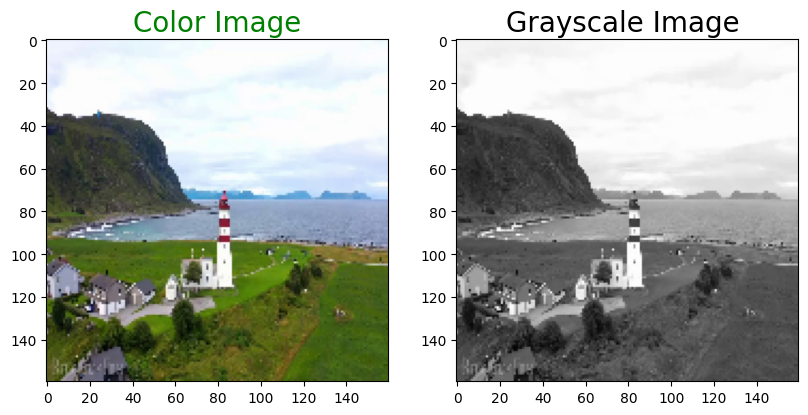

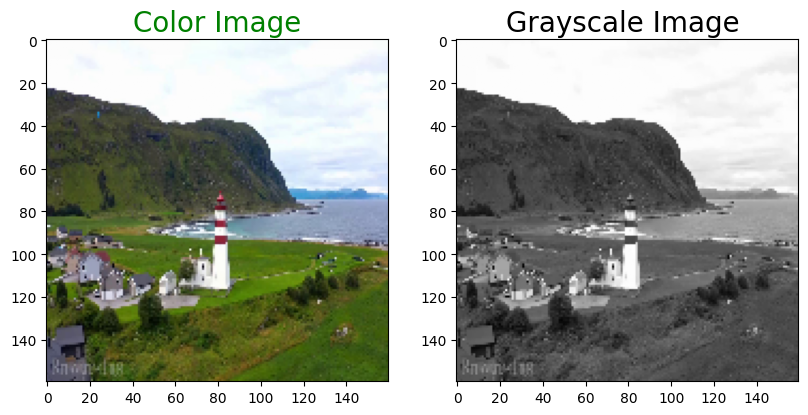

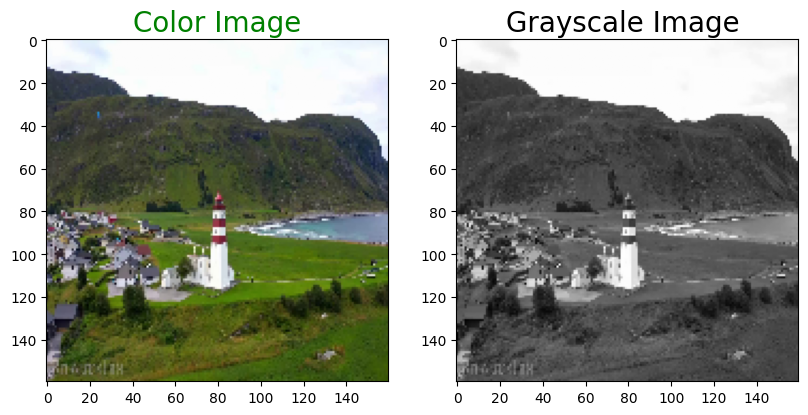

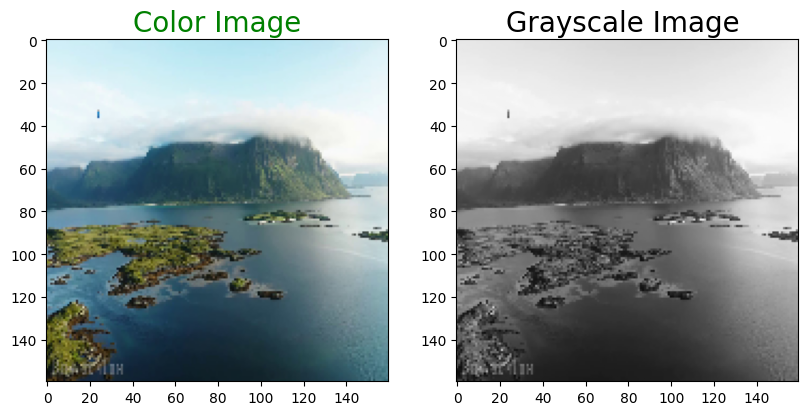

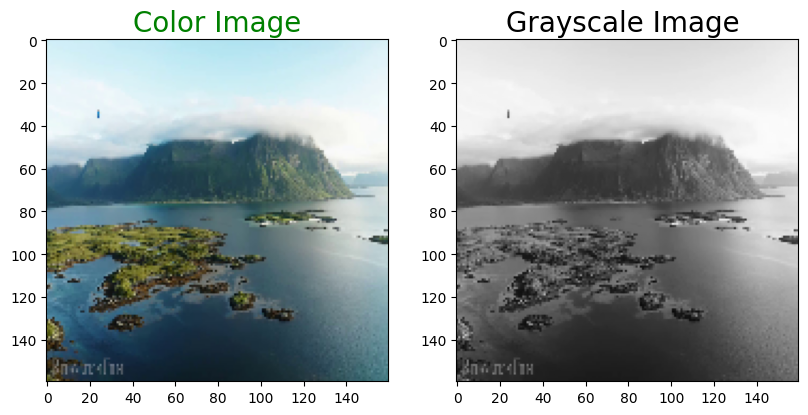

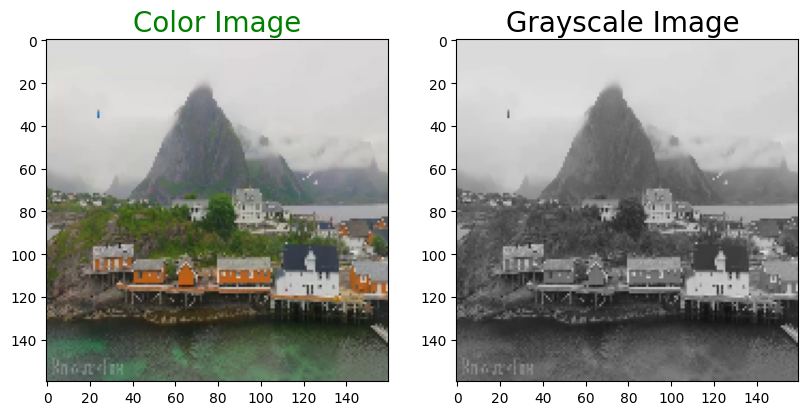

In [25]:
for i in range(0,1000, 180):
     plot_images(color_img[i],gray_img[i])

In [26]:
print(len(gray_img))
print(len(color_img))
train_gray_image = gray_img[:3672]
train_color_image = color_img[:3672]

test_gray_image = gray_img[3672:]
test_color_image = color_img[3672:]
# reshaping
train_g = np.reshape(train_gray_image,(len(train_gray_image),SIZE,SIZE,3))
train_c = np.reshape(train_color_image, (len(train_color_image),SIZE,SIZE,3))
print('Train color image shape:',train_c.shape)


test_gray_image = np.reshape(test_gray_image,(len(test_gray_image),SIZE,SIZE,3))
test_color_image = np.reshape(test_color_image, (len(test_color_image),SIZE,SIZE,3))
print('Test color image shape',test_color_image.shape)

4590
4590
Train color image shape: (3672, 160, 160, 3)
Test color image shape (918, 160, 160, 3)


In [27]:
from keras import layers
def down(filters , kernel_size, apply_batch_normalization = True):
    downsample = tf.keras.models.Sequential()
    downsample.add(layers.Conv2D(filters,kernel_size,padding = 'same', strides = 2))
    if apply_batch_normalization:
        downsample.add(layers.BatchNormalization())
    downsample.add(keras.layers.LeakyReLU())
    return downsample


def up(filters, kernel_size, dropout = False):
    upsample = tf.keras.models.Sequential()
    upsample.add(layers.Conv2DTranspose(filters, kernel_size,padding = 'same', strides = 2))
    if dropout:
        upsample.dropout(0.2)
    upsample.add(keras.layers.LeakyReLU())
    return upsample

In [28]:
def model():
    inputs = layers.Input(shape= [160,160,3])
    d1 = down(128,(3,3),False)(inputs)
    d2 = down(128,(3,3),False)(d1)
    d3 = down(256,(3,3),True)(d2)
    d4 = down(512,(3,3),True)(d3)

    d5 = down(512,(3,3),True)(d4)
    #upsampling
    u1 = up(512,(3,3),False)(d5)
    u1 = layers.concatenate([u1,d4])
    u2 = up(256,(3,3),False)(u1)
    u2 = layers.concatenate([u2,d3])
    u3 = up(128,(3,3),False)(u2)
    u3 = layers.concatenate([u3,d2])
    u4 = up(128,(3,3),False)(u3)
    u4 = layers.concatenate([u4,d1])
    u5 = up(3,(3,3),False)(u4)
    u5 = layers.concatenate([u5,inputs])
    output = layers.Conv2D(3,(2,2),strides = 1, padding = 'same')(u5)
    return tf.keras.Model(inputs=inputs, outputs=output)

model = model()
model.summary()
print(len(train_g))
print(len(train_c))

Model: "functional_11"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer         │ (None, 160, 160,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ sequential          │ (None, 80, 80,    │      3,584 │ input_layer[0][0] │
│ (Sequential)        │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ sequential_1        │ (None, 40, 40,    │    147,584 │ sequential[0][0]  │
│ (Sequential)        │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ sequential_2        │ (None, 20, 20,    │    296,192 │ sequential_1[0][… │
│ (Sequential)        │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ sequential_3        │ (None, 10, 10,    │  1,182,208 │ sequential_2[0][… │
│ (Sequential)        │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ sequential_4        │ (None, 5, 5, 512) │  2,361,856 │ sequential_3[0][… │
│ (Sequential)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ sequential_5        │ (None, 10, 10,    │  2,359,808 │ sequential_4[0][… │
│ (Sequential)        │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ concatenate         │ (None, 10, 10,    │          0 │ sequential_5[0][… │
│ (Concatenate)       │ 1024)             │            │ sequential_3[0][… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ sequential_6        │ (None, 20, 20,    │  2,359,552 │ concatenate[0][0] │
│ (Sequential)        │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ concatenate_1       │ (None, 20, 20,    │          0 │ sequential_6[0][… │
│ (Concatenate)       │ 512)              │            │ sequential_2[0][… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ sequential_7        │ (None, 40, 40,    │    589,952 │ concatenate_1[0]… │
│ (Sequential)        │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ concatenate_2       │ (None, 40, 40,    │          0 │ sequential_7[0][… │
│ (Concatenate)       │ 256)              │            │ sequential_1[0][… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ sequential_8        │ (None, 80, 80,    │    295,040 │ concatenate_2[0]… │
│ (Sequential)        │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ concatenate_3       │ (None, 80, 80,    │          0 │ sequential_8[0][… │
│ (Concatenate)       │ 256)              │            │ sequential[0][0]  │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ sequential_9        │ (None, 160, 160,  │      6,915 │ concatenate_3[0]… │
│ (Sequential)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ concatenate_4       │ (None, 160, 160,  │          0 │ sequential_9[0][… │
│ (Concatenate)       │ 6)                │            │ input_layer[0][0] │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_5 (Conv2D)   │ (None, 160, 160,  │         75 │ concatenate_4[0]

 Total params: 9,602,766 (36.63 MB)

 Trainable params: 9,600,206 (36.62 MB)

 Non-trainable params: 2,560 (10.00 KB)

3672
3672


In [29]:
len(train_g)

3672

In [30]:
class PrintEpochStatus(tf.keras.callbacks.Callback):
    def on_epoch_end(self, epoch, logs=None):
        print(f"Epoch {epoch+1}/{self.params['epochs']}: "
              f"Loss: {logs['loss']:.4f}, "
              f"Accuracy: {logs['acc']:.4f}, "
            )


model.compile(optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001), loss = 'mean_absolute_error',
              metrics = ['acc'])

history = model.fit(train_g, train_c, epochs = 50, batch_size = 10,verbose = 0, callbacks=[PrintEpochStatus()])

I0000 00:00:1714024213.054924     142 device_compiler.h:186] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


Epoch 1/50: Loss: 0.0586, Accuracy: 0.5370, 
Epoch 2/50: Loss: 0.0277, Accuracy: 0.7171, 
Epoch 3/50: Loss: 0.0195, Accuracy: 0.7743, 
Epoch 4/50: Loss: 0.0165, Accuracy: 0.7978, 
Epoch 5/50: Loss: 0.0147, Accuracy: 0.8151, 
Epoch 6/50: Loss: 0.0136, Accuracy: 0.8280, 
Epoch 7/50: Loss: 0.0130, Accuracy: 0.8324, 
Epoch 8/50: Loss: 0.0125, Accuracy: 0.8393, 
Epoch 9/50: Loss: 0.0121, Accuracy: 0.8452, 
Epoch 10/50: Loss: 0.0118, Accuracy: 0.8474, 
Epoch 11/50: Loss: 0.0116, Accuracy: 0.8500, 
Epoch 12/50: Loss: 0.0114, Accuracy: 0.8514, 
Epoch 13/50: Loss: 0.0110, Accuracy: 0.8578, 
Epoch 14/50: Loss: 0.0108, Accuracy: 0.8626, 
Epoch 15/50: Loss: 0.0107, Accuracy: 0.8610, 
Epoch 16/50: Loss: 0.0106, Accuracy: 0.8642, 
Epoch 17/50: Loss: 0.0105, Accuracy: 0.8621, 
Epoch 18/50: Loss: 0.0103, Accuracy: 0.8684, 
Epoch 19/50: Loss: 0.0102, Accuracy: 0.8709, 
Epoch 20/50: Loss: 0.0103, Accuracy: 0.8665, 
Epoch 21/50: Loss: 0.0101, Accuracy: 0.8692, 
Epoch 22/50: Loss: 0.0101, Accuracy: 0.8695

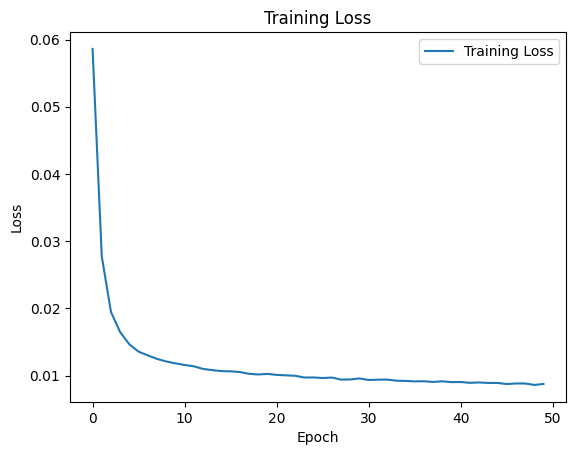

In [31]:
plt.plot(history.history['loss'], label='Training Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Training Loss')
plt.legend()
plt.show()

In [32]:
test_loss, test_accuracy = model.evaluate(test_gray_image, test_color_image, batch_size = 10,verbose = 0)
print(test_loss)
print(test_accuracy)

0.043585509061813354
0.47457537055015564


In [33]:
model.save('/kaggle/working/ColorizationModel.h5')

In [34]:
model.save_weights('/kaggle/working/ColorizationModelWeights.weights.h5')

1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step


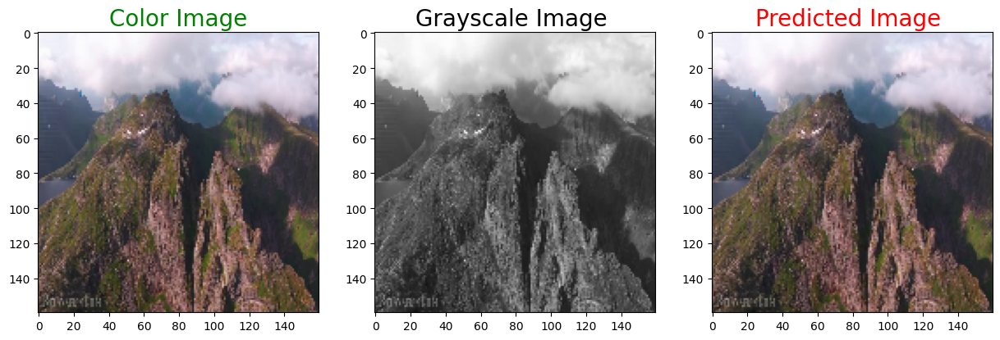

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step


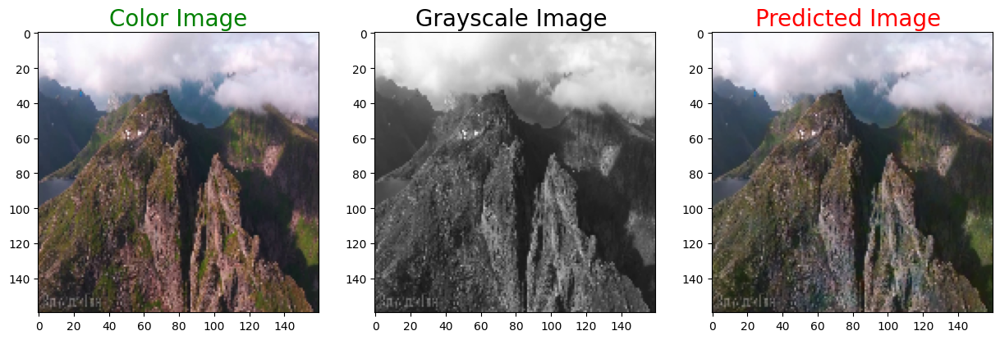

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step


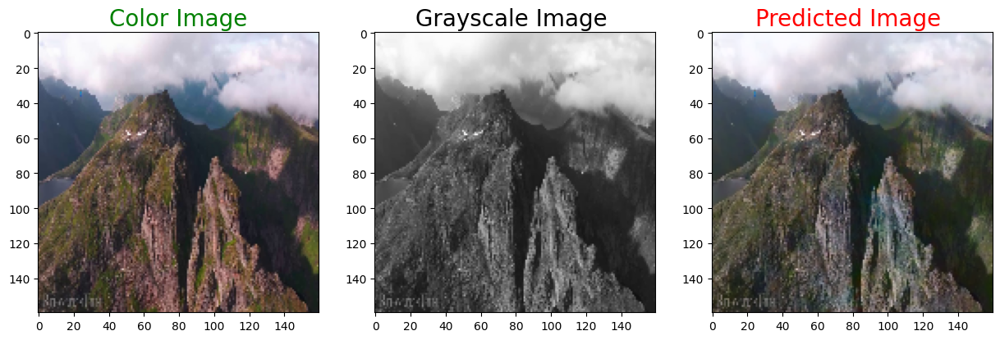

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step


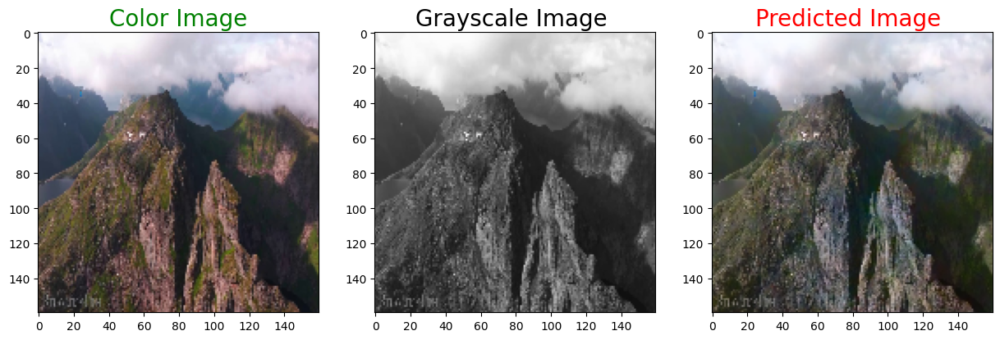

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step


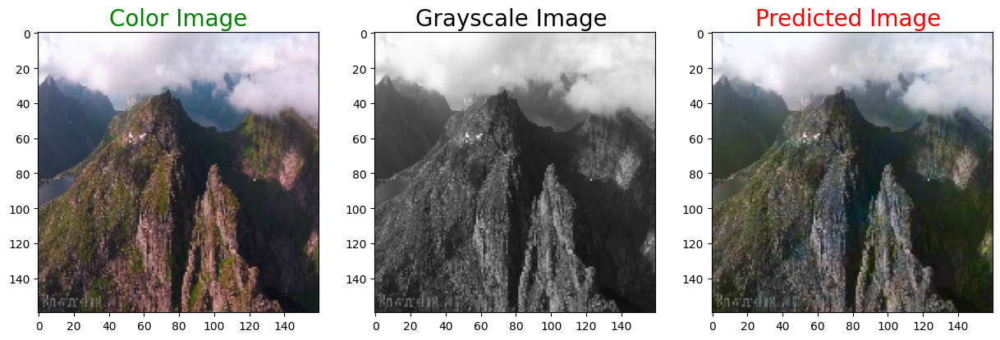

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step


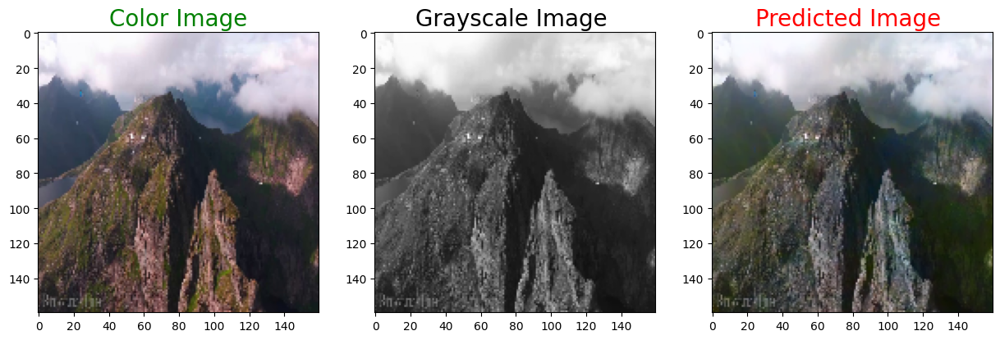

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step


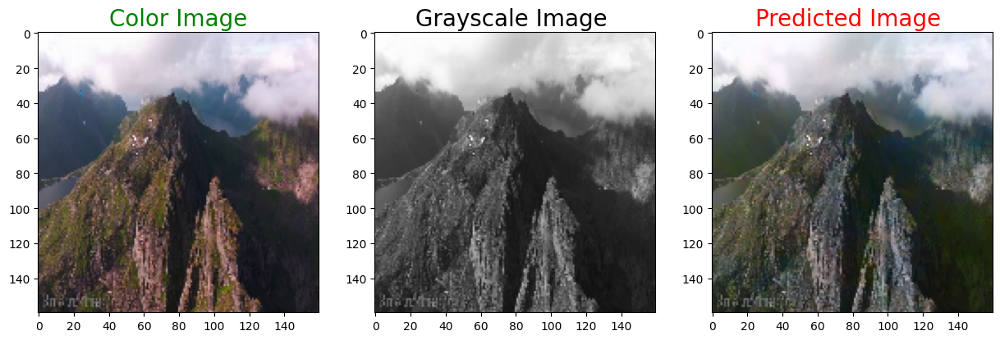

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step


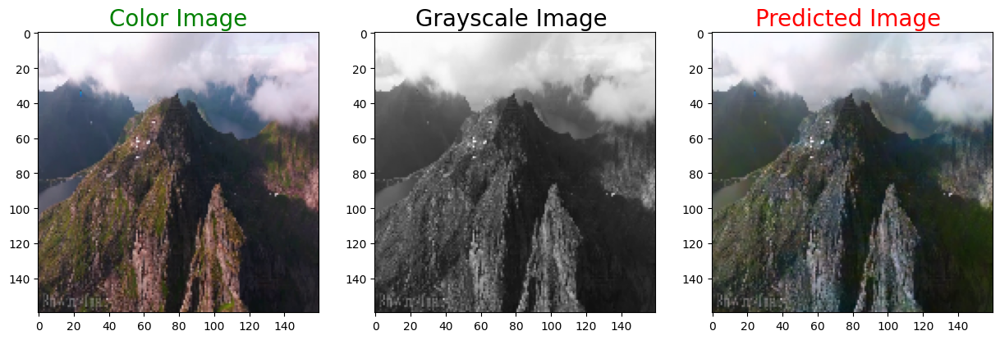

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step


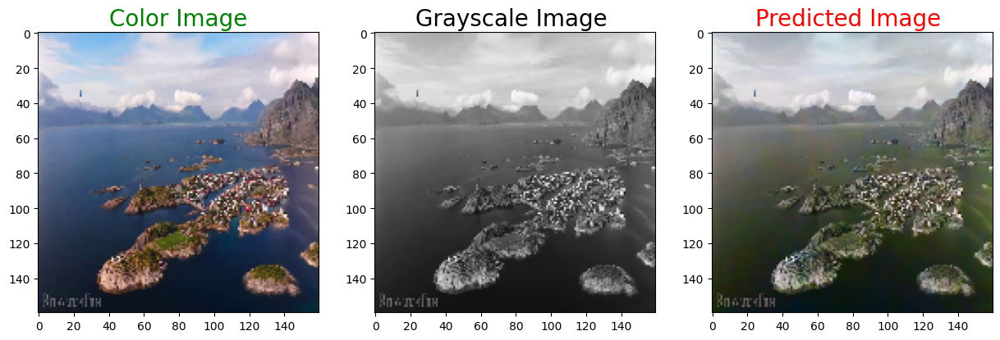

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


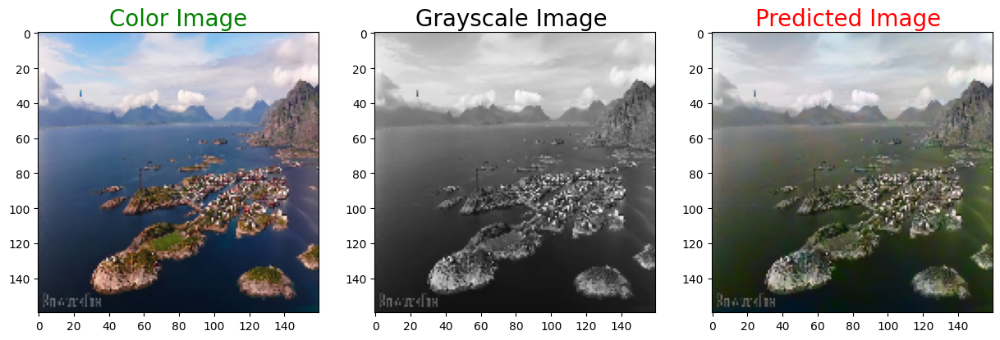

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step


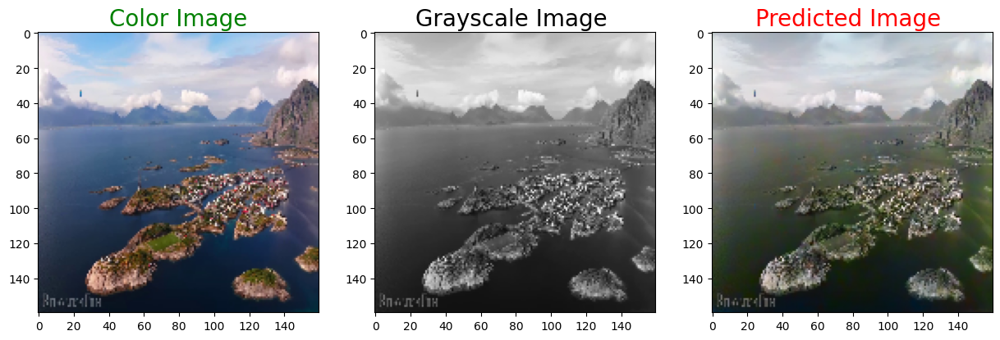

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step


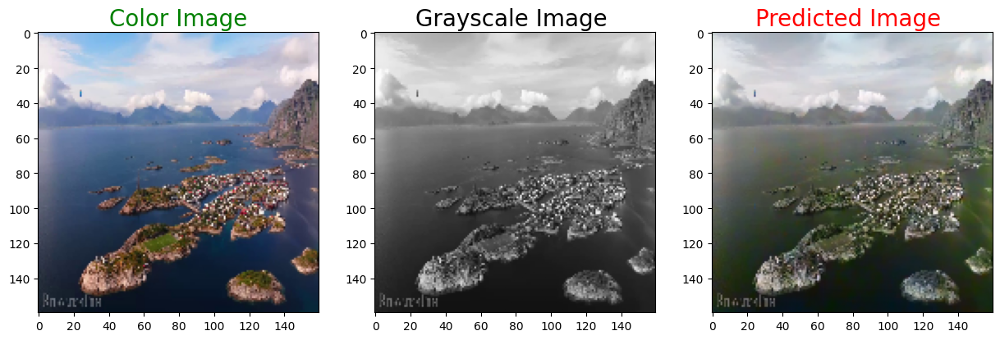

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step


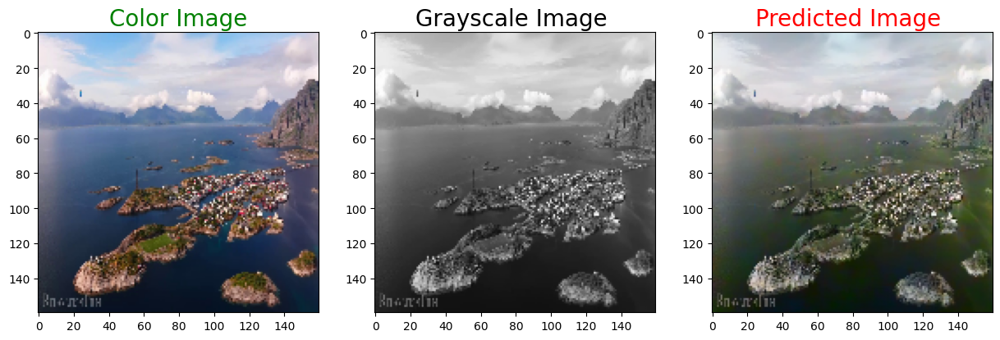

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step


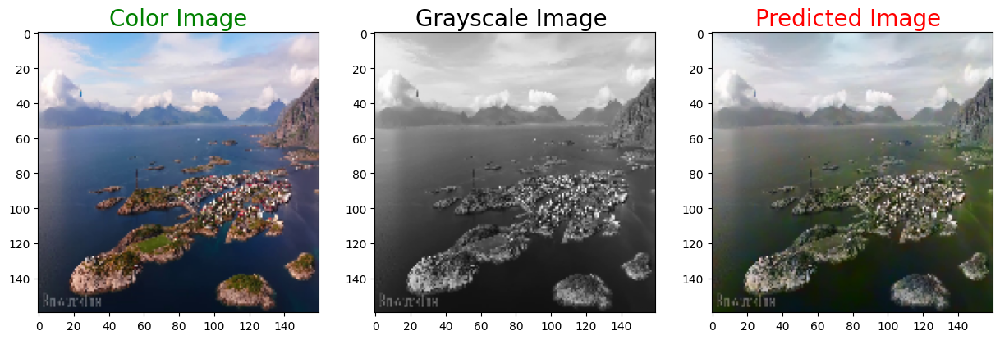

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step


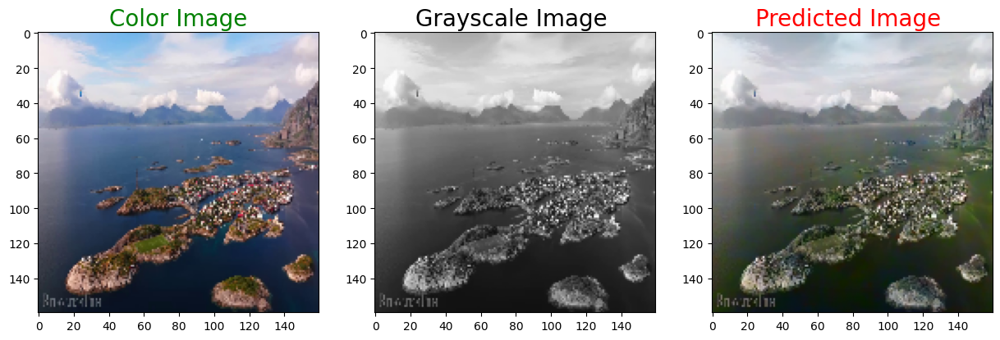

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step


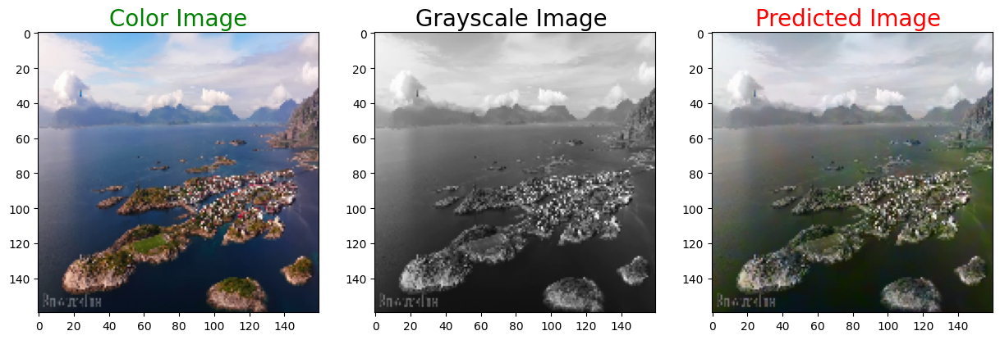

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


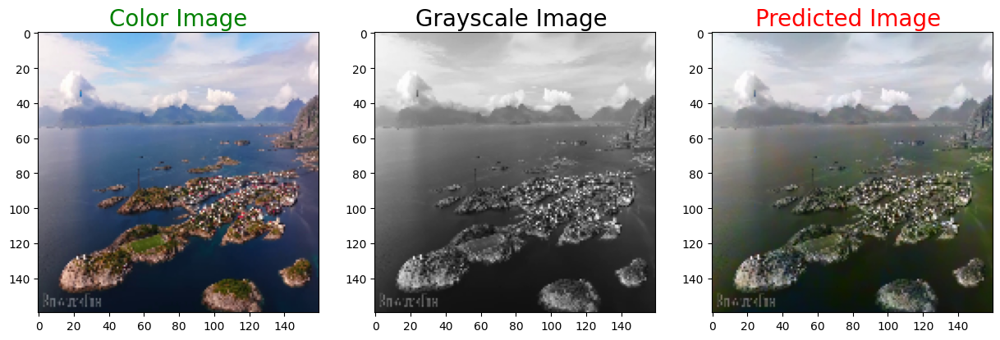

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


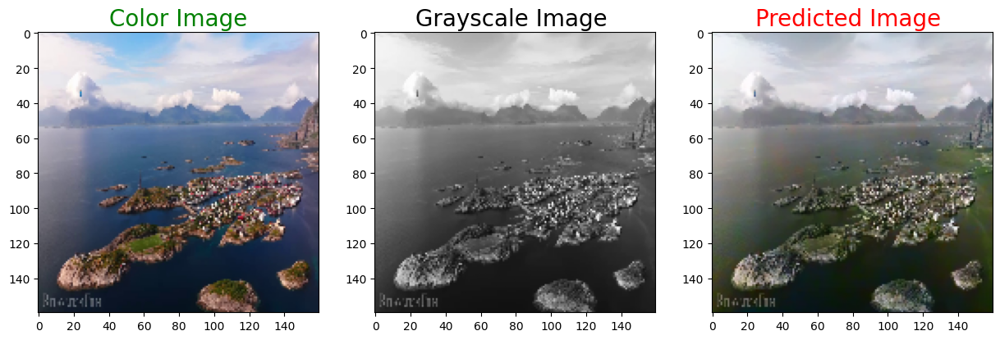

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


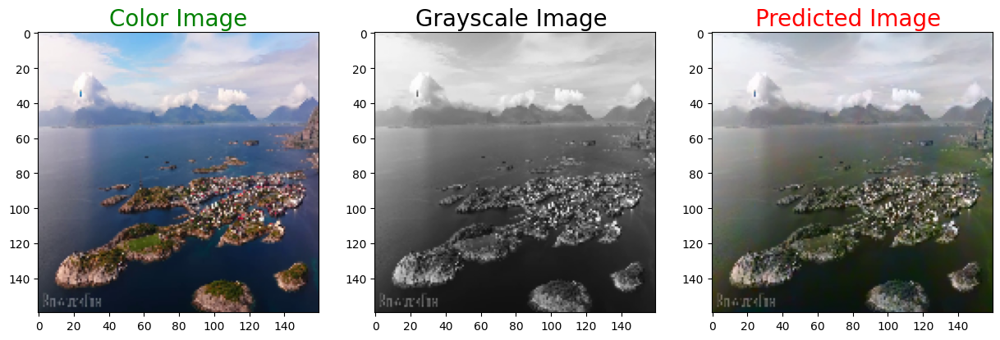

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step


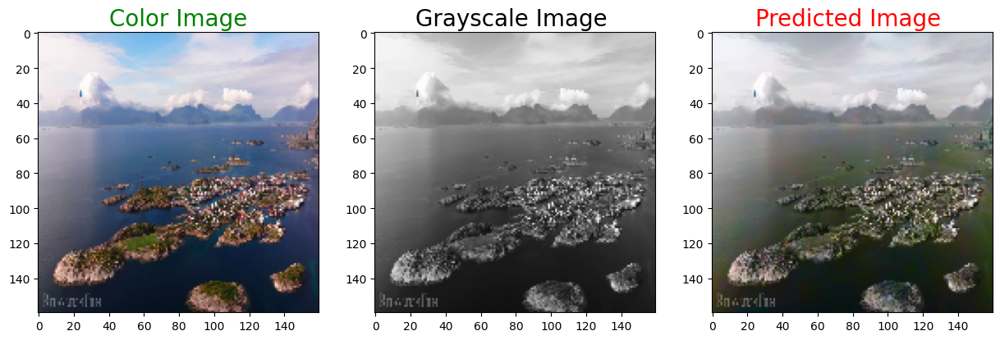

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


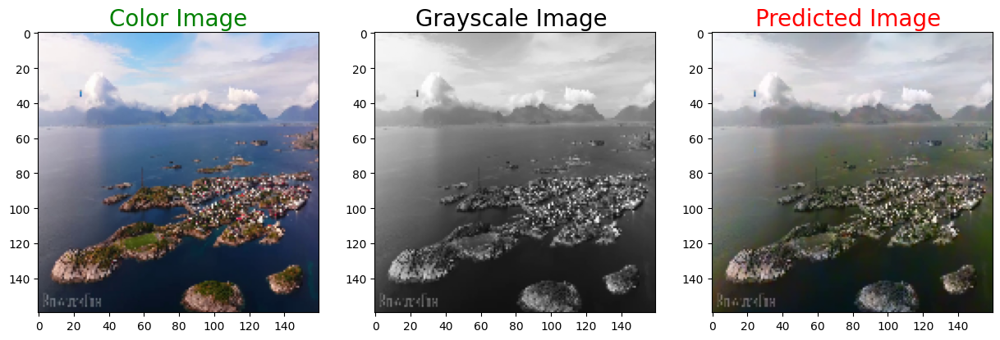

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


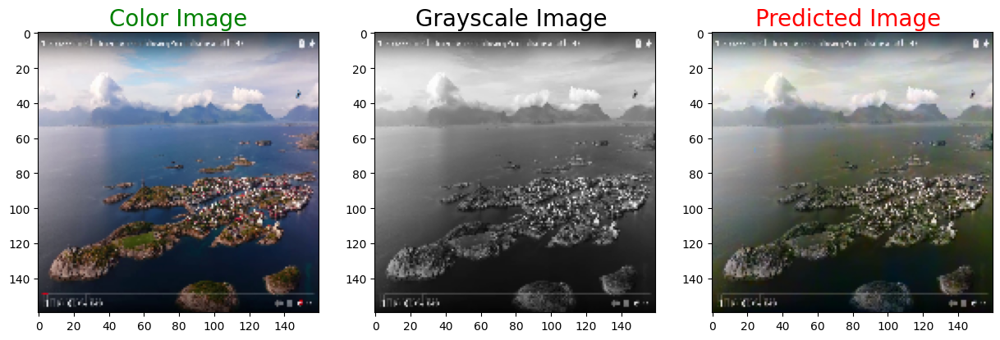

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step


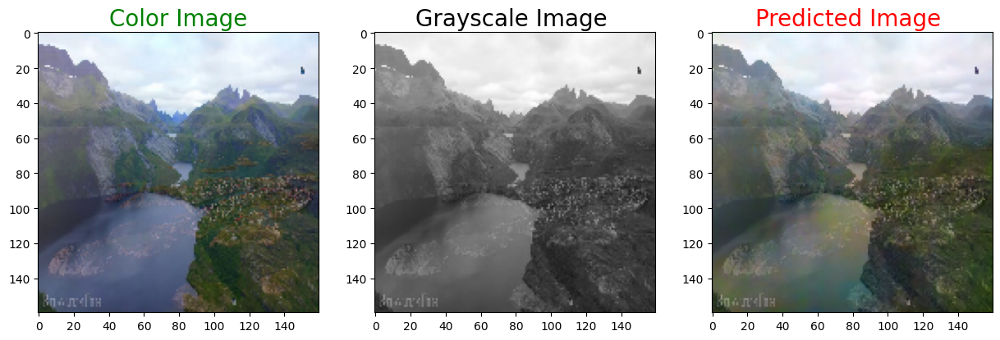

In [35]:
def plot_images(color,grayscale,predicted):
    plt.figure(figsize=(15,15))
    plt.subplot(1,3,1)
    plt.title('Color Image', color = 'green', fontsize = 20)
    plt.imshow(color)
    plt.subplot(1,3,2)
    plt.title('Grayscale Image ', color = 'black', fontsize = 20)
    plt.imshow(grayscale)
    plt.subplot(1,3,3)
    plt.title('Predicted Image ', color = 'Red', fontsize = 20)
    plt.imshow(predicted)
   
    plt.show()

for i in range(0, 918, 40):
    predicted = np.clip(model.predict(test_gray_image[i].reshape(1,SIZE, SIZE,3)),0.0,1.0).reshape(SIZE, SIZE,3)
    plot_images(test_color_image[i],test_gray_image[i],predicted)

In [36]:
folder_path = '/kaggle/working/predicted_images'
if not os.path.exists(folder_path):
    os.makedirs(folder_path)

In [37]:
def save_images(predicted, index):
    plt.imsave(os.path.join(folder_path, f'{index}.jpg'), predicted)
   
for i in range(918):
    predicted = np.clip(model.predict(test_gray_image[i].reshape(1,SIZE, SIZE,3)),0.0,1.0).reshape(SIZE, SIZE,3)
    save_images(predicted, i)

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━

In [ ]:
!zip -r file.zip /kaggle/working

In [38]:
import cv2
import os

def create_video_from_images(image_folder, output_video_path, fps):
    images = [img for img in os.listdir(image_folder) if img.endswith(".jpg")]
    images.sort(key=lambda x: int(x.split('.')[0]))

    frame = cv2.imread(os.path.join(image_folder, images[0]))
    height, width, layers = frame.shape

    # Define the codec and create VideoWriter object
    fourcc = cv2.VideoWriter_fourcc(*'mp4v') # Use 'XVID' for .avi format
    video = cv2.VideoWriter(output_video_path, fourcc, fps, (width,height))

    # Write images to video
    for image in images:
        video.write(cv2.imread(os.path.join(image_folder, image)))

    video.release()


image_folder = '/kaggle/working/predicted_images'

output_video_path = '/kaggle/working/predicted_video.mp4'

fps = 30

create_video_from_images(image_folder, output_video_path, fps)

print("Video created successfully!")


Video created successfully!


In [41]:
def sorted_alphanumeric(data):
    convert = lambda text: int(text) if text.isdigit() else text.lower()
    alphanum_key = lambda key: [convert(c) for c in re.split('([0-9]+)',key)]
    return sorted(data,key = alphanum_key)
# defining the size of the image
SIZE = 160

test_gray_img = []
path = '/kaggle/input/gray-scale-test-images/test_bw_image'
files = os.listdir(path)
files = sorted_alphanumeric(files)
for i in tqdm(files):
    print(path + '/' + i)
    img = cv2.imread(path + '/'+i,1)

    #resizing image
    img = cv2.resize(img, (SIZE, SIZE))
    img = img.astype('float32') / 255.0
    test_gray_img.append(img_to_array(img))

  0%|          | 0/20 [00:00<?, ?it/s]

/kaggle/input/gray-scale-test-images/test_bw_image/1.jpg
/kaggle/input/gray-scale-test-images/test_bw_image/2.jpg


 10%|█         | 2/20 [00:00<00:05,  3.44it/s]

/kaggle/input/gray-scale-test-images/test_bw_image/3.jpg


 15%|█▌        | 3/20 [00:01<00:06,  2.80it/s]

/kaggle/input/gray-scale-test-images/test_bw_image/4.jpg


 25%|██▌       | 5/20 [00:01<00:04,  3.52it/s]

/kaggle/input/gray-scale-test-images/test_bw_image/5.jpg
/kaggle/input/gray-scale-test-images/test_bw_image/6.jpg


 30%|███       | 6/20 [00:02<00:07,  1.88it/s]

/kaggle/input/gray-scale-test-images/test_bw_image/7.jpg


 40%|████      | 8/20 [00:03<00:04,  2.44it/s]

/kaggle/input/gray-scale-test-images/test_bw_image/8.jpg
/kaggle/input/gray-scale-test-images/test_bw_image/9.jpg


 50%|█████     | 10/20 [00:03<00:03,  2.98it/s]

/kaggle/input/gray-scale-test-images/test_bw_image/10.jpg
/kaggle/input/gray-scale-test-images/test_bw_image/11.jpg


 55%|█████▌    | 11/20 [00:04<00:03,  2.95it/s]

/kaggle/input/gray-scale-test-images/test_bw_image/12.jpg


 60%|██████    | 12/20 [00:04<00:02,  2.89it/s]

/kaggle/input/gray-scale-test-images/test_bw_image/13.jpg


100%|██████████| 20/20 [00:04<00:00,  4.08it/s]

/kaggle/input/gray-scale-test-images/test_bw_image/14.jpg
/kaggle/input/gray-scale-test-images/test_bw_image/15.jpg
/kaggle/input/gray-scale-test-images/test_bw_image/16.jpg
/kaggle/input/gray-scale-test-images/test_bw_image/17.jpg
/kaggle/input/gray-scale-test-images/test_bw_image/18.jpg
/kaggle/input/gray-scale-test-images/test_bw_image/19.jpg
/kaggle/input/gray-scale-test-images/test_bw_image/20.jpg


In [46]:
len(test_gray_img)

20

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step


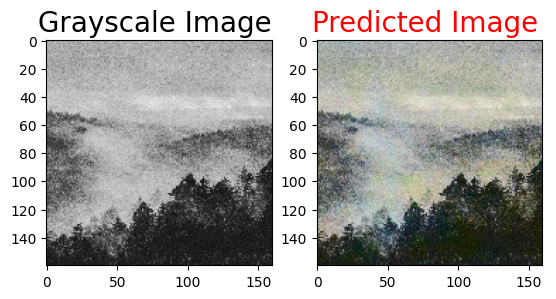

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step


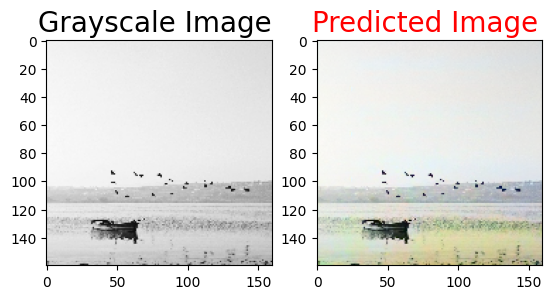

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


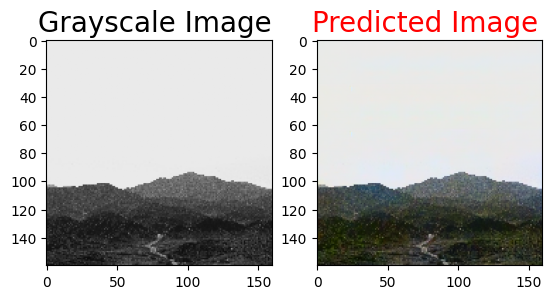

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step


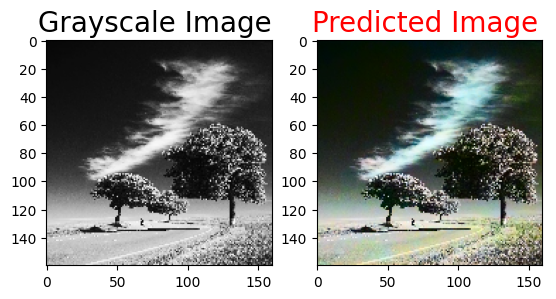

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


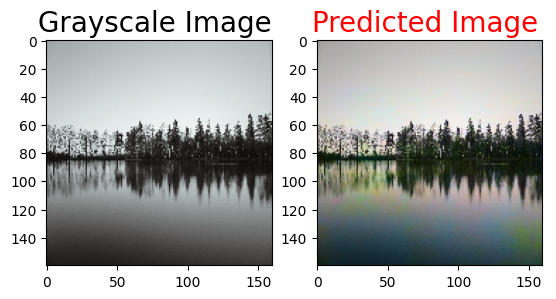

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step


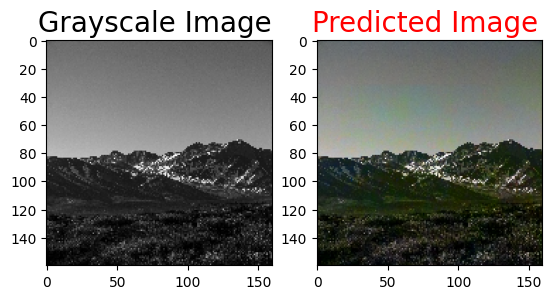

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step


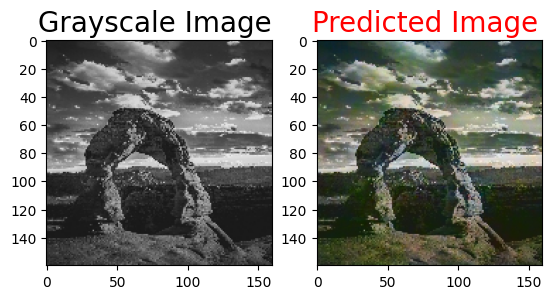

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step


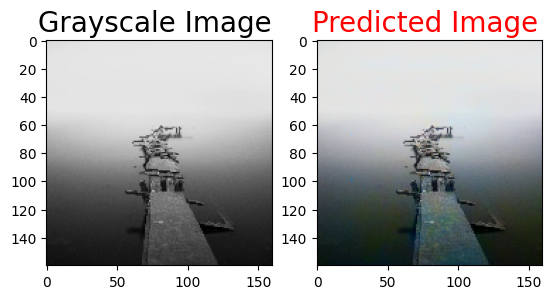

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


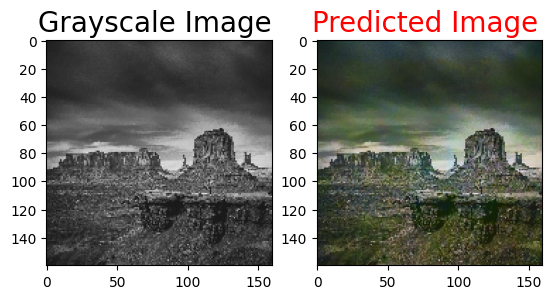

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


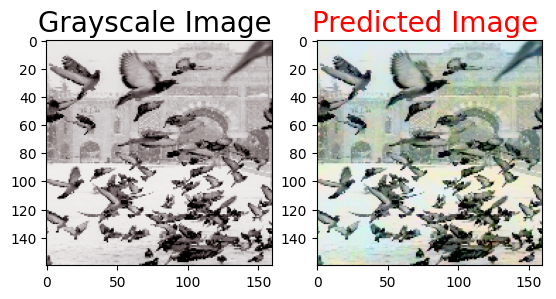

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


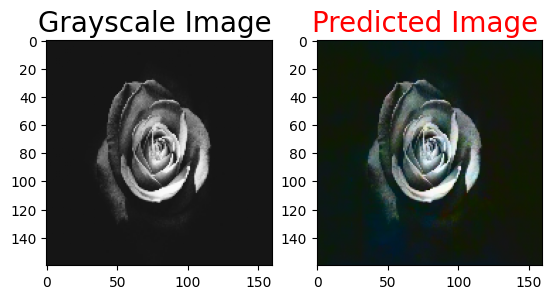

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step


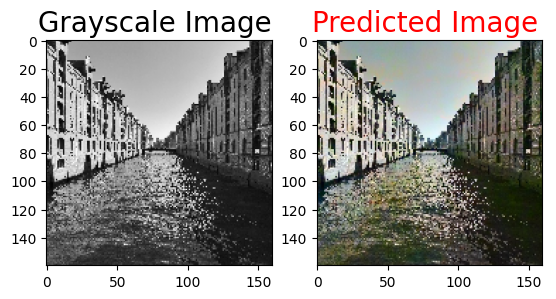

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


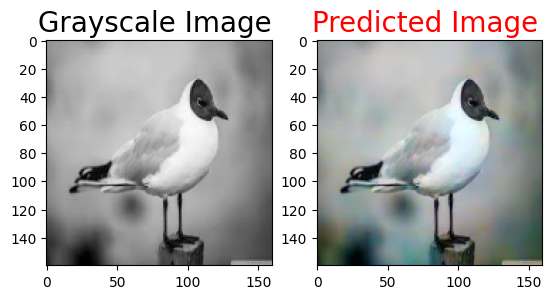

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


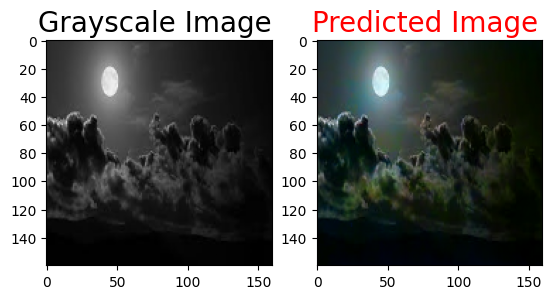

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step


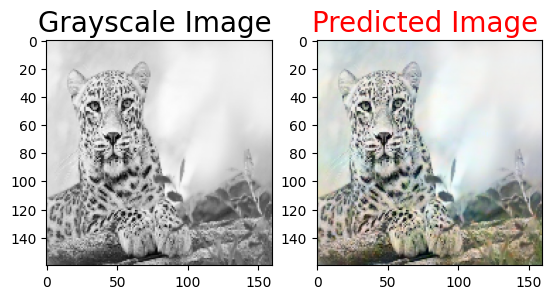

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step


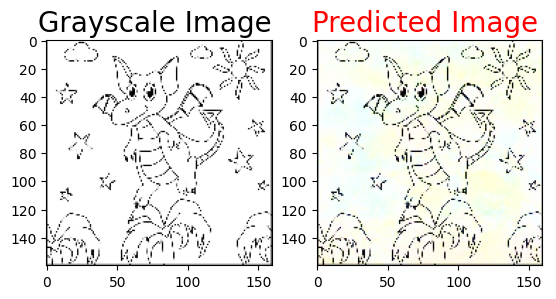

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


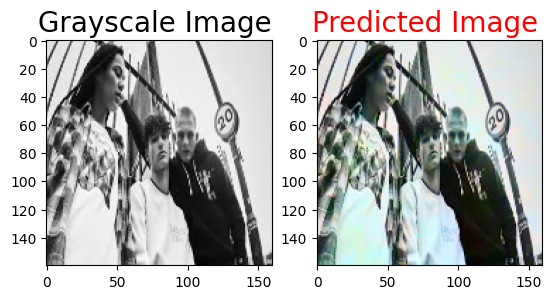

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


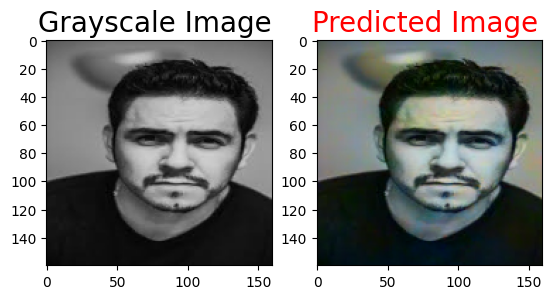

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


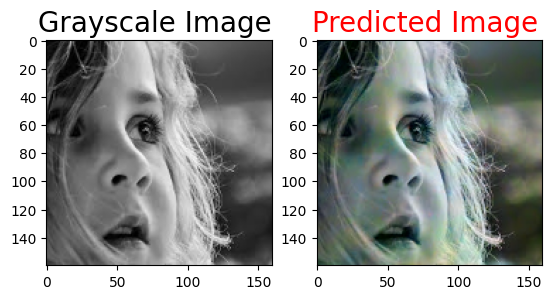

In [49]:
def plot_images(grayscale,predicted):
    plt.subplot(1,2,1)
    plt.title('Grayscale Image ', color = 'black', fontsize = 20)
    plt.imshow(grayscale)
    plt.subplot(1,2,2)
    plt.title('Predicted Image ', color = 'Red', fontsize = 20)
    plt.imshow(predicted)
   
    plt.show()

for i in range(1,20):
    predicted = np.clip(model.predict(test_gray_img[i].reshape(1,SIZE, SIZE,3)),0.0,1.0).reshape(SIZE, SIZE,3)
    plot_images(test_gray_img[i],predicted)